# Isopycnal Mixing Water Mass Analysis: Absolute Velocity

In [1]:
# Imports
import numpy as np
import pandas as pd
import glob
import xarray as xr
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
from matplotlib.dates import DateFormatter
import gsw
import cmocean.cm as cmo
import sys
import pyompa
import scipy.interpolate as interp

## To import functions from Slocum-AD2CP GitHub repository, make this path the path to where the repo exists locally
sys.path.insert(0,'/home/jg1200/GitHub/Slocum-AD2CP/src/analysis/')
from analysis import gsw_rho, profile_mld, get_erddap_dataset, grid_glider_data, dist_from_lat_lon

## Set some plotting formats
plt.style.use('seaborn-poster')
myFmtshort = mdates.DateFormatter('%m/%d\n%H:%M')
myFmtlong = mdates.DateFormatter('%m/%d/%y \n%H:%M')
myFmt = mdates.DateFormatter('%m/%d/%y')



###################################################################################################################
######################################### Setting for water mass analysis #########################################
###################################################################################################################

#Define a parameter to represent remineralization in terms of phosphate
convertedparamgroups = [
    pyompa.ConvertedParamGroup(
        groupname="phosphate_remin",
        conversion_ratios=[{"oxygen_concentration": -170, "phosphate": 1.0}],
        always_positive=True)
]

paramweightings = {
    "potential_temperature": 1.0,
    "salinity": 1.0,
    "mass": 1.0,
}

settings = {
    "param_names": ["potential_temperature", "salinity", "mass"],
    "convertedparam_groups": convertedparamgroups,
    "param_weightings": paramweightings,
}


## First load glider data

In [2]:
grid_ds_2020 = xr.open_dataset("/home/jg1200/Data/GliderData/RU29/RU29_2020_AD2CP_NC/Gridded/RU29_2020_Gridded_ADCP_CTD.nc")
grid_ds_2021a = xr.open_dataset("/home/jg1200/Data/GliderData/RU29/RU29_2021_Mission_1_AD2CP_NC/Gridded/RU29_2021_Mission_1_Gridded_ADCP_CTD.nc")
grid_ds_2021b = xr.open_dataset("/home/jg1200/Data/GliderData/RU29/RU29_2021_Mission_2_AD2CP_NC/Gridded/RU29_2021_Mission_2_Gridded_ADCP_CTD.nc")
grid_ds_2022 = xr.open_dataset("/home/jg1200/Data/GliderData/RU36/RU36_03_2022_ADCP/RU36_03_2022_Gridded_ADCP_CTD.nc")

## subset 2022 based on the transects we used in the analysis notebook
grid_ds_2022 = grid_ds_2022.sel(transect_num=[2,3,4,5,6])

grid_ds_2020

<xarray.Dataset>
Dimensions:       (depth: 98, lat: 6, transect_num: 15)
Coordinates:
  * depth         (depth) float64 5.0 15.0 25.0 35.0 ... 945.0 955.0 965.0 975.0
  * lat           (lat) float64 17.85 17.9 17.95 18.0 18.05 18.1
  * transect_num  (transect_num) int64 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15
Data variables:
    vgeo          (depth, lat, transect_num) float64 ...
    u             (depth, lat, transect_num) float64 ...
    v             (depth, lat, transect_num) float64 ...
    temp          (depth, lat, transect_num) float64 ...
    sal           (depth, lat, transect_num) float64 ...
    density       (depth, lat, transect_num) float64 ...
    time          (lat, transect_num) datetime64[ns] ...
Attributes:
    description:  Processed RU29 AD2CP absolute velocity, geostrophic velocit...

## Then load WOA data

In [3]:
temp_ds = xr.open_dataset('https://www.ncei.noaa.gov/thredds-ocean/dodsC/ncei/woa/temperature/decav/1.00/woa18_decav_t00_01.nc', decode_times=False)
sal_ds  = xr.open_dataset('https://www.ncei.noaa.gov/thredds-ocean/dodsC/ncei/woa/salinity/decav/1.00/woa18_decav_s00_01.nc', decode_times=False)
temp_ds

<xarray.Dataset>
Dimensions:             (lat: 180, nbounds: 2, lon: 360, depth: 102, time: 1)
Coordinates:
  * lat                 (lat) float32 -89.5 -88.5 -87.5 -86.5 ... 87.5 88.5 89.5
  * lon                 (lon) float32 -179.5 -178.5 -177.5 ... 177.5 178.5 179.5
  * depth               (depth) float32 0.0 5.0 10.0 ... 5.3e+03 5.4e+03 5.5e+03
  * time                (time) float32 4.326e+03
Dimensions without coordinates: nbounds
Data variables:
    crs                 int32 ...
    lat_bnds            (lat, nbounds) float32 ...
    lon_bnds            (lon, nbounds) float32 ...
    depth_bnds          (depth, nbounds) float32 ...
    climatology_bounds  (time, nbounds) float32 ...
    t_an                (time, depth, lat, lon) float32 ...
    t_mn                (time, depth, lat, lon) float32 ...
    t_dd                (time, depth, lat, lon) float64 ...
    t_sd                (time, depth, lat, lon) float32 ...
    t_se                (time, depth, lat, lon) float32 ...
    t_oa                (time, depth, lat, lon) float32 ...
    t_gp                (time, depth, lat, lon) float64 ...
Attributes: (12/49)
    Conventions:                     CF-1.6, ACDD-1.3
    title:                           World Ocean Atlas 2018 : sea_water_tempe...
    summary:                         Climatological mean temperature for the ...
    references:                      Locarnini, R. A., A. V. Mishonov, O. K. ...
    institution:                     National Centers for Environmental Infor...
    comment:                         global climatology as part of the World ...
    ...                              ...
    publisher_email:                 NCEI.info@noaa.gov
    nodc_template_version:           NODC_NetCDF_Grid_Template_v2.0
    license:                         These data are openly available to the p...
    metadata_link:                   https://www.nodc.noaa.gov/OC5/woa18/
    date_created:                    2019-07-28 
    date_modified:                   2019-07-28

## Subset for NAW/SAW

In [4]:
###################################################################################################################
### Upper NAW ###
min_lon = -60
max_lon = -40
min_lat = 13
max_lat = 17

## subset
naw_temp_ds1 = temp_ds.sel(lat=slice(min_lat,max_lat),lon=slice(min_lon,max_lon),time=temp_ds.time[0])
naw_sal_ds1  = sal_ds.sel(lat=slice(min_lat,max_lat),lon=slice(min_lon,max_lon),time=sal_ds.time[0])

## average profile
naw_mean_temp1 = np.nanmax(naw_temp_ds1.t_mn, axis=(1,2))
naw_mean_sal1  = np.nanmax(naw_sal_ds1.s_mn, axis=(1,2))

## convert to SA and PT and calculate sigma0
p = gsw.p_from_z(-naw_sal_ds1.depth.values,15)
naw_mean_sal1 = gsw.SA_from_SP(naw_mean_sal1, p, -50, 15)
naw_mean_temp1 = gsw.CT_from_t(naw_mean_sal1, naw_mean_temp1, p)
naw_mean_den1 = gsw.sigma0(naw_mean_sal1,naw_mean_temp1)+1000

## regular depth grid for all so just use this, do this before subsetting naw_mean_den1
mean_depth = naw_sal_ds1.depth.values[np.where((naw_mean_den1>=1024.5) & (naw_mean_den1 <=1027.6))]

## subset by density
naw_den1_ind = np.where((naw_mean_den1>=1024.5) & (naw_mean_den1 <=1026.3))
naw_mean_sal1 = naw_mean_sal1[naw_den1_ind]
naw_mean_temp1 = naw_mean_temp1[naw_den1_ind]
naw_mean_den1 = naw_mean_den1[naw_den1_ind]

###################################################################################################################
### Lower NAW ###
min_lon = -60
max_lon = -40
min_lat = 23
max_lat = 26

## subset
naw_temp_ds2 = temp_ds.sel(lat=slice(min_lat,max_lat),lon=slice(min_lon,max_lon),time=temp_ds.time[0])
naw_sal_ds2  = sal_ds.sel(lat=slice(min_lat,max_lat),lon=slice(min_lon,max_lon),time=sal_ds.time[0])

## average profile
naw_mean_temp2 = np.nanmean(naw_temp_ds2.t_mn, axis=(1,2))
naw_mean_sal2  = np.nanmean(naw_sal_ds2.s_mn, axis=(1,2))

## convert to SA and PT and calculate sigma0
p = gsw.p_from_z(-naw_sal_ds2.depth.values,25)
naw_mean_sal2 = gsw.SA_from_SP(naw_mean_sal2, p, -50, 25)
naw_mean_temp2 = gsw.CT_from_t(naw_mean_sal2, naw_mean_temp2, p)
naw_mean_den2 = gsw.sigma0(naw_mean_sal2,naw_mean_temp2)+1000


## subset by density
naw_den2_ind = np.where((naw_mean_den2>=1026.3) & (naw_mean_den2 <=1027.6))
naw_mean_sal2 = naw_mean_sal2[naw_den2_ind]
naw_mean_temp2 = naw_mean_temp2[naw_den2_ind]
naw_mean_den2 = naw_mean_den2[naw_den2_ind]

naw_mean_temp = np.concatenate((naw_mean_temp1,naw_mean_temp2))
naw_mean_sal = np.concatenate((naw_mean_sal1,naw_mean_sal2))
naw_mean_den = gsw.sigma0(naw_mean_sal,naw_mean_temp)+1000

###################################################################################################################
###################################################################################################################
### upper SAW ###
min_lon = 0
max_lon = 10
min_lat = -12
max_lat = -8

## subset
saw_temp_ds1 = temp_ds.sel(lat=slice(min_lat,max_lat),lon=slice(min_lon,max_lon),time=temp_ds.time[0])
saw_sal_ds1  = sal_ds.sel(lat=slice(min_lat,max_lat),lon=slice(min_lon,max_lon),time=sal_ds.time[0])

## Make average profiles
saw_mean_temp1 = np.nanmean(saw_temp_ds1.t_mn, axis=(1,2))
saw_mean_sal1  = np.nanmean(saw_sal_ds1.s_mn, axis=(1,2))

## convert to SA and PT and calculate sigma0
p = gsw.p_from_z(-saw_sal_ds1.depth.values,-10)
saw_mean_sal1 = gsw.SA_from_SP(saw_mean_sal1, p, 10, -10)
saw_mean_temp1 = gsw.CT_from_t(saw_mean_sal1, saw_mean_temp1, p)
saw_mean_den1 = gsw.sigma0(saw_mean_sal1,saw_mean_temp1)+1000


## subset by density
saw_den1_ind = np.where((saw_mean_den1>=1024.5) & (saw_mean_den1 <=1026.3))
saw_mean_sal1 = saw_mean_sal1[saw_den1_ind]
saw_mean_temp1 = saw_mean_temp1[saw_den1_ind]
saw_mean_den1 = saw_mean_den1[saw_den1_ind]

###################################################################################################################
### lower SAW ###
min_lon = -32
max_lon = -28
min_lat = -12
max_lat = -8

## subset
saw_temp_ds2 = temp_ds.sel(lat=slice(min_lat,max_lat),lon=slice(min_lon,max_lon),time=temp_ds.time[0])
saw_sal_ds2  = sal_ds.sel(lat=slice(min_lat,max_lat),lon=slice(min_lon,max_lon),time=sal_ds.time[0])

## Make average profiles
saw_mean_temp2 = np.nanmean(saw_temp_ds2.t_mn, axis=(1,2))
saw_mean_sal2  = np.nanmean(saw_sal_ds2.s_mn, axis=(1,2))

## convert to SA and PT and calculate sigma0
p = gsw.p_from_z(-saw_sal_ds2.depth.values,-10)
saw_mean_sal2 = gsw.SA_from_SP(saw_mean_sal2, p, 10, -10)
saw_mean_temp2 = gsw.CT_from_t(saw_mean_sal2, saw_mean_temp2, p)
saw_mean_den2 = gsw.sigma0(saw_mean_sal2,saw_mean_temp2)+1000

## subset by density
saw_den2_ind = np.where((saw_mean_den2>=1026.3) & (saw_mean_den2 <=1027.6))
saw_mean_sal2 = saw_mean_sal2[saw_den2_ind]
saw_mean_temp2 = saw_mean_temp2[saw_den2_ind]
saw_mean_den2 = saw_mean_den2[saw_den2_ind]

saw_mean_temp = np.concatenate((saw_mean_temp1,saw_mean_temp2))
saw_mean_sal = np.concatenate((saw_mean_sal1,saw_mean_sal2))
saw_mean_den = gsw.sigma0(saw_mean_sal,saw_mean_temp)+1000


## Now subset glider data

In [5]:
subset_ds_2020 = grid_ds_2020.where(grid_ds_2020.density >=1024.5)
subset_ds_2021a = grid_ds_2021a.where(grid_ds_2021a.density >=1024.5)
subset_ds_2021b = grid_ds_2021b.where(grid_ds_2021b.density >=1024.5)
subset_ds_2022 = grid_ds_2022.where(grid_ds_2022.density >=1024.5)


## Save a subset copy for the surface layer

In [6]:
subset_ds_2020_surf = grid_ds_2020.where(grid_ds_2020.density <1024.5)
subset_ds_2021a_surf = grid_ds_2021a.where(grid_ds_2021a.density <1024.5)
subset_ds_2021b_surf = grid_ds_2021b.where(grid_ds_2021b.density <1024.5)
subset_ds_2022_surf = grid_ds_2022.where(grid_ds_2022.density <1024.5)


<a list of 8 text.Text objects>

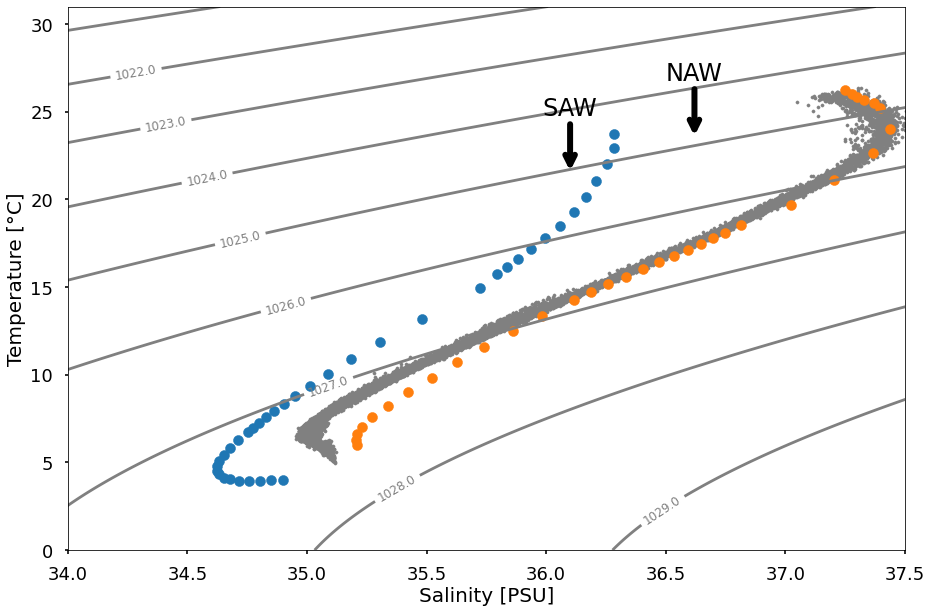

In [7]:
plt.figure(figsize=(15,10))

## markersize
s = 100


plt.scatter(subset_ds_2020.sal.values,subset_ds_2020.temp.values,s=10,c='grey')
plt.scatter(subset_ds_2021a.sal.values,subset_ds_2021a.temp.values,s=10,c='grey')
plt.scatter(subset_ds_2021b.sal.values,subset_ds_2021b.temp.values,s=10,c='grey')
plt.scatter(subset_ds_2022.sal.values,subset_ds_2022.temp.values,s=10,c='grey')



## SAW
plt.scatter(saw_mean_sal,saw_mean_temp,s=s)
plt.annotate(
'SAW', xy=(36.1, 21.5),xytext=(36.1, 24.8) ,
size=24, horizontalalignment="center",
arrowprops=dict(arrowstyle='->',lw=6)
)

## NAW
plt.scatter(naw_mean_sal,naw_mean_temp,s=s)
plt.annotate(
'NAW', xy=(36.62, 23.5),xytext=(36.62, 26.8) ,
size=24, horizontalalignment="center",
arrowprops=dict(arrowstyle='->',lw=6)
)


plt.gca().tick_params(axis='both', which='major', labelsize=18)
plt.gca().tick_params(axis='both', which='minor', labelsize=18)
plt.ylim(0,31)
plt.xlim(34,37.5)
plt.xlabel('Salinity [PSU]', size=20)
plt.ylabel('Temperature [''\N{DEGREE SIGN}''C]', size=20)

######## This plots the contours
mint=1
maxt=30
mins=34
maxs=37.5
tempL=np.linspace(mint-1,maxt+1,399)
salL=np.linspace(mins-1,maxs+1,399)
Tg, Sg = np.meshgrid(tempL,salL)


z=np.linspace(-1000,0,399)
p = gsw.p_from_z(z,lat=0)
#sigma_theta = gsw.density.rho(Sg, Tg, p)

sigma_theta = gsw.sigma0(Sg, Tg)+1000

#sigma_theta = gsw.sigma0(Sg, Tg)+1000 # ignore effects of pressure on density
cnt = np.linspace(sigma_theta.min(), sigma_theta.max(),399)
ind = np.argwhere(sigma_theta > 1015.7)
st_short = sigma_theta[ind]
#cs = plt.contour(Sg, Tg, sigma_theta, colors='grey', zorder=1 ,levels=np.arange(1020, 1030,1), vmin = 1020, vmax = 1030)
cs = plt.contour(Sg, Tg, sigma_theta, colors='grey', zorder=1 ,levels=np.arange(1020, 1037,1), vmin = 1020, vmax = 1037)
levels = cs.levels
manual_locations = [(34.3, 26), (34.4, 25), (34.6,20), (34.75,16), (34.95,12), (35.15,7), (35.4,3), (36.5,2)]
plt.clabel(cs,levels, fontsize=12,inline=True,fmt='%.1f', manual=manual_locations)



In [8]:
gridden = np.arange(np.nanmin(saw_mean_den),np.nanmax(saw_mean_den),0.01)

naw_interp_mean_temp =  interp.griddata(naw_mean_den,naw_mean_temp,gridden)
naw_interp_mean_sal =  interp.griddata(naw_mean_den,naw_mean_sal,gridden)

saw_interp_mean_temp =  interp.griddata(saw_mean_den,saw_mean_temp,gridden)
saw_interp_mean_sal =  interp.griddata(saw_mean_den,saw_mean_sal,gridden)


## Need to smooth profiles

In [9]:
# griddepth = np.arange(0,1001,2)

# naw_interp_mean_temp =  interp.griddata(mean_depth,naw_mean_temp,griddepth)
# naw_interp_mean_sal =  interp.griddata(mean_depth,naw_mean_sal,griddepth)
# naw_interp_mean_den =  interp.griddata(mean_depth,naw_mean_den,griddepth)

# saw_interp_mean_temp =  interp.griddata(mean_depth,saw_mean_temp,griddepth)
# saw_interp_mean_sal =  interp.griddata(mean_depth,saw_mean_sal,griddepth)
# saw_interp_mean_den =  interp.griddata(mean_depth,saw_mean_den,griddepth)


# griddepth_2022 = np.arange(10,1001,20)

# naw_interp_mean_temp_2022 =  interp.griddata(mean_depth,naw_mean_temp,griddepth_2022)
# naw_interp_mean_sal_2022 =  interp.griddata(mean_depth,naw_mean_sal,griddepth_2022)
# naw_interp_mean_den_2022 =  interp.griddata(mean_depth,naw_mean_den,griddepth_2022)

# saw_interp_mean_temp_2022 =  interp.griddata(mean_depth,saw_mean_temp,griddepth_2022)
# saw_interp_mean_sal_2022 =  interp.griddata(mean_depth,saw_mean_sal,griddepth_2022)
# saw_interp_mean_den_2022 =  interp.griddata(mean_depth,saw_mean_den,griddepth_2022)




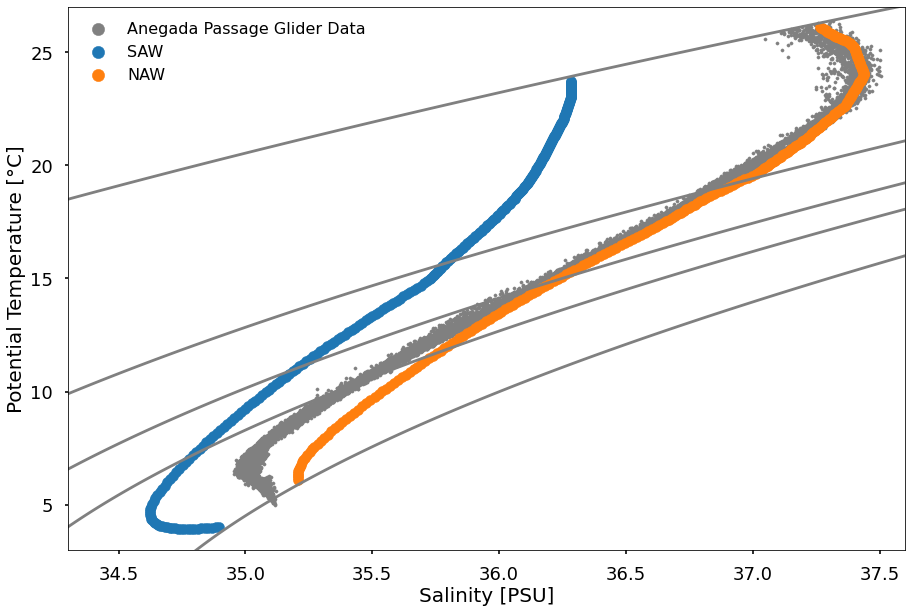

In [10]:
plt.figure(figsize=(15,10))

## markersize
s = 100


plt.scatter(subset_ds_2020.sal.values,subset_ds_2020.temp.values,s=10,c='grey',label='Anegada Passage Glider Data')
plt.scatter(subset_ds_2021a.sal.values,subset_ds_2021a.temp.values,s=10,c='grey')
plt.scatter(subset_ds_2021b.sal.values,subset_ds_2021b.temp.values,s=10,c='grey')
plt.scatter(subset_ds_2022.sal.values,subset_ds_2022.temp.values,s=10,c='grey')



## SAW
plt.scatter(saw_interp_mean_sal,saw_interp_mean_temp,s=s,label='SAW')
## NAW
plt.scatter(naw_interp_mean_sal,naw_interp_mean_temp,s=s,label='NAW')


plt.gca().tick_params(axis='both', which='major', labelsize=18)
plt.gca().tick_params(axis='both', which='minor', labelsize=18)
plt.ylim(3,27)
plt.xlim(34.3,37.6)
plt.xlabel('Salinity [PSU]', size=20)
plt.ylabel('Potential Temperature [''\N{DEGREE SIGN}''C]', size=20)
lgnd = plt.legend(frameon=False)
for handle in lgnd.legendHandles:
    handle.set_sizes([150])

######## This plots the contours
mint=1
maxt=30
mins=34
maxs=37.5
tempL=np.linspace(mint-1,maxt+1,399)
salL=np.linspace(mins-1,maxs+1,399)
Tg, Sg = np.meshgrid(tempL,salL)

z=np.linspace(-1000,0,399)
p = gsw.p_from_z(z,lat=0)

sigma_theta = gsw.sigma0(Sg, Tg)+1000

#sigma_theta = gsw.sigma0(Sg, Tg)+1000 # ignore effects of pressure on density
cnt = np.linspace(sigma_theta.min(), sigma_theta.max(),399)
ind = np.argwhere(sigma_theta > 1015.7)
st_short = sigma_theta[ind]
cs = plt.contour(Sg, Tg, sigma_theta, colors='grey', zorder=1 ,levels=[1024.5,1026.3,1026.8,1027.1,1027.6])
levels = cs.levels
#manual_locations = [(34.3, 26), (34.4, 25), (34.6,20), (34.75,16), (34.95,12), (35.15,7), (35.4,3), (36.5,2)]
#plt.clabel(cs,levels, fontsize=12,inline=True,fmt='%.1f', manual=manual_locations)



## Save end memebers!

In [162]:
d = {'density': gridden,'naw_temp':naw_interp_mean_temp, 'naw_sal': naw_interp_mean_sal,
     'saw_temp': saw_interp_mean_temp, 'saw_sal': saw_interp_mean_sal}

df = pd.DataFrame(data=d)

#df.to_csv('/home/jg1200/Data/naw_saw_endmember_t_s_d_profile.csv')


In [12]:
df

,density,naw_temp,naw_sal,saw_temp,saw_sal
0,1024.561561,26.084715,37.267228,23.707804,36.284925
1,1024.571561,26.060822,37.270529,23.673356,36.284798
2,1024.581561,26.036929,37.273831,23.638908,36.284671
3,1024.591561,26.013045,37.277139,23.604459,36.284544
4,1024.601561,25.989303,37.280547,23.570011,36.284417
...,...,...,...,...,...
297,1027.531561,6.413858,35.207483,3.971765,34.839523
298,1027.541561,6.331399,35.206232,3.981934,34.853507
299,1027.551561,6.250726,35.205335,3.993843,34.867727
300,1027.561561,6.179308,35.206270,4.005752,34.881947


In [13]:
## initialize
NAW =       ["NAW",   np.nan,   np.nan]
SAW =       ["SAW",   np.nan,  np.nan]


def prepare_endmember_df(endmembers_arr):
    df = pd.DataFrame(data=endmembers_arr,
                      columns=["endmember_name", "potential_temperature", "salinity"])
    df["mass"] = 1
    return df

endmemberdf = prepare_endmember_df([NAW, SAW])
endmemberdf

,endmember_name,potential_temperature,salinity,mass
0,NAW,NaN,NaN,1
1,SAW,NaN,NaN,1


In [14]:

def solve_endmember_fractions_single(df,naw_interp_mean_temp,naw_interp_mean_sal,saw_interp_mean_temp,saw_interp_mean_sal,gridden):
    ## preallocation soln matrix
    naw_frac_df = np.empty(df.temp.shape)
    naw_frac_df[:] = np.nan
    saw_frac_df = np.empty(df.temp.shape)
    saw_frac_df[:] = np.nan
    temp_resid_df = np.empty(df.temp.shape)
    temp_resid_df[:] = np.nan
    sal_resid_df = np.empty(df.temp.shape)
    sal_resid_df[:] = np.nan
    mass_resid_df = np.empty(df.temp.shape)
    mass_resid_df[:] = np.nan

    ## Loop through each row (depth) and perform water mass analysis
    for x in np.arange(0,len(df.depth)):
        for y in np.arange(0,len(df.dist)):
            ## if there is a nan value, skip
            if ~np.isnan(df.temp.values[x,y]):
                ## subset to just the depth row of interest and make pandas dataframe
                d = {'potential_temperature': df.temp.values[x,y], 'salinity': df.sal.values[x,y]}
                obs_df = pd.DataFrame(data=d, index=[0])
                obs_df["mass"] = 1.0

                ## find matching closest isopycnal index in source water data
                ## theoretically a different index for NAW vs SAW
                diffs = np.abs(df.density.values[x,y]-gridden)
                naw_iso_ind = np.nanargmin(diffs)
                saw_iso_ind = np.nanargmin(diffs)

                ## oull out NAW and SAW temp and sal
                endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
                endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
                endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
                endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
                ## run analysis
                ompa_soln = pyompa.OMPAProblem(obs_df = obs_df, **settings).solve(endmemberdf,endmember_name_column = "endmember_name")
                ## save soln'n
                naw_frac_df[x,y]   = ompa_soln.endmember_fractions[0,0]
                saw_frac_df[x,y]   = ompa_soln.endmember_fractions[0,1]
                temp_resid_df[x,y] = ompa_soln.param_residuals[0,0]
                sal_resid_df[x,y]  = ompa_soln.param_residuals[0,1]
                mass_resid_df[x,y] = ompa_soln.param_residuals[0,2]

    df["naw_frac"]=(['depth', 'dist'],  naw_frac_df)
    df["saw_frac"]=(['depth', 'dist'],  saw_frac_df)
    df["temp_resid"]=(['depth', 'dist'],  temp_resid_df)
    df["sal_resid"]=(['depth', 'dist'],  sal_resid_df)
    df["mass_resid"]=(['depth', 'dist'],  mass_resid_df)

    ############ Now calculate transport!!!!!
    ## preallocate for loop
    transport = np.empty(df.cross_vel.shape)
    transport[:] = np.NaN
    ## calc dz based on depth data
    dz = df.depth.values[1]-df.depth.values[0]

    ## loop through and calculate transport in Sv based on dz and dx (dist)
    for x in np.arange(0,len(df.dist)):
        transport[:,x] = (df.cross_vel[:,x].values*dz*df.dist.values[x])/(10**6)

    ## now multiply by %naw oand %saw to calculate transport of naw and saw
    naw_transport = transport*naw_frac_df
    saw_transport = transport*saw_frac_df

    df["transport"]=(['depth', 'dist'],  transport)
    df["naw_transport"]=(['depth', 'dist'],  naw_transport)
    df["saw_transport"]=(['depth', 'dist'],  saw_transport)
    return df


def calc_transport_single(df):
    ############ Now calculate transport!!!!!
    ## preallocate for loop
    transport = np.empty(df.cross_vel.shape)
    transport[:] = np.NaN
    ## calc dz based on depth data
    dz = df.depth.values[1]-df.depth.values[0]
    
    ## loop through and calculate transport in Sv based on dz and dx (dist)
    for x in np.arange(0,len(df.dist)):
        transport[:,x] = (df.cross_vel[:,x].values*dz*df.dist.values[x])/(10**6)

    df["transport"]=(['depth', 'dist'],  transport)

    return df


In [15]:
subset_ds_2021a_surf_final = calc_transport_single(subset_ds_2021a_surf)
subset_ds_2021b_surf_final = calc_transport_single(subset_ds_2021b_surf)

In [16]:
df_2021a_final = solve_endmember_fractions_single(subset_ds_2021a,naw_interp_mean_temp,naw_interp_mean_sal,saw_interp_mean_temp,saw_interp_mean_sal,gridden)


Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.158276535951399e-06
Original weighted sum squares: 5.158276535951399e-06
Post fix weighted sum squared: 5.158276535933842e-06
On example 0 to 1 out of 1
status: optimal
optimal value 5.158276535951399e-06
Original weighted sum squares: 5.158276535951399e-06
Post fix weighted sum squared: 5.158276535933842e-06
objective: 5.158276535933842e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0045354320909766765
Original weighted sum squares: 0.0045354320909766765
Post fix weighted sum squared: 0.004535

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0026523764704728912
Original weighted sum squares: 0.0026523764704728912
Post fix weighted sum squared: 0.0026523764704728912
objective: 0.0026523764704728912
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017511322888231866
Original weighted sum squares: 0.0017511322888231866
Post fix weighted sum squared: 0.0017511322888236229
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017511322888231866
Original weighted sum squares: 0.0017511322888231866
Post fix weighted sum squared: 0.0017511322888236229
objective: 0.0017511322888236229
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0013489950749138553
Original weighted sum squares: 0.0013489950749138553
Post fix weighted sum squared: 0.0013489950749138553
objective: 0.0013489950749138553
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.4671198880127927e-07
Original weighted sum squares: 2.4671198880127927e-07
Post fix weighted sum squared: 2.4671198880127927e-07
On example 0 to 1 out of 1
status: optimal
optimal value 2.4671198880127927e-07
Original weighted sum squares: 2.4671198880127927e-07
Post fix weighted sum squared: 2.4671198880127927e-07
objective: 2.4671198880127927e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 6.525783292231605e-05
Original weighted sum squares: 6.525783292231605e-05
Post fix weighted sum squared: 6.525783292231605e-05
objective: 6.525783292231605e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.0589505326113807e-05
Original weighted sum squares: 1.0589505326113807e-05
Post fix weighted sum squared: 1.0589505326113807e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.0589505326113807e-05
Original weighted sum squares: 1.0589505326113807e-05
Post fix weighted sum squared: 1.0589505326113807e-05
objective: 1.0589505326113807e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 5.460778507946868e-05
Original weighted sum squares: 5.460778507946868e-05
Post fix weighted sum squared: 5.460778507946868e-05
objective: 5.460778507946868e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.83874050005015e-05
Original weighted sum squares: 3.83874050005015e-05
Post fix weighted sum squared: 3.83874050005015e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.83874050005015e-05
Original weighted sum squares: 3.83874050005015e-05
Post fix weighted sum squared: 3.83874050005015e-05
objective: 3.83874050005015e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean

status: optimal
optimal value 3.10243468387496e-05
Original weighted sum squares: 3.10243468387496e-05
Post fix weighted sum squared: 3.10243468387496e-05
objective: 3.10243468387496e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.5074633722095613e-06
Original weighted sum squares: 2.5074633722095613e-06
Post fix weighted sum squared: 2.5074633722426095e-06
On example 0 to 1 out of 1
status: optimal
optimal value 2.5074633722095613e-06
Original weighted sum squares: 2.5074633722095613e-06
Post fix weighted sum squared: 2.5074633722426095e-06
objective: 2.5074633722426095e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.620713819945407e-05
Original weighted sum squares: 4.620713819945407e-05
Post fix weighted sum squared: 4.620713819945407e-05
objective: 4.620713819945407e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.141275468217314e-05
Original weighted sum squares: 3.141275468217314e-05
Post fix weighted sum squared: 3.141275468217314e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.141275468217314e-05
Original weighted sum squares: 3.141275468217314e-05
Post fix weighted sum squared: 3.141275468217314e-05
objective: 3.141275468217314e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.708255429657247e-05
Original weighted sum squares: 1.708255429657247e-05
Post fix weighted sum squared: 1.708255429657247e-05
objective: 1.708255429657247e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.767809242845994e-08
Original weighted sum squares: 6.767809242845994e-08
Post fix weighted sum squared: 6.767809242845994e-08
On example 0 to 1 out of 1
status: optimal
optimal value 6.767809242845994e-08
Original weighted sum squares: 6.767809242845994e-08
Post fix weighted sum squared: 6.767809242845994e-08
objective: 6.767809242845994e-08
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 3.4331809149258576e-05
Original weighted sum squares: 3.4331809149258576e-05
Post fix weighted sum squared: 3.4331809149242984e-05
objective: 3.4331809149242984e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.77238094894778e-06
Original weighted sum squares: 8.77238094894778e-06
Post fix weighted sum squared: 8.772380948955706e-06
On example 0 to 1 out of 1
status: optimal
optimal value 8.77238094894778e-06
Original weighted sum squares: 8.77238094894778e-06
Post fix weighted sum squared: 8.772380948955706e-06
objective: 8.772380948955706e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.5716128824286978e-05
Original weighted sum squares: 2.5716128824286978e-05
Post fix weighted sum squared: 2.5716128824326087e-05
objective: 2.5716128824326087e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007477090195049825
Original weighted sum squares: 0.0007477090195049825
Post fix weighted sum squared: 0.0007477090195052676
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007477090195049825
Original weighted sum squares: 0.0007477090195049825
Post fix weighted sum squared: 0.0007477090195052676
objective: 0.0007477090195052676
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 8.298605096446923e-05
Original weighted sum squares: 8.298605096446923e-05
Post fix weighted sum squared: 8.298605096454004e-05
objective: 8.298605096454004e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.456583353822195e-05
Original weighted sum squares: 7.456583353822195e-05
Post fix weighted sum squared: 7.456583353819863e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.456583353822195e-05
Original weighted sum squares: 7.456583353822195e-05
Post fix weighted sum squared: 7.456583353819863e-05
objective: 7.456583353819863e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.2988124039650014e-05
Original weighted sum squares: 4.2988124039650014e-05
Post fix weighted sum squared: 4.298812403971846e-05
objective: 4.298812403971846e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.8932968075407223e-09
Original weighted sum squares: 1.8932968075407223e-09
Post fix weighted sum squared: 1.8932968067471814e-09
On example 0 to 1 out of 1
status: optimal
optimal value 1.8932968075407223e-09
Original weighted sum squares: 1.8932968075407223e-09
Post fix weighted sum squared: 1.8932968067471814e-09
objective: 1.8932968067471814e-09
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.6392702786695794e-05
Original weighted sum squares: 5.6392702786695794e-05
Post fix weighted sum squared: 5.6392702786774534e-05
objective: 5.6392702786774534e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.475922866041408e-05
Original weighted sum squares: 7.475922866041408e-05
Post fix weighted sum squared: 7.475922866041408e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.475922866041408e-05
Original weighted sum squares: 7.475922866041408e-05
Post fix weighted sum squared: 7.475922866041408e-05
objective: 7.475922866041408e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.571657710589115e-05
Original weighted sum squares: 2.571657710589115e-05
Post fix weighted sum squared: 2.5716577105877703e-05
objective: 2.5716577105877703e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.880125189936991e-05
Original weighted sum squares: 1.880125189936991e-05
Post fix weighted sum squared: 1.8801251899415567e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.880125189936991e-05
Original weighted sum squares: 1.880125189936991e-05
Post fix weighted sum squared: 1.8801251899415567e-05
objective: 1.8801251899415567e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 1.143244302684431e-05
Original weighted sum squares: 1.143244302684431e-05
Post fix weighted sum squared: 1.1432443026879764e-05
objective: 1.1432443026879764e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.7585687498206504e-10
Original weighted sum squares: 3.7585687498206504e-10
Post fix weighted sum squared: 3.758568747266958e-10
On example 0 to 1 out of 1
status: optimal
optimal value 3.7585687498206504e-10
Original weighted sum squares: 3.7585687498206504e-10
Post fix weighted sum squared: 3.758568747266958e-10
objective: 3.758568747266958e-10
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvari

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.513164728102936e-05
Original weighted sum squares: 7.513164728102936e-05
Post fix weighted sum squared: 7.513164728100626e-05
objective: 7.513164728100626e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.460952919865277e-05
Original weighted sum squares: 3.460952919865277e-05
Post fix weighted sum squared: 3.4609529198761384e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.460952919865277e-05
Original weighted sum squares: 3.460952919865277e-05
Post fix weighted sum squared: 3.4609529198761384e-05
objective: 3.4609529198761384e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.334387152581203e-06
Original weighted sum squares: 7.334387152581203e-06
Post fix weighted sum squared: 7.334387152559824e-06
objective: 7.334387152559824e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.687933988814808e-07
Original weighted sum squares: 7.687933988814808e-07
Post fix weighted sum squared: 7.687933988882969e-07
On example 0 to 1 out of 1
status: optimal
optimal value 7.687933988814808e-07
Original weighted sum squares: 7.687933988814808e-07
Post fix weighted sum squared: 7.687933988882969e-07
objective: 7.687933988882969e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 1.3800586061497263e-05
Original weighted sum squares: 1.3800586061497263e-05
Post fix weighted sum squared: 1.3800586061487519e-05
objective: 1.3800586061487519e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.230677980406494e-05
Original weighted sum squares: 7.230677980406494e-05
Post fix weighted sum squared: 7.230677980399782e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.230677980406494e-05
Original weighted sum squares: 7.230677980406494e-05
Post fix weighted sum squared: 7.230677980399782e-05
objective: 7.230677980399782e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.987472587064576e-05
Original weighted sum squares: 1.987472587064576e-05
Post fix weighted sum squared: 1.987472587064576e-05
objective: 1.987472587064576e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.2550575470265272e-05
Original weighted sum squares: 1.2550575470265272e-05
Post fix weighted sum squared: 1.2550575470228011e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.2550575470265272e-05
Original weighted sum squares: 1.2550575470265272e-05
Post fix weighted sum squared: 1.2550575470228011e-05
objective: 1.2550575470228011e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 7.058592564634809e-06
Original weighted sum squares: 7.058592564634809e-06
Post fix weighted sum squared: 7.058592564613725e-06
objective: 7.058592564613725e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.089873403764123e-05
Original weighted sum squares: 5.089873403764123e-05
Post fix weighted sum squared: 5.089873403764123e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.089873403764123e-05
Original weighted sum squares: 5.089873403764123e-05
Post fix weighted sum squared: 5.089873403764123e-05
objective: 5.089873403764123e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.379000008855313e-05
Original weighted sum squares: 2.379000008855313e-05
Post fix weighted sum squared: 2.379000008850181e-05
objective: 2.379000008850181e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.393956786594221e-06
Original weighted sum squares: 2.393956786594221e-06
Post fix weighted sum squared: 2.393956786594221e-06
On example 0 to 1 out of 1
status: optimal
optimal value 2.393956786594221e-06
Original weighted sum squares: 2.393956786594221e-06
Post fix weighted sum squared: 2.393956786594221e-06
objective: 2.393956786594221e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 2.3649552521787905e-05
Original weighted sum squares: 2.3649552521787905e-05
Post fix weighted sum squared: 2.3649552521736385e-05
objective: 2.3649552521736385e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.5522054883079772e-05
Original weighted sum squares: 1.5522054883079772e-05
Post fix weighted sum squared: 1.5522054883121287e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.5522054883079772e-05
Original weighted sum squares: 1.5522054883079772e-05
Post fix weighted sum squared: 1.5522054883121287e-05
objective: 1.5522054883121287e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.5821364233779016e-08
Original weighted sum squares: 2.5821364233779016e-08
Post fix weighted sum squared: 2.5821364235472255e-08
objective: 2.5821364235472255e-08
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.59998009129567e-06
Original weighted sum squares: 1.59998009129567e-06
Post fix weighted sum squared: 1.5999800913058469e-06
On example 0 to 1 out of 1
status: optimal
optimal value 1.59998009129567e-06
Original weighted sum squares: 1.59998009129567e-06
Post fix weighted sum squared: 1.5999800913058469e-06
objective: 1.5999800913058469e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 4.3163545208020156e-07
Original weighted sum squares: 4.3163545208020156e-07
Post fix weighted sum squared: 4.316354520854831e-07
objective: 4.316354520854831e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.0725357706552954e-06
Original weighted sum squares: 1.0725357706552954e-06
Post fix weighted sum squared: 1.0725357706552954e-06
On example 0 to 1 out of 1
status: optimal
optimal value 1.0725357706552954e-06
Original weighted sum squares: 1.0725357706552954e-06
Post fix weighted sum squared: 1.0725357706552954e-06
objective: 1.0725357706552954e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.9321863945543466e-05
Original weighted sum squares: 1.9321863945543466e-05
Post fix weighted sum squared: 1.932186394549696e-05
objective: 1.932186394549696e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.078753439583183e-05
Original weighted sum squares: 2.078753439583183e-05
Post fix weighted sum squared: 2.078753439583183e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.078753439583183e-05
Original weighted sum squares: 2.078753439583183e-05
Post fix weighted sum squared: 2.078753439583183e-05
objective: 2.078753439583183e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.8047279581590987e-05
Original weighted sum squares: 1.8047279581590987e-05
Post fix weighted sum squared: 1.804727958151238e-05
objective: 1.804727958151238e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.6550302612787153e-05
Original weighted sum squares: 1.6550302612787153e-05
Post fix weighted sum squared: 1.655030261275487e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.6550302612787153e-05
Original weighted sum squares: 1.6550302612787153e-05
Post fix weighted sum squared: 1.655030261275487e-05
objective: 1.655030261275487e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvari

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 9.521710058524904e-07
Original weighted sum squares: 9.521710058524904e-07
Post fix weighted sum squared: 9.521710058524904e-07
objective: 9.521710058524904e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.0806167651789704e-05
Original weighted sum squares: 4.0806167651789704e-05
Post fix weighted sum squared: 4.080616765173814e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.0806167651789704e-05
Original weighted sum squares: 4.0806167651789704e-05
Post fix weighted sum squared: 4.080616765173814e-05
objective: 4.080616765173814e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.338652654517405e-05
Original weighted sum squares: 3.338652654517405e-05
Post fix weighted sum squared: 3.338652654517405e-05
objective: 3.338652654517405e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.0758412180767294e-06
Original weighted sum squares: 3.0758412180767294e-06
Post fix weighted sum squared: 3.0758412180767294e-06
On example 0 to 1 out of 1
status: optimal
optimal value 3.0758412180767294e-06
Original weighted sum squares: 3.0758412180767294e-06
Post fix weighted sum squared: 3.0758412180767294e-06
objective: 3.0758412180767294e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.3063298380598614e-06
Original weighted sum squares: 2.3063298380598614e-06
Post fix weighted sum squared: 2.306329838011278e-06
objective: 2.306329838011278e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.2122697970485779e-05
Original weighted sum squares: 1.2122697970485779e-05
Post fix weighted sum squared: 1.212269797052309e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.2122697970485779e-05
Original weighted sum squares: 1.2122697970485779e-05
Post fix weighted sum squared: 1.212269797052309e-05
objective: 1.212269797052309e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvari

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.2247859858930646e-05
Original weighted sum squares: 1.2247859858930646e-05
Post fix weighted sum squared: 1.2247859858893309e-05
objective: 1.2247859858893309e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.154047079788438e-05
Original weighted sum squares: 4.154047079788438e-05
Post fix weighted sum squared: 4.154047079788438e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.154047079788438e-05
Original weighted sum squares: 4.154047079788438e-05
Post fix weighted sum squared: 4.154047079788438e-05
objective: 4.154047079788438e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.153846525365677e-05
Original weighted sum squares: 6.153846525365677e-05
Post fix weighted sum squared: 6.153846525348822e-05
objective: 6.153846525348822e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.914608124643429e-05
Original weighted sum squares: 5.914608124643429e-05
Post fix weighted sum squared: 5.91460812462082e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.914608124643429e-05
Original weighted sum squares: 5.914608124643429e-05
Post fix weighted sum squared: 5.91460812462082e-05
objective: 5.91460812462082e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.321497067884272e-06
Original weighted sum squares: 4.321497067884272e-06
Post fix weighted sum squared: 4.32149706784543e-06
objective: 4.32149706784543e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.5017051746499672e-05
Original weighted sum squares: 1.5017051746499672e-05
Post fix weighted sum squared: 1.5017051746499672e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.5017051746499672e-05
Original weighted sum squares: 1.5017051746499672e-05
Post fix weighted sum squared: 1.5017051746499672e-05
objective: 1.5017051746499672e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.4969580073348037e-06
Original weighted sum squares: 3.4969580073348037e-06
Post fix weighted sum squared: 3.4969580073796634e-06
objective: 3.4969580073796634e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.9141616845920626e-06
Original weighted sum squares: 1.9141616845920626e-06
Post fix weighted sum squared: 1.914161684577258e-06
On example 0 to 1 out of 1
status: optimal
optimal value 1.9141616845920626e-06
Original weighted sum squares: 1.9141616845920626e-06
Post fix weighted sum squared: 1.914161684577258e-06
objective: 1.914161684577258e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedva

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 7.149258893798479e-07
Original weighted sum squares: 7.149258893798479e-07
Post fix weighted sum squared: 7.149258893798479e-07
objective: 7.149258893798479e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.267703415583188e-05
Original weighted sum squares: 9.267703415583188e-05
Post fix weighted sum squared: 9.267703415583188e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.267703415583188e-05
Original weighted sum squares: 9.267703415583188e-05
Post fix weighted sum squared: 9.267703415583188e-05
objective: 9.267703415583188e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.5124961668484744e-05
Original weighted sum squares: 4.5124961668484744e-05
Post fix weighted sum squared: 4.512496166862936e-05
objective: 4.512496166862936e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.456440405987779e-06
Original weighted sum squares: 5.456440405987779e-06
Post fix weighted sum squared: 5.456440405931924e-06
On example 0 to 1 out of 1
status: optimal
optimal value 5.456440405987779e-06
Original weighted sum squares: 5.456440405987779e-06
Post fix weighted sum squared: 5.456440405931924e-06
objective: 5.456440405931924e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 8.08609264029158e-06
Original weighted sum squares: 8.08609264029158e-06
Post fix weighted sum squared: 8.086092640268234e-06
objective: 8.086092640268234e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.009073449525581083
Original weighted sum squares: 0.009073449525581083
Post fix weighted sum squared: 0.009073449525582153
On example 0 to 1 out of 1
status: optimal
optimal value 0.009073449525581083
Original weighted sum squares: 0.009073449525581083
Post fix weighted sum squared: 0.009073449525582153
objective: 0.009073449525582153
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.005262140532853977
Original weighted sum squares: 0.005262140532853977
Post fix weighted sum squared: 0.0052621405328531915
objective: 0.0052621405328531915
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0020110550527718853
Original weighted sum squares: 0.0020110550527718853
Post fix weighted sum squared: 0.0020110550527714125
On example 0 to 1 out of 1
status: optimal
optimal value 0.0020110550527718853
Original weighted sum squares: 0.0020110550527718853
Post fix weighted sum squared: 0.0020110550527714125
objective: 0.0020110550527714125
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 9.960939211473905e-06
Original weighted sum squares: 9.960939211473905e-06
Post fix weighted sum squared: 9.960939211549868e-06
objective: 9.960939211549868e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.876232915608902e-05
Original weighted sum squares: 2.876232915608902e-05
Post fix weighted sum squared: 2.8762329156218104e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.876232915608902e-05
Original weighted sum squares: 2.876232915608902e-05
Post fix weighted sum squared: 2.8762329156218104e-05
objective: 2.8762329156218104e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 6.974930888558313e-05
Original weighted sum squares: 6.974930888558313e-05
Post fix weighted sum squared: 6.97493088854261e-05
objective: 6.97493088854261e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.58826649956356e-08
Original weighted sum squares: 9.58826649956356e-08
Post fix weighted sum squared: 9.588266499893891e-08
On example 0 to 1 out of 1
status: optimal
optimal value 9.58826649956356e-08
Original weighted sum squares: 9.58826649956356e-08
Post fix weighted sum squared: 9.588266499893891e-08
objective: 9.588266499893891e-08
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign co

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 9.268429231329464e-06
Original weighted sum squares: 9.268429231329464e-06
Post fix weighted sum squared: 9.26842923135464e-06
objective: 9.26842923135464e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001220845203963889
Original weighted sum squares: 0.0001220845203963889
Post fix weighted sum squared: 0.0001220845203963889
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001220845203963889
Original weighted sum squares: 0.0001220845203963889
Post fix weighted sum squared: 0.0001220845203963889
objective: 0.0001220845203963889
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 8.798001200008306e-05
Original weighted sum squares: 8.798001200008306e-05
Post fix weighted sum squared: 8.798001200005872e-05
objective: 8.798001200005872e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.980069612966843e-05
Original weighted sum squares: 4.980069612966843e-05
Post fix weighted sum squared: 4.9800696129535754e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.980069612966843e-05
Original weighted sum squares: 4.980069612966843e-05
Post fix weighted sum squared: 4.9800696129535754e-05
objective: 4.9800696129535754e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0024228192239448146
Original weighted sum squares: 0.0024228192239448146
Post fix weighted sum squared: 0.0024228192239448146
objective: 0.0024228192239448146
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00770563141557615
Original weighted sum squares: 0.00770563141557615
Post fix weighted sum squared: 0.007705631415578817
On example 0 to 1 out of 1
status: optimal
optimal value 0.00770563141557615
Original weighted sum squares: 0.00770563141557615
Post fix weighted sum squared: 0.007705631415578817
objective: 0.007705631415578817
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.013766321381123542
Original weighted sum squares: 0.013766321381123542
Post fix weighted sum squared: 0.013766321381122163
objective: 0.013766321381122163
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.4161482823978955e-06
Original weighted sum squares: 2.4161482823978955e-06
Post fix weighted sum squared: 2.416148282410967e-06
On example 0 to 1 out of 1
status: optimal
optimal value 2.4161482823978955e-06
Original weighted sum squares: 2.4161482823978955e-06
Post fix weighted sum squared: 2.416148282410967e-06
objective: 2.416148282410967e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.008866545757483585
Original weighted sum squares: 0.008866545757483585
Post fix weighted sum squared: 0.008866545757482457
objective: 0.008866545757482457
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.01863487167805042
Original weighted sum squares: 0.01863487167805042
Post fix weighted sum squared: 0.01863487167805042
On example 0 to 1 out of 1
status: optimal
optimal value 0.01863487167805042
Original weighted sum squares: 0.01863487167805042
Post fix weighted sum squared: 0.01863487167805042
objective: 0.01863487167805042
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.613043876294773e-05
Original weighted sum squares: 3.613043876294773e-05
Post fix weighted sum squared: 3.613043876294773e-05
objective: 3.613043876294773e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.6272330726765297e-06
Original weighted sum squares: 3.6272330726765297e-06
Post fix weighted sum squared: 3.6272330726511992e-06
On example 0 to 1 out of 1
status: optimal
optimal value 3.6272330726765297e-06
Original weighted sum squares: 3.6272330726765297e-06
Post fix weighted sum squared: 3.6272330726511992e-06
objective: 3.6272330726511992e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 3.721524711430805e-05
Original weighted sum squares: 3.721524711430805e-05
Post fix weighted sum squared: 3.7215247114190264e-05
objective: 3.7215247114190264e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.6304587310736316e-05
Original weighted sum squares: 3.6304587310736316e-05
Post fix weighted sum squared: 3.6304587310801477e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.6304587310736316e-05
Original weighted sum squares: 3.6304587310736316e-05
Post fix weighted sum squared: 3.6304587310801477e-05
objective: 3.6304587310801477e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.841875817020571e-05
Original weighted sum squares: 3.841875817020571e-05
Post fix weighted sum squared: 3.8418758170323795e-05
objective: 3.8418758170323795e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.9283182590092e-05
Original weighted sum squares: 6.9283182590092e-05
Post fix weighted sum squared: 6.92831825899313e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.9283182590092e-05
Original weighted sum squares: 6.9283182590092e-05
Post fix weighted sum squared: 6.92831825899313e-05
objective: 6.92831825899313e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.1418440736580895e-05
Original weighted sum squares: 1.1418440736580895e-05
Post fix weighted sum squared: 1.1418440736580895e-05
objective: 1.1418440736580895e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.1804268434795124e-05
Original weighted sum squares: 5.1804268434795124e-05
Post fix weighted sum squared: 5.1804268434795124e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.1804268434795124e-05
Original weighted sum squares: 5.1804268434795124e-05
Post fix weighted sum squared: 5.1804268434795124e-05
objective: 5.1804268434795124e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.010082202892945525
Original weighted sum squares: 0.010082202892945525
Post fix weighted sum squared: 0.01008220289294667
objective: 0.01008220289294667
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.006589095321364629
Original weighted sum squares: 0.006589095321364629
Post fix weighted sum squared: 0.006589095321363661
On example 0 to 1 out of 1
status: optimal
optimal value 0.006589095321364629
Original weighted sum squares: 0.006589095321364629
Post fix weighted sum squared: 0.006589095321363661
objective: 0.006589095321363661
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrain

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 4.191222251296739e-05
Original weighted sum squares: 4.191222251296739e-05
Post fix weighted sum squared: 4.1912222512896334e-05
objective: 4.1912222512896334e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0024676705428900783
Original weighted sum squares: 0.0024676705428900783
Post fix weighted sum squared: 0.0024676705428890396
On example 0 to 1 out of 1
status: optimal
optimal value 0.0024676705428900783
Original weighted sum squares: 0.0024676705428900783
Post fix weighted sum squared: 0.0024676705428890396
objective: 0.0024676705428890396
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = s

 optimal
optimal value 3.0116058473395262e-05
Original weighted sum squares: 3.0116058473395262e-05
Post fix weighted sum squared: 3.0116058473261627e-05
objective: 3.0116058473261627e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.1931122448480823e-06
Original weighted sum squares: 3.1931122448480823e-06
Post fix weighted sum squared: 3.1931122448480823e-06
On example 0 to 1 out of 1
status: optimal
optimal value 3.1931122448480823e-06
Original weighted sum squares: 3.1931122448480823e-06
Post fix weighted sum squared: 3.1931122448480823e-06
objective: 3.1931122448480823e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean

status: optimal
optimal value 0.00018501241250034415
Original weighted sum squares: 0.00018501241250034415
Post fix weighted sum squared: 0.00018501241250058197
objective: 0.00018501241250058197
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.3707723960478564e-07
Original weighted sum squares: 3.3707723960478564e-07
Post fix weighted sum squared: 3.3707723960478564e-07
On example 0 to 1 out of 1
status: optimal
optimal value 3.3707723960478564e-07
Original weighted sum squares: 3.3707723960478564e-07
Post fix weighted sum squared: 3.3707723960478564e-07
objective: 3.3707723960478564e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean

status: optimal
optimal value 8.593550850717605e-05
Original weighted sum squares: 8.593550850717605e-05
Post fix weighted sum squared: 8.59355085070968e-05
objective: 8.59355085070968e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.144257581532193e-11
Original weighted sum squares: 8.144257581532193e-11
Post fix weighted sum squared: 8.144257603430422e-11
On example 0 to 1 out of 1
status: optimal
optimal value 8.144257581532193e-11
Original weighted sum squares: 8.144257581532193e-11
Post fix weighted sum squared: 8.144257603430422e-11
objective: 8.144257603430422e-11
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 1.276437870610389e-05
Original weighted sum squares: 1.276437870610389e-05
Post fix weighted sum squared: 1.2764378706142727e-05
objective: 1.2764378706142727e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.328521756787321e-08
Original weighted sum squares: 4.328521756787321e-08
Post fix weighted sum squared: 4.328521756787321e-08
On example 0 to 1 out of 1
status: optimal
optimal value 4.328521756787321e-08
Original weighted sum squares: 4.328521756787321e-08
Post fix weighted sum squared: 4.328521756787321e-08
objective: 4.328521756787321e-08
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 9.582462882576931e-06
Original weighted sum squares: 9.582462882576931e-06
Post fix weighted sum squared: 9.582462882542957e-06
objective: 9.582462882542957e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.5636044913537726e-05
Original weighted sum squares: 2.5636044913537726e-05
Post fix weighted sum squared: 2.5636044913537726e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.5636044913537726e-05
Original weighted sum squares: 2.5636044913537726e-05
Post fix weighted sum squared: 2.5636044913537726e-05
objective: 2.5636044913537726e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.004806858408633949
Original weighted sum squares: 0.004806858408633949
Post fix weighted sum squared: 0.004806858408633949
objective: 0.004806858408633949
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002996279733149411
Original weighted sum squares: 0.002996279733149411
Post fix weighted sum squared: 0.0029962797331499983
On example 0 to 1 out of 1
status: optimal
optimal value 0.002996279733149411
Original weighted sum squares: 0.002996279733149411
Post fix weighted sum squared: 0.0029962797331499983
objective: 0.0029962797331499983
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0010051934066369083
Original weighted sum squares: 0.0010051934066369083
Post fix weighted sum squared: 0.001005193406637231
objective: 0.001005193406637231
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.008269474827190738
Original weighted sum squares: 0.008269474827190738
Post fix weighted sum squared: 0.008269474827189715
On example 0 to 1 out of 1
status: optimal
optimal value 0.008269474827190738
Original weighted sum squares: 0.008269474827190738
Post fix weighted sum squared: 0.008269474827189715
objective: 0.008269474827189715
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 7.367097947935378e-05
Original weighted sum squares: 7.367097947935378e-05
Post fix weighted sum squared: 7.367097947935378e-05
objective: 7.367097947935378e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.971276751353836e-06
Original weighted sum squares: 3.971276751353836e-06
Post fix weighted sum squared: 3.97127675130548e-06
On example 0 to 1 out of 1
status: optimal
optimal value 3.971276751353836e-06
Original weighted sum squares: 3.971276751353836e-06
Post fix weighted sum squared: 3.97127675130548e-06
objective: 3.97127675130548e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.731247173488327e-07
Original weighted sum squares: 6.731247173488327e-07
Post fix weighted sum squared: 6.731247173398776e-07
objective: 6.731247173398776e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.8907333984835884e-06
Original weighted sum squares: 2.8907333984835884e-06
Post fix weighted sum squared: 2.8907333984835884e-06
On example 0 to 1 out of 1
status: optimal
optimal value 2.8907333984835884e-06
Original weighted sum squares: 2.8907333984835884e-06
Post fix weighted sum squared: 2.8907333984835884e-06
objective: 2.8907333984835884e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.2181063853399408e-06
Original weighted sum squares: 2.2181063853399408e-06
Post fix weighted sum squared: 2.2181063853725668e-06
objective: 2.2181063853725668e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.1036669794250757e-07
Original weighted sum squares: 2.1036669794250757e-07
Post fix weighted sum squared: 2.103666979324079e-07
On example 0 to 1 out of 1
status: optimal
optimal value 2.1036669794250757e-07
Original weighted sum squares: 2.1036669794250757e-07
Post fix weighted sum squared: 2.103666979324079e-07
objective: 2.103666979324079e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedva

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.3362058850493396e-05
Original weighted sum squares: 5.3362058850493396e-05
Post fix weighted sum squared: 5.3362058850493396e-05
objective: 5.3362058850493396e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.803027053456601e-05
Original weighted sum squares: 2.803027053456601e-05
Post fix weighted sum squared: 2.8030270534668992e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.803027053456601e-05
Original weighted sum squares: 2.803027053456601e-05
Post fix weighted sum squared: 2.8030270534668992e-05
objective: 2.8030270534668992e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.2717644679888117e-05
Original weighted sum squares: 2.2717644679888117e-05
Post fix weighted sum squared: 2.2717644679771182e-05
objective: 2.2717644679771182e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.519423326280449e-05
Original weighted sum squares: 1.519423326280449e-05
Post fix weighted sum squared: 1.5194233262761134e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.519423326280449e-05
Original weighted sum squares: 1.519423326280449e-05
Post fix weighted sum squared: 1.5194233262761134e-05
objective: 1.5194233262761134e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.7182915658229235e-07
Original weighted sum squares: 3.7182915658229235e-07
Post fix weighted sum squared: 3.7182915658229235e-07
objective: 3.7182915658229235e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.343821822985237e-05
Original weighted sum squares: 3.343821822985237e-05
Post fix weighted sum squared: 3.343821822998063e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.343821822985237e-05
Original weighted sum squares: 3.343821822985237e-05
Post fix weighted sum squared: 3.343821822998063e-05
objective: 3.343821822998063e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.3177273269734082e-06
Original weighted sum squares: 2.3177273269734082e-06
Post fix weighted sum squared: 2.3177273269903044e-06
objective: 2.3177273269903044e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.958705836423539e-05
Original weighted sum squares: 4.958705836423539e-05
Post fix weighted sum squared: 4.958705836431317e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.958705836423539e-05
Original weighted sum squares: 4.958705836423539e-05
Post fix weighted sum squared: 4.958705836431317e-05
objective: 4.958705836431317e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.5936121212791794e-06
Original weighted sum squares: 2.5936121212791794e-06
Post fix weighted sum squared: 2.5936121212930237e-06
objective: 2.5936121212930237e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.0880729079467525e-05
Original weighted sum squares: 1.0880729079467525e-05
Post fix weighted sum squared: 1.0880729079539785e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.0880729079467525e-05
Original weighted sum squares: 1.0880729079467525e-05
Post fix weighted sum squared: 1.0880729079539785e-05
objective: 1.0880729079539785e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.120941117074417e-05
Original weighted sum squares: 3.120941117074417e-05
Post fix weighted sum squared: 3.1209411170793335e-05
objective: 3.1209411170793335e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.820791223752287e-05
Original weighted sum squares: 9.820791223752287e-05
Post fix weighted sum squared: 9.820791223765613e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.820791223752287e-05
Original weighted sum squares: 9.820791223752287e-05
Post fix weighted sum squared: 9.820791223765613e-05
objective: 9.820791223765613e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 8.137059026602179e-05
Original weighted sum squares: 8.137059026602179e-05
Post fix weighted sum squared: 8.137059026580142e-05
objective: 8.137059026580142e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.7903522352183008e-06
Original weighted sum squares: 1.7903522352183008e-06
Post fix weighted sum squared: 1.7903522352330233e-06
On example 0 to 1 out of 1
status: optimal
optimal value 1.7903522352183008e-06
Original weighted sum squares: 1.7903522352183008e-06
Post fix weighted sum squared: 1.7903522352330233e-06
objective: 1.7903522352330233e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 9.146058801450906e-07
Original weighted sum squares: 9.146058801450906e-07
Post fix weighted sum squared: 9.146058801366384e-07
objective: 9.146058801366384e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010014830058858482
Original weighted sum squares: 0.00010014830058858482
Post fix weighted sum squared: 0.00010014830058833847
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010014830058858482
Original weighted sum squares: 0.00010014830058858482
Post fix weighted sum squared: 0.00010014830058833847
objective: 0.00010014830058833847
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 1.8239447880212673e-05
Original weighted sum squares: 1.8239447880212673e-05
Post fix weighted sum squared: 1.8239447880317414e-05
objective: 1.8239447880317414e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.010289128711285e-06
Original weighted sum squares: 6.010289128711285e-06
Post fix weighted sum squared: 6.010289128732951e-06
On example 0 to 1 out of 1
status: optimal
optimal value 6.010289128711285e-06
Original weighted sum squares: 6.010289128711285e-06
Post fix weighted sum squared: 6.010289128732951e-06
objective: 6.010289128732951e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.8525782193383463e-05
Original weighted sum squares: 3.8525782193383463e-05
Post fix weighted sum squared: 3.8525782193383463e-05
objective: 3.8525782193383463e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.58439143177611e-07
Original weighted sum squares: 6.58439143177611e-07
Post fix weighted sum squared: 6.584391431704789e-07
On example 0 to 1 out of 1
status: optimal
optimal value 6.58439143177611e-07
Original weighted sum squares: 6.58439143177611e-07
Post fix weighted sum squared: 6.584391431704789e-07
objective: 6.584391431704789e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00014246445839903848
Original weighted sum squares: 0.00014246445839903848
Post fix weighted sum squared: 0.00014246445839917032
objective: 0.00014246445839917032
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.8656371527705282e-06
Original weighted sum squares: 1.8656371527705282e-06
Post fix weighted sum squared: 1.8656371527705282e-06
On example 0 to 1 out of 1
status: optimal
optimal value 1.8656371527705282e-06
Original weighted sum squares: 1.8656371527705282e-06
Post fix weighted sum squared: 1.8656371527705282e-06
objective: 1.8656371527705282e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.258526313181346e-06
Original weighted sum squares: 2.258526313181346e-06
Post fix weighted sum squared: 2.2585263131980127e-06
objective: 2.2585263131980127e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.158955667792999e-05
Original weighted sum squares: 4.158955667792999e-05
Post fix weighted sum squared: 4.158955667792999e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.158955667792999e-05
Original weighted sum squares: 4.158955667792999e-05
Post fix weighted sum squared: 4.158955667792999e-05
objective: 4.158955667792999e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 5.488637435482081e-05
Original weighted sum squares: 5.488637435482081e-05
Post fix weighted sum squared: 5.488637435490304e-05
objective: 5.488637435490304e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.1184383611540502e-05
Original weighted sum squares: 2.1184383611540502e-05
Post fix weighted sum squared: 2.118438361159175e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.1184383611540502e-05
Original weighted sum squares: 2.1184383611540502e-05
Post fix weighted sum squared: 2.118438361159175e-05
objective: 2.118438361159175e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 7.846550288514255e-05
Original weighted sum squares: 7.846550288514255e-05
Post fix weighted sum squared: 7.846550288514255e-05
objective: 7.846550288514255e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.52178910099872e-06
Original weighted sum squares: 7.52178910099872e-06
Post fix weighted sum squared: 7.521789101022826e-06
On example 0 to 1 out of 1
status: optimal
optimal value 7.52178910099872e-06
Original weighted sum squares: 7.52178910099872e-06
Post fix weighted sum squared: 7.521789101022826e-06
objective: 7.521789101022826e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 8.187620331797244e-05
Original weighted sum squares: 8.187620331797244e-05
Post fix weighted sum squared: 8.187620331787122e-05
objective: 8.187620331787122e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.0480281286192984e-05
Original weighted sum squares: 2.0480281286192984e-05
Post fix weighted sum squared: 2.048028128634516e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.0480281286192984e-05
Original weighted sum squares: 2.0480281286192984e-05
Post fix weighted sum squared: 2.048028128634516e-05
objective: 2.048028128634516e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00012134251334916564
Original weighted sum squares: 0.00012134251334916564
Post fix weighted sum squared: 0.00012134251334891851
objective: 0.00012134251334891851
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.2065901687978382e-05
Original weighted sum squares: 2.2065901687978382e-05
Post fix weighted sum squared: 2.206590168787284e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.2065901687978382e-05
Original weighted sum squares: 2.2065901687978382e-05
Post fix weighted sum squared: 2.206590168787284e-05
objective: 2.206590168787284e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable 

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 7.617439464255428e-05
Original weighted sum squares: 7.617439464255428e-05
Post fix weighted sum squared: 7.617439464253445e-05
objective: 7.617439464253445e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.897938998209542e-05
Original weighted sum squares: 4.897938998209542e-05
Post fix weighted sum squared: 4.897938998201745e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.897938998209542e-05
Original weighted sum squares: 4.897938998209542e-05
Post fix weighted sum squared: 4.897938998201745e-05
objective: 4.897938998201745e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.4777183914843773e-05
Original weighted sum squares: 2.4777183914843773e-05
Post fix weighted sum squared: 2.4777183914733046e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.4777183914843773e-05
Original weighted sum squares: 2.4777183914843773e-05
Post fix weighted sum squared: 2.4777183914733046e-05
objective: 2.4777183914733046e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.2425240082173213e-06
Original weighted sum squares: 3.2425240082173213e-06
Post fix weighted sum squared: 3.2425240081774404e-06
On example 0 to 1 out of 1
status: optimal
optimal value 3.2425240082173213e-06
Original weighted sum squares: 3.2425240082173213e-06
Post fix weighted sum squared: 3.2425240081774404e-06
objective: 3.242524008177440

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 9.151608497612863e-05
Original weighted sum squares: 9.151608497612863e-05
Post fix weighted sum squared: 9.151608497612863e-05
objective: 9.151608497612863e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.389315939373926e-05
Original weighted sum squares: 3.389315939373926e-05
Post fix weighted sum squared: 3.389315939373926e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.389315939373926e-05
Original weighted sum squares: 3.389315939373926e-05
Post fix weighted sum squared: 3.389315939373926e-05
objective: 3.389315939373926e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.8718807776234302e-08
Original weighted sum squares: 2.8718807776234302e-08
Post fix weighted sum squared: 2.871880777434377e-08
objective: 2.871880777434377e-08
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.4755364110071073e-05
Original weighted sum squares: 5.4755364110071073e-05
Post fix weighted sum squared: 5.475536411023577e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.4755364110053984e-05
Original weighted sum squares: 5.4755364110053984e-05
Post fix weighted sum squared: 5.475536411023577e-05
objective: 5.475536411023577e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvari

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.4356525287978323e-05
Original weighted sum squares: 4.4356525287978323e-05
Post fix weighted sum squared: 4.4356525287978323e-05
objective: 4.4356525287978323e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.8743424508087027e-05
Original weighted sum squares: 2.8743424508087027e-05
Post fix weighted sum squared: 2.8743424508087027e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.8743424508087027e-05
Original weighted sum squares: 2.8743424508087027e-05
Post fix weighted sum squared: 2.8743424508087027e-05
objective: 2.8743424508087027e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.0482037548462076e-08
Original weighted sum squares: 1.0482037548462076e-08
Post fix weighted sum squared: 1.0482037548462076e-08
objective: 1.0482037548462076e-08
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.0123203570291598e-06
Original weighted sum squares: 1.0123203570291598e-06
Post fix weighted sum squared: 1.0123203570291598e-06
On example 0 to 1 out of 1
status: optimal
optimal value 1.0123203570291598e-06
Original weighted sum squares: 1.0123203570291598e-06
Post fix weighted sum squared: 1.0123203570291598e-06
objective: 1.0123203570291598e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.328064615740866e-05
Original weighted sum squares: 6.328064615740866e-05
Post fix weighted sum squared: 6.328064615722938e-05
objective: 6.328064615722938e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.832049871190741e-06
Original weighted sum squares: 5.832049871190741e-06
Post fix weighted sum squared: 5.832049871190741e-06
On example 0 to 1 out of 1
status: optimal
optimal value 5.832049871190741e-06
Original weighted sum squares: 5.832049871190741e-06
Post fix weighted sum squared: 5.832049871190741e-06
objective: 5.832049871190741e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 9.884102393584477e-06
Original weighted sum squares: 9.884102393584477e-06
Post fix weighted sum squared: 9.884102393661835e-06
objective: 9.884102393661835e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.0739753275215836e-05
Original weighted sum squares: 1.0739753275215836e-05
Post fix weighted sum squared: 1.0739753275215836e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.0739753275259973e-05
Original weighted sum squares: 1.0739753275259973e-05
Post fix weighted sum squared: 1.0739753275259973e-05
objective: 1.0739753275259973e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.797048543892006e-05
Original weighted sum squares: 4.797048543892006e-05
Post fix weighted sum squared: 4.797048543892006e-05
objective: 4.797048543892006e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.587086046485403e-05
Original weighted sum squares: 8.587086046485403e-05
Post fix weighted sum squared: 8.587086046495846e-05
On example 0 to 1 out of 1
status: optimal
optimal value 8.587086046485403e-05
Original weighted sum squares: 8.587086046485403e-05
Post fix weighted sum squared: 8.587086046495846e-05
objective: 8.587086046495846e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.715049965419399e-05
Original weighted sum squares: 4.715049965419399e-05
Post fix weighted sum squared: 4.715049965419399e-05
objective: 4.715049965419399e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.038315444371211e-05
Original weighted sum squares: 5.038315444371211e-05
Post fix weighted sum squared: 5.038315444371211e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.038315444371211e-05
Original weighted sum squares: 5.038315444371211e-05
Post fix weighted sum squared: 5.038315444371211e-05
objective: 5.038315444371211e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00015109352171971106
Original weighted sum squares: 0.00015109352171971106
Post fix weighted sum squared: 0.00015109352171982306
objective: 0.00015109352171982306
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.583301378091597e-05
Original weighted sum squares: 9.583301378091597e-05
Post fix weighted sum squared: 9.583301378089442e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.583301378091597e-05
Original weighted sum squares: 9.583301378091597e-05
Post fix weighted sum squared: 9.583301378089442e-05
objective: 9.583301378089442e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.20539574588977e-05
Original weighted sum squares: 5.20539574588977e-05
Post fix weighted sum squared: 5.20539574588977e-05
objective: 5.20539574588977e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011607152744316996
Original weighted sum squares: 0.00011607152744316996
Post fix weighted sum squared: 0.0001160715274432681
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011607152744316996
Original weighted sum squares: 0.00011607152744316996
Post fix weighted sum squared: 0.0001160715274432681
objective: 0.0001160715274432681
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00010030309121909606
Original weighted sum squares: 0.00010030309121909606
Post fix weighted sum squared: 0.00010030309121909606
objective: 0.00010030309121909606
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.045451226777202e-05
Original weighted sum squares: 8.045451226777202e-05
Post fix weighted sum squared: 8.045451226754926e-05
On example 0 to 1 out of 1
status: optimal
optimal value 8.045451226777202e-05
Original weighted sum squares: 8.045451226777202e-05
Post fix weighted sum squared: 8.045451226754926e-05
objective: 8.045451226754926e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.735445078954128e-05
Original weighted sum squares: 4.735445078954128e-05
Post fix weighted sum squared: 4.735445078954128e-05
objective: 4.735445078954128e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.9360681051625806e-06
Original weighted sum squares: 6.9360681051625806e-06
Post fix weighted sum squared: 6.9360681051625806e-06
On example 0 to 1 out of 1
status: optimal
optimal value 6.9360681051625806e-06
Original weighted sum squares: 6.9360681051625806e-06
Post fix weighted sum squared: 6.9360681051625806e-06
objective: 6.9360681051625806e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.4378181767320077e-05
Original weighted sum squares: 2.4378181767320077e-05
Post fix weighted sum squared: 2.4378181767320077e-05
objective: 2.4378181767320077e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.240366578663116e-06
Original weighted sum squares: 8.240366578663116e-06
Post fix weighted sum squared: 8.240366578637541e-06
On example 0 to 1 out of 1
status: optimal
optimal value 8.240366578663116e-06
Original weighted sum squares: 8.240366578663116e-06
Post fix weighted sum squared: 8.240366578637541e-06
objective: 8.240366578637541e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.786344422187834e-06
Original weighted sum squares: 7.786344422187834e-06
Post fix weighted sum squared: 7.786344422181721e-06
objective: 7.786344422181721e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011436286616587538
Original weighted sum squares: 0.00011436286616587538
Post fix weighted sum squared: 0.0001143628661657536
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011436286616587538
Original weighted sum squares: 0.00011436286616587538
Post fix weighted sum squared: 0.0001143628661657536
objective: 0.0001143628661657536
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.376283776516275e-05
Original weighted sum squares: 2.376283776516275e-05
Post fix weighted sum squared: 2.3762837765217635e-05
objective: 2.3762837765217635e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001295003315229189
Original weighted sum squares: 0.0001295003315229189
Post fix weighted sum squared: 0.0001295003315229189
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001295003315229189
Original weighted sum squares: 0.0001295003315229189
Post fix weighted sum squared: 0.0001295003315229189
objective: 0.0001295003315229189
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.7829978128928654e-05
Original weighted sum squares: 1.7829978128928654e-05
Post fix weighted sum squared: 1.7829978128928654e-05
objective: 1.7829978128928654e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.9179863702844653e-05
Original weighted sum squares: 2.9179863702844653e-05
Post fix weighted sum squared: 2.9179863702844653e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.9179863702844653e-05
Original weighted sum squares: 2.9179863702844653e-05
Post fix weighted sum squared: 2.9179863702844653e-05
objective: 2.9179863702844653e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.00184040636791e-07
Original weighted sum squares: 7.00184040636791e-07
Post fix weighted sum squared: 7.001840406462419e-07
objective: 7.001840406462419e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.0831411857000716e-07
Original weighted sum squares: 3.0831411857000716e-07
Post fix weighted sum squared: 3.083141185814144e-07
On example 0 to 1 out of 1
status: optimal
optimal value 3.0831411857000716e-07
Original weighted sum squares: 3.0831411857000716e-07
Post fix weighted sum squared: 3.083141185814144e-07
objective: 3.083141185814144e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 8.569791126749593e-05
Original weighted sum squares: 8.569791126749593e-05
Post fix weighted sum squared: 8.569791126739088e-05
objective: 8.569791126739088e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.4277969349635396e-05
Original weighted sum squares: 2.4277969349635396e-05
Post fix weighted sum squared: 2.4277969349579624e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.4277969349635396e-05
Original weighted sum squares: 2.4277969349635396e-05
Post fix weighted sum squared: 2.4277969349579624e-05
objective: 2.4277969349579624e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.5100819272082473e-05
Original weighted sum squares: 1.5100819272082473e-05
Post fix weighted sum squared: 1.5100819272082473e-05
objective: 1.5100819272082473e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.0700547612354606e-05
Original weighted sum squares: 3.0700547612354606e-05
Post fix weighted sum squared: 3.070054761229198e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.0700547612354606e-05
Original weighted sum squares: 3.0700547612354606e-05
Post fix weighted sum squared: 3.070054761229198e-05
objective: 3.070054761229198e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedva

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.8402416018788784e-05
Original weighted sum squares: 3.8402416018788784e-05
Post fix weighted sum squared: 3.840241601887248e-05
objective: 3.840241601887248e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001422607723489038
Original weighted sum squares: 0.0001422607723489038
Post fix weighted sum squared: 0.00014226077234876845
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001422607723489038
Original weighted sum squares: 0.0001422607723489038
Post fix weighted sum squared: 0.00014226077234876845
objective: 0.00014226077234876845
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.302300300090523e-07
Original weighted sum squares: 7.302300300090523e-07
Post fix weighted sum squared: 7.302300300090523e-07
objective: 7.302300300090523e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001394100084934169
Original weighted sum squares: 0.0001394100084934169
Post fix weighted sum squared: 0.00013941000849381852
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001394100084934169
Original weighted sum squares: 0.0001394100084934169
Post fix weighted sum squared: 0.00013941000849381852
objective: 0.00013941000849381852
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.522101785084025e-05
Original weighted sum squares: 4.522101785084025e-05
Post fix weighted sum squared: 4.522101785084025e-05
objective: 4.522101785084025e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.694504865531626e-06
Original weighted sum squares: 8.694504865531626e-06
Post fix weighted sum squared: 8.69450486557162e-06
On example 0 to 1 out of 1
status: optimal
optimal value 8.694504865531626e-06
Original weighted sum squares: 8.694504865531626e-06
Post fix weighted sum squared: 8.69450486557162e-06
objective: 8.69450486557162e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.651152516257276e-05
Original weighted sum squares: 5.651152516257276e-05
Post fix weighted sum squared: 5.651152516257276e-05
objective: 5.651152516257276e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.007540815666306e-06
Original weighted sum squares: 1.007540815666306e-06
Post fix weighted sum squared: 1.0075408156456848e-06
On example 0 to 1 out of 1
status: optimal
optimal value 1.007540815666306e-06
Original weighted sum squares: 1.007540815666306e-06
Post fix weighted sum squared: 1.0075408156456848e-06
objective: 1.0075408156456848e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.4911806139362875e-05
Original weighted sum squares: 4.4911806139362875e-05
Post fix weighted sum squared: 4.491180613945372e-05
objective: 4.491180613945372e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.171381723597756e-06
Original weighted sum squares: 4.171381723597756e-06
Post fix weighted sum squared: 4.171381723597756e-06
On example 0 to 1 out of 1
status: optimal
optimal value 4.171381723597756e-06
Original weighted sum squares: 4.171381723597756e-06
Post fix weighted sum squared: 4.171381723597756e-06
objective: 4.171381723597756e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00010443910183676007
Original weighted sum squares: 0.00010443910183676007
Post fix weighted sum squared: 0.00010443910183652731
objective: 0.00010443910183652731
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.250054005488077e-05
Original weighted sum squares: 8.250054005488077e-05
Post fix weighted sum squared: 8.250054005498351e-05
On example 0 to 1 out of 1
status: optimal
optimal value 8.250054005488077e-05
Original weighted sum squares: 8.250054005488077e-05
Post fix weighted sum squared: 8.250054005498351e-05
objective: 8.250054005498351e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001311785352086418
Original weighted sum squares: 0.0001311785352086418
Post fix weighted sum squared: 0.00013117853520851216
objective: 0.00013117853520851216
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.696290313236992e-05
Original weighted sum squares: 3.696290313236992e-05
Post fix weighted sum squared: 3.6962903132438785e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.696290313236992e-05
Original weighted sum squares: 3.696290313236992e-05
Post fix weighted sum squared: 3.6962903132438785e-05
objective: 3.6962903132438785e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 1.800619957146757e-07
Original weighted sum squares: 1.800619957146757e-07
Post fix weighted sum squared: 1.800619957146757e-07
objective: 1.800619957146757e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.0579757206318482e-05
Original weighted sum squares: 1.0579757206318482e-05
Post fix weighted sum squared: 1.057975720635568e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.0579757206318482e-05
Original weighted sum squares: 1.0579757206318482e-05
Post fix weighted sum squared: 1.057975720635568e-05
objective: 1.057975720635568e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.902836783392481e-05
Original weighted sum squares: 4.902836783392481e-05
Post fix weighted sum squared: 4.902836783392481e-05
objective: 4.902836783392481e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.378091224424148e-05
Original weighted sum squares: 9.378091224424148e-05
Post fix weighted sum squared: 9.378091224448224e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.378091224424148e-05
Original weighted sum squares: 9.378091224424148e-05
Post fix weighted sum squared: 9.378091224448224e-05
objective: 9.378091224448224e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 1.787216648652615e-06
Original weighted sum squares: 1.787216648652615e-06
Post fix weighted sum squared: 1.7872166486679298e-06
objective: 1.7872166486679298e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.278808904151556e-05
Original weighted sum squares: 1.278808904151556e-05
Post fix weighted sum squared: 1.2788089041507981e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.278808904151556e-05
Original weighted sum squares: 1.278808904151556e-05
Post fix weighted sum squared: 1.2788089041507981e-05
objective: 1.2788089041507981e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.4737730797981595e-05
Original weighted sum squares: 2.4737730797981595e-05
Post fix weighted sum squared: 2.4737730797981595e-05
objective: 2.4737730797981595e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.915182355704065e-06
Original weighted sum squares: 7.915182355704065e-06
Post fix weighted sum squared: 7.915182355671966e-06
On example 0 to 1 out of 1
status: optimal
optimal value 7.915182355704065e-06
Original weighted sum squares: 7.915182355704065e-06
Post fix weighted sum squared: 7.915182355671966e-06
objective: 7.915182355671966e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 1.057488112791217e-06
Original weighted sum squares: 1.057488112791217e-06
Post fix weighted sum squared: 1.057488112791217e-06
objective: 1.057488112791217e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.698628096142088e-05
Original weighted sum squares: 1.698628096142088e-05
Post fix weighted sum squared: 1.6986280961373778e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.698628096142088e-05
Original weighted sum squares: 1.698628096142088e-05
Post fix weighted sum squared: 1.6986280961373778e-05
objective: 1.6986280961373778e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 5.622966078913114e-05
Original weighted sum squares: 5.622966078913114e-05
Post fix weighted sum squared: 5.622966078913114e-05
objective: 5.622966078913114e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.2982896574816014e-05
Original weighted sum squares: 1.2982896574816014e-05
Post fix weighted sum squared: 1.2982896574816014e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.2982896574816014e-05
Original weighted sum squares: 1.2982896574816014e-05
Post fix weighted sum squared: 1.2982896574816014e-05
objective: 1.2982896574816014e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.2007351204115772e-05
Original weighted sum squares: 1.2007351204115772e-05
Post fix weighted sum squared: 1.2007351204115772e-05
objective: 1.2007351204115772e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.4347292749994745e-05
Original weighted sum squares: 4.4347292749994745e-05
Post fix weighted sum squared: 4.434729274998053e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.4347292749994745e-05
Original weighted sum squares: 4.4347292749994745e-05
Post fix weighted sum squared: 4.434729274998053e-05
objective: 4.434729274998053e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedva

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 7.356628655266626e-05
Original weighted sum squares: 7.356628655266626e-05
Post fix weighted sum squared: 7.356628655266626e-05
objective: 7.356628655266626e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.375393888976855e-05
Original weighted sum squares: 6.375393888976855e-05
Post fix weighted sum squared: 6.375393888976855e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.375393888976855e-05
Original weighted sum squares: 6.375393888976855e-05
Post fix weighted sum squared: 6.375393888976855e-05
objective: 6.375393888976855e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.83598795265292e-07
Original weighted sum squares: 6.83598795265292e-07
Post fix weighted sum squared: 6.835987952748185e-07
objective: 6.835987952748185e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.349419357804391e-05
Original weighted sum squares: 2.349419357804391e-05
Post fix weighted sum squared: 2.349419357804391e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.349419357804391e-05
Original weighted sum squares: 2.349419357804391e-05
Post fix weighted sum squared: 2.349419357804391e-05
objective: 2.349419357804391e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.375892166678854e-05
Original weighted sum squares: 4.375892166678854e-05
Post fix weighted sum squared: 4.375892166671284e-05
objective: 4.375892166671284e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.845387769852942e-05
Original weighted sum squares: 1.845387769852942e-05
Post fix weighted sum squared: 1.845387769852942e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.845387769852942e-05
Original weighted sum squares: 1.845387769852942e-05
Post fix weighted sum squared: 1.845387769852942e-05
objective: 1.845387769852942e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.6671560322185687e-07
Original weighted sum squares: 1.6671560322185687e-07
Post fix weighted sum squared: 1.6671560322185687e-07
objective: 1.6671560322185687e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013788087137639487
Original weighted sum squares: 0.00013788087137639487
Post fix weighted sum squared: 0.00013788087137668958
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013788087137639487
Original weighted sum squares: 0.00013788087137639487
Post fix weighted sum squared: 0.00013788087137668958
objective: 0.00013788087137668958
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 8.686281908287861e-07
Original weighted sum squares: 8.686281908287861e-07
Post fix weighted sum squared: 8.686281908287861e-07
objective: 8.686281908287861e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.501808463750318e-05
Original weighted sum squares: 6.501808463750318e-05
Post fix weighted sum squared: 6.501808463750318e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.501808463750318e-05
Original weighted sum squares: 6.501808463750318e-05
Post fix weighted sum squared: 6.501808463750318e-05
objective: 6.501808463750318e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.164253464878105e-05
Original weighted sum squares: 7.164253464878105e-05
Post fix weighted sum squared: 7.164253464878105e-05
objective: 7.164253464878105e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.3339380454834113e-07
Original weighted sum squares: 2.3339380454834113e-07
Post fix weighted sum squared: 2.3339380454834113e-07
On example 0 to 1 out of 1
status: optimal
optimal value 2.3339380454834113e-07
Original weighted sum squares: 2.3339380454834113e-07
Post fix weighted sum squared: 2.3339380454834113e-07
objective: 2.3339380454834113e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.365890320745725e-05
Original weighted sum squares: 3.365890320745725e-05
Post fix weighted sum squared: 3.365890320745725e-05
objective: 3.365890320745725e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.667981616487065e-06
Original weighted sum squares: 4.667981616487065e-06
Post fix weighted sum squared: 4.667981616487065e-06
On example 0 to 1 out of 1
status: optimal
optimal value 4.667981616487065e-06
Original weighted sum squares: 4.667981616487065e-06
Post fix weighted sum squared: 4.667981616487065e-06
objective: 4.667981616487065e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 1.8815194505491583e-05
Original weighted sum squares: 1.8815194505491583e-05
Post fix weighted sum squared: 1.8815194505541117e-05
objective: 1.8815194505541117e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.537739526192566e-06
Original weighted sum squares: 5.537739526192566e-06
Post fix weighted sum squared: 5.537739526192566e-06
On example 0 to 1 out of 1
status: optimal
optimal value 5.537739526192566e-06
Original weighted sum squares: 5.537739526192566e-06
Post fix weighted sum squared: 5.537739526192566e-06
objective: 5.537739526192566e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 2.6416814160716678e-05
Original weighted sum squares: 2.6416814160716678e-05
Post fix weighted sum squared: 2.6416814160716678e-05
objective: 2.6416814160716678e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.985031605619549e-05
Original weighted sum squares: 5.985031605619549e-05
Post fix weighted sum squared: 5.985031605638979e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.985031605619549e-05
Original weighted sum squares: 5.985031605619549e-05
Post fix weighted sum squared: 5.985031605638979e-05
objective: 5.985031605638979e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 7.07766458570918e-05
Original weighted sum squares: 7.07766458570918e-05
Post fix weighted sum squared: 7.077664585688127e-05
objective: 7.077664585688127e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.146501753755912e-06
Original weighted sum squares: 8.146501753755912e-06
Post fix weighted sum squared: 8.146501753696549e-06
On example 0 to 1 out of 1
status: optimal
optimal value 8.146501753755912e-06
Original weighted sum squares: 8.146501753755912e-06
Post fix weighted sum squared: 8.146501753696549e-06
objective: 8.146501753696549e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 1.2666113949527502e-06
Original weighted sum squares: 1.2666113949527502e-06
Post fix weighted sum squared: 1.2666113949397967e-06
objective: 1.2666113949397967e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.634112484103358e-05
Original weighted sum squares: 7.634112484103358e-05
Post fix weighted sum squared: 7.634112484115226e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.634112484103358e-05
Original weighted sum squares: 7.634112484103358e-05
Post fix weighted sum squared: 7.634112484115226e-05
objective: 7.634112484115226e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 2.6148706469010374e-06
Original weighted sum squares: 2.6148706469010374e-06
Post fix weighted sum squared: 2.614870646885929e-06
objective: 2.614870646885929e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.932900450738294e-05
Original weighted sum squares: 7.932900450738294e-05
Post fix weighted sum squared: 7.932900450748545e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.932900450738294e-05
Original weighted sum squares: 7.932900450738294e-05
Post fix weighted sum squared: 7.932900450748545e-05
objective: 7.932900450748545e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 8.842391822731701e-05
Original weighted sum squares: 8.842391822731701e-05
Post fix weighted sum squared: 8.84239182270817e-05
objective: 8.84239182270817e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.743923142290416e-05
Original weighted sum squares: 9.743923142290416e-05
Post fix weighted sum squared: 9.743923142254406e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.743923142290416e-05
Original weighted sum squares: 9.743923142290416e-05
Post fix weighted sum squared: 9.743923142254406e-05
objective: 9.743923142254406e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 7.578973834619156e-05
Original weighted sum squares: 7.578973834619156e-05
Post fix weighted sum squared: 7.578973834619156e-05
objective: 7.578973834619156e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.436570240587904e-05
Original weighted sum squares: 3.436570240587904e-05
Post fix weighted sum squared: 3.4365702405823406e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.436570240587904e-05
Original weighted sum squares: 3.436570240587904e-05
Post fix weighted sum squared: 3.4365702405823406e-05
objective: 3.4365702405823406e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 1.026766181343588e-05
Original weighted sum squares: 1.026766181343588e-05
Post fix weighted sum squared: 1.0267661813361594e-05
objective: 1.0267661813361594e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.9478614832911778e-05
Original weighted sum squares: 1.9478614832911778e-05
Post fix weighted sum squared: 1.9478614832860394e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.9478614832911778e-05
Original weighted sum squares: 1.9478614832911778e-05
Post fix weighted sum squared: 1.9478614832860394e-05
objective: 1.9478614832860394e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 2.6361324478993717e-05
Original weighted sum squares: 2.6361324478993717e-05
Post fix weighted sum squared: 2.6361324478993717e-05
objective: 2.6361324478993717e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.5645544263020055e-05
Original weighted sum squares: 2.5645544263020055e-05
Post fix weighted sum squared: 2.5645544263020055e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.5645544263020055e-05
Original weighted sum squares: 2.5645544263020055e-05
Post fix weighted sum squared: 2.5645544263020055e-05
objective: 2.5645544263020055e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 3.410643705189959e-05
Original weighted sum squares: 3.410643705189959e-05
Post fix weighted sum squared: 3.410643705183209e-05
objective: 3.410643705183209e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.4517532461978596e-05
Original weighted sum squares: 4.4517532461978596e-05
Post fix weighted sum squared: 4.4517532462133556e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.4517532461978596e-05
Original weighted sum squares: 4.4517532461978596e-05
Post fix weighted sum squared: 4.4517532462133556e-05
objective: 4.4517532462133556e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.2090951857187464e-06
Original weighted sum squares: 2.2090951857187464e-06
Post fix weighted sum squared: 2.2090951857389502e-06
objective: 2.2090951857389502e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.9518243564699724e-05
Original weighted sum squares: 2.9518243564699724e-05
Post fix weighted sum squared: 2.951824356463699e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.9518243564699724e-05
Original weighted sum squares: 2.9518243564699724e-05
Post fix weighted sum squared: 2.951824356463699e-05
objective: 2.951824356463699e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedva

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 4.360067097260424e-05
Original weighted sum squares: 4.360067097260424e-05
Post fix weighted sum squared: 4.3600670972693973e-05
objective: 4.3600670972693973e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.267697597881863e-06
Original weighted sum squares: 4.267697597881863e-06
Post fix weighted sum squared: 4.2676975979056395e-06
On example 0 to 1 out of 1
status: optimal
optimal value 4.267697597881863e-06
Original weighted sum squares: 4.267697597881863e-06
Post fix weighted sum squared: 4.2676975979056395e-06
objective: 4.2676975979056395e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.858494679791714e-05
Original weighted sum squares: 3.858494679791714e-05
Post fix weighted sum squared: 3.8584946797858195e-05
objective: 3.8584946797858195e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.368642372585844e-05
Original weighted sum squares: 2.368642372585844e-05
Post fix weighted sum squared: 2.3686423725679327e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.368642372585844e-05
Original weighted sum squares: 2.368642372585844e-05
Post fix weighted sum squared: 2.3686423725679327e-05
objective: 2.3686423725679327e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 1.824421292561679e-05
Original weighted sum squares: 1.824421292561679e-05
Post fix weighted sum squared: 1.8244212925674857e-05
objective: 1.8244212925674857e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.595950984646115e-05
Original weighted sum squares: 9.595950984646115e-05
Post fix weighted sum squared: 9.595950984623405e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.595950984646115e-05
Original weighted sum squares: 9.595950984646115e-05
Post fix weighted sum squared: 9.595950984623405e-05
objective: 9.595950984623405e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 2.993086738572837e-05
Original weighted sum squares: 2.993086738572837e-05
Post fix weighted sum squared: 2.9930867385802835e-05
objective: 2.9930867385802835e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011732174080429234
Original weighted sum squares: 0.00011732174080429234
Post fix weighted sum squared: 0.00011732174080429234
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011732174080429234
Original weighted sum squares: 0.00011732174080429234
Post fix weighted sum squared: 0.00011732174080429234
objective: 0.00011732174080429234
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 8.521593774968203e-05
Original weighted sum squares: 8.521593774968203e-05
Post fix weighted sum squared: 8.521593774966318e-05
objective: 8.521593774966318e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.241869654800888e-07
Original weighted sum squares: 1.241869654800888e-07
Post fix weighted sum squared: 1.2418696548415782e-07
On example 0 to 1 out of 1
status: optimal
optimal value 1.241869654800888e-07
Original weighted sum squares: 1.241869654800888e-07
Post fix weighted sum squared: 1.2418696548415782e-07
objective: 1.2418696548415782e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 8.901541650142611e-05
Original weighted sum squares: 8.901541650142611e-05
Post fix weighted sum squared: 8.901541650142611e-05
objective: 8.901541650142611e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.808411778293249e-05
Original weighted sum squares: 2.808411778293249e-05
Post fix weighted sum squared: 2.8084117782799214e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.808411778293249e-05
Original weighted sum squares: 2.808411778293249e-05
Post fix weighted sum squared: 2.8084117782799214e-05
objective: 2.8084117782799214e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 5.785637798799598e-05
Original weighted sum squares: 5.785637798799598e-05
Post fix weighted sum squared: 5.785637798799598e-05
objective: 5.785637798799598e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.8698150052820234e-05
Original weighted sum squares: 3.8698150052820234e-05
Post fix weighted sum squared: 3.8698150052820234e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.8698150052820234e-05
Original weighted sum squares: 3.8698150052820234e-05
Post fix weighted sum squared: 3.8698150052820234e-05
objective: 3.8698150052820234e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 7.90576894555783e-05
Original weighted sum squares: 7.90576894555783e-05
Post fix weighted sum squared: 7.90576894555783e-05
objective: 7.90576894555783e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010982795169866319
Original weighted sum squares: 0.00010982795169866319
Post fix weighted sum squared: 0.00010982795169880595
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010982795169866319
Original weighted sum squares: 0.00010982795169866319
Post fix weighted sum squared: 0.00010982795169880595
objective: 0.00010982795169880595
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 2.1465832213905433e-05
Original weighted sum squares: 2.1465832213905433e-05
Post fix weighted sum squared: 2.1465832213905433e-05
objective: 2.1465832213905433e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.122845120419901e-06
Original weighted sum squares: 3.122845120419901e-06
Post fix weighted sum squared: 3.122845120419901e-06
On example 0 to 1 out of 1
status: optimal
optimal value 3.122845120419901e-06
Original weighted sum squares: 3.122845120419901e-06
Post fix weighted sum squared: 3.122845120419901e-06
objective: 3.122845120419901e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 1.2211496238855234e-06
Original weighted sum squares: 1.2211496238855234e-06
Post fix weighted sum squared: 1.2211496238855234e-06
objective: 1.2211496238855234e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010192875304699622
Original weighted sum squares: 0.00010192875304699622
Post fix weighted sum squared: 0.00010192875304699622
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010192875304699622
Original weighted sum squares: 0.00010192875304699622
Post fix weighted sum squared: 0.00010192875304699622
objective: 0.00010192875304699622
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 6.2941718109444475e-06
Original weighted sum squares: 6.2941718109444475e-06
Post fix weighted sum squared: 6.294171811036905e-06
objective: 6.294171811036905e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.664207921706081e-05
Original weighted sum squares: 9.664207921706081e-05
Post fix weighted sum squared: 9.664207921717507e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.664207921706081e-05
Original weighted sum squares: 9.664207921706081e-05
Post fix weighted sum squared: 9.664207921717507e-05
objective: 9.664207921717507e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 4.5335370384362244e-05
Original weighted sum squares: 4.5335370384362244e-05
Post fix weighted sum squared: 4.533537038428385e-05
objective: 4.533537038428385e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010384322283110311
Original weighted sum squares: 0.00010384322283110311
Post fix weighted sum squared: 0.00010384322283136145
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010384322283110311
Original weighted sum squares: 0.00010384322283110311
Post fix weighted sum squared: 0.00010384322283136145
objective: 0.00010384322283136145
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 3.912574905058205e-06
Original weighted sum squares: 3.912574905058205e-06
Post fix weighted sum squared: 3.912574905085153e-06
objective: 3.912574905085153e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.233975559493496e-06
Original weighted sum squares: 8.233975559493496e-06
Post fix weighted sum squared: 8.233975559493496e-06
On example 0 to 1 out of 1
status: optimal
optimal value 8.233975559493496e-06
Original weighted sum squares: 8.233975559493496e-06
Post fix weighted sum squared: 8.233975559493496e-06
objective: 8.233975559493496e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 3.714523902545123e-05
Original weighted sum squares: 3.714523902545123e-05
Post fix weighted sum squared: 3.714523902545123e-05
objective: 3.714523902545123e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.564572073181896e-05
Original weighted sum squares: 9.564572073181896e-05
Post fix weighted sum squared: 9.564572073161207e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.564572073181896e-05
Original weighted sum squares: 9.564572073181896e-05
Post fix weighted sum squared: 9.564572073161207e-05
objective: 9.564572073161207e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 7.384944693701676e-05
Original weighted sum squares: 7.384944693701676e-05
Post fix weighted sum squared: 7.384944693723366e-05
objective: 7.384944693723366e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.9905389508866075e-05
Original weighted sum squares: 5.9905389508866075e-05
Post fix weighted sum squared: 5.9905389508971745e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.9905389508866075e-05
Original weighted sum squares: 5.9905389508866075e-05
Post fix weighted sum squared: 5.9905389508971745e-05
objective: 5.9905389508971745e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 1.8830898823760843e-05
Original weighted sum squares: 1.8830898823760843e-05
Post fix weighted sum squared: 1.883089882381128e-05
objective: 1.883089882381128e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.5341154745828775e-05
Original weighted sum squares: 2.5341154745828775e-05
Post fix weighted sum squared: 2.534115474595591e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.5341154745828775e-05
Original weighted sum squares: 2.5341154745828775e-05
Post fix weighted sum squared: 2.534115474595591e-05
objective: 2.534115474595591e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable si

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 3.137718181522773e-05
Original weighted sum squares: 3.137718181522773e-05
Post fix weighted sum squared: 3.1377181815357835e-05
objective: 3.1377181815357835e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011869510734984222
Original weighted sum squares: 0.00011869510734984222
Post fix weighted sum squared: 0.00011869510734996885
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011869510734984222
Original weighted sum squares: 0.00011869510734984222
Post fix weighted sum squared: 0.00011869510734996885
objective: 0.00011869510734996885
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.335349449524161e-05
Original weighted sum squares: 4.335349449524161e-05
Post fix weighted sum squared: 4.335349449531814e-05
objective: 4.335349449531814e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.970945030000316e-05
Original weighted sum squares: 6.970945030000316e-05
Post fix weighted sum squared: 6.97094503001002e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.970945030000316e-05
Original weighted sum squares: 6.970945030000316e-05
Post fix weighted sum squared: 6.97094503001002e-05
objective: 6.97094503001002e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 2.3365216017387376e-05
Original weighted sum squares: 2.3365216017387376e-05
Post fix weighted sum squared: 2.3365216017387376e-05
objective: 2.3365216017387376e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.383816436379502e-05
Original weighted sum squares: 1.383816436379502e-05
Post fix weighted sum squared: 1.383816436379502e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.383816436379502e-05
Original weighted sum squares: 1.383816436379502e-05
Post fix weighted sum squared: 1.383816436379502e-05
objective: 1.383816436379502e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.0469399006124062e-05
Original weighted sum squares: 3.0469399006124062e-05
Post fix weighted sum squared: 3.0469399006059796e-05
objective: 3.0469399006059796e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.64966066466458e-05
Original weighted sum squares: 3.64966066466458e-05
Post fix weighted sum squared: 3.64966066466458e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.64966066466458e-05
Original weighted sum squares: 3.64966066466458e-05
Post fix weighted sum squared: 3.64966066466458e-05
objective: 3.64966066466458e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00015643355859288572
Original weighted sum squares: 0.00015643355859288572
Post fix weighted sum squared: 0.00015643355859288572
objective: 0.00015643355859288572
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.7349137344709264e-05
Original weighted sum squares: 5.7349137344709264e-05
Post fix weighted sum squared: 5.7349137344709264e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.7349137344709264e-05
Original weighted sum squares: 5.7349137344709264e-05
Post fix weighted sum squared: 5.7349137344709264e-05
objective: 5.7349137344709264e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.2358614262177429e-06
Original weighted sum squares: 1.2358614262177429e-06
Post fix weighted sum squared: 1.2358614262307273e-06
objective: 1.2358614262307273e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.4642829520765105e-06
Original weighted sum squares: 4.4642829520765105e-06
Post fix weighted sum squared: 4.46428295210539e-06
On example 0 to 1 out of 1
status: optimal
optimal value 4.4642829520765105e-06
Original weighted sum squares: 4.4642829520765105e-06
Post fix weighted sum squared: 4.46428295210539e-06
objective: 4.46428295210539e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.053138227206473e-05
Original weighted sum squares: 6.053138227206473e-05
Post fix weighted sum squared: 6.053138227226243e-05
objective: 6.053138227226243e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.121661194712596e-07
Original weighted sum squares: 8.121661194712596e-07
Post fix weighted sum squared: 8.121661194924156e-07
On example 0 to 1 out of 1
status: optimal
optimal value 8.121661194712596e-07
Original weighted sum squares: 8.121661194712596e-07
Post fix weighted sum squared: 8.121661194924156e-07
objective: 8.121661194924156e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.078218258647165e-06
Original weighted sum squares: 5.078218258647165e-06
Post fix weighted sum squared: 5.078218258704429e-06
objective: 5.078218258704429e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.909373726039916e-05
Original weighted sum squares: 7.909373726039916e-05
Post fix weighted sum squared: 7.909373726050316e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.909373726039916e-05
Original weighted sum squares: 7.909373726039916e-05
Post fix weighted sum squared: 7.909373726050316e-05
objective: 7.909373726050316e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 9.195438457028356e-05
Original weighted sum squares: 9.195438457028356e-05
Post fix weighted sum squared: 9.195438457041453e-05
objective: 9.195438457041453e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010733785518698897
Original weighted sum squares: 0.00010733785518698897
Post fix weighted sum squared: 0.00010733785518672515
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010733785518698897
Original weighted sum squares: 0.00010733785518698897
Post fix weighted sum squared: 0.00010733785518672515
objective: 0.00010733785518672515
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 8.637726666574891e-05
Original weighted sum squares: 8.637726666574891e-05
Post fix weighted sum squared: 8.637726666574891e-05
objective: 8.637726666574891e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.6964414445429356e-05
Original weighted sum squares: 5.6964414445429356e-05
Post fix weighted sum squared: 5.69644144455173e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.6964414445429356e-05
Original weighted sum squares: 5.6964414445429356e-05
Post fix weighted sum squared: 5.69644144455173e-05
objective: 5.69644144455173e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable 

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 9.538467654731504e-05
Original weighted sum squares: 9.538467654731504e-05
Post fix weighted sum squared: 9.538467654731504e-05
objective: 9.538467654731504e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.0013240852066541e-05
Original weighted sum squares: 1.0013240852066541e-05
Post fix weighted sum squared: 1.0013240852066541e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.0013240852066541e-05
Original weighted sum squares: 1.0013240852066541e-05
Post fix weighted sum squared: 1.0013240852066541e-05
objective: 1.0013240852066541e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 9.172507070453432e-05
Original weighted sum squares: 9.172507070453432e-05
Post fix weighted sum squared: 9.172507070466518e-05
objective: 9.172507070466518e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00026362143836216776
Original weighted sum squares: 0.00026362143836216776
Post fix weighted sum squared: 0.00026362143836235874
On example 0 to 1 out of 1
status: optimal
optimal value 0.00026362143836216776
Original weighted sum squares: 0.00026362143836216776
Post fix weighted sum squared: 0.00026362143836235874
objective: 0.00026362143836235874
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.0713240312240364e-06
Original weighted sum squares: 2.0713240312240364e-06
Post fix weighted sum squared: 2.0713240312240364e-06
objective: 2.0713240312240364e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.1080528546314924e-05
Original weighted sum squares: 3.1080528546314924e-05
Post fix weighted sum squared: 3.108052854639107e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.1080528546314924e-05
Original weighted sum squares: 3.1080528546314924e-05
Post fix weighted sum squared: 3.108052854639107e-05
objective: 3.108052854639107e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedva

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 9.915499180697475e-06
Original weighted sum squares: 9.915499180697475e-06
Post fix weighted sum squared: 9.915499180697475e-06
objective: 9.915499180697475e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012211262212811735
Original weighted sum squares: 0.00012211262212811735
Post fix weighted sum squared: 0.00012211262212824642
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012211262212811735
Original weighted sum squares: 0.00012211262212811735
Post fix weighted sum squared: 0.00012211262212824642
objective: 0.00012211262212824642
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 8.77657014297187e-05
Original weighted sum squares: 8.77657014297187e-05
Post fix weighted sum squared: 8.776570142995676e-05
objective: 8.776570142995676e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.304085682839005e-05
Original weighted sum squares: 5.304085682839005e-05
Post fix weighted sum squared: 5.3040856828375754e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.304085682839005e-05
Original weighted sum squares: 5.304085682839005e-05
Post fix weighted sum squared: 5.3040856828375754e-05
objective: 5.3040856828375754e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable 

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00012115444320154343
Original weighted sum squares: 0.00012115444320154343
Post fix weighted sum squared: 0.00012115444320154343
objective: 0.00012115444320154343
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.5354423267313796e-05
Original weighted sum squares: 5.5354423267313796e-05
Post fix weighted sum squared: 5.535442326740113e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.5354423267313796e-05
Original weighted sum squares: 5.5354423267313796e-05
Post fix weighted sum squared: 5.535442326740113e-05
objective: 5.535442326740113e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedva

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00011194998196721835
Original weighted sum squares: 0.00011194998196721835
Post fix weighted sum squared: 0.0001119499819673628
objective: 0.0001119499819673628
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.7657574679913996e-05
Original weighted sum squares: 3.7657574679913996e-05
Post fix weighted sum squared: 3.765757467999191e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.7657574679913996e-05
Original weighted sum squares: 3.7657574679913996e-05
Post fix weighted sum squared: 3.765757467999191e-05
objective: 3.765757467999191e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvari

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00011937763673426917
Original weighted sum squares: 0.00011937763673426917
Post fix weighted sum squared: 0.00011937763673439696
objective: 0.00011937763673439696
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.417573842326058e-05
Original weighted sum squares: 7.417573842326058e-05
Post fix weighted sum squared: 7.417573842346276e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.417573842326058e-05
Original weighted sum squares: 7.417573842326058e-05
Post fix weighted sum squared: 7.417573842346276e-05
objective: 7.417573842346276e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.0095640258984563e-05
Original weighted sum squares: 2.0095640258984563e-05
Post fix weighted sum squared: 2.0095640259037302e-05
objective: 2.0095640259037302e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013903751870250502
Original weighted sum squares: 0.00013903751870250502
Post fix weighted sum squared: 0.00013903751870206554
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013903751870250502
Original weighted sum squares: 0.00013903751870250502
Post fix weighted sum squared: 0.00013903751870206554
objective: 0.00013903751870206554
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.076044268381518e-05
Original weighted sum squares: 3.076044268381518e-05
Post fix weighted sum squared: 3.076044268374979e-05
objective: 3.076044268374979e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001235623619398931
Original weighted sum squares: 0.0001235623619398931
Post fix weighted sum squared: 0.0001235623619398931
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001235623619398931
Original weighted sum squares: 0.0001235623619398931
Post fix weighted sum squared: 0.0001235623619398931
objective: 0.0001235623619398931
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.7502620396129476e-06
Original weighted sum squares: 1.7502620396129476e-06
Post fix weighted sum squared: 1.7502620395973666e-06
objective: 1.7502620395973666e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.7596487259835227e-05
Original weighted sum squares: 3.7596487259835227e-05
Post fix weighted sum squared: 3.759648725976293e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.7596487259835227e-05
Original weighted sum squares: 3.7596487259835227e-05
Post fix weighted sum squared: 3.759648725976293e-05
objective: 3.759648725976293e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedva

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.7122744300343506e-05
Original weighted sum squares: 4.7122744300343506e-05
Post fix weighted sum squared: 4.7122744300511605e-05
objective: 4.7122744300511605e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.5854136244117386e-05
Original weighted sum squares: 4.5854136244117386e-05
Post fix weighted sum squared: 4.5854136244117386e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.5854136244117386e-05
Original weighted sum squares: 4.5854136244117386e-05
Post fix weighted sum squared: 4.5854136244117386e-05
objective: 4.5854136244117386e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.8702220396138423e-07
Original weighted sum squares: 2.8702220396138423e-07
Post fix weighted sum squared: 2.87022203973961e-07
objective: 2.87022203973961e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.0360537270202934e-05
Original weighted sum squares: 3.0360537270202934e-05
Post fix weighted sum squared: 3.0360537270202934e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.0360537270213556e-05
Original weighted sum squares: 3.0360537270213556e-05
Post fix weighted sum squared: 3.0360537270202934e-05
objective: 3.0360537270202934e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00016479984954280547
Original weighted sum squares: 0.00016479984954280547
Post fix weighted sum squared: 0.00016479984954280547
objective: 0.00016479984954280547
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016530738177521464
Original weighted sum squares: 0.00016530738177521464
Post fix weighted sum squared: 0.00016530738177554136
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016530738177521464
Original weighted sum squares: 0.00016530738177521464
Post fix weighted sum squared: 0.00016530738177554136
objective: 0.00016530738177554136
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00016769069519546612
Original weighted sum squares: 0.00016769069519546612
Post fix weighted sum squared: 0.00016769069519546612
objective: 0.00016769069519546612
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.59093079466286e-05
Original weighted sum squares: 7.59093079466286e-05
Post fix weighted sum squared: 7.59093079466286e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.59093079466286e-05
Original weighted sum squares: 7.59093079466286e-05
Post fix weighted sum squared: 7.59093079466286e-05
objective: 7.59093079466286e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00016582004277946813
Original weighted sum squares: 0.00016582004277946813
Post fix weighted sum squared: 0.00016582004277945574
objective: 0.00016582004277945574
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017599198229316818
Original weighted sum squares: 0.00017599198229316818
Post fix weighted sum squared: 0.0001759919822933115
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017599198229316818
Original weighted sum squares: 0.00017599198229316818
Post fix weighted sum squared: 0.0001759919822933115
objective: 0.0001759919822933115
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable 

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 4.721400815071501e-05
Original weighted sum squares: 4.721400815071501e-05
Post fix weighted sum squared: 4.7214008150795474e-05
objective: 4.7214008150795474e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.299501662555864e-05
Original weighted sum squares: 6.299501662555864e-05
Post fix weighted sum squared: 6.299501662537149e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.299501662555864e-05
Original weighted sum squares: 6.299501662555864e-05
Post fix weighted sum squared: 6.299501662537149e-05
objective: 6.299501662537149e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 4.042108645644699e-05
Original weighted sum squares: 4.042108645644699e-05
Post fix weighted sum squared: 4.042108645628498e-05
objective: 4.042108645628498e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.92373108070042e-05
Original weighted sum squares: 2.92373108070042e-05
Post fix weighted sum squared: 2.92373108070042e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.92373108070042e-05
Original weighted sum squares: 2.92373108070042e-05
Post fix weighted sum squared: 2.92373108070042e-05
objective: 2.92373108070042e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 7.800109886196301e-05
Original weighted sum squares: 7.800109886196301e-05
Post fix weighted sum squared: 7.8001098861859e-05
objective: 7.8001098861859e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.1029880158356126e-05
Original weighted sum squares: 5.1029880158356126e-05
Post fix weighted sum squared: 5.102988015844719e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.1029880158356126e-05
Original weighted sum squares: 5.1029880158356126e-05
Post fix weighted sum squared: 5.102988015844719e-05
objective: 5.102988015844719e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 3.1551089583344984e-05
Original weighted sum squares: 3.1551089583344984e-05
Post fix weighted sum squared: 3.155108958313563e-05
objective: 3.155108958313563e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.3469685277679736e-05
Original weighted sum squares: 3.3469685277679736e-05
Post fix weighted sum squared: 3.346968527761685e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.3469685277679736e-05
Original weighted sum squares: 3.3469685277679736e-05
Post fix weighted sum squared: 3.346968527761685e-05
objective: 3.346968527761685e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable si

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00014183482929451628
Original weighted sum squares: 0.00014183482929451628
Post fix weighted sum squared: 0.00014183482929480793
objective: 0.00014183482929480793
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.370036560952321e-05
Original weighted sum squares: 7.370036560952321e-05
Post fix weighted sum squared: 7.370036560961665e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.370036560952321e-05
Original weighted sum squares: 7.370036560952321e-05
Post fix weighted sum squared: 7.370036560961665e-05
objective: 7.370036560961665e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 6.580982356651222e-05
Original weighted sum squares: 6.580982356651222e-05
Post fix weighted sum squared: 6.580982356660828e-05
objective: 6.580982356660828e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011179121916174622
Original weighted sum squares: 0.00011179121916174622
Post fix weighted sum squared: 0.00011179121916174622
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011179121916174622
Original weighted sum squares: 0.00011179121916174622
Post fix weighted sum squared: 0.00011179121916174622
objective: 0.00011179121916174622
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 9.409359030390425e-05
Original weighted sum squares: 9.409359030390425e-05
Post fix weighted sum squared: 9.409359030389518e-05
objective: 9.409359030389518e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.600123463080223e-05
Original weighted sum squares: 9.600123463080223e-05
Post fix weighted sum squared: 9.600123463091839e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.600123463080223e-05
Original weighted sum squares: 9.600123463080223e-05
Post fix weighted sum squared: 9.600123463091839e-05
objective: 9.600123463091839e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.3148181558471884e-05
Original weighted sum squares: 5.3148181558471884e-05
Post fix weighted sum squared: 5.314818155855821e-05
objective: 5.314818155855821e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.835186033640437e-06
Original weighted sum squares: 6.835186033640437e-06
Post fix weighted sum squared: 6.8351860336738095e-06
On example 0 to 1 out of 1
status: optimal
optimal value 6.835186033640437e-06
Original weighted sum squares: 6.835186033640437e-06
Post fix weighted sum squared: 6.8351860336738095e-06
objective: 6.8351860336738095e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.678590576473961e-05
Original weighted sum squares: 7.678590576473961e-05
Post fix weighted sum squared: 7.678590576473961e-05
objective: 7.678590576473961e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00024802827080855794
Original weighted sum squares: 0.00024802827080855794
Post fix weighted sum squared: 0.0002480282708087595
On example 0 to 1 out of 1
status: optimal
optimal value 0.00024802827080855794
Original weighted sum squares: 0.00024802827080855794
Post fix weighted sum squared: 0.0002480282708087595
objective: 0.0002480282708087595
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 3.857865332191245e-05
Original weighted sum squares: 3.857865332191245e-05
Post fix weighted sum squared: 3.8578653321766e-05
objective: 3.8578653321766e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.965598191782663e-05
Original weighted sum squares: 3.965598191782663e-05
Post fix weighted sum squared: 3.965598191782663e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.965598191782663e-05
Original weighted sum squares: 3.965598191782663e-05
Post fix weighted sum squared: 3.965598191782663e-05
objective: 3.965598191782663e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00016249319510440468
Original weighted sum squares: 0.00016249319510440468
Post fix weighted sum squared: 0.00016249319510439276
objective: 0.00016249319510439276
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001849387626934378
Original weighted sum squares: 0.0001849387626934378
Post fix weighted sum squared: 0.0001849387626934249
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001849387626934378
Original weighted sum squares: 0.0001849387626934378
Post fix weighted sum squared: 0.0001849387626934249
objective: 0.0001849387626934249
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.756000901035653e-05
Original weighted sum squares: 3.756000901035653e-05
Post fix weighted sum squared: 3.756000901035653e-05
objective: 3.756000901035653e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00025177878108112293
Original weighted sum squares: 0.00025177878108112293
Post fix weighted sum squared: 0.00025177878108112293
On example 0 to 1 out of 1
status: optimal
optimal value 0.00025177878108112293
Original weighted sum squares: 0.00025177878108112293
Post fix weighted sum squared: 0.00025177878108112293
objective: 0.00025177878108112293
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00011678968688611383
Original weighted sum squares: 0.00011678968688611383
Post fix weighted sum squared: 0.00011678968688610383
objective: 0.00011678968688610383
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.5903135814750495e-05
Original weighted sum squares: 1.5903135814750495e-05
Post fix weighted sum squared: 1.5903135814750495e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.5903135814750495e-05
Original weighted sum squares: 1.5903135814750495e-05
Post fix weighted sum squared: 1.5903135814750495e-05
objective: 1.5903135814750495e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.9046682990014624e-06
Original weighted sum squares: 1.9046682990014624e-06
Post fix weighted sum squared: 1.9046682989663182e-06
objective: 1.9046682989663182e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.316305294344258e-07
Original weighted sum squares: 6.316305294344258e-07
Post fix weighted sum squared: 6.316305294344258e-07
On example 0 to 1 out of 1
status: optimal
optimal value 6.316305294344258e-07
Original weighted sum squares: 6.316305294344258e-07
Post fix weighted sum squared: 6.316305294344258e-07
objective: 6.316305294344258e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 9.960805753709556e-05
Original weighted sum squares: 9.960805753709556e-05
Post fix weighted sum squared: 9.960805753734124e-05
objective: 9.960805753734124e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.621056397176537e-05
Original weighted sum squares: 9.621056397176537e-05
Post fix weighted sum squared: 9.621056397164825e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.621056397176537e-05
Original weighted sum squares: 9.621056397176537e-05
Post fix weighted sum squared: 9.621056397164825e-05
objective: 9.621056397164825e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 5.247731538038458e-06
Original weighted sum squares: 5.247731538038458e-06
Post fix weighted sum squared: 5.247731538067725e-06
objective: 5.247731538067725e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.59645424665857e-08
Original weighted sum squares: 5.59645424665857e-08
Post fix weighted sum squared: 5.596454246961041e-08
On example 0 to 1 out of 1
status: optimal
optimal value 5.59645424665857e-08
Original weighted sum squares: 5.59645424665857e-08
Post fix weighted sum squared: 5.596454246961041e-08
objective: 5.596454246961041e-08
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 7.731915273334493e-05
Original weighted sum squares: 7.731915273334493e-05
Post fix weighted sum squared: 7.731915273333672e-05
objective: 7.731915273333672e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.341005295866319e-05
Original weighted sum squares: 8.341005295866319e-05
Post fix weighted sum squared: 8.341005295866319e-05
On example 0 to 1 out of 1
status: optimal
optimal value 8.341005295866319e-05
Original weighted sum squares: 8.341005295866319e-05
Post fix weighted sum squared: 8.341005295866319e-05
objective: 8.341005295866319e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00011252385292193431
Original weighted sum squares: 0.00011252385292193431
Post fix weighted sum squared: 0.00011252385292220535
objective: 0.00011252385292220535
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.201591427737708e-05
Original weighted sum squares: 3.201591427737708e-05
Post fix weighted sum squared: 3.201591427723697e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.201591427737708e-05
Original weighted sum squares: 3.201591427737708e-05
Post fix weighted sum squared: 3.201591427723697e-05
objective: 3.201591427723697e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 9.469803955834464e-05
Original weighted sum squares: 9.469803955834464e-05
Post fix weighted sum squared: 9.469803955846059e-05
objective: 9.469803955846059e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.7031080954624646e-05
Original weighted sum squares: 5.7031080954624646e-05
Post fix weighted sum squared: 5.7031080954534576e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.7031080954624646e-05
Original weighted sum squares: 5.7031080954624646e-05
Post fix weighted sum squared: 5.7031080954534576e-05
objective: 5.7031080954534576e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001688409354892109
Original weighted sum squares: 0.0001688409354892109
Post fix weighted sum squared: 0.0001688409354892109
objective: 0.0001688409354892109
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012993562217515213
Original weighted sum squares: 0.00012993562217515213
Post fix weighted sum squared: 0.00012993562217488084
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012993562217515213
Original weighted sum squares: 0.00012993562217515213
Post fix weighted sum squared: 0.00012993562217488084
objective: 0.00012993562217488084
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 6.040720195937263e-05
Original weighted sum squares: 6.040720195937263e-05
Post fix weighted sum squared: 6.040720195928014e-05
objective: 6.040720195928014e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010629505507286304
Original weighted sum squares: 0.00010629505507286304
Post fix weighted sum squared: 0.00010629505507286304
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010629505507286304
Original weighted sum squares: 0.00010629505507286304
Post fix weighted sum squared: 0.00010629505507286304
objective: 0.00010629505507286304
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.7964948055750217e-05
Original weighted sum squares: 1.7964948055750217e-05
Post fix weighted sum squared: 1.796494805570366e-05
objective: 1.796494805570366e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001568871084139426
Original weighted sum squares: 0.0001568871084139426
Post fix weighted sum squared: 0.00015688710841409268
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001568871084139426
Original weighted sum squares: 0.0001568871084139426
Post fix weighted sum squared: 0.00015688710841409268
objective: 0.00015688710841409268
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 7.851452227934194e-05
Original weighted sum squares: 7.851452227934194e-05
Post fix weighted sum squared: 7.851452227923662e-05
objective: 7.851452227923662e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010151357071313124
Original weighted sum squares: 0.00010151357071313124
Post fix weighted sum squared: 0.00010151357071326045
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010151357071313124
Original weighted sum squares: 0.00010151357071313124
Post fix weighted sum squared: 0.00010151357071326045
objective: 0.00010151357071326045
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001460837357814503
Original weighted sum squares: 0.0001460837357814503
Post fix weighted sum squared: 0.000146083735781306
objective: 0.000146083735781306
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.194426084175834e-05
Original weighted sum squares: 4.194426084175834e-05
Post fix weighted sum squared: 4.194426084175834e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.194426084175834e-05
Original weighted sum squares: 4.194426084175834e-05
Post fix weighted sum squared: 4.194426084175834e-05
objective: 4.194426084175834e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00025553822676743006
Original weighted sum squares: 0.00025553822676743006
Post fix weighted sum squared: 0.00025553822676702034
objective: 0.00025553822676702034
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.285522500531953e-05
Original weighted sum squares: 8.285522500531953e-05
Post fix weighted sum squared: 8.285522500509414e-05
On example 0 to 1 out of 1
status: optimal
optimal value 8.285522500531953e-05
Original weighted sum squares: 8.285522500531953e-05
Post fix weighted sum squared: 8.285522500509414e-05
objective: 8.285522500509414e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.000113986934763984
Original weighted sum squares: 0.000113986934763984
Post fix weighted sum squared: 0.00011398693476370958
objective: 0.00011398693476370958
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.934207936383881e-05
Original weighted sum squares: 6.934207936383881e-05
Post fix weighted sum squared: 6.934207936383881e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.934207936383881e-05
Original weighted sum squares: 6.934207936383881e-05
Post fix weighted sum squared: 6.934207936383881e-05
objective: 6.934207936383881e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.406837874077596e-05
Original weighted sum squares: 6.406837874077596e-05
Post fix weighted sum squared: 6.406837874087822e-05
objective: 6.406837874087822e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.3520631529488675e-05
Original weighted sum squares: 2.3520631529488675e-05
Post fix weighted sum squared: 2.3520631529430962e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.3520631529488675e-05
Original weighted sum squares: 2.3520631529488675e-05
Post fix weighted sum squared: 2.3520631529430962e-05
objective: 2.3520631529430962e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00012075886120253485
Original weighted sum squares: 0.00012075886120253485
Post fix weighted sum squared: 0.00012075886120267619
objective: 0.00012075886120267619
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019327960013530026
Original weighted sum squares: 0.00019327960013530026
Post fix weighted sum squared: 0.00019327960013513408
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019327960013530026
Original weighted sum squares: 0.00019327960013530026
Post fix weighted sum squared: 0.00019327960013513408
objective: 0.00019327960013513408
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.491184780382804e-05
Original weighted sum squares: 7.491184780382804e-05
Post fix weighted sum squared: 7.491184780393879e-05
objective: 7.491184780393879e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.1042858005033373e-12
Original weighted sum squares: 1.1042858005033373e-12
Post fix weighted sum squared: 1.104285826476459e-12
On example 0 to 1 out of 1
status: optimal
optimal value 1.1042858005033373e-12
Original weighted sum squares: 1.1042858005033373e-12
Post fix weighted sum squared: 1.104285826476459e-12
objective: 1.104285826476459e-12
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.2077318372469775e-05
Original weighted sum squares: 5.2077318372469775e-05
Post fix weighted sum squared: 5.2077318372469775e-05
objective: 5.2077318372469775e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.283770611230377e-05
Original weighted sum squares: 8.283770611230377e-05
Post fix weighted sum squared: 8.283770611229547e-05
On example 0 to 1 out of 1
status: optimal
optimal value 8.283770611230377e-05
Original weighted sum squares: 8.283770611230377e-05
Post fix weighted sum squared: 8.283770611229547e-05
objective: 8.283770611229547e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.153675476507108e-05
Original weighted sum squares: 6.153675476507108e-05
Post fix weighted sum squared: 6.153675476497773e-05
objective: 6.153675476497773e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010468606049145955
Original weighted sum squares: 0.00010468606049145955
Post fix weighted sum squared: 0.00010468606049145955
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010468606049145955
Original weighted sum squares: 0.00010468606049145955
Post fix weighted sum squared: 0.00010468606049145955
objective: 0.00010468606049145955
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.793484003774003e-05
Original weighted sum squares: 7.793484003774003e-05
Post fix weighted sum squared: 7.793484003774003e-05
objective: 7.793484003774003e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018587220143053505
Original weighted sum squares: 0.00018587220143053505
Post fix weighted sum squared: 0.00018587220143053505
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018587220143053505
Original weighted sum squares: 0.00018587220143053505
Post fix weighted sum squared: 0.00018587220143053505
objective: 0.00018587220143053505
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.686292751812059e-05
Original weighted sum squares: 7.686292751812059e-05
Post fix weighted sum squared: 7.686292751811277e-05
objective: 7.686292751811277e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.499268877316153e-05
Original weighted sum squares: 7.499268877316153e-05
Post fix weighted sum squared: 7.49926887732653e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.49926887732653e-05
Original weighted sum squares: 7.49926887732653e-05
Post fix weighted sum squared: 7.499268877325762e-05
objective: 7.499268877325762e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00015360638250306853
Original weighted sum squares: 0.00015360638250306853
Post fix weighted sum squared: 0.0001536063825032162
objective: 0.0001536063825032162
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002530005557315589
Original weighted sum squares: 0.0002530005557315589
Post fix weighted sum squared: 0.0002530005557317638
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002530005557315589
Original weighted sum squares: 0.0002530005557315589
Post fix weighted sum squared: 0.0002530005557317638
objective: 0.0002530005557317638
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00016651538760242623
Original weighted sum squares: 0.00016651538760242623
Post fix weighted sum squared: 0.00016651538760242623
objective: 0.00016651538760242623
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020746709969704456
Original weighted sum squares: 0.00020746709969704456
Post fix weighted sum squared: 0.00020746709969668545
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020746709969704456
Original weighted sum squares: 0.00020746709969704456
Post fix weighted sum squared: 0.00020746709969668545
objective: 0.00020746709969668545
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.7813203426313249e-06
Original weighted sum squares: 1.7813203426313249e-06
Post fix weighted sum squared: 1.7813203426313249e-06
objective: 1.7813203426313249e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.577932849997761e-06
Original weighted sum squares: 4.577932849997761e-06
Post fix weighted sum squared: 4.577932849972241e-06
On example 0 to 1 out of 1
status: optimal
optimal value 4.577932849997761e-06
Original weighted sum squares: 4.577932849997761e-06
Post fix weighted sum squared: 4.577932849972241e-06
objective: 4.577932849972241e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00023771665233319144
Original weighted sum squares: 0.00023771665233319144
Post fix weighted sum squared: 0.00023771665233337646
objective: 0.00023771665233337646
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.672398196129756e-05
Original weighted sum squares: 7.672398196129756e-05
Post fix weighted sum squared: 7.672398196129756e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.672398196129756e-05
Original weighted sum squares: 7.672398196129756e-05
Post fix weighted sum squared: 7.672398196129756e-05
objective: 7.672398196129756e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.000276752357887513
Original weighted sum squares: 0.000276752357887513
Post fix weighted sum squared: 0.00027675235788731414
objective: 0.00027675235788731414
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00030548631595179424
Original weighted sum squares: 0.00030548631595179424
Post fix weighted sum squared: 0.0003054863159520199
On example 0 to 1 out of 1
status: optimal
optimal value 0.00030548631595179424
Original weighted sum squares: 0.00030548631595179424
Post fix weighted sum squared: 0.0003054863159520199
objective: 0.0003054863159520199
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 9.265635074870207e-05
Original weighted sum squares: 9.265635074870207e-05
Post fix weighted sum squared: 9.265635074870207e-05
objective: 9.265635074870207e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001381712297919386
Original weighted sum squares: 0.0001381712297919386
Post fix weighted sum squared: 0.00013817122979223106
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001381712297919386
Original weighted sum squares: 0.0001381712297919386
Post fix weighted sum squared: 0.00013817122979223106
objective: 0.00013817122979223106
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00017651849215242845
Original weighted sum squares: 0.00017651849215242845
Post fix weighted sum squared: 0.00017651849215211148
objective: 0.00017651849215211148
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011950873785882915
Original weighted sum squares: 0.00011950873785882915
Post fix weighted sum squared: 0.00011950873785869848
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011950873785882915
Original weighted sum squares: 0.00011950873785882915
Post fix weighted sum squared: 0.00011950873785869848
objective: 0.00011950873785869848
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001923626387324391
Original weighted sum squares: 0.0001923626387324391
Post fix weighted sum squared: 0.0001923626387324391
objective: 0.0001923626387324391
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002360432048521933
Original weighted sum squares: 0.0002360432048521933
Post fix weighted sum squared: 0.0002360432048521933
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002360432048521933
Original weighted sum squares: 0.0002360432048521933
Post fix weighted sum squared: 0.0002360432048521933
objective: 0.0002360432048521933
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 3.135204129204122e-05
Original weighted sum squares: 3.135204129204122e-05
Post fix weighted sum squared: 3.135204129211303e-05
objective: 3.135204129211303e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.2999087689109732e-05
Original weighted sum squares: 2.2999087689109732e-05
Post fix weighted sum squared: 2.299908768916735e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.2999087689109732e-05
Original weighted sum squares: 2.2999087689109732e-05
Post fix weighted sum squared: 2.299908768916735e-05
objective: 2.299908768916735e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00022157618014370743
Original weighted sum squares: 0.00022157618014370743
Post fix weighted sum squared: 0.00022157618014333885
objective: 0.00022157618014333885
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019912312257977378
Original weighted sum squares: 0.00019912312257977378
Post fix weighted sum squared: 0.00019912312257977378
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019912312257977378
Original weighted sum squares: 0.00019912312257977378
Post fix weighted sum squared: 0.00019912312257977378
objective: 0.00019912312257977378
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00021419455477912852
Original weighted sum squares: 0.00021419455477912852
Post fix weighted sum squared: 0.0002141945547789536
objective: 0.0002141945547789536
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001485406454858329
Original weighted sum squares: 0.0001485406454858329
Post fix weighted sum squared: 0.0001485406454856863
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001485406454858329
Original weighted sum squares: 0.0001485406454858329
Post fix weighted sum squared: 0.0001485406454856863
objective: 0.0001485406454856863
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0002275641304223751
Original weighted sum squares: 0.0002275641304223751
Post fix weighted sum squared: 0.0002275641304223751
objective: 0.0002275641304223751
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00025648866183174173
Original weighted sum squares: 0.00025648866183174173
Post fix weighted sum squared: 0.0002564886618319485
On example 0 to 1 out of 1
status: optimal
optimal value 0.00025648866183174173
Original weighted sum squares: 0.00025648866183174173
Post fix weighted sum squared: 0.0002564886618319485
objective: 0.0002564886618319485
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0005629526021310979
Original weighted sum squares: 0.0005629526021310979
Post fix weighted sum squared: 0.0005629526021310979
objective: 0.0005629526021310979
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002748583965705415
Original weighted sum squares: 0.0002748583965705415
Post fix weighted sum squared: 0.0002748583965705415
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002748583965705415
Original weighted sum squares: 0.0002748583965705415
Post fix weighted sum squared: 0.0002748583965705415
objective: 0.0002748583965705415
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00010942311876265935
Original weighted sum squares: 0.00010942311876265935
Post fix weighted sum squared: 0.00010942311876278486
objective: 0.00010942311876278486
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006239299476704436
Original weighted sum squares: 0.0006239299476704436
Post fix weighted sum squared: 0.0006239299476710895
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006239299476704436
Original weighted sum squares: 0.0006239299476704436
Post fix weighted sum squared: 0.0006239299476710895
objective: 0.0006239299476710895
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00018600868226556925
Original weighted sum squares: 0.00018600868226556925
Post fix weighted sum squared: 0.00018600868226556925
objective: 0.00018600868226556925
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021493123544303043
Original weighted sum squares: 0.00021493123544303043
Post fix weighted sum squared: 0.00021493123544285325
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021493123544303043
Original weighted sum squares: 0.00021493123544303043
Post fix weighted sum squared: 0.00021493123544285325
objective: 0.00021493123544285325
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 3.969605992044362e-05
Original weighted sum squares: 3.969605992044362e-05
Post fix weighted sum squared: 3.9696059920524726e-05
objective: 3.9696059920524726e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017638405483876886
Original weighted sum squares: 0.00017638405483876886
Post fix weighted sum squared: 0.00017638405483892802
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017638405483876886
Original weighted sum squares: 0.00017638405483876886
Post fix weighted sum squared: 0.00017638405483892802
objective: 0.00017638405483892802
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 0.00015902962109899874
Original weighted sum squares: 0.00015902962109899874
Post fix weighted sum squared: 0.00015902962109899874
objective: 0.00015902962109899874
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001650029464603711
Original weighted sum squares: 0.0001650029464603711
Post fix weighted sum squared: 0.0001650029464603711
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001650029464603711
Original weighted sum squares: 0.0001650029464603711
Post fix weighted sum squared: 0.0001650029464603711
objective: 0.0001650029464603711
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00026510020899621567
Original weighted sum squares: 0.00026510020899621567
Post fix weighted sum squared: 0.0002651002089958098
objective: 0.0002651002089958098
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004668202234479686
Original weighted sum squares: 0.0004668202234479686
Post fix weighted sum squared: 0.00046682022344823003
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004668202234479686
Original weighted sum squares: 0.0004668202234479686
Post fix weighted sum squared: 0.00046682022344823003
objective: 0.00046682022344823003
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00040967667809827294
Original weighted sum squares: 0.00040967667809827294
Post fix weighted sum squared: 0.00040967667809827294
objective: 0.00040967667809827294
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00031454741107616853
Original weighted sum squares: 0.00031454741107616853
Post fix weighted sum squared: 0.0003145474110763984
On example 0 to 1 out of 1
status: optimal
optimal value 0.00031454741107616853
Original weighted sum squares: 0.00031454741107616853
Post fix weighted sum squared: 0.0003145474110763984
objective: 0.0003145474110763984
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable 

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0002283777099462855
Original weighted sum squares: 0.0002283777099462855
Post fix weighted sum squared: 0.00022837770994667516
objective: 0.00022837770994667516
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001750507143893709
Original weighted sum squares: 0.0001750507143893709
Post fix weighted sum squared: 0.00017505071438954145
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001750507143893709
Original weighted sum squares: 0.0001750507143893709
Post fix weighted sum squared: 0.00017505071438954145
objective: 0.00017505071438954145
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00045371779101540554
Original weighted sum squares: 0.00045371779101540554
Post fix weighted sum squared: 0.00045371779101568163
objective: 0.00045371779101568163
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00039630422926255506
Original weighted sum squares: 0.00039630422926255506
Post fix weighted sum squared: 0.00039630422926281245
On example 0 to 1 out of 1
status: optimal
optimal value 0.00039630422926255506
Original weighted sum squares: 0.00039630422926255506
Post fix weighted sum squared: 0.00039630422926281245
objective: 0.00039630422926281245
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 7.5993759655073494e-06
Original weighted sum squares: 7.5993759655073494e-06
Post fix weighted sum squared: 7.599375965578376e-06
objective: 7.599375965578376e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.8283989345435694e-05
Original weighted sum squares: 3.8283989345435694e-05
Post fix weighted sum squared: 3.8283989345435694e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.8283989345435694e-05
Original weighted sum squares: 3.8283989345435694e-05
Post fix weighted sum squared: 3.8283989345435694e-05
objective: 3.8283989345435694e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 5.662437367481022e-05
Original weighted sum squares: 5.662437367481022e-05
Post fix weighted sum squared: 5.662437367490708e-05
objective: 5.662437367490708e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00033108268911261827
Original weighted sum squares: 0.00033108268911261827
Post fix weighted sum squared: 0.0003310826891128369
On example 0 to 1 out of 1
status: optimal
optimal value 0.00033108268911261827
Original weighted sum squares: 0.00033108268911261827
Post fix weighted sum squared: 0.0003310826891128369
objective: 0.0003310826891128369
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00014277302319604788
Original weighted sum squares: 0.00014277302319604788
Post fix weighted sum squared: 0.00014277302319604788
objective: 0.00014277302319604788
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003205158779532017
Original weighted sum squares: 0.0003205158779532017
Post fix weighted sum squared: 0.0003205158779532017
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003205158779532017
Original weighted sum squares: 0.0003205158779532017
Post fix weighted sum squared: 0.0003205158779532017
objective: 0.0003205158779532017
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00036731669819488496
Original weighted sum squares: 0.00036731669819488496
Post fix weighted sum squared: 0.0003673166981951175
On example 0 to 1 out of 1
status: optimal
optimal value 0.00036731669819488496
Original weighted sum squares: 0.00036731669819488496
Post fix weighted sum squared: 0.0003673166981951175
objective: 0.0003673166981951175
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00025713789882934364
Original weighted sum squares: 0.00025713789882934364
Post fix weighted sum squared: 0.0002571378988295382
On example 0 to 1 out of 1
status: optimal
optimal value 0.00025713789882934364
Original weighted sum squares: 0.00025713789882934364
Post fix weighted sum squared: 0.0002571378988295382
objective: 0.0002571378988295382


/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0005628685778115228
Original weighted sum squares: 0.0005628685778115228
Post fix weighted sum squared: 0.0005628685778118106
objective: 0.0005628685778118106
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004926250825244206
Original weighted sum squares: 0.0004926250825244206
Post fix weighted sum squared: 0.0004926250825244206
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004926250825244206
Original weighted sum squares: 0.0004926250825244206
Post fix weighted sum squared: 0.0004926250825244206
objective: 0.0004926250825244206
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 9.497906537890899e-05
Original weighted sum squares: 9.497906537890899e-05
Post fix weighted sum squared: 9.497906537890899e-05
objective: 9.497906537890899e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002871833543685682
Original weighted sum squares: 0.0002871833543685682
Post fix weighted sum squared: 0.0002871833543685682
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002871833543685682
Original weighted sum squares: 0.0002871833543685682
Post fix weighted sum squared: 0.0002871833543685682
objective: 0.0002871833543685682
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0002475076721189786
Original weighted sum squares: 0.0002475076721189786
Post fix weighted sum squared: 0.00024750767211938673
objective: 0.00024750767211938673
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003187245892404704
Original weighted sum squares: 0.0003187245892404704
Post fix weighted sum squared: 0.00031872458924068586
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003187245892404704
Original weighted sum squares: 0.0003187245892404704
Post fix weighted sum squared: 0.00031872458924068586
objective: 0.00031872458924068586
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00012018240834612935
Original weighted sum squares: 0.00012018240834612935
Post fix weighted sum squared: 0.00012018240834612935
objective: 0.00012018240834612935
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.394456639599923e-05
Original weighted sum squares: 5.394456639599923e-05
Post fix weighted sum squared: 5.394456639599923e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.394456639599923e-05
Original weighted sum squares: 5.394456639599923e-05
Post fix weighted sum squared: 5.394456639599923e-05
objective: 5.394456639599923e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0003914603779385322
Original weighted sum squares: 0.0003914603779385322
Post fix weighted sum squared: 0.0003914603779382942
objective: 0.0003914603779382942
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003100763709258979
Original weighted sum squares: 0.0003100763709258979
Post fix weighted sum squared: 0.0003100763709258979
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003100763709258979
Original weighted sum squares: 0.0003100763709258979
Post fix weighted sum squared: 0.0003100763709258979
objective: 0.0003100763709258979
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00015952047966149002
Original weighted sum squares: 0.00015952047966149002
Post fix weighted sum squared: 0.00015952047966164367
objective: 0.00015952047966164367
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000127113824585877
Original weighted sum squares: 0.000127113824585877
Post fix weighted sum squared: 0.00012711382458601377
On example 0 to 1 out of 1
status: optimal
optimal value 0.000127113824585877
Original weighted sum squares: 0.000127113824585877
Post fix weighted sum squared: 0.00012711382458601377
objective: 0.00012711382458601377
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00034631072073376787
Original weighted sum squares: 0.00034631072073376787
Post fix weighted sum squared: 0.0003463107207335418
objective: 0.0003463107207335418
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019890657321632255
Original weighted sum squares: 0.00019890657321632255
Post fix weighted sum squared: 0.0001989065732166884
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019890657321632255
Original weighted sum squares: 0.00019890657321632255
Post fix weighted sum squared: 0.0001989065732166884
objective: 0.0001989065732166884
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvari

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0002183908778112114
Original weighted sum squares: 0.0002183908778112114
Post fix weighted sum squared: 0.00021839087781140308
objective: 0.00021839087781140308
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000217109289886249
Original weighted sum squares: 0.000217109289886249
Post fix weighted sum squared: 0.0002171092898864278
On example 0 to 1 out of 1
status: optimal
optimal value 0.000217109289886249
Original weighted sum squares: 0.000217109289886249
Post fix weighted sum squared: 0.0002171092898864278
objective: 0.0002171092898864278
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0005160653848245134
Original weighted sum squares: 0.0005160653848245134
Post fix weighted sum squared: 0.000516065384824808
objective: 0.000516065384824808
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00042808933846487525
Original weighted sum squares: 0.00042808933846487525
Post fix weighted sum squared: 0.0004280893384651263
On example 0 to 1 out of 1
status: optimal
optimal value 0.00042808933846487525
Original weighted sum squares: 0.00042808933846487525
Post fix weighted sum squared: 0.0004280893384651263
objective: 0.0004280893384651263
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0006474037865333871
Original weighted sum squares: 0.0006474037865333871
Post fix weighted sum squared: 0.0006474037865337171
objective: 0.0006474037865337171
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00036941173668436205
Original weighted sum squares: 0.00036941173668436205
Post fix weighted sum squared: 0.00036941173668461136
On example 0 to 1 out of 1
status: optimal
optimal value 0.00036941173668436205
Original weighted sum squares: 0.00036941173668436205
Post fix weighted sum squared: 0.00036941173668461136
objective: 0.00036941173668461136
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00012767244513896874
Original weighted sum squares: 0.00012767244513896874
Post fix weighted sum squared: 0.00012767244513896874
objective: 0.00012767244513896874
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011763537009337686
Original weighted sum squares: 0.00011763537009337686
Post fix weighted sum squared: 0.00011763537009337686
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011763537009337686
Original weighted sum squares: 0.00011763537009337686
Post fix weighted sum squared: 0.00011763537009337686
objective: 0.00011763537009337686
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0002391492815337006
Original weighted sum squares: 0.0002391492815337006
Post fix weighted sum squared: 0.0002391492815337006
objective: 0.0002391492815337006
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001847115581951092
Original weighted sum squares: 0.0001847115581951092
Post fix weighted sum squared: 0.0001847115581951092
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001847115581951092
Original weighted sum squares: 0.0001847115581951092
Post fix weighted sum squared: 0.0001847115581951092
objective: 0.0001847115581951092
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00032800689766223983
Original weighted sum squares: 0.00032800689766223983
Post fix weighted sum squared: 0.0003280068976620187
objective: 0.0003280068976620187
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004971260384363728
Original weighted sum squares: 0.0004971260384363728
Post fix weighted sum squared: 0.000497126038435774
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004971260384363728
Original weighted sum squares: 0.0004971260384363728
Post fix weighted sum squared: 0.000497126038435774
objective: 0.000497126038435774
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable si

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0004486551532441967
Original weighted sum squares: 0.0004486551532441967
Post fix weighted sum squared: 0.0004486551532441967
objective: 0.0004486551532441967
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005215950724536809
Original weighted sum squares: 0.0005215950724536809
Post fix weighted sum squared: 0.0005215950724539579
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005215950724536809
Original weighted sum squares: 0.0005215950724536809
Post fix weighted sum squared: 0.0005215950724539579
objective: 0.0005215950724539579
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0002749609921643578
Original weighted sum squares: 0.0002749609921643578
Post fix weighted sum squared: 0.000274960992164559
objective: 0.000274960992164559
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001309367697612864
Original weighted sum squares: 0.0001309367697612864
Post fix weighted sum squared: 0.0001309367697611474
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001309367697612864
Original weighted sum squares: 0.0001309367697612864
Post fix weighted sum squared: 0.0001309367697611474
objective: 0.0001309367697611474
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0003322331446878548
Original weighted sum squares: 0.0003322331446878548
Post fix weighted sum squared: 0.0003322331446881068
objective: 0.0003322331446881068
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003222270514049823
Original weighted sum squares: 0.0003222270514049823
Post fix weighted sum squared: 0.00032222705140476425
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003222270514049823
Original weighted sum squares: 0.0003222270514049823
Post fix weighted sum squared: 0.00032222705140476425
objective: 0.00032222705140476425
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.387312591047978e-05
Original weighted sum squares: 3.387312591047978e-05
Post fix weighted sum squared: 3.387312591047978e-05
objective: 3.387312591047978e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.694774939996865e-05
Original weighted sum squares: 3.694774939996865e-05
Post fix weighted sum squared: 3.694774940012157e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.694774939996865e-05
Original weighted sum squares: 3.694774939996865e-05
Post fix weighted sum squared: 3.694774940012157e-05
objective: 3.694774940012157e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00047258809501038576
Original weighted sum squares: 0.00047258809501038576
Post fix weighted sum squared: 0.00047258809501093035
objective: 0.00047258809501093035
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00048346429241395526
Original weighted sum squares: 0.00048346429241395526
Post fix weighted sum squared: 0.0004834642924145061
On example 0 to 1 out of 1
status: optimal
optimal value 0.00048346429241395526
Original weighted sum squares: 0.00048346429241395526
Post fix weighted sum squared: 0.0004834642924145061
objective: 0.0004834642924145061
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedva

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00041155219345353014
Original weighted sum squares: 0.00041155219345353014
Post fix weighted sum squared: 0.0004115521934530013
objective: 0.0004115521934530013
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020434738834397982
Original weighted sum squares: 0.00020434738834397982
Post fix weighted sum squared: 0.00020434738834379366
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020434738834397982
Original weighted sum squares: 0.00020434738834397982
Post fix weighted sum squared: 0.00020434738834379366
objective: 0.00020434738834379366
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.000247343524869945
Original weighted sum squares: 0.000247343524869945
Post fix weighted sum squared: 0.000247343524869753
objective: 0.000247343524869753
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00034699184293643094
Original weighted sum squares: 0.00034699184293643094
Post fix weighted sum squared: 0.00034699184293594614
On example 0 to 1 out of 1
status: optimal
optimal value 0.00034699184293643094
Original weighted sum squares: 0.00034699184293643094
Post fix weighted sum squared: 0.00034699184293594614
objective: 0.00034699184293594614
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0005659564846805384
Original weighted sum squares: 0.0005659564846805384
Post fix weighted sum squared: 0.0005659564846802476
objective: 0.0005659564846802476
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004904239094332579
Original weighted sum squares: 0.0004904239094332579
Post fix weighted sum squared: 0.0004904239094329875
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004904239094332579
Original weighted sum squares: 0.0004904239094332579
Post fix weighted sum squared: 0.0004904239094329875
objective: 0.0004904239094329875
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0003485600200960394
Original weighted sum squares: 0.0003485600200960394
Post fix weighted sum squared: 0.0003485600200965245
objective: 0.0003485600200965245
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004042982894193304
Original weighted sum squares: 0.0004042982894193304
Post fix weighted sum squared: 0.00040429828941959185
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004042982894193304
Original weighted sum squares: 0.0004042982894193304
Post fix weighted sum squared: 0.00040429828941959185
objective: 0.00040429828941959185
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0005461211179027678
Original weighted sum squares: 0.0005461211179027678
Post fix weighted sum squared: 0.0005461211179027678
objective: 0.0005461211179027678
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000447832123138677
Original weighted sum squares: 0.000447832123138677
Post fix weighted sum squared: 0.0004478321231384016
On example 0 to 1 out of 1
status: optimal
optimal value 0.000447832123138677
Original weighted sum squares: 0.000447832123138677
Post fix weighted sum squared: 0.0004478321231384016
objective: 0.0004478321231384016
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.335666191777519e-05
Original weighted sum squares: 2.335666191777519e-05
Post fix weighted sum squared: 2.335666191777519e-05
objective: 2.335666191777519e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015490961295071964
Original weighted sum squares: 0.00015490961295071964
Post fix weighted sum squared: 0.00015490961295056845
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015490961295071964
Original weighted sum squares: 0.00015490961295071964
Post fix weighted sum squared: 0.00015490961295056845
objective: 0.00015490961295056845
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00026973629532985044
Original weighted sum squares: 0.00026973629532985044
Post fix weighted sum squared: 0.00026973629532985044
objective: 0.00026973629532985044
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000434811177807835
Original weighted sum squares: 0.000434811177807835
Post fix weighted sum squared: 0.0004348111778086478
On example 0 to 1 out of 1
status: optimal
optimal value 0.000434811177807835
Original weighted sum squares: 0.000434811177807835
Post fix weighted sum squared: 0.0004348111778086478
objective: 0.0004348111778086478
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0002389651341472925
Original weighted sum squares: 0.0002389651341472925
Post fix weighted sum squared: 0.0002389651341474943
objective: 0.0002389651341474943
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022856691965128463
Original weighted sum squares: 0.00022856691965128463
Post fix weighted sum squared: 0.00022856691965147
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022856691965128463
Original weighted sum squares: 0.00022856691965128463
Post fix weighted sum squared: 0.00022856691965147
objective: 0.00022856691965147
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.000142084622374664
Original weighted sum squares: 0.000142084622374664
Post fix weighted sum squared: 0.000142084622374664
objective: 0.000142084622374664
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00034351878578861724
Original weighted sum squares: 0.00034351878578861724
Post fix weighted sum squared: 0.00034351878578884275
On example 0 to 1 out of 1
status: optimal
optimal value 0.00034351878578861724
Original weighted sum squares: 0.00034351878578861724
Post fix weighted sum squared: 0.00034351878578884275
objective: 0.00034351878578884275
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00012291229659537137
Original weighted sum squares: 0.00012291229659537137
Post fix weighted sum squared: 0.00012291229659537137
objective: 0.00012291229659537137
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002164305450867326
Original weighted sum squares: 0.0002164305450867326
Post fix weighted sum squared: 0.00021643054508655295
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002164305450867326
Original weighted sum squares: 0.0002164305450867326
Post fix weighted sum squared: 0.00021643054508655295
objective: 0.00021643054508655295
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00033950228212628267
Original weighted sum squares: 0.00033950228212628267
Post fix weighted sum squared: 0.0003395022821260574
objective: 0.0003395022821260574
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006004237088501666
Original weighted sum squares: 0.0006004237088501666
Post fix weighted sum squared: 0.0006004237088501666
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006004237088501666
Original weighted sum squares: 0.0006004237088501666
Post fix weighted sum squared: 0.0006004237088501666
objective: 0.0006004237088501666
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001272395399222471
Original weighted sum squares: 0.0001272395399222471
Post fix weighted sum squared: 0.00012723953992210937
objective: 0.00012723953992210937
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016218265837607482
Original weighted sum squares: 0.00016218265837607482
Post fix weighted sum squared: 0.0001621826583757328
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016218265837607482
Original weighted sum squares: 0.00016218265837607482
Post fix weighted sum squared: 0.0001621826583757328
objective: 0.0001621826583757328
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvari

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0002593221562621657
Original weighted sum squares: 0.0002593221562621657
Post fix weighted sum squared: 0.00025932215626236105
objective: 0.00025932215626236105
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022860218874826862
Original weighted sum squares: 0.00022860218874826862
Post fix weighted sum squared: 0.00022860218874845255
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022860218874826862
Original weighted sum squares: 0.00022860218874826862
Post fix weighted sum squared: 0.00022860218874845255
objective: 0.00022860218874845255
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0002912846375100314
Original weighted sum squares: 0.0002912846375100314
Post fix weighted sum squared: 0.00029128463751024067
objective: 0.00029128463751024067
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000388470544215682
Original weighted sum squares: 0.000388470544215682
Post fix weighted sum squared: 0.000388470544215682
On example 0 to 1 out of 1
status: optimal
optimal value 0.000388470544215682
Original weighted sum squares: 0.000388470544215682
Post fix weighted sum squared: 0.000388470544215682
objective: 0.000388470544215682
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00033778748076087505
Original weighted sum squares: 0.00033778748076087505
Post fix weighted sum squared: 0.0003377874807611004
objective: 0.0003377874807611004
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00027917186922835817
Original weighted sum squares: 0.00027917186922835817
Post fix weighted sum squared: 0.000279171869228563
On example 0 to 1 out of 1
status: optimal
optimal value 0.00027917186922835817
Original weighted sum squares: 0.00027917186922835817
Post fix weighted sum squared: 0.000279171869228563
objective: 0.000279171869228563
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0005474631068263274
Original weighted sum squares: 0.0005474631068263274
Post fix weighted sum squared: 0.0005474631068266334
objective: 0.0005474631068266334
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000632230854925541
Original weighted sum squares: 0.000632230854925541
Post fix weighted sum squared: 0.0006322308549258492
On example 0 to 1 out of 1
status: optimal
optimal value 0.000632230854925541
Original weighted sum squares: 0.000632230854925541
Post fix weighted sum squared: 0.0006322308549258492
objective: 0.0006322308549258492
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00045882767515447186
Original weighted sum squares: 0.00045882767515447186
Post fix weighted sum squared: 0.00045882767515391355
objective: 0.00045882767515391355
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006222848549939368
Original weighted sum squares: 0.0006222848549939368
Post fix weighted sum squared: 0.0006222848549936117
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006222848549939368
Original weighted sum squares: 0.0006222848549939368
Post fix weighted sum squared: 0.0006222848549936117
objective: 0.0006222848549936117
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0008292510258863749
Original weighted sum squares: 0.0008292510258863749
Post fix weighted sum squared: 0.0008292510258871261
objective: 0.0008292510258871261
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004946300775005954
Original weighted sum squares: 0.0004946300775005954
Post fix weighted sum squared: 0.0004946300775011578
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004946300775005954
Original weighted sum squares: 0.0004946300775005954
Post fix weighted sum squared: 0.0004946300775011578
objective: 0.0004946300775011578
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001672136424049819
Original weighted sum squares: 0.0001672136424049819
Post fix weighted sum squared: 0.00016721364240532863
objective: 0.00016721364240532863
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005192528803711976
Original weighted sum squares: 0.0005192528803711976
Post fix weighted sum squared: 0.0005192528803714753
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005192528803711976
Original weighted sum squares: 0.0005192528803711976
Post fix weighted sum squared: 0.0005192528803714753
objective: 0.0005192528803714753
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0002903112722449539
Original weighted sum squares: 0.0002903112722449539
Post fix weighted sum squared: 0.00029031127224517656
objective: 0.00029031127224517656
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005113057982605197
Original weighted sum squares: 0.0005113057982605197
Post fix weighted sum squared: 0.0005113057982602433
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005113057982605197
Original weighted sum squares: 0.0005113057982605197
Post fix weighted sum squared: 0.0005113057982602433
objective: 0.0005113057982602433
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0002672269476926884
Original weighted sum squares: 0.0002672269476926884
Post fix weighted sum squared: 0.0002672269476926884
objective: 0.0002672269476926884
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00029745373382067294
Original weighted sum squares: 0.00029745373382067294
Post fix weighted sum squared: 0.0002974537338211244
On example 0 to 1 out of 1
status: optimal
optimal value 0.00029745373382067294
Original weighted sum squares: 0.00029745373382067294
Post fix weighted sum squared: 0.0002974537338211244
objective: 0.0002974537338211244
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0006120960704874803
Original weighted sum squares: 0.0006120960704874803
Post fix weighted sum squared: 0.0006120960704878035
objective: 0.0006120960704878035
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005875219714994415
Original weighted sum squares: 0.0005875219714994415
Post fix weighted sum squared: 0.0005875219714991455
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005875219714994415
Original weighted sum squares: 0.0005875219714994415
Post fix weighted sum squared: 0.0005875219714991455
objective: 0.0005875219714991455
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00035212596492594146
Original weighted sum squares: 0.00035212596492594146
Post fix weighted sum squared: 0.00035212596492571236
objective: 0.00035212596492571236
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001496557301379187
Original weighted sum squares: 0.0001496557301379187
Post fix weighted sum squared: 0.0001496557301379187
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001496557301379187
Original weighted sum squares: 0.0001496557301379187
Post fix weighted sum squared: 0.0001496557301379187
objective: 0.0001496557301379187
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00040486494836116255
Original weighted sum squares: 0.00040486494836116255
Post fix weighted sum squared: 0.00040486494836114667
objective: 0.00040486494836114667
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006122546712744982
Original weighted sum squares: 0.0006122546712744982
Post fix weighted sum squared: 0.0006122546712751438
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006122546712744982
Original weighted sum squares: 0.0006122546712744982
Post fix weighted sum squared: 0.0006122546712751438
objective: 0.0006122546712751438
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 9.674647707112436e-05
Original weighted sum squares: 9.674647707112436e-05
Post fix weighted sum squared: 9.674647707124477e-05
objective: 9.674647707124477e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003079427449763554
Original weighted sum squares: 0.0003079427449763554
Post fix weighted sum squared: 0.0003079427449765705
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003079427449763554
Original weighted sum squares: 0.0003079427449763554
Post fix weighted sum squared: 0.0003079427449765705
objective: 0.0003079427449765705
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0004648750975278382
Original weighted sum squares: 0.0004648750975278382
Post fix weighted sum squared: 0.0004648750975278382
objective: 0.0004648750975278382
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004052178510032316
Original weighted sum squares: 0.0004052178510032316
Post fix weighted sum squared: 0.0004052178510034784
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004052178510032316
Original weighted sum squares: 0.0004052178510032316
Post fix weighted sum squared: 0.0004052178510034784
objective: 0.0004052178510034784
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00045550788671459364
Original weighted sum squares: 0.00045550788671459364
Post fix weighted sum squared: 0.0004555078867148571
objective: 0.0004555078867148571
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002712418283978989
Original weighted sum squares: 0.0002712418283978989
Post fix weighted sum squared: 0.0002712418283978989
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002712418283978989
Original weighted sum squares: 0.0002712418283978989
Post fix weighted sum squared: 0.0002712418283978989
objective: 0.0002712418283978989
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0003011328004265123
Original weighted sum squares: 0.0003011328004265123
Post fix weighted sum squared: 0.0003011328004265123
objective: 0.0003011328004265123
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002459988264641592
Original weighted sum squares: 0.0002459988264641592
Post fix weighted sum squared: 0.0002459988264641592
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002459988264641592
Original weighted sum squares: 0.0002459988264641592
Post fix weighted sum squared: 0.0002459988264641592
objective: 0.0002459988264641592
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0008335905515178655
Original weighted sum squares: 0.0008335905515178655
Post fix weighted sum squared: 0.0008335905515182219
objective: 0.0008335905515182219
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000603657355642532
Original weighted sum squares: 0.000603657355642532
Post fix weighted sum squared: 0.0006036573556422101
On example 0 to 1 out of 1
status: optimal
optimal value 0.000603657355642532
Original weighted sum squares: 0.000603657355642532
Post fix weighted sum squared: 0.0006036573556422101
objective: 0.0006036573556422101
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00047970333989310915
Original weighted sum squares: 0.00047970333989310915
Post fix weighted sum squared: 0.00047970333989309186
objective: 0.00047970333989309186
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007217424033099938
Original weighted sum squares: 0.0007217424033099938
Post fix weighted sum squared: 0.0007217424033103451
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007217424033099938
Original weighted sum squares: 0.0007217424033099938
Post fix weighted sum squared: 0.0007217424033103451
objective: 0.0007217424033103451
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00035705314851911836
Original weighted sum squares: 0.00035705314851911836
Post fix weighted sum squared: 0.00035705314851911836
objective: 0.00035705314851911836
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005129983574564222
Original weighted sum squares: 0.0005129983574564222
Post fix weighted sum squared: 0.0005129983574564222
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005129983574564222
Original weighted sum squares: 0.0005129983574564222
Post fix weighted sum squared: 0.0005129983574564222
objective: 0.0005129983574564222
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.3956842712115445e-05
Original weighted sum squares: 5.3956842712115445e-05
Post fix weighted sum squared: 5.3956842712115445e-05
objective: 5.3956842712115445e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00042639991161993324
Original weighted sum squares: 0.00042639991161993324
Post fix weighted sum squared: 0.00042639991162020255
On example 0 to 1 out of 1
status: optimal
optimal value 0.00042639991161993324
Original weighted sum squares: 0.00042639991161993324
Post fix weighted sum squared: 0.00042639991162020255
objective: 0.00042639991162020255
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0006138988130967582
Original weighted sum squares: 0.0006138988130967582
Post fix weighted sum squared: 0.0006138988130967388
objective: 0.0006138988130967388
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005761812105144729
Original weighted sum squares: 0.0005761812105144729
Post fix weighted sum squared: 0.0005761812105150825
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005761812105144729
Original weighted sum squares: 0.0005761812105144729
Post fix weighted sum squared: 0.0005761812105150825
objective: 0.0005761812105150825
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.000526549066468095
Original weighted sum squares: 0.000526549066468095
Post fix weighted sum squared: 0.0005265490664683783
objective: 0.0005265490664683783
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009365994198099921
Original weighted sum squares: 0.0009365994198099921
Post fix weighted sum squared: 0.0009365994198103699
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009365994198099921
Original weighted sum squares: 0.0009365994198099921
Post fix weighted sum squared: 0.0009365994198103699
objective: 0.0009365994198103699
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.000537816168074156
Original weighted sum squares: 0.000537816168074156
Post fix weighted sum squared: 0.000537816168074156
objective: 0.000537816168074156
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019338401996836692
Original weighted sum squares: 0.00019338401996836692
Post fix weighted sum squared: 0.00019338401996854863
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019338401996836692
Original weighted sum squares: 0.00019338401996836692
Post fix weighted sum squared: 0.00019338401996854863
objective: 0.00019338401996854863
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0006682696273255821
Original weighted sum squares: 0.0006682696273255821
Post fix weighted sum squared: 0.0006682696273259003
objective: 0.0006682696273259003
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006567631606408658
Original weighted sum squares: 0.0006567631606408658
Post fix weighted sum squared: 0.0006567631606401945
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006567631606408658
Original weighted sum squares: 0.0006567631606408658
Post fix weighted sum squared: 0.0006567631606401945
objective: 0.0006567631606401945
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0004645267574910487
Original weighted sum squares: 0.0004645267574910487
Post fix weighted sum squared: 0.0004645267574907664
objective: 0.0004645267574907664
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006273332485600028
Original weighted sum squares: 0.0006273332485600028
Post fix weighted sum squared: 0.0006273332485599831
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006273332485600028
Original weighted sum squares: 0.0006273332485600028
Post fix weighted sum squared: 0.0006273332485599831
objective: 0.0006273332485599831
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0002188522241595187
Original weighted sum squares: 0.0002188522241595187
Post fix weighted sum squared: 0.0002188522241595187
objective: 0.0002188522241595187
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018237625760941968
Original weighted sum squares: 0.00018237625760941968
Post fix weighted sum squared: 0.00018237625760941968
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018237625760941968
Original weighted sum squares: 0.00018237625760941968
Post fix weighted sum squared: 0.00018237625760941968
objective: 0.00018237625760941968
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 0.00032323576960206215
Original weighted sum squares: 0.00032323576960206215
Post fix weighted sum squared: 0.0003232357696025316
objective: 0.0003232357696025316
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006748649974546524
Original weighted sum squares: 0.0006748649974546524
Post fix weighted sum squared: 0.0006748649974546524
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006748649974546524
Original weighted sum squares: 0.0006748649974546524
Post fix weighted sum squared: 0.0006748649974546524
objective: 0.0006748649974546524
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0007142240678352494
Original weighted sum squares: 0.0007142240678352494
Post fix weighted sum squared: 0.0007142240678348988
objective: 0.0007142240678348988
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008278841028293347
Original weighted sum squares: 0.0008278841028293347
Post fix weighted sum squared: 0.0008278841028300891
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008278841028293347
Original weighted sum squares: 0.0008278841028293347
Post fix weighted sum squared: 0.0008278841028300891
objective: 0.0008278841028300891
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0006143360045145291
Original weighted sum squares: 0.0006143360045145291
Post fix weighted sum squared: 0.000614336004513899
objective: 0.000614336004513899
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004337625613696597
Original weighted sum squares: 0.0004337625613696597
Post fix weighted sum squared: 0.0004337625613699328
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004337625613696597
Original weighted sum squares: 0.0004337625613696597
Post fix weighted sum squared: 0.0004337625613699328
objective: 0.0004337625613699328
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0006482274545220992
Original weighted sum squares: 0.0006482274545220992
Post fix weighted sum squared: 0.0006482274545220992
objective: 0.0006482274545220992
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011089817736339464
Original weighted sum squares: 0.0011089817736339464
Post fix weighted sum squared: 0.0011089817736339464
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011089817736339464
Original weighted sum squares: 0.0011089817736339464
Post fix weighted sum squared: 0.0011089817736339464
objective: 0.0011089817736339464
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 0.0008290806006400826
Original weighted sum squares: 0.0008290806006400826
Post fix weighted sum squared: 0.000829080600640814
objective: 0.000829080600640814
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000402205225878508
Original weighted sum squares: 0.000402205225878508
Post fix weighted sum squared: 0.0004022052258792955
On example 0 to 1 out of 1
status: optimal
optimal value 0.000402205225878508
Original weighted sum squares: 0.000402205225878508
Post fix weighted sum squared: 0.0004022052258792955
objective: 0.0004022052258792955
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrain

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0005632819376476171
Original weighted sum squares: 0.0005632819376476171
Post fix weighted sum squared: 0.0005632819376479277
objective: 0.0005632819376479277
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005833153738924015
Original weighted sum squares: 0.0005833153738924015
Post fix weighted sum squared: 0.0005833153738920851
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005833153738924015
Original weighted sum squares: 0.0005833153738924015
Post fix weighted sum squared: 0.0005833153738920851
objective: 0.0005833153738920851
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00040188446393398186
Original weighted sum squares: 0.00040188446393398186
Post fix weighted sum squared: 0.00040188446393398186
objective: 0.00040188446393398186
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007585773777642576
Original weighted sum squares: 0.0007585773777642576
Post fix weighted sum squared: 0.0007585773777639181
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007585773777642576
Original weighted sum squares: 0.0007585773777642576
Post fix weighted sum squared: 0.0007585773777639181
objective: 0.0007585773777639181
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 0.0005323424775606428
Original weighted sum squares: 0.0005323424775606428
Post fix weighted sum squared: 0.0005323424775603407
objective: 0.0005323424775603407
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006977097924904419
Original weighted sum squares: 0.0006977097924904419
Post fix weighted sum squared: 0.0006977097924907888
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006977097924904419
Original weighted sum squares: 0.0006977097924904419
Post fix weighted sum squared: 0.0006977097924907888
objective: 0.0006977097924907888
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 0.0005401050706948154
Original weighted sum squares: 0.0005401050706948154
Post fix weighted sum squared: 0.0005401050706945282
objective: 0.0005401050706945282
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009574525036999649
Original weighted sum squares: 0.0009574525036999649
Post fix weighted sum squared: 0.0009574525036987437
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009574525036999649
Original weighted sum squares: 0.0009574525036999649
Post fix weighted sum squared: 0.0009574525036987437
objective: 0.0009574525036987437
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0013329817422915054
Original weighted sum squares: 0.0013329817422915054
Post fix weighted sum squared: 0.0013329817422919864
objective: 0.0013329817422919864
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005220325942456644
Original weighted sum squares: 0.0005220325942456644
Post fix weighted sum squared: 0.0005220325942456644
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005220325942456644
Original weighted sum squares: 0.0005220325942456644
Post fix weighted sum squared: 0.0005220325942456644
objective: 0.0005220325942456644
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0008402338853518709
Original weighted sum squares: 0.0008402338853518709
Post fix weighted sum squared: 0.000840233885352631
objective: 0.000840233885352631
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000703186307192169
Original weighted sum squares: 0.000703186307192169
Post fix weighted sum squared: 0.0007031863071921491
On example 0 to 1 out of 1
status: optimal
optimal value 0.000703186307192169
Original weighted sum squares: 0.000703186307192169
Post fix weighted sum squared: 0.0007031863071921491
objective: 0.0007031863071921491
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign co

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0007809844385301492
Original weighted sum squares: 0.0007809844385301492
Post fix weighted sum squared: 0.0007809844385301492
objective: 0.0007809844385301492
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007287650545838506
Original weighted sum squares: 0.0007287650545838506
Post fix weighted sum squared: 0.0007287650545838299
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007287650545838506
Original weighted sum squares: 0.0007287650545838506
Post fix weighted sum squared: 0.0007287650545838299
objective: 0.0007287650545838299
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00031462235804652594
Original weighted sum squares: 0.00031462235804652594
Post fix weighted sum squared: 0.0003146223580463073
objective: 0.0003146223580463073
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006963203364655384
Original weighted sum squares: 0.0006963203364655384
Post fix weighted sum squared: 0.0006963203364655384
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006963203364655384
Original weighted sum squares: 0.0006963203364655384
Post fix weighted sum squared: 0.0006963203364655384
objective: 0.0006963203364655384
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0006025317958635681
Original weighted sum squares: 0.0006025317958635681
Post fix weighted sum squared: 0.000602531795862925
objective: 0.000602531795862925
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007311271915213067
Original weighted sum squares: 0.0007311271915213067
Post fix weighted sum squared: 0.0007311271915209526
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007311271915213067
Original weighted sum squares: 0.0007311271915213067
Post fix weighted sum squared: 0.0007311271915209526
objective: 0.0007311271915209526
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0006386162906327732
Original weighted sum squares: 0.0006386162906327732
Post fix weighted sum squared: 0.0006386162906327732
objective: 0.0006386162906327732
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006015373220089127
Original weighted sum squares: 0.0006015373220089127
Post fix weighted sum squared: 0.0006015373220089127
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006015373220089127
Original weighted sum squares: 0.0006015373220089127
Post fix weighted sum squared: 0.0006015373220089127
objective: 0.0006015373220089127
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00046146895041555917
Original weighted sum squares: 0.00046146895041555917
Post fix weighted sum squared: 0.00046146895041584084
objective: 0.00046146895041584084
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014235726607511844
Original weighted sum squares: 0.0014235726607511844
Post fix weighted sum squared: 0.0014235726607516534
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014235726607511844
Original weighted sum squares: 0.0014235726607511844
Post fix weighted sum squared: 0.0014235726607516534
objective: 0.0014235726607516534
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0007184073498410537
Original weighted sum squares: 0.0007184073498410537
Post fix weighted sum squared: 0.0007184073498403683
objective: 0.0007184073498403683
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009034320892876289
Original weighted sum squares: 0.0009034320892876289
Post fix weighted sum squared: 0.0009034320892872333
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009034320892876289
Original weighted sum squares: 0.0009034320892876289
Post fix weighted sum squared: 0.0009034320892872333
objective: 0.0009034320892872333
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0012384142843831648
Original weighted sum squares: 0.0012384142843831648
Post fix weighted sum squared: 0.0012384142843831648
objective: 0.0012384142843831648
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011930467585605274
Original weighted sum squares: 0.0011930467585605274
Post fix weighted sum squared: 0.0011930467585605274
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011930467585605274
Original weighted sum squares: 0.0011930467585605274
Post fix weighted sum squared: 0.0011930467585605274
objective: 0.0011930467585605274
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0009439547341837494
Original weighted sum squares: 0.0009439547341837494
Post fix weighted sum squared: 0.0009439547341837494
objective: 0.0009439547341837494
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013082008434554988
Original weighted sum squares: 0.0013082008434554988
Post fix weighted sum squared: 0.0013082008434545738
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013082008434554988
Original weighted sum squares: 0.0013082008434554988
Post fix weighted sum squared: 0.0013082008434545738
objective: 0.0013082008434545738
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0003416486947992513
Original weighted sum squares: 0.0003416486947992513
Post fix weighted sum squared: 0.0003416486947992513
objective: 0.0003416486947992513
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004760857033500329
Original weighted sum squares: 0.0004760857033500329
Post fix weighted sum squared: 0.0004760857033497466
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004760857033500329
Original weighted sum squares: 0.0004760857033500329
Post fix weighted sum squared: 0.0004760857033497466
objective: 0.0004760857033497466
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0008789371885740551
Original weighted sum squares: 0.0008789371885740551
Post fix weighted sum squared: 0.0008789371885740551
objective: 0.0008789371885740551
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011289386335003545
Original weighted sum squares: 0.0011289386335003545
Post fix weighted sum squared: 0.001128938633500796
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011289386335003545
Original weighted sum squares: 0.0011289386335003545
Post fix weighted sum squared: 0.001128938633500796
objective: 0.001128938633500796
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0009667672740417704
Original weighted sum squares: 0.0009667672740417704
Post fix weighted sum squared: 0.0009667672740417704
objective: 0.0009667672740417704
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012550832672335325
Original weighted sum squares: 0.0012550832672335325
Post fix weighted sum squared: 0.0012550832672326266
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012550832672335325
Original weighted sum squares: 0.0012550832672335325
Post fix weighted sum squared: 0.0012550832672326266
objective: 0.0012550832672326266
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001336495643963995
Original weighted sum squares: 0.001336495643963995
Post fix weighted sum squared: 0.001336495643963995
objective: 0.001336495643963995
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013160769463001689
Original weighted sum squares: 0.0013160769463001689
Post fix weighted sum squared: 0.0013160769463006474
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013160769463001689
Original weighted sum squares: 0.0013160769463001689
Post fix weighted sum squared: 0.0013160769463006474
objective: 0.0013160769463006474
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001321893845459295
Original weighted sum squares: 0.001321893845459295
Post fix weighted sum squared: 0.001321893845459295
objective: 0.001321893845459295
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012643098452659015
Original weighted sum squares: 0.0012643098452659015
Post fix weighted sum squared: 0.0012643098452663696
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012643098452659015
Original weighted sum squares: 0.0012643098452659015
Post fix weighted sum squared: 0.0012643098452663696
objective: 0.0012643098452663696
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0009673967895599975
Original weighted sum squares: 0.0009673967895599975
Post fix weighted sum squared: 0.0009673967895592021
objective: 0.0009673967895592021
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009999622890060236
Original weighted sum squares: 0.0009999622890060236
Post fix weighted sum squared: 0.0009999622890064167
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009999622890060236
Original weighted sum squares: 0.0009999622890060236
Post fix weighted sum squared: 0.0009999622890064167
objective: 0.0009999622890064167
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001188661109169066
Original weighted sum squares: 0.001188661109169066
Post fix weighted sum squared: 0.0011886611091677054
objective: 0.0011886611091677054
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007572032106571378
Original weighted sum squares: 0.0007572032106571378
Post fix weighted sum squared: 0.0007572032106574995
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007572032106571378
Original weighted sum squares: 0.0007572032106571378
Post fix weighted sum squared: 0.0007572032106574995
objective: 0.0007572032106574995
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001029213969763401
Original weighted sum squares: 0.001029213969763401
Post fix weighted sum squared: 0.0010292139697642686
objective: 0.0010292139697642686
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008397558995162696
Original weighted sum squares: 0.0008397558995162696
Post fix weighted sum squared: 0.0008397558995162696
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008397558995162696
Original weighted sum squares: 0.0008397558995162696
Post fix weighted sum squared: 0.0008397558995162696
objective: 0.0008397558995162696
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0010826802553059436
Original weighted sum squares: 0.0010826802553059436
Post fix weighted sum squared: 0.0010826802553059436
objective: 0.0010826802553059436
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009240653710821466
Original weighted sum squares: 0.0009240653710821466
Post fix weighted sum squared: 0.0009240653710821466
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009240653710821466
Original weighted sum squares: 0.0009240653710821466
Post fix weighted sum squared: 0.0009240653710821466
objective: 0.0009240653710821466
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001153436831142782
Original weighted sum squares: 0.001153436831142782
Post fix weighted sum squared: 0.0011534368311427576
objective: 0.0011534368311427576
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001028695710404066
Original weighted sum squares: 0.001028695710404066
Post fix weighted sum squared: 0.0010286957104028
On example 0 to 1 out of 1
status: optimal
optimal value 0.001028695710404066
Original weighted sum squares: 0.001028695710404066
Post fix weighted sum squared: 0.0010286957104028
objective: 0.0010286957104028
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint:

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0010643978085959538
Original weighted sum squares: 0.0010643978085959538
Post fix weighted sum squared: 0.0010643978085959538
objective: 0.0010643978085959538
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014406898444718828
Original weighted sum squares: 0.0014406898444718828
Post fix weighted sum squared: 0.0014406898444718828
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014406898444718828
Original weighted sum squares: 0.0014406898444718828
Post fix weighted sum squared: 0.0014406898444718828
objective: 0.0014406898444718828
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001154082342806475
Original weighted sum squares: 0.001154082342806475
Post fix weighted sum squared: 0.001154082342806475
objective: 0.001154082342806475
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012784727846683643
Original weighted sum squares: 0.0012784727846683643
Post fix weighted sum squared: 0.0012784727846683643
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012784727846683643
Original weighted sum squares: 0.0012784727846683643
Post fix weighted sum squared: 0.0012784727846683643
objective: 0.0012784727846683643
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001444667651321872
Original weighted sum squares: 0.001444667651321872
Post fix weighted sum squared: 0.0014446676513228734
objective: 0.0014446676513228734
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012828493925347826
Original weighted sum squares: 0.0012828493925347826
Post fix weighted sum squared: 0.0012828493925352545
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012828493925347826
Original weighted sum squares: 0.0012828493925347826
Post fix weighted sum squared: 0.0012828493925352545
objective: 0.0012828493925352545
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0006169967001802342
Original weighted sum squares: 0.0006169967001802342
Post fix weighted sum squared: 0.0006169967001792537
objective: 0.0006169967001792537
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005598776966989615
Original weighted sum squares: 0.0005598776966989615
Post fix weighted sum squared: 0.0005598776966989438
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005598776966989615
Original weighted sum squares: 0.0005598776966989615
Post fix weighted sum squared: 0.0005598776966989438
objective: 0.0005598776966989438
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0008186289788840278
Original weighted sum squares: 0.0008186289788840278
Post fix weighted sum squared: 0.0008186289788840278
objective: 0.0008186289788840278
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012161309217246046
Original weighted sum squares: 0.0012161309217246046
Post fix weighted sum squared: 0.0012161309217246046
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012161309217246046
Original weighted sum squares: 0.0012161309217246046
Post fix weighted sum squared: 0.0012161309217246046
objective: 0.0012161309217246046
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0011451172587453621
Original weighted sum squares: 0.0011451172587453621
Post fix weighted sum squared: 0.0011451172587453621
objective: 0.0011451172587453621
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000899288905688834
Original weighted sum squares: 0.000899288905688834
Post fix weighted sum squared: 0.0008992889056892511
On example 0 to 1 out of 1
status: optimal
optimal value 0.000899288905688834
Original weighted sum squares: 0.000899288905688834
Post fix weighted sum squared: 0.0008992889056892511
objective: 0.0008992889056892511
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001845402183012352
Original weighted sum squares: 0.001845402183012352
Post fix weighted sum squared: 0.001845402183012352
objective: 0.001845402183012352
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015470721687993265
Original weighted sum squares: 0.0015470721687993265
Post fix weighted sum squared: 0.0015470721687993265
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015470721687993265
Original weighted sum squares: 0.0015470721687993265
Post fix weighted sum squared: 0.0015470721687993265
objective: 0.0015470721687993265
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0008922925133900623
Original weighted sum squares: 0.0008922925133900623
Post fix weighted sum squared: 0.0008922925133900623
objective: 0.0008922925133900623
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010038374984468364
Original weighted sum squares: 0.0010038374984468364
Post fix weighted sum squared: 0.0010038374984468364
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010038374984468364
Original weighted sum squares: 0.0010038374984468364
Post fix weighted sum squared: 0.0010038374984468364
objective: 0.0010038374984468364
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0013999115762689054
Original weighted sum squares: 0.0013999115762689054
Post fix weighted sum squared: 0.0013999115762689054
objective: 0.0013999115762689054
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010582297097515795
Original weighted sum squares: 0.0010582297097515795
Post fix weighted sum squared: 0.0010582297097515795
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010582297097515795
Original weighted sum squares: 0.0010582297097515795
Post fix weighted sum squared: 0.0010582297097515795
objective: 0.0010582297097515795
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0008708981140694297
Original weighted sum squares: 0.0008708981140694297
Post fix weighted sum squared: 0.0008708981140702287
objective: 0.0008708981140702287
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007909210470339057
Original weighted sum squares: 0.0007909210470339057
Post fix weighted sum squared: 0.0007909210470339057
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007909210470339057
Original weighted sum squares: 0.0007909210470339057
Post fix weighted sum squared: 0.0007909210470339057
objective: 0.0007909210470339057
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0005799492262669407
Original weighted sum squares: 0.0005799492262669407
Post fix weighted sum squared: 0.0005799492262666245
objective: 0.0005799492262666245
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007707073598037158
Original weighted sum squares: 0.0007707073598037158
Post fix weighted sum squared: 0.0007707073598040814
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007707073598037158
Original weighted sum squares: 0.0007707073598037158
Post fix weighted sum squared: 0.0007707073598040814
objective: 0.0007707073598040814
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0017730350040066959
Original weighted sum squares: 0.0017730350040066959
Post fix weighted sum squared: 0.001773035004006666
objective: 0.001773035004006666
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012754797129076567
Original weighted sum squares: 0.0012754797129076567
Post fix weighted sum squared: 0.0012754797129076567
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012754797129076567
Original weighted sum squares: 0.0012754797129076567
Post fix weighted sum squared: 0.0012754797129076567
objective: 0.0012754797129076567
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 0.0012063533526314946
Original weighted sum squares: 0.0012063533526314946
Post fix weighted sum squared: 0.0012063533526305808
objective: 0.0012063533526305808
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015885421366139767
Original weighted sum squares: 0.0015885421366139767
Post fix weighted sum squared: 0.0015885421366139767
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015885421366139767
Original weighted sum squares: 0.0015885421366139767
Post fix weighted sum squared: 0.0015885421366139767
objective: 0.0015885421366139767
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0012393843971802588
Original weighted sum squares: 0.0012393843971802588
Post fix weighted sum squared: 0.0012393843971802588
objective: 0.0012393843971802588
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015074590857233328
Original weighted sum squares: 0.0015074590857233328
Post fix weighted sum squared: 0.0015074590857233328
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015074590857233328
Original weighted sum squares: 0.0015074590857233328
Post fix weighted sum squared: 0.0015074590857233328
objective: 0.0015074590857233328
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0011520056488230875
Original weighted sum squares: 0.0011520056488230875
Post fix weighted sum squared: 0.001152005648823063
objective: 0.001152005648823063
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011238635723802976
Original weighted sum squares: 0.0011238635723802976
Post fix weighted sum squared: 0.0011238635723802976
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011238635723802976
Original weighted sum squares: 0.0011238635723802976
Post fix weighted sum squared: 0.0011238635723802976
objective: 0.0011238635723802976
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0014217368171578586
Original weighted sum squares: 0.0014217368171578586
Post fix weighted sum squared: 0.0014217368171578586
objective: 0.0014217368171578586
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010920979316746302
Original weighted sum squares: 0.0010920979316746302
Post fix weighted sum squared: 0.0010920979316746302
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010920979316746302
Original weighted sum squares: 0.0010920979316746302
Post fix weighted sum squared: 0.0010920979316746302
objective: 0.0010920979316746302
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0008394976820314131
Original weighted sum squares: 0.0008394976820314131
Post fix weighted sum squared: 0.0008394976820314131
objective: 0.0008394976820314131
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000921886192548312
Original weighted sum squares: 0.000921886192548312
Post fix weighted sum squared: 0.000921886192548312
On example 0 to 1 out of 1
status: optimal
optimal value 0.000921886192548312
Original weighted sum squares: 0.000921886192548312
Post fix weighted sum squared: 0.000921886192548312
objective: 0.000921886192548312
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0017199250179491512
Original weighted sum squares: 0.0017199250179491512
Post fix weighted sum squared: 0.0017199250179491512
objective: 0.0017199250179491512
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013148137496893863
Original weighted sum squares: 0.0013148137496893863
Post fix weighted sum squared: 0.0013148137496893863
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013148137496893863
Original weighted sum squares: 0.0013148137496893863
Post fix weighted sum squared: 0.0013148137496893863
objective: 0.0013148137496893863
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0017266040139971006
Original weighted sum squares: 0.0017266040139971006
Post fix weighted sum squared: 0.001726604013997072
objective: 0.001726604013997072
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009893953899855973
Original weighted sum squares: 0.0009893953899855973
Post fix weighted sum squared: 0.0009893953899855973
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009893953899855973
Original weighted sum squares: 0.0009893953899855973
Post fix weighted sum squared: 0.0009893953899855973
objective: 0.0009893953899855973
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0015044490804116512
Original weighted sum squares: 0.0015044490804116512
Post fix weighted sum squared: 0.0015044490804116512
objective: 0.0015044490804116512
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013174688197901525
Original weighted sum squares: 0.0013174688197901525
Post fix weighted sum squared: 0.0013174688197901525
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013174688197901525
Original weighted sum squares: 0.0013174688197901525
Post fix weighted sum squared: 0.0013174688197901525
objective: 0.0013174688197901525
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0014018527519721457
Original weighted sum squares: 0.0014018527519721457
Post fix weighted sum squared: 0.0014018527519721457
objective: 0.0014018527519721457
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010005980053311757
Original weighted sum squares: 0.0010005980053311757
Post fix weighted sum squared: 0.0010005980053311757
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010005980053311757
Original weighted sum squares: 0.0010005980053311757
Post fix weighted sum squared: 0.0010005980053311757
objective: 0.0010005980053311757
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0014477122444705916
Original weighted sum squares: 0.0014477122444705916
Post fix weighted sum squared: 0.0014477122444705916
objective: 0.0014477122444705916
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00156574140428598
Original weighted sum squares: 0.00156574140428598
Post fix weighted sum squared: 0.00156574140428598
On example 0 to 1 out of 1
status: optimal
optimal value 0.00156574140428598
Original weighted sum squares: 0.00156574140428598
Post fix weighted sum squared: 0.00156574140428598
objective: 0.00156574140428598
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0013030673960833
Original weighted sum squares: 0.0013030673960833
Post fix weighted sum squared: 0.0013030673960833
objective: 0.0013030673960833
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010457647883420338
Original weighted sum squares: 0.0010457647883420338
Post fix weighted sum squared: 0.0010457647883420338
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010457647883420338
Original weighted sum squares: 0.0010457647883420338
Post fix weighted sum squared: 0.0010457647883420338
objective: 0.0010457647883420338
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrai

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.001249948889572386
Original weighted sum squares: 0.001249948889572386
Post fix weighted sum squared: 0.001249948889572386
objective: 0.001249948889572386
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011152660866633232
Original weighted sum squares: 0.0011152660866633232
Post fix weighted sum squared: 0.0011152660866633232
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011152660866633232
Original weighted sum squares: 0.0011152660866633232
Post fix weighted sum squared: 0.0011152660866633232
objective: 0.0011152660866633232
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001292203459855784
Original weighted sum squares: 0.001292203459855784
Post fix weighted sum squared: 0.0012922034598562596
objective: 0.0012922034598562596
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010627955943888
Original weighted sum squares: 0.0010627955943888
Post fix weighted sum squared: 0.0010627955943888
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010627955943888
Original weighted sum squares: 0.0010627955943888
Post fix weighted sum squared: 0.0010627955943888
objective: 0.0010627955943888
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On 

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0019933286940122374
Original weighted sum squares: 0.0019933286940122374
Post fix weighted sum squared: 0.0019933286940128294
objective: 0.0019933286940128294
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018807441829711078
Original weighted sum squares: 0.0018807441829711078
Post fix weighted sum squared: 0.0018807441829711078
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018807441829711078
Original weighted sum squares: 0.0018807441829711078
Post fix weighted sum squared: 0.0018807441829711078
objective: 0.0018807441829711078
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.001904183552648523
Original weighted sum squares: 0.001904183552648523
Post fix weighted sum squared: 0.001904183552648523
objective: 0.001904183552648523
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011159952026766377
Original weighted sum squares: 0.0011159952026766377
Post fix weighted sum squared: 0.0011159952026766377
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011159952026766377
Original weighted sum squares: 0.0011159952026766377
Post fix weighted sum squared: 0.0011159952026766377
objective: 0.0011159952026766377
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001788842403280324
Original weighted sum squares: 0.001788842403280324
Post fix weighted sum squared: 0.0017888424032808843
objective: 0.0017888424032808843
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013872704986407035
Original weighted sum squares: 0.0013872704986407035
Post fix weighted sum squared: 0.0013872704986411973
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013872704986407035
Original weighted sum squares: 0.0013872704986407035
Post fix weighted sum squared: 0.0013872704986411973
objective: 0.0013872704986411973
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0008877920717305878
Original weighted sum squares: 0.0008877920717305878
Post fix weighted sum squared: 0.0008877920717305878
objective: 0.0008877920717305878
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015780418528630617
Original weighted sum squares: 0.0015780418528630617
Post fix weighted sum squared: 0.0015780418528636149
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015780418528630617
Original weighted sum squares: 0.0015780418528630617
Post fix weighted sum squared: 0.0015780418528636149
objective: 0.0015780418528636149
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0011278033804965244
Original weighted sum squares: 0.0011278033804965244
Post fix weighted sum squared: 0.0011278033804965244
objective: 0.0011278033804965244
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011951708368721841
Original weighted sum squares: 0.0011951708368721841
Post fix weighted sum squared: 0.0011951708368721841
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011951708368721841
Original weighted sum squares: 0.0011951708368721841
Post fix weighted sum squared: 0.0011951708368721841
objective: 0.0011951708368721841
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00197882067559929
Original weighted sum squares: 0.00197882067559929
Post fix weighted sum squared: 0.00197882067559988
objective: 0.00197882067559988
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002165143531006697
Original weighted sum squares: 0.002165143531006697
Post fix weighted sum squared: 0.0021651435310073137
On example 0 to 1 out of 1
status: optimal
optimal value 0.002165143531006697
Original weighted sum squares: 0.002165143531006697
Post fix weighted sum squared: 0.0021651435310073137
objective: 0.0021651435310073137
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrai

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0014330760232577787
Original weighted sum squares: 0.0014330760232577787
Post fix weighted sum squared: 0.0014330760232577787
objective: 0.0014330760232577787
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001813404659314753
Original weighted sum squares: 0.001813404659314753
Post fix weighted sum squared: 0.001813404659314753
On example 0 to 1 out of 1
status: optimal
optimal value 0.001813404659314753
Original weighted sum squares: 0.001813404659314753
Post fix weighted sum squared: 0.001813404659314753
objective: 0.001813404659314753
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001898126919262675
Original weighted sum squares: 0.001898126919262675
Post fix weighted sum squared: 0.001898126919262675
objective: 0.001898126919262675
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018096914244278052
Original weighted sum squares: 0.0018096914244278052
Post fix weighted sum squared: 0.001809691424428369
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018096914244278052
Original weighted sum squares: 0.0018096914244278052
Post fix weighted sum squared: 0.001809691424428369
objective: 0.001809691424428369
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0018479426352319098
Original weighted sum squares: 0.0018479426352319098
Post fix weighted sum squared: 0.001847942635232479
objective: 0.001847942635232479
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015632465401635906
Original weighted sum squares: 0.0015632465401635906
Post fix weighted sum squared: 0.001563246540163563
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015632465401635906
Original weighted sum squares: 0.0015632465401635906
Post fix weighted sum squared: 0.001563246540163563
objective: 0.001563246540163563
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0018722334522464127
Original weighted sum squares: 0.0018722334522464127
Post fix weighted sum squared: 0.0018722334522469856
objective: 0.0018722334522469856
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011327274208821955
Original weighted sum squares: 0.0011327274208821955
Post fix weighted sum squared: 0.0011327274208821955
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011327274208821955
Original weighted sum squares: 0.0011327274208821955
Post fix weighted sum squared: 0.0011327274208821955
objective: 0.0011327274208821955
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0017653839441193902
Original weighted sum squares: 0.0017653839441193902
Post fix weighted sum squared: 0.0017653839441193902
objective: 0.0017653839441193902
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00091045244624701
Original weighted sum squares: 0.00091045244624701
Post fix weighted sum squared: 0.00091045244624701
On example 0 to 1 out of 1
status: optimal
optimal value 0.00091045244624701
Original weighted sum squares: 0.00091045244624701
Post fix weighted sum squared: 0.00091045244624701
objective: 0.00091045244624701
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0015584548076059844
Original weighted sum squares: 0.0015584548076059844
Post fix weighted sum squared: 0.0015584548076065347
objective: 0.0015584548076065347
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002008664367903783
Original weighted sum squares: 0.002008664367903783
Post fix weighted sum squared: 0.0020086643679043774
On example 0 to 1 out of 1
status: optimal
optimal value 0.002008664367903783
Original weighted sum squares: 0.002008664367903783
Post fix weighted sum squared: 0.0020086643679043774
objective: 0.0020086643679043774
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0019950526943117645
Original weighted sum squares: 0.0019950526943117645
Post fix weighted sum squared: 0.001995052694312356
objective: 0.001995052694312356
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015945656373681477
Original weighted sum squares: 0.0015945656373681477
Post fix weighted sum squared: 0.0015945656373681477
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015945656373681477
Original weighted sum squares: 0.0015945656373681477
Post fix weighted sum squared: 0.0015945656373681477
objective: 0.0015945656373681477
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0015417260089014512
Original weighted sum squares: 0.0015417260089014512
Post fix weighted sum squared: 0.0015417260089014512
objective: 0.0015417260089014512
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017531933305198727
Original weighted sum squares: 0.0017531933305198727
Post fix weighted sum squared: 0.0017531933305204275
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017531933305198727
Original weighted sum squares: 0.0017531933305198727
Post fix weighted sum squared: 0.0017531933305204275
objective: 0.0017531933305204275
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0013681008374820999
Original weighted sum squares: 0.0013681008374820999
Post fix weighted sum squared: 0.0013681008374825897
objective: 0.0013681008374825897
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001783840428863131
Original weighted sum squares: 0.001783840428863131
Post fix weighted sum squared: 0.0017838404288636903
On example 0 to 1 out of 1
status: optimal
optimal value 0.001783840428863131
Original weighted sum squares: 0.001783840428863131
Post fix weighted sum squared: 0.0017838404288636903
objective: 0.0017838404288636903
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001348868600853848
Original weighted sum squares: 0.001348868600853848
Post fix weighted sum squared: 0.0013488686008543346
objective: 0.0013488686008543346
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016213170349850994
Original weighted sum squares: 0.0016213170349850994
Post fix weighted sum squared: 0.0016213170349856324
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016213170349850994
Original weighted sum squares: 0.0016213170349850994
Post fix weighted sum squared: 0.0016213170349856324
objective: 0.0016213170349856324
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.001193072862035901
Original weighted sum squares: 0.001193072862035901
Post fix weighted sum squared: 0.001193072862035901
objective: 0.001193072862035901
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014370031272119119
Original weighted sum squares: 0.0014370031272119119
Post fix weighted sum squared: 0.0014370031272119119
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014370031272119119
Original weighted sum squares: 0.0014370031272119119
Post fix weighted sum squared: 0.0014370031272119119
objective: 0.0014370031272119119
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0021227268758891686
Original weighted sum squares: 0.0021227268758891686
Post fix weighted sum squared: 0.0021227268758885567
objective: 0.0021227268758885567
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014057973190672653
Original weighted sum squares: 0.0014057973190672653
Post fix weighted sum squared: 0.0014057973190682855
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014057973190672653
Original weighted sum squares: 0.0014057973190672653
Post fix weighted sum squared: 0.0014057973190682855
objective: 0.0014057973190682855
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0015187804715419415
Original weighted sum squares: 0.0015187804715419415
Post fix weighted sum squared: 0.0015187804715419415
objective: 0.0015187804715419415
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012495035017119967
Original weighted sum squares: 0.0012495035017119967
Post fix weighted sum squared: 0.0012495035017124647
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012495035017119967
Original weighted sum squares: 0.0012495035017119967
Post fix weighted sum squared: 0.0012495035017124647
objective: 0.0012495035017124647
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00156965401894444
Original weighted sum squares: 0.00156965401894444
Post fix weighted sum squared: 0.0015696540189449656
objective: 0.0015696540189449656
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002334373861257032
Original weighted sum squares: 0.002334373861257032
Post fix weighted sum squared: 0.002334373861257032
On example 0 to 1 out of 1
status: optimal
optimal value 0.002334373861257032
Original weighted sum squares: 0.002334373861257032
Post fix weighted sum squared: 0.002334373861257032
objective: 0.002334373861257032
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0017177386995931077
Original weighted sum squares: 0.0017177386995931077
Post fix weighted sum squared: 0.0017177386995936574
objective: 0.0017177386995936574
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013107370053046644
Original weighted sum squares: 0.0013107370053046644
Post fix weighted sum squared: 0.001310737005305144
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013107370053046644
Original weighted sum squares: 0.0013107370053046644
Post fix weighted sum squared: 0.001310737005305144
objective: 0.001310737005305144
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0011711807241302312
Original weighted sum squares: 0.0011711807241302312
Post fix weighted sum squared: 0.0011711807241302076
objective: 0.0011711807241302076
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016238832211838373
Original weighted sum squares: 0.0016238832211838373
Post fix weighted sum squared: 0.0016238832211843443
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016238832211838373
Original weighted sum squares: 0.0016238832211838373
Post fix weighted sum squared: 0.0016238832211843443
objective: 0.0016238832211843443
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0015267474211292167
Original weighted sum squares: 0.0015267474211292167
Post fix weighted sum squared: 0.0015267474211302513
objective: 0.0015267474211302513
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016413813972434787
Original weighted sum squares: 0.0016413813972434787
Post fix weighted sum squared: 0.0016413813972434787
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016413813972434787
Original weighted sum squares: 0.0016413813972434787
Post fix weighted sum squared: 0.0016413813972434787
objective: 0.0016413813972434787
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0015065509664450442
Original weighted sum squares: 0.0015065509664450442
Post fix weighted sum squared: 0.0015065509664450442
objective: 0.0015065509664450442
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022405357329576573
Original weighted sum squares: 0.0022405357329576573
Post fix weighted sum squared: 0.002240535732957028
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022405357329576573
Original weighted sum squares: 0.0022405357329576573
Post fix weighted sum squared: 0.002240535732957028
objective: 0.002240535732957028
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0021530532330491406
Original weighted sum squares: 0.0021530532330491406
Post fix weighted sum squared: 0.0021530532330485542
objective: 0.0021530532330485542
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014786958685885198
Original weighted sum squares: 0.0014786958685885198
Post fix weighted sum squared: 0.0014786958685890292
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014786958685885198
Original weighted sum squares: 0.0014786958685885198
Post fix weighted sum squared: 0.0014786958685890292
objective: 0.0014786958685890292
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0013064550141397005
Original weighted sum squares: 0.0013064550141397005
Post fix weighted sum squared: 0.0013064550141406593
objective: 0.0013064550141406593
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014127526088064755
Original weighted sum squares: 0.0014127526088064755
Post fix weighted sum squared: 0.001412752608806974
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014127526088064755
Original weighted sum squares: 0.0014127526088064755
Post fix weighted sum squared: 0.001412752608806974
objective: 0.001412752608806974
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0016740221045110667
Original weighted sum squares: 0.0016740221045110667
Post fix weighted sum squared: 0.0016740221045110667
objective: 0.0016740221045110667
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0020694042700705618
Original weighted sum squares: 0.0020694042700705618
Post fix weighted sum squared: 0.0020694042700711655
On example 0 to 1 out of 1
status: optimal
optimal value 0.0020694042700705618
Original weighted sum squares: 0.0020694042700705618
Post fix weighted sum squared: 0.0020694042700711655
objective: 0.0020694042700711655
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.001238921978860729
Original weighted sum squares: 0.001238921978860729
Post fix weighted sum squared: 0.001238921978860729
objective: 0.001238921978860729
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001732089264605146
Original weighted sum squares: 0.001732089264605146
Post fix weighted sum squared: 0.001732089264605146
On example 0 to 1 out of 1
status: optimal
optimal value 0.001732089264605146
Original weighted sum squares: 0.001732089264605146
Post fix weighted sum squared: 0.001732089264605146
objective: 0.001732089264605146
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0017407876892072615
Original weighted sum squares: 0.0017407876892072615
Post fix weighted sum squared: 0.0017407876892072615
objective: 0.0017407876892072615
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014006777832919072
Original weighted sum squares: 0.0014006777832919072
Post fix weighted sum squared: 0.0014006777832923764
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014006777832919072
Original weighted sum squares: 0.0014006777832919072
Post fix weighted sum squared: 0.0014006777832923764
objective: 0.0014006777832923764
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0024000149614304134
Original weighted sum squares: 0.0024000149614304134
Post fix weighted sum squared: 0.0024000149614304134
objective: 0.0024000149614304134
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0023400135547520687
Original weighted sum squares: 0.0023400135547520687
Post fix weighted sum squared: 0.002340013554751425
On example 0 to 1 out of 1
status: optimal
optimal value 0.0023400135547520687
Original weighted sum squares: 0.0023400135547520687
Post fix weighted sum squared: 0.002340013554751425
objective: 0.002340013554751425
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0018088070223137892
Original weighted sum squares: 0.0018088070223137892
Post fix weighted sum squared: 0.0018088070223137892
objective: 0.0018088070223137892
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016774479207622545
Original weighted sum squares: 0.0016774479207622545
Post fix weighted sum squared: 0.0016774479207622545
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016774479207622545
Original weighted sum squares: 0.0016774479207622545
Post fix weighted sum squared: 0.0016774479207622545
objective: 0.0016774479207622545
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001759763943698843
Original weighted sum squares: 0.001759763943698843
Post fix weighted sum squared: 0.001759763943698843
objective: 0.001759763943698843
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002074074665200899
Original weighted sum squares: 0.002074074665200899
Post fix weighted sum squared: 0.0020740746652002946
On example 0 to 1 out of 1
status: optimal
optimal value 0.002074074665200899
Original weighted sum squares: 0.002074074665200899
Post fix weighted sum squared: 0.0020740746652002946
objective: 0.0020740746652002946
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0016960151253904842
Original weighted sum squares: 0.0016960151253904842
Post fix weighted sum squared: 0.0016960151253904842
objective: 0.0016960151253904842
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002014483949597795
Original weighted sum squares: 0.002014483949597795
Post fix weighted sum squared: 0.002014483949597795
On example 0 to 1 out of 1
status: optimal
optimal value 0.002014483949597795
Original weighted sum squares: 0.002014483949597795
Post fix weighted sum squared: 0.002014483949597795
objective: 0.002014483949597795
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0021551938896713268
Original weighted sum squares: 0.0021551938896713268
Post fix weighted sum squared: 0.0021551938896707096
objective: 0.0021551938896707096
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013312829019912866
Original weighted sum squares: 0.0013312829019912866
Post fix weighted sum squared: 0.0013312829019922793
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013312829019912866
Original weighted sum squares: 0.0013312829019912866
Post fix weighted sum squared: 0.0013312829019922793
objective: 0.0013312829019922793
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001699356688526627
Original weighted sum squares: 0.001699356688526627
Post fix weighted sum squared: 0.001699356688526627
objective: 0.001699356688526627
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002015944306145108
Original weighted sum squares: 0.002015944306145108
Post fix weighted sum squared: 0.002015944306145703
On example 0 to 1 out of 1
status: optimal
optimal value 0.002015944306145108
Original weighted sum squares: 0.002015944306145108
Post fix weighted sum squared: 0.002015944306145703
objective: 0.002015944306145703
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.002332625531079114
Original weighted sum squares: 0.002332625531079114
Post fix weighted sum squared: 0.002332625531079114
objective: 0.002332625531079114
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0023246417950283736
Original weighted sum squares: 0.0023246417950283736
Post fix weighted sum squared: 0.0023246417950283736
On example 0 to 1 out of 1
status: optimal
optimal value 0.0023246417950283736
Original weighted sum squares: 0.0023246417950283736
Post fix weighted sum squared: 0.0023246417950283736
objective: 0.0023246417950283736
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0021522498738213124
Original weighted sum squares: 0.0021522498738213124
Post fix weighted sum squared: 0.00215224987382193
objective: 0.00215224987382193
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014367316538196255
Original weighted sum squares: 0.0014367316538196255
Post fix weighted sum squared: 0.0014367316538196255
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014367316538196255
Original weighted sum squares: 0.0014367316538196255
Post fix weighted sum squared: 0.0014367316538196255
objective: 0.0014367316538196255
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00164900903759191
Original weighted sum squares: 0.00164900903759191
Post fix weighted sum squared: 0.00164900903759191
objective: 0.00164900903759191
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014401613964158363
Original weighted sum squares: 0.0014401613964158363
Post fix weighted sum squared: 0.0014401613964158363
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014401613964158363
Original weighted sum squares: 0.0014401613964158363
Post fix weighted sum squared: 0.0014401613964158363
objective: 0.0014401613964158363
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0019966756005703173
Original weighted sum squares: 0.0019966756005703173
Post fix weighted sum squared: 0.0019966756005703173
objective: 0.0019966756005703173
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013165536691129248
Original weighted sum squares: 0.0013165536691129248
Post fix weighted sum squared: 0.0013165536691124432
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013165536691129248
Original weighted sum squares: 0.0013165536691129248
Post fix weighted sum squared: 0.0013165536691124432
objective: 0.0013165536691124432
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0019616248058686838
Original weighted sum squares: 0.0019616248058686838
Post fix weighted sum squared: 0.0019616248058686838
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019616248058686838
Original weighted sum squares: 0.0019616248058686838
Post fix weighted sum squared: 0.0019616248058686838
objective: 0.0019616248058686838
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002200389276885796
Original weighted sum squares: 0.002200389276885796
Post fix weighted sum squared: 0.002200389276885796
On example 0 to 1 out of 1
status: optimal
optimal value 0.002200389276885796
Original weighted sum squares: 0.002200389276885796
Post fix weighted sum squared: 0.002200389276885796
objective: 0.002200389276885796
Endmember-idx m

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.002077128454628781
Original weighted sum squares: 0.002077128454628781
Post fix weighted sum squared: 0.002077128454628176
objective: 0.002077128454628176
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0020717408494334687
Original weighted sum squares: 0.0020717408494334687
Post fix weighted sum squared: 0.0020717408494340724
On example 0 to 1 out of 1
status: optimal
optimal value 0.0020717408494334687
Original weighted sum squares: 0.0020717408494334687
Post fix weighted sum squared: 0.0020717408494340724
objective: 0.0020717408494340724
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001747371536212493
Original weighted sum squares: 0.001747371536212493
Post fix weighted sum squared: 0.0017473715362130633
objective: 0.0017473715362130633
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019559244477833325
Original weighted sum squares: 0.0019559244477833325
Post fix weighted sum squared: 0.001955924447783907
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019559244477833325
Original weighted sum squares: 0.0019559244477833325
Post fix weighted sum squared: 0.001955924447783907
objective: 0.001955924447783907
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0016399903625610634
Original weighted sum squares: 0.0016399903625610634
Post fix weighted sum squared: 0.001639990362561603
objective: 0.001639990362561603
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001488452778123667
Original weighted sum squares: 0.001488452778123667
Post fix weighted sum squared: 0.001488452778124181
On example 0 to 1 out of 1
status: optimal
optimal value 0.001488452778123667
Original weighted sum squares: 0.001488452778123667
Post fix weighted sum squared: 0.001488452778124181
objective: 0.001488452778124181
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.002436212569609411
Original weighted sum squares: 0.002436212569609411
Post fix weighted sum squared: 0.002436212569609411
objective: 0.002436212569609411
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017983751790970586
Original weighted sum squares: 0.0017983751790970586
Post fix weighted sum squared: 0.0017983751790970586
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017983751790970586
Original weighted sum squares: 0.0017983751790970586
Post fix weighted sum squared: 0.0017983751790970586
objective: 0.0017983751790970586
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0022423094713354113
Original weighted sum squares: 0.0022423094713354113
Post fix weighted sum squared: 0.0022423094713360575
objective: 0.0022423094713360575
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0023056507159713332
Original weighted sum squares: 0.0023056507159713332
Post fix weighted sum squared: 0.002305650715970663
On example 0 to 1 out of 1
status: optimal
optimal value 0.0023056507159713332
Original weighted sum squares: 0.0023056507159713332
Post fix weighted sum squared: 0.002305650715970663
objective: 0.002305650715970663
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0015512512649043853
Original weighted sum squares: 0.0015512512649043853
Post fix weighted sum squared: 0.0015512512649043853
objective: 0.0015512512649043853
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013593846342189954
Original weighted sum squares: 0.0013593846342189954
Post fix weighted sum squared: 0.0013593846342189954
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013593846342189954
Original weighted sum squares: 0.0013593846342189954
Post fix weighted sum squared: 0.0013593846342189954
objective: 0.0013593846342189954
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001421786083507747
Original weighted sum squares: 0.001421786083507747
Post fix weighted sum squared: 0.0014217860835082214
objective: 0.0014217860835082214
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017834592051790663
Original weighted sum squares: 0.0017834592051790663
Post fix weighted sum squared: 0.0017834592051790663
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017834592051790663
Original weighted sum squares: 0.0017834592051790663
Post fix weighted sum squared: 0.0017834592051790663
objective: 0.0017834592051790663
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.002500043582819775
Original weighted sum squares: 0.002500043582819775
Post fix weighted sum squared: 0.002500043582819775
objective: 0.002500043582819775
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016879591192841114
Original weighted sum squares: 0.0016879591192841114
Post fix weighted sum squared: 0.001687959119284659
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016879591192841114
Original weighted sum squares: 0.0016879591192841114
Post fix weighted sum squared: 0.001687959119284659
objective: 0.001687959119284659
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.002252654665569184
Original weighted sum squares: 0.002252654665569184
Post fix weighted sum squared: 0.0022526546655698317
objective: 0.0022526546655698317
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022280134762055945
Original weighted sum squares: 0.0022280134762055945
Post fix weighted sum squared: 0.002228013476206223
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022280134762055945
Original weighted sum squares: 0.0022280134762055945
Post fix weighted sum squared: 0.002228013476206223
objective: 0.002228013476206223
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0022580880685908167
Original weighted sum squares: 0.0022580880685908167
Post fix weighted sum squared: 0.0022580880685908167
objective: 0.0022580880685908167
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001699606013288195
Original weighted sum squares: 0.001699606013288195
Post fix weighted sum squared: 0.001699606013288744
On example 0 to 1 out of 1
status: optimal
optimal value 0.001699606013288195
Original weighted sum squares: 0.001699606013288195
Post fix weighted sum squared: 0.001699606013288744
objective: 0.001699606013288744
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0019076899208288495
Original weighted sum squares: 0.0019076899208288495
Post fix weighted sum squared: 0.0019076899208276881
objective: 0.0019076899208276881
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014311785540090192
Original weighted sum squares: 0.0014311785540090192
Post fix weighted sum squared: 0.0014311785540085163
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014311785540090192
Original weighted sum squares: 0.0014311785540090192
Post fix weighted sum squared: 0.0014311785540085163
objective: 0.0014311785540085163
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0015518070614340138
Original weighted sum squares: 0.0015518070614340138
Post fix weighted sum squared: 0.0015518070614340138
objective: 0.0015518070614340138
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015500680902576756
Original weighted sum squares: 0.0015500680902576756
Post fix weighted sum squared: 0.0015500680902571522
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015500680902576756
Original weighted sum squares: 0.0015500680902576756
Post fix weighted sum squared: 0.0015500680902571522
objective: 0.0015500680902571522
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0016372992981300225
Original weighted sum squares: 0.0016372992981300225
Post fix weighted sum squared: 0.0016372992981300225
objective: 0.0016372992981300225
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002062225401001865
Original weighted sum squares: 0.002062225401001865
Post fix weighted sum squared: 0.0020622254010018355
On example 0 to 1 out of 1
status: optimal
optimal value 0.002062225401001865
Original weighted sum squares: 0.002062225401001865
Post fix weighted sum squared: 0.0020622254010018355
objective: 0.0020622254010018355
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.002288870157637471
Original weighted sum squares: 0.002288870157637471
Post fix weighted sum squared: 0.002288870157638124
objective: 0.002288870157638124
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002315311494949357
Original weighted sum squares: 0.002315311494949357
Post fix weighted sum squared: 0.002315311494949357
On example 0 to 1 out of 1
status: optimal
optimal value 0.002315311494949357
Original weighted sum squares: 0.002315311494949357
Post fix weighted sum squared: 0.002315311494949357
objective: 0.002315311494949357
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0018310888889084438
Original weighted sum squares: 0.0018310888889084438
Post fix weighted sum squared: 0.0018310888889084438
objective: 0.0018310888889084438
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016716385726539289
Original weighted sum squares: 0.0016716385726539289
Post fix weighted sum squared: 0.0016716385726533833
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016716385726539289
Original weighted sum squares: 0.0016716385726539289
Post fix weighted sum squared: 0.0016716385726533833
objective: 0.0016716385726533833
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0021056105960066394
Original weighted sum squares: 0.0021056105960066394
Post fix weighted sum squared: 0.002105610596007266
objective: 0.002105610596007266
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017245358101912879
Original weighted sum squares: 0.0017245358101912879
Post fix weighted sum squared: 0.001724535810191841
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017245358101912879
Original weighted sum squares: 0.0017245358101912879
Post fix weighted sum squared: 0.001724535810191841
objective: 0.001724535810191841
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0015592963053764875
Original weighted sum squares: 0.0015592963053764875
Post fix weighted sum squared: 0.0015592963053764875
objective: 0.0015592963053764875
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013692373299774067
Original weighted sum squares: 0.0013692373299774067
Post fix weighted sum squared: 0.0013692373299778995
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013692373299774067
Original weighted sum squares: 0.0013692373299774067
Post fix weighted sum squared: 0.0013692373299778995
objective: 0.0013692373299778995
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.002485494621907539
Original weighted sum squares: 0.002485494621907539
Post fix weighted sum squared: 0.002485494621908203
objective: 0.002485494621908203
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00183855601165862
Original weighted sum squares: 0.00183855601165862
Post fix weighted sum squared: 0.001838556011659776
On example 0 to 1 out of 1
status: optimal
optimal value 0.00183855601165862
Original weighted sum squares: 0.00183855601165862
Post fix weighted sum squared: 0.001838556011659776
objective: 0.001838556011659776
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0018662292707592536
Original weighted sum squares: 0.0018662292707592536
Post fix weighted sum squared: 0.0018662292707598304
objective: 0.0018662292707598304
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0021507511359471917
Original weighted sum squares: 0.0021507511359471917
Post fix weighted sum squared: 0.0021507511359478105
On example 0 to 1 out of 1
status: optimal
optimal value 0.0021507511359471917
Original weighted sum squares: 0.0021507511359471917
Post fix weighted sum squared: 0.0021507511359478105
objective: 0.0021507511359478105
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0014089838508656246
Original weighted sum squares: 0.0014089838508656246
Post fix weighted sum squared: 0.0014089838508651118
objective: 0.0014089838508651118
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0023879744665464843
Original weighted sum squares: 0.0023879744665464843
Post fix weighted sum squared: 0.0023879744665464843
On example 0 to 1 out of 1
status: optimal
optimal value 0.0023879744665464843
Original weighted sum squares: 0.0023879744665464843
Post fix weighted sum squared: 0.0023879744665464843
objective: 0.0023879744665464843
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.002459593554085222
Original weighted sum squares: 0.002459593554085222
Post fix weighted sum squared: 0.002459593554085222
objective: 0.002459593554085222
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001778648781440869
Original weighted sum squares: 0.001778648781440869
Post fix weighted sum squared: 0.0017786487814414448
On example 0 to 1 out of 1
status: optimal
optimal value 0.001778648781440869
Original weighted sum squares: 0.001778648781440869
Post fix weighted sum squared: 0.0017786487814414448
objective: 0.0017786487814414448
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.002404965973031936
Original weighted sum squares: 0.002404965973031936
Post fix weighted sum squared: 0.0024049659730325905
objective: 0.0024049659730325905
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017457276591064266
Original weighted sum squares: 0.0017457276591064266
Post fix weighted sum squared: 0.001745727659107569
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017457276591064266
Original weighted sum squares: 0.0017457276591064266
Post fix weighted sum squared: 0.001745727659107569
objective: 0.001745727659107569
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrai

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0017910542714222556
Original weighted sum squares: 0.0017910542714222556
Post fix weighted sum squared: 0.001791054271421691
objective: 0.001791054271421691
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0020857255095689128
Original weighted sum squares: 0.0020857255095689128
Post fix weighted sum squared: 0.002085725509569521
On example 0 to 1 out of 1
status: optimal
optimal value 0.0020857255095689128
Original weighted sum squares: 0.0020857255095689128
Post fix weighted sum squared: 0.002085725509569521
objective: 0.002085725509569521
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrai

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.002443586365695501
Original weighted sum squares: 0.002443586365695501
Post fix weighted sum squared: 0.002443586365695501
objective: 0.002443586365695501
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017090640103307063
Original weighted sum squares: 0.0017090640103307063
Post fix weighted sum squared: 0.0017090640103307063
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017090640103307063
Original weighted sum squares: 0.0017090640103307063
Post fix weighted sum squared: 0.0017090640103307063
objective: 0.0017090640103307063
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0014748328584783224
Original weighted sum squares: 0.0014748328584783224
Post fix weighted sum squared: 0.0014748328584783224
objective: 0.0014748328584783224
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0024195023506247957
Original weighted sum squares: 0.0024195023506247957
Post fix weighted sum squared: 0.0024195023506247645
On example 0 to 1 out of 1
status: optimal
optimal value 0.0024195023506247957
Original weighted sum squares: 0.0024195023506247957
Post fix weighted sum squared: 0.0024195023506247645
objective: 0.0024195023506247645
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0020556153046898742
Original weighted sum squares: 0.0020556153046898742
Post fix weighted sum squared: 0.0020556153046904797
objective: 0.0020556153046904797
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0023404277742147326
Original weighted sum squares: 0.0023404277742147326
Post fix weighted sum squared: 0.0023404277742147326
On example 0 to 1 out of 1
status: optimal
optimal value 0.0023404277742147326
Original weighted sum squares: 0.0023404277742147326
Post fix weighted sum squared: 0.0023404277742147326
objective: 0.0023404277742147326
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00215139559602928
Original weighted sum squares: 0.00215139559602928
Post fix weighted sum squared: 0.00215139559602928
objective: 0.00215139559602928
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002462926876938468
Original weighted sum squares: 0.002462926876938468
Post fix weighted sum squared: 0.002462926876939115
On example 0 to 1 out of 1
status: optimal
optimal value 0.002462926876938468
Original weighted sum squares: 0.002462926876938468
Post fix weighted sum squared: 0.002462926876939115
objective: 0.002462926876939115
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint:

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 0.002222333555176148
Original weighted sum squares: 0.002222333555176148
Post fix weighted sum squared: 0.0022223335551767773
objective: 0.0022223335551767773
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001897910764007979
Original weighted sum squares: 0.001897910764007979
Post fix weighted sum squared: 0.0018979107640073975
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018979107640073975
Original weighted sum squares: 0.0018979107640073975
Post fix weighted sum squared: 0.0018979107640073975
objective: 0.0018979107640073975
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean

 optimal
optimal value 0.001999375652712933
Original weighted sum squares: 0.001999375652712933
Post fix weighted sum squared: 0.001999375652712933
objective: 0.001999375652712933
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002031687890607364
Original weighted sum squares: 0.002031687890607364
Post fix weighted sum squared: 0.0020316878906085946
On example 0 to 1 out of 1
status: optimal
optimal value 0.002031687890607364
Original weighted sum squares: 0.002031687890607364
Post fix weighted sum squared: 0.0020316878906085946
objective: 0.0020316878906085946
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint:

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.002409632467294112
Original weighted sum squares: 0.002409632467294112
Post fix weighted sum squared: 0.002409632467294767
objective: 0.002409632467294767
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015978164477139592
Original weighted sum squares: 0.0015978164477139592
Post fix weighted sum squared: 0.0015978164477145056
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015978164477139592
Original weighted sum squares: 0.0015978164477139592
Post fix weighted sum squared: 0.0015978164477145056
objective: 0.0015978164477145056
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00234197958503485
Original weighted sum squares: 0.00234197958503485
Post fix weighted sum squared: 0.00234197958503485
objective: 0.00234197958503485
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002012045685327459
Original weighted sum squares: 0.002012045685327459
Post fix weighted sum squared: 0.002012045685328072
On example 0 to 1 out of 1
status: optimal
optimal value 0.002012045685327459
Original weighted sum squares: 0.002012045685327459
Post fix weighted sum squared: 0.002012045685328072
objective: 0.002012045685328072
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0018721915365098928
Original weighted sum squares: 0.0018721915365098928
Post fix weighted sum squared: 0.0018721915365104698
objective: 0.0018721915365104698
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0020472339348671246
Original weighted sum squares: 0.0020472339348671246
Post fix weighted sum squared: 0.0020472339348671246
On example 0 to 1 out of 1
status: optimal
optimal value 0.0020472339348671246
Original weighted sum squares: 0.0020472339348671246
Post fix weighted sum squared: 0.0020472339348671246
objective: 0.0020472339348671246
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00195218960554381
Original weighted sum squares: 0.00195218960554381
Post fix weighted sum squared: 0.0019521896055443998
objective: 0.0019521896055443998
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002201536807904391
Original weighted sum squares: 0.002201536807904391
Post fix weighted sum squared: 0.002201536807904391
On example 0 to 1 out of 1
status: optimal
optimal value 0.002201536807904391
Original weighted sum squares: 0.002201536807904391
Post fix weighted sum squared: 0.002201536807904391
objective: 0.002201536807904391
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.002074893850482788
Original weighted sum squares: 0.002074893850482788
Post fix weighted sum squared: 0.002074893850482788
objective: 0.002074893850482788
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001390040590359161
Original weighted sum squares: 0.001390040590359161
Post fix weighted sum squared: 0.0013900405903596589
On example 0 to 1 out of 1
status: optimal
optimal value 0.001390040590359161
Original weighted sum squares: 0.001390040590359161
Post fix weighted sum squared: 0.0013900405903596589
objective: 0.0013900405903596589
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001793352167809113
Original weighted sum squares: 0.001793352167809113
Post fix weighted sum squared: 0.001793352167809113
objective: 0.001793352167809113
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017341839137829502
Original weighted sum squares: 0.0017341839137829502
Post fix weighted sum squared: 0.0017341839137840888
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017341839137829502
Original weighted sum squares: 0.0017341839137829502
Post fix weighted sum squared: 0.0017341839137840888
objective: 0.0017341839137840888
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0017956108730762758
Original weighted sum squares: 0.0017956108730762758
Post fix weighted sum squared: 0.0017956108730774226
objective: 0.0017956108730774226
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0021011028958419784
Original weighted sum squares: 0.0021011028958419784
Post fix weighted sum squared: 0.0021011028958432196
On example 0 to 1 out of 1
status: optimal
optimal value 0.0021011028958419784
Original weighted sum squares: 0.0021011028958419784
Post fix weighted sum squared: 0.0021011028958432196
objective: 0.0021011028958432196
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001593229716262267
Original weighted sum squares: 0.001593229716262267
Post fix weighted sum squared: 0.001593229716262267
objective: 0.001593229716262267
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0020093008225762605
Original weighted sum squares: 0.0020093008225762605
Post fix weighted sum squared: 0.0020093008225762605
On example 0 to 1 out of 1
status: optimal
optimal value 0.0020093008225762605
Original weighted sum squares: 0.0020093008225762605
Post fix weighted sum squared: 0.0020093008225762605
objective: 0.0020093008225762605
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0018277665987563806
Original weighted sum squares: 0.0018277665987563806
Post fix weighted sum squared: 0.0018277665987563806
objective: 0.0018277665987563806
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0023316430473782996
Original weighted sum squares: 0.0023316430473782996
Post fix weighted sum squared: 0.002331643047378944
On example 0 to 1 out of 1
status: optimal
optimal value 0.0023316430473782996
Original weighted sum squares: 0.0023316430473782996
Post fix weighted sum squared: 0.002331643047378944
objective: 0.002331643047378944
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.002089838185250545
Original weighted sum squares: 0.002089838185250545
Post fix weighted sum squared: 0.002089838185250545
objective: 0.002089838185250545
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017361597494391441
Original weighted sum squares: 0.0017361597494391441
Post fix weighted sum squared: 0.0017361597494397016
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017361597494391441
Original weighted sum squares: 0.0017361597494391441
Post fix weighted sum squared: 0.0017361597494397016
objective: 0.0017361597494397016
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0015933493581183433
Original weighted sum squares: 0.0015933493581183433
Post fix weighted sum squared: 0.0015933493581183433
objective: 0.0015933493581183433
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013978049900302662
Original weighted sum squares: 0.0013978049900302662
Post fix weighted sum squared: 0.001397804990030777
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013978049900302662
Original weighted sum squares: 0.0013978049900302662
Post fix weighted sum squared: 0.001397804990030777
objective: 0.001397804990030777
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constr

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0014766345844648401
Original weighted sum squares: 0.0014766345844648401
Post fix weighted sum squared: 0.0014766345844648401
objective: 0.0014766345844648401
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014550615707671518
Original weighted sum squares: 0.0014550615707671518
Post fix weighted sum squared: 0.0014550615707666415
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014550615707671518
Original weighted sum squares: 0.0014550615707671518
Post fix weighted sum squared: 0.0014550615707666415
objective: 0.0014550615707666415
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 0.0014748818463594401
Original weighted sum squares: 0.0014748818463594401
Post fix weighted sum squared: 0.0014748818463594401
objective: 0.0014748818463594401
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014817455995566702
Original weighted sum squares: 0.0014817455995566702
Post fix weighted sum squared: 0.0014817455995566702
On example 0 to 1 out of 1
status: optimal
optimal value 0.001481745599557185
Original weighted sum squares: 0.001481745599557185
Post fix weighted sum squared: 0.001481745599557185
objective: 0.001481745599557185
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0013287354411242762
Original weighted sum squares: 0.0013287354411242762
Post fix weighted sum squared: 0.001328735441123788
objective: 0.001328735441123788
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017152611793451824
Original weighted sum squares: 0.0017152611793451824
Post fix weighted sum squared: 0.0017152611793451824
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017152611793451948
Original weighted sum squares: 0.0017152611793451948
Post fix weighted sum squared: 0.0017152611793451698
objective: 0.0017152611793451698
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0015388760274930426
Original weighted sum squares: 0.0015388760274930426
Post fix weighted sum squared: 0.0015388760274930426
objective: 0.0015388760274930426
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013632095097167393
Original weighted sum squares: 0.0013632095097167393
Post fix weighted sum squared: 0.0013632095097177387
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013632095097167393
Original weighted sum squares: 0.0013632095097167393
Post fix weighted sum squared: 0.0013632095097177387
objective: 0.0013632095097177387
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean

 optimal
optimal value 0.0017116687974364144
Original weighted sum squares: 0.0017116687974364144
Post fix weighted sum squared: 0.0017116687974364144
objective: 0.0017116687974364144
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002238244901635964
Original weighted sum squares: 0.002238244901635964
Post fix weighted sum squared: 0.0022382449016365973
On example 0 to 1 out of 1
status: optimal
optimal value 0.002238244901635964
Original weighted sum squares: 0.002238244901635964
Post fix weighted sum squared: 0.0022382449016365973
objective: 0.0022382449016365973
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0015347697927981297
Original weighted sum squares: 0.0015347697927981297
Post fix weighted sum squared: 0.0015347697927981297
objective: 0.0015347697927981297
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015713269524855287
Original weighted sum squares: 0.0015713269524855287
Post fix weighted sum squared: 0.0015713269524860578
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015713269524855287
Original weighted sum squares: 0.0015713269524855287
Post fix weighted sum squared: 0.0015713269524860578
objective: 0.0015713269524860578
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0013033160178163349
Original weighted sum squares: 0.0013033160178163349
Post fix weighted sum squared: 0.0013033160178173124
objective: 0.0013033160178173124
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001437454718053688
Original weighted sum squares: 0.001437454718053688
Post fix weighted sum squared: 0.001437454718053688
On example 0 to 1 out of 1
status: optimal
optimal value 0.001437454718053688
Original weighted sum squares: 0.001437454718053688
Post fix weighted sum squared: 0.001437454718053688
objective: 0.001437454718053688
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 0.0017065605575371423
Original weighted sum squares: 0.0017065605575371423
Post fix weighted sum squared: 0.0017065605575371423
objective: 0.0017065605575371423
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017985779458518847
Original weighted sum squares: 0.0017985779458518847
Post fix weighted sum squared: 0.0017985779458518847
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017985779458518847
Original weighted sum squares: 0.0017985779458518847
Post fix weighted sum squared: 0.0017985779458518847
objective: 0.0017985779458518847
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0011020750901409662
Original weighted sum squares: 0.0011020750901409662
Post fix weighted sum squared: 0.0011020750901409662
objective: 0.0011020750901409662
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001512477489235814
Original weighted sum squares: 0.001512477489235814
Post fix weighted sum squared: 0.0015124774892363467
On example 0 to 1 out of 1
status: optimal
optimal value 0.001512477489235814
Original weighted sum squares: 0.001512477489235814
Post fix weighted sum squared: 0.0015124774892363467
objective: 0.0015124774892363467
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001356531900355889
Original weighted sum squares: 0.001356531900355889
Post fix weighted sum squared: 0.001356531900355889
objective: 0.001356531900355889
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015253220287155575
Original weighted sum squares: 0.0015253220287155575
Post fix weighted sum squared: 0.0015253220287166148
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015253220287155575
Original weighted sum squares: 0.0015253220287155575
Post fix weighted sum squared: 0.0015253220287166148
objective: 0.0015253220287166148
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0015717883500752786
Original weighted sum squares: 0.0015717883500752786
Post fix weighted sum squared: 0.001571788350075797
objective: 0.001571788350075797
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016908130152879426
Original weighted sum squares: 0.0016908130152879426
Post fix weighted sum squared: 0.0016908130152879426
On example 0 to 1 out of 1
status: optimal
optimal value 0.001690813015288505
Original weighted sum squares: 0.001690813015288505
Post fix weighted sum squared: 0.001690813015288505
objective: 0.001690813015288505
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign co

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0015897417632858507
Original weighted sum squares: 0.0015897417632858507
Post fix weighted sum squared: 0.0015897417632858507
objective: 0.0015897417632858507
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014710707862255097
Original weighted sum squares: 0.0014710707862255097
Post fix weighted sum squared: 0.0014710707862260347
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014710707862255097
Original weighted sum squares: 0.0014710707862255097
Post fix weighted sum squared: 0.0014710707862260347
objective: 0.0014710707862260347
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001676650153195799
Original weighted sum squares: 0.001676650153195799
Post fix weighted sum squared: 0.0016766501531969074
objective: 0.0016766501531969074
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0020098922088820446
Original weighted sum squares: 0.0020098922088820446
Post fix weighted sum squared: 0.0020098922088814444
On example 0 to 1 out of 1
status: optimal
optimal value 0.0020098922088820446
Original weighted sum squares: 0.0020098922088820446
Post fix weighted sum squared: 0.0020098922088814444
objective: 0.0020098922088814444
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0010820444925099936
Original weighted sum squares: 0.0010820444925099936
Post fix weighted sum squared: 0.0010820444925104345
objective: 0.0010820444925104345
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00120319946657399
Original weighted sum squares: 0.00120319946657399
Post fix weighted sum squared: 0.00120319946657399
On example 0 to 1 out of 1
status: optimal
optimal value 0.00120319946657399
Original weighted sum squares: 0.00120319946657399
Post fix weighted sum squared: 0.00120319946657399
objective: 0.00120319946657399
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0014480285783482262
Original weighted sum squares: 0.0014480285783482262
Post fix weighted sum squared: 0.0014480285783482262
objective: 0.0014480285783482262
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016685292071760996
Original weighted sum squares: 0.0016685292071760996
Post fix weighted sum squared: 0.0016685292071766595
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016685292071760996
Original weighted sum squares: 0.0016685292071760996
Post fix weighted sum squared: 0.0016685292071766595
objective: 0.0016685292071766595
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0015840724159787943
Original weighted sum squares: 0.0015840724159787943
Post fix weighted sum squared: 0.0015840724159782492
objective: 0.0015840724159782492
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015342731411441437
Original weighted sum squares: 0.0015342731411441437
Post fix weighted sum squared: 0.0015342731411441437
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015342731411441437
Original weighted sum squares: 0.0015342731411441437
Post fix weighted sum squared: 0.0015342731411441437
objective: 0.0015342731411441437
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0011870240143813911
Original weighted sum squares: 0.0011870240143813911
Post fix weighted sum squared: 0.0011870240143813911
objective: 0.0011870240143813911
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00127351121938958
Original weighted sum squares: 0.00127351121938958
Post fix weighted sum squared: 0.0012735112193900467
On example 0 to 1 out of 1
status: optimal
optimal value 0.00127351121938958
Original weighted sum squares: 0.00127351121938958
Post fix weighted sum squared: 0.0012735112193900467
objective: 0.0012735112193900467
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0015591353886322368
Original weighted sum squares: 0.0015591353886322368
Post fix weighted sum squared: 0.001559135388631708
objective: 0.001559135388631708
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019592340445797963
Original weighted sum squares: 0.0019592340445797963
Post fix weighted sum squared: 0.0019592340445797963
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019592340445797963
Original weighted sum squares: 0.0019592340445797963
Post fix weighted sum squared: 0.0019592340445797963
objective: 0.0019592340445797963
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0016524500862907068
Original weighted sum squares: 0.0016524500862907068
Post fix weighted sum squared: 0.0016524500862907068
objective: 0.0016524500862907068
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001481264276681499
Original weighted sum squares: 0.001481264276681499
Post fix weighted sum squared: 0.001481264276681499
On example 0 to 1 out of 1
status: optimal
optimal value 0.001481264276681499
Original weighted sum squares: 0.001481264276681499
Post fix weighted sum squared: 0.001481264276681499
objective: 0.001481264276681499
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001650933431970866
Original weighted sum squares: 0.001650933431970866
Post fix weighted sum squared: 0.001650933431970866
objective: 0.001650933431970866
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0020784072750549623
Original weighted sum squares: 0.0020784072750549623
Post fix weighted sum squared: 0.0020784072750555725
On example 0 to 1 out of 1
status: optimal
optimal value 0.0020784072750549623
Original weighted sum squares: 0.0020784072750549623
Post fix weighted sum squared: 0.0020784072750555725
objective: 0.0020784072750555725
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0011369989272359431
Original weighted sum squares: 0.0011369989272359431
Post fix weighted sum squared: 0.0011369989272368775
objective: 0.0011369989272368775
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016302774608736893
Original weighted sum squares: 0.0016302774608736893
Post fix weighted sum squared: 0.0016302774608736893
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016302774608736893
Original weighted sum squares: 0.0016302774608736893
Post fix weighted sum squared: 0.0016302774608736893
objective: 0.0016302774608736893
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0018601504042775237
Original weighted sum squares: 0.0018601504042775237
Post fix weighted sum squared: 0.0018601504042781017
objective: 0.0018601504042781017
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011014532879733072
Original weighted sum squares: 0.0011014532879733072
Post fix weighted sum squared: 0.0011014532879733072
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011014532879733072
Original weighted sum squares: 0.0011014532879733072
Post fix weighted sum squared: 0.0011014532879733072
objective: 0.0011014532879733072
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0011630985731991604
Original weighted sum squares: 0.0011630985731991604
Post fix weighted sum squared: 0.0011630985731991604
objective: 0.0011630985731991604
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001285168339364005
Original weighted sum squares: 0.001285168339364005
Post fix weighted sum squared: 0.001285168339364005
On example 0 to 1 out of 1
status: optimal
optimal value 0.001285168339364005
Original weighted sum squares: 0.001285168339364005
Post fix weighted sum squared: 0.001285168339364005
objective: 0.001285168339364005
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0017831792203954761
Original weighted sum squares: 0.0017831792203954761
Post fix weighted sum squared: 0.0017831792203954761
objective: 0.0017831792203954761
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015890044954440115
Original weighted sum squares: 0.0015890044954440115
Post fix weighted sum squared: 0.0015890044954440115
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015890044954440115
Original weighted sum squares: 0.0015890044954440115
Post fix weighted sum squared: 0.0015890044954440115
objective: 0.0015890044954440115
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0011741745704405004
Original weighted sum squares: 0.0011741745704405004
Post fix weighted sum squared: 0.0011741745704405004
objective: 0.0011741745704405004
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019645033025286903
Original weighted sum squares: 0.0019645033025286903
Post fix weighted sum squared: 0.0019645033025280836
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019645033025286903
Original weighted sum squares: 0.0019645033025286903
Post fix weighted sum squared: 0.0019645033025280836
objective: 0.0019645033025280836
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0010964677667422418
Original weighted sum squares: 0.0010964677667422418
Post fix weighted sum squared: 0.0010964677667422418
objective: 0.0010964677667422418
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011569121625064453
Original weighted sum squares: 0.0011569121625064453
Post fix weighted sum squared: 0.0011569121625064453
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011569121625064453
Original weighted sum squares: 0.0011569121625064453
Post fix weighted sum squared: 0.0011569121625064453
objective: 0.0011569121625064453
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0010871446266904705
Original weighted sum squares: 0.0010871446266904705
Post fix weighted sum squared: 0.0010871446266904705
objective: 0.0010871446266904705
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013168198221281833
Original weighted sum squares: 0.0013168198221281833
Post fix weighted sum squared: 0.0013168198221281833
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013168198221281833
Original weighted sum squares: 0.0013168198221281833
Post fix weighted sum squared: 0.0013168198221281833
objective: 0.0013168198221281833
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0010731599400100457
Original weighted sum squares: 0.0010731599400100457
Post fix weighted sum squared: 0.001073159940009606
objective: 0.001073159940009606
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001518445288981612
Original weighted sum squares: 0.001518445288981612
Post fix weighted sum squared: 0.0015184452889821466
On example 0 to 1 out of 1
status: optimal
optimal value 0.001518445288981612
Original weighted sum squares: 0.001518445288981612
Post fix weighted sum squared: 0.0015184452889821466
objective: 0.0015184452889821466
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign co

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0014593407099938553
Original weighted sum squares: 0.0014593407099938553
Post fix weighted sum squared: 0.0014593407099938553
objective: 0.0014593407099938553
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001549967469419269
Original weighted sum squares: 0.001549967469419269
Post fix weighted sum squared: 0.001549967469419269
On example 0 to 1 out of 1
status: optimal
optimal value 0.001549967469419269
Original weighted sum squares: 0.001549967469419269
Post fix weighted sum squared: 0.001549967469419269
objective: 0.001549967469419269
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0010350570340362597
Original weighted sum squares: 0.0010350570340362597
Post fix weighted sum squared: 0.0010350570340362597
objective: 0.0010350570340362597
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009315718090222919
Original weighted sum squares: 0.0009315718090222919
Post fix weighted sum squared: 0.0009315718090222919
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009315718090222919
Original weighted sum squares: 0.0009315718090222919
Post fix weighted sum squared: 0.0009315718090222919
objective: 0.0009315718090222919
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0014916046451837
Original weighted sum squares: 0.0014916046451837
Post fix weighted sum squared: 0.0014916046451837
objective: 0.0014916046451837
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013508042421175308
Original weighted sum squares: 0.0013508042421175308
Post fix weighted sum squared: 0.0013508042421175308
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013508042421175308
Original weighted sum squares: 0.0013508042421175308
Post fix weighted sum squared: 0.0013508042421175308
objective: 0.0013508042421175308
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrai

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0012842473105552244
Original weighted sum squares: 0.0012842473105552244
Post fix weighted sum squared: 0.0012842473105552244
objective: 0.0012842473105552244
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001340836231125157
Original weighted sum squares: 0.001340836231125157
Post fix weighted sum squared: 0.001340836231125157
On example 0 to 1 out of 1
status: optimal
optimal value 0.001340836231125157
Original weighted sum squares: 0.001340836231125157
Post fix weighted sum squared: 0.001340836231125157
objective: 0.001340836231125157
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0013404446289665766
Original weighted sum squares: 0.0013404446289665766
Post fix weighted sum squared: 0.0013404446289665766
objective: 0.0013404446289665766
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011740428891483248
Original weighted sum squares: 0.0011740428891483248
Post fix weighted sum squared: 0.0011740428891483248
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011740428891483248
Original weighted sum squares: 0.0011740428891483248
Post fix weighted sum squared: 0.0011740428891483248
objective: 0.0011740428891483248
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0013883665788861073
Original weighted sum squares: 0.0013883665788861073
Post fix weighted sum squared: 0.0013883665788866077
objective: 0.0013883665788866077
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010555809991070334
Original weighted sum squares: 0.0010555809991070334
Post fix weighted sum squared: 0.0010555809991070334
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010555809991070334
Original weighted sum squares: 0.0010555809991070334
Post fix weighted sum squared: 0.0010555809991070334
objective: 0.0010555809991070334
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0007565170809239187
Original weighted sum squares: 0.0007565170809239187
Post fix weighted sum squared: 0.0007565170809242882
objective: 0.0007565170809242882
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012474448172948185
Original weighted sum squares: 0.0012474448172948185
Post fix weighted sum squared: 0.0012474448172948185
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012474448172948185
Original weighted sum squares: 0.0012474448172948185
Post fix weighted sum squared: 0.0012474448172948185
objective: 0.0012474448172948185
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0013642125844322336
Original weighted sum squares: 0.0013642125844322336
Post fix weighted sum squared: 0.0013642125844322336
objective: 0.0013642125844322336
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010389073579650534
Original weighted sum squares: 0.0010389073579650534
Post fix weighted sum squared: 0.0010389073579654864
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010389073579650534
Original weighted sum squares: 0.0010389073579650534
Post fix weighted sum squared: 0.0010389073579654864
objective: 0.0010389073579654864
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0009089730660603543
Original weighted sum squares: 0.0009089730660603543
Post fix weighted sum squared: 0.0009089730660603543
objective: 0.0009089730660603543
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012363227783134068
Original weighted sum squares: 0.0012363227783134068
Post fix weighted sum squared: 0.0012363227783134068
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012363227783134068
Original weighted sum squares: 0.0012363227783134068
Post fix weighted sum squared: 0.0012363227783134068
objective: 0.0012363227783134068
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0007532809920533734
Original weighted sum squares: 0.0007532809920533734
Post fix weighted sum squared: 0.0007532809920537501
objective: 0.0007532809920537501
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001191287472336403
Original weighted sum squares: 0.001191287472336403
Post fix weighted sum squared: 0.001191287472336403
On example 0 to 1 out of 1
status: optimal
optimal value 0.001191287472336403
Original weighted sum squares: 0.001191287472336403
Post fix weighted sum squared: 0.001191287472336403
objective: 0.001191287472336403
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0013589985950439299
Original weighted sum squares: 0.0013589985950439299
Post fix weighted sum squared: 0.0013589985950439299
objective: 0.0013589985950439299
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000897168635668795
Original weighted sum squares: 0.000897168635668795
Post fix weighted sum squared: 0.0008971686356691975
On example 0 to 1 out of 1
status: optimal
optimal value 0.000897168635668795
Original weighted sum squares: 0.000897168635668795
Post fix weighted sum squared: 0.0008971686356691975
objective: 0.0008971686356691975
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001441394108615635
Original weighted sum squares: 0.001441394108615635
Post fix weighted sum squared: 0.0014413941086161453
objective: 0.0014413941086161453
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006553113515032642
Original weighted sum squares: 0.0006553113515032642
Post fix weighted sum squared: 0.0006553113515032642
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006553113515032642
Original weighted sum squares: 0.0006553113515032642
Post fix weighted sum squared: 0.0006553113515032642
objective: 0.0006553113515032642
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0015204906019086217
Original weighted sum squares: 0.0015204906019086217
Post fix weighted sum squared: 0.0015204906019086217
objective: 0.0015204906019086217
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010133716445337405
Original weighted sum squares: 0.0010133716445337405
Post fix weighted sum squared: 0.0010133716445337405
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010133716445337405
Original weighted sum squares: 0.0010133716445337405
Post fix weighted sum squared: 0.0010133716445337405
objective: 0.0010133716445337405
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0011086993679007434
Original weighted sum squares: 0.0011086993679007434
Post fix weighted sum squared: 0.0011086993679011907
objective: 0.0011086993679011907
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008447898347122324
Original weighted sum squares: 0.0008447898347122324
Post fix weighted sum squared: 0.0008447898347122324
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008447898347122324
Original weighted sum squares: 0.0008447898347122324
Post fix weighted sum squared: 0.0008447898347122324
objective: 0.0008447898347122324
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0010931205082449053
Original weighted sum squares: 0.0010931205082449053
Post fix weighted sum squared: 0.0010931205082449053
objective: 0.0010931205082449053
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006821684474199926
Original weighted sum squares: 0.0006821684474199926
Post fix weighted sum squared: 0.0006821684474203513
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006821684474199926
Original weighted sum squares: 0.0006821684474199926
Post fix weighted sum squared: 0.0006821684474203513
objective: 0.0006821684474203513
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0008580349694033302
Original weighted sum squares: 0.0008580349694033302
Post fix weighted sum squared: 0.0008580349694033302
objective: 0.0008580349694033302
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013744623873124678
Original weighted sum squares: 0.0013744623873124678
Post fix weighted sum squared: 0.0013744623873129657
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013744623873124678
Original weighted sum squares: 0.0013744623873124678
Post fix weighted sum squared: 0.0013744623873129657
objective: 0.0013744623873129657
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0011386664322405482
Original weighted sum squares: 0.0011386664322405482
Post fix weighted sum squared: 0.0011386664322405482
objective: 0.0011386664322405482
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008722109414565327
Original weighted sum squares: 0.0008722109414565327
Post fix weighted sum squared: 0.0008722109414569382
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008722109414565327
Original weighted sum squares: 0.0008722109414565327
Post fix weighted sum squared: 0.0008722109414569382
objective: 0.0008722109414569382
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.001207196069328861
Original weighted sum squares: 0.001207196069328861
Post fix weighted sum squared: 0.0012071960693283844
objective: 0.0012071960693283844
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015521963692700488
Original weighted sum squares: 0.0015521963692700488
Post fix weighted sum squared: 0.0015521963692705896
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015521963692700488
Original weighted sum squares: 0.0015521963692700488
Post fix weighted sum squared: 0.0015521963692705896
objective: 0.0015521963692705896
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 0.0013906455837121878
Original weighted sum squares: 0.0013906455837121878
Post fix weighted sum squared: 0.0013906455837121878
objective: 0.0013906455837121878
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008353711619532518
Original weighted sum squares: 0.0008353711619532518
Post fix weighted sum squared: 0.0008353711619540453
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008353711619532518
Original weighted sum squares: 0.0008353711619532518
Post fix weighted sum squared: 0.0008353711619540453
objective: 0.0008353711619540453
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0009347150320355139
Original weighted sum squares: 0.0009347150320355139
Post fix weighted sum squared: 0.000934715032035934
objective: 0.000934715032035934
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008000540764748605
Original weighted sum squares: 0.0008000540764748605
Post fix weighted sum squared: 0.0008000540764748605
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008000540764748605
Original weighted sum squares: 0.0008000540764748605
Post fix weighted sum squared: 0.0008000540764748605
objective: 0.0008000540764748605
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0012600164987945173
Original weighted sum squares: 0.0012600164987945173
Post fix weighted sum squared: 0.0012600164987945173
objective: 0.0012600164987945173
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010752039002656492
Original weighted sum squares: 0.0010752039002656492
Post fix weighted sum squared: 0.0010752039002660902
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010752039002656492
Original weighted sum squares: 0.0010752039002656492
Post fix weighted sum squared: 0.0010752039002660902
objective: 0.0010752039002660902
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0011696429699881675
Original weighted sum squares: 0.0011696429699881675
Post fix weighted sum squared: 0.0011696429699881675
objective: 0.0011696429699881675
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009934883349890758
Original weighted sum squares: 0.0009934883349890758
Post fix weighted sum squared: 0.0009934883349894997
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009934883349890758
Original weighted sum squares: 0.0009934883349890758
Post fix weighted sum squared: 0.0009934883349894997
objective: 0.0009934883349894997
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0012681636207588437
Original weighted sum squares: 0.0012681636207588437
Post fix weighted sum squared: 0.0012681636207588437
objective: 0.0012681636207588437
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000872021176334937
Original weighted sum squares: 0.000872021176334937
Post fix weighted sum squared: 0.0008720211763353428
On example 0 to 1 out of 1
status: optimal
optimal value 0.000872021176334937
Original weighted sum squares: 0.000872021176334937
Post fix weighted sum squared: 0.0008720211763353428
objective: 0.0008720211763353428
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0013486660951605729
Original weighted sum squares: 0.0013486660951605729
Post fix weighted sum squared: 0.0013486660951605729
objective: 0.0013486660951605729
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009153819656136169
Original weighted sum squares: 0.0009153819656136169
Post fix weighted sum squared: 0.0009153819656136169
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009153819656136169
Original weighted sum squares: 0.0009153819656136169
Post fix weighted sum squared: 0.0009153819656136169
objective: 0.0009153819656136169
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0010831295420048875
Original weighted sum squares: 0.0010831295420048875
Post fix weighted sum squared: 0.0010831295420053305
objective: 0.0010831295420053305
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009671179913286593
Original weighted sum squares: 0.0009671179913286593
Post fix weighted sum squared: 0.0009671179913295141
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009671179913286593
Original weighted sum squares: 0.0009671179913286593
Post fix weighted sum squared: 0.0009671179913295141
objective: 0.0009671179913295141
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00042061581014381114
Original weighted sum squares: 0.00042061581014381114
Post fix weighted sum squared: 0.00042061581014409314
objective: 0.00042061581014409314
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007330832394565558
Original weighted sum squares: 0.0007330832394565558
Post fix weighted sum squared: 0.0007330832394565558
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007330832394565558
Original weighted sum squares: 0.0007330832394565558
Post fix weighted sum squared: 0.0007330832394565558
objective: 0.0007330832394565558
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0006995541964945457
Original weighted sum squares: 0.0006995541964945457
Post fix weighted sum squared: 0.0006995541964949092
objective: 0.0006995541964949092
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007066769669874884
Original weighted sum squares: 0.0007066769669874884
Post fix weighted sum squared: 0.0007066769669871227
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007066769669874884
Original weighted sum squares: 0.0007066769669874884
Post fix weighted sum squared: 0.0007066769669871227
objective: 0.0007066769669871227
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = s

status: optimal
optimal value 0.0010063227101672347
Original weighted sum squares: 0.0010063227101672347
Post fix weighted sum squared: 0.0010063227101672347
objective: 0.0010063227101672347
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009853370541637652
Original weighted sum squares: 0.0009853370541637652
Post fix weighted sum squared: 0.0009853370541641876
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009853370541637652
Original weighted sum squares: 0.0009853370541637652
Post fix weighted sum squared: 0.0009853370541641876
objective: 0.0009853370541641876
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean

status: optimal
optimal value 0.0009124032950391992
Original weighted sum squares: 0.0009124032950391992
Post fix weighted sum squared: 0.0009124032950391992
objective: 0.0009124032950391992
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005990462161259459
Original weighted sum squares: 0.0005990462161259459
Post fix weighted sum squared: 0.0005990462161259459
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005990462161259459
Original weighted sum squares: 0.0005990462161259459
Post fix weighted sum squared: 0.0005990462161259459
objective: 0.0005990462161259459
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

0.00035227735833248414
objective: 0.00035227735833248414
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006291164882223416
Original weighted sum squares: 0.0006291164882223416
Post fix weighted sum squared: 0.0006291164882223416
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006291164882223416
Original weighted sum squares: 0.0006291164882223416
Post fix weighted sum squared: 0.0006291164882223416
objective: 0.0006291164882223416
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005303380044380412
Original weighted sum squares: 0.00

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0007209625458330059
Original weighted sum squares: 0.0007209625458330059
Post fix weighted sum squared: 0.0007209625458330059
objective: 0.0007209625458330059
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000708705440282227
Original weighted sum squares: 0.000708705440282227
Post fix weighted sum squared: 0.000708705440282227
On example 0 to 1 out of 1
status: optimal
optimal value 0.000708705440282227
Original weighted sum squares: 0.000708705440282227
Post fix weighted sum squared: 0.000708705440282227
objective: 0.000708705440282227
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0007419083450613859
Original weighted sum squares: 0.0007419083450613859
Post fix weighted sum squared: 0.0007419083450613859
objective: 0.0007419083450613859
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010224395363111996
Original weighted sum squares: 0.0010224395363111996
Post fix weighted sum squared: 0.0010224395363111996
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010224395363111996
Original weighted sum squares: 0.0010224395363111996
Post fix weighted sum squared: 0.0010224395363111996
objective: 0.0010224395363111996
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 0.0010952241805743217
Original weighted sum squares: 0.0010952241805743217
Post fix weighted sum squared: 0.0010952241805747668
objective: 0.0010952241805747668
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010332136427955013
Original weighted sum squares: 0.0010332136427955013
Post fix weighted sum squared: 0.0010332136427950599
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010332136427955013
Original weighted sum squares: 0.0010332136427955013
Post fix weighted sum squared: 0.0010332136427950599
objective: 0.0010332136427950599
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0006136996164285437
Original weighted sum squares: 0.0006136996164285437
Post fix weighted sum squared: 0.0006136996164285437
objective: 0.0006136996164285437
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003433035707962965
Original weighted sum squares: 0.0003433035707962965
Post fix weighted sum squared: 0.0003433035707962965
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003433035707962965
Original weighted sum squares: 0.0003433035707962965
Post fix weighted sum squared: 0.0003433035707962965
objective: 0.0003433035707962965
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0006638839803982745
Original weighted sum squares: 0.0006638839803982745
Post fix weighted sum squared: 0.0006638839803982603
objective: 0.0006638839803982603
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005234603343151102
Original weighted sum squares: 0.0005234603343151102
Post fix weighted sum squared: 0.0005234603343151102
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005234603343151102
Original weighted sum squares: 0.0005234603343151102
Post fix weighted sum squared: 0.0005234603343151102
objective: 0.0005234603343151102
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.000492852466605404
Original weighted sum squares: 0.000492852466605404
Post fix weighted sum squared: 0.000492852466605404
objective: 0.000492852466605404
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007261335957892423
Original weighted sum squares: 0.0007261335957892423
Post fix weighted sum squared: 0.0007261335957892423
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007261335957892423
Original weighted sum squares: 0.0007261335957892423
Post fix weighted sum squared: 0.0007261335957892423
objective: 0.0007261335957892423
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0005094942128582255
Original weighted sum squares: 0.0005094942128582255
Post fix weighted sum squared: 0.0005094942128582255
objective: 0.0005094942128582255
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005710262416651057
Original weighted sum squares: 0.0005710262416651057
Post fix weighted sum squared: 0.0005710262416651057
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005710262416651057
Original weighted sum squares: 0.0005710262416651057
Post fix weighted sum squared: 0.0005710262416651057
objective: 0.0005710262416651057
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0007225200070540449
Original weighted sum squares: 0.0007225200070540449
Post fix weighted sum squared: 0.0007225200070540449
objective: 0.0007225200070540449
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000759298171910307
Original weighted sum squares: 0.000759298171910307
Post fix weighted sum squared: 0.0007592981719106857
On example 0 to 1 out of 1
status: optimal
optimal value 0.000759298171910307
Original weighted sum squares: 0.000759298171910307
Post fix weighted sum squared: 0.0007592981719106857
objective: 0.0007592981719106857
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0004595091189096803
Original weighted sum squares: 0.0004595091189096803
Post fix weighted sum squared: 0.0004595091189096803
objective: 0.0004595091189096803
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002415335048522771
Original weighted sum squares: 0.0002415335048522771
Post fix weighted sum squared: 0.0002415335048522771
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002415335048522771
Original weighted sum squares: 0.0002415335048522771
Post fix weighted sum squared: 0.0002415335048522771
objective: 0.0002415335048522771
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 0.0003113706177613166
Original weighted sum squares: 0.0003113706177613166
Post fix weighted sum squared: 0.0003113706177613166
objective: 0.0003113706177613166
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00029560321351382215
Original weighted sum squares: 0.00029560321351382215
Post fix weighted sum squared: 0.00029560321351382215
On example 0 to 1 out of 1
status: optimal
optimal value 0.00029560321351382215
Original weighted sum squares: 0.00029560321351382215
Post fix weighted sum squared: 0.00029560321351382215
objective: 0.00029560321351382215
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00036506475311175087
Original weighted sum squares: 0.00036506475311175087
Post fix weighted sum squared: 0.00036506475311175087
objective: 0.00036506475311175087
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00043746588017240203
Original weighted sum squares: 0.00043746588017240203
Post fix weighted sum squared: 0.00043746588017240203
On example 0 to 1 out of 1
status: optimal
optimal value 0.00043746588017240203
Original weighted sum squares: 0.00043746588017240203
Post fix weighted sum squared: 0.00043746588017240203
objective: 0.00043746588017240203
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00024322145722682027
Original weighted sum squares: 0.00024322145722682027
Post fix weighted sum squared: 0.0002432214572266056
objective: 0.0002432214572266056
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005664776673900156
Original weighted sum squares: 0.0005664776673900156
Post fix weighted sum squared: 0.0005664776673900156
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005664776673900156
Original weighted sum squares: 0.0005664776673900156
Post fix weighted sum squared: 0.0005664776673900156
objective: 0.0005664776673900156
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 0.000497177159183375
Original weighted sum squares: 0.000497177159183375
Post fix weighted sum squared: 0.000497177159183375
objective: 0.000497177159183375
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006089463024501578
Original weighted sum squares: 0.0006089463024501578
Post fix weighted sum squared: 0.0006089463024501578
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006089463024501578
Original weighted sum squares: 0.0006089463024501578
Post fix weighted sum squared: 0.0006089463024501578
objective: 0.0006089463024501578
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 0.0005698684274072895
Original weighted sum squares: 0.0005698684274072895
Post fix weighted sum squared: 0.0005698684274072895
objective: 0.0005698684274072895
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00027830020272619877
Original weighted sum squares: 0.00027830020272619877
Post fix weighted sum squared: 0.00027830020272618956
On example 0 to 1 out of 1
status: optimal
optimal value 0.00027830020272619877
Original weighted sum squares: 0.00027830020272619877
Post fix weighted sum squared: 0.00027830020272618956
objective: 0.00027830020272618956
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 0.0003517868138229083
Original weighted sum squares: 0.0003517868138229083
Post fix weighted sum squared: 0.0003517868138231665
objective: 0.0003517868138231665
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003612920513925745
Original weighted sum squares: 0.0003612920513925745
Post fix weighted sum squared: 0.00036129205139283604
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003612920513925745
Original weighted sum squares: 0.0003612920513925745
Post fix weighted sum squared: 0.00036129205139283604
objective: 0.00036129205139283604
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0006256608976852055
Original weighted sum squares: 0.0006256608976852055
Post fix weighted sum squared: 0.0006256608976852055
objective: 0.0006256608976852055
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005370253949027499
Original weighted sum squares: 0.0005370253949027499
Post fix weighted sum squared: 0.000537025394902431
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005370253949027499
Original weighted sum squares: 0.0005370253949027499
Post fix weighted sum squared: 0.000537025394902431
objective: 0.000537025394902431
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constr

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0004180658711205689
Original weighted sum squares: 0.0004180658711205689
Post fix weighted sum squared: 0.00041806587112085033
objective: 0.00041806587112085033
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007858315410044983
Original weighted sum squares: 0.0007858315410044983
Post fix weighted sum squared: 0.0007858315410044983
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007858315410044983
Original weighted sum squares: 0.0007858315410044983
Post fix weighted sum squared: 0.0007858315410044983
objective: 0.0007858315410044983
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0006681477231440522
Original weighted sum squares: 0.0006681477231440522
Post fix weighted sum squared: 0.0006681477231440522
objective: 0.0006681477231440522
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004064740779118357
Original weighted sum squares: 0.0004064740779118357
Post fix weighted sum squared: 0.0004064740779121076
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004064740779118357
Original weighted sum squares: 0.0004064740779118357
Post fix weighted sum squared: 0.0004064740779121076
objective: 0.0004064740779121076
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 0.00017602854424428316
Original weighted sum squares: 0.00017602854424428316
Post fix weighted sum squared: 0.00017602854424428316
objective: 0.00017602854424428316
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012281184063724144
Original weighted sum squares: 0.00012281184063724144
Post fix weighted sum squared: 0.00012281184063724144
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012281184063724144
Original weighted sum squares: 0.00012281184063724144
Post fix weighted sum squared: 0.00012281184063724144
objective: 0.00012281184063724144
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0004766431006686818
Original weighted sum squares: 0.0004766431006686818
Post fix weighted sum squared: 0.0004766431006683812
objective: 0.0004766431006683812
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003327459757094963
Original weighted sum squares: 0.0003327459757094963
Post fix weighted sum squared: 0.0003327459757094963
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003327459757094963
Original weighted sum squares: 0.0003327459757094963
Post fix weighted sum squared: 0.0003327459757094963
objective: 0.0003327459757094963
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00038115245637443466
Original weighted sum squares: 0.00038115245637443466
Post fix weighted sum squared: 0.0003811524563741659
objective: 0.0003811524563741659
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002796487614725082
Original weighted sum squares: 0.0002796487614725082
Post fix weighted sum squared: 0.0002796487614725082
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002796487614725082
Original weighted sum squares: 0.0002796487614725082
Post fix weighted sum squared: 0.0002796487614725082
objective: 0.0002796487614725082
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0006851292543503917
Original weighted sum squares: 0.0006851292543503917
Post fix weighted sum squared: 0.0006851292543503917
objective: 0.0006851292543503917
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005373526186301215
Original weighted sum squares: 0.0005373526186301215
Post fix weighted sum squared: 0.0005373526186301215
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005373526186301215
Original weighted sum squares: 0.0005373526186301215
Post fix weighted sum squared: 0.0005373526186301215
objective: 0.0005373526186301215
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00034434966366731824
Original weighted sum squares: 0.00034434966366731824
Post fix weighted sum squared: 0.00034434966366731824
objective: 0.00034434966366731824
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00030767672557314394
Original weighted sum squares: 0.00030767672557314394
Post fix weighted sum squared: 0.00030767672557314394
On example 0 to 1 out of 1
status: optimal
optimal value 0.00030767672557314394
Original weighted sum squares: 0.00030767672557314394
Post fix weighted sum squared: 0.00030767672557314394
objective: 0.00030767672557314394
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00012493868238034968
Original weighted sum squares: 0.00012493868238034968
Post fix weighted sum squared: 0.00012493868238050359
objective: 0.00012493868238050359
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001874726876342945
Original weighted sum squares: 0.0001874726876342945
Post fix weighted sum squared: 0.00018747268763410582
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001874726876342945
Original weighted sum squares: 0.0001874726876342945
Post fix weighted sum squared: 0.00018747268763410582
objective: 0.00018747268763410582
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0002492791950715783
Original weighted sum squares: 0.0002492791950715783
Post fix weighted sum squared: 0.000249279195071574
objective: 0.000249279195071574
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005471775173933013
Original weighted sum squares: 0.0005471775173933013
Post fix weighted sum squared: 0.0005471775173929793
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005471775173933013
Original weighted sum squares: 0.0005471775173933013
Post fix weighted sum squared: 0.0005471775173929793
objective: 0.0005471775173929793
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0005048616974212982
Original weighted sum squares: 0.0005048616974212982
Post fix weighted sum squared: 0.0005048616974216076
objective: 0.0005048616974216076
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00043236945960155727
Original weighted sum squares: 0.00043236945960155727
Post fix weighted sum squared: 0.000432369459601838
On example 0 to 1 out of 1
status: optimal
optimal value 0.00043236945960155727
Original weighted sum squares: 0.00043236945960155727
Post fix weighted sum squared: 0.000432369459601838
objective: 0.000432369459601838
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable 

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0004349254705448585
Original weighted sum squares: 0.0004349254705448585
Post fix weighted sum squared: 0.0004349254705448585
objective: 0.0004349254705448585
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004758314022224293
Original weighted sum squares: 0.0004758314022224293
Post fix weighted sum squared: 0.0004758314022227295
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004758314022224293
Original weighted sum squares: 0.0004758314022224293
Post fix weighted sum squared: 0.0004758314022227295
objective: 0.0004758314022227295
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00018034995353356973
Original weighted sum squares: 0.00018034995353356973
Post fix weighted sum squared: 0.0001803499535333847
objective: 0.0001803499535333847
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019810037695749545
Original weighted sum squares: 0.00019810037695749545
Post fix weighted sum squared: 0.0001981003769571113
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019810037695749545
Original weighted sum squares: 0.00019810037695749545
Post fix weighted sum squared: 0.0001981003769571113
objective: 0.0001981003769571113
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvari

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00028839766231901996
Original weighted sum squares: 0.00028839766231901996
Post fix weighted sum squared: 0.00028839766231901996
objective: 0.00028839766231901996
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00035862950073825073
Original weighted sum squares: 0.00035862950073825073
Post fix weighted sum squared: 0.0003586295007385115
On example 0 to 1 out of 1
status: optimal
optimal value 0.00035862950073825073
Original weighted sum squares: 0.00035862950073825073
Post fix weighted sum squared: 0.0003586295007385115
objective: 0.0003586295007385115
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedva

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.000224888635420254
Original weighted sum squares: 0.000224888635420254
Post fix weighted sum squared: 0.000224888635420254
objective: 0.000224888635420254
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00024454005607248575
Original weighted sum squares: 0.00024454005607248575
Post fix weighted sum squared: 0.00024454005607248575
On example 0 to 1 out of 1
status: optimal
optimal value 0.00024454005607248575
Original weighted sum squares: 0.00024454005607248575
Post fix weighted sum squared: 0.00024454005607248575
objective: 0.00024454005607248575
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0002196063800896928
Original weighted sum squares: 0.0002196063800896928
Post fix weighted sum squared: 0.00021960638008989685
objective: 0.00021960638008989685
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000119635217041164
Original weighted sum squares: 0.000119635217041164
Post fix weighted sum squared: 0.00011963521704131465
On example 0 to 1 out of 1
status: optimal
optimal value 0.000119635217041164
Original weighted sum squares: 0.000119635217041164
Post fix weighted sum squared: 0.00011963521704131465
objective: 0.00011963521704131465
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable 

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0002860599887731435
Original weighted sum squares: 0.0002860599887731435
Post fix weighted sum squared: 0.0002860599887731435
objective: 0.0002860599887731435
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002288393039846636
Original weighted sum squares: 0.0002288393039846636
Post fix weighted sum squared: 0.0002288393039846636
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002288393039846636
Original weighted sum squares: 0.0002288393039846636
Post fix weighted sum squared: 0.0002288393039846636
objective: 0.0002288393039846636
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0002714822221062871
Original weighted sum squares: 0.0002714822221062871
Post fix weighted sum squared: 0.0002714822221060599
objective: 0.0002714822221060599
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012182233664556586
Original weighted sum squares: 0.00012182233664556586
Post fix weighted sum squared: 0.00012182233664541379
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012182233664556586
Original weighted sum squares: 0.00012182233664556586
Post fix weighted sum squared: 0.00012182233664541379
objective: 0.00012182233664541379
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0002955025367884925
Original weighted sum squares: 0.0002955025367884925
Post fix weighted sum squared: 0.00029550253678872925
objective: 0.00029550253678872925
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00039496061141662233
Original weighted sum squares: 0.00039496061141662233
Post fix weighted sum squared: 0.00039496061141634857
On example 0 to 1 out of 1
status: optimal
optimal value 0.00039496061141662233
Original weighted sum squares: 0.00039496061141662233
Post fix weighted sum squared: 0.00039496061141634857
objective: 0.00039496061141634857
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0003330128972527364
Original weighted sum squares: 0.0003330128972527364
Post fix weighted sum squared: 0.00033301289725298273
objective: 0.00033301289725298273
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002250950574333142
Original weighted sum squares: 0.0002250950574333142
Post fix weighted sum squared: 0.0002250950574333142
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002250950574333142
Original weighted sum squares: 0.0002250950574333142
Post fix weighted sum squared: 0.0002250950574333142
objective: 0.0002250950574333142
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00016260062887063162
Original weighted sum squares: 0.00016260062887063162
Post fix weighted sum squared: 0.00016260062887028698
objective: 0.00016260062887028698
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003381193953670413
Original weighted sum squares: 0.0003381193953670413
Post fix weighted sum squared: 0.00033811939536678787
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003381193953670413
Original weighted sum squares: 0.0003381193953670413
Post fix weighted sum squared: 0.00033811939536678787
objective: 0.00033811939536678787
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00020999410550894562
Original weighted sum squares: 0.00020999410550894562
Post fix weighted sum squared: 0.0002099941055091454
objective: 0.0002099941055091454
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012212928901671774
Original weighted sum squares: 0.00012212928901671774
Post fix weighted sum squared: 0.00012212928901656546
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012212928901671774
Original weighted sum squares: 0.00012212928901671774
Post fix weighted sum squared: 0.00012212928901656546
objective: 0.00012212928901656546
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 7.120725600581816e-05
Original weighted sum squares: 7.120725600581816e-05
Post fix weighted sum squared: 7.120725600593451e-05
objective: 7.120725600593451e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.999406817002061e-05
Original weighted sum squares: 6.999406817002061e-05
Post fix weighted sum squared: 6.999406817002061e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.999406817002061e-05
Original weighted sum squares: 6.999406817002061e-05
Post fix weighted sum squared: 6.999406817002061e-05
objective: 6.999406817002061e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00029691284464908747
Original weighted sum squares: 0.00029691284464908747
Post fix weighted sum squared: 0.00029691284464908747
objective: 0.00029691284464908747
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.506038787729149e-05
Original weighted sum squares: 6.506038787729149e-05
Post fix weighted sum squared: 6.506038787718248e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.506038787729149e-05
Original weighted sum squares: 6.506038787729149e-05
Post fix weighted sum squared: 6.506038787718248e-05
objective: 6.506038787718248e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0002984171871765349
Original weighted sum squares: 0.0002984171871765349
Post fix weighted sum squared: 0.0002984171871762969
objective: 0.0002984171871762969
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.129306283009977e-05
Original weighted sum squares: 8.129306283009977e-05
Post fix weighted sum squared: 8.129306282997554e-05
On example 0 to 1 out of 1
status: optimal
optimal value 8.129306283009977e-05
Original weighted sum squares: 8.129306283009977e-05
Post fix weighted sum squared: 8.129306282997554e-05
objective: 8.129306282997554e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.8324238203645916e-05
Original weighted sum squares: 3.8324238203645916e-05
Post fix weighted sum squared: 3.8324238203645916e-05
objective: 3.8324238203645916e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017664462732810474
Original weighted sum squares: 0.00017664462732810474
Post fix weighted sum squared: 0.00017664462732810474
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017664462732829153
Original weighted sum squares: 0.00017664462732829153
Post fix weighted sum squared: 0.00017664462732829153
objective: 0.00017664462732829153
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 5.610181547074541e-05
Original weighted sum squares: 5.610181547074541e-05
Post fix weighted sum squared: 5.6101815470642154e-05
objective: 5.6101815470642154e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003014016742372492
Original weighted sum squares: 0.0003014016742372492
Post fix weighted sum squared: 0.00030140167423701
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003014016742372492
Original weighted sum squares: 0.0003014016742372492
Post fix weighted sum squared: 0.00030140167423701
objective: 0.00030140167423701
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.4943376039283044e-05
Original weighted sum squares: 5.4943376039283044e-05
Post fix weighted sum squared: 5.4943376039283044e-05
objective: 5.4943376039283044e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016267220236399038
Original weighted sum squares: 0.00016267220236399038
Post fix weighted sum squared: 0.00016267220236399038
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016267220236399038
Original weighted sum squares: 0.00016267220236399038
Post fix weighted sum squared: 0.00016267220236399038
objective: 0.00016267220236399038
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0002546181591558562
Original weighted sum squares: 0.0002546181591558562
Post fix weighted sum squared: 0.0002546181591558562
objective: 0.0002546181591558562
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.65025801162774e-05
Original weighted sum squares: 9.65025801162774e-05
Post fix weighted sum squared: 9.65025801162774e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.65025801162774e-05
Original weighted sum squares: 9.65025801162774e-05
Post fix weighted sum squared: 9.65025801162774e-05
objective: 9.65025801162774e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.243428669544332e-05
Original weighted sum squares: 7.243428669544332e-05
Post fix weighted sum squared: 7.243428669544332e-05
objective: 7.243428669544332e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011482466002717923
Original weighted sum squares: 0.00011482466002717923
Post fix weighted sum squared: 0.00011482466002717923
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011482466002717923
Original weighted sum squares: 0.00011482466002717923
Post fix weighted sum squared: 0.00011482466002717923
objective: 0.00011482466002717923
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0001670517310359194
Original weighted sum squares: 0.0001670517310359194
Post fix weighted sum squared: 0.0001670517310359194
objective: 0.0001670517310359194
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.848794072460916e-05
Original weighted sum squares: 6.848794072460916e-05
Post fix weighted sum squared: 6.848794072460916e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.848794072460916e-05
Original weighted sum squares: 6.848794072460916e-05
Post fix weighted sum squared: 6.848794072460916e-05
objective: 6.848794072460916e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00015518658372775496
Original weighted sum squares: 0.00015518658372775496
Post fix weighted sum squared: 0.00015518658372775166
objective: 0.00015518658372775166
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00026954034048134226
Original weighted sum squares: 0.00026954034048134226
Post fix weighted sum squared: 0.00026954034048134226
On example 0 to 1 out of 1
status: optimal
optimal value 0.00026954034048134226
Original weighted sum squares: 0.00026954034048134226
Post fix weighted sum squared: 0.00026954034048134226
objective: 0.00026954034048134226
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00026826209430563417
Original weighted sum squares: 0.00026826209430563417
Post fix weighted sum squared: 0.00026826209430563856
objective: 0.00026826209430563856
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.0403112375916218e-05
Original weighted sum squares: 2.0403112375916218e-05
Post fix weighted sum squared: 2.0403112375853947e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.0403112375916218e-05
Original weighted sum squares: 2.0403112375916218e-05
Post fix weighted sum squared: 2.0403112375853947e-05
objective: 2.0403112375853947e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

In [17]:
df_2021a_final

<xarray.Dataset>
Dimensions:        (depth: 98, dist: 39)
Coordinates:
  * depth          (depth) float64 5.0 15.0 25.0 35.0 ... 955.0 965.0 975.0
  * dist           (dist) float64 2.909e+03 3.465e+03 ... 2.001e+03 1.936e+03
Data variables: (12/13)
    cross_vel      (depth, dist) float64 nan nan nan nan nan ... nan nan nan nan
    along_vel      (depth, dist) float64 nan nan nan nan nan ... nan nan nan nan
    temp           (depth, dist) float64 nan nan nan nan nan ... nan nan nan nan
    sal            (depth, dist) float64 nan nan nan nan nan ... nan nan nan nan
    density        (depth, dist) float64 nan nan nan nan nan ... nan nan nan nan
    naw_frac       (depth, dist) float64 nan nan nan nan nan ... nan nan nan nan
    ...             ...
    temp_resid     (depth, dist) float64 nan nan nan nan nan ... nan nan nan nan
    sal_resid      (depth, dist) float64 nan nan nan nan nan ... nan nan nan nan
    mass_resid     (depth, dist) float64 nan nan nan nan nan ... nan nan nan nan
    transport      (depth, dist) float64 nan nan nan nan nan ... nan nan nan nan
    naw_transport  (depth, dist) float64 nan nan nan nan nan ... nan nan nan nan
    saw_transport  (depth, dist) float64 nan nan nan nan nan ... nan nan nan nan
Attributes:
    description:  Processed RU29 AD2CP and CTD data from the 2021 Deployment ...

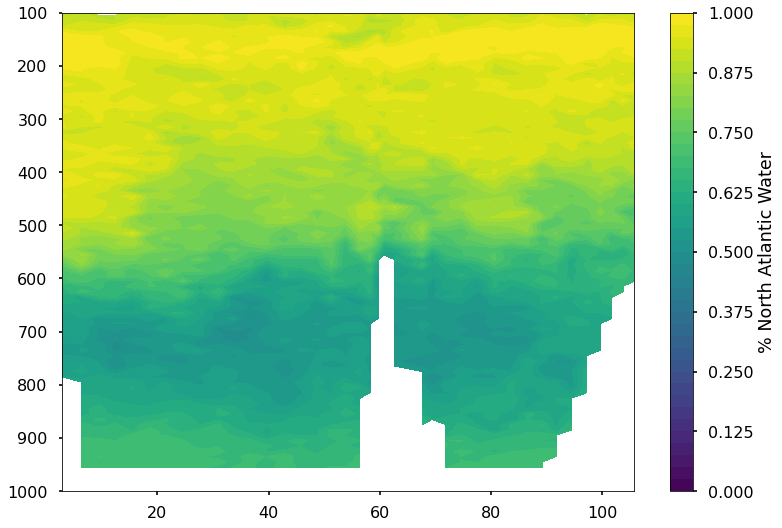

In [18]:
plt.contourf(np.cumsum(df_2021a_final.dist)/1000,df_2021a_final.depth,df_2021a_final.naw_frac,levels=np.arange(0,1.01,0.025))
plt.ylim(1000,100)
plt.colorbar(label='% North Atlantic Water')

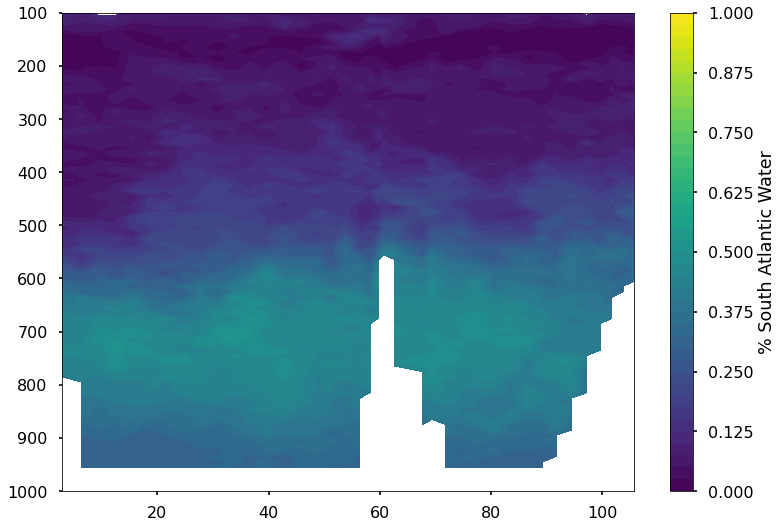

In [19]:
plt.contourf(np.cumsum(df_2021a_final.dist)/1000,df_2021a_final.depth,df_2021a_final.saw_frac,levels=np.arange(0,1.01,0.025))
plt.ylim(1000,100)
plt.colorbar(label='% South Atlantic Water')

In [20]:
df_2021a_final.saw_frac.max()

<xarray.DataArray 'saw_frac' ()>
array(0.52338567)

In [21]:
df_2021b_final = solve_endmember_fractions_single(subset_ds_2021b,naw_interp_mean_temp,naw_interp_mean_sal,saw_interp_mean_temp,saw_interp_mean_sal,gridden)


Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.441666946709688e-06
Original weighted sum squares: 2.441666946709688e-06
Post fix weighted sum squared: 2.441666946709688e-06
On example 0 to 1 out of 1
status: optimal
optimal value 2.441666946709688e-06
Original weighted sum squares: 2.441666946709688e-06
Post fix weighted sum squared: 2.441666946709688e-06
objective: 2.441666946709688e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.403914927810655e-05
Original weighted sum squares: 7.403914927810655e-05
Post fix weighted sum squared: 7.403914

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0033665041301033445
Original weighted sum squares: 0.0033665041301033445
Post fix weighted sum squared: 0.0033665041301033445
objective: 0.0033665041301033445
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.2953253594013989e-05
Original weighted sum squares: 1.2953253594013989e-05
Post fix weighted sum squared: 1.2953253594013989e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.2953253594013989e-05
Original weighted sum squares: 1.2953253594013989e-05
Post fix weighted sum squared: 1.2953253594013989e-05
objective: 1.2953253594013989e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = s

status: optimal
optimal value 2.738858283787626e-06
Original weighted sum squares: 2.738858283787626e-06
Post fix weighted sum squared: 2.738858283787626e-06
objective: 2.738858283787626e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003678632662077569
Original weighted sum squares: 0.0003678632662077569
Post fix weighted sum squared: 0.00036786326620835366
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003678632662077569
Original weighted sum squares: 0.0003678632662077569
Post fix weighted sum squared: 0.00036786326620835366
objective: 0.00036786326620835366
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = s

status: optimal
optimal value 1.2020616145959815e-05
Original weighted sum squares: 1.2020616145959815e-05
Post fix weighted sum squared: 1.2020616145959815e-05
objective: 1.2020616145959815e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.5497320509233335e-06
Original weighted sum squares: 4.5497320509233335e-06
Post fix weighted sum squared: 4.549732050872938e-06
On example 0 to 1 out of 1
status: optimal
optimal value 4.5497320509233335e-06
Original weighted sum squares: 4.5497320509233335e-06
Post fix weighted sum squared: 4.549732050872938e-06
objective: 4.549732050872938e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedva

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 4.0491809946618823e-07
Original weighted sum squares: 4.0491809946618823e-07
Post fix weighted sum squared: 4.0491809946618823e-07
objective: 4.0491809946618823e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.009662998499707113
Original weighted sum squares: 0.009662998499707113
Post fix weighted sum squared: 0.009662998499707113
On example 0 to 1 out of 1
status: optimal
optimal value 0.009662998499707113
Original weighted sum squares: 0.009662998499707113
Post fix weighted sum squared: 0.009662998499707113
objective: 0.009662998499707113
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 8.050033019419106e-08
Original weighted sum squares: 8.050033019419106e-08
Post fix weighted sum squared: 8.050033019419106e-08
objective: 8.050033019419106e-08
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00036598762981097786
Original weighted sum squares: 0.00036598762981097786
Post fix weighted sum squared: 0.00036598762981097786
On example 0 to 1 out of 1
status: optimal
optimal value 0.00036598762981097786
Original weighted sum squares: 0.00036598762981097786
Post fix weighted sum squared: 0.00036598762981097786
objective: 0.00036598762981097786
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 9.25945717394591e-07
Original weighted sum squares: 9.25945717394591e-07
Post fix weighted sum squared: 9.259457173743419e-07
objective: 9.259457173743419e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.3310490562572943e-07
Original weighted sum squares: 3.3310490562572943e-07
Post fix weighted sum squared: 3.3310490561665205e-07
On example 0 to 1 out of 1
status: optimal
optimal value 3.3310490562572943e-07
Original weighted sum squares: 3.3310490562572943e-07
Post fix weighted sum squared: 3.3310490561665205e-07
objective: 3.3310490561665205e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 9.878387226403116e-06
Original weighted sum squares: 9.878387226403116e-06
Post fix weighted sum squared: 9.878387226427812e-06
objective: 9.878387226427812e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.614530140526385e-06
Original weighted sum squares: 3.614530140526385e-06
Post fix weighted sum squared: 3.614530140526385e-06
On example 0 to 1 out of 1
status: optimal
optimal value 3.614530140526385e-06
Original weighted sum squares: 3.614530140526385e-06
Post fix weighted sum squared: 3.614530140526385e-06
objective: 3.614530140526385e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 1.28405742114763e-05
Original weighted sum squares: 1.28405742114763e-05
Post fix weighted sum squared: 1.284057421148595e-05
objective: 1.284057421148595e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.273773486485751e-06
Original weighted sum squares: 4.273773486485751e-06
Post fix weighted sum squared: 4.27377348650736e-06
On example 0 to 1 out of 1
status: optimal
optimal value 4.273773486485751e-06
Original weighted sum squares: 4.273773486485751e-06
Post fix weighted sum squared: 4.27377348650736e-06
objective: 4.27377348650736e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrai

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.625399806889709e-07
Original weighted sum squares: 3.625399806889709e-07
Post fix weighted sum squared: 3.625399806889709e-07
objective: 3.625399806889709e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.1779218955553721e-07
Original weighted sum squares: 1.1779218955553721e-07
Post fix weighted sum squared: 1.1779218955553721e-07
On example 0 to 1 out of 1
status: optimal
optimal value 1.1779218955553721e-07
Original weighted sum squares: 1.1779218955553721e-07
Post fix weighted sum squared: 1.1779218955553721e-07
objective: 1.1779218955553721e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 1.1599630065641837e-05
Original weighted sum squares: 1.1599630065641837e-05
Post fix weighted sum squared: 1.1599630065641837e-05
objective: 1.1599630065641837e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.007663040554327261
Original weighted sum squares: 0.007663040554327261
Post fix weighted sum squared: 0.007663040554327261
On example 0 to 1 out of 1
status: optimal
optimal value 0.007663040554327261
Original weighted sum squares: 0.007663040554327261
Post fix weighted sum squared: 0.007663040554327261
objective: 0.007663040554327261
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.972966242072908e-07
Original weighted sum squares: 3.972966242072908e-07
Post fix weighted sum squared: 3.9729662420063164e-07
objective: 3.9729662420063164e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.136222474621624e-07
Original weighted sum squares: 2.136222474621624e-07
Post fix weighted sum squared: 2.1362224745359533e-07
On example 0 to 1 out of 1
status: optimal
optimal value 2.136222474621624e-07
Original weighted sum squares: 2.136222474621624e-07
Post fix weighted sum squared: 2.1362224745359533e-07
objective: 2.1362224745359533e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.819478115536773e-05
Original weighted sum squares: 2.819478115536773e-05
Post fix weighted sum squared: 2.819478115532625e-05
objective: 2.819478115532625e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.2173424008388521e-05
Original weighted sum squares: 1.2173424008388521e-05
Post fix weighted sum squared: 1.2173424008416226e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.2173424008388521e-05
Original weighted sum squares: 1.2173424008388521e-05
Post fix weighted sum squared: 1.2173424008416226e-05
objective: 1.2173424008416226e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.8501982365266352e-06
Original weighted sum squares: 1.8501982365266352e-06
Post fix weighted sum squared: 1.8501982365266352e-06
objective: 1.8501982365266352e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.050103331862779e-05
Original weighted sum squares: 1.050103331862779e-05
Post fix weighted sum squared: 1.0501033318661676e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.050103331862779e-05
Original weighted sum squares: 1.050103331862779e-05
Post fix weighted sum squared: 1.0501033318661676e-05
objective: 1.0501033318661676e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 1.1326141111648445e-06
Original weighted sum squares: 1.1326141111648445e-06
Post fix weighted sum squared: 1.132614111156425e-06
objective: 1.132614111156425e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.3950228032658857e-05
Original weighted sum squares: 1.3950228032658857e-05
Post fix weighted sum squared: 1.3950228032570101e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.3950228032658857e-05
Original weighted sum squares: 1.3950228032658857e-05
Post fix weighted sum squared: 1.3950228032570101e-05
objective: 1.3950228032570101e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001534105533314891
Original weighted sum squares: 0.001534105533314891
Post fix weighted sum squared: 0.0015341055333141862
objective: 0.0015341055333141862
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.020859402949120132
Original weighted sum squares: 0.020859402949120132
Post fix weighted sum squared: 0.020859402949117426
On example 0 to 1 out of 1
status: optimal
optimal value 0.020859402949120132
Original weighted sum squares: 0.020859402949120132
Post fix weighted sum squared: 0.020859402949117426
objective: 0.020859402949117426
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.025194220141672e-06
Original weighted sum squares: 5.025194220141672e-06
Post fix weighted sum squared: 5.025194220141672e-06
objective: 5.025194220141672e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.658008260339109e-05
Original weighted sum squares: 7.658008260339109e-05
Post fix weighted sum squared: 7.658008260339109e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.658008260339109e-05
Original weighted sum squares: 7.658008260339109e-05
Post fix weighted sum squared: 7.658008260339109e-05
objective: 7.658008260339109e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 1.4600080373798414e-05
Original weighted sum squares: 1.4600080373798414e-05
Post fix weighted sum squared: 1.4600080373798414e-05
objective: 1.4600080373798414e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.3940623967439644e-05
Original weighted sum squares: 1.3940623967439644e-05
Post fix weighted sum squared: 1.3940623967350833e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.3940623967439644e-05
Original weighted sum squares: 1.3940623967439644e-05
Post fix weighted sum squared: 1.3940623967350833e-05
objective: 1.3940623967350833e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 7.628523262112201e-06
Original weighted sum squares: 7.628523262112201e-06
Post fix weighted sum squared: 7.628523262112201e-06
objective: 7.628523262112201e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.5829008671762356e-05
Original weighted sum squares: 3.5829008671762356e-05
Post fix weighted sum squared: 3.5829008671888456e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.5829008671762356e-05
Original weighted sum squares: 3.5829008671762356e-05
Post fix weighted sum squared: 3.5829008671888456e-05
objective: 3.5829008671888456e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.2955522231344245e-05
Original weighted sum squares: 2.2955522231344245e-05
Post fix weighted sum squared: 2.2955522231344245e-05
objective: 2.2955522231344245e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.8709238186307864e-08
Original weighted sum squares: 2.8709238186307864e-08
Post fix weighted sum squared: 2.8709238188547733e-08
On example 0 to 1 out of 1
status: optimal
optimal value 2.8709238186307864e-08
Original weighted sum squares: 2.8709238186307864e-08
Post fix weighted sum squared: 2.8709238188547733e-08
objective: 2.8709238188547733e-08
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.003185444150814789
Original weighted sum squares: 0.003185444150814789
Post fix weighted sum squared: 0.003185444150814789
objective: 0.003185444150814789
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0062757843132818306
Original weighted sum squares: 0.0062757843132818306
Post fix weighted sum squared: 0.006275784313283328
On example 0 to 1 out of 1
status: optimal
optimal value 0.0062757843132818306
Original weighted sum squares: 0.0062757843132818306
Post fix weighted sum squared: 0.006275784313283328
objective: 0.006275784313283328
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.929541805701296e-05
Original weighted sum squares: 3.929541805701296e-05
Post fix weighted sum squared: 3.929541805701296e-05
objective: 3.929541805701296e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019968198723238836
Original weighted sum squares: 0.0019968198723238836
Post fix weighted sum squared: 0.001996819872323341
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019968198723238836
Original weighted sum squares: 0.0019968198723238836
Post fix weighted sum squared: 0.001996819872323341
objective: 0.001996819872323341
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001495772187172508
Original weighted sum squares: 0.0001495772187172508
Post fix weighted sum squared: 0.00014957721871744527
objective: 0.00014957721871744527
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.702036393474886e-05
Original weighted sum squares: 3.702036393474886e-05
Post fix weighted sum squared: 3.702036393474886e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.702036393474886e-05
Original weighted sum squares: 3.702036393474886e-05
Post fix weighted sum squared: 3.702036393474886e-05
objective: 3.702036393474886e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 8.266403202823982e-06
Original weighted sum squares: 8.266403202823982e-06
Post fix weighted sum squared: 8.266403202770075e-06
objective: 8.266403202770075e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.0542396316135345e-06
Original weighted sum squares: 3.0542396316135345e-06
Post fix weighted sum squared: 3.054239631571588e-06
On example 0 to 1 out of 1
status: optimal
optimal value 3.0542396316135345e-06
Original weighted sum squares: 3.0542396316135345e-06
Post fix weighted sum squared: 3.054239631571588e-06
objective: 3.054239631571588e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.8026447885675958e-05
Original weighted sum squares: 2.8026447885675958e-05
Post fix weighted sum squared: 2.8026447885675958e-05
objective: 2.8026447885675958e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.4391347771052304e-06
Original weighted sum squares: 6.4391347771052304e-06
Post fix weighted sum squared: 6.439134777084747e-06
On example 0 to 1 out of 1
status: optimal
optimal value 6.4391347771052304e-06
Original weighted sum squares: 6.4391347771052304e-06
Post fix weighted sum squared: 6.439134777084747e-06
objective: 6.439134777084747e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedva

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

optimal value 1.0969377969632329e-06
Original weighted sum squares: 1.0969377969632329e-06
Post fix weighted sum squared: 1.0969377969658506e-06
objective: 1.0969377969658506e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.4459297897237428e-06
Original weighted sum squares: 2.4459297897237428e-06
Post fix weighted sum squared: 2.4459297897237428e-06
On example 0 to 1 out of 1
status: optimal
optimal value 2.4459297897237428e-06
Original weighted sum squares: 2.4459297897237428e-06
Post fix weighted sum squared: 2.4459297897237428e-06
objective: 2.4459297897237428e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0004916001988131361
Original weighted sum squares: 0.0004916001988131361
Post fix weighted sum squared: 0.0004916001988134248
objective: 0.0004916001988134248
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00968191781236604
Original weighted sum squares: 0.00968191781236604
Post fix weighted sum squared: 0.00968191781236604
On example 0 to 1 out of 1
status: optimal
optimal value 0.00968191781236604
Original weighted sum squares: 0.00968191781236604
Post fix weighted sum squared: 0.00968191781236604
objective: 0.00968191781236604
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
O

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 0.00012077540920020875
Original weighted sum squares: 0.00012077540920020875
Post fix weighted sum squared: 0.00012077540920037363
objective: 0.00012077540920037363
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0068299871673159086
Original weighted sum squares: 0.0068299871673159086
Post fix weighted sum squared: 0.006829987167314988
On example 0 to 1 out of 1
status: optimal
optimal value 0.0068299871673159086
Original weighted sum squares: 0.0068299871673159086
Post fix weighted sum squared: 0.006829987167314988
objective: 0.006829987167314988
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign co

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.001170978381522963
Original weighted sum squares: 0.001170978381522963
Post fix weighted sum squared: 0.0011709783815234173
objective: 0.0011709783815234173
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.0571254192455123e-06
Original weighted sum squares: 1.0571254192455123e-06
Post fix weighted sum squared: 1.057125419256593e-06
On example 0 to 1 out of 1
status: optimal
optimal value 1.0571254192455123e-06
Original weighted sum squares: 1.0571254192455123e-06
Post fix weighted sum squared: 1.057125419256593e-06
objective: 1.057125419256593e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 6.578799371518277e-07
Original weighted sum squares: 6.578799371518277e-07
Post fix weighted sum squared: 6.578799371518277e-07
objective: 6.578799371518277e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.468105104928102e-06
Original weighted sum squares: 5.468105104928102e-06
Post fix weighted sum squared: 5.468105104947142e-06
On example 0 to 1 out of 1
status: optimal
optimal value 5.468105104928102e-06
Original weighted sum squares: 5.468105104928102e-06
Post fix weighted sum squared: 5.468105104947142e-06
objective: 5.468105104947142e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.0473408924228104e-05
Original weighted sum squares: 1.0473408924228104e-05
Post fix weighted sum squared: 1.047340892413205e-05
objective: 1.047340892413205e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.6168577410710803e-05
Original weighted sum squares: 1.6168577410710803e-05
Post fix weighted sum squared: 1.616857741067685e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.6168577410710803e-05
Original weighted sum squares: 1.6168577410710803e-05
Post fix weighted sum squared: 1.616857741067685e-05
objective: 1.616857741067685e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvari

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.007194216340016853
Original weighted sum squares: 0.007194216340016853
Post fix weighted sum squared: 0.00719421634001788
objective: 0.00719421634001788
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.005164446409223215
Original weighted sum squares: 0.005164446409223215
Post fix weighted sum squared: 0.005164446409223991
On example 0 to 1 out of 1
status: optimal
optimal value 0.005164446409223215
Original weighted sum squares: 0.005164446409223215
Post fix weighted sum squared: 0.005164446409223991
objective: 0.005164446409223991
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]


/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.010654311667309204
Original weighted sum squares: 0.010654311667309204
Post fix weighted sum squared: 0.010654311667309204
objective: 0.010654311667309204
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.04443931395108168
Original weighted sum squares: 0.04443931395108168
Post fix weighted sum squared: 0.044439313951084206
On example 0 to 1 out of 1
status: optimal
optimal value 0.04443931395108168
Original weighted sum squares: 0.04443931395108168
Post fix weighted sum squared: 0.044439313951084206
objective: 0.044439313951084206
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 1.9420800006645578e-06
Original weighted sum squares: 1.9420800006645578e-06
Post fix weighted sum squared: 1.942080000649463e-06
objective: 1.942080000649463e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015208343800741296
Original weighted sum squares: 0.00015208343800741296
Post fix weighted sum squared: 0.0001520834380075293
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015208343800741296
Original weighted sum squares: 0.00015208343800741296
Post fix weighted sum squared: 0.0001520834380075293
objective: 0.0001520834380075293
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable si

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00034541617093083744
Original weighted sum squares: 0.00034541617093083744
Post fix weighted sum squared: 0.00034541617093083744
objective: 0.00034541617093083744
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.4725932130494118e-06
Original weighted sum squares: 1.4725932130494118e-06
Post fix weighted sum squared: 1.472593213078886e-06
On example 0 to 1 out of 1
status: optimal
optimal value 1.4725932130494118e-06
Original weighted sum squares: 1.4725932130494118e-06
Post fix weighted sum squared: 1.472593213078886e-06
objective: 1.472593213078886e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable 

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 1.2223045451908716e-07
Original weighted sum squares: 1.2223045451908716e-07
Post fix weighted sum squared: 1.2223045452755926e-07
objective: 1.2223045452755926e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010151938927915465
Original weighted sum squares: 0.00010151938927915465
Post fix weighted sum squared: 0.00010151938927904558
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010151938927915465
Original weighted sum squares: 0.00010151938927915465
Post fix weighted sum squared: 0.00010151938927904558
objective: 0.00010151938927904558
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 1.9860632632543953e-05
Original weighted sum squares: 1.9860632632543953e-05
Post fix weighted sum squared: 1.9860632632592596e-05
objective: 1.9860632632592596e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002130574955590559
Original weighted sum squares: 0.002130574955590559
Post fix weighted sum squared: 0.002130574955589962
On example 0 to 1 out of 1
status: optimal
optimal value 0.002130574955590559
Original weighted sum squares: 0.002130574955590559
Post fix weighted sum squared: 0.002130574955589962
objective: 0.002130574955589962
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constr

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 1.6185795677772437e-05
Original weighted sum squares: 1.6185795677772437e-05
Post fix weighted sum squared: 1.6185795677772437e-05
objective: 1.6185795677772437e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.008863744137400898
Original weighted sum squares: 0.008863744137400898
Post fix weighted sum squared: 0.00886374413740196
On example 0 to 1 out of 1
status: optimal
optimal value 0.008863744137400898
Original weighted sum squares: 0.008863744137400898
Post fix weighted sum squared: 0.00886374413740196
objective: 0.00886374413740196
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrain

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.011561517915388892
Original weighted sum squares: 0.011561517915388892
Post fix weighted sum squared: 0.011561517915387709
objective: 0.011561517915387709
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.9067947247264607e-08
Original weighted sum squares: 4.9067947247264607e-08
Post fix weighted sum squared: 4.9067947247264607e-08
On example 0 to 1 out of 1
status: optimal
optimal value 4.9067947247264607e-08
Original weighted sum squares: 4.9067947247264607e-08
Post fix weighted sum squared: 4.9067947247264607e-08
objective: 4.9067947247264607e-08
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 9.001946027032212e-07
Original weighted sum squares: 9.001946027032212e-07
Post fix weighted sum squared: 9.001946027032212e-07
objective: 9.001946027032212e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.553890722319865e-05
Original weighted sum squares: 2.553890722319865e-05
Post fix weighted sum squared: 2.553890722319865e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.553890722319865e-05
Original weighted sum squares: 2.553890722319865e-05
Post fix weighted sum squared: 2.553890722319865e-05
objective: 2.553890722319865e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 7.93686078501401e-07
Original weighted sum squares: 7.93686078501401e-07
Post fix weighted sum squared: 7.936860785111249e-07
objective: 7.936860785111249e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.7237094787056063e-05
Original weighted sum squares: 2.7237094787056063e-05
Post fix weighted sum squared: 2.7237094787056063e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.723709478711305e-05
Original weighted sum squares: 2.723709478711305e-05
Post fix weighted sum squared: 2.7237094786999068e-05
objective: 2.7237094786999068e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.5523065930299913e-06
Original weighted sum squares: 3.5523065930299913e-06
Post fix weighted sum squared: 3.552306593050689e-06
objective: 3.552306593050689e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.377058721599581e-05
Original weighted sum squares: 1.377058721599581e-05
Post fix weighted sum squared: 1.3770587216036694e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.377058721599581e-05
Original weighted sum squares: 1.377058721599581e-05
Post fix weighted sum squared: 1.3770587216036694e-05
objective: 1.3770587216036694e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.85303712497298e-05
Original weighted sum squares: 5.85303712497298e-05
Post fix weighted sum squared: 5.85303712497298e-05
objective: 5.85303712497298e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.259155294229345e-07
Original weighted sum squares: 2.259155294229345e-07
Post fix weighted sum squared: 2.259155294229345e-07
On example 0 to 1 out of 1
status: optimal
optimal value 2.259155294229345e-07
Original weighted sum squares: 2.259155294229345e-07
Post fix weighted sum squared: 2.259155294229345e-07
objective: 2.259155294229345e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0027979292443607584
Original weighted sum squares: 0.0027979292443607584
Post fix weighted sum squared: 0.0027979292443594947
objective: 0.0027979292443594947
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.984892556787263e-05
Original weighted sum squares: 1.984892556787263e-05
Post fix weighted sum squared: 1.984892556787263e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.984892556787263e-05
Original weighted sum squares: 1.984892556787263e-05
Post fix weighted sum squared: 1.984892556787263e-05
objective: 1.984892556787263e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.3575174060103604e-06
Original weighted sum squares: 6.3575174060103604e-06
Post fix weighted sum squared: 6.35751740600435e-06
objective: 6.35751740600435e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.382124092118693e-06
Original weighted sum squares: 5.382124092118693e-06
Post fix weighted sum squared: 5.382124092118693e-06
On example 0 to 1 out of 1
status: optimal
optimal value 5.382124092118693e-06
Original weighted sum squares: 5.382124092118693e-06
Post fix weighted sum squared: 5.382124092118693e-06
objective: 5.382124092118693e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.1501585922011764e-05
Original weighted sum squares: 3.1501585922011764e-05
Post fix weighted sum squared: 3.150158592195016e-05
objective: 3.150158592195016e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.9184192879470205e-05
Original weighted sum squares: 2.9184192879470205e-05
Post fix weighted sum squared: 2.918419287942358e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.9184192879470205e-05
Original weighted sum squares: 2.9184192879470205e-05
Post fix weighted sum squared: 2.918419287942358e-05
objective: 2.918419287942358e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvari

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00011143278391950476
Original weighted sum squares: 0.00011143278391950476
Post fix weighted sum squared: 0.00011143278391962077
objective: 0.00011143278391962077
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.170424547437219e-05
Original weighted sum squares: 2.170424547437219e-05
Post fix weighted sum squared: 2.170424547437219e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.170424547437219e-05
Original weighted sum squares: 2.170424547437219e-05
Post fix weighted sum squared: 2.170424547437219e-05
objective: 2.170424547437219e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.2199512549907583e-06
Original weighted sum squares: 2.2199512549907583e-06
Post fix weighted sum squared: 2.219951255007194e-06
objective: 2.219951255007194e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.207728810653936e-07
Original weighted sum squares: 8.207728810653936e-07
Post fix weighted sum squared: 8.20772881055339e-07
On example 0 to 1 out of 1
status: optimal
optimal value 8.207728810653936e-07
Original weighted sum squares: 8.207728810653936e-07
Post fix weighted sum squared: 8.20772881055339e-07
objective: 8.20772881055339e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable si

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 8.277749280984766e-08
Original weighted sum squares: 8.277749280984766e-08
Post fix weighted sum squared: 8.277749281370094e-08
objective: 8.277749281370094e-08
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.396463295054504e-08
Original weighted sum squares: 6.396463295054504e-08
Post fix weighted sum squared: 6.396463295273052e-08
On example 0 to 1 out of 1
status: optimal
optimal value 6.396463295054504e-08
Original weighted sum squares: 6.396463295054504e-08
Post fix weighted sum squared: 6.396463295273052e-08
objective: 6.396463295273052e-08
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.436187165381601e-05
Original weighted sum squares: 5.436187165381601e-05
Post fix weighted sum squared: 5.436187165375106e-05
objective: 5.436187165375106e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.611193931861693e-07
Original weighted sum squares: 1.611193931861693e-07
Post fix weighted sum squared: 1.611193931950659e-07
On example 0 to 1 out of 1
status: optimal
optimal value 1.611193931861693e-07
Original weighted sum squares: 1.611193931861693e-07
Post fix weighted sum squared: 1.611193931950659e-07
objective: 1.611193931950659e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 8.361606671103434e-05
Original weighted sum squares: 8.361606671103434e-05
Post fix weighted sum squared: 8.361606671115671e-05
objective: 8.361606671115671e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.27707254430362e-05
Original weighted sum squares: 9.27707254430362e-05
Post fix weighted sum squared: 9.277072544314237e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.27707254430362e-05
Original weighted sum squares: 9.27707254430362e-05
Post fix weighted sum squared: 9.277072544314237e-05
objective: 9.277072544314237e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 6.914295769735479e-06
Original weighted sum squares: 6.914295769735479e-06
Post fix weighted sum squared: 6.914295769735479e-06
objective: 6.914295769735479e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.775960600076956e-07
Original weighted sum squares: 4.775960600076956e-07
Post fix weighted sum squared: 4.775960600076956e-07
On example 0 to 1 out of 1
status: optimal
optimal value 4.775960600076956e-07
Original weighted sum squares: 4.775960600076956e-07
Post fix weighted sum squared: 4.775960600076956e-07
objective: 4.775960600076956e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.144774899439084e-05
Original weighted sum squares: 5.144774899439084e-05
Post fix weighted sum squared: 5.144774899448731e-05
objective: 5.144774899448731e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.7380103014196042e-05
Original weighted sum squares: 2.7380103014196042e-05
Post fix weighted sum squared: 2.7380103014196042e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.7380103014196042e-05
Original weighted sum squares: 2.7380103014196042e-05
Post fix weighted sum squared: 2.7380103014196042e-05
objective: 2.7380103014196042e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.0115824567346774e-05
Original weighted sum squares: 1.0115824567346774e-05
Post fix weighted sum squared: 1.0115824567346774e-05
objective: 1.0115824567346774e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.984042819821904e-05
Original weighted sum squares: 5.984042819821904e-05
Post fix weighted sum squared: 5.9840428198132994e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.984042819821904e-05
Original weighted sum squares: 5.984042819821904e-05
Post fix weighted sum squared: 5.9840428198132994e-05
objective: 5.9840428198132994e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.1075908078504685e-08
Original weighted sum squares: 2.1075908078504685e-08
Post fix weighted sum squared: 2.1075908076887305e-08
On example 0 to 1 out of 1
status: optimal
optimal value 2.1075908078504685e-08
Original weighted sum squares: 2.1075908078504685e-08
Post fix weighted sum squared: 2.1075908076887305e-08
objective: 2.1075908076887305e-08
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.266017533920121e-07
Original weighted sum squares: 2.266017533920121e-07
Post fix weighted sum squared: 2.2660175338782347e-07
On example 0 to 1 out of 1
status: optimal
optimal value 2.266017533920121e-07
Original weighted sum squares: 2.266017533920121e-07
Post fix weighted sum squared: 2.2660175338782347e-07
objective: 2.2660175338782347e-0

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.451921928454776e-05
Original weighted sum squares: 4.451921928454776e-05
Post fix weighted sum squared: 4.451921928454776e-05
objective: 4.451921928454776e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.9658298631266775e-05
Original weighted sum squares: 3.9658298631266775e-05
Post fix weighted sum squared: 3.9658298631210816e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.9658298631266775e-05
Original weighted sum squares: 3.9658298631266775e-05
Post fix weighted sum squared: 3.9658298631210816e-05
objective: 3.9658298631210816e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 0.00017508208012062312
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.247345663351746e-05
Original weighted sum squares: 9.247345663351746e-05
Post fix weighted sum squared: 9.247345663362454e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.247345663351746e-05
Original weighted sum squares: 9.247345663351746e-05
Post fix weighted sum squared: 9.247345663362454e-05
objective: 9.247345663362454e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.307361274170936e-05
Original weighted sum squares: 2.307361274170936e-05
Post fix weight

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 5.904710981393105e-06
Original weighted sum squares: 5.904710981393105e-06
Post fix weighted sum squared: 5.9047109814201625e-06
objective: 5.9047109814201625e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012573874328085255
Original weighted sum squares: 0.00012573874328085255
Post fix weighted sum squared: 0.00012573874328112883
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012573874328085255
Original weighted sum squares: 0.00012573874328085255
Post fix weighted sum squared: 0.00012573874328112883
objective: 0.00012573874328112883
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00014015534469050307
Original weighted sum squares: 0.00014015534469050307
Post fix weighted sum squared: 0.00014015534469050307
objective: 0.00014015534469050307
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.3277206357095804e-05
Original weighted sum squares: 5.3277206357095804e-05
Post fix weighted sum squared: 5.32772063571774e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.3277206357095804e-05
Original weighted sum squares: 5.3277206357095804e-05
Post fix weighted sum squared: 5.32772063571774e-05
objective: 5.32772063571774e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 3.780532241089882e-05
Original weighted sum squares: 3.780532241089882e-05
Post fix weighted sum squared: 3.7805322411119485e-05
objective: 3.7805322411119485e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011084789454167088
Original weighted sum squares: 0.00011084789454167088
Post fix weighted sum squared: 0.00011084789454167088
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011084789454167088
Original weighted sum squares: 0.00011084789454167088
Post fix weighted sum squared: 0.00011084789454167088
objective: 0.00011084789454167088
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 4.5862027673445684e-05
Original weighted sum squares: 4.5862027673445684e-05
Post fix weighted sum squared: 4.5862027673445684e-05
objective: 4.5862027673445684e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.650922416612358e-05
Original weighted sum squares: 4.650922416612358e-05
Post fix weighted sum squared: 4.650922416612358e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.650922416612358e-05
Original weighted sum squares: 4.650922416612358e-05
Post fix weighted sum squared: 4.650922416612358e-05
objective: 4.650922416612358e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 7.109424910850437e-05
Original weighted sum squares: 7.109424910850437e-05
Post fix weighted sum squared: 7.109424910880697e-05
objective: 7.109424910880697e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.3716490892999133e-05
Original weighted sum squares: 2.3716490892999133e-05
Post fix weighted sum squared: 2.3716490892999133e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.3716490892999133e-05
Original weighted sum squares: 2.3716490892999133e-05
Post fix weighted sum squared: 2.3716490892999133e-05
objective: 2.3716490892999133e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 1.690415841890251e-05
Original weighted sum squares: 1.690415841890251e-05
Post fix weighted sum squared: 1.690415841890251e-05
objective: 1.690415841890251e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001304548156627877
Original weighted sum squares: 0.0001304548156627877
Post fix weighted sum squared: 0.0001304548156627877
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001304548156627877
Original weighted sum squares: 0.0001304548156627877
Post fix weighted sum squared: 0.0001304548156627877
objective: 0.0001304548156627877
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 1.1746482128230169e-05
Original weighted sum squares: 1.1746482128230169e-05
Post fix weighted sum squared: 1.1746482128230169e-05
objective: 1.1746482128230169e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.337126978755625e-05
Original weighted sum squares: 2.337126978755625e-05
Post fix weighted sum squared: 2.337126978755625e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.337126978755625e-05
Original weighted sum squares: 2.337126978755625e-05
Post fix weighted sum squared: 2.337126978755625e-05
objective: 2.337126978755625e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 9.084704560566641e-05
Original weighted sum squares: 9.084704560566641e-05
Post fix weighted sum squared: 9.084704560566641e-05
objective: 9.084704560566641e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.202552029988429e-05
Original weighted sum squares: 9.202552029988429e-05
Post fix weighted sum squared: 9.202552029988429e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.202552029988429e-05
Original weighted sum squares: 9.202552029988429e-05
Post fix weighted sum squared: 9.202552029988429e-05
objective: 9.202552029988429e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.4100186182791145e-05
Original weighted sum squares: 2.4100186182791145e-05
Post fix weighted sum squared: 2.4100186182735576e-05
objective: 2.4100186182735576e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016157317064430815
Original weighted sum squares: 0.00016157317064430815
Post fix weighted sum squared: 0.00016157317064430815
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016157317064430815
Original weighted sum squares: 0.00016157317064430815
Post fix weighted sum squared: 0.00016157317064430815
objective: 0.00016157317064430815
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.622035409959911e-05
Original weighted sum squares: 4.622035409959911e-05
Post fix weighted sum squared: 4.62203540998431e-05
objective: 4.62203540998431e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.183253536440924e-05
Original weighted sum squares: 6.183253536440924e-05
Post fix weighted sum squared: 6.183253536440924e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.183253536440924e-05
Original weighted sum squares: 6.183253536440924e-05
Post fix weighted sum squared: 6.183253536440924e-05
objective: 6.183253536440924e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.818333706916818e-05
Original weighted sum squares: 2.818333706916818e-05
Post fix weighted sum squared: 2.818333706916818e-05
objective: 2.818333706916818e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.26239298152341e-05
Original weighted sum squares: 7.26239298152341e-05
Post fix weighted sum squared: 7.262392981521534e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.26239298152341e-05
Original weighted sum squares: 7.26239298152341e-05
Post fix weighted sum squared: 7.262392981521534e-05
objective: 7.262392981521534e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 4.9200368960057856e-05
Original weighted sum squares: 4.9200368960057856e-05
Post fix weighted sum squared: 4.9200368960057856e-05
objective: 4.9200368960057856e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.922217177977283e-05
Original weighted sum squares: 9.922217177977283e-05
Post fix weighted sum squared: 9.922217177986357e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.922217177977283e-05
Original weighted sum squares: 9.922217177977283e-05
Post fix weighted sum squared: 9.922217177986357e-05
objective: 9.922217177986357e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.9692923369066936e-05
Original weighted sum squares: 3.9692923369066936e-05
Post fix weighted sum squared: 3.9692923368910215e-05
objective: 3.9692923368910215e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.7926449663322342e-05
Original weighted sum squares: 1.7926449663322342e-05
Post fix weighted sum squared: 1.7926449663322342e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.7926449663322342e-05
Original weighted sum squares: 1.7926449663322342e-05
Post fix weighted sum squared: 1.7926449663322342e-05
objective: 1.7926449663322342e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.233399983036878e-05
Original weighted sum squares: 5.233399983036878e-05
Post fix weighted sum squared: 5.2333999830450605e-05
objective: 5.2333999830450605e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013944061855601983
Original weighted sum squares: 0.00013944061855601983
Post fix weighted sum squared: 0.00013944061855631295
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013944061855601983
Original weighted sum squares: 0.00013944061855601983
Post fix weighted sum squared: 0.00013944061855631295
objective: 0.00013944061855631295
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 9.574023866417547e-05
Original weighted sum squares: 9.574023866417547e-05
Post fix weighted sum squared: 9.574023866439736e-05
objective: 9.574023866439736e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015129434555941396
Original weighted sum squares: 0.00015129434555941396
Post fix weighted sum squared: 0.00015129434555927513
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015129434555941396
Original weighted sum squares: 0.00015129434555941396
Post fix weighted sum squared: 0.00015129434555927513
objective: 0.00015129434555927513
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00010229622476448503
Original weighted sum squares: 0.00010229622476448503
Post fix weighted sum squared: 0.00010229622476437025
objective: 0.00010229622476437025
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011232393079747631
Original weighted sum squares: 0.00011232393079747631
Post fix weighted sum squared: 0.00011232393079759619
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011232393079747631
Original weighted sum squares: 0.00011232393079747631
Post fix weighted sum squared: 0.00011232393079759619
objective: 0.00011232393079759619
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0001392971126993112
Original weighted sum squares: 0.0001392971126993112
Post fix weighted sum squared: 0.0001392971126993112
objective: 0.0001392971126993112
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.9325163327030184e-05
Original weighted sum squares: 4.9325163327030184e-05
Post fix weighted sum squared: 4.9325163326950474e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.9325163327030184e-05
Original weighted sum squares: 4.9325163327030184e-05
Post fix weighted sum squared: 4.9325163326950474e-05
objective: 4.9325163326950474e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 9.678884009571974e-05
Original weighted sum squares: 9.678884009571974e-05
Post fix weighted sum squared: 9.678884009594284e-05
objective: 9.678884009594284e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.975783346176383e-05
Original weighted sum squares: 1.975783346176383e-05
Post fix weighted sum squared: 1.975783346187484e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.975783346176383e-05
Original weighted sum squares: 1.975783346176383e-05
Post fix weighted sum squared: 1.975783346187484e-05
objective: 1.975783346187484e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.40416829459687e-05
Original weighted sum squares: 2.40416829459687e-05
Post fix weighted sum squared: 2.4041682946034925e-05
objective: 2.4041682946034925e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011540736174255995
Original weighted sum squares: 0.00011540736174255995
Post fix weighted sum squared: 0.00011540736174265782
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011540736174255995
Original weighted sum squares: 0.00011540736174255995
Post fix weighted sum squared: 0.00011540736174265782
objective: 0.00011540736174265782
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00021519180870298814
Original weighted sum squares: 0.00021519180870298814
Post fix weighted sum squared: 0.00021519180870298814
objective: 0.00021519180870298814
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001982384355782815
Original weighted sum squares: 0.0001982384355782815
Post fix weighted sum squared: 0.0001982384355782815
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019823843557812196
Original weighted sum squares: 0.00019823843557812196
Post fix weighted sum squared: 0.0001982384355782815
objective: 0.0001982384355782815
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvari

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.336692469090057e-05
Original weighted sum squares: 4.336692469090057e-05
Post fix weighted sum squared: 4.336692469082557e-05
objective: 4.336692469082557e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012441635265647287
Original weighted sum squares: 0.00012441635265647287
Post fix weighted sum squared: 0.00012441635265619493
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012441635265647287
Original weighted sum squares: 0.00012441635265647287
Post fix weighted sum squared: 0.00012441635265619493
objective: 0.00012441635265619493
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 1.9935879345486852e-05
Original weighted sum squares: 1.9935879345486852e-05
Post fix weighted sum squared: 1.9935879345486852e-05
objective: 1.9935879345486852e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.259376879142311e-07
Original weighted sum squares: 8.259376879142311e-07
Post fix weighted sum squared: 8.259376879142311e-07
On example 0 to 1 out of 1
status: optimal
optimal value 8.259376879142311e-07
Original weighted sum squares: 8.259376879142311e-07
Post fix weighted sum squared: 8.259376879142311e-07
objective: 8.259376879142311e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 1.647063803736043e-05
Original weighted sum squares: 1.647063803736043e-05
Post fix weighted sum squared: 1.647063803736043e-05
objective: 1.647063803736043e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.8122867720409055e-05
Original weighted sum squares: 1.8122867720409055e-05
Post fix weighted sum squared: 1.8122867720302797e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.8122867720409055e-05
Original weighted sum squares: 1.8122867720409055e-05
Post fix weighted sum squared: 1.8122867720302797e-05
objective: 1.8122867720302797e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00014636202150067297
Original weighted sum squares: 0.00014636202150067297
Post fix weighted sum squared: 0.00014636202150067297
objective: 0.00014636202150067297
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.191331870906509e-05
Original weighted sum squares: 3.191331870906509e-05
Post fix weighted sum squared: 3.191331870900115e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.191331870906509e-05
Original weighted sum squares: 3.191331870906509e-05
Post fix weighted sum squared: 3.191331870900115e-05
objective: 3.191331870900115e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00016788091765243727
Original weighted sum squares: 0.00016788091765243727
Post fix weighted sum squared: 0.000167880917652613
objective: 0.000167880917652613
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.186330295479294e-05
Original weighted sum squares: 5.186330295479294e-05
Post fix weighted sum squared: 5.186330295471053e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.186330295479294e-05
Original weighted sum squares: 5.186330295479294e-05
Post fix weighted sum squared: 5.186330295479294e-05
objective: 5.186330295479294e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 2.1573437714904547e-06
Original weighted sum squares: 2.1573437714904547e-06
Post fix weighted sum squared: 2.157343771453755e-06
objective: 2.157343771453755e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.638538302979248e-05
Original weighted sum squares: 1.638538302979248e-05
Post fix weighted sum squared: 1.638538302979248e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.638538302979248e-05
Original weighted sum squares: 1.638538302979248e-05
Post fix weighted sum squared: 1.638538302979248e-05
objective: 1.638538302979248e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.695175344539147e-05
Original weighted sum squares: 7.695175344539147e-05
Post fix weighted sum squared: 7.695175344539147e-05
objective: 7.695175344539147e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.264051570753365e-05
Original weighted sum squares: 9.264051570753365e-05
Post fix weighted sum squared: 9.264051570753365e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.264051570753365e-05
Original weighted sum squares: 9.264051570753365e-05
Post fix weighted sum squared: 9.264051570753365e-05
objective: 9.264051570753365e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 3.572925633931761e-05
Original weighted sum squares: 3.572925633931761e-05
Post fix weighted sum squared: 3.572925633924914e-05
objective: 3.572925633924914e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.817545279901645e-06
Original weighted sum squares: 6.817545279901645e-06
Post fix weighted sum squared: 6.817545279961615e-06
On example 0 to 1 out of 1
status: optimal
optimal value 6.817545279901645e-06
Original weighted sum squares: 6.817545279901645e-06
Post fix weighted sum squared: 6.817545279961615e-06
objective: 6.817545279961615e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.251260829088476e-07
Original weighted sum squares: 1.251260829088476e-07
Post fix weighted sum squared: 1.2512608291218337e-07
objective: 1.2512608291218337e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.8953625619876338e-05
Original weighted sum squares: 2.8953625619876338e-05
Post fix weighted sum squared: 2.8953625620011195e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.8953625619876338e-05
Original weighted sum squares: 2.8953625619876338e-05
Post fix weighted sum squared: 2.8953625620011195e-05
objective: 2.8953625620011195e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.9724685966348775e-05
Original weighted sum squares: 3.9724685966348775e-05
Post fix weighted sum squared: 3.9724685966421396e-05
objective: 3.9724685966421396e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.139845606546992e-05
Original weighted sum squares: 7.139845606546992e-05
Post fix weighted sum squared: 7.139845606556694e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.139845606546992e-05
Original weighted sum squares: 7.139845606546992e-05
Post fix weighted sum squared: 7.139845606556694e-05
objective: 7.139845606556694e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 8.211579047903281e-05
Original weighted sum squares: 8.211579047903281e-05
Post fix weighted sum squared: 8.211579047913631e-05
objective: 8.211579047913631e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.2572829304294768e-05
Original weighted sum squares: 2.2572829304294768e-05
Post fix weighted sum squared: 2.2572829304294768e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.2572829304294768e-05
Original weighted sum squares: 2.2572829304294768e-05
Post fix weighted sum squared: 2.2572829304294768e-05
objective: 2.2572829304294768e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 8.47603836007664e-07
Original weighted sum squares: 8.47603836007664e-07
Post fix weighted sum squared: 8.47603836007664e-07
objective: 8.47603836007664e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.620729016673332e-05
Original weighted sum squares: 4.620729016673332e-05
Post fix weighted sum squared: 4.620729016673332e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.620729016673332e-05
Original weighted sum squares: 4.620729016673332e-05
Post fix weighted sum squared: 4.620729016673332e-05
objective: 4.620729016673332e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.392600910947839e-07
Original weighted sum squares: 5.392600910947839e-07
Post fix weighted sum squared: 5.392600910947839e-07
objective: 5.392600910947839e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.4148295545444065e-05
Original weighted sum squares: 1.4148295545444065e-05
Post fix weighted sum squared: 1.4148295545487403e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.4148295545444065e-05
Original weighted sum squares: 1.4148295545444065e-05
Post fix weighted sum squared: 1.4148295545487403e-05
objective: 1.4148295545487403e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 7.099574446501794e-06
Original weighted sum squares: 7.099574446501794e-06
Post fix weighted sum squared: 7.099574446501794e-06
objective: 7.099574446501794e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.824233851912765e-05
Original weighted sum squares: 6.824233851912765e-05
Post fix weighted sum squared: 6.824233851912765e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.824233851912765e-05
Original weighted sum squares: 6.824233851912765e-05
Post fix weighted sum squared: 6.824233851912765e-05
objective: 6.824233851912765e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 0.00017125307652040338
Original weighted sum squares: 0.00017125307652040338
Post fix weighted sum squared: 0.00017125307652040338
objective: 0.00017125307652040338
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001791908546462324
Original weighted sum squares: 0.0001791908546462324
Post fix weighted sum squared: 0.0001791908546462324
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001791908546462324
Original weighted sum squares: 0.0001791908546462324
Post fix weighted sum squared: 0.0001791908546462324
objective: 0.0001791908546462324
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 7.31865546243882e-05
Original weighted sum squares: 7.31865546243882e-05
Post fix weighted sum squared: 7.318655462417306e-05
objective: 7.318655462417306e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.129631728506407e-05
Original weighted sum squares: 6.129631728506407e-05
Post fix weighted sum squared: 6.129631728506407e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.129631728506407e-05
Original weighted sum squares: 6.129631728506407e-05
Post fix weighted sum squared: 6.129631728506407e-05
objective: 6.129631728506407e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 2.1393225647551523e-05
Original weighted sum squares: 2.1393225647551523e-05
Post fix weighted sum squared: 2.1393225647551523e-05
objective: 2.1393225647551523e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.291030259708994e-05
Original weighted sum squares: 1.291030259708994e-05
Post fix weighted sum squared: 1.2910302597048631e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.291030259708994e-05
Original weighted sum squares: 1.291030259708994e-05
Post fix weighted sum squared: 1.2910302597048631e-05
objective: 1.2910302597048631e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00012724165106346903
Original weighted sum squares: 0.00012724165106346903
Post fix weighted sum squared: 0.00012724165106346903
objective: 0.00012724165106346903
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.6455151452869545e-06
Original weighted sum squares: 4.6455151452869545e-06
Post fix weighted sum squared: 4.6455151452869545e-06
On example 0 to 1 out of 1
status: optimal
optimal value 4.6455151452869545e-06
Original weighted sum squares: 4.6455151452869545e-06
Post fix weighted sum squared: 4.6455151452869545e-06
objective: 4.6455151452869545e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 3.667756600425737e-06
Original weighted sum squares: 3.667756600425737e-06
Post fix weighted sum squared: 3.667756600377572e-06
objective: 3.667756600377572e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.379186262999052e-05
Original weighted sum squares: 4.379186262999052e-05
Post fix weighted sum squared: 4.379186263006677e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.379186262999052e-05
Original weighted sum squares: 4.379186262999052e-05
Post fix weighted sum squared: 4.379186263006677e-05
objective: 4.379186263006677e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.798524951592045e-05
Original weighted sum squares: 4.798524951592045e-05
Post fix weighted sum squared: 4.7985249515745815e-05
objective: 4.7985249515745815e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00026300590205194076
Original weighted sum squares: 0.00026300590205194076
Post fix weighted sum squared: 0.0002630059020521294
On example 0 to 1 out of 1
status: optimal
optimal value 0.00026300590205194076
Original weighted sum squares: 0.00026300590205194076
Post fix weighted sum squared: 0.0002630059020521294
objective: 0.0002630059020521294
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvari

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 6.97053527703453e-05
Original weighted sum squares: 6.97053527703453e-05
Post fix weighted sum squared: 6.970535277015175e-05
objective: 6.970535277015175e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012061546400883062
Original weighted sum squares: 0.00012061546400883062
Post fix weighted sum squared: 0.00012061546400883062
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012061546400883062
Original weighted sum squares: 0.00012061546400883062
Post fix weighted sum squared: 0.00012061546400883062
objective: 0.00012061546400883062
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.699347692762166e-06
Original weighted sum squares: 5.699347692762166e-06
Post fix weighted sum squared: 5.699347692757144e-06
objective: 5.699347692757144e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.56529496243333e-06
Original weighted sum squares: 8.56529496243333e-06
Post fix weighted sum squared: 8.565294962473166e-06
On example 0 to 1 out of 1
status: optimal
optimal value 8.56529496243333e-06
Original weighted sum squares: 8.56529496243333e-06
Post fix weighted sum squared: 8.565294962473166e-06
objective: 8.565294962473166e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00014468760634920672
Original weighted sum squares: 0.00014468760634920672
Post fix weighted sum squared: 0.00014468760634948612
objective: 0.00014468760634948612
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.56768477465531e-05
Original weighted sum squares: 9.56768477465531e-05
Post fix weighted sum squared: 9.567684774668636e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.56768477465531e-05
Original weighted sum squares: 9.56768477465531e-05
Post fix weighted sum squared: 9.567684774668636e-05
objective: 9.567684774668636e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.9915609651730824e-05
Original weighted sum squares: 4.9915609651730824e-05
Post fix weighted sum squared: 4.9915609651730824e-05
objective: 4.9915609651730824e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.0231657954041992e-05
Original weighted sum squares: 1.0231657954041992e-05
Post fix weighted sum squared: 1.0231657954041992e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.0231657954041992e-05
Original weighted sum squares: 1.0231657954041992e-05
Post fix weighted sum squared: 1.0231657954041992e-05
objective: 1.0231657954041992e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013259270845323033
Original weighted sum squares: 0.00013259270845323033
Post fix weighted sum squared: 0.00013259270845336415
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013259270845323033
Original weighted sum squares: 0.00013259270845323033
Post fix weighted sum squared: 0.00013259270845336415
objective: 0.00013259270845336415
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.92074269052492e-05
Original weighted sum squares: 7.92074269052492e-05
Post fix weighted sum squared: 7.9

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 8.443117975227339e-05
Original weighted sum squares: 8.443117975227339e-05
Post fix weighted sum squared: 8.443117975236172e-05
objective: 8.443117975236172e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001112525861908611
Original weighted sum squares: 0.0001112525861908611
Post fix weighted sum squared: 0.00011125258619073805
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001112525861908611
Original weighted sum squares: 0.0001112525861908611
Post fix weighted sum squared: 0.00011125258619073805
objective: 0.00011125258619073805
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = s

status: optimal
optimal value 6.352972443149582e-05
Original weighted sum squares: 6.352972443149582e-05
Post fix weighted sum squared: 6.352972443149582e-05
objective: 6.352972443149582e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.794671973517644e-05
Original weighted sum squares: 4.794671973517644e-05
Post fix weighted sum squared: 4.794671973509684e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.794671973517644e-05
Original weighted sum squares: 4.794671973517644e-05
Post fix weighted sum squared: 4.794671973509684e-05
objective: 4.794671973509684e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean

status: optimal
optimal value 0.00010756896312776706
Original weighted sum squares: 0.00010756896312776706
Post fix weighted sum squared: 0.00010756896312776706
objective: 0.00010756896312776706
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.525833013097117e-05
Original weighted sum squares: 4.525833013097117e-05
Post fix weighted sum squared: 4.525833013104936e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.525833013097117e-05
Original weighted sum squares: 4.525833013097117e-05
Post fix weighted sum squared: 4.525833013104936e-05
objective: 4.525833013104936e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 7.327876176671538e-05
Original weighted sum squares: 7.327876176671538e-05
Post fix weighted sum squared: 7.327876176671538e-05
objective: 7.327876176671538e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.065405583706639e-05
Original weighted sum squares: 1.065405583706639e-05
Post fix weighted sum squared: 1.0654055837104563e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.065405583706639e-05
Original weighted sum squares: 1.065405583706639e-05
Post fix weighted sum squared: 1.0654055837104563e-05
objective: 1.0654055837104563e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00014573162445687238
Original weighted sum squares: 0.00014573162445687238
Post fix weighted sum squared: 0.0001457316244568482
objective: 0.0001457316244568482
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00025392096944562077
Original weighted sum squares: 0.00025392096944562077
Post fix weighted sum squared: 0.000253920969445838
On example 0 to 1 out of 1
status: optimal
optimal value 0.00025392096944562077
Original weighted sum squares: 0.00025392096944562077
Post fix weighted sum squared: 0.000253920969445838
objective: 0.000253920969445838
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00020710320234097325
Original weighted sum squares: 0.00020710320234097325
Post fix weighted sum squared: 0.0002071032023413381
objective: 0.0002071032023413381
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003493629597079811
Original weighted sum squares: 0.0003493629597079811
Post fix weighted sum squared: 0.0003493629597079811
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003493629597079811
Original weighted sum squares: 0.0003493629597079811
Post fix weighted sum squared: 0.0003493629597079811
objective: 0.0003493629597079811
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.2766606112541058e-06
Original weighted sum squares: 2.2766606112541058e-06
Post fix weighted sum squared: 2.2766606112716114e-06
objective: 2.2766606112716114e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.742872926188084e-05
Original weighted sum squares: 1.742872926188084e-05
Post fix weighted sum squared: 1.742872926193759e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.742872926188084e-05
Original weighted sum squares: 1.742872926188084e-05
Post fix weighted sum squared: 1.742872926193759e-05
objective: 1.742872926193759e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 7.098859074115404e-05
Original weighted sum squares: 7.098859074115404e-05
Post fix weighted sum squared: 7.098859074115404e-05
objective: 7.098859074115404e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014660816183569134
Original weighted sum squares: 0.00014660816183569134
Post fix weighted sum squared: 0.00014660816183569134
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014660816183569134
Original weighted sum squares: 0.00014660816183569134
Post fix weighted sum squared: 0.00014660816183569134
objective: 0.00014660816183569134
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00013452484661164967
Original weighted sum squares: 0.00013452484661164967
Post fix weighted sum squared: 0.00013452484661164967
objective: 0.00013452484661164967
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.29536144685407e-05
Original weighted sum squares: 9.29536144685407e-05
Post fix weighted sum squared: 9.295361446842845e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.29536144685407e-05
Original weighted sum squares: 9.29536144685407e-05
Post fix weighted sum squared: 9.295361446842845e-05
objective: 9.295361446842845e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 5.7083238065381965e-05
Original weighted sum squares: 5.7083238065381965e-05
Post fix weighted sum squared: 5.7083238065381965e-05
objective: 5.7083238065381965e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.266167406898282e-05
Original weighted sum squares: 6.266167406898282e-05
Post fix weighted sum squared: 6.266167406898282e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.266167406898282e-05
Original weighted sum squares: 6.266167406898282e-05
Post fix weighted sum squared: 6.266167406898282e-05
objective: 6.266167406898282e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.9987464760676576e-05
Original weighted sum squares: 1.9987464760676576e-05
Post fix weighted sum squared: 1.9987464760728926e-05
objective: 1.9987464760728926e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014024871845087073
Original weighted sum squares: 0.00014024871845087073
Post fix weighted sum squared: 0.00014024871845087073
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014024871845087073
Original weighted sum squares: 0.00014024871845087073
Post fix weighted sum squared: 0.00014024871845087073
objective: 0.00014024871845087073
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00019247079578562937
Original weighted sum squares: 0.00019247079578562937
Post fix weighted sum squared: 0.00019247079578579181
objective: 0.00019247079578579181
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.556416106826604e-05
Original weighted sum squares: 5.556416106826604e-05
Post fix weighted sum squared: 5.556416106826604e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.556416106826604e-05
Original weighted sum squares: 5.556416106826604e-05
Post fix weighted sum squared: 5.556416106826604e-05
objective: 5.556416106826604e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.92668929944113e-05
Original weighted sum squares: 3.92668929944113e-05
Post fix weighted sum squared: 3.9266892994398946e-05
objective: 3.9266892994398946e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010434481827025326
Original weighted sum squares: 0.00010434481827025326
Post fix weighted sum squared: 0.00010434481827023312
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010434481827025326
Original weighted sum squares: 0.00010434481827025326
Post fix weighted sum squared: 0.00010434481827023312
objective: 0.00010434481827023312
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.969630951350852e-05
Original weighted sum squares: 5.969630951350852e-05
Post fix weighted sum squared: 5.969630951359899e-05
objective: 5.969630951359899e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.591350975149914e-05
Original weighted sum squares: 6.591350975149914e-05
Post fix weighted sum squared: 6.591350975149914e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.591350975149914e-05
Original weighted sum squares: 6.591350975149914e-05
Post fix weighted sum squared: 6.591350975149914e-05
objective: 6.591350975149914e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 7.20831615525651e-05
Original weighted sum squares: 7.20831615525651e-05
Post fix weighted sum squared: 7.208316155266549e-05
objective: 7.208316155266549e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.9119561010295695e-05
Original weighted sum squares: 4.9119561010295695e-05
Post fix weighted sum squared: 4.9119561010219733e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.9119561010295695e-05
Original weighted sum squares: 4.9119561010295695e-05
Post fix weighted sum squared: 4.9119561010219733e-05
objective: 4.9119561010219733e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00010519301283926301
Original weighted sum squares: 0.00010519301283926301
Post fix weighted sum squared: 0.00010519301283951371
objective: 0.00010519301283951371
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.516292492489697e-05
Original weighted sum squares: 3.516292492489697e-05
Post fix weighted sum squared: 3.516292492489697e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.516292492489697e-05
Original weighted sum squares: 3.516292492489697e-05
Post fix weighted sum squared: 3.516292492489697e-05
objective: 3.516292492489697e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.2710329140511445e-05
Original weighted sum squares: 5.2710329140511445e-05
Post fix weighted sum squared: 5.2710329140589365e-05
objective: 5.2710329140589365e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012567364933193192
Original weighted sum squares: 0.00012567364933193192
Post fix weighted sum squared: 0.00012567364933192102
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012567364933193192
Original weighted sum squares: 0.00012567364933193192
Post fix weighted sum squared: 0.00012567364933192102
objective: 0.00012567364933192102
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.7793896816486492e-06
Original weighted sum squares: 1.7793896816486492e-06
Post fix weighted sum squared: 1.779389681679888e-06
objective: 1.779389681679888e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.615807412929523e-05
Original weighted sum squares: 7.615807412929523e-05
Post fix weighted sum squared: 7.615807412939742e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.615807412929523e-05
Original weighted sum squares: 7.615807412929523e-05
Post fix weighted sum squared: 7.615807412939742e-05
objective: 7.615807412939742e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00011506985288222522
Original weighted sum squares: 0.00011506985288222522
Post fix weighted sum squared: 0.00011506985288233013
objective: 0.00011506985288233013
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.1499366932835083e-05
Original weighted sum squares: 1.1499366932835083e-05
Post fix weighted sum squared: 1.1499366932874933e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.1499366932835083e-05
Original weighted sum squares: 1.1499366932835083e-05
Post fix weighted sum squared: 1.1499366932874933e-05
objective: 1.1499366932874933e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001792261798898214
Original weighted sum squares: 0.0001792261798898214
Post fix weighted sum squared: 0.00017922617988980845
objective: 0.00017922617988980845
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.0096230854471e-06
Original weighted sum squares: 5.0096230854471e-06
Post fix weighted sum squared: 5.009623085475653e-06
On example 0 to 1 out of 1
status: optimal
optimal value 5.0096230854471e-06
Original weighted sum squares: 5.0096230854471e-06
Post fix weighted sum squared: 5.009623085475653e-06
objective: 5.009623085475653e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign co

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00010261621236662158
Original weighted sum squares: 0.00010261621236662158
Post fix weighted sum squared: 0.00010261621236674074
objective: 0.00010261621236674074
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.299234926816742e-05
Original weighted sum squares: 5.299234926816742e-05
Post fix weighted sum squared: 5.299234926808168e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.299234926816742e-05
Original weighted sum squares: 5.299234926816742e-05
Post fix weighted sum squared: 5.299234926808168e-05
objective: 5.299234926808168e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.824628643062973e-05
Original weighted sum squares: 6.824628643062973e-05
Post fix weighted sum squared: 6.824628643062973e-05
objective: 6.824628643062973e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.880937619935767e-05
Original weighted sum squares: 5.880937619935767e-05
Post fix weighted sum squared: 5.880937619955282e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.880937619935767e-05
Original weighted sum squares: 5.880937619935767e-05
Post fix weighted sum squared: 5.880937619955282e-05
objective: 5.880937619955282e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 2.0533777621496944e-05
Original weighted sum squares: 2.0533777621496944e-05
Post fix weighted sum squared: 2.0533777621381554e-05
objective: 2.0533777621381554e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.325060924384476e-05
Original weighted sum squares: 6.325060924384476e-05
Post fix weighted sum squared: 6.325060924393821e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.325060924384476e-05
Original weighted sum squares: 6.325060924384476e-05
Post fix weighted sum squared: 6.325060924393821e-05
objective: 6.325060924393821e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.0558307945154154e-05
Original weighted sum squares: 2.0558307945154154e-05
Post fix weighted sum squared: 2.0558307945207435e-05
objective: 2.0558307945207435e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.933047635118754e-05
Original weighted sum squares: 9.933047635118754e-05
Post fix weighted sum squared: 9.933047635130452e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.933047635118754e-05
Original weighted sum squares: 9.933047635118754e-05
Post fix weighted sum squared: 9.933047635130452e-05
objective: 9.933047635130452e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00025402307667711
Original weighted sum squares: 0.00025402307667711
Post fix weighted sum squared: 0.00025402307667670413
objective: 0.00025402307667670413
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012263019010517282
Original weighted sum squares: 0.00012263019010517282
Post fix weighted sum squared: 0.00012263019010504226
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012263019010517282
Original weighted sum squares: 0.00012263019010517282
Post fix weighted sum squared: 0.00012263019010504226
objective: 0.00012263019010504226
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 1.9889331613262222e-05
Original weighted sum squares: 1.9889331613262222e-05
Post fix weighted sum squared: 1.9889331613319197e-05
objective: 1.9889331613319197e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012953560756379153
Original weighted sum squares: 0.00012953560756379153
Post fix weighted sum squared: 0.00012953560756379153
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012953560756379153
Original weighted sum squares: 0.00012953560756379153
Post fix weighted sum squared: 0.00012953560756379153
objective: 0.00012953560756379153
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00017206457083909717
Original weighted sum squares: 0.00017206457083909717
Post fix weighted sum squared: 0.00017206457083943205
objective: 0.00017206457083943205
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.7804889402292825e-05
Original weighted sum squares: 2.7804889402292825e-05
Post fix weighted sum squared: 2.7804889402287895e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.7804889402292825e-05
Original weighted sum squares: 2.7804889402292825e-05
Post fix weighted sum squared: 2.7804889402287895e-05
objective: 2.7804889402287895e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 5.408525093610882e-07
Original weighted sum squares: 5.408525093610882e-07
Post fix weighted sum squared: 5.408525093423739e-07
objective: 5.408525093423739e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012165586318553303
Original weighted sum squares: 0.00012165586318553303
Post fix weighted sum squared: 0.00012165586318540315
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012165586318553303
Original weighted sum squares: 0.00012165586318553303
Post fix weighted sum squared: 0.00012165586318540315
objective: 0.00012165586318540315
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 3.14581392118616e-05
Original weighted sum squares: 3.14581392118616e-05
Post fix weighted sum squared: 3.145813921172401e-05
objective: 3.145813921172401e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.277457885988173e-05
Original weighted sum squares: 3.277457885988173e-05
Post fix weighted sum squared: 3.277457886002192e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.277457885988173e-05
Original weighted sum squares: 3.277457885988173e-05
Post fix weighted sum squared: 3.277457886002192e-05
objective: 3.277457886002192e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.0209245463458004e-05
Original weighted sum squares: 5.0209245463458004e-05
Post fix weighted sum squared: 5.02092454635486e-05
objective: 5.02092454635486e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011905815833620504
Original weighted sum squares: 0.00011905815833620504
Post fix weighted sum squared: 0.00011905815833633425
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011905815833620504
Original weighted sum squares: 0.00011905815833620504
Post fix weighted sum squared: 0.00011905815833633425
objective: 0.00011905815833633425
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.7976208004863966e-05
Original weighted sum squares: 4.7976208004863966e-05
Post fix weighted sum squared: 4.797620800495246e-05
objective: 4.797620800495246e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.9461316305887442e-05
Original weighted sum squares: 2.9461316305887442e-05
Post fix weighted sum squared: 2.9461316305951715e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.9461316305887442e-05
Original weighted sum squares: 2.9461316305887442e-05
Post fix weighted sum squared: 2.9461316305951715e-05
objective: 2.9461316305951715e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 6.686257661500689e-05
Original weighted sum squares: 6.686257661500689e-05
Post fix weighted sum squared: 6.686257661500689e-05
objective: 6.686257661500689e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012919153603131936
Original weighted sum squares: 0.00012919153603131936
Post fix weighted sum squared: 0.0001291915360314648
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012919153603131936
Original weighted sum squares: 0.00012919153603131936
Post fix weighted sum squared: 0.0001291915360314648
objective: 0.0001291915360314648
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001078645925109348
Original weighted sum squares: 0.0001078645925109348
Post fix weighted sum squared: 0.00010786459251081248
objective: 0.00010786459251081248
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.275887199572439e-05
Original weighted sum squares: 5.275887199572439e-05
Post fix weighted sum squared: 5.275887199572439e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.275887199572439e-05
Original weighted sum squares: 5.275887199572439e-05
Post fix weighted sum squared: 5.275887199572439e-05
objective: 5.275887199572439e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.801214914136822e-05
Original weighted sum squares: 4.801214914136822e-05
Post fix weighted sum squared: 4.801214914136822e-05
objective: 4.801214914136822e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.340176525797082e-06
Original weighted sum squares: 4.340176525797082e-06
Post fix weighted sum squared: 4.340176525823643e-06
On example 0 to 1 out of 1
status: optimal
optimal value 4.340176525797082e-06
Original weighted sum squares: 4.340176525797082e-06
Post fix weighted sum squared: 4.340176525823643e-06
objective: 4.340176525823643e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.113105592516984e-05
Original weighted sum squares: 4.113105592516984e-05
Post fix weighted sum squared: 4.1131055925251656e-05
objective: 4.1131055925251656e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.890945785974109e-05
Original weighted sum squares: 9.890945785974109e-05
Post fix weighted sum squared: 9.890945785961364e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.890945785974109e-05
Original weighted sum squares: 9.890945785974109e-05
Post fix weighted sum squared: 9.890945785961364e-05
objective: 9.890945785961364e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 4.063179633418049e-05
Original weighted sum squares: 4.063179633418049e-05
Post fix weighted sum squared: 4.0631796334022945e-05
objective: 4.0631796334022945e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010246059778356144
Original weighted sum squares: 0.00010246059778356144
Post fix weighted sum squared: 0.00010246059778354272
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010246059778356144
Original weighted sum squares: 0.00010246059778356144
Post fix weighted sum squared: 0.00010246059778354272
objective: 0.00010246059778354272
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00011518931356302831
Original weighted sum squares: 0.00011518931356302831
Post fix weighted sum squared: 0.0001151893135627633
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011518931356302831
Original weighted sum squares: 0.00011518931356302831
Post fix weighted sum squared: 0.0001151893135627633
objective: 0.0001151893135627633
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.531999008577578e-05
Original weighted sum squares: 8.531999008577578e-05
Post fix weighted sum squared: 8.531999008542909e-05
On example 0 to 1 out of 1
status: optimal
optimal value 8.531999008577578e-05
Original weighted sum squares: 8.531999008577578e-05
Post fix weighted sum squared: 8.531999008542909e-05
objective: 8.531999008542909e-05
Endm

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00012381684842519355
Original weighted sum squares: 0.00012381684842519355
Post fix weighted sum squared: 0.00012381684842519355
objective: 0.00012381684842519355
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.7216744227960446e-05
Original weighted sum squares: 2.7216744227960446e-05
Post fix weighted sum squared: 2.72167442280223e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.7216744227960446e-05
Original weighted sum squares: 2.7216744227960446e-05
Post fix weighted sum squared: 2.72167442280223e-05
objective: 2.72167442280223e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 4.558790383936389e-05
Original weighted sum squares: 4.558790383936389e-05
Post fix weighted sum squared: 4.558790383945029e-05
objective: 4.558790383945029e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.022671112778636e-05
Original weighted sum squares: 8.022671112778636e-05
Post fix weighted sum squared: 8.022671112778636e-05
On example 0 to 1 out of 1
status: optimal
optimal value 8.022671112778636e-05
Original weighted sum squares: 8.022671112778636e-05
Post fix weighted sum squared: 8.022671112778636e-05
objective: 8.022671112778636e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 5.543171024877179e-05
Original weighted sum squares: 5.543171024877179e-05
Post fix weighted sum squared: 5.5431710248962025e-05
objective: 5.5431710248962025e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.270947448422845e-05
Original weighted sum squares: 4.270947448422845e-05
Post fix weighted sum squared: 4.270947448431226e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.270947448422845e-05
Original weighted sum squares: 4.270947448422845e-05
Post fix weighted sum squared: 4.270947448431226e-05
objective: 4.270947448431226e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 9.20273537105031e-05
Original weighted sum squares: 9.20273537105031e-05
Post fix weighted sum squared: 9.20273537105031e-05
objective: 9.20273537105031e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.9522626237287168e-05
Original weighted sum squares: 2.9522626237287168e-05
Post fix weighted sum squared: 2.9522626237287168e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.9522626237287168e-05
Original weighted sum squares: 2.9522626237287168e-05
Post fix weighted sum squared: 2.9522626237287168e-05
objective: 2.9522626237287168e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 5.7717655233052504e-05
Original weighted sum squares: 5.7717655233052504e-05
Post fix weighted sum squared: 5.771765523296179e-05
objective: 5.771765523296179e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011855347113673613
Original weighted sum squares: 0.00011855347113673613
Post fix weighted sum squared: 0.00011855347113660625
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011855347113673613
Original weighted sum squares: 0.00011855347113673613
Post fix weighted sum squared: 0.00011855347113660625
objective: 0.00011855347113660625
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 5.509826648310989e-05
Original weighted sum squares: 5.509826648310989e-05
Post fix weighted sum squared: 5.509826648310989e-05
objective: 5.509826648310989e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017994153699457584
Original weighted sum squares: 0.00017994153699457584
Post fix weighted sum squared: 0.00017994153699441565
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017994153699457584
Original weighted sum squares: 0.00017994153699457584
Post fix weighted sum squared: 0.00017994153699441565
objective: 0.00017994153699441565
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 1.5065989154633899e-05
Original weighted sum squares: 1.5065989154633899e-05
Post fix weighted sum squared: 1.5065989154633899e-05
objective: 1.5065989154633899e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.150155694867938e-08
Original weighted sum squares: 5.150155694867938e-08
Post fix weighted sum squared: 5.150155694598203e-08
On example 0 to 1 out of 1
status: optimal
optimal value 5.150155694867938e-08
Original weighted sum squares: 5.150155694867938e-08
Post fix weighted sum squared: 5.150155694598203e-08
objective: 5.150155694598203e-08
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.6406232421675964e-05
Original weighted sum squares: 3.6406232421675964e-05
Post fix weighted sum squared: 3.6406232421753105e-05
objective: 3.6406232421753105e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.713824748245573e-05
Original weighted sum squares: 7.713824748245573e-05
Post fix weighted sum squared: 7.713824748235134e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.713824748245573e-05
Original weighted sum squares: 7.713824748245573e-05
Post fix weighted sum squared: 7.713824748235134e-05
objective: 7.713824748235134e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.2597513370676643e-06
Original weighted sum squares: 1.2597513370676643e-06
Post fix weighted sum squared: 1.2597513370810365e-06
objective: 1.2597513370810365e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.0558673350305886e-05
Original weighted sum squares: 4.0558673350305886e-05
Post fix weighted sum squared: 4.055867335038176e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.0558673350305886e-05
Original weighted sum squares: 4.0558673350305886e-05
Post fix weighted sum squared: 4.055867335038176e-05
objective: 4.055867335038176e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedva

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 8.907145397651089e-05
Original weighted sum squares: 8.907145397651089e-05
Post fix weighted sum squared: 8.907145397662413e-05
objective: 8.907145397662413e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.27208060827682e-05
Original weighted sum squares: 6.27208060827682e-05
Post fix weighted sum squared: 6.272080608287014e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.27208060827682e-05
Original weighted sum squares: 6.27208060827682e-05
Post fix weighted sum squared: 6.272080608287014e-05
objective: 6.272080608287014e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0002557671169177154
Original weighted sum squares: 0.0002557671169177154
Post fix weighted sum squared: 0.00025576711691790733
objective: 0.00025576711691790733
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.165894872482153e-05
Original weighted sum squares: 8.165894872482153e-05
Post fix weighted sum squared: 8.165894872505416e-05
On example 0 to 1 out of 1
status: optimal
optimal value 8.165894872482153e-05
Original weighted sum squares: 8.165894872482153e-05
Post fix weighted sum squared: 8.165894872505416e-05
objective: 8.165894872505416e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.245865401277307e-05
Original weighted sum squares: 2.245865401277307e-05
Post fix weighted sum squared: 2.245865401271667e-05
objective: 2.245865401271667e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.327719982009109e-05
Original weighted sum squares: 3.327719982009109e-05
Post fix weighted sum squared: 3.3277199820022284e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.327719982009109e-05
Original weighted sum squares: 3.327719982009109e-05
Post fix weighted sum squared: 3.3277199820022284e-05
objective: 3.3277199820022284e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 9.484345547448159e-05
Original weighted sum squares: 9.484345547448159e-05
Post fix weighted sum squared: 9.484345547460649e-05
objective: 9.484345547460649e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.5912549894969414e-05
Original weighted sum squares: 3.5912549894969414e-05
Post fix weighted sum squared: 3.5912549894969414e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.5912549894969414e-05
Original weighted sum squares: 3.5912549894969414e-05
Post fix weighted sum squared: 3.5912549894969414e-05
objective: 3.5912549894969414e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 1.7163854945826243e-05
Original weighted sum squares: 1.7163854945826243e-05
Post fix weighted sum squared: 1.7163854945879528e-05
objective: 1.7163854945879528e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.31643674902486e-05
Original weighted sum squares: 8.31643674902486e-05
Post fix weighted sum squared: 8.316436749013947e-05
On example 0 to 1 out of 1
status: optimal
optimal value 8.31643674902486e-05
Original weighted sum squares: 8.31643674902486e-05
Post fix weighted sum squared: 8.316436749013947e-05
objective: 8.316436749013947e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00013702035056709414
Original weighted sum squares: 0.00013702035056709414
Post fix weighted sum squared: 0.00013702035056709414
objective: 0.00013702035056709414
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.58639657997701e-05
Original weighted sum squares: 7.58639657997701e-05
Post fix weighted sum squared: 7.586396579988263e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.58639657997701e-05
Original weighted sum squares: 7.58639657997701e-05
Post fix weighted sum squared: 7.586396579988263e-05
objective: 7.586396579988263e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.047430123458151e-05
Original weighted sum squares: 6.047430123458151e-05
Post fix weighted sum squared: 6.047430123458151e-05
objective: 6.047430123458151e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011129620004592121
Original weighted sum squares: 0.00011129620004592121
Post fix weighted sum squared: 0.00011129620004605722
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011129620004592121
Original weighted sum squares: 0.00011129620004592121
Post fix weighted sum squared: 0.00011129620004605722
objective: 0.00011129620004605722
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00010051120021554728
Original weighted sum squares: 0.00010051120021554728
Post fix weighted sum squared: 0.00010051120021567585
objective: 0.00010051120021567585
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.8798685780217496e-06
Original weighted sum squares: 2.8798685780217496e-06
Post fix weighted sum squared: 2.8798685779812686e-06
On example 0 to 1 out of 1
status: optimal
optimal value 2.8798685780217496e-06
Original weighted sum squares: 2.8798685780217496e-06
Post fix weighted sum squared: 2.8798685779812686e-06
objective: 2.8798685779812686e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.711837225963107e-05
Original weighted sum squares: 6.711837225963107e-05
Post fix weighted sum squared: 6.711837225972938e-05
objective: 6.711837225972938e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012379096777236673
Original weighted sum squares: 0.00012379096777236673
Post fix weighted sum squared: 0.00012379096777223372
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012379096777236673
Original weighted sum squares: 0.00012379096777236673
Post fix weighted sum squared: 0.00012379096777223372
objective: 0.00012379096777223372
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 1.7664830903692244e-05
Original weighted sum squares: 1.7664830903692244e-05
Post fix weighted sum squared: 1.7664830903746302e-05
objective: 1.7664830903746302e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.3710888239917483e-05
Original weighted sum squares: 1.3710888239917483e-05
Post fix weighted sum squared: 1.3710888239965145e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.371088823992077e-05
Original weighted sum squares: 1.371088823992077e-05
Post fix weighted sum squared: 1.3710888239965145e-05
objective: 1.3710888239965145e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 5.08010189330177e-06
Original weighted sum squares: 5.08010189330177e-06
Post fix weighted sum squared: 5.080101893330806e-06
objective: 5.080101893330806e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.498021931083955e-05
Original weighted sum squares: 2.498021931083955e-05
Post fix weighted sum squared: 2.4980219310904277e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.498021931083955e-05
Original weighted sum squares: 2.498021931083955e-05
Post fix weighted sum squared: 2.4980219310904277e-05
objective: 2.4980219310904277e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable 

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001389053970678862
Original weighted sum squares: 0.0001389053970678862
Post fix weighted sum squared: 0.00013890539706774377
objective: 0.00013890539706774377
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.495257245706978e-05
Original weighted sum squares: 6.495257245706978e-05
Post fix weighted sum squared: 6.495257245706978e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.495257245706978e-05
Original weighted sum squares: 6.495257245706978e-05
Post fix weighted sum squared: 6.495257245706978e-05
objective: 6.495257245706978e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 3.7710154731747023e-07
Original weighted sum squares: 3.7710154731747023e-07
Post fix weighted sum squared: 3.7710154731747023e-07
objective: 3.7710154731747023e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.884702881052165e-05
Original weighted sum squares: 7.884702881052165e-05
Post fix weighted sum squared: 7.884702881030984e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.884702881052165e-05
Original weighted sum squares: 7.884702881052165e-05
Post fix weighted sum squared: 7.884702881030984e-05
objective: 7.884702881030984e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 4.317462512539678e-06
Original weighted sum squares: 4.317462512539678e-06
Post fix weighted sum squared: 4.317462512514681e-06
objective: 4.317462512514681e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.104178434900803e-05
Original weighted sum squares: 6.104178434900803e-05
Post fix weighted sum squared: 6.104178434910875e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.104178434900803e-05
Original weighted sum squares: 6.104178434900803e-05
Post fix weighted sum squared: 6.104178434910875e-05
objective: 6.104178434910875e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.48489989764488e-05
Original weighted sum squares: 6.48489989764488e-05
Post fix weighted sum squared: 6.484899897654531e-05
objective: 6.484899897654531e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012284406808738555
Original weighted sum squares: 0.00012284406808738555
Post fix weighted sum squared: 0.00012284406808751871
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012284406808738555
Original weighted sum squares: 0.00012284406808738555
Post fix weighted sum squared: 0.00012284406808751871
objective: 0.00012284406808751871
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.78440505143947e-05
Original weighted sum squares: 6.78440505143947e-05
Post fix weighted sum squared: 6.78440505143947e-05
objective: 6.78440505143947e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.284906238425021e-05
Original weighted sum squares: 5.284906238425021e-05
Post fix weighted sum squared: 5.284906238435042e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.284906238425021e-05
Original weighted sum squares: 5.284906238425021e-05
Post fix weighted sum squared: 5.284906238435042e-05
objective: 5.284906238435042e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00011259117364269941
Original weighted sum squares: 0.00011259117364269941
Post fix weighted sum squared: 0.0001125911736426903
objective: 0.0001125911736426903
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.70857874579859e-05
Original weighted sum squares: 5.70857874579859e-05
Post fix weighted sum squared: 5.70857874579859e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.70857874579859e-05
Original weighted sum squares: 5.70857874579859e-05
Post fix weighted sum squared: 5.70857874579859e-05
objective: 5.70857874579859e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00011914140256527196
Original weighted sum squares: 0.00011914140256527196
Post fix weighted sum squared: 0.00011914140256526247
objective: 0.00011914140256526247
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.275608800747389e-06
Original weighted sum squares: 8.275608800747389e-06
Post fix weighted sum squared: 8.275608800747389e-06
On example 0 to 1 out of 1
status: optimal
optimal value 8.275608800747389e-06
Original weighted sum squares: 8.275608800747389e-06
Post fix weighted sum squared: 8.275608800747389e-06
objective: 8.275608800747389e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 5.6183200342900175e-05
Original weighted sum squares: 5.6183200342900175e-05
Post fix weighted sum squared: 5.6183200342900175e-05
objective: 5.6183200342900175e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.631740614048098e-05
Original weighted sum squares: 3.631740614048098e-05
Post fix weighted sum squared: 3.63174061405589e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.631740614048098e-05
Original weighted sum squares: 3.631740614048098e-05
Post fix weighted sum squared: 3.63174061405589e-05
objective: 3.63174061405589e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable 

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 6.094518381894871e-05
Original weighted sum squares: 6.094518381894871e-05
Post fix weighted sum squared: 6.094518381904965e-05
objective: 6.094518381904965e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.0179203149366574e-05
Original weighted sum squares: 4.0179203149366574e-05
Post fix weighted sum squared: 4.017920314929032e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.0179203149366574e-05
Original weighted sum squares: 4.0179203149366574e-05
Post fix weighted sum squared: 4.017920314929032e-05
objective: 4.017920314929032e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001465900896412554
Original weighted sum squares: 0.0001465900896412554
Post fix weighted sum squared: 0.00014659008964141196
objective: 0.00014659008964141196
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.761783582250524e-05
Original weighted sum squares: 7.761783582250524e-05
Post fix weighted sum squared: 7.761783582250524e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.761783582250524e-05
Original weighted sum squares: 7.761783582250524e-05
Post fix weighted sum squared: 7.761783582250524e-05
objective: 7.761783582250524e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00012444947421700076
Original weighted sum squares: 0.00012444947421700076
Post fix weighted sum squared: 0.00012444947421728968
objective: 0.00012444947421728968
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.562755769863391e-05
Original weighted sum squares: 6.562755769863391e-05
Post fix weighted sum squared: 6.562755769863391e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.562755769863391e-05
Original weighted sum squares: 6.562755769863391e-05
Post fix weighted sum squared: 6.562755769863391e-05
objective: 6.562755769863391e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00019255529906296408
Original weighted sum squares: 0.00019255529906296408
Post fix weighted sum squared: 0.00019255529906315568
objective: 0.00019255529906315568
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.415426977322438e-05
Original weighted sum squares: 5.415426977322438e-05
Post fix weighted sum squared: 5.4154269773319755e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.415426977322438e-05
Original weighted sum squares: 5.415426977322438e-05
Post fix weighted sum squared: 5.4154269773319755e-05
objective: 5.4154269773319755e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 8.457362124645271e-05
Original weighted sum squares: 8.457362124645271e-05
Post fix weighted sum squared: 8.457362124610476e-05
objective: 8.457362124610476e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.704385782197361e-05
Original weighted sum squares: 9.704385782197361e-05
Post fix weighted sum squared: 9.704385782185456e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.704385782197361e-05
Original weighted sum squares: 9.704385782197361e-05
Post fix weighted sum squared: 9.704385782185456e-05
objective: 9.704385782185456e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00013373935809014647
Original weighted sum squares: 0.00013373935809014647
Post fix weighted sum squared: 0.00013373935809014647
objective: 0.00013373935809014647
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.656626209558525e-05
Original weighted sum squares: 9.656626209558525e-05
Post fix weighted sum squared: 9.656626209533094e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.656626209558525e-05
Original weighted sum squares: 9.656626209558525e-05
Post fix weighted sum squared: 9.656626209533094e-05
objective: 9.656626209533094e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 3.222047079421765e-05
Original weighted sum squares: 3.222047079421765e-05
Post fix weighted sum squared: 3.222047079421765e-05
objective: 3.222047079421765e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001901626914618882
Original weighted sum squares: 0.0001901626914618882
Post fix weighted sum squared: 0.00019016269146223368
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001901626914618882
Original weighted sum squares: 0.0001901626914618882
Post fix weighted sum squared: 0.00019016269146223368
objective: 0.00019016269146223368
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 6.29760950027247e-05
Original weighted sum squares: 6.29760950027247e-05
Post fix weighted sum squared: 6.297609500282763e-05
objective: 6.297609500282763e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001744837617617511
Original weighted sum squares: 0.0001744837617617511
Post fix weighted sum squared: 0.00017448376176191138
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001744837617617511
Original weighted sum squares: 0.0001744837617617511
Post fix weighted sum squared: 0.00017448376176191138
objective: 0.00017448376176191138
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign co

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0001620143307776009
Original weighted sum squares: 0.0001620143307776009
Post fix weighted sum squared: 0.0001620143307776009
objective: 0.0001620143307776009
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015178367095850507
Original weighted sum squares: 0.00015178367095850507
Post fix weighted sum squared: 0.00015178367095866513
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015178367095850507
Original weighted sum squares: 0.00015178367095850507
Post fix weighted sum squared: 0.00015178367095866513
objective: 0.00015178367095866513
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 2.8317395868220115e-05
Original weighted sum squares: 2.8317395868220115e-05
Post fix weighted sum squared: 2.8317395868092084e-05
objective: 2.8317395868092084e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.596305944660163e-05
Original weighted sum squares: 1.596305944660163e-05
Post fix weighted sum squared: 1.5963059446598177e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.596305944660163e-05
Original weighted sum squares: 1.596305944660163e-05
Post fix weighted sum squared: 1.5963059446598177e-05
objective: 1.5963059446598177e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.5878905332837116e-05
Original weighted sum squares: 5.5878905332837116e-05
Post fix weighted sum squared: 5.58789053331212e-05
objective: 5.58789053331212e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.66581260264423e-06
Original weighted sum squares: 5.66581260264423e-06
Post fix weighted sum squared: 5.6658126026750054e-06
On example 0 to 1 out of 1
status: optimal
optimal value 5.66581260264423e-06
Original weighted sum squares: 5.66581260264423e-06
Post fix weighted sum squared: 5.6658126026750054e-06
objective: 5.6658126026750054e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable si

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 1.1288515783612351e-05
Original weighted sum squares: 1.1288515783612351e-05
Post fix weighted sum squared: 1.1288515783612351e-05
objective: 1.1288515783612351e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014291802294103486
Original weighted sum squares: 0.00014291802294103486
Post fix weighted sum squared: 0.00014291802294072548
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014291802294103486
Original weighted sum squares: 0.00014291802294103486
Post fix weighted sum squared: 0.00014291802294072548
objective: 0.00014291802294072548
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00013273005435432796
Original weighted sum squares: 0.00013273005435432796
Post fix weighted sum squared: 0.00013273005435447774
objective: 0.00013273005435447774
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013798217892804402
Original weighted sum squares: 0.00013798217892804402
Post fix weighted sum squared: 0.00013798217892819678
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013798217892804402
Original weighted sum squares: 0.00013798217892804402
Post fix weighted sum squared: 0.00013798217892819678
objective: 0.00013798217892819678
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.000234824193835331
Original weighted sum squares: 0.000234824193835331
Post fix weighted sum squared: 0.0002348241938357165
objective: 0.0002348241938357165
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000328919780092325
Original weighted sum squares: 0.000328919780092325
Post fix weighted sum squared: 0.00032891978009210387
On example 0 to 1 out of 1
status: optimal
optimal value 0.000328919780092325
Original weighted sum squares: 0.000328919780092325
Post fix weighted sum squared: 0.000328919780092325
objective: 0.000328919780092325
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 6.175668929051275e-05
Original weighted sum squares: 6.175668929051275e-05
Post fix weighted sum squared: 6.175668929051275e-05
objective: 6.175668929051275e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019624530306292215
Original weighted sum squares: 0.00019624530306292215
Post fix weighted sum squared: 0.00019624530306292215
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019624530306292215
Original weighted sum squares: 0.00019624530306292215
Post fix weighted sum squared: 0.00019624530306292215
objective: 0.00019624530306292215
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00010877266757068334
Original weighted sum squares: 0.00010877266757068334
Post fix weighted sum squared: 0.00010877266757095347
objective: 0.00010877266757095347
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.415974050594057e-05
Original weighted sum squares: 3.415974050594057e-05
Post fix weighted sum squared: 3.415974050594057e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.415974050594057e-05
Original weighted sum squares: 3.415974050594057e-05
Post fix weighted sum squared: 3.415974050594057e-05
objective: 3.415974050594057e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0002126172767758015
Original weighted sum squares: 0.0002126172767758015
Post fix weighted sum squared: 0.0002126172767758015
objective: 0.0002126172767758015
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.2471129624069265e-05
Original weighted sum squares: 1.2471129624069265e-05
Post fix weighted sum squared: 1.2471129624069265e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.2471129624069265e-05
Original weighted sum squares: 1.2471129624069265e-05
Post fix weighted sum squared: 1.2471129624069265e-05
objective: 1.2471129624069265e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0002495575089023988
Original weighted sum squares: 0.0002495575089023988
Post fix weighted sum squared: 0.0002495575089023858
objective: 0.0002495575089023858
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.726407707930584e-05
Original weighted sum squares: 7.726407707930584e-05
Post fix weighted sum squared: 7.726407707930584e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.726407707930584e-05
Original weighted sum squares: 7.726407707930584e-05
Post fix weighted sum squared: 7.726407707930584e-05
objective: 7.726407707930584e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00026739008878446714
Original weighted sum squares: 0.00026739008878446714
Post fix weighted sum squared: 0.0002673900887842675
objective: 0.0002673900887842675
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011280162250295534
Original weighted sum squares: 0.00011280162250295534
Post fix weighted sum squared: 0.00011280162250295534
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011280162250295534
Original weighted sum squares: 0.00011280162250295534
Post fix weighted sum squared: 0.00011280162250295534
objective: 0.00011280162250295534
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 6.780840595791493e-05
Original weighted sum squares: 6.780840595791493e-05
Post fix weighted sum squared: 6.780840595791493e-05
objective: 6.780840595791493e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.658683185906347e-05
Original weighted sum squares: 8.658683185906347e-05
Post fix weighted sum squared: 8.658683185930449e-05
On example 0 to 1 out of 1
status: optimal
optimal value 8.658683185906347e-05
Original weighted sum squares: 8.658683185906347e-05
Post fix weighted sum squared: 8.658683185930449e-05
objective: 8.658683185930449e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.263278097478295e-05
Original weighted sum squares: 4.263278097478295e-05
Post fix weighted sum squared: 4.263278097478295e-05
objective: 4.263278097478295e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.646465569393912e-05
Original weighted sum squares: 3.646465569393912e-05
Post fix weighted sum squared: 3.646465569401744e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.646465569393912e-05
Original weighted sum squares: 3.646465569393912e-05
Post fix weighted sum squared: 3.646465569401744e-05
objective: 3.646465569401744e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00025627941337309285
Original weighted sum squares: 0.00025627941337309285
Post fix weighted sum squared: 0.00025627941337350886
objective: 0.00025627941337350886
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000148487774453718
Original weighted sum squares: 0.000148487774453718
Post fix weighted sum squared: 0.00014848777445404393
On example 0 to 1 out of 1
status: optimal
optimal value 0.000148487774453718
Original weighted sum squares: 0.000148487774453718
Post fix weighted sum squared: 0.00014848777445404393
objective: 0.00014848777445404393
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 3.87749142654453e-05
Original weighted sum squares: 3.87749142654453e-05
Post fix weighted sum squared: 3.87749142654453e-05
objective: 3.87749142654453e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012936723602594385
Original weighted sum squares: 0.00012936723602594385
Post fix weighted sum squared: 0.00012936723602594385
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012936723602594385
Original weighted sum squares: 0.00012936723602594385
Post fix weighted sum squared: 0.00012936723602594385
objective: 0.00012936723602594385
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.70517282713934e-05
Original weighted sum squares: 7.70517282713934e-05
Post fix weighted sum squared: 7.705172827150032e-05
objective: 7.705172827150032e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001938716554047174
Original weighted sum squares: 0.0001938716554047174
Post fix weighted sum squared: 0.00019387165540454715
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001938716554047174
Original weighted sum squares: 0.0001938716554047174
Post fix weighted sum squared: 0.00019387165540454715
objective: 0.00019387165540454715
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable 

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00014576811078001751
Original weighted sum squares: 0.00014576811078001751
Post fix weighted sum squared: 0.00014576811078031998
objective: 0.00014576811078031998
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.900346510667602e-05
Original weighted sum squares: 6.900346510667602e-05
Post fix weighted sum squared: 6.900346510657563e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.900346510667602e-05
Original weighted sum squares: 6.900346510667602e-05
Post fix weighted sum squared: 6.900346510657563e-05
objective: 6.900346510657563e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 9.871433437412587e-05
Original weighted sum squares: 9.871433437412587e-05
Post fix weighted sum squared: 9.871433437437582e-05
objective: 9.871433437437582e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017714974081386626
Original weighted sum squares: 0.00017714974081386626
Post fix weighted sum squared: 0.00017714974081386626
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017714974081386626
Original weighted sum squares: 0.00017714974081386626
Post fix weighted sum squared: 0.00017714974081386626
objective: 0.00017714974081386626
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00014801788630009372
Original weighted sum squares: 0.00014801788630009372
Post fix weighted sum squared: 0.0001480178863002518
objective: 0.0001480178863002518
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011405367340797272
Original weighted sum squares: 0.00011405367340797272
Post fix weighted sum squared: 0.0001140536734081116
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011405367340783386
Original weighted sum squares: 0.00011405367340783386
Post fix weighted sum squared: 0.0001140536734081116
objective: 0.0001140536734081116
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvari

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001238779252257211
Original weighted sum squares: 0.0001238779252257211
Post fix weighted sum squared: 0.00012387792522585664
objective: 0.00012387792522585664
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.870268772411912e-05
Original weighted sum squares: 6.870268772411912e-05
Post fix weighted sum squared: 6.870268772401842e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.870268772411912e-05
Original weighted sum squares: 6.870268772411912e-05
Post fix weighted sum squared: 6.870268772401842e-05
objective: 6.870268772401842e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00011642188907280176
Original weighted sum squares: 0.00011642188907280176
Post fix weighted sum squared: 0.00011642188907266983
objective: 0.00011642188907266983
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004473989233266245
Original weighted sum squares: 0.0004473989233266245
Post fix weighted sum squared: 0.0004473989233263659
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004473989233266245
Original weighted sum squares: 0.0004473989233266245
Post fix weighted sum squared: 0.0004473989233263659
objective: 0.0004473989233263659
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00044759993568315625
Original weighted sum squares: 0.00044759993568315625
Post fix weighted sum squared: 0.00044759993568288054
objective: 0.00044759993568288054
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.501087232735393e-05
Original weighted sum squares: 7.501087232735393e-05
Post fix weighted sum squared: 7.501087232757826e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.501087232735393e-05
Original weighted sum squares: 7.501087232735393e-05
Post fix weighted sum squared: 7.501087232757826e-05
objective: 7.501087232757826e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00010166824413167563
Original weighted sum squares: 0.00010166824413167563
Post fix weighted sum squared: 0.00010166824413179845
objective: 0.00010166824413179845
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001973973087120831
Original weighted sum squares: 0.0001973973087120831
Post fix weighted sum squared: 0.00019739730871207154
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001973973087120831
Original weighted sum squares: 0.0001973973087120831
Post fix weighted sum squared: 0.00019739730871207154
objective: 0.00019739730871207154
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0002006011796193997
Original weighted sum squares: 0.0002006011796193997
Post fix weighted sum squared: 0.0002006011796193997
objective: 0.0002006011796193997
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019642352660620684
Original weighted sum squares: 0.00019642352660620684
Post fix weighted sum squared: 0.00019642352660620684
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019642352660620684
Original weighted sum squares: 0.00019642352660620684
Post fix weighted sum squared: 0.00019642352660620684
objective: 0.00019642352660620684
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0002627729825276695
Original weighted sum squares: 0.0002627729825276695
Post fix weighted sum squared: 0.00026277298252807944
objective: 0.00026277298252807944
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003292206294152375
Original weighted sum squares: 0.0003292206294152375
Post fix weighted sum squared: 0.0003292206294154742
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003292206294152375
Original weighted sum squares: 0.0003292206294152375
Post fix weighted sum squared: 0.0003292206294154742
objective: 0.0003292206294154742
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00010235590519155086
Original weighted sum squares: 0.00010235590519155086
Post fix weighted sum squared: 0.00010235590519167489
objective: 0.00010235590519167489
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001335301184917548
Original weighted sum squares: 0.0001335301184917548
Post fix weighted sum squared: 0.00013353011849205626
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001335301184917548
Original weighted sum squares: 0.0001335301184917548
Post fix weighted sum squared: 0.00013353011849205626
objective: 0.00013353011849205626
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0002213028630848858
Original weighted sum squares: 0.0002213028630848858
Post fix weighted sum squared: 0.0002213028630848858
objective: 0.0002213028630848858
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010588532913622327
Original weighted sum squares: 0.00010588532913622327
Post fix weighted sum squared: 0.00010588532913622327
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010588532913622327
Original weighted sum squares: 0.00010588532913622327
Post fix weighted sum squared: 0.00010588532913622327
objective: 0.00010588532913622327
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00014369622677558061
Original weighted sum squares: 0.00014369622677558061
Post fix weighted sum squared: 0.0001436962267752694
objective: 0.0001436962267752694
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.007931857875427e-05
Original weighted sum squares: 9.007931857875427e-05
Post fix weighted sum squared: 9.007931857875427e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.007931857875427e-05
Original weighted sum squares: 9.007931857875427e-05
Post fix weighted sum squared: 9.007931857875427e-05
objective: 9.007931857875427e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00029000414790174354
Original weighted sum squares: 0.00029000414790174354
Post fix weighted sum squared: 0.00029000414790218606
objective: 0.00029000414790218606
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00025977854680491423
Original weighted sum squares: 0.00025977854680491423
Post fix weighted sum squared: 0.00025977854680449416
On example 0 to 1 out of 1
status: optimal
optimal value 0.00025977854680491423
Original weighted sum squares: 0.00025977854680491423
Post fix weighted sum squared: 0.00025977854680449416
objective: 0.00025977854680449416
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00014930220959852652
Original weighted sum squares: 0.00014930220959852652
Post fix weighted sum squared: 0.00014930220959852652
objective: 0.00014930220959852652
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014946491410840562
Original weighted sum squares: 0.00014946491410840562
Post fix weighted sum squared: 0.0001494649141085652
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014946491410840562
Original weighted sum squares: 0.00014946491410840562
Post fix weighted sum squared: 0.0001494649141085652
objective: 0.0001494649141085652
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedva

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00011135037132073024
Original weighted sum squares: 0.00011135037132073024
Post fix weighted sum squared: 0.00011135037132100577
objective: 0.00011135037132100577
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011161113419751206
Original weighted sum squares: 0.00011161113419751206
Post fix weighted sum squared: 0.00011161113419764998
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011161113419751206
Original weighted sum squares: 0.00011161113419751206
Post fix weighted sum squared: 0.00011161113419764998
objective: 0.00011161113419764998
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0002523916458137284
Original weighted sum squares: 0.0002523916458137284
Post fix weighted sum squared: 0.0002523916458137284
objective: 0.0002523916458137284
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004138907722483768
Original weighted sum squares: 0.0004138907722483768
Post fix weighted sum squared: 0.0004138907722478595
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004138907722483768
Original weighted sum squares: 0.0004138907722483768
Post fix weighted sum squared: 0.0004138907722478595
objective: 0.0004138907722478595
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 7.710040700641654e-05
Original weighted sum squares: 7.710040700641654e-05
Post fix weighted sum squared: 7.710040700663745e-05
objective: 7.710040700663745e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003956639799904603
Original weighted sum squares: 0.0003956639799904603
Post fix weighted sum squared: 0.00039566397999021743
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003956639799904603
Original weighted sum squares: 0.0003956639799904603
Post fix weighted sum squared: 0.00039566397999021743
objective: 0.00039566397999021743
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0001593090659690185
Original weighted sum squares: 0.0001593090659690185
Post fix weighted sum squared: 0.00015930906596917224
objective: 0.00015930906596917224
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017267843161118215
Original weighted sum squares: 0.00017267843161118215
Post fix weighted sum squared: 0.00017267843161102172
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017267843161118215
Original weighted sum squares: 0.00017267843161118215
Post fix weighted sum squared: 0.00017267843161102172
objective: 0.00017267843161102172
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00011436679718002458
Original weighted sum squares: 0.00011436679718002458
Post fix weighted sum squared: 0.00011436679718015485
objective: 0.00011436679718015485
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00034489611188590806
Original weighted sum squares: 0.00034489611188590806
Post fix weighted sum squared: 0.00034489611188639254
On example 0 to 1 out of 1
status: optimal
optimal value 0.00034489611188590806
Original weighted sum squares: 0.00034489611188590806
Post fix weighted sum squared: 0.00034489611188639254
objective: 0.00034489611188639254
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0002172850957014824
Original weighted sum squares: 0.0002172850957014824
Post fix weighted sum squared: 0.00021728509570167516
objective: 0.00021728509570167516
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00037978648026800105
Original weighted sum squares: 0.00037978648026800105
Post fix weighted sum squared: 0.000379786480268241
On example 0 to 1 out of 1
status: optimal
optimal value 0.00037978648026800105
Original weighted sum squares: 0.00037978648026800105
Post fix weighted sum squared: 0.000379786480268241
objective: 0.000379786480268241
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0003766545290785242
Original weighted sum squares: 0.0003766545290785242
Post fix weighted sum squared: 0.0003766545290785242
objective: 0.0003766545290785242
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005251362667632027
Original weighted sum squares: 0.0005251362667632027
Post fix weighted sum squared: 0.0005251362667634845
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005251362667632027
Original weighted sum squares: 0.0005251362667632027
Post fix weighted sum squared: 0.0005251362667634845
objective: 0.0005251362667634845
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00033332177264352677
Original weighted sum squares: 0.00033332177264352677
Post fix weighted sum squared: 0.00033332177264376486
objective: 0.00033332177264376486
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021790336516421766
Original weighted sum squares: 0.00021790336516421766
Post fix weighted sum squared: 0.0002179033651644096
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021790336516421766
Original weighted sum squares: 0.00021790336516421766
Post fix weighted sum squared: 0.0002179033651644096
objective: 0.0002179033651644096
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedva

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0002209412902021359
Original weighted sum squares: 0.0002209412902021359
Post fix weighted sum squared: 0.00022094129020195418
objective: 0.00022094129020195418
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00036977351917559157
Original weighted sum squares: 0.00036977351917559157
Post fix weighted sum squared: 0.0003697735191753565
On example 0 to 1 out of 1
status: optimal
optimal value 0.00036977351917559157
Original weighted sum squares: 0.00036977351917559157
Post fix weighted sum squared: 0.0003697735191753565
objective: 0.0003697735191753565
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable si

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0005036282027831066
Original weighted sum squares: 0.0005036282027831066
Post fix weighted sum squared: 0.0005036282027825361
objective: 0.0005036282027825361
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001216922060454777
Original weighted sum squares: 0.0001216922060454777
Post fix weighted sum squared: 0.00012169220604561278
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001216922060454777
Original weighted sum squares: 0.0001216922060454777
Post fix weighted sum squared: 0.00012169220604561278
objective: 0.00012169220604561278
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.000481755903333655
Original weighted sum squares: 0.000481755903333655
Post fix weighted sum squared: 0.0004817559033339252
objective: 0.0004817559033339252
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006765203106520226
Original weighted sum squares: 0.0006765203106520226
Post fix weighted sum squared: 0.000676520310651682
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006765203106520226
Original weighted sum squares: 0.0006765203106520226
Post fix weighted sum squared: 0.000676520310651682
objective: 0.000676520310651682
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00040929743158080433
Original weighted sum squares: 0.00040929743158080433
Post fix weighted sum squared: 0.00040929743158080433
objective: 0.00040929743158080433
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00032525374699827743
Original weighted sum squares: 0.00032525374699827743
Post fix weighted sum squared: 0.00032525374699827743
On example 0 to 1 out of 1
status: optimal
optimal value 0.00032525374699827743
Original weighted sum squares: 0.00032525374699827743
Post fix weighted sum squared: 0.00032525374699827743
objective: 0.00032525374699827743
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0003457586426491022
Original weighted sum squares: 0.0003457586426491022
Post fix weighted sum squared: 0.00034575864264886006
objective: 0.00034575864264886006
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000549541704529496
Original weighted sum squares: 0.000549541704529496
Post fix weighted sum squared: 0.0005495417045298023
On example 0 to 1 out of 1
status: optimal
optimal value 0.000549541704529496
Original weighted sum squares: 0.000549541704529496
Post fix weighted sum squared: 0.0005495417045298023
objective: 0.0005495417045298023
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00017483108013829234
Original weighted sum squares: 0.00017483108013829234
Post fix weighted sum squared: 0.00017483108013845446
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017483108013829234
Original weighted sum squares: 0.00017483108013829234
Post fix weighted sum squared: 0.00017483108013845446
objective: 0.00017483108013845446
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002856391442816627
Original weighted sum squares: 0.0002856391442816627
Post fix weighted sum squared: 0.00028563914428144185
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002856391442816627
Original weighted sum squares: 0.0002856391442816627
Post fix weighted sum squared: 0.00028563914428144185
objective: 0.0002856391442814418

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00023731487610330934
Original weighted sum squares: 0.00023731487610330934
Post fix weighted sum squared: 0.0002373148761035108
objective: 0.0002373148761035108
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004728514651380386
Original weighted sum squares: 0.0004728514651380386
Post fix weighted sum squared: 0.0004728514651380386
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004728514651380386
Original weighted sum squares: 0.0004728514651380386
Post fix weighted sum squared: 0.0004728514651380386
objective: 0.0004728514651380386
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0005550348678027121
Original weighted sum squares: 0.0005550348678027121
Post fix weighted sum squared: 0.0005550348678027121
objective: 0.0005550348678027121
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004836422718174974
Original weighted sum squares: 0.0004836422718174974
Post fix weighted sum squared: 0.00048364227181693826
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004836422718174974
Original weighted sum squares: 0.0004836422718174974
Post fix weighted sum squared: 0.00048364227181693826
objective: 0.00048364227181693826
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0006928669083219885
Original weighted sum squares: 0.0006928669083219885
Post fix weighted sum squared: 0.0006928669083223134
objective: 0.0006928669083223134
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008430066604932676
Original weighted sum squares: 0.0008430066604932676
Post fix weighted sum squared: 0.0008430066604932459
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008430066604932676
Original weighted sum squares: 0.0008430066604932676
Post fix weighted sum squared: 0.0008430066604932459
objective: 0.0008430066604932459
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00014804751841729713
Original weighted sum squares: 0.00014804751841729713
Post fix weighted sum squared: 0.00014804751841698976
objective: 0.00014804751841698976
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000319227614066836
Original weighted sum squares: 0.000319227614066836
Post fix weighted sum squared: 0.00031922761406728785
On example 0 to 1 out of 1
status: optimal
optimal value 0.000319227614066836
Original weighted sum squares: 0.000319227614066836
Post fix weighted sum squared: 0.00031922761406728785
objective: 0.00031922761406728785
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00015968269923481655
Original weighted sum squares: 0.00015968269923481655
Post fix weighted sum squared: 0.00015968269923498168
objective: 0.00015968269923498168
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021678486963703852
Original weighted sum squares: 0.00021678486963703852
Post fix weighted sum squared: 0.00021678486963703852
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021678486963703852
Original weighted sum squares: 0.00021678486963703852
Post fix weighted sum squared: 0.00021678486963703852
objective: 0.00021678486963703852
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0005676886754769364
Original weighted sum squares: 0.0005676886754769364
Post fix weighted sum squared: 0.0005676886754766239
objective: 0.0005676886754766239
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020539246339756586
Original weighted sum squares: 0.00020539246339756586
Post fix weighted sum squared: 0.0002053924633971904
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020539246339756586
Original weighted sum squares: 0.00020539246339756586
Post fix weighted sum squared: 0.0002053924633971904
objective: 0.0002053924633971904
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00047097355544225287
Original weighted sum squares: 0.00047097355544225287
Post fix weighted sum squared: 0.00047097355544253807
objective: 0.00047097355544253807
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003757202572969652
Original weighted sum squares: 0.0003757202572969652
Post fix weighted sum squared: 0.0003757202572969652
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003757202572969652
Original weighted sum squares: 0.0003757202572969652
Post fix weighted sum squared: 0.0003757202572969652
objective: 0.0003757202572969652
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0005390987915267171
Original weighted sum squares: 0.0005390987915267171
Post fix weighted sum squared: 0.0005390987915270392
objective: 0.0005390987915270392
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004567210636563431
Original weighted sum squares: 0.0004567210636563431
Post fix weighted sum squared: 0.0004567210636563431
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004567210636563431
Original weighted sum squares: 0.0004567210636563431
Post fix weighted sum squared: 0.0004567210636563431
objective: 0.0004567210636563431
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00044892176606217075
Original weighted sum squares: 0.00044892176606217075
Post fix weighted sum squared: 0.00044892176606189276
objective: 0.00044892176606189276
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001364860139010891
Original weighted sum squares: 0.0001364860139010891
Post fix weighted sum squared: 0.0001364860139010891
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001364860139010891
Original weighted sum squares: 0.0001364860139010891
Post fix weighted sum squared: 0.0001364860139010891
objective: 0.0001364860139010891
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0002584723744784052
Original weighted sum squares: 0.0002584723744784052
Post fix weighted sum squared: 0.0002584723744788136
objective: 0.0002584723744788136
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021904731585680799
Original weighted sum squares: 0.00021904731585680799
Post fix weighted sum squared: 0.00021904731585700154
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021904731585680799
Original weighted sum squares: 0.00021904731585680799
Post fix weighted sum squared: 0.00021904731585700154
objective: 0.00021904731585700154
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0004995963664263077
Original weighted sum squares: 0.0004995963664263077
Post fix weighted sum squared: 0.0004995963664263077
objective: 0.0004995963664263077
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008807831598644422
Original weighted sum squares: 0.0008807831598644422
Post fix weighted sum squared: 0.0008807831598644422
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008807831598644422
Original weighted sum squares: 0.0008807831598644422
Post fix weighted sum squared: 0.0008807831598644422
objective: 0.0008807831598644422
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0008377837186982839
Original weighted sum squares: 0.0008377837186982839
Post fix weighted sum squared: 0.0008377837186990675
objective: 0.0008377837186990675
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009573088890533796
Original weighted sum squares: 0.0009573088890533796
Post fix weighted sum squared: 0.0009573088890525884
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009573088890533796
Original weighted sum squares: 0.0009573088890533796
Post fix weighted sum squared: 0.0009573088890525884
objective: 0.0009573088890525884
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0006149821264243972
Original weighted sum squares: 0.0006149821264243972
Post fix weighted sum squared: 0.0006149821264247034
objective: 0.0006149821264247034
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004695097654283858
Original weighted sum squares: 0.0004695097654283858
Post fix weighted sum squared: 0.00046950976542866984
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004695097654283858
Original weighted sum squares: 0.0004695097654283858
Post fix weighted sum squared: 0.00046950976542866984
objective: 0.00046950976542866984
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0008427405359222127
Original weighted sum squares: 0.0008427405359222127
Post fix weighted sum squared: 0.0008427405359222127
objective: 0.0008427405359222127
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004374418599487458
Original weighted sum squares: 0.0004374418599487458
Post fix weighted sum squared: 0.0004374418599487458
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004374418599487458
Original weighted sum squares: 0.0004374418599487458
Post fix weighted sum squared: 0.0004374418599487458
objective: 0.0004374418599487458
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0001782014726267626
Original weighted sum squares: 0.0001782014726267626
Post fix weighted sum squared: 0.00017820147262692675
objective: 0.00017820147262692675
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003159795100558195
Original weighted sum squares: 0.0003159795100558195
Post fix weighted sum squared: 0.00031597951005628484
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003159795100558195
Original weighted sum squares: 0.0003159795100558195
Post fix weighted sum squared: 0.00031597951005628484
objective: 0.00031597951005628484
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0006369940069752684
Original weighted sum squares: 0.0006369940069752684
Post fix weighted sum squared: 0.000636994006974955
objective: 0.000636994006974955
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005359383729619722
Original weighted sum squares: 0.0005359383729619722
Post fix weighted sum squared: 0.0005359383729622764
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005359383729619722
Original weighted sum squares: 0.0005359383729619722
Post fix weighted sum squared: 0.0005359383729622764
objective: 0.0005359383729622764
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0006552911376406768
Original weighted sum squares: 0.0006552911376406768
Post fix weighted sum squared: 0.0006552911376410138
objective: 0.0006552911376410138
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011155980917128268
Original weighted sum squares: 0.0011155980917128268
Post fix weighted sum squared: 0.0011155980917128268
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011155980917128268
Original weighted sum squares: 0.0011155980917128268
Post fix weighted sum squared: 0.0011155980917128268
objective: 0.0011155980917128268
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0007576951842181189
Original weighted sum squares: 0.0007576951842181189
Post fix weighted sum squared: 0.0007576951842173965
objective: 0.0007576951842173965
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005147554174853266
Original weighted sum squares: 0.0005147554174853266
Post fix weighted sum squared: 0.0005147554174859389
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005147554174853266
Original weighted sum squares: 0.0005147554174853266
Post fix weighted sum squared: 0.0005147554174859389
objective: 0.0005147554174859389
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0007359282801381045
Original weighted sum squares: 0.0007359282801381045
Post fix weighted sum squared: 0.0007359282801388177
objective: 0.0007359282801388177
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006645716948610907
Original weighted sum squares: 0.0006645716948610907
Post fix weighted sum squared: 0.0006645716948614295
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006645716948610907
Original weighted sum squares: 0.0006645716948610907
Post fix weighted sum squared: 0.0006645716948614295
objective: 0.0006645716948614295
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0005203975312089648
Original weighted sum squares: 0.0005203975312089648
Post fix weighted sum squared: 0.0005203975312098604
objective: 0.0005203975312098604
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00048513801327905063
Original weighted sum squares: 0.00048513801327905063
Post fix weighted sum squared: 0.0004851380132787792
On example 0 to 1 out of 1
status: optimal
optimal value 0.00048513801327905063
Original weighted sum squares: 0.00048513801327905063
Post fix weighted sum squared: 0.0004851380132787792
objective: 0.0004851380132787792
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0007831798548346482
Original weighted sum squares: 0.0007831798548346482
Post fix weighted sum squared: 0.0007831798548346482
objective: 0.0007831798548346482
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00080336652294643
Original weighted sum squares: 0.00080336652294643
Post fix weighted sum squared: 0.0008033665229467825
On example 0 to 1 out of 1
status: optimal
optimal value 0.00080336652294643
Original weighted sum squares: 0.00080336652294643
Post fix weighted sum squared: 0.0008033665229467825
objective: 0.0008033665229467825
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0009770902242826874
Original weighted sum squares: 0.0009770902242826874
Post fix weighted sum squared: 0.000977090224282664
objective: 0.000977090224282664
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007063944115846477
Original weighted sum squares: 0.0007063944115846477
Post fix weighted sum squared: 0.0007063944115846477
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007063944115846477
Original weighted sum squares: 0.0007063944115846477
Post fix weighted sum squared: 0.0007063944115846477
objective: 0.0007063944115846477
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0010559342207941429
Original weighted sum squares: 0.0010559342207941429
Post fix weighted sum squared: 0.0010559342207945711
objective: 0.0010559342207945711
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004397955204117402
Original weighted sum squares: 0.0004397955204117402
Post fix weighted sum squared: 0.0004397955204117402
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004397955204117402
Original weighted sum squares: 0.0004397955204117402
Post fix weighted sum squared: 0.0004397955204117402
objective: 0.0004397955204117402
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0008198548432355338
Original weighted sum squares: 0.0008198548432355338
Post fix weighted sum squared: 0.0008198548432355338
objective: 0.0008198548432355338
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010994199603287104
Original weighted sum squares: 0.0010994199603287104
Post fix weighted sum squared: 0.001099419960328686
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010994199603287346
Original weighted sum squares: 0.0010994199603287346
Post fix weighted sum squared: 0.0010994199603291714
objective: 0.0010994199603291714
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable si

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0008744076604085034
Original weighted sum squares: 0.0008744076604085034
Post fix weighted sum squared: 0.0008744076604085034
objective: 0.0008744076604085034
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006495756978620341
Original weighted sum squares: 0.0006495756978620341
Post fix weighted sum squared: 0.0006495756978620341
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006495756978620341
Original weighted sum squares: 0.0006495756978620341
Post fix weighted sum squared: 0.0006495756978620341
objective: 0.0006495756978620341
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0007296353907005694
Original weighted sum squares: 0.0007296353907005694
Post fix weighted sum squared: 0.0007296353907005694
objective: 0.0007296353907005694
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000752487859864047
Original weighted sum squares: 0.000752487859864047
Post fix weighted sum squared: 0.0007524878598644073
On example 0 to 1 out of 1
status: optimal
optimal value 0.000752487859864047
Original weighted sum squares: 0.000752487859864047
Post fix weighted sum squared: 0.0007524878598644073
objective: 0.0007524878598644073
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0014853456211110878
Original weighted sum squares: 0.0014853456211110878
Post fix weighted sum squared: 0.0014853456211110878
objective: 0.0014853456211110878
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005973561275822118
Original weighted sum squares: 0.0005973561275822118
Post fix weighted sum squared: 0.000597356127582533
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005973561275822118
Original weighted sum squares: 0.0005973561275822118
Post fix weighted sum squared: 0.000597356127582533
objective: 0.000597356127582533
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0010863114629535476
Original weighted sum squares: 0.0010863114629535476
Post fix weighted sum squared: 0.0010863114629544156
objective: 0.0010863114629544156
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001420846611572476
Original weighted sum squares: 0.001420846611572476
Post fix weighted sum squared: 0.001420846611572476
On example 0 to 1 out of 1
status: optimal
optimal value 0.001420846611572476
Original weighted sum squares: 0.001420846611572476
Post fix weighted sum squared: 0.001420846611572476
objective: 0.001420846611572476
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0008409355283224555
Original weighted sum squares: 0.0008409355283224555
Post fix weighted sum squared: 0.0008409355283224555
objective: 0.0008409355283224555
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010514726238380614
Original weighted sum squares: 0.0010514726238380614
Post fix weighted sum squared: 0.0010514726238380614
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010514726238380614
Original weighted sum squares: 0.0010514726238380614
Post fix weighted sum squared: 0.0010514726238380614
objective: 0.0010514726238380614
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0005899430658591904
Original weighted sum squares: 0.0005899430658591904
Post fix weighted sum squared: 0.0005899430658591723
objective: 0.0005899430658591723
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007184411455193678
Original weighted sum squares: 0.0007184411455193678
Post fix weighted sum squared: 0.0007184411455186626
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007184411455193678
Original weighted sum squares: 0.0007184411455193678
Post fix weighted sum squared: 0.0007184411455186626
objective: 0.0007184411455186626
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0008832870203795463
Original weighted sum squares: 0.0008832870203795463
Post fix weighted sum squared: 0.0008832870203795683
objective: 0.0008832870203795683
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009200627476740048
Original weighted sum squares: 0.0009200627476740048
Post fix weighted sum squared: 0.0009200627476732067
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009200627476740048
Original weighted sum squares: 0.0009200627476740048
Post fix weighted sum squared: 0.0009200627476732067
objective: 0.0009200627476732067
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0007145769197958548
Original weighted sum squares: 0.0007145769197958548
Post fix weighted sum squared: 0.0007145769197958548
objective: 0.0007145769197958548
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012390598886376151
Original weighted sum squares: 0.0012390598886376151
Post fix weighted sum squared: 0.0012390598886376151
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012390598886376151
Original weighted sum squares: 0.0012390598886376151
Post fix weighted sum squared: 0.0012390598886376151
objective: 0.0012390598886376151
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0009595096074531646
Original weighted sum squares: 0.0009595096074531646
Post fix weighted sum squared: 0.0009595096074531646
objective: 0.0009595096074531646
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007765597058700202
Original weighted sum squares: 0.0007765597058700202
Post fix weighted sum squared: 0.0007765597058696529
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007765597058700202
Original weighted sum squares: 0.0007765597058700202
Post fix weighted sum squared: 0.0007765597058696529
objective: 0.0007765597058696529
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0007941543499834229
Original weighted sum squares: 0.0007941543499834229
Post fix weighted sum squared: 0.0007941543499834229
objective: 0.0007941543499834229
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000957823573340925
Original weighted sum squares: 0.000957823573340925
Post fix weighted sum squared: 0.0009578235733413333
On example 0 to 1 out of 1
status: optimal
optimal value 0.000957823573340925
Original weighted sum squares: 0.000957823573340925
Post fix weighted sum squared: 0.0009578235733413333
objective: 0.0009578235733413333
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0008066835942113888
Original weighted sum squares: 0.0008066835942113888
Post fix weighted sum squared: 0.0008066835942117618
objective: 0.0008066835942117618
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006065584292973326
Original weighted sum squares: 0.0006065584292973326
Post fix weighted sum squared: 0.0006065584292970086
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006065584292973326
Original weighted sum squares: 0.0006065584292973326
Post fix weighted sum squared: 0.0006065584292970086
objective: 0.0006065584292970086
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0007941930309914787
Original weighted sum squares: 0.0007941930309914787
Post fix weighted sum squared: 0.0007941930309907372
objective: 0.0007941930309907372
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008611654377417147
Original weighted sum squares: 0.0008611654377417147
Post fix weighted sum squared: 0.0008611654377421016
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008611654377417147
Original weighted sum squares: 0.0008611654377417147
Post fix weighted sum squared: 0.0008611654377421016
objective: 0.0008611654377421016
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.000872990103296315
Original weighted sum squares: 0.000872990103296315
Post fix weighted sum squared: 0.000872990103296315
objective: 0.000872990103296315
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008622876765547469
Original weighted sum squares: 0.0008622876765547469
Post fix weighted sum squared: 0.0008622876765547469
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008622876765547469
Original weighted sum squares: 0.0008622876765547469
Post fix weighted sum squared: 0.0008622876765547469
objective: 0.0008622876765547469
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 0.0011974978709013017
Original weighted sum squares: 0.0011974978709013017
Post fix weighted sum squared: 0.0011974978709017598
objective: 0.0011974978709017598
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001699397716183175
Original weighted sum squares: 0.001699397716183175
Post fix weighted sum squared: 0.0016993977161837213
On example 0 to 1 out of 1
status: optimal
optimal value 0.001699397716183175
Original weighted sum squares: 0.001699397716183175
Post fix weighted sum squared: 0.0016993977161837213
objective: 0.0016993977161837213
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.001109551378862004
Original weighted sum squares: 0.001109551378862004
Post fix weighted sum squared: 0.001109551378862004
objective: 0.001109551378862004
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001148810777652371
Original weighted sum squares: 0.001148810777652371
Post fix weighted sum squared: 0.0011488107776528196
On example 0 to 1 out of 1
status: optimal
optimal value 0.001148810777652371
Original weighted sum squares: 0.001148810777652371
Post fix weighted sum squared: 0.0011488107776528196
objective: 0.0011488107776528196
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint:

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 0.0018732853608960493
Original weighted sum squares: 0.0018732853608960493
Post fix weighted sum squared: 0.0018732853608966523
objective: 0.0018732853608966523
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012728750587832302
Original weighted sum squares: 0.0012728750587832302
Post fix weighted sum squared: 0.001272875058782318
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012728750587832302
Original weighted sum squares: 0.0012728750587832302
Post fix weighted sum squared: 0.001272875058782318
objective: 0.001272875058782318
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constr

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.001244412793270289
Original weighted sum squares: 0.001244412793270289
Post fix weighted sum squared: 0.0012444127932702634
objective: 0.0012444127932702634
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006383580636706459
Original weighted sum squares: 0.0006383580636706459
Post fix weighted sum squared: 0.0006383580636706459
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006383580636706459
Original weighted sum squares: 0.0006383580636706459
Post fix weighted sum squared: 0.0006383580636706459
objective: 0.0006383580636706459
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0007841256498457773
Original weighted sum squares: 0.0007841256498457773
Post fix weighted sum squared: 0.0007841256498457773
objective: 0.0007841256498457773
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001213555042183588
Original weighted sum squares: 0.001213555042183588
Post fix weighted sum squared: 0.001213555042183588
On example 0 to 1 out of 1
status: optimal
optimal value 0.001213555042183588
Original weighted sum squares: 0.001213555042183588
Post fix weighted sum squared: 0.001213555042183588
objective: 0.001213555042183588
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0012954417226258277
Original weighted sum squares: 0.0012954417226258277
Post fix weighted sum squared: 0.0012954417226258028
objective: 0.0012954417226258028
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013761917915003623
Original weighted sum squares: 0.0013761917915003623
Post fix weighted sum squared: 0.0013761917915008535
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013761917915003623
Original weighted sum squares: 0.0013761917915003623
Post fix weighted sum squared: 0.0013761917915008535
objective: 0.0013761917915008535
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0008487227030799814
Original weighted sum squares: 0.0008487227030799814
Post fix weighted sum squared: 0.0008487227030799814
objective: 0.0008487227030799814
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001565177429936095
Original weighted sum squares: 0.001565177429936095
Post fix weighted sum squared: 0.0015651774299360673
On example 0 to 1 out of 1
status: optimal
optimal value 0.001565177429936095
Original weighted sum squares: 0.001565177429936095
Post fix weighted sum squared: 0.0015651774299360673
objective: 0.0015651774299360673
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0013153305901983166
Original weighted sum squares: 0.0013153305901983166
Post fix weighted sum squared: 0.001315330590198797
objective: 0.001315330590198797
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002036641400514746
Original weighted sum squares: 0.002036641400514746
Post fix weighted sum squared: 0.0020366414005153445
On example 0 to 1 out of 1
status: optimal
optimal value 0.002036641400514746
Original weighted sum squares: 0.002036641400514746
Post fix weighted sum squared: 0.0020366414005153445
objective: 0.0020366414005153445
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign co

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0009058200513830778
Original weighted sum squares: 0.0009058200513830778
Post fix weighted sum squared: 0.0009058200513830778
objective: 0.0009058200513830778
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010883540098970805
Original weighted sum squares: 0.0010883540098970805
Post fix weighted sum squared: 0.0010883540098975155
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010883540098970805
Original weighted sum squares: 0.0010883540098970805
Post fix weighted sum squared: 0.0010883540098975155
objective: 0.0010883540098975155
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0010553255539104182
Original weighted sum squares: 0.0010553255539104182
Post fix weighted sum squared: 0.0010553255539108705
objective: 0.0010553255539108705
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010866057225074287
Original weighted sum squares: 0.0010866057225074287
Post fix weighted sum squared: 0.001086605722507888
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010866057225074287
Original weighted sum squares: 0.0010866057225074287
Post fix weighted sum squared: 0.001086605722507888
objective: 0.001086605722507888
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean

status: optimal
optimal value 0.0009075312165116415
Original weighted sum squares: 0.0009075312165116415
Post fix weighted sum squared: 0.0009075312165116415
objective: 0.0009075312165116415
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014783607856934913
Original weighted sum squares: 0.0014783607856934913
Post fix weighted sum squared: 0.0014783607856940014
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014783607856934913
Original weighted sum squares: 0.0014783607856934913
Post fix weighted sum squared: 0.0014783607856940014
objective: 0.0014783607856940014
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.001122700102787869
Original weighted sum squares: 0.001122700102787869
Post fix weighted sum squared: 0.0011227001027883112
objective: 0.0011227001027883112
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010011576309951363
Original weighted sum squares: 0.0010011576309951363
Post fix weighted sum squared: 0.001001157630995577
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010011576309951363
Original weighted sum squares: 0.0010011576309951363
Post fix weighted sum squared: 0.001001157630995577
objective: 0.001001157630995577
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0011946450938224243
Original weighted sum squares: 0.0011946450938224243
Post fix weighted sum squared: 0.0011946450938228827
objective: 0.0011946450938228827
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009472615528066865
Original weighted sum squares: 0.0009472615528066865
Post fix weighted sum squared: 0.0009472615528066865
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009472615528066865
Original weighted sum squares: 0.0009472615528066865
Post fix weighted sum squared: 0.0009472615528066865
objective: 0.0009472615528066865
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.001076552701100029
Original weighted sum squares: 0.001076552701100029
Post fix weighted sum squared: 0.001076552701100029
objective: 0.001076552701100029
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013639455344125395
Original weighted sum squares: 0.0013639455344125395
Post fix weighted sum squared: 0.0013639455344125395
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013639455344125395
Original weighted sum squares: 0.0013639455344125395
Post fix weighted sum squared: 0.0013639455344125395
objective: 0.0013639455344125395
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0010762856118513946
Original weighted sum squares: 0.0010762856118513946
Post fix weighted sum squared: 0.0010762856118513946
objective: 0.0010762856118513946
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012361973503305628
Original weighted sum squares: 0.0012361973503305628
Post fix weighted sum squared: 0.0012361973503310282
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012361973503305628
Original weighted sum squares: 0.0012361973503305628
Post fix weighted sum squared: 0.0012361973503310282
objective: 0.0012361973503310282
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0009877787728310738
Original weighted sum squares: 0.0009877787728310738
Post fix weighted sum squared: 0.0009877787728310738
objective: 0.0009877787728310738
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014397368080885965
Original weighted sum squares: 0.0014397368080885965
Post fix weighted sum squared: 0.0014397368080885703
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014397368080885965
Original weighted sum squares: 0.0014397368080885965
Post fix weighted sum squared: 0.0014397368080885703
objective: 0.0014397368080885703
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001758490266199519
Original weighted sum squares: 0.001758490266199519
Post fix weighted sum squared: 0.001758490266199519
objective: 0.001758490266199519
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016289841014769752
Original weighted sum squares: 0.0016289841014769752
Post fix weighted sum squared: 0.0016289841014775091
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016289841014769752
Original weighted sum squares: 0.0016289841014769752
Post fix weighted sum squared: 0.0016289841014775091
objective: 0.0016289841014775091
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0015303947048200962
Original weighted sum squares: 0.0015303947048200962
Post fix weighted sum squared: 0.0015303947048200962
objective: 0.0015303947048200962
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016660653680175025
Original weighted sum squares: 0.0016660653680175025
Post fix weighted sum squared: 0.0016660653680169331
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016660653680175025
Original weighted sum squares: 0.0016660653680175025
Post fix weighted sum squared: 0.0016660653680169331
objective: 0.0016660653680169331
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0015139343646777203
Original weighted sum squares: 0.0015139343646777203
Post fix weighted sum squared: 0.0015139343646777203
objective: 0.0015139343646777203
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015749709670555537
Original weighted sum squares: 0.0015749709670555537
Post fix weighted sum squared: 0.0015749709670555537
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015749709670555537
Original weighted sum squares: 0.0015749709670555537
Post fix weighted sum squared: 0.0015749709670555537
objective: 0.0015749709670555537
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0010264627084455023
Original weighted sum squares: 0.0010264627084455023
Post fix weighted sum squared: 0.0010264627084455023
objective: 0.0010264627084455023
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009928302423253053
Original weighted sum squares: 0.0009928302423253053
Post fix weighted sum squared: 0.0009928302423253053
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009928302423253053
Original weighted sum squares: 0.0009928302423253053
Post fix weighted sum squared: 0.0009928302423253053
objective: 0.0009928302423253053
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0016615557821093594
Original weighted sum squares: 0.0016615557821093594
Post fix weighted sum squared: 0.0016615557821093594
objective: 0.0016615557821093594
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010429406835840717
Original weighted sum squares: 0.0010429406835840717
Post fix weighted sum squared: 0.0010429406835840717
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010429406835840717
Original weighted sum squares: 0.0010429406835840717
Post fix weighted sum squared: 0.0010429406835840717
objective: 0.0010429406835840717
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0017533143804595642
Original weighted sum squares: 0.0017533143804595642
Post fix weighted sum squared: 0.0017533143804595642
objective: 0.0017533143804595642
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016757658764094765
Original weighted sum squares: 0.0016757658764094765
Post fix weighted sum squared: 0.0016757658764089323
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016757658764094765
Original weighted sum squares: 0.0016757658764094765
Post fix weighted sum squared: 0.0016757658764089323
objective: 0.0016757658764089323
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001654505118857528
Original weighted sum squares: 0.001654505118857528
Post fix weighted sum squared: 0.001654505118857528
objective: 0.001654505118857528
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016949582185847999
Original weighted sum squares: 0.0016949582185847999
Post fix weighted sum squared: 0.0016949582185847999
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016949582185847999
Original weighted sum squares: 0.0016949582185847999
Post fix weighted sum squared: 0.0016949582185847999
objective: 0.0016949582185847999
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00132945813849591
Original weighted sum squares: 0.00132945813849591
Post fix weighted sum squared: 0.00132945813849591
objective: 0.00132945813849591
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014658301580936243
Original weighted sum squares: 0.0014658301580936243
Post fix weighted sum squared: 0.0014658301580936243
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014658301580936243
Original weighted sum squares: 0.0014658301580936243
Post fix weighted sum squared: 0.0014658301580936243
objective: 0.0014658301580936243
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0015596876548983841
Original weighted sum squares: 0.0015596876548983841
Post fix weighted sum squared: 0.0015596876548989078
objective: 0.0015596876548989078
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013199842720613474
Original weighted sum squares: 0.0013199842720613474
Post fix weighted sum squared: 0.0013199842720618038
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013199842720613474
Original weighted sum squares: 0.0013199842720613474
Post fix weighted sum squared: 0.0013199842720618038
objective: 0.0013199842720618038
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001942275316126078
Original weighted sum squares: 0.001942275316126078
Post fix weighted sum squared: 0.001942275316126078
objective: 0.001942275316126078
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018003378790919487
Original weighted sum squares: 0.0018003378790919487
Post fix weighted sum squared: 0.0018003378790919487
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018003378790919487
Original weighted sum squares: 0.0018003378790919487
Post fix weighted sum squared: 0.0018003378790919487
objective: 0.0018003378790919487
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.001995483540305273
Original weighted sum squares: 0.001995483540305273
Post fix weighted sum squared: 0.0019954835403046788
objective: 0.0019954835403046788
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016760202015871136
Original weighted sum squares: 0.0016760202015871136
Post fix weighted sum squared: 0.0016760202015865693
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016760202015871136
Original weighted sum squares: 0.0016760202015871136
Post fix weighted sum squared: 0.0016760202015865693
objective: 0.0016760202015865693
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0016872017935673964
Original weighted sum squares: 0.0016872017935673964
Post fix weighted sum squared: 0.0016872017935673964
objective: 0.0016872017935673964
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0020585288363703306
Original weighted sum squares: 0.0020585288363703306
Post fix weighted sum squared: 0.0020585288363703306
On example 0 to 1 out of 1
status: optimal
optimal value 0.0020585288363703306
Original weighted sum squares: 0.0020585288363703306
Post fix weighted sum squared: 0.0020585288363703306
objective: 0.0020585288363703306
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0012313203325964737
Original weighted sum squares: 0.0012313203325964737
Post fix weighted sum squared: 0.0012313203325964737
objective: 0.0012313203325964737
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013791090848539553
Original weighted sum squares: 0.0013791090848539553
Post fix weighted sum squared: 0.0013791090848539553
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013791090848539553
Original weighted sum squares: 0.0013791090848539553
Post fix weighted sum squared: 0.0013791090848539553
objective: 0.0013791090848539553
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0016767983883891858
Original weighted sum squares: 0.0016767983883891858
Post fix weighted sum squared: 0.0016767983883897279
objective: 0.0016767983883897279
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013188913099784925
Original weighted sum squares: 0.0013188913099784925
Post fix weighted sum squared: 0.001318891309978999
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013188913099784925
Original weighted sum squares: 0.0013188913099784925
Post fix weighted sum squared: 0.001318891309978999
objective: 0.001318891309978999
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.002193400106319137
Original weighted sum squares: 0.002193400106319137
Post fix weighted sum squared: 0.002193400106319137
objective: 0.002193400106319137
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015516133645392036
Original weighted sum squares: 0.0015516133645392036
Post fix weighted sum squared: 0.0015516133645392036
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015516133645392036
Original weighted sum squares: 0.0015516133645392036
Post fix weighted sum squared: 0.0015516133645392036
objective: 0.0015516133645392036
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0017467701932182425
Original weighted sum squares: 0.0017467701932182425
Post fix weighted sum squared: 0.0017467701932182425
objective: 0.0017467701932182425
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0023826833207600652
Original weighted sum squares: 0.0023826833207600652
Post fix weighted sum squared: 0.0023826833207600652
On example 0 to 1 out of 1
status: optimal
optimal value 0.0023826833207600652
Original weighted sum squares: 0.0023826833207600652
Post fix weighted sum squared: 0.0023826833207600652
objective: 0.0023826833207600652
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001385923273724375
Original weighted sum squares: 0.001385923273724375
Post fix weighted sum squared: 0.001385923273724375
objective: 0.001385923273724375
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014790181155625584
Original weighted sum squares: 0.0014790181155625584
Post fix weighted sum squared: 0.0014790181155625584
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014790181155625584
Original weighted sum squares: 0.0014790181155625584
Post fix weighted sum squared: 0.0014790181155625584
objective: 0.0014790181155625584
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0020922487794748108
Original weighted sum squares: 0.0020922487794748108
Post fix weighted sum squared: 0.00209224877947542
objective: 0.00209224877947542
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012446622968865777
Original weighted sum squares: 0.0012446622968865777
Post fix weighted sum squared: 0.001244662296887045
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012446622968865777
Original weighted sum squares: 0.0012446622968865777
Post fix weighted sum squared: 0.001244662296887045
objective: 0.001244662296887045
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.002010127305860016
Original weighted sum squares: 0.002010127305860016
Post fix weighted sum squared: 0.002010127305860016
objective: 0.002010127305860016
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00183765312309511
Original weighted sum squares: 0.00183765312309511
Post fix weighted sum squared: 0.00183765312309511
On example 0 to 1 out of 1
status: optimal
optimal value 0.00183765312309511
Original weighted sum squares: 0.00183765312309511
Post fix weighted sum squared: 0.00183765312309511
objective: 0.00183765312309511
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.002387445888205818
Original weighted sum squares: 0.002387445888205818
Post fix weighted sum squared: 0.002387445888205818
objective: 0.002387445888205818
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001959560242347692
Original weighted sum squares: 0.001959560242347692
Post fix weighted sum squared: 0.001959560242347692
On example 0 to 1 out of 1
status: optimal
optimal value 0.001959560242347692
Original weighted sum squares: 0.001959560242347692
Post fix weighted sum squared: 0.001959560242347692
objective: 0.001959560242347692
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0021177492753058002
Original weighted sum squares: 0.0021177492753058002
Post fix weighted sum squared: 0.0021177492753058002
objective: 0.0021177492753058002
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001383391000162663
Original weighted sum squares: 0.001383391000162663
Post fix weighted sum squared: 0.001383391000162663
On example 0 to 1 out of 1
status: optimal
optimal value 0.001383391000162663
Original weighted sum squares: 0.001383391000162663
Post fix weighted sum squared: 0.001383391000162663
objective: 0.001383391000162663
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001349702542469984
Original weighted sum squares: 0.001349702542469984
Post fix weighted sum squared: 0.001349702542469984
objective: 0.001349702542469984
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014693993727463704
Original weighted sum squares: 0.0014693993727463704
Post fix weighted sum squared: 0.0014693993727463704
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014693993727463704
Original weighted sum squares: 0.0014693993727463704
Post fix weighted sum squared: 0.0014693993727463704
objective: 0.0014693993727463704
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0016887244087026056
Original weighted sum squares: 0.0016887244087026056
Post fix weighted sum squared: 0.0016887244087026056
objective: 0.0016887244087026056
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002173901978055495
Original weighted sum squares: 0.002173901978055495
Post fix weighted sum squared: 0.002173901978056131
On example 0 to 1 out of 1
status: optimal
optimal value 0.002173901978055495
Original weighted sum squares: 0.002173901978055495
Post fix weighted sum squared: 0.002173901978056131
objective: 0.002173901978056131
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0017135927079569696
Original weighted sum squares: 0.0017135927079569696
Post fix weighted sum squared: 0.0017135927079569696
objective: 0.0017135927079569696
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022334095709353606
Original weighted sum squares: 0.0022334095709353606
Post fix weighted sum squared: 0.0022334095709347322
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022334095709353606
Original weighted sum squares: 0.0022334095709353606
Post fix weighted sum squared: 0.0022334095709347322
objective: 0.0022334095709347322
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 0.0021734705996821514
Original weighted sum squares: 0.0021734705996821514
Post fix weighted sum squared: 0.0021734705996821514
objective: 0.0021734705996821514
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018487332929434449
Original weighted sum squares: 0.0018487332929434449
Post fix weighted sum squared: 0.0018487332929422444
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018487332929434449
Original weighted sum squares: 0.0018487332929434449
Post fix weighted sum squared: 0.0018487332929422444
objective: 0.0018487332929422444
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0011423925300308676
Original weighted sum squares: 0.0011423925300308676
Post fix weighted sum squared: 0.0011423925300308676
objective: 0.0011423925300308676
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018012870057384956
Original weighted sum squares: 0.0018012870057384956
Post fix weighted sum squared: 0.0018012870057384956
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018012870057384956
Original weighted sum squares: 0.0018012870057384956
Post fix weighted sum squared: 0.0018012870057384956
objective: 0.0018012870057384956
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0016521187859425438
Original weighted sum squares: 0.0016521187859425438
Post fix weighted sum squared: 0.0016521187859430853
objective: 0.0016521187859430853
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015005251819159321
Original weighted sum squares: 0.0015005251819159321
Post fix weighted sum squared: 0.0015005251819159321
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015005251819159321
Original weighted sum squares: 0.0015005251819159321
Post fix weighted sum squared: 0.0015005251819159321
objective: 0.0015005251819159321
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0022640748317530363
Original weighted sum squares: 0.0022640748317530363
Post fix weighted sum squared: 0.0022640748317530363
objective: 0.0022640748317530363
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015586058064583897
Original weighted sum squares: 0.0015586058064583897
Post fix weighted sum squared: 0.0015586058064589157
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015586058064583897
Original weighted sum squares: 0.0015586058064583897
Post fix weighted sum squared: 0.0015586058064589157
objective: 0.0015586058064589157
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 0.001353797613019615
Original weighted sum squares: 0.001353797613019615
Post fix weighted sum squared: 0.001353797613020103
objective: 0.001353797613020103
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014659856233964332
Original weighted sum squares: 0.0014659856233964332
Post fix weighted sum squared: 0.0014659856233964332
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014659856233964332
Original weighted sum squares: 0.0014659856233964332
Post fix weighted sum squared: 0.0014659856233964332
objective: 0.0014659856233964332
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001861214929295457
Original weighted sum squares: 0.001861214929295457
Post fix weighted sum squared: 0.001861214929294281
objective: 0.001861214929294281
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018243553436134764
Original weighted sum squares: 0.0018243553436134764
Post fix weighted sum squared: 0.0018243553436134764
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018243553436134764
Original weighted sum squares: 0.0018243553436134764
Post fix weighted sum squared: 0.0018243553436134764
objective: 0.0018243553436134764
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.001851738746622227
Original weighted sum squares: 0.001851738746622227
Post fix weighted sum squared: 0.001851738746622227
objective: 0.001851738746622227
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001570248635975812
Original weighted sum squares: 0.001570248635975812
Post fix weighted sum squared: 0.001570248635975812
On example 0 to 1 out of 1
status: optimal
optimal value 0.001570248635975812
Original weighted sum squares: 0.001570248635975812
Post fix weighted sum squared: 0.001570248635975812
objective: 0.001570248635975812
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

optimal
optimal value 0.0016806210566984027
Original weighted sum squares: 0.0016806210566984027
Post fix weighted sum squared: 0.0016806210566984027
objective: 0.0016806210566984027
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014084544249681184
Original weighted sum squares: 0.0014084544249681184
Post fix weighted sum squared: 0.0014084544249681184
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014084544249681184
Original weighted sum squares: 0.0014084544249681184
Post fix weighted sum squared: 0.0014084544249681184
objective: 0.0014084544249681184
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0014489777013795583
Original weighted sum squares: 0.0014489777013795583
Post fix weighted sum squared: 0.0014489777013800657
objective: 0.0014489777013800657
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014336540585206464
Original weighted sum squares: 0.0014336540585206464
Post fix weighted sum squared: 0.001433654058521163
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014336540585206464
Original weighted sum squares: 0.0014336540585206464
Post fix weighted sum squared: 0.001433654058521163
objective: 0.001433654058521163
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean

status: optimal
optimal value 0.002364215055837904
Original weighted sum squares: 0.002364215055837904
Post fix weighted sum squared: 0.002364215055837904
objective: 0.002364215055837904
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022036697660437064
Original weighted sum squares: 0.0022036697660437064
Post fix weighted sum squared: 0.0022036697660437064
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022036697660437064
Original weighted sum squares: 0.0022036697660437064
Post fix weighted sum squared: 0.0022036697660437064
objective: 0.0022036697660437064
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.001889825590693291
Original weighted sum squares: 0.001889825590693291
Post fix weighted sum squared: 0.0018898255906938705
objective: 0.0018898255906938705
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018985884519640062
Original weighted sum squares: 0.0018985884519640062
Post fix weighted sum squared: 0.0018985884519640062
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018985884519640062
Original weighted sum squares: 0.0018985884519640062
Post fix weighted sum squared: 0.0018985884519640062
objective: 0.0018985884519640062
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0016972492772918027
Original weighted sum squares: 0.0016972492772918027
Post fix weighted sum squared: 0.001697249277292338
objective: 0.001697249277292338
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013546947663685862
Original weighted sum squares: 0.0013546947663685862
Post fix weighted sum squared: 0.0013546947663685862
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013546947663685862
Original weighted sum squares: 0.0013546947663685862
Post fix weighted sum squared: 0.0013546947663685862
objective: 0.0013546947663685862
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.001974356065252908
Original weighted sum squares: 0.001974356065252908
Post fix weighted sum squared: 0.001974356065252908
objective: 0.001974356065252908
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017504650076418501
Original weighted sum squares: 0.0017504650076418501
Post fix weighted sum squared: 0.001750465007641292
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017504650076418501
Original weighted sum squares: 0.0017504650076418501
Post fix weighted sum squared: 0.001750465007641292
objective: 0.001750465007641292
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0023136037228803303
Original weighted sum squares: 0.0023136037228803303
Post fix weighted sum squared: 0.0023136037228796884
objective: 0.0023136037228796884
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016550435315908435
Original weighted sum squares: 0.0016550435315908435
Post fix weighted sum squared: 0.0016550435315919427
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016550435315908435
Original weighted sum squares: 0.0016550435315908435
Post fix weighted sum squared: 0.0016550435315919427
objective: 0.0016550435315919427
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0019658086861211667
Original weighted sum squares: 0.0019658086861211667
Post fix weighted sum squared: 0.001965808686120577
objective: 0.001965808686120577
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016377699325665865
Original weighted sum squares: 0.0016377699325665865
Post fix weighted sum squared: 0.0016377699325665865
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016377699325665865
Original weighted sum squares: 0.0016377699325665865
Post fix weighted sum squared: 0.0016377699325665865
objective: 0.0016377699325665865
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0016623398208846997
Original weighted sum squares: 0.0016623398208846997
Post fix weighted sum squared: 0.0016623398208852433
objective: 0.0016623398208852433
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001471117476328809
Original weighted sum squares: 0.001471117476328809
Post fix weighted sum squared: 0.001471117476328809
On example 0 to 1 out of 1
status: optimal
optimal value 0.001471117476328809
Original weighted sum squares: 0.001471117476328809
Post fix weighted sum squared: 0.001471117476328809
objective: 0.001471117476328809
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean

status: optimal
optimal value 0.0018238872189581586
Original weighted sum squares: 0.0018238872189581586
Post fix weighted sum squared: 0.0018238872189581586
objective: 0.0018238872189581586
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00142148278256105
Original weighted sum squares: 0.00142148278256105
Post fix weighted sum squared: 0.0014214827825615648
On example 0 to 1 out of 1
status: optimal
optimal value 0.00142148278256105
Original weighted sum squares: 0.00142148278256105
Post fix weighted sum squared: 0.0014214827825615648
objective: 0.0014214827825615648
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean

status: optimal
optimal value 0.0018472305837743453
Original weighted sum squares: 0.0018472305837743453
Post fix weighted sum squared: 0.0018472305837743453
objective: 0.0018472305837743453
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014295107592813812
Original weighted sum squares: 0.0014295107592813812
Post fix weighted sum squared: 0.0014295107592818973
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014295107592813812
Original weighted sum squares: 0.0014295107592813812
Post fix weighted sum squared: 0.0014295107592818973
objective: 0.0014295107592818973
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean

status: optimal
optimal value 0.0014341240316974686
Original weighted sum squares: 0.0014341240316974686
Post fix weighted sum squared: 0.0014341240316979608
objective: 0.0014341240316979608
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016352154455449564
Original weighted sum squares: 0.0016352154455449564
Post fix weighted sum squared: 0.0016352154455449564
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016352154455449564
Original weighted sum squares: 0.0016352154455449564
Post fix weighted sum squared: 0.0016352154455449564
objective: 0.0016352154455449564
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001973716257393881
Original weighted sum squares: 0.001973716257393881
Post fix weighted sum squared: 0.001973716257393881
objective: 0.001973716257393881
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022056568715306353
Original weighted sum squares: 0.0022056568715306353
Post fix weighted sum squared: 0.0022056568715312606
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022056568715306353
Original weighted sum squares: 0.0022056568715306353
Post fix weighted sum squared: 0.0022056568715312606
objective: 0.0022056568715312606
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0025236086092860583
Original weighted sum squares: 0.0025236086092860583
Post fix weighted sum squared: 0.0025236086092867275
objective: 0.0025236086092867275
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002196586005826513
Original weighted sum squares: 0.002196586005826513
Post fix weighted sum squared: 0.0021965860058271534
On example 0 to 1 out of 1
status: optimal
optimal value 0.002196586005826513
Original weighted sum squares: 0.002196586005826513
Post fix weighted sum squared: 0.0021965860058271534
objective: 0.0021965860058271534
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.001502826105930829
Original weighted sum squares: 0.001502826105930829
Post fix weighted sum squared: 0.0015028261059313588
objective: 0.0015028261059313588
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022627316517543693
Original weighted sum squares: 0.0022627316517543693
Post fix weighted sum squared: 0.0022627316517543693
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022627316517543693
Original weighted sum squares: 0.0022627316517543693
Post fix weighted sum squared: 0.0022627316517537196
objective: 0.0022627316517537196
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 0.0017208549910814111
Original weighted sum squares: 0.0017208549910814111
Post fix weighted sum squared: 0.0017208549910825298
objective: 0.0017208549910825298
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015931223534858022
Original weighted sum squares: 0.0015931223534858022
Post fix weighted sum squared: 0.0015931223534858022
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015931223534858022
Original weighted sum squares: 0.0015931223534858022
Post fix weighted sum squared: 0.0015931223534858022
objective: 0.0015931223534858022
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.002097617465321817
Original weighted sum squares: 0.002097617465321817
Post fix weighted sum squared: 0.002097617465321817
objective: 0.002097617465321817
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002265353415138038
Original weighted sum squares: 0.002265353415138038
Post fix weighted sum squared: 0.0022653534151386725
On example 0 to 1 out of 1
status: optimal
optimal value 0.002265353415138038
Original weighted sum squares: 0.002265353415138038
Post fix weighted sum squared: 0.0022653534151386725
objective: 0.0022653534151386725
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint:

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0021280207689393497
Original weighted sum squares: 0.0021280207689393497
Post fix weighted sum squared: 0.0021280207689405965
objective: 0.0021280207689405965
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017541135470184087
Original weighted sum squares: 0.0017541135470184087
Post fix weighted sum squared: 0.0017541135470178512
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017541135470184087
Original weighted sum squares: 0.0017541135470184087
Post fix weighted sum squared: 0.0017541135470178512
objective: 0.0017541135470178512
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.001772344547883119
Original weighted sum squares: 0.001772344547883119
Post fix weighted sum squared: 0.0017723445478825574
objective: 0.0017723445478825574
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0023878642468036556
Original weighted sum squares: 0.0023878642468036556
Post fix weighted sum squared: 0.0023878642468036556
On example 0 to 1 out of 1
status: optimal
optimal value 0.0023878642468036556
Original weighted sum squares: 0.0023878642468036556
Post fix weighted sum squared: 0.0023878642468036556
objective: 0.0023878642468036556
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 0.002316078707076796
Original weighted sum squares: 0.002316078707076796
Post fix weighted sum squared: 0.002316078707076796
objective: 0.002316078707076796
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015958363203725714
Original weighted sum squares: 0.0015958363203725714
Post fix weighted sum squared: 0.0015958363203725714
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015958363203725714
Original weighted sum squares: 0.0015958363203725714
Post fix weighted sum squared: 0.0015958363203725714
objective: 0.0015958363203725714
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0018656316642887793
Original weighted sum squares: 0.0018656316642887793
Post fix weighted sum squared: 0.0018656316642893561
objective: 0.0018656316642893561
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015001130398175813
Original weighted sum squares: 0.0015001130398175813
Post fix weighted sum squared: 0.0015001130398180976
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015001130398175813
Original weighted sum squares: 0.0015001130398175813
Post fix weighted sum squared: 0.0015001130398180976
objective: 0.0015001130398180976
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0015201958080487863
Original weighted sum squares: 0.0015201958080487863
Post fix weighted sum squared: 0.001520195808049319
objective: 0.001520195808049319
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00191396266202492
Original weighted sum squares: 0.00191396266202492
Post fix weighted sum squared: 0.00191396266202492
On example 0 to 1 out of 1
status: optimal
optimal value 0.00191396266202492
Original weighted sum squares: 0.00191396266202492
Post fix weighted sum squared: 0.00191396266202492
objective: 0.00191396266202492
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: 

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0016319579503381069
Original weighted sum squares: 0.0016319579503381069
Post fix weighted sum squared: 0.0016319579503392238
objective: 0.0016319579503392238
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0021938323086512284
Original weighted sum squares: 0.0021938323086512284
Post fix weighted sum squared: 0.0021938323086512284
On example 0 to 1 out of 1
status: optimal
optimal value 0.0021938323086512284
Original weighted sum squares: 0.0021938323086512284
Post fix weighted sum squared: 0.0021938323086512284
objective: 0.0021938323086512284
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0017580000002195883
Original weighted sum squares: 0.0017580000002195883
Post fix weighted sum squared: 0.0017580000002201481
objective: 0.0017580000002201481
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0023394319325340477
Original weighted sum squares: 0.0023394319325340477
Post fix weighted sum squared: 0.0023394319325340477
On example 0 to 1 out of 1
status: optimal
optimal value 0.0023394319325340477
Original weighted sum squares: 0.0023394319325340477
Post fix weighted sum squared: 0.0023394319325340477
objective: 0.0023394319325340477
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00210477693722784
Original weighted sum squares: 0.00210477693722784
Post fix weighted sum squared: 0.00210477693722784
objective: 0.00210477693722784
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013840772111959835
Original weighted sum squares: 0.0013840772111959835
Post fix weighted sum squared: 0.0013840772111959835
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013840772111959835
Original weighted sum squares: 0.0013840772111959835
Post fix weighted sum squared: 0.0013840772111959835
objective: 0.0013840772111959835
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0015635318467952274
Original weighted sum squares: 0.0015635318467952274
Post fix weighted sum squared: 0.0015635318467957546
objective: 0.0015635318467957546
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0020505369833996897
Original weighted sum squares: 0.0020505369833996897
Post fix weighted sum squared: 0.0020505369833996897
On example 0 to 1 out of 1
status: optimal
optimal value 0.0020505369834003095
Original weighted sum squares: 0.0020505369834003095
Post fix weighted sum squared: 0.0020505369833996897
objective: 0.0020505369833996897
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0022893994511201192
Original weighted sum squares: 0.0022893994511201192
Post fix weighted sum squared: 0.0022893994511207732
objective: 0.0022893994511207732
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018961842807178005
Original weighted sum squares: 0.0018961842807178005
Post fix weighted sum squared: 0.0018961842807172183
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018961842807178005
Original weighted sum squares: 0.0018961842807178005
Post fix weighted sum squared: 0.0018961842807172183
objective: 0.0018961842807172183
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0019465255048477785
Original weighted sum squares: 0.0019465255048477785
Post fix weighted sum squared: 0.0019465255048477785
objective: 0.0019465255048477785
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015044232375813838
Original weighted sum squares: 0.0015044232375813838
Post fix weighted sum squared: 0.0015044232375813838
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015044232375813838
Original weighted sum squares: 0.0015044232375813838
Post fix weighted sum squared: 0.0015044232375813838
objective: 0.0015044232375813838
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 0.0019862631662107004
Original weighted sum squares: 0.0019862631662107004
Post fix weighted sum squared: 0.0019862631662107004
objective: 0.0019862631662107004
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001512203134033024
Original weighted sum squares: 0.001512203134033024
Post fix weighted sum squared: 0.001512203134033543
On example 0 to 1 out of 1
status: optimal
optimal value 0.001512203134033024
Original weighted sum squares: 0.001512203134033024
Post fix weighted sum squared: 0.001512203134033543
objective: 0.001512203134033543
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 0.0017228500778161972
Original weighted sum squares: 0.0017228500778161972
Post fix weighted sum squared: 0.0017228500778161972
objective: 0.0017228500778161972
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016250093388335558
Original weighted sum squares: 0.0016250093388335558
Post fix weighted sum squared: 0.0016250093388335558
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016250093388335558
Original weighted sum squares: 0.0016250093388335558
Post fix weighted sum squared: 0.0016250093388335558
objective: 0.0016250093388335558
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0018543981925616103
Original weighted sum squares: 0.0018543981925616103
Post fix weighted sum squared: 0.0018543981925616103
objective: 0.0018543981925616103
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016742492735193726
Original weighted sum squares: 0.0016742492735193726
Post fix weighted sum squared: 0.001674249273519919
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016742492735193726
Original weighted sum squares: 0.0016742492735193726
Post fix weighted sum squared: 0.001674249273519919
objective: 0.001674249273519919
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0017683433574512727
Original weighted sum squares: 0.0017683433574512727
Post fix weighted sum squared: 0.0017683433574523979
objective: 0.0017683433574523979
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016036610874789
Original weighted sum squares: 0.0016036610874789
Post fix weighted sum squared: 0.0016036610874794474
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016036610874789
Original weighted sum squares: 0.0016036610874789
Post fix weighted sum squared: 0.0016036610874794474
objective: 0.0016036610874794474
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrai

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0014918340566703436
Original weighted sum squares: 0.0014918340566703436
Post fix weighted sum squared: 0.0014918340566698145
objective: 0.0014918340566698145
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013228457467256466
Original weighted sum squares: 0.0013228457467256466
Post fix weighted sum squared: 0.0013228457467256466
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013228457467256466
Original weighted sum squares: 0.0013228457467256466
Post fix weighted sum squared: 0.0013228457467256466
objective: 0.0013228457467256466
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00225290427420642
Original weighted sum squares: 0.00225290427420642
Post fix weighted sum squared: 0.00225290427420642
objective: 0.00225290427420642
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013994237799057486
Original weighted sum squares: 0.0013994237799057486
Post fix weighted sum squared: 0.0013994237799057486
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013994237799057486
Original weighted sum squares: 0.0013994237799057486
Post fix weighted sum squared: 0.0013994237799057486
objective: 0.0013994237799057486
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0013985318749794068
Original weighted sum squares: 0.0013985318749794068
Post fix weighted sum squared: 0.0013985318749794068
objective: 0.0013985318749794068
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014214165370618332
Original weighted sum squares: 0.0014214165370618332
Post fix weighted sum squared: 0.0014214165370618332
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014214165370618332
Original weighted sum squares: 0.0014214165370618332
Post fix weighted sum squared: 0.0014214165370618332
objective: 0.0014214165370618332
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0017132664093848166
Original weighted sum squares: 0.0017132664093848166
Post fix weighted sum squared: 0.0017132664093848166
objective: 0.0017132664093848166
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013468175135739142
Original weighted sum squares: 0.0013468175135739142
Post fix weighted sum squared: 0.0013468175135744164
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013468175135739142
Original weighted sum squares: 0.0013468175135739142
Post fix weighted sum squared: 0.0013468175135744164
objective: 0.0013468175135744164
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0015825656617679444
Original weighted sum squares: 0.0015825656617679444
Post fix weighted sum squared: 0.0015825656617679444
objective: 0.0015825656617679444
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016039667028675663
Original weighted sum squares: 0.0016039667028675663
Post fix weighted sum squared: 0.0016039667028686505
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016039667028675663
Original weighted sum squares: 0.0016039667028675663
Post fix weighted sum squared: 0.0016039667028686505
objective: 0.0016039667028686505
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0016643802170480248
Original weighted sum squares: 0.0016643802170480248
Post fix weighted sum squared: 0.0016643802170474662
objective: 0.0016643802170474662
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001410468260136665
Original weighted sum squares: 0.001410468260136665
Post fix weighted sum squared: 0.001410468260136665
On example 0 to 1 out of 1
status: optimal
optimal value 0.001410468260136665
Original weighted sum squares: 0.001410468260136665
Post fix weighted sum squared: 0.001410468260136665
objective: 0.001410468260136665
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.002058770065497646
Original weighted sum squares: 0.002058770065497646
Post fix weighted sum squared: 0.002058770065497646
objective: 0.002058770065497646
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001993397851642568
Original weighted sum squares: 0.001993397851642568
Post fix weighted sum squared: 0.001993397851642568
On example 0 to 1 out of 1
status: optimal
optimal value 0.001993397851642568
Original weighted sum squares: 0.001993397851642568
Post fix weighted sum squared: 0.001993397851642568
objective: 0.001993397851642568
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0019519139367712242
Original weighted sum squares: 0.0019519139367712242
Post fix weighted sum squared: 0.0019519139367712242
objective: 0.0019519139367712242
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015545946468480268
Original weighted sum squares: 0.0015545946468480268
Post fix weighted sum squared: 0.0015545946468480268
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015545946468480268
Original weighted sum squares: 0.0015545946468480268
Post fix weighted sum squared: 0.0015545946468480268
objective: 0.0015545946468480268
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0012714162266520852
Original weighted sum squares: 0.0012714162266520852
Post fix weighted sum squared: 0.0012714162266525629
objective: 0.0012714162266525629
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002146260759343653
Original weighted sum squares: 0.002146260759343653
Post fix weighted sum squared: 0.0021462607593423838
On example 0 to 1 out of 1
status: optimal
optimal value 0.002146260759343653
Original weighted sum squares: 0.002146260759343653
Post fix weighted sum squared: 0.0021462607593423838
objective: 0.0021462607593423838
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 0.0019402828213596272
Original weighted sum squares: 0.0019402828213596272
Post fix weighted sum squared: 0.0019402828213596272
objective: 0.0019402828213596272
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015722399474138512
Original weighted sum squares: 0.0015722399474138512
Post fix weighted sum squared: 0.0015722399474138512
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015722399474138512
Original weighted sum squares: 0.0015722399474138512
Post fix weighted sum squared: 0.0015722399474138512
objective: 0.0015722399474138512
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0013445298519622392
Original weighted sum squares: 0.0013445298519622392
Post fix weighted sum squared: 0.0013445298519622392
objective: 0.0013445298519622392
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001220673799819809
Original weighted sum squares: 0.001220673799819809
Post fix weighted sum squared: 0.0012206737998202764
On example 0 to 1 out of 1
status: optimal
optimal value 0.001220673799819809
Original weighted sum squares: 0.001220673799819809
Post fix weighted sum squared: 0.0012206737998202764
objective: 0.0012206737998202764
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 0.0018678693140783925
Original weighted sum squares: 0.0018678693140783925
Post fix weighted sum squared: 0.0018678693140783925
objective: 0.0018678693140783925
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001535160880513995
Original weighted sum squares: 0.001535160880513995
Post fix weighted sum squared: 0.001535160880513995
On example 0 to 1 out of 1
status: optimal
optimal value 0.001535160880513995
Original weighted sum squares: 0.001535160880513995
Post fix weighted sum squared: 0.001535160880513995
objective: 0.001535160880513995
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 0.0016557568950532255
Original weighted sum squares: 0.0016557568950532255
Post fix weighted sum squared: 0.0016557568950532255
objective: 0.0016557568950532255
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011224791639687921
Original weighted sum squares: 0.0011224791639687921
Post fix weighted sum squared: 0.0011224791639687921
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011224791639687921
Original weighted sum squares: 0.0011224791639687921
Post fix weighted sum squared: 0.0011224791639687921
objective: 0.0011224791639687921
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0011700704406168488
Original weighted sum squares: 0.0011700704406168488
Post fix weighted sum squared: 0.0011700704406168488
objective: 0.0011700704406168488
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018297731871070434
Original weighted sum squares: 0.0018297731871070434
Post fix weighted sum squared: 0.0018297731871070434
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018297731871070434
Original weighted sum squares: 0.0018297731871070434
Post fix weighted sum squared: 0.0018297731871070434
objective: 0.0018297731871070434
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0019335239559767287
Original weighted sum squares: 0.0019335239559767287
Post fix weighted sum squared: 0.0019335239559773172
objective: 0.0019335239559773172
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013906247856907772
Original weighted sum squares: 0.0013906247856907772
Post fix weighted sum squared: 0.0013906247856907772
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013906247856907772
Original weighted sum squares: 0.0013906247856907772
Post fix weighted sum squared: 0.0013906247856907772
objective: 0.0013906247856907772
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0016333600570788535
Original weighted sum squares: 0.0016333600570788535
Post fix weighted sum squared: 0.0016333600570788535
objective: 0.0016333600570788535
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016675804912492525
Original weighted sum squares: 0.0016675804912492525
Post fix weighted sum squared: 0.0016675804912492525
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016675804912492525
Original weighted sum squares: 0.0016675804912492525
Post fix weighted sum squared: 0.0016675804912492525
objective: 0.0016675804912492525
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0011343395409362579
Original weighted sum squares: 0.0011343395409362579
Post fix weighted sum squared: 0.0011343395409362375
objective: 0.0011343395409362375
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016596870930973753
Original weighted sum squares: 0.0016596870930973753
Post fix weighted sum squared: 0.0016596870930984781
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016596870930973753
Original weighted sum squares: 0.0016596870930973753
Post fix weighted sum squared: 0.0016596870930984781
objective: 0.0016596870930984781
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0012685058477020649
Original weighted sum squares: 0.0012685058477020649
Post fix weighted sum squared: 0.0012685058477020649
objective: 0.0012685058477020649
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018141419667777035
Original weighted sum squares: 0.0018141419667777035
Post fix weighted sum squared: 0.0018141419667777035
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018141419667777035
Original weighted sum squares: 0.0018141419667777035
Post fix weighted sum squared: 0.0018141419667777035
objective: 0.0018141419667777035
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001651823289389532
Original weighted sum squares: 0.001651823289389532
Post fix weighted sum squared: 0.001651823289389532
objective: 0.001651823289389532
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014586382261680857
Original weighted sum squares: 0.0014586382261680857
Post fix weighted sum squared: 0.0014586382261680857
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014586382261680857
Original weighted sum squares: 0.0014586382261680857
Post fix weighted sum squared: 0.0014586382261680857
objective: 0.0014586382261680857
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0014061489792294697
Original weighted sum squares: 0.0014061489792294697
Post fix weighted sum squared: 0.0014061489792294697
objective: 0.0014061489792294697
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016937318245281567
Original weighted sum squares: 0.0016937318245281567
Post fix weighted sum squared: 0.0016937318245281567
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016937318245281567
Original weighted sum squares: 0.0016937318245281567
Post fix weighted sum squared: 0.0016937318245281567
objective: 0.0016937318245281567
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0016427699058416036
Original weighted sum squares: 0.0016427699058416036
Post fix weighted sum squared: 0.0016427699058416036
objective: 0.0016427699058416036
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010321435551497518
Original weighted sum squares: 0.0010321435551497518
Post fix weighted sum squared: 0.0010321435551497518
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010321435551497518
Original weighted sum squares: 0.0010321435551497518
Post fix weighted sum squared: 0.0010321435551497518
objective: 0.0010321435551497518
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0015250730471700678
Original weighted sum squares: 0.0015250730471700678
Post fix weighted sum squared: 0.0015250730471700678
objective: 0.0015250730471700678
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013558310058737416
Original weighted sum squares: 0.0013558310058737416
Post fix weighted sum squared: 0.0013558310058737416
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013558310058737416
Original weighted sum squares: 0.0013558310058737416
Post fix weighted sum squared: 0.0013558310058737416
objective: 0.0013558310058737416
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001719655963454344
Original weighted sum squares: 0.001719655963454344
Post fix weighted sum squared: 0.001719655963454344
objective: 0.001719655963454344
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010324712167567999
Original weighted sum squares: 0.0010324712167567999
Post fix weighted sum squared: 0.0010324712167567999
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010324712167567999
Original weighted sum squares: 0.0010324712167567999
Post fix weighted sum squared: 0.0010324712167567999
objective: 0.0010324712167567999
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0013954554275384715
Original weighted sum squares: 0.0013954554275384715
Post fix weighted sum squared: 0.0013954554275384715
objective: 0.0013954554275384715
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011244150510811813
Original weighted sum squares: 0.0011244150510811813
Post fix weighted sum squared: 0.0011244150510816317
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011244150510811813
Original weighted sum squares: 0.0011244150510811813
Post fix weighted sum squared: 0.0011244150510816317
objective: 0.0011244150510816317
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 0.0017385166894041309
Original weighted sum squares: 0.0017385166894041309
Post fix weighted sum squared: 0.0017385166894041309
objective: 0.0017385166894041309
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013973225883194954
Original weighted sum squares: 0.0013973225883194954
Post fix weighted sum squared: 0.0013973225883194954
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013973225883194954
Original weighted sum squares: 0.0013973225883194954
Post fix weighted sum squared: 0.0013973225883194954
objective: 0.0013973225883194954
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001626704684590015
Original weighted sum squares: 0.001626704684590015
Post fix weighted sum squared: 0.001626704684590015
objective: 0.001626704684590015
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016424956505870136
Original weighted sum squares: 0.0016424956505870136
Post fix weighted sum squared: 0.0016424956505870136
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016424956505870136
Original weighted sum squares: 0.0016424956505870136
Post fix weighted sum squared: 0.0016424956505870136
objective: 0.0016424956505870136
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0011729466531740737
Original weighted sum squares: 0.0011729466531740737
Post fix weighted sum squared: 0.0011729466531740737
objective: 0.0011729466531740737
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014728205129870037
Original weighted sum squares: 0.0014728205129870037
Post fix weighted sum squared: 0.0014728205129870037
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014728205129870037
Original weighted sum squares: 0.0014728205129870037
Post fix weighted sum squared: 0.0014728205129870037
objective: 0.0014728205129870037
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0014164623114967065
Original weighted sum squares: 0.0014164623114967065
Post fix weighted sum squared: 0.0014164623114967065
objective: 0.0014164623114967065
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014710573260092504
Original weighted sum squares: 0.0014710573260092504
Post fix weighted sum squared: 0.0014710573260092504
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014710573260092504
Original weighted sum squares: 0.0014710573260092504
Post fix weighted sum squared: 0.0014710573260092504
objective: 0.0014710573260092504
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0014393889185395283
Original weighted sum squares: 0.0014393889185395283
Post fix weighted sum squared: 0.0014393889185395283
objective: 0.0014393889185395283
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011731948176455299
Original weighted sum squares: 0.0011731948176455299
Post fix weighted sum squared: 0.001173194817646
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011731948176455299
Original weighted sum squares: 0.0011731948176455299
Post fix weighted sum squared: 0.001173194817646
objective: 0.001173194817646
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrai

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0016574648051632603
Original weighted sum squares: 0.0016574648051632603
Post fix weighted sum squared: 0.0016574648051632603
objective: 0.0016574648051632603
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015268013455266866
Original weighted sum squares: 0.0015268013455266866
Post fix weighted sum squared: 0.0015268013455266866
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015268013455266866
Original weighted sum squares: 0.0015268013455266866
Post fix weighted sum squared: 0.0015268013455266866
objective: 0.0015268013455266866
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0010011497176193433
Original weighted sum squares: 0.0010011497176193433
Post fix weighted sum squared: 0.0010011497176193433
objective: 0.0010011497176193433
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016926983610475693
Original weighted sum squares: 0.0016926983610475693
Post fix weighted sum squared: 0.0016926983610475693
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016926983610475693
Original weighted sum squares: 0.0016926983610475693
Post fix weighted sum squared: 0.0016926983610475693
objective: 0.0016926983610475693
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0016529564487837629
Original weighted sum squares: 0.0016529564487837629
Post fix weighted sum squared: 0.0016529564487837629
objective: 0.0016529564487837629
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013299621043619111
Original weighted sum squares: 0.0013299621043619111
Post fix weighted sum squared: 0.0013299621043619111
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013299621043619111
Original weighted sum squares: 0.0013299621043619111
Post fix weighted sum squared: 0.0013299621043619111
objective: 0.0013299621043619111
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0007787738470932317
Original weighted sum squares: 0.0007787738470932317
Post fix weighted sum squared: 0.0007787738470936147
objective: 0.0007787738470936147
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012371616874874978
Original weighted sum squares: 0.0012371616874874978
Post fix weighted sum squared: 0.0012371616874879703
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012371616874874978
Original weighted sum squares: 0.0012371616874874978
Post fix weighted sum squared: 0.0012371616874879703
objective: 0.0012371616874879703
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0007766931933322679
Original weighted sum squares: 0.0007766931933322679
Post fix weighted sum squared: 0.0007766931933326424
objective: 0.0007766931933326424
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007110894233947039
Original weighted sum squares: 0.0007110894233947039
Post fix weighted sum squared: 0.0007110894233950623
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007110894233947039
Original weighted sum squares: 0.0007110894233947039
Post fix weighted sum squared: 0.0007110894233950623
objective: 0.0007110894233950623
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0012441450180253842
Original weighted sum squares: 0.0012441450180253842
Post fix weighted sum squared: 0.0012441450180253842
objective: 0.0012441450180253842
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017673785054581157
Original weighted sum squares: 0.0017673785054581157
Post fix weighted sum squared: 0.0017673785054581157
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017673785054581157
Original weighted sum squares: 0.0017673785054581157
Post fix weighted sum squared: 0.0017673785054581157
objective: 0.0017673785054581157
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0009612063935611576
Original weighted sum squares: 0.0009612063935611576
Post fix weighted sum squared: 0.0009612063935615835
objective: 0.0009612063935615835
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012716246867976162
Original weighted sum squares: 0.0012716246867976162
Post fix weighted sum squared: 0.0012716246867976162
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012716246867976162
Original weighted sum squares: 0.0012716246867976162
Post fix weighted sum squared: 0.0012716246867976162
objective: 0.0012716246867976162
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.000984896737361408
Original weighted sum squares: 0.000984896737361408
Post fix weighted sum squared: 0.000984896737361408
objective: 0.000984896737361408
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009101313206349776
Original weighted sum squares: 0.0009101313206349776
Post fix weighted sum squared: 0.0009101313206349776
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009101313206349776
Original weighted sum squares: 0.0009101313206349776
Post fix weighted sum squared: 0.0009101313206349776
objective: 0.0009101313206349776
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 0.0009177200588998133
Original weighted sum squares: 0.0009177200588998133
Post fix weighted sum squared: 0.0009177200589002295
objective: 0.0009177200589002295
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007293199725022331
Original weighted sum squares: 0.0007293199725022331
Post fix weighted sum squared: 0.0007293199725022331
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007293199725022331
Original weighted sum squares: 0.0007293199725022331
Post fix weighted sum squared: 0.0007293199725022331
objective: 0.0007293199725022331
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0008170895240198033
Original weighted sum squares: 0.0008170895240198033
Post fix weighted sum squared: 0.0008170895240198033
objective: 0.0008170895240198033
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007195832828225695
Original weighted sum squares: 0.0007195832828225695
Post fix weighted sum squared: 0.0007195832828229378
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007195832828225695
Original weighted sum squares: 0.0007195832828225695
Post fix weighted sum squared: 0.0007195832828229378
objective: 0.0007195832828229378
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.001077751848453405
Original weighted sum squares: 0.001077751848453405
Post fix weighted sum squared: 0.001077751848453405
objective: 0.001077751848453405
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000832791385602525
Original weighted sum squares: 0.000832791385602525
Post fix weighted sum squared: 0.000832791385602525
On example 0 to 1 out of 1
status: optimal
optimal value 0.000832791385602525
Original weighted sum squares: 0.000832791385602525
Post fix weighted sum squared: 0.000832791385602525
objective: 0.000832791385602525
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0011398515134319934
Original weighted sum squares: 0.0011398515134319934
Post fix weighted sum squared: 0.001139851513432457
objective: 0.001139851513432457
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009658017305630136
Original weighted sum squares: 0.0009658017305630136
Post fix weighted sum squared: 0.0009658017305630136
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009658017305630136
Original weighted sum squares: 0.0009658017305630136
Post fix weighted sum squared: 0.0009658017305630136
objective: 0.0009658017305630136
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0010604441897246475
Original weighted sum squares: 0.0010604441897246475
Post fix weighted sum squared: 0.0010604441897250842
objective: 0.0010604441897250842
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011600494696964927
Original weighted sum squares: 0.0011600494696964927
Post fix weighted sum squared: 0.00116004946969695
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011600494696964927
Original weighted sum squares: 0.0011600494696964927
Post fix weighted sum squared: 0.00116004946969695
objective: 0.00116004946969695
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign co

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0006613891597920057
Original weighted sum squares: 0.0006613891597920057
Post fix weighted sum squared: 0.0006613891597920057
objective: 0.0006613891597920057
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007561880498263504
Original weighted sum squares: 0.0007561880498263504
Post fix weighted sum squared: 0.0007561880498263504
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007561880498263504
Original weighted sum squares: 0.0007561880498263504
Post fix weighted sum squared: 0.0007561880498263504
objective: 0.0007561880498263504
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0006678950947464747
Original weighted sum squares: 0.0006678950947464747
Post fix weighted sum squared: 0.0006678950947457573
objective: 0.0006678950947457573
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011224092277018597
Original weighted sum squares: 0.0011224092277018597
Post fix weighted sum squared: 0.0011224092277018597
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011224092277018597
Original weighted sum squares: 0.0011224092277018597
Post fix weighted sum squared: 0.0011224092277018597
objective: 0.0011224092277018597
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0006036515886506909
Original weighted sum squares: 0.0006036515886506909
Post fix weighted sum squared: 0.0006036515886506909
objective: 0.0006036515886506909
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009737467067030668
Original weighted sum squares: 0.0009737467067030668
Post fix weighted sum squared: 0.0009737467067034955
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009737467067030668
Original weighted sum squares: 0.0009737467067030668
Post fix weighted sum squared: 0.0009737467067034955
objective: 0.0009737467067034955
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0011041042184254844
Original weighted sum squares: 0.0011041042184254844
Post fix weighted sum squared: 0.0011041042184254844
objective: 0.0011041042184254844
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012651173633534446
Original weighted sum squares: 0.0012651173633534446
Post fix weighted sum squared: 0.0012651173633534446
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012651173633534446
Original weighted sum squares: 0.0012651173633534446
Post fix weighted sum squared: 0.0012651173633534446
objective: 0.0012651173633534446
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0008058211768881595
Original weighted sum squares: 0.0008058211768881595
Post fix weighted sum squared: 0.0008058211768881595
objective: 0.0008058211768881595
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013705821044891014
Original weighted sum squares: 0.0013705821044891014
Post fix weighted sum squared: 0.0013705821044891014
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013705821044891014
Original weighted sum squares: 0.0013705821044891014
Post fix weighted sum squared: 0.0013705821044891014
objective: 0.0013705821044891014
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0010677133505666383
Original weighted sum squares: 0.0010677133505666383
Post fix weighted sum squared: 0.001067713350566629
objective: 0.001067713350566629
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009518917168782534
Original weighted sum squares: 0.0009518917168782534
Post fix weighted sum squared: 0.0009518917168786685
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009518917168782534
Original weighted sum squares: 0.0009518917168782534
Post fix weighted sum squared: 0.0009518917168786685
objective: 0.0009518917168786685
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0006528438452409466
Original weighted sum squares: 0.0006528438452409466
Post fix weighted sum squared: 0.0006528438452409466
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006528438452409466
Original weighted sum squares: 0.0006528438452409466
Post fix weighted sum squared: 0.0006528438452409466
objective: 0.0006528438452409466
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008254747726195827
Original weighted sum squares: 0.0008254747726195827
Post fix weighted sum squared: 0.0008254747726199775
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008254747726195827
Original weighted sum squares: 0.0008254747726195827
Post fix weighted sum squared: 0.0008254747726199775
objective: 0.0008254747726199775
Endmembe

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0008224076988364036
Original weighted sum squares: 0.0008224076988364036
Post fix weighted sum squared: 0.0008224076988367976
objective: 0.0008224076988367976
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007629016312093829
Original weighted sum squares: 0.0007629016312093829
Post fix weighted sum squared: 0.0007629016312097624
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007629016312093829
Original weighted sum squares: 0.0007629016312093829
Post fix weighted sum squared: 0.0007629016312097624
objective: 0.0007629016312097624
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0014871851044515624
Original weighted sum squares: 0.0014871851044515624
Post fix weighted sum squared: 0.0014871851044515624
objective: 0.0014871851044515624
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009428449467331543
Original weighted sum squares: 0.0009428449467331543
Post fix weighted sum squared: 0.0009428449467335763
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009428449467331543
Original weighted sum squares: 0.0009428449467331543
Post fix weighted sum squared: 0.0009428449467335763
objective: 0.0009428449467335763
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0004823861047671816
Original weighted sum squares: 0.0004823861047671816
Post fix weighted sum squared: 0.0004823861047671816
objective: 0.0004823861047671816
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011833928093105705
Original weighted sum squares: 0.0011833928093105705
Post fix weighted sum squared: 0.001183392809311043
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011833928093105705
Original weighted sum squares: 0.0011833928093105705
Post fix weighted sum squared: 0.001183392809311043
objective: 0.001183392809311043
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0007684927894270045
Original weighted sum squares: 0.0007684927894270045
Post fix weighted sum squared: 0.0007684927894273775
objective: 0.0007684927894273775
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009173354125933596
Original weighted sum squares: 0.0009173354125933596
Post fix weighted sum squared: 0.0009173354125933596
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009173354125933596
Original weighted sum squares: 0.0009173354125933596
Post fix weighted sum squared: 0.0009173354125933596
objective: 0.0009173354125933596
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00035145935002254647
Original weighted sum squares: 0.00035145935002254647
Post fix weighted sum squared: 0.00035145935002254647
objective: 0.00035145935002254647
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000792102112824465
Original weighted sum squares: 0.000792102112824465
Post fix weighted sum squared: 0.000792102112824465
On example 0 to 1 out of 1
status: optimal
optimal value 0.000792102112824465
Original weighted sum squares: 0.000792102112824465
Post fix weighted sum squared: 0.000792102112824465
objective: 0.000792102112824465
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.000630630487046713
Original weighted sum squares: 0.000630630487046713
Post fix weighted sum squared: 0.000630630487046713
objective: 0.000630630487046713
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000900795605959801
Original weighted sum squares: 0.000900795605959801
Post fix weighted sum squared: 0.000900795605959801
On example 0 to 1 out of 1
status: optimal
optimal value 0.000900795605959801
Original weighted sum squares: 0.000900795605959801
Post fix weighted sum squared: 0.000900795605959801
objective: 0.000900795605959801
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0007361521440394888
Original weighted sum squares: 0.0007361521440394888
Post fix weighted sum squared: 0.0007361521440394888
objective: 0.0007361521440394888
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007085105180439791
Original weighted sum squares: 0.0007085105180439791
Post fix weighted sum squared: 0.0007085105180443449
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007085105180439791
Original weighted sum squares: 0.0007085105180439791
Post fix weighted sum squared: 0.0007085105180443449
objective: 0.0007085105180443449
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00044475173136225533
Original weighted sum squares: 0.00044475173136225533
Post fix weighted sum squared: 0.00044475173136225533
objective: 0.00044475173136225533
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007384601747509464
Original weighted sum squares: 0.0007384601747509464
Post fix weighted sum squared: 0.0007384601747509464
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007384601747509464
Original weighted sum squares: 0.0007384601747509464
Post fix weighted sum squared: 0.0007384601747509464
objective: 0.0007384601747509464
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0007599681410399355
Original weighted sum squares: 0.0007599681410399355
Post fix weighted sum squared: 0.0007599681410403144
objective: 0.0007599681410403144
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008879266710185172
Original weighted sum squares: 0.0008879266710185172
Post fix weighted sum squared: 0.0008879266710185172
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008879266710185172
Original weighted sum squares: 0.0008879266710185172
Post fix weighted sum squared: 0.0008879266710185172
objective: 0.0008879266710185172
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0004699595990960933
Original weighted sum squares: 0.0004699595990960933
Post fix weighted sum squared: 0.0004699595990963918
objective: 0.0004699595990963918
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006555609625825016
Original weighted sum squares: 0.0006555609625825016
Post fix weighted sum squared: 0.0006555609625825016
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006555609625825016
Original weighted sum squares: 0.0006555609625825016
Post fix weighted sum squared: 0.0006555609625825016
objective: 0.0006555609625825016
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00039791785022734243
Original weighted sum squares: 0.00039791785022734243
Post fix weighted sum squared: 0.00039791785022761674
objective: 0.00039791785022761674
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007267501521287186
Original weighted sum squares: 0.0007267501521287186
Post fix weighted sum squared: 0.0007267501521287186
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007267501521287186
Original weighted sum squares: 0.0007267501521287186
Post fix weighted sum squared: 0.0007267501521287186
objective: 0.0007267501521287186
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00060403450893014
Original weighted sum squares: 0.00060403450893014
Post fix weighted sum squared: 0.00060403450893014
objective: 0.00060403450893014
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006034853833947273
Original weighted sum squares: 0.0006034853833947273
Post fix weighted sum squared: 0.0006034853833943891
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006034853833947273
Original weighted sum squares: 0.0006034853833947273
Post fix weighted sum squared: 0.0006034853833943891
objective: 0.0006034853833943891
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0006347483786634131
Original weighted sum squares: 0.0006347483786634131
Post fix weighted sum squared: 0.0006347483786634131
objective: 0.0006347483786634131
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003499392746237089
Original weighted sum squares: 0.0003499392746237089
Post fix weighted sum squared: 0.0003499392746239663
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003499392746237089
Original weighted sum squares: 0.0003499392746237089
Post fix weighted sum squared: 0.0003499392746239663
objective: 0.0003499392746239663
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0010336497570003868
Original weighted sum squares: 0.0010336497570003868
Post fix weighted sum squared: 0.0010336497570003868
objective: 0.0010336497570003868
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005468897245361424
Original weighted sum squares: 0.0005468897245361424
Post fix weighted sum squared: 0.0005468897245361424
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005468897245361424
Original weighted sum squares: 0.0005468897245361424
Post fix weighted sum squared: 0.0005468897245361424
objective: 0.0005468897245361424
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0006346490141442858
Original weighted sum squares: 0.0006346490141442858
Post fix weighted sum squared: 0.0006346490141446256
objective: 0.0006346490141446256
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002415129663097543
Original weighted sum squares: 0.0002415129663097543
Post fix weighted sum squared: 0.0002415129663099641
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002415129663097543
Original weighted sum squares: 0.0002415129663097543
Post fix weighted sum squared: 0.0002415129663099641
objective: 0.0002415129663099641
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00039803159144325274
Original weighted sum squares: 0.00039803159144325274
Post fix weighted sum squared: 0.00039803159144325274
objective: 0.00039803159144325274
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00039254569908989904
Original weighted sum squares: 0.00039254569908989904
Post fix weighted sum squared: 0.00039254569908989904
On example 0 to 1 out of 1
status: optimal
optimal value 0.00039254569908989904
Original weighted sum squares: 0.00039254569908989904
Post fix weighted sum squared: 0.00039254569908989904
objective: 0.00039254569908989904
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0003801490290892405
Original weighted sum squares: 0.0003801490290892405
Post fix weighted sum squared: 0.0003801490290892405
objective: 0.0003801490290892405
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00044467497388052683
Original weighted sum squares: 0.00044467497388052683
Post fix weighted sum squared: 0.0004446749738805211
On example 0 to 1 out of 1
status: optimal
optimal value 0.00044467497388052683
Original weighted sum squares: 0.00044467497388052683
Post fix weighted sum squared: 0.0004446749738805211
objective: 0.0004446749738805211
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 


Original weighted sum squares: 0.00026582286920539205
Post fix weighted sum squared: 0.0002658228692051676
objective: 0.0002658228692051676
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00046951026168346745
Original weighted sum squares: 0.00046951026168346745
Post fix weighted sum squared: 0.00046951026168346745
On example 0 to 1 out of 1
status: optimal
optimal value 0.00046951026168346745
Original weighted sum squares: 0.00046951026168346745
Post fix weighted sum squared: 0.00046951026168346745
objective: 0.00046951026168346745
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out o

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0003835082654672117
Original weighted sum squares: 0.0003835082654672117
Post fix weighted sum squared: 0.0003835082654669421
objective: 0.0003835082654669421
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005801070530999326
Original weighted sum squares: 0.0005801070530999326
Post fix weighted sum squared: 0.0005801070530999326
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005801070530999326
Original weighted sum squares: 0.0005801070530999326
Post fix weighted sum squared: 0.0005801070530999326
objective: 0.0005801070530999326
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean

status: optimal
optimal value 0.0007147054745237093
Original weighted sum squares: 0.0007147054745237093
Post fix weighted sum squared: 0.0007147054745237093
objective: 0.0007147054745237093
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002446200263422604
Original weighted sum squares: 0.0002446200263422604
Post fix weighted sum squared: 0.0002446200263424756
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002446200263422604
Original weighted sum squares: 0.0002446200263422604
Post fix weighted sum squared: 0.0002446200263424756
objective: 0.0002446200263424756
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00044777100163170635
Original weighted sum squares: 0.00044777100163170635
Post fix weighted sum squared: 0.0004477710016314151
objective: 0.0004477710016314151
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003411586064167084
Original weighted sum squares: 0.0003411586064167084
Post fix weighted sum squared: 0.0003411586064167084
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003411586064167084
Original weighted sum squares: 0.0003411586064167084
Post fix weighted sum squared: 0.0003411586064167084
objective: 0.0003411586064167084
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0004081259573120011
Original weighted sum squares: 0.0004081259573120011
Post fix weighted sum squared: 0.00040812595731227905
objective: 0.00040812595731227905
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004974525318834456
Original weighted sum squares: 0.0004974525318834456
Post fix weighted sum squared: 0.0004974525318828254
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004974525318834456
Original weighted sum squares: 0.0004974525318834456
Post fix weighted sum squared: 0.0004974525318828254
objective: 0.0004974525318828254
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0005837060672068381
Original weighted sum squares: 0.0005837060672068381
Post fix weighted sum squared: 0.0005837060672068381
objective: 0.0005837060672068381
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005019996003636333
Original weighted sum squares: 0.0005019996003636333
Post fix weighted sum squared: 0.0005019996003639418
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005019996003636333
Original weighted sum squares: 0.0005019996003636333
Post fix weighted sum squared: 0.0005019996003639418
objective: 0.0005019996003639418
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0003592520608406399
Original weighted sum squares: 0.0003592520608406399
Post fix weighted sum squared: 0.00035925206084037897
objective: 0.00035925206084037897
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016205244818784533
Original weighted sum squares: 0.00016205244818784533
Post fix weighted sum squared: 0.00016205244818784186
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016205244818784533
Original weighted sum squares: 0.00016205244818784533
Post fix weighted sum squared: 0.00016205244818784186
objective: 0.00016205244818784186
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0007010887802179929
Original weighted sum squares: 0.0007010887802179929
Post fix weighted sum squared: 0.0007010887802179929
objective: 0.0007010887802179929
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003794614823374095
Original weighted sum squares: 0.0003794614823374095
Post fix weighted sum squared: 0.0003794614823374095
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003794614823374095
Original weighted sum squares: 0.0003794614823374095
Post fix weighted sum squared: 0.0003794614823374095
objective: 0.0003794614823374095
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00047283248179533596
Original weighted sum squares: 0.00047283248179533596
Post fix weighted sum squared: 0.0004728324817956354
objective: 0.0004728324817956354
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003259902191489651
Original weighted sum squares: 0.0003259902191489651
Post fix weighted sum squared: 0.00032599021914871655
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003259902191489651
Original weighted sum squares: 0.0003259902191489651
Post fix weighted sum squared: 0.00032599021914871655
objective: 0.00032599021914871655
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00048738747866224465
Original weighted sum squares: 0.00048738747866224465
Post fix weighted sum squared: 0.0004873874786625486
objective: 0.0004873874786625486
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006073620351377922
Original weighted sum squares: 0.0006073620351377922
Post fix weighted sum squared: 0.0006073620351374529
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006073620351377922
Original weighted sum squares: 0.0006073620351377922
Post fix weighted sum squared: 0.0006073620351374529
objective: 0.0006073620351374529
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00013546260026712188
Original weighted sum squares: 0.00013546260026712188
Post fix weighted sum squared: 0.00013546260026727893
objective: 0.00013546260026727893
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00034851745490391706
Original weighted sum squares: 0.00034851745490391706
Post fix weighted sum squared: 0.00034851745490417397
On example 0 to 1 out of 1
status: optimal
optimal value 0.00034851745490391706
Original weighted sum squares: 0.00034851745490391706
Post fix weighted sum squared: 0.00034851745490417397
objective: 0.00034851745490417397
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0005518950484017099
Original weighted sum squares: 0.0005518950484017099
Post fix weighted sum squared: 0.0005518950484017099
objective: 0.0005518950484017099
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002433355466587888
Original weighted sum squares: 0.0002433355466587888
Post fix weighted sum squared: 0.0002433355466587888
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002433355466587888
Original weighted sum squares: 0.0002433355466587888
Post fix weighted sum squared: 0.0002433355466587888
objective: 0.0002433355466587888
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 0.00024401605149597762
Original weighted sum squares: 0.00024401605149597762
Post fix weighted sum squared: 0.0002440160514957626
objective: 0.0002440160514957626
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006178164910693846
Original weighted sum squares: 0.0006178164910693846
Post fix weighted sum squared: 0.0006178164910693846
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006178164910693846
Original weighted sum squares: 0.0006178164910693846
Post fix weighted sum squared: 0.0006178164910693846
objective: 0.0006178164910693846
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00028266394087158247
Original weighted sum squares: 0.00028266394087158247
Post fix weighted sum squared: 0.0002826639408713508
objective: 0.0002826639408713508
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003222477658643165
Original weighted sum squares: 0.0003222477658643165
Post fix weighted sum squared: 0.00032224776586432135
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003222477658643165
Original weighted sum squares: 0.0003222477658643165
Post fix weighted sum squared: 0.00032224776586432135
objective: 0.00032224776586432135
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0003765774010902912
Original weighted sum squares: 0.0003765774010902912
Post fix weighted sum squared: 0.00037657740109055845
objective: 0.00037657740109055845
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002876253778977319
Original weighted sum squares: 0.0002876253778977319
Post fix weighted sum squared: 0.0002876253778979655
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002876253778977319
Original weighted sum squares: 0.0002876253778977319
Post fix weighted sum squared: 0.0002876253778979655
objective: 0.0002876253778979655
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 0.000381982117214153
Original weighted sum squares: 0.000381982117214153
Post fix weighted sum squared: 0.000381982117213884
objective: 0.000381982117213884
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011690146926706387
Original weighted sum squares: 0.00011690146926706387
Post fix weighted sum squared: 0.00011690146926721277
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011690146926706387
Original weighted sum squares: 0.00011690146926706387
Post fix weighted sum squared: 0.00011690146926721277
objective: 0.00011690146926721277
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 0.0003539054860807266
Original weighted sum squares: 0.0003539054860807266
Post fix weighted sum squared: 0.0003539054860807266
objective: 0.0003539054860807266
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004335176041468735
Original weighted sum squares: 0.0004335176041468735
Post fix weighted sum squared: 0.0004335176041471602
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004335176041468735
Original weighted sum squares: 0.0004335176041468735
Post fix weighted sum squared: 0.0004335176041471602
objective: 0.0004335176041471602
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00039993753539786813
Original weighted sum squares: 0.00039993753539786813
Post fix weighted sum squared: 0.00039993753539786266
objective: 0.00039993753539786266
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018995383042640868
Original weighted sum squares: 0.00018995383042640868
Post fix weighted sum squared: 0.00018995383042641248
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018995383042640868
Original weighted sum squares: 0.00018995383042640868
Post fix weighted sum squared: 0.00018995383042641248
objective: 0.00018995383042641248
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 0.00015108684512799903
Original weighted sum squares: 0.00015108684512799903
Post fix weighted sum squared: 0.00015108684512816847
objective: 0.00015108684512816847
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020838833254800568
Original weighted sum squares: 0.00020838833254800568
Post fix weighted sum squared: 0.00020838833254820466
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020838833254800568
Original weighted sum squares: 0.00020838833254800568
Post fix weighted sum squared: 0.00020838833254820466
objective: 0.00020838833254820466
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00012570990687479555
Original weighted sum squares: 0.00012570990687479555
Post fix weighted sum squared: 0.00012570990687479555
objective: 0.00012570990687479555
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002306365137377401
Original weighted sum squares: 0.0002306365137377401
Post fix weighted sum squared: 0.00023063651373753086
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002306365137377401
Original weighted sum squares: 0.0002306365137377401
Post fix weighted sum squared: 0.00023063651373753086
objective: 0.00023063651373753086
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0001232440251045171
Original weighted sum squares: 0.0001232440251045171
Post fix weighted sum squared: 0.0001232440251045171
objective: 0.0001232440251045171
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005194997451453843
Original weighted sum squares: 0.0005194997451453843
Post fix weighted sum squared: 0.0005194997451456982
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005194997451453843
Original weighted sum squares: 0.0005194997451453843
Post fix weighted sum squared: 0.0005194997451456982
objective: 0.0005194997451456982
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 0.00012885610710967882
Original weighted sum squares: 0.00012885610710967882
Post fix weighted sum squared: 0.00012885610710983527
objective: 0.00012885610710983527
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.783403741150654e-05
Original weighted sum squares: 6.783403741150654e-05
Post fix weighted sum squared: 6.783403741150654e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.783403741150654e-05
Original weighted sum squares: 6.783403741150654e-05
Post fix weighted sum squared: 6.783403741150654e-05
objective: 6.783403741150654e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 0.00023082961419697507
Original weighted sum squares: 0.00023082961419697507
Post fix weighted sum squared: 0.00023082961419718426
objective: 0.00023082961419718426
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004031136125892959
Original weighted sum squares: 0.0004031136125892959
Post fix weighted sum squared: 0.000403113612589567
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004031136125892959
Original weighted sum squares: 0.0004031136125892959
Post fix weighted sum squared: 0.000403113612589567
objective: 0.000403113612589567
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign co

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00012520402677311589
Original weighted sum squares: 0.00012520402677311589
Post fix weighted sum squared: 0.0001252040267728074
objective: 0.0001252040267728074
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010486013146059436
Original weighted sum squares: 0.00010486013146059436
Post fix weighted sum squared: 0.00010486013146031474
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010486013146059436
Original weighted sum squares: 0.00010486013146059436
Post fix weighted sum squared: 0.00010486013146031474
objective: 0.00010486013146031474
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 5.874644885017658e-05
Original weighted sum squares: 5.874644885017658e-05
Post fix weighted sum squared: 5.874644885017658e-05
objective: 5.874644885017658e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003670498714518286
Original weighted sum squares: 0.0003670498714518286
Post fix weighted sum squared: 0.0003670498714518286
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003670498714518286
Original weighted sum squares: 0.0003670498714518286
Post fix weighted sum squared: 0.0003670498714518286
objective: 0.0003670498714518286
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 0.00011534451587203858
Original weighted sum squares: 0.00011534451587203858
Post fix weighted sum squared: 0.00011534451587174247
objective: 0.00011534451587174247
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017490658121422536
Original weighted sum squares: 0.00017490658121422536
Post fix weighted sum squared: 0.00017490658121440767
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017490658121422536
Original weighted sum squares: 0.00017490658121422536
Post fix weighted sum squared: 0.00017490658121440767
objective: 0.00017490658121440767
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00026258521353198904
Original weighted sum squares: 0.00026258521353198904
Post fix weighted sum squared: 0.0002625852135322124
objective: 0.0002625852135322124
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018408154244886968
Original weighted sum squares: 0.00018408154244886968
Post fix weighted sum squared: 0.00018408154244905676
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018408154244905676
Original weighted sum squares: 0.00018408154244905676
Post fix weighted sum squared: 0.00018408154244905676
objective: 0.00018408154244905676
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 0.00021599201635118644
Original weighted sum squares: 0.00021599201635118644
Post fix weighted sum squared: 0.0002159920163513888
objective: 0.0002159920163513888
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020718216655263145
Original weighted sum squares: 0.00020718216655263145
Post fix weighted sum squared: 0.0002071821665528297
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020718216655263145
Original weighted sum squares: 0.00020718216655263145
Post fix weighted sum squared: 0.0002071821665528297
objective: 0.0002071821665528297
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable si

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001586081887327464
Original weighted sum squares: 0.0001586081887327464
Post fix weighted sum squared: 0.00015860818873240248
objective: 0.00015860818873240248
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.77984639863262e-05
Original weighted sum squares: 9.77984639863262e-05
Post fix weighted sum squared: 9.77984639863262e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.77984639863262e-05
Original weighted sum squares: 9.77984639863262e-05
Post fix weighted sum squared: 9.77984639863262e-05
objective: 9.77984639863262e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.765119314900123e-05
Original weighted sum squares: 6.765119314900123e-05
Post fix weighted sum squared: 6.765119314900123e-05
objective: 6.765119314900123e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017098227487097233
Original weighted sum squares: 0.00017098227487097233
Post fix weighted sum squared: 0.00017098227487079209
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017098227487097233
Original weighted sum squares: 0.00017098227487097233
Post fix weighted sum squared: 0.00017098227487079209
objective: 0.00017098227487079209
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 9.004515997104869e-05
Original weighted sum squares: 9.004515997104869e-05
Post fix weighted sum squared: 9.004515997104869e-05
objective: 9.004515997104869e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.725370208017745e-05
Original weighted sum squares: 4.725370208017745e-05
Post fix weighted sum squared: 4.725370208008269e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.725370208017745e-05
Original weighted sum squares: 4.725370208017745e-05
Post fix weighted sum squared: 4.725370208008269e-05
objective: 4.725370208008269e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00011959713383693794
Original weighted sum squares: 0.00011959713383693794
Post fix weighted sum squared: 0.00011959713383693794
objective: 0.00011959713383693794
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000280135949984297
Original weighted sum squares: 0.000280135949984297
Post fix weighted sum squared: 0.0002801359499840663
On example 0 to 1 out of 1
status: optimal
optimal value 0.000280135949984297
Original weighted sum squares: 0.000280135949984297
Post fix weighted sum squared: 0.0002801359499840663
objective: 0.0002801359499840663
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0002161225492232595
Original weighted sum squares: 0.0002161225492232595
Post fix weighted sum squared: 0.0002161225492232595
objective: 0.0002161225492232595
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021847805933187812
Original weighted sum squares: 0.00021847805933187812
Post fix weighted sum squared: 0.00021847805933187812
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021847805933187812
Original weighted sum squares: 0.00021847805933187812
Post fix weighted sum squared: 0.00021847805933187812
objective: 0.00021847805933187812
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0002804589237527815
Original weighted sum squares: 0.0002804589237527815
Post fix weighted sum squared: 0.0002804589237530123
objective: 0.0002804589237530123
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013392744657449743
Original weighted sum squares: 0.00013392744657449743
Post fix weighted sum squared: 0.00013392744657449743
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013392744657449743
Original weighted sum squares: 0.00013392744657449743
Post fix weighted sum squared: 0.00013392744657449743
objective: 0.00013392744657449743
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0002711195706365829
Original weighted sum squares: 0.0002711195706365829
Post fix weighted sum squared: 0.0002711195706365829
objective: 0.0002711195706365829
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.283262803843541e-05
Original weighted sum squares: 2.283262803843541e-05
Post fix weighted sum squared: 2.283262803843541e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.283262803843541e-05
Original weighted sum squares: 2.283262803843541e-05
Post fix weighted sum squared: 2.283262803843541e-05
objective: 2.283262803843541e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00016729527510136706
Original weighted sum squares: 0.00016729527510136706
Post fix weighted sum squared: 0.00016729527510136706
objective: 0.00016729527510136706
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022156768408706877
Original weighted sum squares: 0.00022156768408706877
Post fix weighted sum squared: 0.00022156768408706877
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022156768408706877
Original weighted sum squares: 0.00022156768408706877
Post fix weighted sum squared: 0.00022156768408706877
objective: 0.00022156768408706877
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0001310708708619109
Original weighted sum squares: 0.0001310708708619109
Post fix weighted sum squared: 0.00013107087086175308
objective: 0.00013107087086175308
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000214488035992383
Original weighted sum squares: 0.000214488035992383
Post fix weighted sum squared: 0.000214488035992383
On example 0 to 1 out of 1
status: optimal
optimal value 0.000214488035992383
Original weighted sum squares: 0.000214488035992383
Post fix weighted sum squared: 0.000214488035992383
objective: 0.000214488035992383
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00023465010582980655
Original weighted sum squares: 0.00023465010582980655
Post fix weighted sum squared: 0.00023465010582959954
objective: 0.00023465010582959954
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001478861212552286
Original weighted sum squares: 0.0001478861212552286
Post fix weighted sum squared: 0.00014788612125539628
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001478861212552286
Original weighted sum squares: 0.0001478861212552286
Post fix weighted sum squared: 0.00014788612125539628
objective: 0.00014788612125539628
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00022651678827738527
Original weighted sum squares: 0.00022651678827738527
Post fix weighted sum squared: 0.00022651678827738527
objective: 0.00022651678827738527
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.106588741078982e-05
Original weighted sum squares: 6.106588741078982e-05
Post fix weighted sum squared: 6.106588741068209e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.106588741078982e-05
Original weighted sum squares: 6.106588741078982e-05
Post fix weighted sum squared: 6.106588741068209e-05
objective: 6.106588741068209e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 4.627679228968854e-05
Original weighted sum squares: 4.627679228968854e-05
Post fix weighted sum squared: 4.6276792289407206e-05
objective: 4.6276792289407206e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002639658264632535
Original weighted sum squares: 0.0002639658264632535
Post fix weighted sum squared: 0.00026396582646347747
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002639658264632535
Original weighted sum squares: 0.0002639658264632535
Post fix weighted sum squared: 0.00026396582646347747
objective: 0.00026396582646347747
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 6.828358513370624e-05
Original weighted sum squares: 6.828358513370624e-05
Post fix weighted sum squared: 6.828358513370624e-05
objective: 6.828358513370624e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001917793955142556
Original weighted sum squares: 0.0001917793955142556
Post fix weighted sum squared: 0.0001917793955142556
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001917793955142556
Original weighted sum squares: 0.0001917793955142556
Post fix weighted sum squared: 0.0001917793955142556
objective: 0.0001917793955142556
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00019798557830332005
Original weighted sum squares: 0.00019798557830332005
Post fix weighted sum squared: 0.00019798557830332376
objective: 0.00019798557830332376
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011797428793459437
Original weighted sum squares: 0.00011797428793459437
Post fix weighted sum squared: 0.00011797428793459437
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011797428793459437
Original weighted sum squares: 0.00011797428793459437
Post fix weighted sum squared: 0.00011797428793459437
objective: 0.00011797428793459437
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 9.358965229023173e-05
Original weighted sum squares: 9.358965229023173e-05
Post fix weighted sum squared: 9.358965229022916e-05
objective: 9.358965229022916e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021609836478573937
Original weighted sum squares: 0.00021609836478573937
Post fix weighted sum squared: 0.00021609836478533797
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021609836478573937
Original weighted sum squares: 0.00021609836478573937
Post fix weighted sum squared: 0.00021609836478533797
objective: 0.00021609836478533797
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.8062488175152592e-05
Original weighted sum squares: 1.8062488175152592e-05
Post fix weighted sum squared: 1.8062488175152592e-05
objective: 1.8062488175152592e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.825194720646695e-05
Original weighted sum squares: 4.825194720646695e-05
Post fix weighted sum squared: 4.825194720646695e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.825194720646695e-05
Original weighted sum squares: 4.825194720646695e-05
Post fix weighted sum squared: 4.825194720646695e-05
objective: 4.825194720646695e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00015117062941282725
Original weighted sum squares: 0.00015117062941282725
Post fix weighted sum squared: 0.00015117062941299685
objective: 0.00015117062941299685
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.618521558307205e-05
Original weighted sum squares: 3.618521558307205e-05
Post fix weighted sum squared: 3.618521558307205e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.618521558307205e-05
Original weighted sum squares: 3.618521558307205e-05
Post fix weighted sum squared: 3.618521558307205e-05
objective: 3.618521558307205e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00011566072456922102
Original weighted sum squares: 0.00011566072456922102
Post fix weighted sum squared: 0.00011566072456922102
objective: 0.00011566072456922102
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.323788441128358e-06
Original weighted sum squares: 7.323788441128358e-06
Post fix weighted sum squared: 7.323788441091034e-06
On example 0 to 1 out of 1
status: optimal
optimal value 7.323788441128358e-06
Original weighted sum squares: 7.323788441128358e-06
Post fix weighted sum squared: 7.323788441091034e-06
objective: 7.323788441091034e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00012538279385835042
Original weighted sum squares: 0.00012538279385835042
Post fix weighted sum squared: 0.00012538279385834744
objective: 0.00012538279385834744
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014229487635857574
Original weighted sum squares: 0.00014229487635857574
Post fix weighted sum squared: 0.00014229487635857574
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014229487635857574
Original weighted sum squares: 0.00014229487635857574
Post fix weighted sum squared: 0.00014229487635857574
objective: 0.00014229487635857574
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.384690812695935e-06
Original weighted sum squares: 5.384690812695935e-06
Post fix weighted sum squared: 5.384690812727942e-06
objective: 5.384690812727942e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.191160580223265e-05
Original weighted sum squares: 6.191160580223265e-05
Post fix weighted sum squared: 6.191160580212419e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.191160580223265e-05
Original weighted sum squares: 6.191160580223265e-05
Post fix weighted sum squared: 6.191160580212419e-05
objective: 6.191160580212419e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.5119440168271275e-05
Original weighted sum squares: 2.5119440168271275e-05
Post fix weighted sum squared: 2.5119440168271275e-05
objective: 2.5119440168271275e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.164632960608058e-07
Original weighted sum squares: 8.164632960608058e-07
Post fix weighted sum squared: 8.164632960608058e-07
On example 0 to 1 out of 1
status: optimal
optimal value 8.164632960608058e-07
Original weighted sum squares: 8.164632960608058e-07
Post fix weighted sum squared: 8.164632960608058e-07
objective: 8.164632960608058e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 7.198024507014512e-05
Original weighted sum squares: 7.198024507014512e-05
Post fix weighted sum squared: 7.198024507014512e-05
objective: 7.198024507014512e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.604485289696575e-05
Original weighted sum squares: 6.604485289696575e-05
Post fix weighted sum squared: 6.604485289707785e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.604485289696575e-05
Original weighted sum squares: 6.604485289696575e-05
Post fix weighted sum squared: 6.604485289707785e-05
objective: 6.604485289707785e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00014126113657444539
Original weighted sum squares: 0.00014126113657444539
Post fix weighted sum squared: 0.00014126113657444539
objective: 0.00014126113657444539
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.896938003263636e-05
Original weighted sum squares: 3.896938003263636e-05
Post fix weighted sum squared: 3.896938003263636e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.896938003263636e-05
Original weighted sum squares: 3.896938003263636e-05
Post fix weighted sum squared: 3.896938003263636e-05
objective: 3.896938003263636e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.9342261438520954e-05
Original weighted sum squares: 1.9342261438520954e-05
Post fix weighted sum squared: 1.9342261438581588e-05
objective: 1.9342261438581588e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002088157826897114
Original weighted sum squares: 0.0002088157826897114
Post fix weighted sum squared: 0.0002088157826897114
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002088157826897114
Original weighted sum squares: 0.0002088157826897114
Post fix weighted sum squared: 0.0002088157826897114
objective: 0.0002088157826897114
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.895460990780982e-05
Original weighted sum squares: 6.895460990780982e-05
Post fix weighted sum squared: 6.895460990780982e-05
objective: 6.895460990780982e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.557299025504438e-05
Original weighted sum squares: 1.557299025504438e-05
Post fix weighted sum squared: 1.557299025504438e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.557299025504438e-05
Original weighted sum squares: 1.557299025504438e-05
Post fix weighted sum squared: 1.557299025504438e-05
objective: 1.557299025504438e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 8.107782492469515e-05
Original weighted sum squares: 8.107782492469515e-05
Post fix weighted sum squared: 8.107782492432276e-05
objective: 8.107782492432276e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017254549463423528
Original weighted sum squares: 0.0017254549463423528
Post fix weighted sum squared: 0.0017254549463429259
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017254549463423528
Original weighted sum squares: 0.0017254549463423528
Post fix weighted sum squared: 0.0017254549463429259
objective: 0.0017254549463429259
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 7.624996839248821e-05
Original weighted sum squares: 7.624996839248821e-05
Post fix weighted sum squared: 7.624996839248821e-05
objective: 7.624996839248821e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010765338222241716
Original weighted sum squares: 0.00010765338222241716
Post fix weighted sum squared: 0.00010765338222227402
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010765338222241716
Original weighted sum squares: 0.00010765338222241716
Post fix weighted sum squared: 0.00010765338222227402
objective: 0.00010765338222227402
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.746313117053626e-06
Original weighted sum squares: 5.746313117053626e-06
Post fix weighted sum squared: 5.74631311708669e-06
objective: 5.74631311708669e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.680236841448474e-06
Original weighted sum squares: 7.680236841448474e-06
Post fix weighted sum squared: 7.680236841448474e-06
On example 0 to 1 out of 1
status: optimal
optimal value 7.680236841448474e-06
Original weighted sum squares: 7.680236841448474e-06
Post fix weighted sum squared: 7.680236841448474e-06
objective: 7.680236841448474e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 1.620487660480116e-05
Original weighted sum squares: 1.620487660480116e-05
Post fix weighted sum squared: 1.6204876604856686e-05
objective: 1.6204876604856686e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017406871762118818
Original weighted sum squares: 0.00017406871762118818
Post fix weighted sum squared: 0.00017406871762100628
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017406871762118818
Original weighted sum squares: 0.00017406871762118818
Post fix weighted sum squared: 0.00017406871762100628
objective: 0.00017406871762100628
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0005469094518638809
Original weighted sum squares: 0.0005469094518638809
Post fix weighted sum squared: 0.0005469094518642035
objective: 0.0005469094518642035
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001381719148619239
Original weighted sum squares: 0.0001381719148619239
Post fix weighted sum squared: 0.00013817191486208605
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001381719148619239
Original weighted sum squares: 0.0001381719148619239
Post fix weighted sum squared: 0.00013817191486208605
objective: 0.00013817191486208605
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.286977222011681e-05
Original weighted sum squares: 7.286977222011681e-05
Post fix weighted sum squared: 7.286977222011681e-05
objective: 7.286977222011681e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010812436136108472
Original weighted sum squares: 0.00010812436136108472
Post fix weighted sum squared: 0.00010812436136108472
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010812436136108472
Original weighted sum squares: 0.00010812436136108472
Post fix weighted sum squared: 0.00010812436136108472
objective: 0.00010812436136108472
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.4496915015851796e-06
Original weighted sum squares: 5.4496915015851796e-06
Post fix weighted sum squared: 5.449691501553587e-06
objective: 5.449691501553587e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.040307385920575e-07
Original weighted sum squares: 3.040307385920575e-07
Post fix weighted sum squared: 3.0403073859191333e-07
On example 0 to 1 out of 1
status: optimal
optimal value 3.040307385920575e-07
Original weighted sum squares: 3.040307385920575e-07
Post fix weighted sum squared: 3.0403073859191333e-07
objective: 3.0403073859191333e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001906562141383733
Original weighted sum squares: 0.0001906562141383733
Post fix weighted sum squared: 0.0001906562141383733
objective: 0.0001906562141383733
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.8741292233480615e-07
Original weighted sum squares: 2.8741292233480615e-07
Post fix weighted sum squared: 2.874129223274107e-07
On example 0 to 1 out of 1
status: optimal
optimal value 2.874129223274107e-07
Original weighted sum squares: 2.874129223274107e-07
Post fix weighted sum squared: 2.874129223274107e-07
objective: 2.874129223274107e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.4302354597794944e-06
Original weighted sum squares: 2.4302354597794944e-06
Post fix weighted sum squared: 2.4302354597794944e-06
objective: 2.4302354597794944e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.397824131922536e-05
Original weighted sum squares: 9.397824131922536e-05
Post fix weighted sum squared: 9.397824131909164e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.397824131922536e-05
Original weighted sum squares: 9.397824131922536e-05
Post fix weighted sum squared: 9.397824131909164e-05
objective: 9.397824131909164e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0004775464759886235
Original weighted sum squares: 0.0004775464759886235
Post fix weighted sum squared: 0.00047754647598892495
objective: 0.00047754647598892495
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005957752443157146
Original weighted sum squares: 0.0005957752443157146
Post fix weighted sum squared: 0.0005957752443157146
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005957752443157146
Original weighted sum squares: 0.0005957752443157146
Post fix weighted sum squared: 0.0005957752443157146
objective: 0.0005957752443157146
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.002716405014420422
Original weighted sum squares: 0.002716405014420422
Post fix weighted sum squared: 0.002716405014420422
objective: 0.002716405014420422
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008912460324120708
Original weighted sum squares: 0.0008912460324120708
Post fix weighted sum squared: 0.0008912460324120708
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008912460324120708
Original weighted sum squares: 0.0008912460324120708
Post fix weighted sum squared: 0.0008912460324120708
objective: 0.0008912460324120708
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0006793153404127892
Original weighted sum squares: 0.0006793153404127892
Post fix weighted sum squared: 0.0006793153404127892
objective: 0.0006793153404127892
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.516205341667627e-06
Original weighted sum squares: 1.516205341667627e-06
Post fix weighted sum squared: 1.5162053416846129e-06
On example 0 to 1 out of 1
status: optimal
optimal value 1.516205341667627e-06
Original weighted sum squares: 1.516205341667627e-06
Post fix weighted sum squared: 1.5162053416846129e-06
objective: 1.5162053416846129e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00010127789959837276
Original weighted sum squares: 0.00010127789959837276
Post fix weighted sum squared: 0.00010127789959837276
objective: 0.00010127789959837276
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003980162658784491
Original weighted sum squares: 0.0003980162658784491
Post fix weighted sum squared: 0.0003980162658787191
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003980162658784491
Original weighted sum squares: 0.0003980162658784491
Post fix weighted sum squared: 0.0003980162658787191
objective: 0.0003980162658787191
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.6488831492230505e-06
Original weighted sum squares: 3.6488831492230505e-06
Post fix weighted sum squared: 3.6488831491966998e-06
On example 0 to 1 out of 1
status: optimal
optimal value 3.6488831492230505e-06
Original weighted sum squares: 3.6488831492230505e-06
Post fix weighted sum squared: 3.6488831491966998e-06
objective: 3.6488831491966998e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001154852841747362
Original weighted sum squares: 0.001154852841747362
Post fix weighted sum squared: 0.001154852841747362
On example 0 to 1 out of 1
status: optimal
optimal value 0.001154852841747362
Original weighted sum squares: 0.001154852841747362
Post fix weighted sum squared: 0.001154852841747362
objective: 0.001154852841747362
Endmembe

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 5.258465105433198e-05
Original weighted sum squares: 5.258465105433198e-05
Post fix weighted sum squared: 5.258465105433008e-05
objective: 5.258465105433008e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.4727528768521923e-06
Original weighted sum squares: 1.4727528768521923e-06
Post fix weighted sum squared: 1.4727528768521923e-06
On example 0 to 1 out of 1
status: optimal
optimal value 1.4727528768521923e-06
Original weighted sum squares: 1.4727528768521923e-06
Post fix weighted sum squared: 1.4727528768521923e-06
objective: 1.4727528768521923e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0013853574201618756
Original weighted sum squares: 0.0013853574201618756
Post fix weighted sum squared: 0.0013853574201618756
objective: 0.0013853574201618756
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.7445955069174083e-05
Original weighted sum squares: 1.7445955069174083e-05
Post fix weighted sum squared: 1.74459550692317e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.7445955069174083e-05
Original weighted sum squares: 1.7445955069174083e-05
Post fix weighted sum squared: 1.74459550692317e-05
objective: 1.74459550692317e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign co

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.004902670340488907
Original weighted sum squares: 0.004902670340488907
Post fix weighted sum squared: 0.004902670340488907
objective: 0.004902670340488907
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.005512342367696382
Original weighted sum squares: 0.005512342367696382
Post fix weighted sum squared: 0.005512342367696382
On example 0 to 1 out of 1
status: optimal
optimal value 0.005512342367696382
Original weighted sum squares: 0.005512342367696382
Post fix weighted sum squared: 0.005512342367696382
objective: 0.005512342367696382
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1

/tmp/ipykernel_193673/2357536009.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/2357536009.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

In [22]:
df_2021b_final

<xarray.Dataset>
Dimensions:        (depth: 102, dist: 34)
Coordinates:
  * depth          (depth) float64 5.0 15.0 25.0 ... 995.0 1.005e+03 1.015e+03
  * dist           (dist) float64 2.952e+03 3.352e+03 ... 2.71e+03 2.97e+03
Data variables: (12/13)
    cross_vel      (depth, dist) float64 nan nan nan nan nan ... nan nan nan nan
    along_vel      (depth, dist) float64 nan nan nan nan nan ... nan nan nan nan
    temp           (depth, dist) float64 nan nan nan nan nan ... nan nan nan nan
    sal            (depth, dist) float64 nan nan nan nan nan ... nan nan nan nan
    density        (depth, dist) float64 nan nan nan nan nan ... nan nan nan nan
    naw_frac       (depth, dist) float64 nan nan nan nan nan ... nan nan nan nan
    ...             ...
    temp_resid     (depth, dist) float64 nan nan nan nan nan ... nan nan nan nan
    sal_resid      (depth, dist) float64 nan nan nan nan nan ... nan nan nan nan
    mass_resid     (depth, dist) float64 nan nan nan nan nan ... nan nan nan nan
    transport      (depth, dist) float64 nan nan nan nan nan ... nan nan nan nan
    naw_transport  (depth, dist) float64 nan nan nan nan nan ... nan nan nan nan
    saw_transport  (depth, dist) float64 nan nan nan nan nan ... nan nan nan nan
Attributes:
    description:  Processed RU29 AD2CP and CTD data from the 2021 Deployment ...

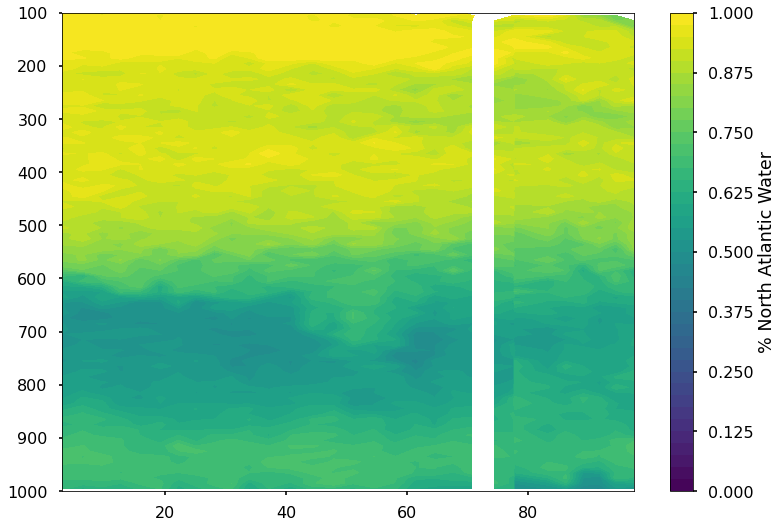

In [23]:
plt.contourf(np.cumsum(df_2021b_final.dist)/1000,df_2021b_final.depth,df_2021b_final.naw_frac,levels=np.arange(0,1.01,0.025))
plt.ylim(1000,100)
plt.colorbar(label='% North Atlantic Water')

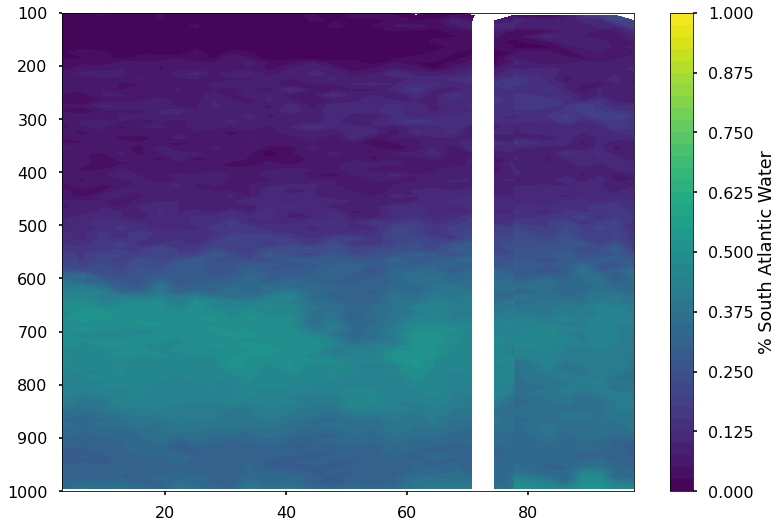

In [24]:
plt.contourf(np.cumsum(df_2021b_final.dist)/1000,df_2021b_final.depth,df_2021b_final.saw_frac,levels=np.arange(0,1.01,0.025))
plt.ylim(1000,100)
plt.colorbar(label='% South Atlantic Water')

## 2021a

In [25]:
np.nansum(df_2021a_final.naw_transport)

-3.185151237727746

In [26]:
np.nansum(df_2021a_final.saw_transport)

-0.8646512234078655

In [27]:
np.nansum(df_2021a_final.transport)

-4.049802461135612

In [28]:
np.nansum(df_2021a_final.naw_transport)/np.nansum(df_2021a_final.transport)

0.7864954570733784

In [29]:
np.nansum(df_2021a_final.saw_transport)/np.nansum(df_2021a_final.transport)

0.21350454292662147

### just surface layer now

In [30]:
np.nansum(df_2021a_final.saw_transport)+np.nansum(subset_ds_2021a_surf_final.transport)

-1.21014206631672

## total SAW transport now

In [31]:
np.nansum(subset_ds_2021a_surf_final.transport)

-0.34549084290885446

## 2021b

In [32]:
np.nansum(df_2021b_final.naw_transport)

-3.8785559036728765

In [33]:
np.nansum(df_2021b_final.saw_transport)

-0.994864584404005

In [34]:
np.nansum(df_2021b_final.transport)

-4.873420488076882

In [35]:
np.nansum(df_2021b_final.naw_transport)/np.nansum(df_2021b_final.transport)

0.795859071295407

In [36]:
np.nansum(df_2021b_final.saw_transport)/np.nansum(df_2021b_final.transport)

0.20414092870459288

### just surface layer now

In [37]:
np.nansum(df_2021b_final.saw_transport)+np.nansum(subset_ds_2021b_surf_final.transport)

-1.330451223986625

In [38]:
np.nansum(subset_ds_2021b_surf_final.transport)/-5.24

0.06404325182874428

### total SAW now

In [39]:
np.nansum(subset_ds_2021b_surf_final.transport)

-0.33558663958262

# Now do it for the repeat transects for the 2020 and 2022 deployments

In [40]:

def solve_endmember_fractions_multiple(df,naw_interp_mean_temp,naw_interp_mean_sal, saw_interp_mean_temp,saw_interp_mean_sal,gridden):
    ## preallocation soln matrix
    naw_frac_df = np.empty(df.temp.shape)
    naw_frac_df[:] = np.nan
    saw_frac_df = np.empty(df.temp.shape)
    saw_frac_df[:] = np.nan
    temp_resid_df = np.empty(df.temp.shape)
    temp_resid_df[:] = np.nan
    sal_resid_df = np.empty(df.temp.shape)
    sal_resid_df[:] = np.nan
    mass_resid_df = np.empty(df.temp.shape)
    mass_resid_df[:] = np.nan

    ## Loop through each row (depth) and perform water mass analysis
    for z in np.arange(0,len(df.transect_num)):
        for x in np.arange(0,len(df.depth)):
            for y in np.arange(0,len(df.lat)):
                ## if there is a nan value, skip
                if ~np.isnan(df.temp.values[x,y,z]):
                    ## subset to just the depth row of interest and make pandas dataframe
                    d = {'potential_temperature': df.temp.values[x,y,z], 'salinity': df.sal.values[x,y,z]}
                    obs_df = pd.DataFrame(data=d, index=[0])
                    obs_df["mass"] = 1.0

                    ## find matching closest isopycnal index in source water data
                    ## theoretically a different index for NAW vs SAW
                    diffs = np.abs(df.density.values[x,y,z]-gridden)
                    naw_iso_ind = np.nanargmin(diffs)
                    saw_iso_ind = np.nanargmin(diffs)

                    ## oull out NAW and SAW temp and sal
                    endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
                    endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
                    endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
                    endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
                    ## run analysis
                    ompa_soln = pyompa.OMPAProblem(obs_df = obs_df, **settings).solve(endmemberdf,endmember_name_column = "endmember_name")
                    ## save soln'n
                    naw_frac_df[x,y,z]   = ompa_soln.endmember_fractions[0,0]
                    saw_frac_df[x,y,z]   = ompa_soln.endmember_fractions[0,1]
                    temp_resid_df[x,y,z] = ompa_soln.param_residuals[0,0]
                    sal_resid_df[x,y,z]  = ompa_soln.param_residuals[0,1]
                    mass_resid_df[x,y,z] = ompa_soln.param_residuals[0,2]

    df["naw_frac"]=(['depth', 'lat', 'transect_num'],  naw_frac_df)
    df["saw_frac"]=(['depth', 'lat', 'transect_num'],  saw_frac_df)
    df["temp_resid"]=(['depth', 'lat', 'transect_num'],  temp_resid_df)
    df["sal_resid"]=(['depth', 'lat', 'transect_num'],  sal_resid_df)
    df["mass_resid"]=(['depth', 'lat', 'transect_num'],  mass_resid_df)

    ############ Now calculate transport!!!!!
    ## preallocate for loop
    transport = np.empty(df.temp.shape)
    transport[:] = np.NaN
    ## calc dz based on depth data
    dz = df.depth.values[1]-df.depth.values[0]
    ## lon hard-coded due to grid design
    distance = dist_from_lat_lon(subset_ds_2020.lat[0], -64.80, subset_ds_2020.lat[1], -64.80)

    ## loop through and calculate transport in Sv based on dz and dx (dist)
    for x in np.arange(0,len(df.transect_num)):
        transport[:,:,x] = (df.u[:,:,x].values*dz*distance)/(10**6)

    ## now multiply by %naw oand %saw to calculate transport of naw and saw
    naw_transport = transport*naw_frac_df
    saw_transport = transport*saw_frac_df

    df["transport"]=(['depth', 'lat', 'transect_num'],  transport)
    df["naw_transport"]=(['depth', 'lat', 'transect_num'],  naw_transport)
    df["saw_transport"]=(['depth', 'lat', 'transect_num'],  saw_transport)
    return df


def calc_transport_multiple(df):
    ############ Now calculate transport!!!!!
    ## preallocate for loop
    transport = np.empty(df.temp.shape)
    transport[:] = np.NaN
    ## calc dz based on depth data
    dz = df.depth.values[1]-df.depth.values[0]
    ## lon hard-coded due to grid design
    distance = dist_from_lat_lon(subset_ds_2020.lat[0], -64.80, subset_ds_2020.lat[1], -64.80)

    ## loop through and calculate transport in Sv based on dz and dx (dist)
    for x in np.arange(0,len(df.transect_num)):
        transport[:,:,x] = (df.u[:,:,x].values*dz*distance)/(10**6)

    df["transport"]=(['depth', 'lat', 'transect_num'],  transport)

    return df


In [41]:
subset_ds_2020_surf_final = calc_transport_multiple(subset_ds_2020_surf)
subset_ds_2022_surf_final = calc_transport_multiple(subset_ds_2022_surf)

In [42]:
df_2020_final = solve_endmember_fractions_multiple(subset_ds_2020,naw_interp_mean_temp,naw_interp_mean_sal,saw_interp_mean_temp,saw_interp_mean_sal,gridden)


Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.842332511567657e-06
Original weighted sum squares: 8.842332511567657e-06
Post fix weighted sum squared: 8.842332511559618e-06
On example 0 to 1 out of 1
status: optimal
optimal value 8.842332511567657e-06
Original weighted sum squares: 8.842332511567657e-06
Post fix weighted sum squared: 8.842332511559618e-06
objective: 8.842332511559618e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.004697843931160916
Original weighted sum squares: 0.004697843931160916
Post fix weighted sum squared: 0.00469784

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.593125839191279e-06
Original weighted sum squares: 7.593125839191279e-06
Post fix weighted sum squared: 7.593125839191279e-06
objective: 7.593125839191279e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.761345299440897e-06
Original weighted sum squares: 5.761345299440897e-06
Post fix weighted sum squared: 5.761345299440897e-06
On example 0 to 1 out of 1
status: optimal
optimal value 5.761345299440897e-06
Original weighted sum squares: 5.761345299440897e-06
Post fix weighted sum squared: 5.761345299440897e-06
objective: 5.761345299440897e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.2974590295585584e-05
Original weighted sum squares: 4.2974590295585584e-05
Post fix weighted sum squared: 4.297459029553356e-05
objective: 4.297459029553356e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.630692075504995e-06
Original weighted sum squares: 9.630692075504995e-06
Post fix weighted sum squared: 9.630692075529593e-06
On example 0 to 1 out of 1
status: optimal
optimal value 9.630692075504995e-06
Original weighted sum squares: 9.630692075504995e-06
Post fix weighted sum squared: 9.630692075529593e-06
objective: 9.630692075529593e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.1209902958111069e-05
Original weighted sum squares: 1.1209902958111069e-05
Post fix weighted sum squared: 1.1209902958119632e-05
objective: 1.1209902958119632e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.110682161138366e-05
Original weighted sum squares: 6.110682161138366e-05
Post fix weighted sum squared: 6.110682161144706e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.110682161138366e-05
Original weighted sum squares: 6.110682161138366e-05
Post fix weighted sum squared: 6.110682161144706e-05
objective: 6.110682161144706e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.2490504454029652e-05
Original weighted sum squares: 1.2490504454029652e-05
Post fix weighted sum squared: 1.2490504454029652e-05
objective: 1.2490504454029652e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.5331585211181543e-05
Original weighted sum squares: 1.5331585211181543e-05
Post fix weighted sum squared: 1.5331585211139492e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.5331585211181543e-05
Original weighted sum squares: 1.5331585211181543e-05
Post fix weighted sum squared: 1.5331585211139492e-05
objective: 1.5331585211139492e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 9.084677429518188e-06
Original weighted sum squares: 9.084677429518188e-06
Post fix weighted sum squared: 9.084677429550752e-06
objective: 9.084677429550752e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.240299204579852e-05
Original weighted sum squares: 2.240299204579852e-05
Post fix weighted sum squared: 2.240299204584953e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.240299204579852e-05
Original weighted sum squares: 2.240299204579852e-05
Post fix weighted sum squared: 2.240299204584953e-05
objective: 2.240299204584953e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.293876378171246e-06
Original weighted sum squares: 5.293876378171246e-06
Post fix weighted sum squared: 5.293876378127018e-06
objective: 5.293876378127018e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.5465768528234892e-05
Original weighted sum squares: 1.5465768528234892e-05
Post fix weighted sum squared: 1.546576852836281e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.5465768528234892e-05
Original weighted sum squares: 1.5465768528234892e-05
Post fix weighted sum squared: 1.546576852836281e-05
objective: 1.546576852836281e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 8.553515117270175e-06
Original weighted sum squares: 8.553515117270175e-06
Post fix weighted sum squared: 8.553515117334244e-06
objective: 8.553515117334244e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.8070718670198667e-05
Original weighted sum squares: 1.8070718670198667e-05
Post fix weighted sum squared: 1.8070718670152314e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.8070718670198667e-05
Original weighted sum squares: 1.8070718670198667e-05
Post fix weighted sum squared: 1.8070718670152314e-05
objective: 1.8070718670152314e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.323565121492878e-05
Original weighted sum squares: 5.323565121492878e-05
Post fix weighted sum squared: 5.323565121500882e-05
objective: 5.323565121500882e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.175298085889877e-05
Original weighted sum squares: 6.175298085889877e-05
Post fix weighted sum squared: 6.175298085900396e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.175298085889877e-05
Original weighted sum squares: 6.175298085889877e-05
Post fix weighted sum squared: 6.175298085900396e-05
objective: 6.175298085900396e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 5.55389599460497e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.686914577004973e-06
Original weighted sum squares: 3.686914577004973e-06
Post fix weighted sum squared: 3.686914577052042e-06
On example 0 to 1 out of 1
status: optimal
optimal value 3.686914577004973e-06
Original weighted sum squares: 3.686914577004973e-06
Post fix weighted sum squared: 3.686914577052042e-06
objective: 3.686914577052042e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011854153312372155
Original weighted sum squares: 0.00011854153312372155
Post fix weight

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

optimal value 1.1991514075968974e-05
Original weighted sum squares: 1.1991514075968974e-05
Post fix weighted sum squared: 1.1991514075930458e-05
objective: 1.1991514075930458e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011651300785862442
Original weighted sum squares: 0.00011651300785862442
Post fix weighted sum squared: 0.00011651300785862442
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011651300785862442
Original weighted sum squares: 0.00011651300785862442
Post fix weighted sum squared: 0.00011651300785862442
objective: 0.00011651300785862442
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 8.163116565658452e-05
Original weighted sum squares: 8.163116565658452e-05
Post fix weighted sum squared: 8.163116565650466e-05
objective: 8.163116565650466e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.9237180612090194e-05
Original weighted sum squares: 4.9237180612090194e-05
Post fix weighted sum squared: 4.9237180612090194e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.9237180612090194e-05
Original weighted sum squares: 4.9237180612090194e-05
Post fix weighted sum squared: 4.9237180612090194e-05
objective: 4.9237180612090194e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = s

 optimal
optimal value 6.271710040493101e-05
Original weighted sum squares: 6.271710040493101e-05
Post fix weighted sum squared: 6.271710040501966e-05
objective: 6.271710040501966e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016282384852865702
Original weighted sum squares: 0.00016282384852865702
Post fix weighted sum squared: 0.00016282384852865702
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016282384852865702
Original weighted sum squares: 0.00016282384852865702
Post fix weighted sum squared: 0.00016282384852865702
objective: 0.00016282384852865702
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 3.910132643842707e-05
Original weighted sum squares: 3.910132643842707e-05
Post fix weighted sum squared: 3.910132643842707e-05
objective: 3.910132643842707e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015478161076294493
Original weighted sum squares: 0.00015478161076294493
Post fix weighted sum squared: 0.00015478161076308499
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015478161076294493
Original weighted sum squares: 0.00015478161076294493
Post fix weighted sum squared: 0.00015478161076308499
objective: 0.00015478161076308499
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00012577841878372764
Original weighted sum squares: 0.00012577841878372764
Post fix weighted sum squared: 0.0001257784187836261
objective: 0.0001257784187836261
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001364086623157004
Original weighted sum squares: 0.0001364086623157004
Post fix weighted sum squared: 0.0001364086623158323
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001364086623157004
Original weighted sum squares: 0.0001364086623157004
Post fix weighted sum squared: 0.0001364086623158323
objective: 0.0001364086623158323
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00018396360990213182
Original weighted sum squares: 0.00018396360990213182
Post fix weighted sum squared: 0.00018396360990197827
objective: 0.00018396360990197827
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001075375970293672
Original weighted sum squares: 0.0001075375970293672
Post fix weighted sum squared: 0.00010753759702948478
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001075375970293672
Original weighted sum squares: 0.0001075375970293672
Post fix weighted sum squared: 0.00010753759702948478
objective: 0.00010753759702948478
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.603621181398111e-05
Original weighted sum squares: 3.603621181398111e-05
Post fix weighted sum squared: 3.6036211814117236e-05
objective: 3.6036211814117236e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010509192586661435
Original weighted sum squares: 0.00010509192586661435
Post fix weighted sum squared: 0.00010509192586686964
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010509192586661435
Original weighted sum squares: 0.00010509192586661435
Post fix weighted sum squared: 0.00010509192586686964
objective: 0.00010509192586686964
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00018106950186286202
Original weighted sum squares: 0.00018106950186286202
Post fix weighted sum squared: 0.00018106950186270876
objective: 0.00018106950186270876
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.3383381973274424e-05
Original weighted sum squares: 1.3383381973274424e-05
Post fix weighted sum squared: 1.3383381973240637e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.3383381973274424e-05
Original weighted sum squares: 1.3383381973274424e-05
Post fix weighted sum squared: 1.3383381973240637e-05
objective: 1.3383381973240637e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 1.6672366843411548e-06
Original weighted sum squares: 1.6672366843411548e-06
Post fix weighted sum squared: 1.6672366843559116e-06
objective: 1.6672366843559116e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.805098905097313e-06
Original weighted sum squares: 4.805098905097313e-06
Post fix weighted sum squared: 4.805098905072261e-06
On example 0 to 1 out of 1
status: optimal
optimal value 4.805098905097313e-06
Original weighted sum squares: 4.805098905097313e-06
Post fix weighted sum squared: 4.805098905072261e-06
objective: 4.805098905072261e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 1.3983746969573418e-05
Original weighted sum squares: 1.3983746969573418e-05
Post fix weighted sum squared: 1.3983746969487739e-05
objective: 1.3983746969487739e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.146202365697787e-05
Original weighted sum squares: 2.146202365697787e-05
Post fix weighted sum squared: 2.1462023657031072e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.146202365697787e-05
Original weighted sum squares: 2.146202365697787e-05
Post fix weighted sum squared: 2.1462023657031072e-05
objective: 2.1462023657031072e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.6639669528058356e-06
Original weighted sum squares: 2.6639669528058356e-06
Post fix weighted sum squared: 2.6639669528058356e-06
objective: 2.6639669528058356e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.743075042084178e-05
Original weighted sum squares: 8.743075042084178e-05
Post fix weighted sum squared: 8.743075042094951e-05
On example 0 to 1 out of 1
status: optimal
optimal value 8.743075042084178e-05
Original weighted sum squares: 8.743075042084178e-05
Post fix weighted sum squared: 8.743075042094951e-05
objective: 8.743075042094951e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0001349705914707829
Original weighted sum squares: 0.0001349705914707829
Post fix weighted sum squared: 0.0001349705914707829
objective: 0.0001349705914707829
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.58015412257002e-05
Original weighted sum squares: 9.58015412257002e-05
Post fix weighted sum squared: 9.580154122545389e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.58015412257002e-05
Original weighted sum squares: 9.58015412257002e-05
Post fix weighted sum squared: 9.580154122545389e-05
objective: 9.580154122545389e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00015336329832328134
Original weighted sum squares: 0.00015336329832328134
Post fix weighted sum squared: 0.00015336329832328134
objective: 0.00015336329832328134
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012316914130158294
Original weighted sum squares: 0.00012316914130158294
Post fix weighted sum squared: 0.0001231691413014543
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012316914130158294
Original weighted sum squares: 0.00012316914130158294
Post fix weighted sum squared: 0.0001231691413014543
objective: 0.0001231691413014543
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedva

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 9.802159748183306e-06
Original weighted sum squares: 9.802159748183306e-06
Post fix weighted sum squared: 9.802159748183306e-06
objective: 9.802159748183306e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.1527879890703966e-05
Original weighted sum squares: 1.1527879890703966e-05
Post fix weighted sum squared: 1.1527879890782823e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.1527879890703966e-05
Original weighted sum squares: 1.1527879890703966e-05
Post fix weighted sum squared: 1.1527879890782823e-05
objective: 1.1527879890782823e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.095941130951684e-05
Original weighted sum squares: 2.095941130951684e-05
Post fix weighted sum squared: 2.095941130951684e-05
objective: 2.095941130951684e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.902556483857999e-05
Original weighted sum squares: 6.902556483857999e-05
Post fix weighted sum squared: 6.902556483857999e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.902556483857999e-05
Original weighted sum squares: 6.902556483857999e-05
Post fix weighted sum squared: 6.902556483857999e-05
objective: 6.902556483857999e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001932735498965807
Original weighted sum squares: 0.0001932735498965807
Post fix weighted sum squared: 0.0001932735498967435
objective: 0.0001932735498967435
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.444193508860992e-05
Original weighted sum squares: 5.444193508860992e-05
Post fix weighted sum squared: 5.444193508860992e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.444193508860992e-05
Original weighted sum squares: 5.444193508860992e-05
Post fix weighted sum squared: 5.444193508860992e-05
objective: 5.444193508860992e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 7.767831174717628e-05
Original weighted sum squares: 7.767831174717628e-05
Post fix weighted sum squared: 7.767831174727972e-05
objective: 7.767831174727972e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016549213826811285
Original weighted sum squares: 0.00016549213826811285
Post fix weighted sum squared: 0.00016549213826827654
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016549213826811285
Original weighted sum squares: 0.00016549213826811285
Post fix weighted sum squared: 0.00016549213826827654
objective: 0.00016549213826827654
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.1788909128677315e-05
Original weighted sum squares: 1.1788909128677315e-05
Post fix weighted sum squared: 1.1788909128593087e-05
objective: 1.1788909128593087e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.202016018490484e-05
Original weighted sum squares: 3.202016018490484e-05
Post fix weighted sum squared: 3.202016018490484e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.202016018490484e-05
Original weighted sum squares: 3.202016018490484e-05
Post fix weighted sum squared: 3.202016018490484e-05
objective: 3.202016018490484e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00010139773099883368
Original weighted sum squares: 0.00010139773099883368
Post fix weighted sum squared: 0.00010139773099895292
objective: 0.00010139773099895292
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002140261777708803
Original weighted sum squares: 0.0002140261777708803
Post fix weighted sum squared: 0.00021402617777070644
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002140261777708803
Original weighted sum squares: 0.0002140261777708803
Post fix weighted sum squared: 0.00021402617777070644
objective: 0.00021402617777070644
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.843454020364334e-05
Original weighted sum squares: 3.843454020364334e-05
Post fix weighted sum squared: 3.843454020341065e-05
objective: 3.843454020341065e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018946299407725096
Original weighted sum squares: 0.00018946299407725096
Post fix weighted sum squared: 0.00018946299407723844
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018946299407725096
Original weighted sum squares: 0.00018946299407725096
Post fix weighted sum squared: 0.00018946299407723844
objective: 0.00018946299407723844
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.4953325044406215e-05
Original weighted sum squares: 3.4953325044406215e-05
Post fix weighted sum squared: 3.4953325044406215e-05
objective: 3.4953325044406215e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.564996618626167e-05
Original weighted sum squares: 9.564996618626167e-05
Post fix weighted sum squared: 9.564996618614492e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.564996618626167e-05
Original weighted sum squares: 9.564996618626167e-05
Post fix weighted sum squared: 9.564996618614492e-05
objective: 9.564996618614492e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 3.3860275915387933e-05
Original weighted sum squares: 3.3860275915387933e-05
Post fix weighted sum squared: 3.3860275915318375e-05
objective: 3.3860275915318375e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.708727977920023e-05
Original weighted sum squares: 9.708727977920023e-05
Post fix weighted sum squared: 9.708727977932696e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.708727977920023e-05
Original weighted sum squares: 9.708727977920023e-05
Post fix weighted sum squared: 9.708727977932696e-05
objective: 9.708727977932696e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.574131104312063e-05
Original weighted sum squares: 5.574131104312063e-05
Post fix weighted sum squared: 5.574131104321021e-05
objective: 5.574131104321021e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021526277823415716
Original weighted sum squares: 0.00021526277823415716
Post fix weighted sum squared: 0.0002152627782345222
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021526277823415716
Original weighted sum squares: 0.00021526277823415716
Post fix weighted sum squared: 0.0002152627782345222
objective: 0.0002152627782345222
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0002291305226028292
Original weighted sum squares: 0.0002291305226028292
Post fix weighted sum squared: 0.0002291305226024386
objective: 0.0002291305226024386
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.8865941116776436e-05
Original weighted sum squares: 4.8865941116776436e-05
Post fix weighted sum squared: 4.886594111669234e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.8865941116776436e-05
Original weighted sum squares: 4.8865941116776436e-05
Post fix weighted sum squared: 4.886594111669234e-05
objective: 4.886594111669234e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00027776699838203794
Original weighted sum squares: 0.00027776699838203794
Post fix weighted sum squared: 0.00027776699838203794
objective: 0.00027776699838203794
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003088689399205266
Original weighted sum squares: 0.0003088689399205266
Post fix weighted sum squared: 0.0003088689399205115
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003088689399205266
Original weighted sum squares: 0.0003088689399205266
Post fix weighted sum squared: 0.0003088689399205115
objective: 0.0003088689399205115
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00013040149266357269
Original weighted sum squares: 0.00013040149266357269
Post fix weighted sum squared: 0.00013040149266356287
objective: 0.00013040149266356287
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00036306175427309486
Original weighted sum squares: 0.00036306175427309486
Post fix weighted sum squared: 0.00036306175427260176
On example 0 to 1 out of 1
status: optimal
optimal value 0.00036306175427309486
Original weighted sum squares: 0.00036306175427309486
Post fix weighted sum squared: 0.00036306175427260176
objective: 0.00036306175427260176
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0002293551077086396
Original weighted sum squares: 0.0002293551077086396
Post fix weighted sum squared: 0.00022935510770922797
objective: 0.00022935510770922797
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00034490111278660443
Original weighted sum squares: 0.00034490111278660443
Post fix weighted sum squared: 0.00034490111278636336
On example 0 to 1 out of 1
status: optimal
optimal value 0.00034490111278660443
Original weighted sum squares: 0.00034490111278660443
Post fix weighted sum squared: 0.00034490111278636336
objective: 0.00034490111278636336
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0002931255446794007
Original weighted sum squares: 0.0002931255446794007
Post fix weighted sum squared: 0.0002931255446794007
objective: 0.0002931255446794007
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001768484315891527
Original weighted sum squares: 0.0001768484315891527
Post fix weighted sum squared: 0.0001768484315891527
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001768484315891527
Original weighted sum squares: 0.0001768484315891527
Post fix weighted sum squared: 0.0001768484315891527
objective: 0.0001768484315891527
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.000368019101196084
Original weighted sum squares: 0.000368019101196084
Post fix weighted sum squared: 0.0003680191011965828
objective: 0.0003680191011965828
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00036551701374204417
Original weighted sum squares: 0.00036551701374204417
Post fix weighted sum squared: 0.00036551701374204417
On example 0 to 1 out of 1
status: optimal
optimal value 0.00036551701374204417
Original weighted sum squares: 0.00036551701374204417
Post fix weighted sum squared: 0.00036551701374204417
objective: 0.00036551701374204417
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0003603695454597412
Original weighted sum squares: 0.0003603695454597412
Post fix weighted sum squared: 0.0003603695454597412
objective: 0.0003603695454597412
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003083206823866014
Original weighted sum squares: 0.0003083206823866014
Post fix weighted sum squared: 0.000308320682386387
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003083206823866014
Original weighted sum squares: 0.0003083206823866014
Post fix weighted sum squared: 0.000308320682386387
objective: 0.000308320682386387
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0003758686052672835
Original weighted sum squares: 0.0003758686052672835
Post fix weighted sum squared: 0.0003758686052667786
objective: 0.0003758686052667786
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005166440076837064
Original weighted sum squares: 0.0005166440076837064
Post fix weighted sum squared: 0.0005166440076839847
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005166440076837064
Original weighted sum squares: 0.0005166440076837064
Post fix weighted sum squared: 0.0005166440076839847
objective: 0.0005166440076839847
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0003875059989445104
Original weighted sum squares: 0.0003875059989445104
Post fix weighted sum squared: 0.00038750599894399725
objective: 0.00038750599894399725
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004322053422759731
Original weighted sum squares: 0.0004322053422759731
Post fix weighted sum squared: 0.00043220534227653243
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004322053422759731
Original weighted sum squares: 0.0004322053422759731
Post fix weighted sum squared: 0.00043220534227653243
objective: 0.00043220534227653243
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0004892514566875887
Original weighted sum squares: 0.0004892514566875887
Post fix weighted sum squared: 0.0004892514566875887
objective: 0.0004892514566875887
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002663710884625041
Original weighted sum squares: 0.0002663710884625041
Post fix weighted sum squared: 0.00026637108846249124
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002663710884625041
Original weighted sum squares: 0.0002663710884625041
Post fix weighted sum squared: 0.00026637108846249124
objective: 0.00026637108846249124
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 


Original weighted sum squares: 0.00043661695817579215
Post fix weighted sum squared: 0.00043661695817579215
objective: 0.00043661695817579215
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00037787151241905353
Original weighted sum squares: 0.00037787151241905353
Post fix weighted sum squared: 0.0003778715124193078
On example 0 to 1 out of 1
status: optimal
optimal value 0.00037787151241905353
Original weighted sum squares: 0.00037787151241905353
Post fix weighted sum squared: 0.0003778715124193078
objective: 0.0003778715124193078
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0007434013443809247
Original weighted sum squares: 0.0007434013443809247
Post fix weighted sum squared: 0.0007434013443805676
objective: 0.0007434013443805676
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000746508347773047
Original weighted sum squares: 0.000746508347773047
Post fix weighted sum squared: 0.0007465083477733842
On example 0 to 1 out of 1
status: optimal
optimal value 0.000746508347773047
Original weighted sum squares: 0.000746508347773047
Post fix weighted sum squared: 0.0007465083477733842
objective: 0.0007465083477733842
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 0.0010366503664577399
Original weighted sum squares: 0.0010366503664577399
Post fix weighted sum squared: 0.0010366503664581618
objective: 0.0010366503664581618
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000828157368436137
Original weighted sum squares: 0.000828157368436137
Post fix weighted sum squared: 0.0008281573684357814
On example 0 to 1 out of 1
status: optimal
optimal value 0.000828157368436137
Original weighted sum squares: 0.000828157368436137
Post fix weighted sum squared: 0.0008281573684357814
objective: 0.0008281573684357814
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0011017407470735817
Original weighted sum squares: 0.0011017407470735817
Post fix weighted sum squared: 0.0011017407470740189
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011017407470735817
Original weighted sum squares: 0.0011017407470735817
Post fix weighted sum squared: 0.0011017407470740189
objective: 0.0011017407470740189
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006962912226031389
Original weighted sum squares: 0.0006962912226031389
Post fix weighted sum squared: 0.0006962912226034858
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006962912226031389
Original weighted sum squares: 0.0006962912226031389
Post fix weighted sum squared: 0.0006962912226034858
objective: 0.0006962912226034858
Endmembe

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0013197801548691895
Original weighted sum squares: 0.0013197801548691895
Post fix weighted sum squared: 0.0013197801548691895
objective: 0.0013197801548691895
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001105817287494127
Original weighted sum squares: 0.001105817287494127
Post fix weighted sum squared: 0.0011058172874945404
On example 0 to 1 out of 1
status: optimal
optimal value 0.001105817287494127
Original weighted sum squares: 0.001105817287494127
Post fix weighted sum squared: 0.0011058172874945404
objective: 0.0011058172874945404
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0013813591342020318
Original weighted sum squares: 0.0013813591342020318
Post fix weighted sum squared: 0.0013813591342025223
objective: 0.0013813591342025223
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008796139548147219
Original weighted sum squares: 0.0008796139548147219
Post fix weighted sum squared: 0.0008796139548151125
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008796139548147219
Original weighted sum squares: 0.0008796139548147219
Post fix weighted sum squared: 0.0008796139548151125
objective: 0.0008796139548151125
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0009720640258441871
Original weighted sum squares: 0.0009720640258441871
Post fix weighted sum squared: 0.0009720640258445984
objective: 0.0009720640258445984
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007420619442424998
Original weighted sum squares: 0.0007420619442424998
Post fix weighted sum squared: 0.0007420619442424797
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007420619442424998
Original weighted sum squares: 0.0007420619442424998
Post fix weighted sum squared: 0.0007420619442424797
objective: 0.0007420619442424797
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0009487047719153249
Original weighted sum squares: 0.0009487047719153249
Post fix weighted sum squared: 0.0009487047719153249
objective: 0.0009487047719153249
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010981713475873504
Original weighted sum squares: 0.0010981713475873504
Post fix weighted sum squared: 0.0010981713475873504
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010981713475873504
Original weighted sum squares: 0.0010981713475873504
Post fix weighted sum squared: 0.0010981713475873504
objective: 0.0010981713475873504
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00138254053227566
Original weighted sum squares: 0.00138254053227566
Post fix weighted sum squared: 0.00138254053227566
objective: 0.00138254053227566
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012808298156907465
Original weighted sum squares: 0.0012808298156907465
Post fix weighted sum squared: 0.0012808298156907465
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012808298156907465
Original weighted sum squares: 0.0012808298156907465
Post fix weighted sum squared: 0.0012808298156907465
objective: 0.0012808298156907465
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0017969981993074724
Original weighted sum squares: 0.0017969981993074724
Post fix weighted sum squared: 0.0017969981993074724
objective: 0.0017969981993074724
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012633473392264821
Original weighted sum squares: 0.0012633473392264821
Post fix weighted sum squared: 0.0012633473392264821
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012633473392264821
Original weighted sum squares: 0.0012633473392264821
Post fix weighted sum squared: 0.0012633473392264821
objective: 0.0012633473392264821
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001404914033156322
Original weighted sum squares: 0.001404914033156322
Post fix weighted sum squared: 0.0014049140331568184
objective: 0.0014049140331568184
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011436871236328563
Original weighted sum squares: 0.0011436871236328563
Post fix weighted sum squared: 0.0011436871236328323
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011436871236328563
Original weighted sum squares: 0.0011436871236328563
Post fix weighted sum squared: 0.0011436871236328323
objective: 0.0011436871236328323
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0020666717555712357
Original weighted sum squares: 0.0020666717555712357
Post fix weighted sum squared: 0.0020666717555718377
objective: 0.0020666717555718377
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011767970983415621
Original weighted sum squares: 0.0011767970983415621
Post fix weighted sum squared: 0.0011767970983415621
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011767970983415621
Original weighted sum squares: 0.0011767970983415621
Post fix weighted sum squared: 0.0011767970983415621
objective: 0.0011767970983415621
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0016827279144559872
Original weighted sum squares: 0.0016827279144559872
Post fix weighted sum squared: 0.0016827279144571029
objective: 0.0016827279144571029
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001216364161844867
Original weighted sum squares: 0.001216364161844867
Post fix weighted sum squared: 0.0012163641618458156
On example 0 to 1 out of 1
status: optimal
optimal value 0.001216364161844867
Original weighted sum squares: 0.001216364161844867
Post fix weighted sum squared: 0.0012163641618458156
objective: 0.0012163641618458156
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.002093960556464902
Original weighted sum squares: 0.002093960556464902
Post fix weighted sum squared: 0.002093960556465509
objective: 0.002093960556465509
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0020947573585173795
Original weighted sum squares: 0.0020947573585173795
Post fix weighted sum squared: 0.0020947573585179866
On example 0 to 1 out of 1
status: optimal
optimal value 0.0020947573585173795
Original weighted sum squares: 0.0020947573585173795
Post fix weighted sum squared: 0.0020947573585179866
objective: 0.0020947573585179866
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0018017114954302171
Original weighted sum squares: 0.0018017114954302171
Post fix weighted sum squared: 0.0018017114954302171
objective: 0.0018017114954302171
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015389123270130305
Original weighted sum squares: 0.0015389123270130305
Post fix weighted sum squared: 0.0015389123270130305
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015389123270130305
Original weighted sum squares: 0.0015389123270130305
Post fix weighted sum squared: 0.0015389123270130305
objective: 0.0015389123270130305
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0023493716879533777
Original weighted sum squares: 0.0023493716879533777
Post fix weighted sum squared: 0.002349371687952701
objective: 0.002349371687952701
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001997041536970298
Original weighted sum squares: 0.001997041536970298
Post fix weighted sum squared: 0.001997041536970298
On example 0 to 1 out of 1
status: optimal
optimal value 0.001997041536970298
Original weighted sum squares: 0.001997041536970298
Post fix weighted sum squared: 0.001997041536970298
objective: 0.001997041536970298
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0016796370483944873
Original weighted sum squares: 0.0016796370483944873
Post fix weighted sum squared: 0.0016796370483939426
objective: 0.0016796370483939426
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002094307318313485
Original weighted sum squares: 0.002094307318313485
Post fix weighted sum squared: 0.002094307318313485
On example 0 to 1 out of 1
status: optimal
optimal value 0.002094307318313485
Original weighted sum squares: 0.002094307318313485
Post fix weighted sum squared: 0.002094307318313485
objective: 0.002094307318313485
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0017693968757582204
Original weighted sum squares: 0.0017693968757582204
Post fix weighted sum squared: 0.0017693968757582204
objective: 0.0017693968757582204
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002155209675657956
Original weighted sum squares: 0.002155209675657956
Post fix weighted sum squared: 0.002155209675658574
On example 0 to 1 out of 1
status: optimal
optimal value 0.002155209675657956
Original weighted sum squares: 0.002155209675657956
Post fix weighted sum squared: 0.002155209675658574
objective: 0.002155209675658574
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0016866941645351822
Original weighted sum squares: 0.0016866941645351822
Post fix weighted sum squared: 0.001686694164535729
objective: 0.001686694164535729
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014215439641946197
Original weighted sum squares: 0.0014215439641946197
Post fix weighted sum squared: 0.0014215439641946197
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014215439641946197
Original weighted sum squares: 0.0014215439641946197
Post fix weighted sum squared: 0.0014215439641946197
objective: 0.0014215439641946197
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0015805580180905427
Original weighted sum squares: 0.0015805580180905427
Post fix weighted sum squared: 0.0015805580180910722
objective: 0.0015805580180910722
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001620447766712109
Original weighted sum squares: 0.001620447766712109
Post fix weighted sum squared: 0.0016204477667126457
On example 0 to 1 out of 1
status: optimal
optimal value 0.001620447766712109
Original weighted sum squares: 0.001620447766712109
Post fix weighted sum squared: 0.0016204477667126457
objective: 0.0016204477667126457
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001477050854358148
Original weighted sum squares: 0.001477050854358148
Post fix weighted sum squared: 0.0014770508543586604
objective: 0.0014770508543586604
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015413847325293718
Original weighted sum squares: 0.0015413847325293718
Post fix weighted sum squared: 0.0015413847325288356
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015413847325293718
Original weighted sum squares: 0.0015413847325293718
Post fix weighted sum squared: 0.0015413847325288356
objective: 0.0015413847325288356
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0015735120890292438
Original weighted sum squares: 0.0015735120890292438
Post fix weighted sum squared: 0.0015735120890292438
objective: 0.0015735120890292438
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016022115533416558
Original weighted sum squares: 0.0016022115533416558
Post fix weighted sum squared: 0.0016022115533422029
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016022115533416558
Original weighted sum squares: 0.0016022115533416558
Post fix weighted sum squared: 0.0016022115533422029
objective: 0.0016022115533422029
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.002047427593914392
Original weighted sum squares: 0.002047427593914392
Post fix weighted sum squared: 0.0020474275939149963
objective: 0.0020474275939149963
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017657295059882775
Original weighted sum squares: 0.0017657295059882775
Post fix weighted sum squared: 0.0017657295059882775
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017657295059882775
Original weighted sum squares: 0.0017657295059882775
Post fix weighted sum squared: 0.0017657295059882775
objective: 0.0017657295059882775
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.002227880043891268
Original weighted sum squares: 0.002227880043891268
Post fix weighted sum squared: 0.002227880043891268
objective: 0.002227880043891268
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0021820757795579376
Original weighted sum squares: 0.0021820757795579376
Post fix weighted sum squared: 0.0021820757795592022
On example 0 to 1 out of 1
status: optimal
optimal value 0.0021820757795579376
Original weighted sum squares: 0.0021820757795579376
Post fix weighted sum squared: 0.0021820757795592022
objective: 0.0021820757795592022
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0020168560585394394
Original weighted sum squares: 0.0020168560585394394
Post fix weighted sum squared: 0.0020168560585406554
objective: 0.0020168560585406554
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013336788403243845
Original weighted sum squares: 0.0013336788403243845
Post fix weighted sum squared: 0.0013336788403253731
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013336788403243845
Original weighted sum squares: 0.0013336788403243845
Post fix weighted sum squared: 0.0013336788403253731
objective: 0.0013336788403253731
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0020164387505661597
Original weighted sum squares: 0.0020164387505661597
Post fix weighted sum squared: 0.0020164387505649294
objective: 0.0020164387505649294
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016966795306271704
Original weighted sum squares: 0.0016966795306271704
Post fix weighted sum squared: 0.0016966795306271704
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016966795306271704
Original weighted sum squares: 0.0016966795306271704
Post fix weighted sum squared: 0.0016966795306271704
objective: 0.0016966795306271704
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0013881673768283498
Original weighted sum squares: 0.0013881673768283498
Post fix weighted sum squared: 0.0013881673768283498
objective: 0.0013881673768283498
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015606613792575395
Original weighted sum squares: 0.0015606613792575395
Post fix weighted sum squared: 0.0015606613792575395
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015606613792575395
Original weighted sum squares: 0.0015606613792575395
Post fix weighted sum squared: 0.0015606613792575395
objective: 0.0015606613792575395
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00104217824511537
Original weighted sum squares: 0.00104217824511537
Post fix weighted sum squared: 0.00104217824511537
objective: 0.00104217824511537
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001091867371290077
Original weighted sum squares: 0.001091867371290077
Post fix weighted sum squared: 0.0010918673712905298
On example 0 to 1 out of 1
status: optimal
optimal value 0.001091867371290077
Original weighted sum squares: 0.001091867371290077
Post fix weighted sum squared: 0.0010918673712905298
objective: 0.0010918673712905298
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrai

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001692388068842617
Original weighted sum squares: 0.001692388068842617
Post fix weighted sum squared: 0.0016923880688420646
objective: 0.0016923880688420646
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013161452939206616
Original weighted sum squares: 0.0013161452939206616
Post fix weighted sum squared: 0.0013161452939206616
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013161452939206616
Original weighted sum squares: 0.0013161452939206616
Post fix weighted sum squared: 0.0013161452939206616
objective: 0.0013161452939206616
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001247471887232744
Original weighted sum squares: 0.001247471887232744
Post fix weighted sum squared: 0.001247471887232744
objective: 0.001247471887232744
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014630748211957418
Original weighted sum squares: 0.0014630748211957418
Post fix weighted sum squared: 0.0014630748211952285
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014630748211957418
Original weighted sum squares: 0.0014630748211957418
Post fix weighted sum squared: 0.0014630748211952285
objective: 0.0014630748211952285
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0008793208952859801
Original weighted sum squares: 0.0008793208952859801
Post fix weighted sum squared: 0.0008793208952863871
objective: 0.0008793208952863871
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011359112250934192
Original weighted sum squares: 0.0011359112250934192
Post fix weighted sum squared: 0.0011359112250934192
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011359112250934192
Original weighted sum squares: 0.0011359112250934192
Post fix weighted sum squared: 0.0011359112250934192
objective: 0.0011359112250934192
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0007239276551204484
Original weighted sum squares: 0.0007239276551204484
Post fix weighted sum squared: 0.00072392765512081
objective: 0.00072392765512081
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010070092057689582
Original weighted sum squares: 0.0010070092057689582
Post fix weighted sum squared: 0.0010070092057693845
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010070092057689582
Original weighted sum squares: 0.0010070092057689582
Post fix weighted sum squared: 0.0010070092057693845
objective: 0.0010070092057693845
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0013130200581742833
Original weighted sum squares: 0.0013130200581742833
Post fix weighted sum squared: 0.0013130200581742833
objective: 0.0013130200581742833
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008804255993061044
Original weighted sum squares: 0.0008804255993061044
Post fix weighted sum squared: 0.0008804255993061044
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008804255993061044
Original weighted sum squares: 0.0008804255993061044
Post fix weighted sum squared: 0.0008804255993061044
objective: 0.0008804255993061044
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0007664194272887378
Original weighted sum squares: 0.0007664194272887378
Post fix weighted sum squared: 0.0007664194272891102
objective: 0.0007664194272891102
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006387688571370965
Original weighted sum squares: 0.0006387688571370965
Post fix weighted sum squared: 0.0006387688571370965
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006387688571370965
Original weighted sum squares: 0.0006387688571370965
Post fix weighted sum squared: 0.0006387688571370965
objective: 0.0006387688571370965
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0006867462929747571
Original weighted sum squares: 0.0006867462929747571
Post fix weighted sum squared: 0.0006867462929747571
objective: 0.0006867462929747571
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000829275952827745
Original weighted sum squares: 0.000829275952827745
Post fix weighted sum squared: 0.0008292759528281325
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008292759528281407
Original weighted sum squares: 0.0008292759528281407
Post fix weighted sum squared: 0.0008292759528281325
objective: 0.0008292759528281325
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0005451093100310669
Original weighted sum squares: 0.0005451093100310669
Post fix weighted sum squared: 0.0005451093100310669
objective: 0.0005451093100310669
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007992354663623698
Original weighted sum squares: 0.0007992354663623698
Post fix weighted sum squared: 0.0007992354663623698
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007992354663623698
Original weighted sum squares: 0.0007992354663623698
Post fix weighted sum squared: 0.0007992354663623698
objective: 0.0007992354663623698
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0005179883233472137
Original weighted sum squares: 0.0005179883233472137
Post fix weighted sum squared: 0.0005179883233472137
objective: 0.0005179883233472137
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008541643838890148
Original weighted sum squares: 0.0008541643838890148
Post fix weighted sum squared: 0.0008541643838890148
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008541643838890148
Original weighted sum squares: 0.0008541643838890148
Post fix weighted sum squared: 0.0008541643838890148
objective: 0.0008541643838890148
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00022790539864097785
Original weighted sum squares: 0.00022790539864097785
Post fix weighted sum squared: 0.0002279053986411856
objective: 0.0002279053986411856
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00046426418549129695
Original weighted sum squares: 0.00046426418549129695
Post fix weighted sum squared: 0.00046426418549129695
On example 0 to 1 out of 1
status: optimal
optimal value 0.00046426418549129695
Original weighted sum squares: 0.00046426418549129695
Post fix weighted sum squared: 0.00046426418549129695
objective: 0.00046426418549129695
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00022175564227421032
Original weighted sum squares: 0.00022175564227421032
Post fix weighted sum squared: 0.00022175564227441537
objective: 0.00022175564227441537
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007421769482775548
Original weighted sum squares: 0.0007421769482775548
Post fix weighted sum squared: 0.0007421769482775548
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007421769482775548
Original weighted sum squares: 0.0007421769482775548
Post fix weighted sum squared: 0.0007421769482775548
objective: 0.0007421769482775548
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00015214524965893154
Original weighted sum squares: 0.00015214524965893154
Post fix weighted sum squared: 0.0001521452496591014
objective: 0.0001521452496591014
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00033117244281195417
Original weighted sum squares: 0.00033117244281195417
Post fix weighted sum squared: 0.00033117244281195417
On example 0 to 1 out of 1
status: optimal
optimal value 0.00033117244281195417
Original weighted sum squares: 0.00033117244281195417
Post fix weighted sum squared: 0.00033117244281195417
objective: 0.00033117244281195417
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.577971487179573e-05
Original weighted sum squares: 7.577971487179573e-05
Post fix weighted sum squared: 7.577971487167579e-05
objective: 7.577971487167579e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005520993854088679
Original weighted sum squares: 0.0005520993854088679
Post fix weighted sum squared: 0.0005520993854091914
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005520993854088679
Original weighted sum squares: 0.0005520993854088679
Post fix weighted sum squared: 0.0005520993854091914
objective: 0.0005520993854091914
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.011648652843544e-05
Original weighted sum squares: 6.011648652843544e-05
Post fix weighted sum squared: 6.011648652843544e-05
objective: 6.011648652843544e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022227971616346564
Original weighted sum squares: 0.00022227971616346564
Post fix weighted sum squared: 0.00022227971616346564
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022227971616346564
Original weighted sum squares: 0.00022227971616346564
Post fix weighted sum squared: 0.00022227971616346564
objective: 0.00022227971616346564
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.000231338450185983
Original weighted sum squares: 0.000231338450185983
Post fix weighted sum squared: 0.00023133845018619265
objective: 0.00023133845018619265
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018446686732278067
Original weighted sum squares: 0.00018446686732278067
Post fix weighted sum squared: 0.00018446686732259357
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018446686732278067
Original weighted sum squares: 0.00018446686732278067
Post fix weighted sum squared: 0.00018446686732259357
objective: 0.00018446686732259357
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.449003584030298e-05
Original weighted sum squares: 2.449003584030298e-05
Post fix weighted sum squared: 2.449003584023476e-05
objective: 2.449003584023476e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00024167859917622537
Original weighted sum squares: 0.00024167859917622537
Post fix weighted sum squared: 0.00024167859917601536
On example 0 to 1 out of 1
status: optimal
optimal value 0.00024167859917622537
Original weighted sum squares: 0.00024167859917622537
Post fix weighted sum squared: 0.00024167859917601536
objective: 0.00024167859917601536
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00024627348136187677
Original weighted sum squares: 0.00024627348136187677
Post fix weighted sum squared: 0.00024627348136187677
objective: 0.00024627348136187677
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010433606188733663
Original weighted sum squares: 0.00010433606188733663
Post fix weighted sum squared: 0.00010433606188733663
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010433606188733663
Original weighted sum squares: 0.00010433606188733663
Post fix weighted sum squared: 0.00010433606188733663
objective: 0.00010433606188733663
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0017909828456654725
Original weighted sum squares: 0.0017909828456654725
Post fix weighted sum squared: 0.0017909828456654725
objective: 0.0017909828456654725
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.5262327776663353e-06
Original weighted sum squares: 1.5262327776663353e-06
Post fix weighted sum squared: 1.5262327776921889e-06
On example 0 to 1 out of 1
status: optimal
optimal value 1.5262327776663353e-06
Original weighted sum squares: 1.5262327776663353e-06
Post fix weighted sum squared: 1.5262327776921889e-06
objective: 1.5262327776921889e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0057034047909087695
Original weighted sum squares: 0.0057034047909087695
Post fix weighted sum squared: 0.0057034047909087695
objective: 0.0057034047909087695
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.079457608940285e-05
Original weighted sum squares: 4.079457608940285e-05
Post fix weighted sum squared: 4.079457608940285e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.079457608940285e-05
Original weighted sum squares: 4.079457608940285e-05
Post fix weighted sum squared: 4.079457608940285e-05
objective: 4.079457608940285e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.7475553796677456e-05
Original weighted sum squares: 1.7475553796677456e-05
Post fix weighted sum squared: 1.747555379672134e-05
objective: 1.747555379672134e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.626366361688408e-06
Original weighted sum squares: 6.626366361688408e-06
Post fix weighted sum squared: 6.626366361681539e-06
On example 0 to 1 out of 1
status: optimal
optimal value 6.626366361688408e-06
Original weighted sum squares: 6.626366361688408e-06
Post fix weighted sum squared: 6.626366361681539e-06
objective: 6.626366361681539e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.7811384550874816e-05
Original weighted sum squares: 1.7811384550874816e-05
Post fix weighted sum squared: 1.781138455083019e-05
objective: 1.781138455083019e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005729504270056964
Original weighted sum squares: 0.0005729504270056964
Post fix weighted sum squared: 0.0005729504270056964
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005729504270056964
Original weighted sum squares: 0.0005729504270056964
Post fix weighted sum squared: 0.0005729504270056964
objective: 0.0005729504270056964
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.416716255196994e-05
Original weighted sum squares: 4.416716255196994e-05
Post fix weighted sum squared: 4.416716255196994e-05
objective: 4.416716255196994e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.110550674117801e-06
Original weighted sum squares: 4.110550674117801e-06
Post fix weighted sum squared: 4.110550674101343e-06
On example 0 to 1 out of 1
status: optimal
optimal value 4.110550674117801e-06
Original weighted sum squares: 4.110550674117801e-06
Post fix weighted sum squared: 4.110550674101343e-06
objective: 4.110550674101343e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 1.7155990966288208e-06
Original weighted sum squares: 1.7155990966288208e-06
Post fix weighted sum squared: 1.7155990966288208e-06
objective: 1.7155990966288208e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.6694409095944518e-05
Original weighted sum squares: 1.6694409095944518e-05
Post fix weighted sum squared: 1.669440909597789e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.6694409095944518e-05
Original weighted sum squares: 1.6694409095944518e-05
Post fix weighted sum squared: 1.669440909597789e-05
objective: 1.669440909597789e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 4.038073407493991e-07
Original weighted sum squares: 4.038073407493991e-07
Post fix weighted sum squared: 4.0380734075627146e-07
objective: 4.0380734075627146e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.874759375128572e-06
Original weighted sum squares: 6.874759375128572e-06
Post fix weighted sum squared: 6.874759375128572e-06
On example 0 to 1 out of 1
status: optimal
optimal value 6.874759375128572e-06
Original weighted sum squares: 6.874759375128572e-06
Post fix weighted sum squared: 6.874759375128572e-06
objective: 6.874759375128572e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.0333507349698185e-06
Original weighted sum squares: 2.0333507349698185e-06
Post fix weighted sum squared: 2.0333507349698185e-06
objective: 2.0333507349698185e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.2478879025681025e-06
Original weighted sum squares: 7.2478879025681025e-06
Post fix weighted sum squared: 7.247887902590718e-06
On example 0 to 1 out of 1
status: optimal
optimal value 7.2478879025681025e-06
Original weighted sum squares: 7.2478879025681025e-06
Post fix weighted sum squared: 7.247887902590718e-06
objective: 7.247887902590718e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedva

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.076093186835469e-05
Original weighted sum squares: 6.076093186835469e-05
Post fix weighted sum squared: 6.076093186833601e-05
objective: 6.076093186833601e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.6744919338707184e-06
Original weighted sum squares: 2.6744919338707184e-06
Post fix weighted sum squared: 2.6744919338707184e-06
On example 0 to 1 out of 1
status: optimal
optimal value 2.6744919338707184e-06
Original weighted sum squares: 2.6744919338707184e-06
Post fix weighted sum squared: 2.6744919338707184e-06
objective: 2.6744919338707184e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.5358315011077604e-06
Original weighted sum squares: 1.5358315011077604e-06
Post fix weighted sum squared: 1.5358315011077604e-06
objective: 1.5358315011077604e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.744981566636981e-05
Original weighted sum squares: 7.744981566636981e-05
Post fix weighted sum squared: 7.744981566605774e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.744981566636981e-05
Original weighted sum squares: 7.744981566636981e-05
Post fix weighted sum squared: 7.744981566605774e-05
objective: 7.744981566605774e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.8177140327280766e-05
Original weighted sum squares: 1.8177140327280766e-05
Post fix weighted sum squared: 1.817714032717577e-05
objective: 1.817714032717577e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012251197827243572
Original weighted sum squares: 0.00012251197827243572
Post fix weighted sum squared: 0.0001225119782721891
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012251197827243572
Original weighted sum squares: 0.00012251197827243572
Post fix weighted sum squared: 0.0001225119782721891
objective: 0.0001225119782721891
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvari

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.118248538871264e-05
Original weighted sum squares: 5.118248538871264e-05
Post fix weighted sum squared: 5.1182485388792716e-05
objective: 5.1182485388792716e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017144329367849942
Original weighted sum squares: 0.00017144329367849942
Post fix weighted sum squared: 0.0001714432936781767
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017144329367849942
Original weighted sum squares: 0.00017144329367849942
Post fix weighted sum squared: 0.0001714432936781767
objective: 0.0001714432936781767
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvari

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.473576667912793e-05
Original weighted sum squares: 7.473576667912793e-05
Post fix weighted sum squared: 7.47357666789348e-05
objective: 7.47357666789348e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001287184191507574
Original weighted sum squares: 0.0001287184191507574
Post fix weighted sum squared: 0.0001287184191507574
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001287184191507574
Original weighted sum squares: 0.0001287184191507574
Post fix weighted sum squared: 0.0001287184191507574
objective: 0.0001287184191507574
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.15289898964052e-05
Original weighted sum squares: 5.15289898964052e-05
Post fix weighted sum squared: 5.15289898964052e-05
objective: 5.15289898964052e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.110127498315794e-05
Original weighted sum squares: 7.110127498315794e-05
Post fix weighted sum squared: 7.110127498294854e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.110127498315794e-05
Original weighted sum squares: 7.110127498315794e-05
Post fix weighted sum squared: 7.110127498294854e-05
objective: 7.110127498294854e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00014509011352445983
Original weighted sum squares: 0.00014509011352445983
Post fix weighted sum squared: 0.00014509011352445983
objective: 0.00014509011352445983
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.93712323501377e-05
Original weighted sum squares: 6.93712323501377e-05
Post fix weighted sum squared: 6.937123235004343e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.93712323501377e-05
Original weighted sum squares: 6.93712323501377e-05
Post fix weighted sum squared: 6.937123235004343e-05
objective: 6.937123235004343e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.1836794621687917e-05
Original weighted sum squares: 2.1836794621687917e-05
Post fix weighted sum squared: 2.1836794621645067e-05
objective: 2.1836794621645067e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018608188644303665
Original weighted sum squares: 0.00018608188644303665
Post fix weighted sum squared: 0.00018608188644288223
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018608188644303665
Original weighted sum squares: 0.00018608188644303665
Post fix weighted sum squared: 0.00018608188644288223
objective: 0.00018608188644288223
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.274814593039789e-05
Original weighted sum squares: 4.274814593039789e-05
Post fix weighted sum squared: 4.274814593039789e-05
objective: 4.274814593039789e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.023349924852001e-05
Original weighted sum squares: 9.023349924852001e-05
Post fix weighted sum squared: 9.023349924852001e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.023349924852001e-05
Original weighted sum squares: 9.023349924852001e-05
Post fix weighted sum squared: 9.023349924852001e-05
objective: 9.023349924852001e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.6092055270980643e-05
Original weighted sum squares: 2.6092055270980643e-05
Post fix weighted sum squared: 2.609205527103898e-05
objective: 2.609205527103898e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.5989611585629062e-05
Original weighted sum squares: 2.5989611585629062e-05
Post fix weighted sum squared: 2.598961158550149e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.5989611585629062e-05
Original weighted sum squares: 2.5989611585629062e-05
Post fix weighted sum squared: 2.598961158550149e-05
objective: 2.598961158550149e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvari

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.0871061682815849e-05
Original weighted sum squares: 1.0871061682815849e-05
Post fix weighted sum squared: 1.0871061682815849e-05
objective: 1.0871061682815849e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.428261236078727e-05
Original weighted sum squares: 4.428261236078727e-05
Post fix weighted sum squared: 4.428261236078727e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.428261236078727e-05
Original weighted sum squares: 4.428261236078727e-05
Post fix weighted sum squared: 4.428261236078727e-05
objective: 4.428261236078727e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.6014561137732952e-05
Original weighted sum squares: 1.6014561137732952e-05
Post fix weighted sum squared: 1.601456113763281e-05
objective: 1.601456113763281e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014552330995339528
Original weighted sum squares: 0.00014552330995339528
Post fix weighted sum squared: 0.00014552330995355918
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014552330995339528
Original weighted sum squares: 0.00014552330995339528
Post fix weighted sum squared: 0.00014552330995355918
objective: 0.00014552330995355918
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00013038381884772864
Original weighted sum squares: 0.00013038381884772864
Post fix weighted sum squared: 0.00013038381884799148
objective: 0.00013038381884799148
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014943059995041274
Original weighted sum squares: 0.00014943059995041274
Post fix weighted sum squared: 0.00014943059995041274
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014943059995041274
Original weighted sum squares: 0.00014943059995041274
Post fix weighted sum squared: 0.00014943059995041274
objective: 0.00014943059995041274
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00010941772531991275
Original weighted sum squares: 0.00010941772531991275
Post fix weighted sum squared: 0.00010941772531979197
objective: 0.00010941772531979197
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.225356248219554e-05
Original weighted sum squares: 1.225356248219554e-05
Post fix weighted sum squared: 1.2253562482155003e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.225356248219554e-05
Original weighted sum squares: 1.225356248219554e-05
Post fix weighted sum squared: 1.2253562482155003e-05
objective: 1.2253562482155003e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.400865897588309e-05
Original weighted sum squares: 3.400865897588309e-05
Post fix weighted sum squared: 3.4008658975815556e-05
objective: 3.4008658975815556e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.928745906999276e-06
Original weighted sum squares: 8.928745906999276e-06
Post fix weighted sum squared: 8.928745906999276e-06
On example 0 to 1 out of 1
status: optimal
optimal value 8.928745906999276e-06
Original weighted sum squares: 8.928745906999276e-06
Post fix weighted sum squared: 8.928745906999276e-06
objective: 8.928745906999276e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.313195322413881e-05
Original weighted sum squares: 4.313195322413881e-05
Post fix weighted sum squared: 4.313195322429135e-05
objective: 4.313195322429135e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.0767048611206035e-05
Original weighted sum squares: 4.0767048611206035e-05
Post fix weighted sum squared: 4.0767048611354326e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.0767048611206035e-05
Original weighted sum squares: 4.0767048611206035e-05
Post fix weighted sum squared: 4.0767048611354326e-05
objective: 4.0767048611354326e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.9966854659112446e-05
Original weighted sum squares: 3.9966854659112446e-05
Post fix weighted sum squared: 3.9966854659112446e-05
objective: 3.9966854659112446e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010472704339129136
Original weighted sum squares: 0.00010472704339129136
Post fix weighted sum squared: 0.00010472704339129136
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010472704339129136
Original weighted sum squares: 0.00010472704339129136
Post fix weighted sum squared: 0.00010472704339129136
objective: 0.00010472704339129136
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00010070676632315301
Original weighted sum squares: 0.00010070676632315301
Post fix weighted sum squared: 0.00010070676632327036
objective: 0.00010070676632327036
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.492942344294388e-06
Original weighted sum squares: 5.492942344294388e-06
Post fix weighted sum squared: 5.492942344326385e-06
On example 0 to 1 out of 1
status: optimal
optimal value 5.492942344294388e-06
Original weighted sum squares: 5.492942344294388e-06
Post fix weighted sum squared: 5.492942344326385e-06
objective: 5.492942344326385e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.210751235560708e-05
Original weighted sum squares: 4.210751235560708e-05
Post fix weighted sum squared: 4.2107512355759045e-05
objective: 4.2107512355759045e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015609688167461262
Original weighted sum squares: 0.00015609688167461262
Post fix weighted sum squared: 0.00015609688167490522
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015609688167461262
Original weighted sum squares: 0.00015609688167461262
Post fix weighted sum squared: 0.00015609688167490522
objective: 0.00015609688167490522
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.211920228587962e-05
Original weighted sum squares: 7.211920228587962e-05
Post fix weighted sum squared: 7.211920228586311e-05
objective: 7.211920228586311e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016420000990510406
Original weighted sum squares: 0.00016420000990510406
Post fix weighted sum squared: 0.00016420000990525428
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016420000990510406
Original weighted sum squares: 0.00016420000990510406
Post fix weighted sum squared: 0.00016420000990525428
objective: 0.00016420000990525428
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.623044589451183e-05
Original weighted sum squares: 1.623044589451183e-05
Post fix weighted sum squared: 1.623044589455522e-05
objective: 1.623044589455522e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.766006887721048e-06
Original weighted sum squares: 9.766006887721048e-06
Post fix weighted sum squared: 9.766006887718036e-06
On example 0 to 1 out of 1
status: optimal
optimal value 9.766006887721048e-06
Original weighted sum squares: 9.766006887721048e-06
Post fix weighted sum squared: 9.766006887718036e-06
objective: 9.766006887718036e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.0938974633776637e-05
Original weighted sum squares: 2.0938974633776637e-05
Post fix weighted sum squared: 2.093897463383047e-05
objective: 2.093897463383047e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016190390788265672
Original weighted sum squares: 0.00016190390788265672
Post fix weighted sum squared: 0.00016190390788250688
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016190390788265672
Original weighted sum squares: 0.00016190390788265672
Post fix weighted sum squared: 0.00016190390788250688
objective: 0.00016190390788250688
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.1396150884281244e-05
Original weighted sum squares: 1.1396150884281244e-05
Post fix weighted sum squared: 1.1396150884324338e-05
objective: 1.1396150884324338e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010400412480214288
Original weighted sum squares: 0.00010400412480214288
Post fix weighted sum squared: 0.00010400412480226363
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010400412480214288
Original weighted sum squares: 0.00010400412480214288
Post fix weighted sum squared: 0.00010400412480226363
objective: 0.00010400412480226363
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00017207416940764154
Original weighted sum squares: 0.00017207416940764154
Post fix weighted sum squared: 0.00017207416940732932
objective: 0.00017207416940732932
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014141345746665718
Original weighted sum squares: 0.00014141345746665718
Post fix weighted sum squared: 0.00014141345746679888
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014141345746665718
Original weighted sum squares: 0.00014141345746665718
Post fix weighted sum squared: 0.00014141345746679888
objective: 0.00014141345746679888
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001436196540762483
Original weighted sum squares: 0.0001436196540762483
Post fix weighted sum squared: 0.0001436196540761052
objective: 0.0001436196540761052
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.6114734184431066e-05
Original weighted sum squares: 2.6114734184431066e-05
Post fix weighted sum squared: 2.6114734184370116e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.6114734184431066e-05
Original weighted sum squares: 2.6114734184431066e-05
Post fix weighted sum squared: 2.6114734184370116e-05
objective: 2.6114734184370116e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.628532307446686e-05
Original weighted sum squares: 2.628532307446686e-05
Post fix weighted sum squared: 2.628532307446686e-05
objective: 2.628532307446686e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016012010002642075
Original weighted sum squares: 0.00016012010002642075
Post fix weighted sum squared: 0.00016012010002626947
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016012010002642075
Original weighted sum squares: 0.00016012010002642075
Post fix weighted sum squared: 0.00016012010002626947
objective: 0.00016012010002626947
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0002972151805719623
Original weighted sum squares: 0.0002972151805719623
Post fix weighted sum squared: 0.00029721518057240656
objective: 0.00029721518057240656
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001195086864242761
Original weighted sum squares: 0.0001195086864242761
Post fix weighted sum squared: 0.00011950868642453845
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001195086864242761
Original weighted sum squares: 0.0001195086864242761
Post fix weighted sum squared: 0.00011950868642453845
objective: 0.00011950868642453845
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0005065650620459946
Original weighted sum squares: 0.0005065650620459946
Post fix weighted sum squared: 0.0005065650620465766
objective: 0.0005065650620465766
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.577280170738635e-05
Original weighted sum squares: 5.577280170738635e-05
Post fix weighted sum squared: 5.5772801707572176e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.577280170738635e-05
Original weighted sum squares: 5.577280170738635e-05
Post fix weighted sum squared: 5.5772801707572176e-05
objective: 5.5772801707572176e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0002264834786384533
Original weighted sum squares: 0.0002264834786384533
Post fix weighted sum squared: 0.0002264834786384533
objective: 0.0002264834786384533
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.510635027706969e-05
Original weighted sum squares: 6.510635027706969e-05
Post fix weighted sum squared: 6.510635027706969e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.510635027706969e-05
Original weighted sum squares: 6.510635027706969e-05
Post fix weighted sum squared: 6.510635027706969e-05
objective: 6.510635027706969e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0004193061281884905
Original weighted sum squares: 0.0004193061281884905
Post fix weighted sum squared: 0.0004193061281884905
objective: 0.0004193061281884905
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00032178813525718576
Original weighted sum squares: 0.00032178813525718576
Post fix weighted sum squared: 0.00032178813525718576
On example 0 to 1 out of 1
status: optimal
optimal value 0.00032178813525718576
Original weighted sum squares: 0.00032178813525718576
Post fix weighted sum squared: 0.00032178813525718576
objective: 0.00032178813525718576
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001014906311014115
Original weighted sum squares: 0.001014906311014115
Post fix weighted sum squared: 0.0010149063110137014
objective: 0.0010149063110137014
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003900477391541736
Original weighted sum squares: 0.0003900477391541736
Post fix weighted sum squared: 0.0003900477391541736
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003900477391541736
Original weighted sum squares: 0.0003900477391541736
Post fix weighted sum squared: 0.0003900477391541736
objective: 0.0003900477391541736
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0008968380334143671
Original weighted sum squares: 0.0008968380334143671
Post fix weighted sum squared: 0.0008968380334143176
objective: 0.0008968380334143176
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009186419306145992
Original weighted sum squares: 0.0009186419306145992
Post fix weighted sum squared: 0.0009186419306142057
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009186419306145992
Original weighted sum squares: 0.0009186419306145992
Post fix weighted sum squared: 0.0009186419306142057
objective: 0.0009186419306142057
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0010307325471016187
Original weighted sum squares: 0.0010307325471016187
Post fix weighted sum squared: 0.0010307325471016187
objective: 0.0010307325471016187
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007739673004937456
Original weighted sum squares: 0.0007739673004937456
Post fix weighted sum squared: 0.000773967300494107
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007739673004937456
Original weighted sum squares: 0.0007739673004937456
Post fix weighted sum squared: 0.000773967300494107
objective: 0.000773967300494107
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0006693840321266595
Original weighted sum squares: 0.0006693840321266595
Post fix weighted sum squared: 0.0006693840321256697
objective: 0.0006693840321256697
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007514172379463053
Original weighted sum squares: 0.0007514172379463053
Post fix weighted sum squared: 0.0007514172379463053
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007514172379463053
Original weighted sum squares: 0.0007514172379463053
Post fix weighted sum squared: 0.0007514172379463053
objective: 0.0007514172379463053
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0005881968832673701
Original weighted sum squares: 0.0005881968832673701
Post fix weighted sum squared: 0.000588196883267667
objective: 0.000588196883267667
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004837603549339544
Original weighted sum squares: 0.0004837603549339544
Post fix weighted sum squared: 0.0004837603549339544
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004837603549339544
Original weighted sum squares: 0.0004837603549339544
Post fix weighted sum squared: 0.0004837603549339544
objective: 0.0004837603549339544
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0006765697367175988
Original weighted sum squares: 0.0006765697367175988
Post fix weighted sum squared: 0.0006765697367175988
objective: 0.0006765697367175988
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009256378869063117
Original weighted sum squares: 0.0009256378869063117
Post fix weighted sum squared: 0.0009256378869067087
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009256378869063117
Original weighted sum squares: 0.0009256378869063117
Post fix weighted sum squared: 0.0009256378869067087
objective: 0.0009256378869067087
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0008514890663432727
Original weighted sum squares: 0.0008514890663432727
Post fix weighted sum squared: 0.0008514890663436318
objective: 0.0008514890663436318
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006162350312568246
Original weighted sum squares: 0.0006162350312568246
Post fix weighted sum squared: 0.000616235031257129
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006162350312568246
Original weighted sum squares: 0.0006162350312568246
Post fix weighted sum squared: 0.000616235031257129
objective: 0.000616235031257129
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0006469470522773389
Original weighted sum squares: 0.0006469470522773389
Post fix weighted sum squared: 0.0006469470522776725
objective: 0.0006469470522776725
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00040397771729052187
Original weighted sum squares: 0.00040397771729052187
Post fix weighted sum squared: 0.00040397771729052187
On example 0 to 1 out of 1
status: optimal
optimal value 0.00040397771729052187
Original weighted sum squares: 0.00040397771729052187
Post fix weighted sum squared: 0.00040397771729052187
objective: 0.00040397771729052187
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0010651609673863888
Original weighted sum squares: 0.0010651609673863888
Post fix weighted sum squared: 0.0010651609673863888
objective: 0.0010651609673863888
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007835405778942353
Original weighted sum squares: 0.0007835405778942353
Post fix weighted sum squared: 0.0007835405778949463
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007835405778942353
Original weighted sum squares: 0.0007835405778942353
Post fix weighted sum squared: 0.0007835405778949463
objective: 0.0007835405778949463
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0011143771204304893
Original weighted sum squares: 0.0011143771204304893
Post fix weighted sum squared: 0.0011143771204304644
objective: 0.0011143771204304644
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006080696681857556
Original weighted sum squares: 0.0006080696681857556
Post fix weighted sum squared: 0.0006080696681864021
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006080696681857556
Original weighted sum squares: 0.0006080696681857556
Post fix weighted sum squared: 0.0006080696681864021
objective: 0.0006080696681864021
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean

status: optimal
optimal value 0.0009478280320291499
Original weighted sum squares: 0.0009478280320291499
Post fix weighted sum squared: 0.000947828032028722
objective: 0.000947828032028722
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007642239365880417
Original weighted sum squares: 0.0007642239365880417
Post fix weighted sum squared: 0.0007642239365880417
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007642239365880417
Original weighted sum squares: 0.0007642239365880417
Post fix weighted sum squared: 0.0007642239365880417
objective: 0.0007642239365880417
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009930090263349854
Original weighted sum squares: 0.0009930090263349854
Post fix weighted sum squared: 0.0009930090263349618
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009930090263349854
Original weighted sum squares: 0.0009930090263349854
Post fix weighted sum squared: 0.0009930090263349618
objective: 0.0009930090263349618
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009742606464569478
Original weighted sum squares: 0.0009742606464569478
Post fix weighted sum squared: 0.000974

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0014355008155057642
Original weighted sum squares: 0.0014355008155057642
Post fix weighted sum squared: 0.0014355008155057642
objective: 0.0014355008155057642
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007697479803445573
Original weighted sum squares: 0.0007697479803445573
Post fix weighted sum squared: 0.0007697479803438272
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007697479803445573
Original weighted sum squares: 0.0007697479803445573
Post fix weighted sum squared: 0.0007697479803438272
objective: 0.0007697479803438272
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0008997563065351363
Original weighted sum squares: 0.0008997563065351363
Post fix weighted sum squared: 0.0008997563065355313
objective: 0.0008997563065355313
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009077509021480593
Original weighted sum squares: 0.0009077509021480593
Post fix weighted sum squared: 0.0009077509021484568
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009077509021480593
Original weighted sum squares: 0.0009077509021480593
Post fix weighted sum squared: 0.0009077509021484568
objective: 0.0009077509021484568
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.001161541110063612
Original weighted sum squares: 0.001161541110063612
Post fix weighted sum squared: 0.001161541110063612
objective: 0.001161541110063612
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007063659598348031
Original weighted sum squares: 0.0007063659598348031
Post fix weighted sum squared: 0.0007063659598348031
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007063659598348031
Original weighted sum squares: 0.0007063659598348031
Post fix weighted sum squared: 0.0007063659598348031
objective: 0.0007063659598348031
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0013324911894022798
Original weighted sum squares: 0.0013324911894022798
Post fix weighted sum squared: 0.0013324911894022798
objective: 0.0013324911894022798
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014668485308633977
Original weighted sum squares: 0.0014668485308633977
Post fix weighted sum squared: 0.0014668485308633977
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014668485308633977
Original weighted sum squares: 0.0014668485308633977
Post fix weighted sum squared: 0.0014668485308633977
objective: 0.0014668485308633977
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00157874459420188
Original weighted sum squares: 0.00157874459420188
Post fix weighted sum squared: 0.00157874459420188
objective: 0.00157874459420188
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001555740623561709
Original weighted sum squares: 0.001555740623561709
Post fix weighted sum squared: 0.0015557406235622317
On example 0 to 1 out of 1
status: optimal
optimal value 0.001555740623561709
Original weighted sum squares: 0.001555740623561709
Post fix weighted sum squared: 0.0015557406235622317
objective: 0.0015557406235622317
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0016794208505008482
Original weighted sum squares: 0.0016794208505008482
Post fix weighted sum squared: 0.0016794208505008482
objective: 0.0016794208505008482
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016122784319163028
Original weighted sum squares: 0.0016122784319163028
Post fix weighted sum squared: 0.0016122784319168356
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016122784319163028
Original weighted sum squares: 0.0016122784319163028
Post fix weighted sum squared: 0.0016122784319168356
objective: 0.0016122784319168356
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0017477819954132045
Original weighted sum squares: 0.0017477819954132045
Post fix weighted sum squared: 0.0017477819954137583
objective: 0.0017477819954137583
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001314751116890367
Original weighted sum squares: 0.001314751116890367
Post fix weighted sum squared: 0.0013147511168908727
On example 0 to 1 out of 1
status: optimal
optimal value 0.001314751116890367
Original weighted sum squares: 0.001314751116890367
Post fix weighted sum squared: 0.0013147511168908727
objective: 0.0013147511168908727
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00119996263874677
Original weighted sum squares: 0.00119996263874677
Post fix weighted sum squared: 0.0011999626387472293
objective: 0.0011999626387472293
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015841651890310692
Original weighted sum squares: 0.0015841651890310692
Post fix weighted sum squared: 0.0015841651890310692
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015841651890310692
Original weighted sum squares: 0.0015841651890310692
Post fix weighted sum squared: 0.0015841651890310692
objective: 0.0015841651890310692
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0018518101725768796
Original weighted sum squares: 0.0018518101725768796
Post fix weighted sum squared: 0.0018518101725763082
objective: 0.0018518101725763082
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018184455917641743
Original weighted sum squares: 0.0018184455917641743
Post fix weighted sum squared: 0.0018184455917642024
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018184455917641743
Original weighted sum squares: 0.0018184455917641743
Post fix weighted sum squared: 0.0018184455917642024
objective: 0.0018184455917642024
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0018752010735286653
Original weighted sum squares: 0.0018752010735286653
Post fix weighted sum squared: 0.0018752010735286653
objective: 0.0018752010735286653
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001736231327351037
Original weighted sum squares: 0.001736231327351037
Post fix weighted sum squared: 0.0017362313273515922
On example 0 to 1 out of 1
status: optimal
optimal value 0.001736231327351037
Original weighted sum squares: 0.001736231327351037
Post fix weighted sum squared: 0.0017362313273515922
objective: 0.0017362313273515922
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0018855529541725287
Original weighted sum squares: 0.0018855529541725287
Post fix weighted sum squared: 0.0018855529541719513
objective: 0.0018855529541719513
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017967288232156428
Original weighted sum squares: 0.0017967288232156428
Post fix weighted sum squared: 0.001796728823216235
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017967288232156428
Original weighted sum squares: 0.0017967288232156428
Post fix weighted sum squared: 0.001796728823216235
objective: 0.001796728823216235
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constr

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0017063332980502412
Original weighted sum squares: 0.0017063332980502412
Post fix weighted sum squared: 0.0017063332980502412
objective: 0.0017063332980502412
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019210556447380163
Original weighted sum squares: 0.0019210556447380163
Post fix weighted sum squared: 0.0019210556447392133
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019210556447380163
Original weighted sum squares: 0.0019210556447380163
Post fix weighted sum squared: 0.0019210556447392133
objective: 0.0019210556447392133
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0018255345072285805
Original weighted sum squares: 0.0018255345072285805
Post fix weighted sum squared: 0.0018255345072291497
objective: 0.0018255345072291497
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017809466601943567
Original weighted sum squares: 0.0017809466601943567
Post fix weighted sum squared: 0.0017809466601949194
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017809466601943567
Original weighted sum squares: 0.0017809466601943567
Post fix weighted sum squared: 0.0017809466601949194
objective: 0.0017809466601949194
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.002516619475102875
Original weighted sum squares: 0.002516619475102875
Post fix weighted sum squared: 0.00251661947510356
objective: 0.00251661947510356
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002157495124090393
Original weighted sum squares: 0.002157495124090393
Post fix weighted sum squared: 0.002157495124090393
On example 0 to 1 out of 1
status: optimal
optimal value 0.002157495124090393
Original weighted sum squares: 0.002157495124090393
Post fix weighted sum squared: 0.002157495124090393
objective: 0.002157495124090393
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00194393873213501
Original weighted sum squares: 0.00194393873213501
Post fix weighted sum squared: 0.00194393873213501
objective: 0.00194393873213501
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016773910259503374
Original weighted sum squares: 0.0016773910259503374
Post fix weighted sum squared: 0.0016773910259503374
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016773910259503374
Original weighted sum squares: 0.0016773910259503374
Post fix weighted sum squared: 0.0016773910259503374
objective: 0.0016773910259503374
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0016299123727747929
Original weighted sum squares: 0.0016299123727747929
Post fix weighted sum squared: 0.0016299123727747929
objective: 0.0016299123727747929
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016228404753616127
Original weighted sum squares: 0.0016228404753616127
Post fix weighted sum squared: 0.0016228404753621634
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016228404753616127
Original weighted sum squares: 0.0016228404753616127
Post fix weighted sum squared: 0.0016228404753621634
objective: 0.0016228404753621634
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0014800110829299939
Original weighted sum squares: 0.0014800110829299939
Post fix weighted sum squared: 0.0014800110829294685
objective: 0.0014800110829294685
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001940690654846855
Original weighted sum squares: 0.001940690654846855
Post fix weighted sum squared: 0.001940690654846855
On example 0 to 1 out of 1
status: optimal
optimal value 0.001940690654846855
Original weighted sum squares: 0.001940690654846855
Post fix weighted sum squared: 0.001940690654846855
objective: 0.001940690654846855
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00203088255508148
Original weighted sum squares: 0.00203088255508148
Post fix weighted sum squared: 0.0020308825550820813
objective: 0.0020308825550820813
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019020753152583314
Original weighted sum squares: 0.0019020753152583314
Post fix weighted sum squared: 0.001902075315257748
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019020753152583314
Original weighted sum squares: 0.0019020753152583314
Post fix weighted sum squared: 0.001902075315257748
objective: 0.001902075315257748
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0016214973093314625
Original weighted sum squares: 0.0016214973093314625
Post fix weighted sum squared: 0.0016214973093320003
objective: 0.0016214973093320003
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017419618235483586
Original weighted sum squares: 0.0017419618235483586
Post fix weighted sum squared: 0.0017419618235483586
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017419618235483714
Original weighted sum squares: 0.0017419618235483714
Post fix weighted sum squared: 0.0017419618235483714
objective: 0.0017419618235483714
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0015240878054876247
Original weighted sum squares: 0.0015240878054876247
Post fix weighted sum squared: 0.0015240878054876247
objective: 0.0015240878054876247
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001765195627580335
Original weighted sum squares: 0.001765195627580335
Post fix weighted sum squared: 0.0017651956275814863
On example 0 to 1 out of 1
status: optimal
optimal value 0.001765195627580335
Original weighted sum squares: 0.001765195627580335
Post fix weighted sum squared: 0.0017651956275814863
objective: 0.0017651956275814863
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0013831394617368983
Original weighted sum squares: 0.0013831394617368983
Post fix weighted sum squared: 0.0013831394617368983
objective: 0.0013831394617368983
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001143994090249016
Original weighted sum squares: 0.001143994090249016
Post fix weighted sum squared: 0.001143994090249016
On example 0 to 1 out of 1
status: optimal
optimal value 0.001143994090249016
Original weighted sum squares: 0.001143994090249016
Post fix weighted sum squared: 0.001143994090249016
objective: 0.001143994090249016
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0017548240462164817
Original weighted sum squares: 0.0017548240462164817
Post fix weighted sum squared: 0.0017548240462176028
objective: 0.0017548240462176028
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017352488630098441
Original weighted sum squares: 0.0017352488630098441
Post fix weighted sum squared: 0.0017352488630098441
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017352488630098441
Original weighted sum squares: 0.0017352488630098441
Post fix weighted sum squared: 0.0017352488630098441
objective: 0.0017352488630098441
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0014893212260523618
Original weighted sum squares: 0.0014893212260523618
Post fix weighted sum squared: 0.0014893212260523618
objective: 0.0014893212260523618
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016305821096960322
Original weighted sum squares: 0.0016305821096960322
Post fix weighted sum squared: 0.0016305821096960322
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016305821096960322
Original weighted sum squares: 0.0016305821096960322
Post fix weighted sum squared: 0.0016305821096960322
objective: 0.0016305821096960322
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0015729246089921072
Original weighted sum squares: 0.0015729246089921072
Post fix weighted sum squared: 0.0015729246089921072
objective: 0.0015729246089921072
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001146581194533467
Original weighted sum squares: 0.001146581194533467
Post fix weighted sum squared: 0.0011465811945339218
On example 0 to 1 out of 1
status: optimal
optimal value 0.001146581194533467
Original weighted sum squares: 0.001146581194533467
Post fix weighted sum squared: 0.0011465811945339218
objective: 0.0011465811945339218
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0014924808638432006
Original weighted sum squares: 0.0014924808638432006
Post fix weighted sum squared: 0.0014924808638432006
objective: 0.0014924808638432006
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008809644388847589
Original weighted sum squares: 0.0008809644388847589
Post fix weighted sum squared: 0.0008809644388847589
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008809644388847589
Original weighted sum squares: 0.0008809644388847589
Post fix weighted sum squared: 0.0008809644388847589
objective: 0.0008809644388847589
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0010042896374785376
Original weighted sum squares: 0.0010042896374785376
Post fix weighted sum squared: 0.0010042896374785376
objective: 0.0010042896374785376
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006432625951153381
Original weighted sum squares: 0.0006432625951153381
Post fix weighted sum squared: 0.0006432625951153381
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006432625951153381
Original weighted sum squares: 0.0006432625951153381
Post fix weighted sum squared: 0.0006432625951153381
objective: 0.0006432625951153381
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0010748902969361124
Original weighted sum squares: 0.0010748902969361124
Post fix weighted sum squared: 0.0010748902969361124
objective: 0.0010748902969361124
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007616745258653443
Original weighted sum squares: 0.0007616745258653443
Post fix weighted sum squared: 0.0007616745258657156
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007616745258653443
Original weighted sum squares: 0.0007616745258653443
Post fix weighted sum squared: 0.0007616745258657156
objective: 0.0007616745258657156
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0008868055892784062
Original weighted sum squares: 0.0008868055892784062
Post fix weighted sum squared: 0.0008868055892784062
objective: 0.0008868055892784062
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007838776895893867
Original weighted sum squares: 0.0007838776895893867
Post fix weighted sum squared: 0.0007838776895893867
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007838776895893867
Original weighted sum squares: 0.0007838776895893867
Post fix weighted sum squared: 0.0007838776895893867
objective: 0.0007838776895893867
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0006443262615934637
Original weighted sum squares: 0.0006443262615934637
Post fix weighted sum squared: 0.0006443262615934637
objective: 0.0006443262615934637
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000554888024305216
Original weighted sum squares: 0.000554888024305216
Post fix weighted sum squared: 0.0005548880243055399
On example 0 to 1 out of 1
status: optimal
optimal value 0.000554888024305216
Original weighted sum squares: 0.000554888024305216
Post fix weighted sum squared: 0.0005548880243055399
objective: 0.0005548880243055399
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0007543894498247365
Original weighted sum squares: 0.0007543894498247365
Post fix weighted sum squared: 0.0007543894498247365
objective: 0.0007543894498247365
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000354221605557831
Original weighted sum squares: 0.000354221605557831
Post fix weighted sum squared: 0.000354221605557831
On example 0 to 1 out of 1
status: optimal
optimal value 0.000354221605557831
Original weighted sum squares: 0.000354221605557831
Post fix weighted sum squared: 0.000354221605557831
objective: 0.000354221605557831
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0005416048987731767
Original weighted sum squares: 0.0005416048987731767
Post fix weighted sum squared: 0.0005416048987731767
objective: 0.0005416048987731767
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00024080317697018202
Original weighted sum squares: 0.00024080317697018202
Post fix weighted sum squared: 0.00024080317697018202
On example 0 to 1 out of 1
status: optimal
optimal value 0.00024080317697018202
Original weighted sum squares: 0.00024080317697018202
Post fix weighted sum squared: 0.00024080317697018202
objective: 0.00024080317697018202
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0007269265677446496
Original weighted sum squares: 0.0007269265677446496
Post fix weighted sum squared: 0.0007269265677450207
objective: 0.0007269265677450207
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018748995121643225
Original weighted sum squares: 0.00018748995121643225
Post fix weighted sum squared: 0.00018748995121643225
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018748995121643225
Original weighted sum squares: 0.00018748995121643225
Post fix weighted sum squared: 0.00018748995121643225
objective: 0.00018748995121643225
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0003917539749217652
Original weighted sum squares: 0.0003917539749217652
Post fix weighted sum squared: 0.00039175397492149277
objective: 0.00039175397492149277
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00039362651632394904
Original weighted sum squares: 0.00039362651632394904
Post fix weighted sum squared: 0.0003936265163242222
On example 0 to 1 out of 1
status: optimal
optimal value 0.00039362651632394904
Original weighted sum squares: 0.00039362651632394904
Post fix weighted sum squared: 0.0003936265163242222
objective: 0.0003936265163242222
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable si

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0002467783214917295
Original weighted sum squares: 0.0002467783214917295
Post fix weighted sum squared: 0.0002467783214919458
objective: 0.0002467783214919458
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003955426068525683
Original weighted sum squares: 0.0003955426068525683
Post fix weighted sum squared: 0.00039554260685284226
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003955426068525683
Original weighted sum squares: 0.0003955426068525683
Post fix weighted sum squared: 0.00039554260685284226
objective: 0.00039554260685284226
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0002376417645962626
Original weighted sum squares: 0.0002376417645962626
Post fix weighted sum squared: 0.00023764176459647494
objective: 0.00023764176459647494
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015656297565121014
Original weighted sum squares: 0.00015656297565121014
Post fix weighted sum squared: 0.00015656297565121014
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015656297565121014
Original weighted sum squares: 0.00015656297565121014
Post fix weighted sum squared: 0.00015656297565121014
objective: 0.00015656297565121014
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00017880962720607764
Original weighted sum squares: 0.00017880962720607764
Post fix weighted sum squared: 0.00017880962720607764
objective: 0.00017880962720607764
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022061183918798273
Original weighted sum squares: 0.00022061183918798273
Post fix weighted sum squared: 0.0002206118391881835
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022061183918798273
Original weighted sum squares: 0.00022061183918798273
Post fix weighted sum squared: 0.0002206118391881835
objective: 0.0002206118391881835
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0002306388625224867
Original weighted sum squares: 0.0002306388625224867
Post fix weighted sum squared: 0.0002306388625224867
objective: 0.0002306388625224867
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002581428762304012
Original weighted sum squares: 0.0002581428762304012
Post fix weighted sum squared: 0.0002581428762301797
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002581428762304012
Original weighted sum squares: 0.0002581428762304012
Post fix weighted sum squared: 0.0002581428762301797
objective: 0.0002581428762301797
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0002698880799755239
Original weighted sum squares: 0.0002698880799755239
Post fix weighted sum squared: 0.00026988807997484454
objective: 0.00026988807997484454
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.2797496974614235e-05
Original weighted sum squares: 5.2797496974614235e-05
Post fix weighted sum squared: 5.2797496974614235e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.2797496974614235e-05
Original weighted sum squares: 5.2797496974614235e-05
Post fix weighted sum squared: 5.2797496974614235e-05
objective: 5.2797496974614235e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 6.248926509145076e-05
Original weighted sum squares: 6.248926509145076e-05
Post fix weighted sum squared: 6.248926509145076e-05
objective: 6.248926509145076e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.180239061771075e-05
Original weighted sum squares: 7.180239061771075e-05
Post fix weighted sum squared: 7.180239061771075e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.180239061771075e-05
Original weighted sum squares: 7.180239061771075e-05
Post fix weighted sum squared: 7.180239061771075e-05
objective: 7.180239061771075e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 1.9345152626103567e-05
Original weighted sum squares: 1.9345152626103567e-05
Post fix weighted sum squared: 1.9345152626057702e-05
objective: 1.9345152626057702e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.8583039350492655e-06
Original weighted sum squares: 3.8583039350492655e-06
Post fix weighted sum squared: 3.858303935054539e-06
On example 0 to 1 out of 1
status: optimal
optimal value 3.8583039350492655e-06
Original weighted sum squares: 3.8583039350492655e-06
Post fix weighted sum squared: 3.858303935054539e-06
objective: 3.858303935054539e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0009289423810819135
Original weighted sum squares: 0.0009289423810819135
Post fix weighted sum squared: 0.0009289423810824311
objective: 0.0009289423810824311
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.158521065814202e-05
Original weighted sum squares: 3.158521065814202e-05
Post fix weighted sum squared: 3.158521065814202e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.158521065814202e-05
Original weighted sum squares: 3.158521065814202e-05
Post fix weighted sum squared: 3.158521065814202e-05
objective: 3.158521065814202e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.006554385798053218
Original weighted sum squares: 0.006554385798053218
Post fix weighted sum squared: 0.006554385798054723
objective: 0.006554385798054723
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00992894230202733
Original weighted sum squares: 0.00992894230202733
Post fix weighted sum squared: 0.009928942302029169
On example 0 to 1 out of 1
status: optimal
optimal value 0.00992894230202733
Original weighted sum squares: 0.00992894230202733
Post fix weighted sum squared: 0.009928942302029169
objective: 0.009928942302029169
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.014989194574447653
Original weighted sum squares: 0.014989194574447653
Post fix weighted sum squared: 0.014989194574447653
objective: 0.014989194574447653
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00410061390972596
Original weighted sum squares: 0.00410061390972596
Post fix weighted sum squared: 0.004100613909724813
On example 0 to 1 out of 1
status: optimal
optimal value 0.00410061390972596
Original weighted sum squares: 0.00410061390972596
Post fix weighted sum squared: 0.004100613909724813
objective: 0.004100613909724813
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.018306937487207957
Original weighted sum squares: 0.018306937487207957
Post fix weighted sum squared: 0.018306937487207957
objective: 0.018306937487207957
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012588574189915291
Original weighted sum squares: 0.0012588574189915291
Post fix weighted sum squared: 0.0012588574189915291
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012588574189915291
Original weighted sum squares: 0.0012588574189915291
Post fix weighted sum squared: 0.0012588574189915291
objective: 0.0012588574189915291
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0014569712232678266
Original weighted sum squares: 0.0014569712232678266
Post fix weighted sum squared: 0.0014569712232673367
objective: 0.0014569712232673367
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.184671262479333e-07
Original weighted sum squares: 2.184671262479333e-07
Post fix weighted sum squared: 2.1846712624406034e-07
On example 0 to 1 out of 1
status: optimal
optimal value 2.184671262479333e-07
Original weighted sum squares: 2.184671262479333e-07
Post fix weighted sum squared: 2.1846712624406034e-07
objective: 2.1846712624406034e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 2.0279425816133544e-05
Original weighted sum squares: 2.0279425816133544e-05
Post fix weighted sum squared: 2.0279425816182624e-05
objective: 2.0279425816182624e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.057355201377296e-06
Original weighted sum squares: 3.057355201377296e-06
Post fix weighted sum squared: 3.057355201377296e-06
On example 0 to 1 out of 1
status: optimal
optimal value 3.057355201377296e-06
Original weighted sum squares: 3.057355201377296e-06
Post fix weighted sum squared: 3.057355201377296e-06
objective: 3.057355201377296e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.9452537142596336e-07
Original weighted sum squares: 2.9452537142596336e-07
Post fix weighted sum squared: 2.945253714378105e-07
objective: 2.945253714378105e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.614592216169571e-06
Original weighted sum squares: 5.614592216169571e-06
Post fix weighted sum squared: 5.614592216143708e-06
On example 0 to 1 out of 1
status: optimal
optimal value 5.614592216169571e-06
Original weighted sum squares: 5.614592216169571e-06
Post fix weighted sum squared: 5.614592216143708e-06
objective: 5.614592216143708e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.3159567679456e-05
Original weighted sum squares: 4.3159567679456e-05
Post fix weighted sum squared: 4.315956767954389e-05
objective: 4.315956767954389e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.518193390808789e-06
Original weighted sum squares: 6.518193390808789e-06
Post fix weighted sum squared: 6.518193390864719e-06
On example 0 to 1 out of 1
status: optimal
optimal value 6.518193390808789e-06
Original weighted sum squares: 6.518193390808789e-06
Post fix weighted sum squared: 6.518193390864719e-06
objective: 6.518193390864719e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.18098043588721e-05
Original weighted sum squares: 7.18098043588721e-05
Post fix weighted sum squared: 7.18098043588721e-05
objective: 7.18098043588721e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.955170209873674e-05
Original weighted sum squares: 4.955170209873674e-05
Post fix weighted sum squared: 4.955170209873674e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.955170209873674e-05
Original weighted sum squares: 4.955170209873674e-05
Post fix weighted sum squared: 4.955170209873674e-05
objective: 4.955170209873674e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.049159619691905e-05
Original weighted sum squares: 4.049159619691905e-05
Post fix weighted sum squared: 4.049159619684839e-05
objective: 4.049159619684839e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.1265192230486957e-05
Original weighted sum squares: 1.1265192230486957e-05
Post fix weighted sum squared: 1.1265192230486957e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.1265192230486957e-05
Original weighted sum squares: 1.1265192230486957e-05
Post fix weighted sum squared: 1.1265192230486957e-05
objective: 1.1265192230486957e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00010288503021709265
Original weighted sum squares: 0.00010288503021709265
Post fix weighted sum squared: 0.00010288503021709265
objective: 0.00010288503021709265
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.0875040969561883e-05
Original weighted sum squares: 1.0875040969561883e-05
Post fix weighted sum squared: 1.0875040969598746e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.0875040969561883e-05
Original weighted sum squares: 1.0875040969561883e-05
Post fix weighted sum squared: 1.0875040969598746e-05
objective: 1.0875040969598746e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

optimal
optimal value 0.00014588911947711406
Original weighted sum squares: 0.00014588911947711406
Post fix weighted sum squared: 0.00014588911947711406
objective: 0.00014588911947711406
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014003085933462245
Original weighted sum squares: 0.00014003085933462245
Post fix weighted sum squared: 0.00014003085933433023
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014003085933462245
Original weighted sum squares: 0.00014003085933462245
Post fix weighted sum squared: 0.00014003085933433023
objective: 0.00014003085933433023
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.295174136673437e-05
Original weighted sum squares: 5.295174136673437e-05
Post fix weighted sum squared: 5.295174136656963e-05
objective: 5.295174136656963e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014492446039163624
Original weighted sum squares: 0.00014492446039163624
Post fix weighted sum squared: 0.00014492446039177136
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014492446039163624
Original weighted sum squares: 0.00014492446039163624
Post fix weighted sum squared: 0.00014492446039177136
objective: 0.00014492446039177136
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean

status: optimal
optimal value 6.611464325422164e-05
Original weighted sum squares: 6.611464325422164e-05
Post fix weighted sum squared: 6.611464325433157e-05
objective: 6.611464325433157e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.321342900319531e-05
Original weighted sum squares: 3.321342900319531e-05
Post fix weighted sum squared: 3.321342900319531e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.321342900319531e-05
Original weighted sum squares: 3.321342900319531e-05
Post fix weighted sum squared: 3.321342900319531e-05
objective: 3.321342900319531e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 8.50974251339293e-05
Original weighted sum squares: 8.50974251339293e-05
Post fix weighted sum squared: 8.509742513403417e-05
objective: 8.509742513403417e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.9329507467953836e-05
Original weighted sum squares: 1.9329507467953836e-05
Post fix weighted sum squared: 1.9329507467904257e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.9329507467953836e-05
Original weighted sum squares: 1.9329507467953836e-05
Post fix weighted sum squared: 1.9329507467904257e-05
objective: 1.9329507467904257e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001053338377921823
Original weighted sum squares: 0.0001053338377921823
Post fix weighted sum squared: 0.0001053338377921823
objective: 0.0001053338377921823
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001385277255260905
Original weighted sum squares: 0.0001385277255260905
Post fix weighted sum squared: 0.00013852772552622398
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001385277255260905
Original weighted sum squares: 0.0001385277255260905
Post fix weighted sum squared: 0.00013852772552622398
objective: 0.00013852772552622398
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00011777177715527704
Original weighted sum squares: 0.00011777177715527704
Post fix weighted sum squared: 0.00011777177715527704
objective: 0.00011777177715527704
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014515730639843547
Original weighted sum squares: 0.00014515730639843547
Post fix weighted sum squared: 0.00014515730639843547
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014515730639843547
Original weighted sum squares: 0.00014515730639843547
Post fix weighted sum squared: 0.00014515730639843547
objective: 0.00014515730639843547
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.4943925412076272e-05
Original weighted sum squares: 1.4943925412076272e-05
Post fix weighted sum squared: 1.4943925412076272e-05
objective: 1.4943925412076272e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.9297112349225227e-05
Original weighted sum squares: 2.9297112349225227e-05
Post fix weighted sum squared: 2.9297112349175242e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.9297112349225227e-05
Original weighted sum squares: 2.9297112349225227e-05
Post fix weighted sum squared: 2.9297112349175242e-05
objective: 2.9297112349175242e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.86275541946955e-05
Original weighted sum squares: 2.86275541946955e-05
Post fix weighted sum squared: 2.86275541946955e-05
objective: 2.86275541946955e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011951574205556471
Original weighted sum squares: 0.00011951574205556471
Post fix weighted sum squared: 0.00011951574205556471
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011951574205556471
Original weighted sum squares: 0.00011951574205556471
Post fix weighted sum squared: 0.00011951574205556471
objective: 0.00011951574205556471
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.068375029584254e-05
Original weighted sum squares: 2.068375029584254e-05
Post fix weighted sum squared: 2.0683750295727954e-05
objective: 2.0683750295727954e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.122912728249777e-05
Original weighted sum squares: 6.122912728249777e-05
Post fix weighted sum squared: 6.122912728249777e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.122912728249777e-05
Original weighted sum squares: 6.122912728249777e-05
Post fix weighted sum squared: 6.122912728249777e-05
objective: 6.122912728249777e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.8776830144071218e-05
Original weighted sum squares: 2.8776830144071218e-05
Post fix weighted sum squared: 2.8776830144268912e-05
objective: 2.8776830144268912e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.765138946217131e-05
Original weighted sum squares: 8.765138946217131e-05
Post fix weighted sum squared: 8.765138946227884e-05
On example 0 to 1 out of 1
status: optimal
optimal value 8.765138946217131e-05
Original weighted sum squares: 8.765138946217131e-05
Post fix weighted sum squared: 8.765138946227884e-05
objective: 8.765138946227884e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00018309720307940985
Original weighted sum squares: 0.00018309720307940985
Post fix weighted sum squared: 0.00018309720307925232
objective: 0.00018309720307925232
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.590113674084074e-05
Original weighted sum squares: 8.590113674084074e-05
Post fix weighted sum squared: 8.590113674084074e-05
On example 0 to 1 out of 1
status: optimal
optimal value 8.590113674084074e-05
Original weighted sum squares: 8.590113674084074e-05
Post fix weighted sum squared: 8.590113674084074e-05
objective: 8.590113674084074e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 9.334035817733891e-06
Original weighted sum squares: 9.334035817733891e-06
Post fix weighted sum squared: 9.334035817733891e-06
objective: 9.334035817733891e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.0158251172263197e-05
Original weighted sum squares: 2.0158251172263197e-05
Post fix weighted sum squared: 2.0158251172211304e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.0158251172263197e-05
Original weighted sum squares: 2.0158251172263197e-05
Post fix weighted sum squared: 2.0158251172211304e-05
objective: 2.0158251172211304e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001249387516232947
Original weighted sum squares: 0.0001249387516232947
Post fix weighted sum squared: 0.0001249387516232947
objective: 0.0001249387516232947
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.259072555412719e-05
Original weighted sum squares: 9.259072555412719e-05
Post fix weighted sum squared: 9.259072555390411e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.259072555412719e-05
Original weighted sum squares: 9.259072555412719e-05
Post fix weighted sum squared: 9.259072555390411e-05
objective: 9.259072555390411e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.5774073433633625e-05
Original weighted sum squares: 3.5774073433633625e-05
Post fix weighted sum squared: 3.577407343370399e-05
objective: 3.577407343370399e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.1485302807006765e-05
Original weighted sum squares: 3.1485302807006765e-05
Post fix weighted sum squared: 3.1485302807006765e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.1485302807006765e-05
Original weighted sum squares: 3.1485302807006765e-05
Post fix weighted sum squared: 3.1485302807006765e-05
objective: 3.1485302807006765e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001399346048134955
Original weighted sum squares: 0.0001399346048134955
Post fix weighted sum squared: 0.0001399346048134955
objective: 0.0001399346048134955
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.506988321817871e-05
Original weighted sum squares: 9.506988321817871e-05
Post fix weighted sum squared: 9.506988321817871e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.506988321817871e-05
Original weighted sum squares: 9.506988321817871e-05
Post fix weighted sum squared: 9.506988321817871e-05
objective: 9.506988321817871e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.3498851509744528e-05
Original weighted sum squares: 2.3498851509744528e-05
Post fix weighted sum squared: 2.3498851509806456e-05
objective: 2.3498851509806456e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.212884798245613e-05
Original weighted sum squares: 7.212884798245613e-05
Post fix weighted sum squared: 7.212884798244792e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.212884798245613e-05
Original weighted sum squares: 7.212884798245613e-05
Post fix weighted sum squared: 7.212884798244792e-05
objective: 7.212884798244792e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 9.018784719899897e-05
Original weighted sum squares: 9.018784719899897e-05
Post fix weighted sum squared: 9.018784719899897e-05
objective: 9.018784719899897e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.822975213944285e-05
Original weighted sum squares: 8.822975213944285e-05
Post fix weighted sum squared: 8.822975213933223e-05
On example 0 to 1 out of 1
status: optimal
optimal value 8.822975213944285e-05
Original weighted sum squares: 8.822975213944285e-05
Post fix weighted sum squared: 8.822975213933223e-05
objective: 8.822975213933223e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00015706033416945983
Original weighted sum squares: 0.00015706033416945983
Post fix weighted sum squared: 0.00015706033416913772
objective: 0.00015706033416913772
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.183925417077292e-06
Original weighted sum squares: 8.183925417077292e-06
Post fix weighted sum squared: 8.183925417074603e-06
On example 0 to 1 out of 1
status: optimal
optimal value 8.183925417077292e-06
Original weighted sum squares: 8.183925417077292e-06
Post fix weighted sum squared: 8.183925417074603e-06
objective: 8.183925417074603e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.983074559286371e-05
Original weighted sum squares: 7.983074559286371e-05
Post fix weighted sum squared: 7.983074559309391e-05
objective: 7.983074559309391e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.646042587029114e-05
Original weighted sum squares: 8.646042587029114e-05
Post fix weighted sum squared: 8.646042587028243e-05
On example 0 to 1 out of 1
status: optimal
optimal value 8.646042587029114e-05
Original weighted sum squares: 8.646042587029114e-05
Post fix weighted sum squared: 8.646042587028243e-05
objective: 8.646042587028243e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001710966169740616
Original weighted sum squares: 0.0001710966169740616
Post fix weighted sum squared: 0.00017109661697421857
objective: 0.00017109661697421857
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015331134842209982
Original weighted sum squares: 0.00015331134842209982
Post fix weighted sum squared: 0.00015331134842180513
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015331134842209982
Original weighted sum squares: 0.00015331134842209982
Post fix weighted sum squared: 0.00015331134842180513
objective: 0.00015331134842180513
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00019532823391479377
Original weighted sum squares: 0.00019532823391479377
Post fix weighted sum squared: 0.0001953282339144331
objective: 0.0001953282339144331
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.1952904960366816e-05
Original weighted sum squares: 5.1952904960366816e-05
Post fix weighted sum squared: 5.1952904960366816e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.1952904960366816e-05
Original weighted sum squares: 5.1952904960366816e-05
Post fix weighted sum squared: 5.1952904960366816e-05
objective: 5.1952904960366816e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001315314030076423
Original weighted sum squares: 0.0001315314030076423
Post fix weighted sum squared: 0.0001315314030076423
objective: 0.0001315314030076423
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001445463622034794
Original weighted sum squares: 0.0001445463622034794
Post fix weighted sum squared: 0.0001445463622034794
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001445463622034794
Original weighted sum squares: 0.0001445463622034794
Post fix weighted sum squared: 0.0001445463622034794
objective: 0.0001445463622034794
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0001915726433960007
Original weighted sum squares: 0.0001915726433960007
Post fix weighted sum squared: 0.00019157264339635859
objective: 0.00019157264339635859
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.173608699949232e-05
Original weighted sum squares: 8.173608699949232e-05
Post fix weighted sum squared: 8.173608699960079e-05
On example 0 to 1 out of 1
status: optimal
optimal value 8.173608699949232e-05
Original weighted sum squares: 8.173608699949232e-05
Post fix weighted sum squared: 8.173608699960079e-05
objective: 8.173608699960079e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00010221079663787767
Original weighted sum squares: 0.00010221079663787767
Post fix weighted sum squared: 0.00010221079663775548
objective: 0.00010221079663775548
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.670821494929625e-05
Original weighted sum squares: 6.670821494929625e-05
Post fix weighted sum squared: 6.670821494940171e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.670821494929625e-05
Original weighted sum squares: 6.670821494929625e-05
Post fix weighted sum squared: 6.670821494940171e-05
objective: 6.670821494940171e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0003018267800762407
Original weighted sum squares: 0.0003018267800762407
Post fix weighted sum squared: 0.00030182678007667594
objective: 0.00030182678007667594
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002318206648055288
Original weighted sum squares: 0.0002318206648055288
Post fix weighted sum squared: 0.00023182066480572567
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002318206648055288
Original weighted sum squares: 0.0002318206648055288
Post fix weighted sum squared: 0.00023182066480572567
objective: 0.00023182066480572567
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00037492960722540627
Original weighted sum squares: 0.00037492960722540627
Post fix weighted sum squared: 0.0003749296072251711
objective: 0.0003749296072251711
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000148063288772779
Original weighted sum squares: 0.000148063288772779
Post fix weighted sum squared: 0.000148063288772779
On example 0 to 1 out of 1
status: optimal
optimal value 0.000148063288772779
Original weighted sum squares: 0.000148063288772779
Post fix weighted sum squared: 0.000148063288772779
objective: 0.000148063288772779
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0003268721319037229
Original weighted sum squares: 0.0003268721319037229
Post fix weighted sum squared: 0.0003268721319037229
objective: 0.0003268721319037229
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00028805247926322265
Original weighted sum squares: 0.00028805247926322265
Post fix weighted sum squared: 0.0002880524792636479
On example 0 to 1 out of 1
status: optimal
optimal value 0.00028805247926322265
Original weighted sum squares: 0.00028805247926322265
Post fix weighted sum squared: 0.0002880524792636479
objective: 0.0002880524792636479
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0005076615981116455
Original weighted sum squares: 0.0005076615981116455
Post fix weighted sum squared: 0.0005076615981110605
objective: 0.0005076615981110605
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00034392528091744943
Original weighted sum squares: 0.00034392528091744943
Post fix weighted sum squared: 0.00034392528091768996
On example 0 to 1 out of 1
status: optimal
optimal value 0.00034392528091744943
Original weighted sum squares: 0.00034392528091744943
Post fix weighted sum squared: 0.00034392528091768996
objective: 0.00034392528091768996
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0006900096153693553
Original weighted sum squares: 0.0006900096153693553
Post fix weighted sum squared: 0.0006900096153700406
objective: 0.0006900096153700406
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00043749020870344994
Original weighted sum squares: 0.00043749020870344994
Post fix weighted sum squared: 0.0004374902087034324
On example 0 to 1 out of 1
status: optimal
optimal value 0.00043749020870344994
Original weighted sum squares: 0.00043749020870344994
Post fix weighted sum squared: 0.0004374902087034324
objective: 0.0004374902087034324
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 0.0007568019319529084
Post fix weighted sum squared: 0.0007568019319521913
objective: 0.0007568019319521913
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011249890095547732
Original weighted sum squares: 0.00011249890095547732
Post fix weighted sum squared: 0.00011249890095547732
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011249890095547732
Original weighted sum squares: 0.00011249890095547732
Post fix weighted sum squared: 0.00011249890095547732
objective: 0.00011249890095547732
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal valu

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0005272659573235602
Original weighted sum squares: 0.0005272659573235602
Post fix weighted sum squared: 0.0005272659573241598
objective: 0.0005272659573241598
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003626883445084461
Original weighted sum squares: 0.0003626883445084461
Post fix weighted sum squared: 0.00036268834450869355
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003626883445084461
Original weighted sum squares: 0.0003626883445084461
Post fix weighted sum squared: 0.00036268834450869355
objective: 0.00036268834450869355
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.001030756809983912
Original weighted sum squares: 0.001030756809983912
Post fix weighted sum squared: 0.0010307568099843319
objective: 0.0010307568099843319
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00043912435169020093
Original weighted sum squares: 0.00043912435169020093
Post fix weighted sum squared: 0.00043912435169020093
On example 0 to 1 out of 1
status: optimal
optimal value 0.00043912435169020093
Original weighted sum squares: 0.00043912435169020093
Post fix weighted sum squared: 0.00043912435169020093
objective: 0.00043912435169020093
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.000941026364091709
Original weighted sum squares: 0.000941026364091709
Post fix weighted sum squared: 0.0009410263640920867
objective: 0.0009410263640920867
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004797199809899442
Original weighted sum squares: 0.0004797199809899442
Post fix weighted sum squared: 0.0004797199809899442
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004797199809899442
Original weighted sum squares: 0.0004797199809899442
Post fix weighted sum squared: 0.0004797199809899442
objective: 0.0004797199809899442
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0010097368905203274
Original weighted sum squares: 0.0010097368905203274
Post fix weighted sum squared: 0.0010097368905211362
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010097368905203274
Original weighted sum squares: 0.0010097368905203274
Post fix weighted sum squared: 0.0010097368905211362
objective: 0.0010097368905211362
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007751167226414013
Original weighted sum squares: 0.0007751167226414013
Post fix weighted sum squared: 0.0007751167226417654
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007751167226414013
Original weighted sum squares: 0.0007751167226414013
Post fix weighted sum squared: 0.0007751167226417654
objective: 0.0007751167226417654
Endmembe

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0010421696159212707
Original weighted sum squares: 0.0010421696159212707
Post fix weighted sum squared: 0.0010421696159204229
objective: 0.0010421696159204229
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000892281714518041
Original weighted sum squares: 0.000892281714518041
Post fix weighted sum squared: 0.0008922817145188228
On example 0 to 1 out of 1
status: optimal
optimal value 0.000892281714518041
Original weighted sum squares: 0.000892281714518041
Post fix weighted sum squared: 0.0008922817145188228
objective: 0.0008922817145188228
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0009293134270091142
Original weighted sum squares: 0.0009293134270091142
Post fix weighted sum squared: 0.0009293134270091142
objective: 0.0009293134270091142
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005139248337173406
Original weighted sum squares: 0.0005139248337173406
Post fix weighted sum squared: 0.0005139248337167468
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005139248337173406
Original weighted sum squares: 0.0005139248337173406
Post fix weighted sum squared: 0.0005139248337167468
objective: 0.0005139248337167468
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0008344090919982394
Original weighted sum squares: 0.0008344090919982394
Post fix weighted sum squared: 0.0008344090919982394
objective: 0.0008344090919982394
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005814036524283394
Original weighted sum squares: 0.0005814036524283394
Post fix weighted sum squared: 0.0005814036524280415
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005814036524283394
Original weighted sum squares: 0.0005814036524283394
Post fix weighted sum squared: 0.0005814036524280415
objective: 0.0005814036524280415
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0006797495769463547
Original weighted sum squares: 0.0006797495769463547
Post fix weighted sum squared: 0.0006797495769453257
objective: 0.0006797495769453257
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006543752941830583
Original weighted sum squares: 0.0006543752941830583
Post fix weighted sum squared: 0.0006543752941833945
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006543752941830583
Original weighted sum squares: 0.0006543752941830583
Post fix weighted sum squared: 0.0006543752941833945
objective: 0.0006543752941833945
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0008658217776553393
Original weighted sum squares: 0.0008658217776553393
Post fix weighted sum squared: 0.0008658217776553393
objective: 0.0008658217776553393
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009164183300254964
Original weighted sum squares: 0.0009164183300254964
Post fix weighted sum squared: 0.0009164183300258951
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009164183300254964
Original weighted sum squares: 0.0009164183300254964
Post fix weighted sum squared: 0.0009164183300258951
objective: 0.0009164183300258951
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0013503099908809717
Original weighted sum squares: 0.0013503099908809717
Post fix weighted sum squared: 0.0013503099908809717
objective: 0.0013503099908809717
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007194290771046085
Original weighted sum squares: 0.0007194290771046085
Post fix weighted sum squared: 0.0007194290771046085
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007194290771046085
Original weighted sum squares: 0.0007194290771046085
Post fix weighted sum squared: 0.0007194290771046085
objective: 0.0007194290771046085
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001730927916178514
Original weighted sum squares: 0.001730927916178514
Post fix weighted sum squared: 0.001730927916178514
objective: 0.001730927916178514
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014468613299426813
Original weighted sum squares: 0.0014468613299426813
Post fix weighted sum squared: 0.0014468613299426813
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014468613299426813
Original weighted sum squares: 0.0014468613299426813
Post fix weighted sum squared: 0.0014468613299426813
objective: 0.0014468613299426813
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001287288360367003
Original weighted sum squares: 0.001287288360367003
Post fix weighted sum squared: 0.001287288360367003
objective: 0.001287288360367003
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009158293164560393
Original weighted sum squares: 0.0009158293164560393
Post fix weighted sum squared: 0.0009158293164560393
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009158293164560393
Original weighted sum squares: 0.0009158293164560393
Post fix weighted sum squared: 0.0009158293164560393
objective: 0.0009158293164560393
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0010231077613420253
Original weighted sum squares: 0.0010231077613420253
Post fix weighted sum squared: 0.001023107761342471
objective: 0.001023107761342471
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013022866261723062
Original weighted sum squares: 0.0013022866261723062
Post fix weighted sum squared: 0.0013022866261723062
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013022866261723062
Original weighted sum squares: 0.0013022866261723062
Post fix weighted sum squared: 0.0013022866261723062
objective: 0.0013022866261723062
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0019795450416652616
Original weighted sum squares: 0.0019795450416652616
Post fix weighted sum squared: 0.001979545041665852
objective: 0.001979545041665852
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00151927309723289
Original weighted sum squares: 0.00151927309723289
Post fix weighted sum squared: 0.00151927309723289
On example 0 to 1 out of 1
status: optimal
optimal value 0.00151927309723289
Original weighted sum squares: 0.00151927309723289
Post fix weighted sum squared: 0.00151927309723289
objective: 0.00151927309723289
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0017602666074913343
Original weighted sum squares: 0.0017602666074913343
Post fix weighted sum squared: 0.0017602666074913343
objective: 0.0017602666074913343
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011515413766538876
Original weighted sum squares: 0.0011515413766538876
Post fix weighted sum squared: 0.0011515413766538876
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011515413766538876
Original weighted sum squares: 0.0011515413766538876
Post fix weighted sum squared: 0.0011515413766538876
objective: 0.0011515413766538876
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0016965622015915004
Original weighted sum squares: 0.0016965622015915004
Post fix weighted sum squared: 0.0016965622015915004
objective: 0.0016965622015915004
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013521334432759172
Original weighted sum squares: 0.0013521334432759172
Post fix weighted sum squared: 0.001352133443276405
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013521334432754295
Original weighted sum squares: 0.0013521334432754295
Post fix weighted sum squared: 0.00135213344327643
objective: 0.00135213344327643
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00201452247601206
Original weighted sum squares: 0.00201452247601206
Post fix weighted sum squared: 0.00201452247601206
objective: 0.00201452247601206
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019868265368466857
Original weighted sum squares: 0.0019868265368466857
Post fix weighted sum squared: 0.0019868265368460925
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019868265368466857
Original weighted sum squares: 0.0019868265368466857
Post fix weighted sum squared: 0.0019868265368460925
objective: 0.0019868265368460925
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0020878431121939683
Original weighted sum squares: 0.0020878431121939683
Post fix weighted sum squared: 0.0020878431121933603
objective: 0.0020878431121933603
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016415410198537136
Original weighted sum squares: 0.0016415410198537136
Post fix weighted sum squared: 0.0016415410198537136
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016415410198537136
Original weighted sum squares: 0.0016415410198537136
Post fix weighted sum squared: 0.0016415410198537136
objective: 0.0016415410198537136
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0019095529374036071
Original weighted sum squares: 0.0019095529374036071
Post fix weighted sum squared: 0.0019095529374047713
objective: 0.0019095529374047713
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016205070526335154
Original weighted sum squares: 0.0016205070526335154
Post fix weighted sum squared: 0.0016205070526335154
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016205070526335154
Original weighted sum squares: 0.0016205070526335154
Post fix weighted sum squared: 0.0016205070526335154
objective: 0.0016205070526335154
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 0.0015444228602624255
Original weighted sum squares: 0.0015444228602624255
Post fix weighted sum squared: 0.0015444228602629617
objective: 0.0015444228602629617
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002292127477218374
Original weighted sum squares: 0.002292127477218374
Post fix weighted sum squared: 0.002292127477218374
On example 0 to 1 out of 1
status: optimal
optimal value 0.002292127477218374
Original weighted sum squares: 0.002292127477218374
Post fix weighted sum squared: 0.002292127477218374
objective: 0.002292127477218374
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0018501140105623489
Original weighted sum squares: 0.0018501140105623489
Post fix weighted sum squared: 0.0018501140105629218
objective: 0.0018501140105629218
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015662040927569738
Original weighted sum squares: 0.0015662040927569738
Post fix weighted sum squared: 0.0015662040927575014
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015662040927569738
Original weighted sum squares: 0.0015662040927569738
Post fix weighted sum squared: 0.0015662040927575014
objective: 0.0015662040927575014
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0022545043726573837
Original weighted sum squares: 0.0022545043726573837
Post fix weighted sum squared: 0.0022545043726573837
objective: 0.0022545043726573837
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0021610881082007737
Original weighted sum squares: 0.0021610881082007737
Post fix weighted sum squared: 0.0021610881082007594
On example 0 to 1 out of 1
status: optimal
optimal value 0.0021610881082007737
Original weighted sum squares: 0.0021610881082007737
Post fix weighted sum squared: 0.0021610881082007594
objective: 0.0021610881082007594
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0017245089367632705
Original weighted sum squares: 0.0017245089367632705
Post fix weighted sum squared: 0.0017245089367627165
objective: 0.0017245089367627165
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022742233535242152
Original weighted sum squares: 0.0022742233535242152
Post fix weighted sum squared: 0.0022742233535242152
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022742233535242152
Original weighted sum squares: 0.0022742233535242152
Post fix weighted sum squared: 0.0022742233535242152
objective: 0.0022742233535242152
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.002274526708991791
Original weighted sum squares: 0.002274526708991791
Post fix weighted sum squared: 0.0022745267089930945
objective: 0.0022745267089930945
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016219563821733686
Original weighted sum squares: 0.0016219563821733686
Post fix weighted sum squared: 0.0016219563821739194
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016219563821733686
Original weighted sum squares: 0.0016219563821733686
Post fix weighted sum squared: 0.0016219563821739194
objective: 0.0016219563821739194
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0022386005819905993
Original weighted sum squares: 0.0022386005819905993
Post fix weighted sum squared: 0.0022386005819905993
objective: 0.0022386005819905993
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013393704640961759
Original weighted sum squares: 0.0013393704640961759
Post fix weighted sum squared: 0.0013393704640961759
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013393704640961759
Original weighted sum squares: 0.0013393704640961759
Post fix weighted sum squared: 0.0013393704640961759
objective: 0.0013393704640961759
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.001445468887059163
Original weighted sum squares: 0.001445468887059163
Post fix weighted sum squared: 0.001445468887059163
objective: 0.001445468887059163
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001934013155651299
Original weighted sum squares: 0.001934013155651299
Post fix weighted sum squared: 0.0019340131556519011
On example 0 to 1 out of 1
status: optimal
optimal value 0.001934013155651299
Original weighted sum squares: 0.001934013155651299
Post fix weighted sum squared: 0.0019340131556519011
objective: 0.0019340131556519011
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0019438811349306551
Original weighted sum squares: 0.0019438811349306551
Post fix weighted sum squared: 0.0019438811349300658
objective: 0.0019438811349300658
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016212718126480273
Original weighted sum squares: 0.0016212718126480273
Post fix weighted sum squared: 0.0016212718126491174
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016212718126480273
Original weighted sum squares: 0.0016212718126480273
Post fix weighted sum squared: 0.0016212718126491174
objective: 0.0016212718126491174
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0013965913890368175
Original weighted sum squares: 0.0013965913890368175
Post fix weighted sum squared: 0.0013965913890378293
objective: 0.0013965913890378293
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018128641005539807
Original weighted sum squares: 0.0018128641005539807
Post fix weighted sum squared: 0.0018128641005533976
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018128641005539807
Original weighted sum squares: 0.0018128641005539807
Post fix weighted sum squared: 0.0018128641005533976
objective: 0.0018128641005533976
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00126395666888797
Original weighted sum squares: 0.00126395666888797
Post fix weighted sum squared: 0.0012639566688889216
objective: 0.0012639566688889216
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001720122433910027
Original weighted sum squares: 0.001720122433910027
Post fix weighted sum squared: 0.001720122433910027
On example 0 to 1 out of 1
status: optimal
optimal value 0.001720122433910027
Original weighted sum squares: 0.001720122433910027
Post fix weighted sum squared: 0.001720122433910027
objective: 0.001720122433910027
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0019455045208999684
Original weighted sum squares: 0.0019455045208999684
Post fix weighted sum squared: 0.0019455045209005731
objective: 0.0019455045209005731
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014463407089431014
Original weighted sum squares: 0.0014463407089431014
Post fix weighted sum squared: 0.00144634070894258
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014463407089431014
Original weighted sum squares: 0.0014463407089431014
Post fix weighted sum squared: 0.00144634070894258
objective: 0.00144634070894258
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrain

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0016682277536314684
Original weighted sum squares: 0.0016682277536314684
Post fix weighted sum squared: 0.0016682277536314684
objective: 0.0016682277536314684
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009901152508365292
Original weighted sum squares: 0.0009901152508365292
Post fix weighted sum squared: 0.0009901152508365292
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009901152508365292
Original weighted sum squares: 0.0009901152508365292
Post fix weighted sum squared: 0.0009901152508365292
objective: 0.0009901152508365292
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0016843107553700738
Original weighted sum squares: 0.0016843107553700738
Post fix weighted sum squared: 0.0016843107553700738
objective: 0.0016843107553700738
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009664998669318293
Original weighted sum squares: 0.0009664998669318293
Post fix weighted sum squared: 0.0009664998669318293
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009664998669318293
Original weighted sum squares: 0.0009664998669318293
Post fix weighted sum squared: 0.0009664998669318293
objective: 0.0009664998669318293
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0011565008584633464
Original weighted sum squares: 0.0011565008584633464
Post fix weighted sum squared: 0.001156500858463813
objective: 0.001156500858463813
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009539019658867998
Original weighted sum squares: 0.0009539019658867998
Post fix weighted sum squared: 0.0009539019658867998
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009539019658867998
Original weighted sum squares: 0.0009539019658867998
Post fix weighted sum squared: 0.0009539019658867998
objective: 0.0009539019658867998
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0007615066864643196
Original weighted sum squares: 0.0007615066864643196
Post fix weighted sum squared: 0.0007615066864643196
objective: 0.0007615066864643196
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007608016575591037
Original weighted sum squares: 0.0007608016575591037
Post fix weighted sum squared: 0.0007608016575594748
On example 0 to 1 out of 1
status: optimal
optimal value 0.000760801657559088
Original weighted sum squares: 0.000760801657559088
Post fix weighted sum squared: 0.0007608016575594669
objective: 0.0007608016575594669
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0009641931486685133
Original weighted sum squares: 0.0009641931486685133
Post fix weighted sum squared: 0.0009641931486693665
objective: 0.0009641931486693665
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007306502015454698
Original weighted sum squares: 0.0007306502015454698
Post fix weighted sum squared: 0.0007306502015454698
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007306502015454698
Original weighted sum squares: 0.0007306502015454698
Post fix weighted sum squared: 0.0007306502015454698
objective: 0.0007306502015454698
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0006997608812382646
Original weighted sum squares: 0.0006997608812382646
Post fix weighted sum squared: 0.0006997608812386282
objective: 0.0006997608812386282
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007496183780655727
Original weighted sum squares: 0.0007496183780655727
Post fix weighted sum squared: 0.0007496183780655727
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007496183780655727
Original weighted sum squares: 0.0007496183780655727
Post fix weighted sum squared: 0.0007496183780655727
objective: 0.0007496183780655727
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0005170405087083326
Original weighted sum squares: 0.0005170405087083326
Post fix weighted sum squared: 0.0005170405087083326
objective: 0.0005170405087083326
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006270768536973171
Original weighted sum squares: 0.0006270768536973171
Post fix weighted sum squared: 0.0006270768536973171
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006270768536973171
Original weighted sum squares: 0.0006270768536973171
Post fix weighted sum squared: 0.0006270768536973171
objective: 0.0006270768536973171
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0004360632301467742
Original weighted sum squares: 0.0004360632301467742
Post fix weighted sum squared: 0.0004360632301467742
objective: 0.0004360632301467742
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00030886017920485006
Original weighted sum squares: 0.00030886017920485006
Post fix weighted sum squared: 0.0003088601792046081
On example 0 to 1 out of 1
status: optimal
optimal value 0.00030886017920485006
Original weighted sum squares: 0.00030886017920485006
Post fix weighted sum squared: 0.0003088601792046081
objective: 0.0003088601792046081
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00035979893370618874
Original weighted sum squares: 0.00035979893370618874
Post fix weighted sum squared: 0.00035979893370618874
objective: 0.00035979893370618874
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000184857103028675
Original weighted sum squares: 0.000184857103028675
Post fix weighted sum squared: 0.00018485710302848784
On example 0 to 1 out of 1
status: optimal
optimal value 0.000184857103028675
Original weighted sum squares: 0.000184857103028675
Post fix weighted sum squared: 0.00018485710302848784
objective: 0.00018485710302848784
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0003002509879279354
Original weighted sum squares: 0.0003002509879279354
Post fix weighted sum squared: 0.0003002509879281739
objective: 0.0003002509879281739
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015689103840912027
Original weighted sum squares: 0.00015689103840912027
Post fix weighted sum squared: 0.00015689103840929274
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015689103840912027
Original weighted sum squares: 0.00015689103840912027
Post fix weighted sum squared: 0.00015689103840929274
objective: 0.00015689103840929274
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00012531565458823898
Original weighted sum squares: 0.00012531565458823898
Post fix weighted sum squared: 0.00012531565458839315
objective: 0.00012531565458839315
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014935112954770518
Original weighted sum squares: 0.00014935112954770518
Post fix weighted sum squared: 0.00014935112954770848
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014935112954770518
Original weighted sum squares: 0.00014935112954770518
Post fix weighted sum squared: 0.00014935112954770848
objective: 0.00014935112954770848
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0001247110293525006
Original weighted sum squares: 0.0001247110293525006
Post fix weighted sum squared: 0.0001247110293525006
objective: 0.0001247110293525006
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001438958589542496
Original weighted sum squares: 0.0001438958589542496
Post fix weighted sum squared: 0.00014389585895408427
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001438958589542496
Original weighted sum squares: 0.0001438958589542496
Post fix weighted sum squared: 0.00014389585895408427
objective: 0.00014389585895408427
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 8.846855359883536e-05
Original weighted sum squares: 8.846855359883536e-05
Post fix weighted sum squared: 8.846855359870576e-05
objective: 8.846855359870576e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.267815014851965e-05
Original weighted sum squares: 7.267815014851965e-05
Post fix weighted sum squared: 7.267815014851965e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.267815014851965e-05
Original weighted sum squares: 7.267815014851965e-05
Post fix weighted sum squared: 7.267815014851965e-05
objective: 7.267815014851965e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00016197585119584725
Original weighted sum squares: 0.00016197585119584725
Post fix weighted sum squared: 0.00016197585119585067
objective: 0.00016197585119585067
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022911144109866575
Original weighted sum squares: 0.00022911144109866575
Post fix weighted sum squared: 0.00022911144109845707
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002291114410988744
Original weighted sum squares: 0.0002291114410988744
Post fix weighted sum squared: 0.0002291114410984611
objective: 0.0002291114410984611
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00017217321921227146
Original weighted sum squares: 0.00017217321921227146
Post fix weighted sum squared: 0.00017217321921227146
objective: 0.00017217321921227146
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020282544219272456
Original weighted sum squares: 0.00020282544219272456
Post fix weighted sum squared: 0.0002028254421929209
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020282544219272456
Original weighted sum squares: 0.00020282544219272456
Post fix weighted sum squared: 0.0002028254421929209
objective: 0.0002028254421929209
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00017233881696340224
Original weighted sum squares: 0.00017233881696340224
Post fix weighted sum squared: 0.00017233881696340224
objective: 0.00017233881696340224
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.4159456000893187e-05
Original weighted sum squares: 2.4159456000893187e-05
Post fix weighted sum squared: 2.4159456000893187e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.4159456000893187e-05
Original weighted sum squares: 2.4159456000893187e-05
Post fix weighted sum squared: 2.4159456000893187e-05
objective: 2.4159456000893187e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 1.1182853671358301e-05
Original weighted sum squares: 1.1182853671358301e-05
Post fix weighted sum squared: 1.1182853671358301e-05
objective: 1.1182853671358301e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.8085894484789298e-05
Original weighted sum squares: 1.8085894484789298e-05
Post fix weighted sum squared: 1.8085894484789298e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.8085894484789298e-05
Original weighted sum squares: 1.8085894484789298e-05
Post fix weighted sum squared: 1.8085894484789298e-05
objective: 1.8085894484789298e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.582584658541081e-05
Original weighted sum squares: 4.582584658541081e-05
Post fix weighted sum squared: 4.582584658555363e-05
objective: 4.582584658555363e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.833747805993138e-07
Original weighted sum squares: 5.833747805993138e-07
Post fix weighted sum squared: 5.833747805993138e-07
On example 0 to 1 out of 1
status: optimal
optimal value 5.833747805993138e-07
Original weighted sum squares: 5.833747805993138e-07
Post fix weighted sum squared: 5.833747805993138e-07
objective: 5.833747805993138e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.2820445124652801e-06
Original weighted sum squares: 1.2820445124652801e-06
Post fix weighted sum squared: 1.2820445124682498e-06
objective: 1.2820445124682498e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.969694291733279e-05
Original weighted sum squares: 3.969694291733279e-05
Post fix weighted sum squared: 3.969694291733279e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.969694291733279e-05
Original weighted sum squares: 3.969694291733279e-05
Post fix weighted sum squared: 3.969694291733279e-05
objective: 3.969694291733279e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.3175942763893443e-05
Original weighted sum squares: 1.3175942763893443e-05
Post fix weighted sum squared: 1.3175942763923059e-05
objective: 1.3175942763923059e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.4739290034881443e-05
Original weighted sum squares: 1.4739290034881443e-05
Post fix weighted sum squared: 1.4739290034881443e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.4739290034881443e-05
Original weighted sum squares: 1.4739290034881443e-05
Post fix weighted sum squared: 1.4739290034881443e-05
objective: 1.4739290034881443e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.1314232974292416e-06
Original weighted sum squares: 1.1314232974292416e-06
Post fix weighted sum squared: 1.1314232974406602e-06
objective: 1.1314232974406602e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.2654720932344383e-07
Original weighted sum squares: 2.2654720932344383e-07
Post fix weighted sum squared: 2.265472093194999e-07
On example 0 to 1 out of 1
status: optimal
optimal value 2.2654720932344383e-07
Original weighted sum squares: 2.2654720932344383e-07
Post fix weighted sum squared: 2.265472093194999e-07
objective: 2.265472093194999e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedva

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.7233173004931675e-06
Original weighted sum squares: 1.7233173004931675e-06
Post fix weighted sum squared: 1.7233173004931675e-06
objective: 1.7233173004931675e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.815205019399229e-06
Original weighted sum squares: 4.815205019399229e-06
Post fix weighted sum squared: 4.815205019399229e-06
On example 0 to 1 out of 1
status: optimal
optimal value 4.815205019399229e-06
Original weighted sum squares: 4.815205019399229e-06
Post fix weighted sum squared: 4.815205019399229e-06
objective: 4.815205019399229e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.6270443023570245e-07
Original weighted sum squares: 1.6270443023570245e-07
Post fix weighted sum squared: 1.6270443023570245e-07
objective: 1.6270443023570245e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.7187308206789488e-07
Original weighted sum squares: 1.7187308206789488e-07
Post fix weighted sum squared: 1.7187308206437935e-07
On example 0 to 1 out of 1
status: optimal
optimal value 1.7187308206789488e-07
Original weighted sum squares: 1.7187308206789488e-07
Post fix weighted sum squared: 1.7187308206437935e-07
objective: 1.7187308206437935e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.612218425636219e-05
Original weighted sum squares: 1.612218425636219e-05
Post fix weighted sum squared: 1.612218425636219e-05
objective: 1.612218425636219e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.251916354610966e-05
Original weighted sum squares: 5.251916354610966e-05
Post fix weighted sum squared: 5.251916354602987e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.251916354610966e-05
Original weighted sum squares: 5.251916354610966e-05
Post fix weighted sum squared: 5.251916354602987e-05
objective: 5.251916354602987e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 9.303451642582499e-05
Original weighted sum squares: 9.303451642582499e-05
Post fix weighted sum squared: 9.303451642571894e-05
objective: 9.303451642571894e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.408070126380554e-06
Original weighted sum squares: 4.408070126380554e-06
Post fix weighted sum squared: 4.408070126375626e-06
On example 0 to 1 out of 1
status: optimal
optimal value 4.408070126380554e-06
Original weighted sum squares: 4.408070126380554e-06
Post fix weighted sum squared: 4.408070126375626e-06
objective: 4.408070126375626e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.77334214514038e-05
Original weighted sum squares: 7.77334214514038e-05
Post fix weighted sum squared: 7.773342145150198e-05
objective: 7.773342145150198e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001250570022693325
Original weighted sum squares: 0.0001250570022693325
Post fix weighted sum squared: 0.0001250570022693325
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001250570022693325
Original weighted sum squares: 0.0001250570022693325
Post fix weighted sum squared: 0.0001250570022693325
objective: 0.0001250570022693325
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.3160153202264627e-05
Original weighted sum squares: 1.3160153202264627e-05
Post fix weighted sum squared: 1.3160153202264627e-05
objective: 1.3160153202264627e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017441648163528557
Original weighted sum squares: 0.00017441648163528557
Post fix weighted sum squared: 0.00017441648163495885
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017441648163528557
Original weighted sum squares: 0.00017441648163528557
Post fix weighted sum squared: 0.00017441648163495885
objective: 0.00017441648163495885
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.975381486413549e-05
Original weighted sum squares: 4.975381486413549e-05
Post fix weighted sum squared: 4.975381486413549e-05
objective: 4.975381486413549e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.3584947506707248e-05
Original weighted sum squares: 1.3584947506707248e-05
Post fix weighted sum squared: 1.3584947506707248e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.3584947506707248e-05
Original weighted sum squares: 1.3584947506707248e-05
Post fix weighted sum squared: 1.3584947506707248e-05
objective: 1.3584947506707248e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 9.173011592684627e-05
Original weighted sum squares: 9.173011592684627e-05
Post fix weighted sum squared: 9.173011592697516e-05
objective: 9.173011592697516e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019379104764322987
Original weighted sum squares: 0.00019379104764322987
Post fix weighted sum squared: 0.00019379104764272558
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019379104764322987
Original weighted sum squares: 0.00019379104764322987
Post fix weighted sum squared: 0.00019379104764272558
objective: 0.00019379104764272558
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00018259492986553267
Original weighted sum squares: 0.00018259492986553267
Post fix weighted sum squared: 0.00018259492986519708
objective: 0.00018259492986519708
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.871937460967026e-05
Original weighted sum squares: 5.871937460967026e-05
Post fix weighted sum squared: 5.871937460967026e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.871937460967026e-05
Original weighted sum squares: 5.871937460967026e-05
Post fix weighted sum squared: 5.871937460967026e-05
objective: 5.871937460967026e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.645822512398961e-05
Original weighted sum squares: 5.645822512398961e-05
Post fix weighted sum squared: 5.645822512383545e-05
objective: 5.645822512383545e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.567231325587811e-05
Original weighted sum squares: 1.567231325587811e-05
Post fix weighted sum squared: 1.5672313255832944e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.567231325587811e-05
Original weighted sum squares: 1.567231325587811e-05
Post fix weighted sum squared: 1.5672313255832944e-05
objective: 1.5672313255832944e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 9.308628925964897e-05
Original weighted sum squares: 9.308628925964897e-05
Post fix weighted sum squared: 9.308628925964897e-05
objective: 9.308628925964897e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.704951174788971e-05
Original weighted sum squares: 9.704951174788971e-05
Post fix weighted sum squared: 9.704951174798219e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.704951174788971e-05
Original weighted sum squares: 9.704951174788971e-05
Post fix weighted sum squared: 9.704951174798219e-05
objective: 9.704951174798219e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.3018576839276e-05
Original weighted sum squares: 7.3018576839276e-05
Post fix weighted sum squared: 7.3018576839276e-05
objective: 7.3018576839276e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.8157258266669128e-06
Original weighted sum squares: 1.8157258266669128e-06
Post fix weighted sum squared: 1.8157258266823684e-06
On example 0 to 1 out of 1
status: optimal
optimal value 1.8157258266669128e-06
Original weighted sum squares: 1.8157258266669128e-06
Post fix weighted sum squared: 1.8157258266823684e-06
objective: 1.8157258266823684e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable si

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 8.813811177686987e-05
Original weighted sum squares: 8.813811177686987e-05
Post fix weighted sum squared: 8.813811177685012e-05
objective: 8.813811177685012e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.5581543469879334e-05
Original weighted sum squares: 1.5581543469879334e-05
Post fix weighted sum squared: 1.5581543469879334e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.5581543469879334e-05
Original weighted sum squares: 1.5581543469879334e-05
Post fix weighted sum squared: 1.5581543469879334e-05
objective: 1.5581543469879334e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 3.177694858149828e-05
Original weighted sum squares: 3.177694858149828e-05
Post fix weighted sum squared: 3.177694858149828e-05
objective: 3.177694858149828e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.126890829663201e-05
Original weighted sum squares: 9.126890829663201e-05
Post fix weighted sum squared: 9.126890829663201e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.126890829663201e-05
Original weighted sum squares: 9.126890829663201e-05
Post fix weighted sum squared: 9.126890829663201e-05
objective: 9.126890829663201e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00021688652309149046
Original weighted sum squares: 0.00021688652309149046
Post fix weighted sum squared: 0.00021688652309166163
objective: 0.00021688652309166163
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012101737310550009
Original weighted sum squares: 0.00012101737310550009
Post fix weighted sum squared: 0.00012101737310550009
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012101737310550009
Original weighted sum squares: 0.00012101737310550009
Post fix weighted sum squared: 0.00012101737310550009
objective: 0.00012101737310550009
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.474260570323325e-05
Original weighted sum squares: 5.474260570323325e-05
Post fix weighted sum squared: 5.474260570323325e-05
objective: 5.474260570323325e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.5373785457541e-05
Original weighted sum squares: 4.5373785457541e-05
Post fix weighted sum squared: 4.537378545763277e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.5373785457541e-05
Original weighted sum squares: 4.5373785457541e-05
Post fix weighted sum squared: 4.537378545763277e-05
objective: 4.537378545763277e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.000128148856189685
Original weighted sum squares: 0.000128148856189685
Post fix weighted sum squared: 0.00012814885618981755
objective: 0.00012814885618981755
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.4685359168180358e-05
Original weighted sum squares: 1.4685359168180358e-05
Post fix weighted sum squared: 1.4685359168180358e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.4685359168180358e-05
Original weighted sum squares: 1.4685359168180358e-05
Post fix weighted sum squared: 1.4685359168180358e-05
objective: 1.4685359168180358e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 2.2821648942881616e-05
Original weighted sum squares: 2.2821648942881616e-05
Post fix weighted sum squared: 2.282164894299376e-05
objective: 2.282164894299376e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.5946042190948027e-05
Original weighted sum squares: 2.5946042190948027e-05
Post fix weighted sum squared: 2.5946042190888724e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.5946042190948027e-05
Original weighted sum squares: 2.5946042190948027e-05
Post fix weighted sum squared: 2.5946042190888724e-05
objective: 2.5946042190888724e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 2.3255704375777076e-05
Original weighted sum squares: 2.3255704375777076e-05
Post fix weighted sum squared: 2.325570437572028e-05
objective: 2.325570437572028e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.6612175899037823e-05
Original weighted sum squares: 2.6612175899037823e-05
Post fix weighted sum squared: 2.6612175899098227e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.6612175899037823e-05
Original weighted sum squares: 2.6612175899037823e-05
Post fix weighted sum squared: 2.6612175899098227e-05
objective: 2.6612175899098227e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.9335381504094643e-05
Original weighted sum squares: 1.9335381504094643e-05
Post fix weighted sum squared: 1.9335381504094643e-05
objective: 1.9335381504094643e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010664095193710645
Original weighted sum squares: 0.00010664095193710645
Post fix weighted sum squared: 0.00010664095193710645
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010664095193710645
Original weighted sum squares: 0.00010664095193710645
Post fix weighted sum squared: 0.00010664095193710645
objective: 0.00010664095193710645
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.64404261944461e-05
Original weighted sum squares: 6.64404261944461e-05
Post fix weighted sum squared: 6.644042619464696e-05
objective: 6.644042619464696e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.09190177531353e-05
Original weighted sum squares: 3.09190177531353e-05
Post fix weighted sum squared: 3.091901775319538e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.09190177531353e-05
Original weighted sum squares: 3.09190177531353e-05
Post fix weighted sum squared: 3.091901775319538e-05
objective: 3.091901775319538e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign co

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00010264275048552004
Original weighted sum squares: 0.00010264275048552004
Post fix weighted sum squared: 0.00010264275048552004
objective: 0.00010264275048552004
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.212025252955202e-05
Original weighted sum squares: 9.212025252955202e-05
Post fix weighted sum squared: 9.212025252943885e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.212025252955202e-05
Original weighted sum squares: 9.212025252955202e-05
Post fix weighted sum squared: 9.212025252943885e-05
objective: 9.212025252943885e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 8.193985279219808e-05
Original weighted sum squares: 8.193985279219808e-05
Post fix weighted sum squared: 8.193985279197434e-05
objective: 8.193985279197434e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.090920028880354e-05
Original weighted sum squares: 2.090920028880354e-05
Post fix weighted sum squared: 2.090920028879921e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.090920028880354e-05
Original weighted sum squares: 2.090920028880354e-05
Post fix weighted sum squared: 2.090920028879921e-05
objective: 2.090920028879921e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 7.717845562814346e-05
Original weighted sum squares: 7.717845562814346e-05
Post fix weighted sum squared: 7.717845562791781e-05
objective: 7.717845562791781e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.213604901287633e-05
Original weighted sum squares: 8.213604901287633e-05
Post fix weighted sum squared: 8.213604901287633e-05
On example 0 to 1 out of 1
status: optimal
optimal value 8.213604901287633e-05
Original weighted sum squares: 8.213604901287633e-05
Post fix weighted sum squared: 8.213604901287633e-05
objective: 8.213604901287633e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001804589739544839
Original weighted sum squares: 0.0001804589739544839
Post fix weighted sum squared: 0.0001804589739544839
objective: 0.0001804589739544839
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.21003110372277e-05
Original weighted sum squares: 6.21003110372277e-05
Post fix weighted sum squared: 6.210031103722041e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.21003110372277e-05
Original weighted sum squares: 6.21003110372277e-05
Post fix weighted sum squared: 6.210031103722041e-05
objective: 6.210031103722041e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00010729289566802883
Original weighted sum squares: 0.00010729289566802883
Post fix weighted sum squared: 0.00010729289566815312
objective: 0.00010729289566815312
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00025453210501590463
Original weighted sum squares: 0.00025453210501590463
Post fix weighted sum squared: 0.0002545321050155096
On example 0 to 1 out of 1
status: optimal
optimal value 0.00025453210501590463
Original weighted sum squares: 0.00025453210501590463
Post fix weighted sum squared: 0.0002545321050155096
objective: 0.0002545321050155096
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedva

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 9.18826224623816e-05
Original weighted sum squares: 9.18826224623816e-05
Post fix weighted sum squared: 9.188262246214262e-05
objective: 9.188262246214262e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019721390767736403
Original weighted sum squares: 0.00019721390767736403
Post fix weighted sum squared: 0.00019721390767736403
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019721390767736403
Original weighted sum squares: 0.00019721390767736403
Post fix weighted sum squared: 0.00019721390767736403
objective: 0.00019721390767736403
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0004926288193088503
Original weighted sum squares: 0.0004926288193088503
Post fix weighted sum squared: 0.0004926288193088503
objective: 0.0004926288193088503
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017979037533647654
Original weighted sum squares: 0.00017979037533647654
Post fix weighted sum squared: 0.00017979037533664914
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017979037533647654
Original weighted sum squares: 0.00017979037533647654
Post fix weighted sum squared: 0.00017979037533664914
objective: 0.00017979037533664914
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00029038416860743366
Original weighted sum squares: 0.00029038416860743366
Post fix weighted sum squared: 0.00029038416860743366
objective: 0.00029038416860743366
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00032187834663796166
Original weighted sum squares: 0.00032187834663796166
Post fix weighted sum squared: 0.0003218783466375143
On example 0 to 1 out of 1
status: optimal
optimal value 0.00032187834663796166
Original weighted sum squares: 0.00032187834663796166
Post fix weighted sum squared: 0.0003218783466375143
objective: 0.0003218783466375143
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedva

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00019280481070279063
Original weighted sum squares: 0.00019280481070279063
Post fix weighted sum squared: 0.00019280481070279063
objective: 0.00019280481070279063
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013416072257223398
Original weighted sum squares: 0.00013416072257223398
Post fix weighted sum squared: 0.00013416072257223398
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013416072257223398
Original weighted sum squares: 0.00013416072257223398
Post fix weighted sum squared: 0.00013416072257223398
objective: 0.00013416072257223398
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0002077407813598862
Original weighted sum squares: 0.0002077407813598862
Post fix weighted sum squared: 0.0002077407813598862
objective: 0.0002077407813598862
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020633745410280293
Original weighted sum squares: 0.00020633745410280293
Post fix weighted sum squared: 0.00020633745410280293
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020633745410280293
Original weighted sum squares: 0.00020633745410280293
Post fix weighted sum squared: 0.00020633745410280293
objective: 0.00020633745410280293
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0005708951889218034
Original weighted sum squares: 0.0005708951889218034
Post fix weighted sum squared: 0.0005708951889224243
objective: 0.0005708951889224243
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003625969051439823
Original weighted sum squares: 0.0003625969051439823
Post fix weighted sum squared: 0.0003625969051439823
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003625969051439823
Original weighted sum squares: 0.0003625969051439823
Post fix weighted sum squared: 0.0003625969051439823
objective: 0.0003625969051439823
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0004599353154674533
Original weighted sum squares: 0.0004599353154674533
Post fix weighted sum squared: 0.00045993531546773214
objective: 0.00045993531546773214
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005198386396994925
Original weighted sum squares: 0.0005198386396994925
Post fix weighted sum squared: 0.0005198386396994925
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005198386396994925
Original weighted sum squares: 0.0005198386396994925
Post fix weighted sum squared: 0.0005198386396994925
objective: 0.0005198386396994925
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.000800575313050412
Original weighted sum squares: 0.000800575313050412
Post fix weighted sum squared: 0.0008005753130500432
objective: 0.0008005753130500432
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006008182177321187
Original weighted sum squares: 0.0006008182177321187
Post fix weighted sum squared: 0.0006008182177324169
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006008182177321187
Original weighted sum squares: 0.0006008182177321187
Post fix weighted sum squared: 0.0006008182177324169
objective: 0.0006008182177324169
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0007502186949955931
Original weighted sum squares: 0.0007502186949955931
Post fix weighted sum squared: 0.0007502186949959503
objective: 0.0007502186949959503
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00046985274893347105
Original weighted sum squares: 0.00046985274893347105
Post fix weighted sum squared: 0.00046985274893347105
On example 0 to 1 out of 1
status: optimal
optimal value 0.00046985274893347105
Original weighted sum squares: 0.00046985274893347105
Post fix weighted sum squared: 0.00046985274893347105
objective: 0.00046985274893347105
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0004315860779788061
Original weighted sum squares: 0.0004315860779788061
Post fix weighted sum squared: 0.00043158607797934853
objective: 0.00043158607797934853
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006957466429651525
Original weighted sum squares: 0.0006957466429651525
Post fix weighted sum squared: 0.0006957466429648089
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006957466429651525
Original weighted sum squares: 0.0006957466429651525
Post fix weighted sum squared: 0.0006957466429648089
objective: 0.0006957466429648089
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0007011070111678315
Original weighted sum squares: 0.0007011070111678315
Post fix weighted sum squared: 0.0007011070111681571
objective: 0.0007011070111681571
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009572884777037661
Original weighted sum squares: 0.0009572884777037661
Post fix weighted sum squared: 0.0009572884777037415
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009572884777037661
Original weighted sum squares: 0.0009572884777037661
Post fix weighted sum squared: 0.0009572884777037415
objective: 0.0009572884777037415
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0008214492995301501
Original weighted sum squares: 0.0008214492995301501
Post fix weighted sum squared: 0.0008214492995297967
objective: 0.0008214492995297967
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009506465116151514
Original weighted sum squares: 0.0009506465116151514
Post fix weighted sum squared: 0.0009506465116151514
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009506465116151514
Original weighted sum squares: 0.0009506465116151514
Post fix weighted sum squared: 0.0009506465116151514
objective: 0.0009506465116151514
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00091254787129799
Original weighted sum squares: 0.00091254787129799
Post fix weighted sum squared: 0.0009125478712975936
objective: 0.0009125478712975936
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009381670160456566
Original weighted sum squares: 0.0009381670160456566
Post fix weighted sum squared: 0.0009381670160456566
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009381670160456566
Original weighted sum squares: 0.0009381670160456566
Post fix weighted sum squared: 0.0009381670160456566
objective: 0.0009381670160456566
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0012068067433521456
Original weighted sum squares: 0.0012068067433521456
Post fix weighted sum squared: 0.0012068067433521456
objective: 0.0012068067433521456
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007195411941022955
Original weighted sum squares: 0.0007195411941022955
Post fix weighted sum squared: 0.0007195411941019441
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007195411941022955
Original weighted sum squares: 0.0007195411941022955
Post fix weighted sum squared: 0.0007195411941019441
objective: 0.0007195411941019441
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0010849702417033962
Original weighted sum squares: 0.0010849702417033962
Post fix weighted sum squared: 0.001084970241702554
objective: 0.001084970241702554
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005481909060002498
Original weighted sum squares: 0.0005481909060002498
Post fix weighted sum squared: 0.0005481909060002498
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005481909060002498
Original weighted sum squares: 0.0005481909060002498
Post fix weighted sum squared: 0.0005481909060002498
objective: 0.0005481909060002498
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.000943254447133287
Original weighted sum squares: 0.000943254447133287
Post fix weighted sum squared: 0.000943254447132479
objective: 0.000943254447132479
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007965278850793137
Original weighted sum squares: 0.0007965278850793137
Post fix weighted sum squared: 0.0007965278850789433
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007965278850793137
Original weighted sum squares: 0.0007965278850793137
Post fix weighted sum squared: 0.0007965278850789433
objective: 0.0007965278850789433
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0014648188209761019
Original weighted sum squares: 0.0014648188209761019
Post fix weighted sum squared: 0.0014648188209761019
objective: 0.0014648188209761019
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008667758911965207
Original weighted sum squares: 0.0008667758911965207
Post fix weighted sum squared: 0.0008667758911965207
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008667758911965207
Original weighted sum squares: 0.0008667758911965207
Post fix weighted sum squared: 0.0008667758911965207
objective: 0.0008667758911965207
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0015197870779762625
Original weighted sum squares: 0.0015197870779762625
Post fix weighted sum squared: 0.0015197870779762625
objective: 0.0015197870779762625
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009550622490662238
Original weighted sum squares: 0.0009550622490662238
Post fix weighted sum squared: 0.0009550622490658172
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009550622490662238
Original weighted sum squares: 0.0009550622490662238
Post fix weighted sum squared: 0.0009550622490658172
objective: 0.0009550622490658172
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0014052648043121599
Original weighted sum squares: 0.0014052648043121599
Post fix weighted sum squared: 0.0014052648043121599
objective: 0.0014052648043121599
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011709471142471
Original weighted sum squares: 0.0011709471142471
Post fix weighted sum squared: 0.0011709471142471
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011709471142471
Original weighted sum squares: 0.0011709471142471
Post fix weighted sum squared: 0.0011709471142471
objective: 0.0011709471142471
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On examp

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0018009453632817601
Original weighted sum squares: 0.0018009453632817601
Post fix weighted sum squared: 0.001800945363282322
objective: 0.001800945363282322
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009915554378166005
Original weighted sum squares: 0.0009915554378166005
Post fix weighted sum squared: 0.0009915554378166005
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009915554378166005
Original weighted sum squares: 0.0009915554378166005
Post fix weighted sum squared: 0.0009915554378166005
objective: 0.0009915554378166005
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0013618587462857835
Original weighted sum squares: 0.0013618587462857835
Post fix weighted sum squared: 0.001361858746286272
objective: 0.001361858746286272
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011854168570901392
Original weighted sum squares: 0.0011854168570901392
Post fix weighted sum squared: 0.0011854168570901392
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011854168570901392
Original weighted sum squares: 0.0011854168570901392
Post fix weighted sum squared: 0.0011854168570901392
objective: 0.0011854168570901392
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0015490618487696928
Original weighted sum squares: 0.0015490618487696928
Post fix weighted sum squared: 0.0015490618487696928
objective: 0.0015490618487696928
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015036249742123727
Original weighted sum squares: 0.0015036249742123727
Post fix weighted sum squared: 0.0015036249742123727
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015036249742123727
Original weighted sum squares: 0.0015036249742123727
Post fix weighted sum squared: 0.0015036249742123727
objective: 0.0015036249742123727
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001636327974464798
Original weighted sum squares: 0.001636327974464798
Post fix weighted sum squared: 0.0016363279744664352
objective: 0.0016363279744664352
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001557026571182344
Original weighted sum squares: 0.001557026571182344
Post fix weighted sum squared: 0.001557026571183416
On example 0 to 1 out of 1
status: optimal
optimal value 0.001557026571182344
Original weighted sum squares: 0.001557026571182344
Post fix weighted sum squared: 0.001557026571183416
objective: 0.001557026571183416
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0013678665891677594
Original weighted sum squares: 0.0013678665891677594
Post fix weighted sum squared: 0.0013678665891672683
objective: 0.0013678665891672683
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001536394308909907
Original weighted sum squares: 0.001536394308909907
Post fix weighted sum squared: 0.0015363943089104267
On example 0 to 1 out of 1
status: optimal
optimal value 0.001536394308909907
Original weighted sum squares: 0.001536394308909907
Post fix weighted sum squared: 0.0015363943089104267
objective: 0.0015363943089104267
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0023586087720805387
Original weighted sum squares: 0.0023586087720805387
Post fix weighted sum squared: 0.002358608772079893
objective: 0.002358608772079893
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002115282547843989
Original weighted sum squares: 0.002115282547843989
Post fix weighted sum squared: 0.002115282547843989
On example 0 to 1 out of 1
status: optimal
optimal value 0.002115282547843989
Original weighted sum squares: 0.002115282547843989
Post fix weighted sum squared: 0.002115282547843989
objective: 0.002115282547843989
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.002000981250455989
Original weighted sum squares: 0.002000981250455989
Post fix weighted sum squared: 0.002000981250455989
objective: 0.002000981250455989
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022428114449132043
Original weighted sum squares: 0.0022428114449132043
Post fix weighted sum squared: 0.0022428114449132043
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022428114449132043
Original weighted sum squares: 0.0022428114449132043
Post fix weighted sum squared: 0.0022428114449132043
objective: 0.0022428114449132043
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0017528595012925626
Original weighted sum squares: 0.0017528595012925626
Post fix weighted sum squared: 0.0017528595012925626
objective: 0.0017528595012925626
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001372727708194195
Original weighted sum squares: 0.001372727708194195
Post fix weighted sum squared: 0.0013727277081937023
On example 0 to 1 out of 1
status: optimal
optimal value 0.001372727708194195
Original weighted sum squares: 0.001372727708194195
Post fix weighted sum squared: 0.0013727277081937023
objective: 0.0013727277081937023
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0019363769284197283
Original weighted sum squares: 0.0019363769284197283
Post fix weighted sum squared: 0.0019363769284203001
objective: 0.0019363769284203001
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0023476917895389553
Original weighted sum squares: 0.0023476917895389553
Post fix weighted sum squared: 0.0023476917895396006
On example 0 to 1 out of 1
status: optimal
optimal value 0.0023476917895389553
Original weighted sum squares: 0.0023476917895389553
Post fix weighted sum squared: 0.0023476917895396006
objective: 0.0023476917895396006
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0017425548621752254
Original weighted sum squares: 0.0017425548621752254
Post fix weighted sum squared: 0.0017425548621746684
objective: 0.0017425548621746684
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014855970002092891
Original weighted sum squares: 0.0014855970002092891
Post fix weighted sum squared: 0.001485597000210316
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014855970002092891
Original weighted sum squares: 0.0014855970002092891
Post fix weighted sum squared: 0.001485597000210316
objective: 0.001485597000210316
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constr

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0019319171763871967
Original weighted sum squares: 0.0019319171763871967
Post fix weighted sum squared: 0.0019319171763866104
objective: 0.0019319171763866104
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022976059386076286
Original weighted sum squares: 0.0022976059386076286
Post fix weighted sum squared: 0.0022976059386075973
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022976059386076286
Original weighted sum squares: 0.0022976059386076286
Post fix weighted sum squared: 0.0022976059386075973
objective: 0.0022976059386075973
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0023277668498088537
Original weighted sum squares: 0.0023277668498088537
Post fix weighted sum squared: 0.0023277668498088537
objective: 0.0023277668498088537
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002432256580437203
Original weighted sum squares: 0.002432256580437203
Post fix weighted sum squared: 0.002432256580436545
On example 0 to 1 out of 1
status: optimal
optimal value 0.002432256580437203
Original weighted sum squares: 0.002432256580437203
Post fix weighted sum squared: 0.002432256580436545
objective: 0.002432256580436545
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0015848856687199781
Original weighted sum squares: 0.0015848856687199781
Post fix weighted sum squared: 0.0015848856687205096
objective: 0.0015848856687205096
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00147929201110267
Original weighted sum squares: 0.00147929201110267
Post fix weighted sum squared: 0.00147929201110267
On example 0 to 1 out of 1
status: optimal
optimal value 0.00147929201110267
Original weighted sum squares: 0.00147929201110267
Post fix weighted sum squared: 0.00147929201110267
objective: 0.00147929201110267
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001917701120172011
Original weighted sum squares: 0.001917701120172011
Post fix weighted sum squared: 0.001917701120172011
objective: 0.001917701120172011
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018659837147653637
Original weighted sum squares: 0.0018659837147653637
Post fix weighted sum squared: 0.0018659837147659267
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018659837147653637
Original weighted sum squares: 0.0018659837147653637
Post fix weighted sum squared: 0.0018659837147659267
objective: 0.0018659837147659267
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0018682289120668582
Original weighted sum squares: 0.0018682289120668582
Post fix weighted sum squared: 0.0018682289120674365
objective: 0.0018682289120674365
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014758052389912278
Original weighted sum squares: 0.0014758052389912278
Post fix weighted sum squared: 0.0014758052389917406
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014758052389912278
Original weighted sum squares: 0.0014758052389912278
Post fix weighted sum squared: 0.0014758052389917406
objective: 0.0014758052389917406
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.002081077402752426
Original weighted sum squares: 0.002081077402752426
Post fix weighted sum squared: 0.002081077402753037
objective: 0.002081077402753037
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0023362299603851755
Original weighted sum squares: 0.0023362299603851755
Post fix weighted sum squared: 0.0023362299603851755
On example 0 to 1 out of 1
status: optimal
optimal value 0.0023362299603851755
Original weighted sum squares: 0.0023362299603851755
Post fix weighted sum squared: 0.0023362299603851755
objective: 0.0023362299603851755
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0014126557556952697
Original weighted sum squares: 0.0014126557556952697
Post fix weighted sum squared: 0.0014126557556952697
objective: 0.0014126557556952697
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018728629867611208
Original weighted sum squares: 0.0018728629867611208
Post fix weighted sum squared: 0.0018728629867611208
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018728629867611208
Original weighted sum squares: 0.0018728629867611208
Post fix weighted sum squared: 0.0018728629867611208
objective: 0.0018728629867611208
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0014801648792010151
Original weighted sum squares: 0.0014801648792010151
Post fix weighted sum squared: 0.0014801648792010151
objective: 0.0014801648792010151
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018680726881921794
Original weighted sum squares: 0.0018680726881921794
Post fix weighted sum squared: 0.001868072688192771
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018680726881921794
Original weighted sum squares: 0.0018680726881921794
Post fix weighted sum squared: 0.001868072688192771
objective: 0.001868072688192771
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.001673901092280375
Original weighted sum squares: 0.001673901092280375
Post fix weighted sum squared: 0.001673901092280375
objective: 0.001673901092280375
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012629090082822388
Original weighted sum squares: 0.0012629090082822388
Post fix weighted sum squared: 0.0012629090082827144
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012629090082822388
Original weighted sum squares: 0.0012629090082822388
Post fix weighted sum squared: 0.0012629090082827144
objective: 0.0012629090082827144
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0012225198825074701
Original weighted sum squares: 0.0012225198825074701
Post fix weighted sum squared: 0.0012225198825074701
objective: 0.0012225198825074701
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016438714499617704
Original weighted sum squares: 0.0016438714499617704
Post fix weighted sum squared: 0.0016438714499617704
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016438714499617704
Original weighted sum squares: 0.0016438714499617704
Post fix weighted sum squared: 0.0016438714499617704
objective: 0.0016438714499617704
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0007556987254704288
Original weighted sum squares: 0.0007556987254704288
Post fix weighted sum squared: 0.0007556987254707981
objective: 0.0007556987254707981
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014300133521897742
Original weighted sum squares: 0.0014300133521897742
Post fix weighted sum squared: 0.0014300133521897742
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014300133521897742
Original weighted sum squares: 0.0014300133521897742
Post fix weighted sum squared: 0.0014300133521897742
objective: 0.0014300133521897742
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0010103292130461197
Original weighted sum squares: 0.0010103292130461197
Post fix weighted sum squared: 0.0010103292130461197
objective: 0.0010103292130461197
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017262627631213258
Original weighted sum squares: 0.0017262627631213258
Post fix weighted sum squared: 0.0017262627631213258
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017262627631213258
Original weighted sum squares: 0.0017262627631213258
Post fix weighted sum squared: 0.0017262627631213258
objective: 0.0017262627631213258
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0009942803268672613
Original weighted sum squares: 0.0009942803268672613
Post fix weighted sum squared: 0.0009942803268672613
objective: 0.0009942803268672613
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013609237922563853
Original weighted sum squares: 0.0013609237922563853
Post fix weighted sum squared: 0.0013609237922563853
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013609237922563853
Original weighted sum squares: 0.0013609237922563853
Post fix weighted sum squared: 0.0013609237922563853
objective: 0.0013609237922563853
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0006043550037706882
Original weighted sum squares: 0.0006043550037706882
Post fix weighted sum squared: 0.0006043550037706882
objective: 0.0006043550037706882
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016167337993749978
Original weighted sum squares: 0.0016167337993749978
Post fix weighted sum squared: 0.001616733799375538
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016167337993749978
Original weighted sum squares: 0.0016167337993749978
Post fix weighted sum squared: 0.001616733799375538
objective: 0.001616733799375538
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constr

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 0.0005982020277413702
Original weighted sum squares: 0.0005982020277413702
Post fix weighted sum squared: 0.0005982020277413702
objective: 0.0005982020277413702
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013234266905449426
Original weighted sum squares: 0.0013234266905449426
Post fix weighted sum squared: 0.0013234266905449426
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013234266905449426
Original weighted sum squares: 0.0013234266905449426
Post fix weighted sum squared: 0.0013234266905449426
objective: 0.0013234266905449426
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0007628224239637584
Original weighted sum squares: 0.0007628224239637584
Post fix weighted sum squared: 0.0007628224239637584
objective: 0.0007628224239637584
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001301940635461151
Original weighted sum squares: 0.001301940635461151
Post fix weighted sum squared: 0.0013019406354611302
On example 0 to 1 out of 1
status: optimal
optimal value 0.001301940635461151
Original weighted sum squares: 0.001301940635461151
Post fix weighted sum squared: 0.0013019406354611302
objective: 0.0013019406354611302
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00040369537309707963
Original weighted sum squares: 0.00040369537309707963
Post fix weighted sum squared: 0.000403695373097074
objective: 0.000403695373097074
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010129039461134323
Original weighted sum squares: 0.0010129039461134323
Post fix weighted sum squared: 0.0010129039461138694
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010129039461134323
Original weighted sum squares: 0.0010129039461134323
Post fix weighted sum squared: 0.0010129039461138694
objective: 0.0010129039461138694
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0006481183221758673
Original weighted sum squares: 0.0006481183221758673
Post fix weighted sum squared: 0.0006481183221758673
objective: 0.0006481183221758673
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008210162383186444
Original weighted sum squares: 0.0008210162383186444
Post fix weighted sum squared: 0.0008210162383186281
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008210162383186444
Original weighted sum squares: 0.0008210162383186444
Post fix weighted sum squared: 0.0008210162383186281
objective: 0.0008210162383186281
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0005011942715805106
Original weighted sum squares: 0.0005011942715805106
Post fix weighted sum squared: 0.0005011942715805106
objective: 0.0005011942715805106
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000653730358530236
Original weighted sum squares: 0.000653730358530236
Post fix weighted sum squared: 0.000653730358530236
On example 0 to 1 out of 1
status: optimal
optimal value 0.000653730358530236
Original weighted sum squares: 0.000653730358530236
Post fix weighted sum squared: 0.000653730358530236
objective: 0.000653730358530236
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0002696994633887971
Original weighted sum squares: 0.0002696994633887971
Post fix weighted sum squared: 0.0002696994633887971
objective: 0.0002696994633887971
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006278944678345237
Original weighted sum squares: 0.0006278944678345237
Post fix weighted sum squared: 0.0006278944678345237
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006278944678345237
Original weighted sum squares: 0.0006278944678345237
Post fix weighted sum squared: 0.0006278944678345237
objective: 0.0006278944678345237
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0003424031217226816
Original weighted sum squares: 0.0003424031217226816
Post fix weighted sum squared: 0.00034240312172269173
objective: 0.00034240312172269173
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002976938762447181
Original weighted sum squares: 0.0002976938762447181
Post fix weighted sum squared: 0.0002976938762447181
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002976938762447181
Original weighted sum squares: 0.0002976938762447181
Post fix weighted sum squared: 0.0002976938762447181
objective: 0.0002976938762447181
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00046800185345000615
Original weighted sum squares: 0.00046800185345000615
Post fix weighted sum squared: 0.0004680018534503041
objective: 0.0004680018534503041
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00037862599047648984
Original weighted sum squares: 0.00037862599047648984
Post fix weighted sum squared: 0.00037862599047675227
On example 0 to 1 out of 1
status: optimal
optimal value 0.00037862599047648984
Original weighted sum squares: 0.00037862599047648984
Post fix weighted sum squared: 0.00037862599047675227
objective: 0.00037862599047675227
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001417344085680921
Original weighted sum squares: 0.0001417344085680921
Post fix weighted sum squared: 0.00014173440856825605
objective: 0.00014173440856825605
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004949920664283778
Original weighted sum squares: 0.0004949920664283778
Post fix weighted sum squared: 0.0004949920664283838
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004949920664283778
Original weighted sum squares: 0.0004949920664283778
Post fix weighted sum squared: 0.0004949920664283838
objective: 0.0004949920664283838
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0003129053803020057
Original weighted sum squares: 0.0003129053803020057
Post fix weighted sum squared: 0.0003129053803020057
objective: 0.0003129053803020057
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004556583005012634
Original weighted sum squares: 0.0004556583005012634
Post fix weighted sum squared: 0.0004556583005015574
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004556583005012634
Original weighted sum squares: 0.0004556583005012634
Post fix weighted sum squared: 0.0004556583005015574
objective: 0.0004556583005015574
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00014712420872283524
Original weighted sum squares: 0.00014712420872283524
Post fix weighted sum squared: 0.00014712420872283524
objective: 0.00014712420872283524
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00035473891307560797
Original weighted sum squares: 0.00035473891307560797
Post fix weighted sum squared: 0.0003547389130758673
On example 0 to 1 out of 1
status: optimal
optimal value 0.00035473891307560797
Original weighted sum squares: 0.00035473891307560797
Post fix weighted sum squared: 0.0003547389130758673
objective: 0.0003547389130758673
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedva

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 8.870182582857844e-05
Original weighted sum squares: 8.870182582857844e-05
Post fix weighted sum squared: 8.870182582844865e-05
objective: 8.870182582844865e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013940079347154932
Original weighted sum squares: 0.00013940079347154932
Post fix weighted sum squared: 0.00013940079347171192
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013940079347154932
Original weighted sum squares: 0.00013940079347154932
Post fix weighted sum squared: 0.00013940079347171192
objective: 0.00013940079347171192
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00010645929185557685
Original weighted sum squares: 0.00010645929185557685
Post fix weighted sum squared: 0.0001064592918557191
objective: 0.0001064592918557191
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00037720842158482735
Original weighted sum squares: 0.00037720842158482735
Post fix weighted sum squared: 0.00037720842158482735
On example 0 to 1 out of 1
status: optimal
optimal value 0.00037720842158482735
Original weighted sum squares: 0.00037720842158482735
Post fix weighted sum squared: 0.00037720842158482735
objective: 0.00037720842158482735
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.382823865215661e-05
Original weighted sum squares: 5.382823865215661e-05
Post fix weighted sum squared: 5.3828238652099934e-05
objective: 5.3828238652099934e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.019411949477642187
Original weighted sum squares: 0.019411949477642187
Post fix weighted sum squared: 0.019411949477642187
On example 0 to 1 out of 1
status: optimal
optimal value 0.019411949477642187
Original weighted sum squares: 0.019411949477642187
Post fix weighted sum squared: 0.019411949477642187
objective: 0.019411949477642187
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0004967253141827025
Original weighted sum squares: 0.0004967253141827025
Post fix weighted sum squared: 0.0004967253141834688
objective: 0.0004967253141834688
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.501768480486414e-07
Original weighted sum squares: 3.501768480486414e-07
Post fix weighted sum squared: 3.501768480595563e-07
On example 0 to 1 out of 1
status: optimal
optimal value 3.501768480486414e-07
Original weighted sum squares: 3.501768480486414e-07
Post fix weighted sum squared: 3.501768480595563e-07
objective: 3.501768480595563e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0039844766996633705
Original weighted sum squares: 0.0039844766996633705
Post fix weighted sum squared: 0.0039844766996633705
objective: 0.0039844766996633705
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00048708161400182664
Original weighted sum squares: 0.00048708161400182664
Post fix weighted sum squared: 0.00048708161400182664
On example 0 to 1 out of 1
status: optimal
optimal value 0.00048708161400182664
Original weighted sum squares: 0.00048708161400182664
Post fix weighted sum squared: 0.00048708161400182664
objective: 0.00048708161400182664
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0013436130208606442
Original weighted sum squares: 0.0013436130208606442
Post fix weighted sum squared: 0.0013436130208606442
objective: 0.0013436130208606442
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019528289929167576
Original weighted sum squares: 0.00019528289929167576
Post fix weighted sum squared: 0.0001952828992918315
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019528289929167576
Original weighted sum squares: 0.00019528289929167576
Post fix weighted sum squared: 0.0001952828992918315
objective: 0.0001952828992918315
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.000770597053571324
Original weighted sum squares: 0.000770597053571324
Post fix weighted sum squared: 0.000770597053571324
objective: 0.000770597053571324
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.9076736020751485e-06
Original weighted sum squares: 6.9076736020751485e-06
Post fix weighted sum squared: 6.9076736020751485e-06
On example 0 to 1 out of 1
status: optimal
optimal value 6.9076736020751485e-06
Original weighted sum squares: 6.9076736020751485e-06
Post fix weighted sum squared: 6.9076736020751485e-06
objective: 6.9076736020751485e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 1.0349661552238294e-05
Original weighted sum squares: 1.0349661552238294e-05
Post fix weighted sum squared: 1.0349661552272843e-05
objective: 1.0349661552272843e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.589261542859762e-06
Original weighted sum squares: 6.589261542859762e-06
Post fix weighted sum squared: 6.589261542881009e-06
On example 0 to 1 out of 1
status: optimal
optimal value 6.589261542859762e-06
Original weighted sum squares: 6.589261542859762e-06
Post fix weighted sum squared: 6.589261542881009e-06
objective: 6.589261542881009e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 0.003359865554989913
Original weighted sum squares: 0.003359865554989913
Post fix weighted sum squared: 0.0033598655549893185
objective: 0.0033598655549893185
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.561410788185731e-05
Original weighted sum squares: 5.561410788185731e-05
Post fix weighted sum squared: 5.561410788185731e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.561410788185731e-05
Original weighted sum squares: 5.561410788185731e-05
Post fix weighted sum squared: 5.561410788185731e-05
objective: 5.561410788185731e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 5.591309717498932e-05
Original weighted sum squares: 5.591309717498932e-05
Post fix weighted sum squared: 5.591309717498932e-05
objective: 5.591309717498932e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001204737927605186
Original weighted sum squares: 0.0001204737927605186
Post fix weighted sum squared: 0.00012047379276063877
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001204737927605186
Original weighted sum squares: 0.0001204737927605186
Post fix weighted sum squared: 0.00012047379276063877
objective: 0.00012047379276063877
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 1.0945547393309565e-05
Original weighted sum squares: 1.0945547393309565e-05
Post fix weighted sum squared: 1.0945547393389843e-05
objective: 1.0945547393389843e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.192721700375838e-05
Original weighted sum squares: 4.192721700375838e-05
Post fix weighted sum squared: 4.192721700370228e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.192721700375838e-05
Original weighted sum squares: 4.192721700375838e-05
Post fix weighted sum squared: 4.192721700370228e-05
objective: 4.192721700370228e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 1.565721836013901e-06
Original weighted sum squares: 1.565721836013901e-06
Post fix weighted sum squared: 1.5657218360001886e-06
objective: 1.5657218360001886e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.4424654833091805e-05
Original weighted sum squares: 1.4424654833091805e-05
Post fix weighted sum squared: 1.4424654833091805e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.4424654833091805e-05
Original weighted sum squares: 1.4424654833091805e-05
Post fix weighted sum squared: 1.4424654833091805e-05
objective: 1.4424654833091805e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 3.978560759670044e-06
Original weighted sum squares: 3.978560759670044e-06
Post fix weighted sum squared: 3.978560759670044e-06
objective: 3.978560759670044e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.942645782619883e-05
Original weighted sum squares: 4.942645782619883e-05
Post fix weighted sum squared: 4.9426457826356433e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.942645782619883e-05
Original weighted sum squares: 4.942645782619883e-05
Post fix weighted sum squared: 4.9426457826356433e-05
objective: 4.9426457826356433e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00016001735874108806
Original weighted sum squares: 0.00016001735874108806
Post fix weighted sum squared: 0.0001600173587412286
objective: 0.0001600173587412286
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.471284176879725e-05
Original weighted sum squares: 1.471284176879725e-05
Post fix weighted sum squared: 1.471284176879725e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.471284176879725e-05
Original weighted sum squares: 1.471284176879725e-05
Post fix weighted sum squared: 1.471284176879725e-05
objective: 1.471284176879725e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0001453747409574961
Original weighted sum squares: 0.0001453747409574961
Post fix weighted sum squared: 0.0001453747409576034
objective: 0.0001453747409576034
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020414449242781564
Original weighted sum squares: 0.00020414449242781564
Post fix weighted sum squared: 0.00020414449242746113
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020414449242781564
Original weighted sum squares: 0.00020414449242781564
Post fix weighted sum squared: 0.00020414449242746113
objective: 0.00020414449242746113
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00018433394660703978
Original weighted sum squares: 0.00018433394660703978
Post fix weighted sum squared: 0.00018433394660722285
objective: 0.00018433394660722285
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016737589359251275
Original weighted sum squares: 0.00016737589359251275
Post fix weighted sum squared: 0.00016737589359265933
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016737589359251275
Original weighted sum squares: 0.00016737589359251275
Post fix weighted sum squared: 0.00016737589359265933
objective: 0.00016737589359265933
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00015085311592904276
Original weighted sum squares: 0.00015085311592904276
Post fix weighted sum squared: 0.00015085311592904276
objective: 0.00015085311592904276
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015163252001657045
Original weighted sum squares: 0.00015163252001657045
Post fix weighted sum squared: 0.00015163252001673715
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015163252001657045
Original weighted sum squares: 0.00015163252001657045
Post fix weighted sum squared: 0.00015163252001673715
objective: 0.00015163252001673715
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.166581337897696e-05
Original weighted sum squares: 7.166581337897696e-05
Post fix weighted sum squared: 7.166581337888128e-05
objective: 7.166581337888128e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.529778883956406e-05
Original weighted sum squares: 4.529778883956406e-05
Post fix weighted sum squared: 4.529778883956406e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.529778883956406e-05
Original weighted sum squares: 4.529778883956406e-05
Post fix weighted sum squared: 4.529778883956406e-05
objective: 4.529778883956406e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.6207840457366217e-05
Original weighted sum squares: 2.6207840457366217e-05
Post fix weighted sum squared: 2.6207840457482308e-05
objective: 2.6207840457482308e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.185476725808678e-05
Original weighted sum squares: 8.185476725808678e-05
Post fix weighted sum squared: 8.185476725798315e-05
On example 0 to 1 out of 1
status: optimal
optimal value 8.185476725808678e-05
Original weighted sum squares: 8.185476725808678e-05
Post fix weighted sum squared: 8.185476725798315e-05
objective: 8.185476725798315e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001071047344446653
Original weighted sum squares: 0.0001071047344446653
Post fix weighted sum squared: 0.0001071047344446653
objective: 0.0001071047344446653
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.990270009766087e-05
Original weighted sum squares: 6.990270009766087e-05
Post fix weighted sum squared: 6.990270009777428e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.990270009766087e-05
Original weighted sum squares: 6.990270009766087e-05
Post fix weighted sum squared: 6.990270009777428e-05
objective: 6.990270009777428e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.156257951614362e-05
Original weighted sum squares: 1.156257951614362e-05
Post fix weighted sum squared: 1.1562579516104896e-05
objective: 1.1562579516104896e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.399135752535603e-05
Original weighted sum squares: 1.399135752535603e-05
Post fix weighted sum squared: 1.3991357525398933e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.399135752535603e-05
Original weighted sum squares: 1.399135752535603e-05
Post fix weighted sum squared: 1.3991357525398933e-05
objective: 1.3991357525398933e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.6596009662238467e-06
Original weighted sum squares: 1.6596009662238467e-06
Post fix weighted sum squared: 1.6596009662238467e-06
objective: 1.6596009662238467e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.82780378492003e-05
Original weighted sum squares: 2.82780378492003e-05
Post fix weighted sum squared: 2.8278037849138838e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.82780378492003e-05
Original weighted sum squares: 2.82780378492003e-05
Post fix weighted sum squared: 2.8278037849138838e-05
objective: 2.8278037849138838e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.686021893056575e-05
Original weighted sum squares: 1.686021893056575e-05
Post fix weighted sum squared: 1.686021893056575e-05
objective: 1.686021893056575e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.526208337722659e-06
Original weighted sum squares: 7.526208337722659e-06
Post fix weighted sum squared: 7.526208337690889e-06
On example 0 to 1 out of 1
status: optimal
optimal value 7.526208337722659e-06
Original weighted sum squares: 7.526208337722659e-06
Post fix weighted sum squared: 7.526208337690889e-06
objective: 7.526208337690889e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.471012311620085e-05
Original weighted sum squares: 7.471012311620085e-05
Post fix weighted sum squared: 7.471012311598406e-05
objective: 7.471012311598406e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011916107450137282
Original weighted sum squares: 0.00011916107450137282
Post fix weighted sum squared: 0.00011916107450137282
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011916107450137282
Original weighted sum squares: 0.00011916107450137282
Post fix weighted sum squared: 0.00011916107450137282
objective: 0.00011916107450137282
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00010099975915085714
Original weighted sum squares: 0.00010099975915085714
Post fix weighted sum squared: 0.00010099975915085714
objective: 0.00010099975915085714
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013438306286683114
Original weighted sum squares: 0.00013438306286683114
Post fix weighted sum squared: 0.0001343830628666962
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013438306286683114
Original weighted sum squares: 0.00013438306286683114
Post fix weighted sum squared: 0.0001343830628666962
objective: 0.0001343830628666962
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedva

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.019343483575958e-05
Original weighted sum squares: 1.019343483575958e-05
Post fix weighted sum squared: 1.0193434835729048e-05
objective: 1.0193434835729048e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001121354348606242
Original weighted sum squares: 0.0001121354348606242
Post fix weighted sum squared: 0.00011213543486087219
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001121354348606242
Original weighted sum squares: 0.0001121354348606242
Post fix weighted sum squared: 0.00011213543486087219
objective: 0.00011213543486087219
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 9.306369533335574e-05
Original weighted sum squares: 9.306369533335574e-05
Post fix weighted sum squared: 9.306369533359909e-05
objective: 9.306369533359909e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010937086989343928
Original weighted sum squares: 0.00010937086989343928
Post fix weighted sum squared: 0.00010937086989366375
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010937086989343928
Original weighted sum squares: 0.00010937086989343928
Post fix weighted sum squared: 0.00010937086989366375
objective: 0.00010937086989366375
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00012448633335778692
Original weighted sum squares: 0.00012448633335778692
Post fix weighted sum squared: 0.00012448633335778692
objective: 0.00012448633335778692
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001399634933640799
Original weighted sum squares: 0.0001399634933640799
Post fix weighted sum squared: 0.00013996349336420732
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001399634933640799
Original weighted sum squares: 0.0001399634933640799
Post fix weighted sum squared: 0.00013996349336420732
objective: 0.00013996349336420732
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001409402872076256
Original weighted sum squares: 0.0001409402872076256
Post fix weighted sum squared: 0.0001409402872077646
objective: 0.0001409402872077646
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018395894354946901
Original weighted sum squares: 0.00018395894354946901
Post fix weighted sum squared: 0.00018395894354946901
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018395894354946901
Original weighted sum squares: 0.00018395894354946901
Post fix weighted sum squared: 0.00018395894354946901
objective: 0.00018395894354946901
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.3163877034708986e-05
Original weighted sum squares: 1.3163877034708986e-05
Post fix weighted sum squared: 1.3163877034708986e-05
objective: 1.3163877034708986e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.120736047752324e-05
Original weighted sum squares: 8.120736047752324e-05
Post fix weighted sum squared: 8.120736047750631e-05
On example 0 to 1 out of 1
status: optimal
optimal value 8.120736047752324e-05
Original weighted sum squares: 8.120736047752324e-05
Post fix weighted sum squared: 8.120736047750631e-05
objective: 8.120736047750631e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.43149430330534e-05
Original weighted sum squares: 7.43149430330534e-05
Post fix weighted sum squared: 7.43149430330534e-05
objective: 7.43149430330534e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016717760554693797
Original weighted sum squares: 0.00016717760554693797
Post fix weighted sum squared: 0.0001671776055467843
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016717760554693797
Original weighted sum squares: 0.00016717760554693797
Post fix weighted sum squared: 0.0001671776055467843
objective: 0.0001671776055467843
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.871246511862812e-05
Original weighted sum squares: 3.871246511862812e-05
Post fix weighted sum squared: 3.871246511855476e-05
objective: 3.871246511855476e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.904684248227843e-05
Original weighted sum squares: 7.904684248227843e-05
Post fix weighted sum squared: 7.904684248227032e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.904684248227843e-05
Original weighted sum squares: 7.904684248227843e-05
Post fix weighted sum squared: 7.904684248227032e-05
objective: 7.904684248227032e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 9.938887828608391e-05
Original weighted sum squares: 9.938887828608391e-05
Post fix weighted sum squared: 9.938887828620179e-05
objective: 9.938887828620179e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019167080631726338
Original weighted sum squares: 0.00019167080631726338
Post fix weighted sum squared: 0.0001916708063174293
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019167080631726338
Original weighted sum squares: 0.00019167080631726338
Post fix weighted sum squared: 0.0001916708063174293
objective: 0.0001916708063174293
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.638688364919953e-05
Original weighted sum squares: 7.638688364919953e-05
Post fix weighted sum squared: 7.638688364909552e-05
objective: 7.638688364909552e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014032039894668557
Original weighted sum squares: 0.00014032039894668557
Post fix weighted sum squared: 0.0001403203989469806
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014032039894668557
Original weighted sum squares: 0.00014032039894668557
Post fix weighted sum squared: 0.0001403203989469806
objective: 0.0001403203989469806
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.413541819095935e-05
Original weighted sum squares: 4.413541819095935e-05
Post fix weighted sum squared: 4.4135418190880284e-05
objective: 4.4135418190880284e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003186399165503607
Original weighted sum squares: 0.0003186399165503607
Post fix weighted sum squared: 0.0003186399165499156
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003186399165503607
Original weighted sum squares: 0.0003186399165503607
Post fix weighted sum squared: 0.0003186399165499156
objective: 0.0003186399165499156
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 8.203424176461882e-05
Original weighted sum squares: 8.203424176461882e-05
Post fix weighted sum squared: 8.203424176451056e-05
objective: 8.203424176451056e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014906751481044808
Original weighted sum squares: 0.00014906751481044808
Post fix weighted sum squared: 0.00014906751481060592
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014906751481044808
Original weighted sum squares: 0.00014906751481044808
Post fix weighted sum squared: 0.00014906751481060592
objective: 0.00014906751481060592
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00010181659864098973
Original weighted sum squares: 0.00010181659864098973
Post fix weighted sum squared: 0.00010181659864073073
objective: 0.00010181659864073073
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012265588145023593
Original weighted sum squares: 0.00012265588145023593
Post fix weighted sum squared: 0.00012265588145023593
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012265588145023593
Original weighted sum squares: 0.00012265588145023593
Post fix weighted sum squared: 0.00012265588145023593
objective: 0.00012265588145023593
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00021838902769009437
Original weighted sum squares: 0.00021838902769009437
Post fix weighted sum squared: 0.0002183890276902849
objective: 0.0002183890276902849
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004021160876566673
Original weighted sum squares: 0.0004021160876566673
Post fix weighted sum squared: 0.00040211608765744635
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004021160876566673
Original weighted sum squares: 0.0004021160876566673
Post fix weighted sum squared: 0.00040211608765744635
objective: 0.00040211608765744635
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00025356558526747075
Original weighted sum squares: 0.00025356558526747075
Post fix weighted sum squared: 0.00025356558526747075
objective: 0.00025356558526747075
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003033014066628949
Original weighted sum squares: 0.0003033014066628949
Post fix weighted sum squared: 0.0003033014066628949
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003033014066628949
Original weighted sum squares: 0.0003033014066628949
Post fix weighted sum squared: 0.0003033014066628949
objective: 0.0003033014066628949
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00012095281426657819
Original weighted sum squares: 0.00012095281426657819
Post fix weighted sum squared: 0.00012095281426672018
objective: 0.00012095281426672018
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002040691226609347
Original weighted sum squares: 0.0002040691226609347
Post fix weighted sum squared: 0.000204069122661108
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002040691226609347
Original weighted sum squares: 0.0002040691226609347
Post fix weighted sum squared: 0.000204069122661108
objective: 0.000204069122661108
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00023805149738711758
Original weighted sum squares: 0.00023805149738711758
Post fix weighted sum squared: 0.00023805149738733024
objective: 0.00023805149738733024
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00043209777296127457
Original weighted sum squares: 0.00043209777296127457
Post fix weighted sum squared: 0.00043209777296127457
On example 0 to 1 out of 1
status: optimal
optimal value 0.00043209777296127457
Original weighted sum squares: 0.00043209777296127457
Post fix weighted sum squared: 0.00043209777296127457
objective: 0.00043209777296127457
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00023679030043307324
Original weighted sum squares: 0.00023679030043307324
Post fix weighted sum squared: 0.00023679030043325896
objective: 0.00023679030043325896
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007742869505353787
Original weighted sum squares: 0.0007742869505353787
Post fix weighted sum squared: 0.0007742869505353787
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007742869505353787
Original weighted sum squares: 0.0007742869505353787
Post fix weighted sum squared: 0.0007742869505353787
objective: 0.0007742869505353787
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.000274279018004098
Original weighted sum squares: 0.000274279018004098
Post fix weighted sum squared: 0.000274279018004098
objective: 0.000274279018004098
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000707442011597714
Original weighted sum squares: 0.000707442011597714
Post fix weighted sum squared: 0.0007074420115983865
On example 0 to 1 out of 1
status: optimal
optimal value 0.000707442011597714
Original weighted sum squares: 0.000707442011597714
Post fix weighted sum squared: 0.0007074420115983865
objective: 0.0007074420115983865
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0002641363167674595
Original weighted sum squares: 0.0002641363167674595
Post fix weighted sum squared: 0.0002641363167674595
objective: 0.0002641363167674595
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003193142963082165
Original weighted sum squares: 0.0003193142963082165
Post fix weighted sum squared: 0.0003193142963084502
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003193142963082165
Original weighted sum squares: 0.0003193142963082165
Post fix weighted sum squared: 0.0003193142963084502
objective: 0.0003193142963084502
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00012174529329917048
Original weighted sum squares: 0.00012174529329917048
Post fix weighted sum squared: 0.00012174529329931396
objective: 0.00012174529329931396
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006841619885649952
Original weighted sum squares: 0.0006841619885649952
Post fix weighted sum squared: 0.0006841619885653369
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006841619885649952
Original weighted sum squares: 0.0006841619885649952
Post fix weighted sum squared: 0.0006841619885653369
objective: 0.0006841619885653369
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0005004178827240942
Original weighted sum squares: 0.0005004178827240942
Post fix weighted sum squared: 0.0005004178827240942
objective: 0.0005004178827240942
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009029789592272668
Original weighted sum squares: 0.0009029789592272668
Post fix weighted sum squared: 0.0009029789592280547
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009029789592272668
Original weighted sum squares: 0.0009029789592272668
Post fix weighted sum squared: 0.0009029789592280547
objective: 0.0009029789592280547
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0006148246732143217
Original weighted sum squares: 0.0006148246732143217
Post fix weighted sum squared: 0.0006148246732149685
objective: 0.0006148246732149685
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014235241301509363
Original weighted sum squares: 0.0014235241301509363
Post fix weighted sum squared: 0.001423524130151432
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014235241301509363
Original weighted sum squares: 0.0014235241301509363
Post fix weighted sum squared: 0.001423524130151432
objective: 0.001423524130151432
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constr

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0003617843923900471
Original weighted sum squares: 0.0003617843923900471
Post fix weighted sum squared: 0.00036178439239003196
objective: 0.00036178439239003196
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009104181380011746
Original weighted sum squares: 0.0009104181380011746
Post fix weighted sum squared: 0.0009104181380015711
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009104181380011746
Original weighted sum squares: 0.0009104181380011746
Post fix weighted sum squared: 0.0009104181380015711
objective: 0.0009104181380015711
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.000762866545035304
Original weighted sum squares: 0.000762866545035304
Post fix weighted sum squared: 0.0007628665450345803
objective: 0.0007628665450345803
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001002036965932587
Original weighted sum squares: 0.001002036965932587
Post fix weighted sum squared: 0.001002036965931754
On example 0 to 1 out of 1
status: optimal
optimal value 0.001002036965932587
Original weighted sum squares: 0.001002036965932587
Post fix weighted sum squared: 0.001002036965931754
objective: 0.001002036965931754
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00048065931398609107
Original weighted sum squares: 0.00048065931398609107
Post fix weighted sum squared: 0.0004806593139858208
objective: 0.0004806593139858208
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001428178477652928
Original weighted sum squares: 0.001428178477652928
Post fix weighted sum squared: 0.0014281784776533977
On example 0 to 1 out of 1
status: optimal
optimal value 0.001428178477652928
Original weighted sum squares: 0.001428178477652928
Post fix weighted sum squared: 0.0014281784776533977
objective: 0.0014281784776533977
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006381806154914259
Original weighted sum squares: 0.0006381806154914259
Post fix weighted sum squared: 0.0006381806154914259
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006381806154914259
Original weighted sum squares: 0.0006381806154914259
Post fix weighted sum squared: 0.0006381806154914259
objective: 0.0006381806154914259
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00045143559815337354
Original weighted sum squares: 0.00045143559815337354
Post fix weighted sum squared: 0.0004

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0007347840542765904
Original weighted sum squares: 0.0007347840542765904
Post fix weighted sum squared: 0.0007347840542765904
objective: 0.0007347840542765904
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005033992285283852
Original weighted sum squares: 0.0005033992285283852
Post fix weighted sum squared: 0.0005033992285283852
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005033992285283852
Original weighted sum squares: 0.0005033992285283852
Post fix weighted sum squared: 0.0005033992285283852
objective: 0.0005033992285283852
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0007492255239932625
Original weighted sum squares: 0.0007492255239932625
Post fix weighted sum squared: 0.0007492255239936027
objective: 0.0007492255239936027
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005264333243683858
Original weighted sum squares: 0.0005264333243683858
Post fix weighted sum squared: 0.0005264333243681008
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005264333243683858
Original weighted sum squares: 0.0005264333243683858
Post fix weighted sum squared: 0.0005264333243681008
objective: 0.0005264333243681008
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0009668712793879922
Original weighted sum squares: 0.0009668712793879922
Post fix weighted sum squared: 0.0009668712793884024
objective: 0.0009668712793884024
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009894318807408963
Original weighted sum squares: 0.0009894318807408963
Post fix weighted sum squared: 0.0009894318807417478
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009894318807413568
Original weighted sum squares: 0.0009894318807413568
Post fix weighted sum squared: 0.0009894318807417478
objective: 0.0009894318807417478
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0013851550783081771
Original weighted sum squares: 0.0013851550783081771
Post fix weighted sum squared: 0.0013851550783081771
objective: 0.0013851550783081771
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007339780329113481
Original weighted sum squares: 0.0007339780329113481
Post fix weighted sum squared: 0.0007339780329120617
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007339780329113481
Original weighted sum squares: 0.0007339780329113481
Post fix weighted sum squared: 0.0007339780329120617
objective: 0.0007339780329120617
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0012110900725914324
Original weighted sum squares: 0.0012110900725914324
Post fix weighted sum squared: 0.0012110900725914324
objective: 0.0012110900725914324
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007353833247311769
Original weighted sum squares: 0.0007353833247311769
Post fix weighted sum squared: 0.0007353833247311769
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007353833247311769
Original weighted sum squares: 0.0007353833247311769
Post fix weighted sum squared: 0.0007353833247311769
objective: 0.0007353833247311769
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0012278851015849416
Original weighted sum squares: 0.0012278851015849416
Post fix weighted sum squared: 0.0012278851015849173
objective: 0.0012278851015849173
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011787453360457489
Original weighted sum squares: 0.0011787453360457489
Post fix weighted sum squared: 0.0011787453360457489
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011787453360457489
Original weighted sum squares: 0.0011787453360457489
Post fix weighted sum squared: 0.0011787453360457489
objective: 0.0011787453360457489
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001749100393629667
Original weighted sum squares: 0.001749100393629667
Post fix weighted sum squared: 0.0017491003936302503
objective: 0.0017491003936302503
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015707190901685163
Original weighted sum squares: 0.0015707190901685163
Post fix weighted sum squared: 0.0015707190901685163
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015707190901685163
Original weighted sum squares: 0.0015707190901685163
Post fix weighted sum squared: 0.0015707190901685163
objective: 0.0015707190901685163
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0018030097475713984
Original weighted sum squares: 0.0018030097475713984
Post fix weighted sum squared: 0.0018030097475708348
objective: 0.0018030097475708348
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015493283948066188
Original weighted sum squares: 0.0015493283948066188
Post fix weighted sum squared: 0.0015493283948071403
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015493283948066188
Original weighted sum squares: 0.0015493283948066188
Post fix weighted sum squared: 0.0015493283948071403
objective: 0.0015493283948071403
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0015867591382742754
Original weighted sum squares: 0.0015867591382742754
Post fix weighted sum squared: 0.0015867591382742754
objective: 0.0015867591382742754
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016743604130138071
Original weighted sum squares: 0.0016743604130138071
Post fix weighted sum squared: 0.0016743604130138071
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016743604130138071
Original weighted sum squares: 0.0016743604130138071
Post fix weighted sum squared: 0.0016743604130138071
objective: 0.0016743604130138071
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00157749043445968
Original weighted sum squares: 0.00157749043445968
Post fix weighted sum squared: 0.00157749043445968
objective: 0.00157749043445968
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001829879996889788
Original weighted sum squares: 0.001829879996889788
Post fix weighted sum squared: 0.001829879996889788
On example 0 to 1 out of 1
status: optimal
optimal value 0.001829879996889788
Original weighted sum squares: 0.001829879996889788
Post fix weighted sum squared: 0.001829879996889788
objective: 0.001829879996889788
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0021660405280655407
Original weighted sum squares: 0.0021660405280655407
Post fix weighted sum squared: 0.0021660405280649214
objective: 0.0021660405280649214
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015494686669009928
Original weighted sum squares: 0.0015494686669009928
Post fix weighted sum squared: 0.0015494686669009928
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015494686669009928
Original weighted sum squares: 0.0015494686669009928
Post fix weighted sum squared: 0.0015494686669009928
objective: 0.0015494686669009928
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0016603229346420438
Original weighted sum squares: 0.0016603229346420438
Post fix weighted sum squared: 0.0016603229346420438
objective: 0.0016603229346420438
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019007539228488401
Original weighted sum squares: 0.0019007539228488401
Post fix weighted sum squared: 0.0019007539228482599
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019007539228488401
Original weighted sum squares: 0.0019007539228488401
Post fix weighted sum squared: 0.0019007539228482599
objective: 0.0019007539228482599
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0023721359851673666
Original weighted sum squares: 0.0023721359851673666
Post fix weighted sum squared: 0.0023721359851680154
objective: 0.0023721359851680154
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019152642467480901
Original weighted sum squares: 0.0019152642467480901
Post fix weighted sum squared: 0.001915264246748673
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019152642467480901
Original weighted sum squares: 0.0019152642467480901
Post fix weighted sum squared: 0.001915264246748673
objective: 0.001915264246748673
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0015824081829615819
Original weighted sum squares: 0.0015824081829615819
Post fix weighted sum squared: 0.0015824081829615819
objective: 0.0015824081829615819
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0021671959675386484
Original weighted sum squares: 0.0021671959675386484
Post fix weighted sum squared: 0.002167195967538027
On example 0 to 1 out of 1
status: optimal
optimal value 0.0021671959675386484
Original weighted sum squares: 0.0021671959675386484
Post fix weighted sum squared: 0.002167195967538027
objective: 0.002167195967538027
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.002152939021624723
Original weighted sum squares: 0.002152939021624723
Post fix weighted sum squared: 0.0021529390216234547
objective: 0.0021529390216234547
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016267805891781297
Original weighted sum squares: 0.0016267805891781297
Post fix weighted sum squared: 0.0016267805891781297
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016267805891781297
Original weighted sum squares: 0.0016267805891781297
Post fix weighted sum squared: 0.0016267805891781297
objective: 0.0016267805891781297
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0014148519812640324
Original weighted sum squares: 0.0014148519812640324
Post fix weighted sum squared: 0.0014148519812645466
objective: 0.0014148519812645466
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014585513708305963
Original weighted sum squares: 0.0014585513708305963
Post fix weighted sum squared: 0.0014585513708311063
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014585513708305963
Original weighted sum squares: 0.0014585513708305963
Post fix weighted sum squared: 0.0014585513708311063
objective: 0.0014585513708311063
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0018816286278766656
Original weighted sum squares: 0.0018816286278766656
Post fix weighted sum squared: 0.0018816286278766656
objective: 0.0018816286278766656
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002030991775223614
Original weighted sum squares: 0.002030991775223614
Post fix weighted sum squared: 0.002030991775224216
On example 0 to 1 out of 1
status: optimal
optimal value 0.002030991775223614
Original weighted sum squares: 0.002030991775223614
Post fix weighted sum squared: 0.002030991775224216
objective: 0.002030991775224216
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.002154855122377669
Original weighted sum squares: 0.002154855122377669
Post fix weighted sum squared: 0.002154855122377669
objective: 0.002154855122377669
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002097431020276381
Original weighted sum squares: 0.002097431020276381
Post fix weighted sum squared: 0.002097431020276381
On example 0 to 1 out of 1
status: optimal
optimal value 0.002097431020276381
Original weighted sum squares: 0.002097431020276381
Post fix weighted sum squared: 0.002097431020276381
objective: 0.002097431020276381
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0018628804565261085
Original weighted sum squares: 0.0018628804565261085
Post fix weighted sum squared: 0.001862880456527277
objective: 0.001862880456527277
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018795836934159455
Original weighted sum squares: 0.0018795836934159455
Post fix weighted sum squared: 0.0018795836934165388
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018795836934159455
Original weighted sum squares: 0.0018795836934159455
Post fix weighted sum squared: 0.0018795836934165388
objective: 0.0018795836934165388
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0015671453381447362
Original weighted sum squares: 0.0015671453381447362
Post fix weighted sum squared: 0.0015671453381458076
objective: 0.0015671453381458076
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001941203699207442
Original weighted sum squares: 0.001941203699207442
Post fix weighted sum squared: 0.001941203699206852
On example 0 to 1 out of 1
status: optimal
optimal value 0.001941203699207442
Original weighted sum squares: 0.001941203699207442
Post fix weighted sum squared: 0.001941203699206852
objective: 0.001941203699206852
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0014843636484269279
Original weighted sum squares: 0.0014843636484269279
Post fix weighted sum squared: 0.001484363648427443
objective: 0.001484363648427443
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019462970312618415
Original weighted sum squares: 0.0019462970312618415
Post fix weighted sum squared: 0.0019462970312618415
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019462970312618415
Original weighted sum squares: 0.0019462970312618415
Post fix weighted sum squared: 0.0019462970312618415
objective: 0.0019462970312618415
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0011860426801837015
Original weighted sum squares: 0.0011860426801837015
Post fix weighted sum squared: 0.0011860426801832298
objective: 0.0011860426801832298
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001251160963649174
Original weighted sum squares: 0.001251160963649174
Post fix weighted sum squared: 0.001251160963649174
On example 0 to 1 out of 1
status: optimal
optimal value 0.001251160963649174
Original weighted sum squares: 0.001251160963649174
Post fix weighted sum squared: 0.001251160963649174
objective: 0.001251160963649174
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0015272515451829228
Original weighted sum squares: 0.0015272515451829228
Post fix weighted sum squared: 0.001527251545182911
objective: 0.001527251545182911
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015604804555713317
Original weighted sum squares: 0.0015604804555713317
Post fix weighted sum squared: 0.0015604804555713317
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015604804555713317
Original weighted sum squares: 0.0015604804555713317
Post fix weighted sum squared: 0.0015604804555713317
objective: 0.0015604804555713317
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0013289547760672767
Original weighted sum squares: 0.0013289547760672767
Post fix weighted sum squared: 0.0013289547760672767
objective: 0.0013289547760672767
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009601912138532151
Original weighted sum squares: 0.0009601912138532151
Post fix weighted sum squared: 0.0009601912138536404
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009601912138532151
Original weighted sum squares: 0.0009601912138532151
Post fix weighted sum squared: 0.0009601912138536404
objective: 0.0009601912138536404
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001370024036751103
Original weighted sum squares: 0.001370024036751103
Post fix weighted sum squared: 0.001370024036751103
objective: 0.001370024036751103
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001266454436455073
Original weighted sum squares: 0.001266454436455073
Post fix weighted sum squared: 0.001266454436455073
On example 0 to 1 out of 1
status: optimal
optimal value 0.001266454436455073
Original weighted sum squares: 0.001266454436455073
Post fix weighted sum squared: 0.001266454436455073
objective: 0.001266454436455073
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001257503147535438
Original weighted sum squares: 0.001257503147535438
Post fix weighted sum squared: 0.001257503147535438
objective: 0.001257503147535438
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007949319697817794
Original weighted sum squares: 0.0007949319697817794
Post fix weighted sum squared: 0.0007949319697817794
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007949319697817794
Original weighted sum squares: 0.0007949319697817794
Post fix weighted sum squared: 0.0007949319697817794
objective: 0.0007949319697817794
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0012423743396325134
Original weighted sum squares: 0.0012423743396325134
Post fix weighted sum squared: 0.001242374339633481
objective: 0.001242374339633481
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009593758868428107
Original weighted sum squares: 0.0009593758868428107
Post fix weighted sum squared: 0.0009593758868432366
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009593758868428107
Original weighted sum squares: 0.0009593758868428107
Post fix weighted sum squared: 0.0009593758868432366
objective: 0.0009593758868432366
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0007589259155079102
Original weighted sum squares: 0.0007589259155079102
Post fix weighted sum squared: 0.0007589259155082883
objective: 0.0007589259155082883
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000769741822044273
Original weighted sum squares: 0.000769741822044273
Post fix weighted sum squared: 0.000769741822044273
On example 0 to 1 out of 1
status: optimal
optimal value 0.000769741822044273
Original weighted sum squares: 0.000769741822044273
Post fix weighted sum squared: 0.000769741822044273
objective: 0.000769741822044273
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0007172793096744791
Original weighted sum squares: 0.0007172793096744791
Post fix weighted sum squared: 0.0007172793096744791
objective: 0.0007172793096744791
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004917787285842078
Original weighted sum squares: 0.0004917787285842078
Post fix weighted sum squared: 0.0004917787285842078
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004917787285842078
Original weighted sum squares: 0.0004917787285842078
Post fix weighted sum squared: 0.0004917787285842078
objective: 0.0004917787285842078
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0006734341731287313
Original weighted sum squares: 0.0006734341731287313
Post fix weighted sum squared: 0.0006734341731287313
objective: 0.0006734341731287313
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004856609362323767
Original weighted sum squares: 0.0004856609362323767
Post fix weighted sum squared: 0.0004856609362320733
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004856609362323767
Original weighted sum squares: 0.0004856609362323767
Post fix weighted sum squared: 0.0004856609362320733
objective: 0.0004856609362320733
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001131505850891703
Original weighted sum squares: 0.001131505850891703
Post fix weighted sum squared: 0.001131505850892165
objective: 0.001131505850892165
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00023248156922591232
Original weighted sum squares: 0.00023248156922591232
Post fix weighted sum squared: 0.00023248156922612214
On example 0 to 1 out of 1
status: optimal
optimal value 0.00023248156922591232
Original weighted sum squares: 0.00023248156922591232
Post fix weighted sum squared: 0.00023248156922612214
objective: 0.00023248156922612214
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.000639488862640034
Original weighted sum squares: 0.000639488862640034
Post fix weighted sum squared: 0.000639488862640034
objective: 0.000639488862640034
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004061539547964777
Original weighted sum squares: 0.0004061539547964777
Post fix weighted sum squared: 0.0004061539547967552
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004061539547964777
Original weighted sum squares: 0.0004061539547964777
Post fix weighted sum squared: 0.0004061539547967552
objective: 0.0004061539547967552
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0003094976765794116
Original weighted sum squares: 0.0003094976765794116
Post fix weighted sum squared: 0.0003094976765791696
objective: 0.0003094976765791696
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00038893769856025956
Original weighted sum squares: 0.00038893769856025956
Post fix weighted sum squared: 0.0003889376985602542
On example 0 to 1 out of 1
status: optimal
optimal value 0.00038893769856025956
Original weighted sum squares: 0.00038893769856025956
Post fix weighted sum squared: 0.0003889376985602542
objective: 0.0003889376985602542
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0005703510753021783
Original weighted sum squares: 0.0005703510753021783
Post fix weighted sum squared: 0.0005703510753021783
objective: 0.0005703510753021783
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.856969761247913e-05
Original weighted sum squares: 9.856969761247913e-05
Post fix weighted sum squared: 9.856969761261588e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.856969761247913e-05
Original weighted sum squares: 9.856969761247913e-05
Post fix weighted sum squared: 9.856969761261588e-05
objective: 9.856969761261588e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0003142839130030396
Original weighted sum squares: 0.0003142839130030396
Post fix weighted sum squared: 0.0003142839130028004
objective: 0.0003142839130028004
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002719533496441381
Original weighted sum squares: 0.0002719533496441381
Post fix weighted sum squared: 0.0002719533496441381
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002719533496441381
Original weighted sum squares: 0.0002719533496441381
Post fix weighted sum squared: 0.0002719533496441381
objective: 0.0002719533496441381
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00015012219102104613
Original weighted sum squares: 0.00015012219102104613
Post fix weighted sum squared: 0.00015012219102121483
objective: 0.00015012219102121483
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001921312322758747
Original weighted sum squares: 0.0001921312322758747
Post fix weighted sum squared: 0.0001921312322758747
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001921312322758747
Original weighted sum squares: 0.0001921312322758747
Post fix weighted sum squared: 0.0001921312322758747
objective: 0.0001921312322758747
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00020405898520140772
Original weighted sum squares: 0.00020405898520140772
Post fix weighted sum squared: 0.00020405898520121094
objective: 0.00020405898520121094
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015684109061182112
Original weighted sum squares: 0.00015684109061182112
Post fix weighted sum squared: 0.00015684109061147916
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015684109061182112
Original weighted sum squares: 0.00015684109061182112
Post fix weighted sum squared: 0.00015684109061147916
objective: 0.00015684109061147916
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00019509075091078966
Original weighted sum squares: 0.00019509075091078966
Post fix weighted sum squared: 0.00019509075091059716
objective: 0.00019509075091059716
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.767538532931915e-05
Original weighted sum squares: 4.767538532931915e-05
Post fix weighted sum squared: 4.7675385329223966e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.767538532931915e-05
Original weighted sum squares: 4.767538532931915e-05
Post fix weighted sum squared: 4.7675385329223966e-05
objective: 4.7675385329223966e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00018080395915275044
Original weighted sum squares: 0.00018080395915275044
Post fix weighted sum squared: 0.00018080395915238685
objective: 0.00018080395915238685
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.955136156089258e-05
Original weighted sum squares: 9.955136156089258e-05
Post fix weighted sum squared: 9.955136156088995e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.955136156089258e-05
Original weighted sum squares: 9.955136156089258e-05
Post fix weighted sum squared: 9.955136156088995e-05
objective: 9.955136156088995e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.9895836737806332e-05
Original weighted sum squares: 2.9895836737806332e-05
Post fix weighted sum squared: 2.9895836737730956e-05
objective: 2.9895836737730956e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.881123432210012e-05
Original weighted sum squares: 6.881123432210012e-05
Post fix weighted sum squared: 6.881123432210012e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.881123432210012e-05
Original weighted sum squares: 6.881123432210012e-05
Post fix weighted sum squared: 6.881123432210012e-05
objective: 6.881123432210012e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.025052846562094003
Original weighted sum squares: 0.025052846562094003
Post fix weighted sum squared: 0.025052846562094003
objective: 0.025052846562094003
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.004822726659441007
Original weighted sum squares: 0.004822726659441007
Post fix weighted sum squared: 0.004822726659441007
On example 0 to 1 out of 1
status: optimal
optimal value 0.004822726659441007
Original weighted sum squares: 0.004822726659441007
Post fix weighted sum squared: 0.004822726659441007
objective: 0.004822726659441007
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.008676526291013892
Original weighted sum squares: 0.008676526291013892
Post fix weighted sum squared: 0.008676526291015656
objective: 0.008676526291015656
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002726003521185051
Original weighted sum squares: 0.002726003521185051
Post fix weighted sum squared: 0.002726003521186047
On example 0 to 1 out of 1
status: optimal
optimal value 0.002726003521185051
Original weighted sum squares: 0.002726003521185051
Post fix weighted sum squared: 0.002726003521186047
objective: 0.002726003521186047
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0021763363896905178
Original weighted sum squares: 0.0021763363896905178
Post fix weighted sum squared: 0.0021763363896905178
objective: 0.0021763363896905178
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.003210559916983663
Original weighted sum squares: 0.003210559916983663
Post fix weighted sum squared: 0.0032105599169847
On example 0 to 1 out of 1
status: optimal
optimal value 0.003210559916983663
Original weighted sum squares: 0.003210559916983663
Post fix weighted sum squared: 0.0032105599169847
objective: 0.0032105599169847
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrain

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0037312246695838033
Original weighted sum squares: 0.0037312246695838033
Post fix weighted sum squared: 0.0037312246695838033
objective: 0.0037312246695838033
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.4511862752849625e-05
Original weighted sum squares: 4.4511862752849625e-05
Post fix weighted sum squared: 4.451186275297942e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.4511862752849625e-05
Original weighted sum squares: 4.4511862752849625e-05
Post fix weighted sum squared: 4.451186275297942e-05
objective: 4.451186275297942e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.579264924581473e-07
Original weighted sum squares: 5.579264924581473e-07
Post fix weighted sum squared: 5.579264924661624e-07
objective: 5.579264924661624e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000445873580624938
Original weighted sum squares: 0.000445873580624938
Post fix weighted sum squared: 0.000445873580624938
On example 0 to 1 out of 1
status: optimal
optimal value 0.000445873580624938
Original weighted sum squares: 0.000445873580624938
Post fix weighted sum squared: 0.000445873580624938
objective: 0.000445873580624938
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0006396042032008151
Original weighted sum squares: 0.0006396042032008151
Post fix weighted sum squared: 0.0006396042032008151
objective: 0.0006396042032008151
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.85400066087359e-06
Original weighted sum squares: 6.85400066087359e-06
Post fix weighted sum squared: 6.8540006609151185e-06
On example 0 to 1 out of 1
status: optimal
optimal value 6.85400066087359e-06
Original weighted sum squares: 6.85400066087359e-06
Post fix weighted sum squared: 6.8540006609151185e-06
objective: 6.8540006609151185e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable si

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.662111026583089e-05
Original weighted sum squares: 2.662111026583089e-05
Post fix weighted sum squared: 2.662111026583089e-05
objective: 2.662111026583089e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.8881259971927294e-05
Original weighted sum squares: 1.8881259971927294e-05
Post fix weighted sum squared: 1.888125997202157e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.8881259971927294e-05
Original weighted sum squares: 1.8881259971927294e-05
Post fix weighted sum squared: 1.888125997202157e-05
objective: 1.888125997202157e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.5305749132179136e-06
Original weighted sum squares: 1.5305749132179136e-06
Post fix weighted sum squared: 1.5305749132313969e-06
objective: 1.5305749132313969e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.577454889677554e-05
Original weighted sum squares: 7.577454889677554e-05
Post fix weighted sum squared: 7.577454889677554e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.577454889677554e-05
Original weighted sum squares: 7.577454889677554e-05
Post fix weighted sum squared: 7.577454889677554e-05
objective: 7.577454889677554e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.37288511249012e-05
Original weighted sum squares: 3.37288511249012e-05
Post fix weighted sum squared: 3.372885112496519e-05
objective: 3.372885112496519e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012109236482554663
Original weighted sum squares: 0.00012109236482554663
Post fix weighted sum squared: 0.00012109236482542501
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012109236482554663
Original weighted sum squares: 0.00012109236482554663
Post fix weighted sum squared: 0.00012109236482542501
objective: 0.00012109236482542501
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 9.681267619826835e-05
Original weighted sum squares: 9.681267619826835e-05
Post fix weighted sum squared: 9.681267619826835e-05
objective: 9.681267619826835e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.65030006036425e-05
Original weighted sum squares: 5.65030006036425e-05
Post fix weighted sum squared: 5.650300060379152e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.65030006036425e-05
Original weighted sum squares: 5.65030006036425e-05
Post fix weighted sum squared: 5.650300060379152e-05
objective: 5.650300060379152e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.9982219853552434e-05
Original weighted sum squares: 4.9982219853552434e-05
Post fix weighted sum squared: 4.998221985339448e-05
objective: 4.998221985339448e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016392230102836163
Original weighted sum squares: 0.00016392230102836163
Post fix weighted sum squared: 0.00016392230102807635
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016392230102836163
Original weighted sum squares: 0.00016392230102836163
Post fix weighted sum squared: 0.00016392230102807635
objective: 0.00016392230102807635
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.983170533458839e-05
Original weighted sum squares: 7.983170533458839e-05
Post fix weighted sum squared: 7.983170533476847e-05
objective: 7.983170533476847e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017381502554031174
Original weighted sum squares: 0.00017381502554031174
Post fix weighted sum squared: 0.00017381502554031174
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017381502554031174
Original weighted sum squares: 0.00017381502554031174
Post fix weighted sum squared: 0.00017381502554031174
objective: 0.00017381502554031174
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0002230323856847726
Original weighted sum squares: 0.0002230323856847726
Post fix weighted sum squared: 0.00022303238568460485
objective: 0.00022303238568460485
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013851479593204928
Original weighted sum squares: 0.00013851479593204928
Post fix weighted sum squared: 0.00013851479593204928
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013851479593204928
Original weighted sum squares: 0.00013851479593204928
Post fix weighted sum squared: 0.00013851479593204928
objective: 0.00013851479593204928
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00012130563060614677
Original weighted sum squares: 0.00012130563060614677
Post fix weighted sum squared: 0.00012130563060614677
objective: 0.00012130563060614677
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014298267257923416
Original weighted sum squares: 0.00014298267257923416
Post fix weighted sum squared: 0.00014298267257923416
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014298267257923416
Original weighted sum squares: 0.00014298267257923416
Post fix weighted sum squared: 0.00014298267257923416
objective: 0.00014298267257923416
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00013446156248089563
Original weighted sum squares: 0.00013446156248089563
Post fix weighted sum squared: 0.00013446156248118346
objective: 0.00013446156248118346
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016324952248068008
Original weighted sum squares: 0.00016324952248068008
Post fix weighted sum squared: 0.00016324952248068008
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016324952248068008
Original weighted sum squares: 0.00016324952248068008
Post fix weighted sum squared: 0.00016324952248068008
objective: 0.00016324952248068008
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.16647549671046e-05
Original weighted sum squares: 7.16647549671046e-05
Post fix weighted sum squared: 7.166475496729658e-05
objective: 7.166475496729658e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002296150016514639
Original weighted sum squares: 0.0002296150016514639
Post fix weighted sum squared: 0.00022961500165111996
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002296150016514639
Original weighted sum squares: 0.0002296150016514639
Post fix weighted sum squared: 0.00022961500165111996
objective: 0.00022961500165111996
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 


Original weighted sum squares: 9.590053659054078e-06
Post fix weighted sum squared: 9.590053658977003e-06
objective: 9.590053658977003e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018654723680325215
Original weighted sum squares: 0.00018654723680325215
Post fix weighted sum squared: 0.00018654723680309676
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018654723680325215
Original weighted sum squares: 0.00018654723680325215
Post fix weighted sum squared: 0.00018654723680309676
objective: 0.00018654723680309676
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 3.4151315290163754e-05
Original weighted sum squares: 3.4151315290163754e-05
Post fix weighted sum squared: 3.4151315290163754e-05
objective: 3.4151315290163754e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.4126767399115995e-05
Original weighted sum squares: 1.4126767399115995e-05
Post fix weighted sum squared: 1.4126767399115995e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.4126767399115995e-05
Original weighted sum squares: 1.4126767399115995e-05
Post fix weighted sum squared: 1.4126767399115995e-05
objective: 1.4126767399115995e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean

 optimal
optimal value 7.535523057632894e-05
Original weighted sum squares: 7.535523057632894e-05
Post fix weighted sum squared: 7.535523057632894e-05
objective: 7.535523057632894e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014700453962613867
Original weighted sum squares: 0.00014700453962613867
Post fix weighted sum squared: 0.00014700453962613867
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014700453962613867
Original weighted sum squares: 0.00014700453962613867
Post fix weighted sum squared: 0.00014700453962613867
objective: 0.00014700453962613867
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 1.7723483436908347e-06
Original weighted sum squares: 1.7723483436908347e-06
Post fix weighted sum squared: 1.7723483436908347e-06
objective: 1.7723483436908347e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.2313636312351222e-06
Original weighted sum squares: 1.2313636312351222e-06
Post fix weighted sum squared: 1.2313636312224102e-06
On example 0 to 1 out of 1
status: optimal
optimal value 1.2313636312351222e-06
Original weighted sum squares: 1.2313636312351222e-06
Post fix weighted sum squared: 1.2313636312224102e-06
objective: 1.2313636312224102e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 3.080108109719616e-05
Original weighted sum squares: 3.080108109719616e-05
Post fix weighted sum squared: 3.080108109719616e-05
objective: 3.080108109719616e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.792120717364253e-05
Original weighted sum squares: 6.792120717364253e-05
Post fix weighted sum squared: 6.792120717373749e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.792120717364253e-05
Original weighted sum squares: 6.792120717364253e-05
Post fix weighted sum squared: 6.792120717373749e-05
objective: 6.792120717373749e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0001502885251822991
Original weighted sum squares: 0.0001502885251822991
Post fix weighted sum squared: 0.0001502885251822991
objective: 0.0001502885251822991
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001660486048192041
Original weighted sum squares: 0.0001660486048192041
Post fix weighted sum squared: 0.0001660486048192041
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001660486048192041
Original weighted sum squares: 0.0001660486048192041
Post fix weighted sum squared: 0.0001660486048192041
objective: 0.0001660486048192041
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 3.982385602381611e-05
Original weighted sum squares: 3.982385602381611e-05
Post fix weighted sum squared: 3.982385602388946e-05
objective: 3.982385602388946e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.638211322097887e-06
Original weighted sum squares: 5.638211322097887e-06
Post fix weighted sum squared: 5.638211322070364e-06
On example 0 to 1 out of 1
status: optimal
optimal value 5.638211322097887e-06
Original weighted sum squares: 5.638211322097887e-06
Post fix weighted sum squared: 5.638211322070364e-06
objective: 5.638211322070364e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 3.806133822010132e-05
Original weighted sum squares: 3.806133822010132e-05
Post fix weighted sum squared: 3.8061338220029546e-05
objective: 3.8061338220029546e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001264196715479746
Original weighted sum squares: 0.0001264196715479746
Post fix weighted sum squared: 0.0001264196715479746
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001264196715479746
Original weighted sum squares: 0.0001264196715479746
Post fix weighted sum squared: 0.0001264196715479746
objective: 0.0001264196715479746
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.130701645860852e-05
Original weighted sum squares: 7.130701645860852e-05
Post fix weighted sum squared: 7.130701645870716e-05
objective: 7.130701645870716e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.279705844076681e-05
Original weighted sum squares: 6.279705844076681e-05
Post fix weighted sum squared: 6.279705844076681e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.279705844076681e-05
Original weighted sum squares: 6.279705844076681e-05
Post fix weighted sum squared: 6.279705844076681e-05
objective: 6.279705844076681e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0001293431728887272
Original weighted sum squares: 0.0001293431728887272
Post fix weighted sum squared: 0.0001293431728887052
objective: 0.0001293431728887052
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017682258690751253
Original weighted sum squares: 0.00017682258690751253
Post fix weighted sum squared: 0.00017682258690751253
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017682258690751253
Original weighted sum squares: 0.00017682258690751253
Post fix weighted sum squared: 0.00017682258690751253
objective: 0.00017682258690751253
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 2.7176374099089473e-05
Original weighted sum squares: 2.7176374099089473e-05
Post fix weighted sum squared: 2.7176374098966552e-05
objective: 2.7176374098966552e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.1902287135935335e-05
Original weighted sum squares: 4.1902287135935335e-05
Post fix weighted sum squared: 4.190228713599878e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.1902287135935335e-05
Original weighted sum squares: 4.1902287135935335e-05
Post fix weighted sum squared: 4.190228713599878e-05
objective: 4.190228713599878e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 3.264888457527021e-05
Original weighted sum squares: 3.264888457527021e-05
Post fix weighted sum squared: 3.264888457527021e-05
objective: 3.264888457527021e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.4546295689164849e-05
Original weighted sum squares: 1.4546295689164849e-05
Post fix weighted sum squared: 1.4546295689213341e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.4546295689164849e-05
Original weighted sum squares: 1.4546295689164849e-05
Post fix weighted sum squared: 1.4546295689213341e-05
objective: 1.4546295689213341e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00014134443386407486
Original weighted sum squares: 0.00014134443386407486
Post fix weighted sum squared: 0.00014134443386407486
objective: 0.00014134443386407486
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001099044758588455
Original weighted sum squares: 0.0001099044758588455
Post fix weighted sum squared: 0.00010990447585897916
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001099044758588455
Original weighted sum squares: 0.0001099044758588455
Post fix weighted sum squared: 0.00010990447585897916
objective: 0.00010990447585897916
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00010293834445474993
Original weighted sum squares: 0.00010293834445474993
Post fix weighted sum squared: 0.00010293834445462919
objective: 0.00010293834445462919
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.124697016064953e-05
Original weighted sum squares: 2.124697016064953e-05
Post fix weighted sum squared: 2.1246970160708367e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.124697016064953e-05
Original weighted sum squares: 2.124697016064953e-05
Post fix weighted sum squared: 2.1246970160708367e-05
objective: 2.1246970160708367e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 5.669767459815846e-05
Original weighted sum squares: 5.669767459815846e-05
Post fix weighted sum squared: 5.669767459825503e-05
objective: 5.669767459825503e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.078678978566418e-05
Original weighted sum squares: 8.078678978566418e-05
Post fix weighted sum squared: 8.078678978566418e-05
On example 0 to 1 out of 1
status: optimal
optimal value 8.078678978566418e-05
Original weighted sum squares: 8.078678978566418e-05
Post fix weighted sum squared: 8.078678978566418e-05
objective: 8.078678978566418e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 8.522197454475287e-05
Original weighted sum squares: 8.522197454475287e-05
Post fix weighted sum squared: 8.52219745444058e-05
objective: 8.52219745444058e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001432368001701743
Original weighted sum squares: 0.0001432368001701743
Post fix weighted sum squared: 0.00014323680016986752
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001432368001701743
Original weighted sum squares: 0.0001432368001701743
Post fix weighted sum squared: 0.00014323680016986752
objective: 0.00014323680016986752
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001981495961206162
Original weighted sum squares: 0.0001981495961206162
Post fix weighted sum squared: 0.0001981495961206162
objective: 0.0001981495961206162
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.017517135501029e-05
Original weighted sum squares: 2.017517135501029e-05
Post fix weighted sum squared: 2.0175171354903383e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.017517135501029e-05
Original weighted sum squares: 2.017517135501029e-05
Post fix weighted sum squared: 2.0175171354903383e-05
objective: 2.0175171354903383e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00017770077676217263
Original weighted sum squares: 0.00017770077676217263
Post fix weighted sum squared: 0.00017770077676216092
objective: 0.00017770077676216092
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011009445618845455
Original weighted sum squares: 0.00011009445618845455
Post fix weighted sum squared: 0.00011009445618818523
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011009445618845455
Original weighted sum squares: 0.00011009445618845455
Post fix weighted sum squared: 0.00011009445618818523
objective: 0.00011009445618818523
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 9.166269544437546e-05
Original weighted sum squares: 9.166269544437546e-05
Post fix weighted sum squared: 9.166269544426029e-05
objective: 9.166269544426029e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.015837395531403e-05
Original weighted sum squares: 9.015837395531403e-05
Post fix weighted sum squared: 9.01583739555419e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.015837395531403e-05
Original weighted sum squares: 9.015837395531403e-05
Post fix weighted sum squared: 9.01583739555419e-05
objective: 9.01583739555419e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constr

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00020058738889599452
Original weighted sum squares: 0.00020058738889599452
Post fix weighted sum squared: 0.00020058738889599452
objective: 0.00020058738889599452
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001562684620004631
Original weighted sum squares: 0.0001562684620004631
Post fix weighted sum squared: 0.00015626846200031272
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001562684620004631
Original weighted sum squares: 0.0001562684620004631
Post fix weighted sum squared: 0.00015626846200031272
objective: 0.00015626846200031272
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00010938554254281017
Original weighted sum squares: 0.00010938554254281017
Post fix weighted sum squared: 0.00010938554254253993
objective: 0.00010938554254253993
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013045555715136532
Original weighted sum squares: 0.00013045555715136532
Post fix weighted sum squared: 0.00013045555715108056
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013045555715136532
Original weighted sum squares: 0.00013045555715136532
Post fix weighted sum squared: 0.00013045555715108056
objective: 0.00013045555715108056
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 0.00010642289209238131
Original weighted sum squares: 0.00010642289209238131
Post fix weighted sum squared: 0.00010642289209238131
objective: 0.00010642289209238131
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.302472027386815e-05
Original weighted sum squares: 7.302472027386815e-05
Post fix weighted sum squared: 7.302472027397107e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.302472027386815e-05
Original weighted sum squares: 7.302472027386815e-05
Post fix weighted sum squared: 7.302472027397107e-05
objective: 7.302472027397107e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0003346703044255091
Original weighted sum squares: 0.0003346703044255091
Post fix weighted sum squared: 0.00033467030442528806
objective: 0.00033467030442528806
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012577405544004632
Original weighted sum squares: 0.00012577405544004632
Post fix weighted sum squared: 0.00012577405544004632
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012577405544004632
Original weighted sum squares: 0.00012577405544004632
Post fix weighted sum squared: 0.00012577405544004632
objective: 0.00012577405544004632
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 0.00038070808163989325
Original weighted sum squares: 0.00038070808163989325
Post fix weighted sum squared: 0.00038070808163938834
objective: 0.00038070808163938834
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003148994715026686
Original weighted sum squares: 0.0003148994715026686
Post fix weighted sum squared: 0.0003148994715028981
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003148994715026686
Original weighted sum squares: 0.0003148994715026686
Post fix weighted sum squared: 0.0003148994715028981
objective: 0.0003148994715028981
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00036282640328290513
Original weighted sum squares: 0.00036282640328290513
Post fix weighted sum squared: 0.00036282640328315216
objective: 0.00036282640328315216
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014977821627084657
Original weighted sum squares: 0.00014977821627084657
Post fix weighted sum squared: 0.00014977821627084657
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014977821627084657
Original weighted sum squares: 0.00014977821627084657
Post fix weighted sum squared: 0.00014977821627084657
objective: 0.00014977821627084657
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0003494986650277513
Original weighted sum squares: 0.0003494986650277513
Post fix weighted sum squared: 0.00034949866502752416
objective: 0.00034949866502752416
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022735773253898788
Original weighted sum squares: 0.00022735773253898788
Post fix weighted sum squared: 0.00022735773253936562
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022735773253898788
Original weighted sum squares: 0.00022735773253898788
Post fix weighted sum squared: 0.00022735773253936562
objective: 0.00022735773253936562
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00017276167425008527
Original weighted sum squares: 0.00017276167425008527
Post fix weighted sum squared: 0.00017276167425007446
objective: 0.00017276167425007446
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014111827953215727
Original weighted sum squares: 0.00014111827953215727
Post fix weighted sum squared: 0.00014111827953230103
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014111827953215727
Original weighted sum squares: 0.00014111827953215727
Post fix weighted sum squared: 0.00014111827953230103
objective: 0.00014111827953230103
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00024477117169231674
Original weighted sum squares: 0.00024477117169231674
Post fix weighted sum squared: 0.000244771171692521
objective: 0.000244771171692521
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00028653790294352443
Original weighted sum squares: 0.00028653790294352443
Post fix weighted sum squared: 0.0002865379029433188
On example 0 to 1 out of 1
status: optimal
optimal value 0.00028653790294352443
Original weighted sum squares: 0.00028653790294352443
Post fix weighted sum squared: 0.0002865379029433188
objective: 0.0002865379029433188
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00028855598061379456
Original weighted sum squares: 0.00028855598061379456
Post fix weighted sum squared: 0.0002885559806142381
objective: 0.0002885559806142381
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002886117022615069
Original weighted sum squares: 0.0002886117022615069
Post fix weighted sum squared: 0.00028861170226106444
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002886117022615069
Original weighted sum squares: 0.0002886117022615069
Post fix weighted sum squared: 0.00028861170226106444
objective: 0.00028861170226106444
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0005601493259942673
Original weighted sum squares: 0.0005601493259942673
Post fix weighted sum squared: 0.0005601493259942673
objective: 0.0005601493259942673
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020569941799372286
Original weighted sum squares: 0.00020569941799372286
Post fix weighted sum squared: 0.00020569941799389847
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020569941799372286
Original weighted sum squares: 0.00020569941799372286
Post fix weighted sum squared: 0.00020569941799389847
objective: 0.00020569941799389847
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 0.0008251103485954063
Original weighted sum squares: 0.0008251103485954063
Post fix weighted sum squared: 0.0008251103485946759
objective: 0.0008251103485946759
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004992294697826101
Original weighted sum squares: 0.0004992294697826101
Post fix weighted sum squared: 0.000499229469782884
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004992294697826101
Original weighted sum squares: 0.0004992294697826101
Post fix weighted sum squared: 0.000499229469782884
objective: 0.000499229469782884
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constr

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0003753599074247045
Original weighted sum squares: 0.0003753599074247045
Post fix weighted sum squared: 0.0003753599074244507
objective: 0.0003753599074244507
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00038101723756092513
Original weighted sum squares: 0.00038101723756092513
Post fix weighted sum squared: 0.00038101723756092513
On example 0 to 1 out of 1
status: optimal
optimal value 0.00038101723756092513
Original weighted sum squares: 0.00038101723756092513
Post fix weighted sum squared: 0.00038101723756092513
objective: 0.00038101723756092513
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0004264770833746108
Original weighted sum squares: 0.0004264770833746108
Post fix weighted sum squared: 0.0004264770833746108
objective: 0.0004264770833746108
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007662315736081246
Original weighted sum squares: 0.0007662315736081246
Post fix weighted sum squared: 0.0007662315736088504
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007662315736081246
Original weighted sum squares: 0.0007662315736081246
Post fix weighted sum squared: 0.0007662315736088504
objective: 0.0007662315736088504
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001514399453641031
Original weighted sum squares: 0.001514399453641031
Post fix weighted sum squared: 0.001514399453641031
On example 0 to 1 out of 1
status: optimal
optimal value 0.001514399453641031
Original weighted sum squares: 0.001514399453641031
Post fix weighted sum squared: 0.001514399453641031
objective: 0.001514399453641031
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009148295111366222
Original weighted sum squares: 0.0009148295111366222
Post fix weighted sum squared: 0.0009148295111370199
On example 0 to 1 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0012125828750140133
Original weighted sum squares: 0.0012125828750140133
Post fix weighted sum squared: 0.0012125828750144726
objective: 0.0012125828750144726
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008401383086253423
Original weighted sum squares: 0.0008401383086253423
Post fix weighted sum squared: 0.0008401383086249611
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008401383086253423
Original weighted sum squares: 0.0008401383086253423
Post fix weighted sum squared: 0.0008401383086249611
objective: 0.0008401383086249611
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0015437551880427087
Original weighted sum squares: 0.0015437551880427087
Post fix weighted sum squared: 0.0015437551880427087
objective: 0.0015437551880427087
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008556838914002353
Original weighted sum squares: 0.0008556838914002353
Post fix weighted sum squared: 0.0008556838914006205
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008556838914002353
Original weighted sum squares: 0.0008556838914002353
Post fix weighted sum squared: 0.0008556838914006205
objective: 0.0008556838914006205
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0014239169825757101
Original weighted sum squares: 0.0014239169825757101
Post fix weighted sum squared: 0.0014239169825757101
objective: 0.0014239169825757101
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00097856218157478
Original weighted sum squares: 0.00097856218157478
Post fix weighted sum squared: 0.00097856218157478
On example 0 to 1 out of 1
status: optimal
optimal value 0.00097856218157478
Original weighted sum squares: 0.00097856218157478
Post fix weighted sum squared: 0.00097856218157478
objective: 0.00097856218157478
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0010452962843023076
Original weighted sum squares: 0.0010452962843023076
Post fix weighted sum squared: 0.0010452962843027352
objective: 0.0010452962843027352
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009212029160763817
Original weighted sum squares: 0.0009212029160763817
Post fix weighted sum squared: 0.0009212029160767824
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009212029160763817
Original weighted sum squares: 0.0009212029160763817
Post fix weighted sum squared: 0.0009212029160767824
objective: 0.0009212029160767824
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0016513000348892428
Original weighted sum squares: 0.0016513000348892428
Post fix weighted sum squared: 0.0016513000348892428
objective: 0.0016513000348892428
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000976271989135039
Original weighted sum squares: 0.000976271989135039
Post fix weighted sum squared: 0.000976271989135039
On example 0 to 1 out of 1
status: optimal
optimal value 0.000976271989135039
Original weighted sum squares: 0.000976271989135039
Post fix weighted sum squared: 0.000976271989135039
objective: 0.000976271989135039
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0017613462951114377
Original weighted sum squares: 0.0017613462951114377
Post fix weighted sum squared: 0.0017613462951114377
objective: 0.0017613462951114377
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017419304961638713
Original weighted sum squares: 0.0017419304961638713
Post fix weighted sum squared: 0.0017419304961644238
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017419304961638713
Original weighted sum squares: 0.0017419304961638713
Post fix weighted sum squared: 0.0017419304961644238
objective: 0.0017419304961644238
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0017465387717844163
Original weighted sum squares: 0.0017465387717844163
Post fix weighted sum squared: 0.0017465387717844163
objective: 0.0017465387717844163
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013218024798095625
Original weighted sum squares: 0.0013218024798095625
Post fix weighted sum squared: 0.001321802479810044
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013218024798095625
Original weighted sum squares: 0.0013218024798095625
Post fix weighted sum squared: 0.001321802479810044
objective: 0.001321802479810044
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0019745963748770243
Original weighted sum squares: 0.0019745963748770243
Post fix weighted sum squared: 0.0019745963748764336
objective: 0.0019745963748764336
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014288099568918328
Original weighted sum squares: 0.0014288099568918328
Post fix weighted sum squared: 0.0014288099568918328
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014288099568918328
Original weighted sum squares: 0.0014288099568918328
Post fix weighted sum squared: 0.0014288099568918328
objective: 0.0014288099568918328
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0025068309400468163
Original weighted sum squares: 0.0025068309400468163
Post fix weighted sum squared: 0.0025068309400468163
objective: 0.0025068309400468163
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012162880333412257
Original weighted sum squares: 0.0012162880333412257
Post fix weighted sum squared: 0.0012162880333416877
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012162880333412257
Original weighted sum squares: 0.0012162880333412257
Post fix weighted sum squared: 0.0012162880333416877
objective: 0.0012162880333416877
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0015528567579711282
Original weighted sum squares: 0.0015528567579711282
Post fix weighted sum squared: 0.0015528567579711282
objective: 0.0015528567579711282
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019363571862206052
Original weighted sum squares: 0.0019363571862206052
Post fix weighted sum squared: 0.0019363571862206052
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019363571862206052
Original weighted sum squares: 0.0019363571862206052
Post fix weighted sum squared: 0.0019363571862206052
objective: 0.0019363571862206052
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0017664040221722908
Original weighted sum squares: 0.0017664040221722908
Post fix weighted sum squared: 0.0017664040221728506
objective: 0.0017664040221728506
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019653088296708813
Original weighted sum squares: 0.0019653088296708813
Post fix weighted sum squared: 0.0019653088296708813
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019653088296708813
Original weighted sum squares: 0.0019653088296708813
Post fix weighted sum squared: 0.0019653088296708813
objective: 0.0019653088296708813
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001734524245906556
Original weighted sum squares: 0.001734524245906556
Post fix weighted sum squared: 0.001734524245906556
objective: 0.001734524245906556
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018175816156005367
Original weighted sum squares: 0.0018175816156005367
Post fix weighted sum squared: 0.0018175816155993744
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018175816156005367
Original weighted sum squares: 0.0018175816156005367
Post fix weighted sum squared: 0.0018175816155993744
objective: 0.0018175816155993744
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0020424477726924536
Original weighted sum squares: 0.0020424477726924536
Post fix weighted sum squared: 0.0020424477726918655
objective: 0.0020424477726918655
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022729963211175104
Original weighted sum squares: 0.0022729963211175104
Post fix weighted sum squared: 0.0022729963211181605
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022729963211175104
Original weighted sum squares: 0.0022729963211175104
Post fix weighted sum squared: 0.0022729963211181605
objective: 0.0022729963211181605
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001872145633423201
Original weighted sum squares: 0.001872145633423201
Post fix weighted sum squared: 0.001872145633423779
objective: 0.001872145633423779
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015877197932880932
Original weighted sum squares: 0.0015877197932880932
Post fix weighted sum squared: 0.0015877197932886113
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015877197932880932
Original weighted sum squares: 0.0015877197932880932
Post fix weighted sum squared: 0.0015877197932886113
objective: 0.0015877197932886113
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0017043971687493878
Original weighted sum squares: 0.0017043971687493878
Post fix weighted sum squared: 0.0017043971687493878
objective: 0.0017043971687493878
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0023207333541056187
Original weighted sum squares: 0.0023207333541056187
Post fix weighted sum squared: 0.0023207333541056187
On example 0 to 1 out of 1
status: optimal
optimal value 0.0023207333541056187
Original weighted sum squares: 0.0023207333541056187
Post fix weighted sum squared: 0.0023207333541056187
objective: 0.0023207333541056187
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.002221811098101084
Original weighted sum squares: 0.002221811098101084
Post fix weighted sum squared: 0.002221811098101084
objective: 0.002221811098101084
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00229050239637425
Original weighted sum squares: 0.00229050239637425
Post fix weighted sum squared: 0.002290502396374889
On example 0 to 1 out of 1
status: optimal
optimal value 0.00229050239637425
Original weighted sum squares: 0.00229050239637425
Post fix weighted sum squared: 0.002290502396374889
objective: 0.002290502396374889
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001443054693964776
Original weighted sum squares: 0.001443054693964776
Post fix weighted sum squared: 0.001443054693964776
objective: 0.001443054693964776
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015517634932768326
Original weighted sum squares: 0.0015517634932768326
Post fix weighted sum squared: 0.0015517634932773585
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015517634932768326
Original weighted sum squares: 0.0015517634932768326
Post fix weighted sum squared: 0.0015517634932773585
objective: 0.0015517634932773585
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0018504838333292255
Original weighted sum squares: 0.0018504838333292255
Post fix weighted sum squared: 0.0018504838333292255
objective: 0.0018504838333292255
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002004456367128032
Original weighted sum squares: 0.002004456367128032
Post fix weighted sum squared: 0.002004456367128032
On example 0 to 1 out of 1
status: optimal
optimal value 0.002004456367128032
Original weighted sum squares: 0.002004456367128032
Post fix weighted sum squared: 0.002004456367128032
objective: 0.002004456367128032
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.002054599593597154
Original weighted sum squares: 0.002054599593597154
Post fix weighted sum squared: 0.0020545995935977754
objective: 0.0020545995935977754
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014848754831169222
Original weighted sum squares: 0.0014848754831169222
Post fix weighted sum squared: 0.0014848754831169222
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014848754831169222
Original weighted sum squares: 0.0014848754831169222
Post fix weighted sum squared: 0.0014848754831169222
objective: 0.0014848754831169222
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0017807913481626013
Original weighted sum squares: 0.0017807913481626013
Post fix weighted sum squared: 0.0017807913481626013
objective: 0.0017807913481626013
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016658039554695986
Original weighted sum squares: 0.0016658039554695986
Post fix weighted sum squared: 0.0016658039554707032
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016658039554695986
Original weighted sum squares: 0.0016658039554695986
Post fix weighted sum squared: 0.0016658039554707032
objective: 0.0016658039554707032
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0011709253443981749
Original weighted sum squares: 0.0011709253443981749
Post fix weighted sum squared: 0.0011709253443981749
objective: 0.0011709253443981749
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001200124982242457
Original weighted sum squares: 0.001200124982242457
Post fix weighted sum squared: 0.0012001249822419931
On example 0 to 1 out of 1
status: optimal
optimal value 0.001200124982242457
Original weighted sum squares: 0.001200124982242457
Post fix weighted sum squared: 0.0012001249822419931
objective: 0.0012001249822419931
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0014945482339522873
Original weighted sum squares: 0.0014945482339522873
Post fix weighted sum squared: 0.0014945482339522873
objective: 0.0014945482339522873
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013314178721818433
Original weighted sum squares: 0.0013314178721818433
Post fix weighted sum squared: 0.0013314178721823432
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013314178721818433
Original weighted sum squares: 0.0013314178721818433
Post fix weighted sum squared: 0.0013314178721823432
objective: 0.0013314178721823432
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0015878673439260892
Original weighted sum squares: 0.0015878673439260892
Post fix weighted sum squared: 0.001587867343926636
objective: 0.001587867343926636
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010887170118870553
Original weighted sum squares: 0.0010887170118870553
Post fix weighted sum squared: 0.0010887170118870553
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010887170118870553
Original weighted sum squares: 0.0010887170118870553
Post fix weighted sum squared: 0.0010887170118870553
objective: 0.0010887170118870553
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0008011297198136767
Original weighted sum squares: 0.0008011297198136767
Post fix weighted sum squared: 0.0008011297198140654
objective: 0.0008011297198140654
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001067816679757089
Original weighted sum squares: 0.001067816679757089
Post fix weighted sum squared: 0.001067816679757089
On example 0 to 1 out of 1
status: optimal
optimal value 0.001067816679757089
Original weighted sum squares: 0.001067816679757089
Post fix weighted sum squared: 0.001067816679757089
objective: 0.001067816679757089
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001178188426690896
Original weighted sum squares: 0.001178188426690896
Post fix weighted sum squared: 0.001178188426690896
objective: 0.001178188426690896
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010024663751980346
Original weighted sum squares: 0.0010024663751980346
Post fix weighted sum squared: 0.0010024663751984691
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010024663751980346
Original weighted sum squares: 0.0010024663751980346
Post fix weighted sum squared: 0.0010024663751984691
objective: 0.0010024663751984691
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0009053430478719827
Original weighted sum squares: 0.0009053430478719827
Post fix weighted sum squared: 0.0009053430478723961
objective: 0.0009053430478723961
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008623897679748811
Original weighted sum squares: 0.0008623897679748811
Post fix weighted sum squared: 0.0008623897679748811
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008623897679748811
Original weighted sum squares: 0.0008623897679748811
Post fix weighted sum squared: 0.0008623897679748811
objective: 0.0008623897679748811
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0007538939088289518
Original weighted sum squares: 0.0007538939088289518
Post fix weighted sum squared: 0.0007538939088289518
objective: 0.0007538939088289518
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011844201278938791
Original weighted sum squares: 0.0011844201278938791
Post fix weighted sum squared: 0.001184420127894342
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011844201278938791
Original weighted sum squares: 0.0011844201278938791
Post fix weighted sum squared: 0.001184420127894342
objective: 0.001184420127894342
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0007246728404306907
Original weighted sum squares: 0.0007246728404306907
Post fix weighted sum squared: 0.0007246728404306907
objective: 0.0007246728404306907
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006198724221297431
Original weighted sum squares: 0.0006198724221297431
Post fix weighted sum squared: 0.0006198724221304273
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006198724221297431
Original weighted sum squares: 0.0006198724221297431
Post fix weighted sum squared: 0.0006198724221304273
objective: 0.0006198724221304273
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.000552485126015483
Original weighted sum squares: 0.000552485126015483
Post fix weighted sum squared: 0.000552485126015483
objective: 0.000552485126015483
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000526017114568741
Original weighted sum squares: 0.000526017114568741
Post fix weighted sum squared: 0.0005260171145690497
On example 0 to 1 out of 1
status: optimal
optimal value 0.000526017114568741
Original weighted sum squares: 0.000526017114568741
Post fix weighted sum squared: 0.0005260171145690497
objective: 0.0005260171145690497
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0004372955473776333
Original weighted sum squares: 0.0004372955473776333
Post fix weighted sum squared: 0.00043729554737734547
objective: 0.00043729554737734547
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00039942966968343666
Original weighted sum squares: 0.00039942966968343666
Post fix weighted sum squared: 0.00039942966968343666
On example 0 to 1 out of 1
status: optimal
optimal value 0.00039942966968343666
Original weighted sum squares: 0.00039942966968343666
Post fix weighted sum squared: 0.00039942966968343666
objective: 0.00039942966968343666
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0002788060531419293
Original weighted sum squares: 0.0002788060531419293
Post fix weighted sum squared: 0.00027880605314215467
objective: 0.00027880605314215467
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00025475824690907576
Original weighted sum squares: 0.00025475824690907576
Post fix weighted sum squared: 0.00025475824690907576
On example 0 to 1 out of 1
status: optimal
optimal value 0.00025475824690907576
Original weighted sum squares: 0.00025475824690907576
Post fix weighted sum squared: 0.00025475824690907576
objective: 0.00025475824690907576
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean

status: optimal
optimal value 0.00019546508099173236
Original weighted sum squares: 0.00019546508099173236
Post fix weighted sum squared: 0.00019546508099192486
objective: 0.00019546508099192486
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011819141137412413
Original weighted sum squares: 0.00011819141137412413
Post fix weighted sum squared: 0.00011819141137427085
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011819141137412413
Original weighted sum squares: 0.00011819141137412413
Post fix weighted sum squared: 0.00011819141137427085
objective: 0.00011819141137427085
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0003030138068021589
Original weighted sum squares: 0.0003030138068021589
Post fix weighted sum squared: 0.0003030138068021589
objective: 0.0003030138068021589
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010785497042064047
Original weighted sum squares: 0.00010785497042064047
Post fix weighted sum squared: 0.00010785497042078351
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010785497042064047
Original weighted sum squares: 0.00010785497042064047
Post fix weighted sum squared: 0.00010785497042078351
objective: 0.00010785497042078351
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0002467298857120307
Original weighted sum squares: 0.0002467298857120307
Post fix weighted sum squared: 0.0002467298857120307
objective: 0.0002467298857120307
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003373918920218688
Original weighted sum squares: 0.0003373918920218688
Post fix weighted sum squared: 0.0003373918920218688
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003373918920218688
Original weighted sum squares: 0.0003373918920218688
Post fix weighted sum squared: 0.0003373918920218688
objective: 0.0003373918920218688
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean

status: optimal
optimal value 6.505578245070859e-05
Original weighted sum squares: 6.505578245070859e-05
Post fix weighted sum squared: 6.505578245059743e-05
objective: 6.505578245059743e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.8258698172420277e-05
Original weighted sum squares: 2.8258698172420277e-05
Post fix weighted sum squared: 2.8258698172200496e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.8258698172420277e-05
Original weighted sum squares: 2.8258698172420277e-05
Post fix weighted sum squared: 2.8258698172200496e-05
objective: 2.8258698172200496e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00030946825110134677
Original weighted sum squares: 0.00030946825110134677
Post fix weighted sum squared: 0.00030946825110183174
objective: 0.00030946825110183174
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.798379300634759e-05
Original weighted sum squares: 3.798379300634759e-05
Post fix weighted sum squared: 3.7983793006349225e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.798379300634759e-05
Original weighted sum squares: 3.798379300634759e-05
Post fix weighted sum squared: 3.7983793006349225e-05
objective: 3.7983793006349225e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00013536079092396223
Original weighted sum squares: 0.00013536079092396223
Post fix weighted sum squared: 0.00013536079092380185
objective: 0.00013536079092380185
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.63689707449718e-05
Original weighted sum squares: 8.63689707449718e-05
Post fix weighted sum squared: 8.636897074496935e-05
On example 0 to 1 out of 1
status: optimal
optimal value 8.63689707449718e-05
Original weighted sum squares: 8.63689707449718e-05
Post fix weighted sum squared: 8.636897074496935e-05
objective: 8.636897074496935e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.471771644261478e-05
Original weighted sum squares: 7.471771644261478e-05
Post fix weighted sum squared: 7.471771644261478e-05
objective: 7.471771644261478e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019938747254663624
Original weighted sum squares: 0.00019938747254663624
Post fix weighted sum squared: 0.00019938747254663624
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019938747254663624
Original weighted sum squares: 0.00019938747254663624
Post fix weighted sum squared: 0.00019938747254663624
objective: 0.00019938747254663624
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.004334263262738687
Original weighted sum squares: 0.004334263262738687
Post fix weighted sum squared: 0.004334263262737879
objective: 0.004334263262737879
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.980220665046032e-05
Original weighted sum squares: 5.980220665046032e-05
Post fix weighted sum squared: 5.980220665046032e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.980220665046032e-05
Original weighted sum squares: 5.980220665046032e-05
Post fix weighted sum squared: 5.980220665046032e-05
objective: 5.980220665046032e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.8790738094411086e-06
Original weighted sum squares: 1.8790738094411086e-06
Post fix weighted sum squared: 1.8790738094447214e-06
objective: 1.8790738094447214e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.3696535344343384e-05
Original weighted sum squares: 2.3696535344343384e-05
Post fix weighted sum squared: 2.3696535344305227e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.3696535344343384e-05
Original weighted sum squares: 2.3696535344343384e-05
Post fix weighted sum squared: 2.3696535344305227e-05
objective: 2.3696535344305227e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.4287526689244295e-06
Original weighted sum squares: 1.4287526689244295e-06
Post fix weighted sum squared: 1.428752668886281e-06
objective: 1.428752668886281e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00025824801190621043
Original weighted sum squares: 0.00025824801190621043
Post fix weighted sum squared: 0.00025824801190593906
On example 0 to 1 out of 1
status: optimal
optimal value 0.00025824801190621043
Original weighted sum squares: 0.00025824801190621043
Post fix weighted sum squared: 0.00025824801190593906
objective: 0.00025824801190593906
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.0459787128936575e-06
Original weighted sum squares: 1.0459787128936575e-06
Post fix weighted sum squared: 1.0459787129045805e-06
objective: 1.0459787129045805e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008294554436166469
Original weighted sum squares: 0.0008294554436166469
Post fix weighted sum squared: 0.0008294554436166469
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008294554436166469
Original weighted sum squares: 0.0008294554436166469
Post fix weighted sum squared: 0.0008294554436166469
objective: 0.0008294554436166469
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.3384010504124617e-05
Original weighted sum squares: 2.3384010504124617e-05
Post fix weighted sum squared: 2.3384010504124617e-05
objective: 2.3384010504124617e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000240967410110052
Original weighted sum squares: 0.000240967410110052
Post fix weighted sum squared: 0.0002409674101098349
On example 0 to 1 out of 1
status: optimal
optimal value 0.000240967410110052
Original weighted sum squares: 0.000240967410110052
Post fix weighted sum squared: 0.0002409674101098349
objective: 0.0002409674101098349
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 8.86799715301574e-05
Original weighted sum squares: 8.86799715301574e-05
Post fix weighted sum squared: 8.86799715301574e-05
objective: 8.86799715301574e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.4086965693833359e-06
Original weighted sum squares: 1.4086965693833359e-06
Post fix weighted sum squared: 1.4086965693833359e-06
On example 0 to 1 out of 1
status: optimal
optimal value 1.4086965693833359e-06
Original weighted sum squares: 1.4086965693833359e-06
Post fix weighted sum squared: 1.4086965693833359e-06
objective: 1.4086965693833359e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 8.220138376440202e-05
Post fix weighted sum squared: 8.220138376440202e-05
objective: 8.220138376440202e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.2071601397767842e-05
Original weighted sum squares: 1.2071601397767842e-05
Post fix weighted sum squared: 1.2071601397654824e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.2071601397767842e-05
Original weighted sum squares: 1.2071601397767842e-05
Post fix weighted sum squared: 1.2071601397654824e-05
objective: 1.2071601397654824e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal valu

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00015064346028514122
Original weighted sum squares: 0.00015064346028514122
Post fix weighted sum squared: 0.0001506434602850061
objective: 0.0001506434602850061
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.9898873465876904e-06
Original weighted sum squares: 1.9898873465876904e-06
Post fix weighted sum squared: 1.9898873465534393e-06
On example 0 to 1 out of 1
status: optimal
optimal value 1.9898873465876904e-06
Original weighted sum squares: 1.9898873465876904e-06
Post fix weighted sum squared: 1.9898873465534393e-06
objective: 1.9898873465534393e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00013850286902077037
Original weighted sum squares: 0.00013850286902077037
Post fix weighted sum squared: 0.0001385028690209012
objective: 0.0001385028690209012
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.7803364414862773e-05
Original weighted sum squares: 1.7803364414862773e-05
Post fix weighted sum squared: 1.7803364414862773e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.7803364414862773e-05
Original weighted sum squares: 1.7803364414862773e-05
Post fix weighted sum squared: 1.7803364414862773e-05
objective: 1.7803364414862773e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00013233217202009742
Original weighted sum squares: 0.00013233217202009742
Post fix weighted sum squared: 0.0001323321720198141
objective: 0.0001323321720198141
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.9723270676469073e-05
Original weighted sum squares: 1.9723270676469073e-05
Post fix weighted sum squared: 1.9723270676508236e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.9723270676469073e-05
Original weighted sum squares: 1.9723270676469073e-05
Post fix weighted sum squared: 1.9723270676508236e-05
objective: 1.9723270676508236e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00018251928776142931
Original weighted sum squares: 0.00018251928776142931
Post fix weighted sum squared: 0.00018251928776173213
objective: 0.00018251928776173213
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.6120838940174064e-05
Original weighted sum squares: 4.6120838940174064e-05
Post fix weighted sum squared: 4.6120838940174064e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.6120838940174064e-05
Original weighted sum squares: 4.6120838940174064e-05
Post fix weighted sum squared: 4.6120838940174064e-05
objective: 4.6120838940174064e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00010782032025803058
Original weighted sum squares: 0.00010782032025803058
Post fix weighted sum squared: 0.00010782032025803058
objective: 0.00010782032025803058
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.701359709191313e-05
Original weighted sum squares: 4.701359709191313e-05
Post fix weighted sum squared: 4.7013597092067066e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.701359709191313e-05
Original weighted sum squares: 4.701359709191313e-05
Post fix weighted sum squared: 4.7013597092067066e-05
objective: 4.7013597092067066e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00013680061693174052
Original weighted sum squares: 0.00013680061693174052
Post fix weighted sum squared: 0.0001368006169316081
objective: 0.0001368006169316081
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.183711107576596e-05
Original weighted sum squares: 7.183711107576596e-05
Post fix weighted sum squared: 7.183711107576596e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.183711107576596e-05
Original weighted sum squares: 7.183711107576596e-05
Post fix weighted sum squared: 7.183711107576596e-05
objective: 7.183711107576596e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 2.2065011930829554e-05
Original weighted sum squares: 2.2065011930829554e-05
Post fix weighted sum squared: 2.2065011930829554e-05
objective: 2.2065011930829554e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019576698757129606
Original weighted sum squares: 0.00019576698757129606
Post fix weighted sum squared: 0.00019576698757129606
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019576698757129606
Original weighted sum squares: 0.00019576698757129606
Post fix weighted sum squared: 0.00019576698757129606
objective: 0.00019576698757129606
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 1.7321417300769565e-05
Original weighted sum squares: 1.7321417300769565e-05
Post fix weighted sum squared: 1.7321417300665864e-05
objective: 1.7321417300665864e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015040428039452022
Original weighted sum squares: 0.00015040428039452022
Post fix weighted sum squared: 0.0001504042803944083
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015040428039452022
Original weighted sum squares: 0.00015040428039452022
Post fix weighted sum squared: 0.0001504042803944083
objective: 0.0001504042803944083
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 7.330493716923946e-06
Original weighted sum squares: 7.330493716923946e-06
Post fix weighted sum squared: 7.330493716923946e-06
objective: 7.330493716923946e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.629795485865523e-05
Original weighted sum squares: 7.629795485865523e-05
Post fix weighted sum squared: 7.629795485875427e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.629795485865523e-05
Original weighted sum squares: 7.629795485865523e-05
Post fix weighted sum squared: 7.629795485875427e-05
objective: 7.629795485875427e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.886146103988454e-05
Original weighted sum squares: 4.886146103988454e-05
Post fix weighted sum squared: 4.8861461039709616e-05
objective: 4.8861461039709616e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.94674832034555e-05
Original weighted sum squares: 9.94674832034555e-05
Post fix weighted sum squared: 9.946748320356887e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.94674832034555e-05
Original weighted sum squares: 9.94674832034555e-05
Post fix weighted sum squared: 9.946748320356887e-05
objective: 9.946748320356887e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00013417983094337008
Original weighted sum squares: 0.00013417983094337008
Post fix weighted sum squared: 0.00013417983094361186
objective: 0.00013417983094361186
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.5624211920379474e-06
Original weighted sum squares: 4.5624211920379474e-06
Post fix weighted sum squared: 4.5624211920577816e-06
On example 0 to 1 out of 1
status: optimal
optimal value 4.5624211920379474e-06
Original weighted sum squares: 4.5624211920379474e-06
Post fix weighted sum squared: 4.5624211920577816e-06
objective: 4.5624211920577816e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.507893029041902e-05
Original weighted sum squares: 4.507893029041902e-05
Post fix weighted sum squared: 4.5078930290496294e-05
objective: 4.5078930290496294e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.206186318787929e-06
Original weighted sum squares: 3.206186318787929e-06
Post fix weighted sum squared: 3.2061863188047406e-06
On example 0 to 1 out of 1
status: optimal
optimal value 3.206186318787929e-06
Original weighted sum squares: 3.206186318787929e-06
Post fix weighted sum squared: 3.2061863188047406e-06
objective: 3.2061863188047406e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.902676993127296e-05
Original weighted sum squares: 1.902676993127296e-05
Post fix weighted sum squared: 1.902676993127296e-05
objective: 1.902676993127296e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010374284092253919
Original weighted sum squares: 0.00010374284092253919
Post fix weighted sum squared: 0.00010374284092242156
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010374284092253919
Original weighted sum squares: 0.00010374284092253919
Post fix weighted sum squared: 0.00010374284092228302
objective: 0.00010374284092228302
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.8368063101153136e-05
Original weighted sum squares: 4.8368063101153136e-05
Post fix weighted sum squared: 4.836806310089719e-05
objective: 4.836806310089719e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.033941762109957e-05
Original weighted sum squares: 8.033941762109957e-05
Post fix weighted sum squared: 8.033941762089178e-05
On example 0 to 1 out of 1
status: optimal
optimal value 8.033941762109957e-05
Original weighted sum squares: 8.033941762109957e-05
Post fix weighted sum squared: 8.033941762089178e-05
objective: 8.033941762089178e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 4.700533989739125e-05
Original weighted sum squares: 4.700533989739125e-05
Post fix weighted sum squared: 4.700533989739125e-05
objective: 4.700533989739125e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001666385994791036
Original weighted sum squares: 0.0001666385994791036
Post fix weighted sum squared: 0.0001666385994791036
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001666385994791036
Original weighted sum squares: 0.0001666385994791036
Post fix weighted sum squared: 0.0001666385994791036
objective: 0.0001666385994791036
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.853395310951319e-05
Original weighted sum squares: 4.853395310951319e-05
Post fix weighted sum squared: 4.853395310951319e-05
objective: 4.853395310951319e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.2281217377895562e-05
Original weighted sum squares: 1.2281217377895562e-05
Post fix weighted sum squared: 1.2281217377895562e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.2281217377895562e-05
Original weighted sum squares: 1.2281217377895562e-05
Post fix weighted sum squared: 1.2281217377895562e-05
objective: 1.2281217377895562e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00012317100930591576
Original weighted sum squares: 0.00012317100930591576
Post fix weighted sum squared: 0.00012317100930606746
objective: 0.00012317100930606746
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.8742421871320676e-05
Original weighted sum squares: 3.8742421871320676e-05
Post fix weighted sum squared: 3.8742421871320676e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.8742421871320676e-05
Original weighted sum squares: 3.8742421871320676e-05
Post fix weighted sum squared: 3.8742421871320676e-05
objective: 3.8742421871320676e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00010308731971466904
Original weighted sum squares: 0.00010308731971466904
Post fix weighted sum squared: 0.0001030873197147882
objective: 0.0001030873197147882
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.952702400216759e-05
Original weighted sum squares: 6.952702400216759e-05
Post fix weighted sum squared: 6.952702400226534e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.952702400216759e-05
Original weighted sum squares: 6.952702400216759e-05
Post fix weighted sum squared: 6.952702400226534e-05
objective: 6.952702400226534e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.071955142327752e-05
Original weighted sum squares: 4.071955142327752e-05
Post fix weighted sum squared: 4.071955142320847e-05
objective: 4.071955142320847e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.16555992461592e-05
Original weighted sum squares: 7.16555992461592e-05
Post fix weighted sum squared: 7.16555992461592e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.165559924625889e-05
Original weighted sum squares: 7.165559924625889e-05
Post fix weighted sum squared: 7.16555992461592e-05
objective: 7.16555992461592e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00012845384523548403
Original weighted sum squares: 0.00012845384523548403
Post fix weighted sum squared: 0.00012845384523548403
objective: 0.00012845384523548403
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017399133570199408
Original weighted sum squares: 0.00017399133570199408
Post fix weighted sum squared: 0.0001739913357021501
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017399133570199408
Original weighted sum squares: 0.00017399133570199408
Post fix weighted sum squared: 0.0001739913357021501
objective: 0.0001739913357021501
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedva

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0003370280976672885
Original weighted sum squares: 0.0003370280976672885
Post fix weighted sum squared: 0.0003370280976672885
objective: 0.0003370280976672885
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004303943540792178
Original weighted sum squares: 0.0004303943540792178
Post fix weighted sum squared: 0.0004303943540792178
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004303943540792178
Original weighted sum squares: 0.0004303943540792178
Post fix weighted sum squared: 0.0004303943540792178
objective: 0.0004303943540792178
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00017422181784109125
Original weighted sum squares: 0.00017422181784109125
Post fix weighted sum squared: 0.00017422181784077707
objective: 0.00017422181784077707
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010075062652528103
Original weighted sum squares: 0.00010075062652528103
Post fix weighted sum squared: 0.00010075062652540062
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010075062652528103
Original weighted sum squares: 0.00010075062652528103
Post fix weighted sum squared: 0.00010075062652540062
objective: 0.00010075062652540062
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 6.084578226850293e-05
Original weighted sum squares: 6.084578226850293e-05
Post fix weighted sum squared: 6.084578226850293e-05
objective: 6.084578226850293e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005208544271018099
Original weighted sum squares: 0.0005208544271018099
Post fix weighted sum squared: 0.0005208544271018099
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005208544271018099
Original weighted sum squares: 0.0005208544271018099
Post fix weighted sum squared: 0.0005208544271018099
objective: 0.0005208544271018099
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0003466663289252804
Original weighted sum squares: 0.0003466663289252804
Post fix weighted sum squared: 0.00034666632892550356
objective: 0.00034666632892550356
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004136750325737118
Original weighted sum squares: 0.0004136750325737118
Post fix weighted sum squared: 0.0004136750325734504
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004136750325737118
Original weighted sum squares: 0.0004136750325737118
Post fix weighted sum squared: 0.0004136750325734504
objective: 0.0004136750325734504
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.000213536426173264
Original weighted sum squares: 0.000213536426173264
Post fix weighted sum squared: 0.0002135364261734396
objective: 0.0002135364261734396
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00034246586412664483
Original weighted sum squares: 0.00034246586412664483
Post fix weighted sum squared: 0.00034246586412664483
On example 0 to 1 out of 1
status: optimal
optimal value 0.00034246586412664483
Original weighted sum squares: 0.00034246586412664483
Post fix weighted sum squared: 0.00034246586412664483
objective: 0.00034246586412664483
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.865709745445644e-05
Original weighted sum squares: 7.865709745445644e-05
Post fix weighted sum squared: 7.865709745423532e-05
objective: 7.865709745423532e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004272838852646818
Original weighted sum squares: 0.0004272838852646818
Post fix weighted sum squared: 0.00042728388526519566
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004272838852646818
Original weighted sum squares: 0.0004272838852646818
Post fix weighted sum squared: 0.00042728388526519566
objective: 0.00042728388526519566
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00036544259467400123
Original weighted sum squares: 0.00036544259467400123
Post fix weighted sum squared: 0.00036544259467400123
objective: 0.00036544259467400123
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00035820757515761027
Original weighted sum squares: 0.00035820757515761027
Post fix weighted sum squared: 0.00035820757515785405
On example 0 to 1 out of 1
status: optimal
optimal value 0.00035820757515761027
Original weighted sum squares: 0.00035820757515761027
Post fix weighted sum squared: 0.00035820757515785405
objective: 0.00035820757515785405
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00043676982748402715
Original weighted sum squares: 0.00043676982748402715
Post fix weighted sum squared: 0.00043676982748402715
objective: 0.00043676982748402715
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006238956331141859
Original weighted sum squares: 0.0006238956331141859
Post fix weighted sum squared: 0.0006238956331141859
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006238956331141859
Original weighted sum squares: 0.0006238956331141859
Post fix weighted sum squared: 0.0006238956331141859
objective: 0.0006238956331141859
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00032233139135326504
Original weighted sum squares: 0.00032233139135326504
Post fix weighted sum squared: 0.00032233139135326504
objective: 0.00032233139135326504
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006113830060997308
Original weighted sum squares: 0.0006113830060997308
Post fix weighted sum squared: 0.0006113830060994108
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006113830060997308
Original weighted sum squares: 0.0006113830060997308
Post fix weighted sum squared: 0.0006113830060994108
objective: 0.0006113830060994108
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0005927962840139395
Original weighted sum squares: 0.0005927962840139395
Post fix weighted sum squared: 0.0005927962840133073
objective: 0.0005927962840133073
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005192492593097336
Original weighted sum squares: 0.0005192492593097336
Post fix weighted sum squared: 0.0005192492593103257
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005192492593097336
Original weighted sum squares: 0.0005192492593097336
Post fix weighted sum squared: 0.0005192492593103257
objective: 0.0005192492593103257
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0006617800459353359
Original weighted sum squares: 0.0006617800459353359
Post fix weighted sum squared: 0.0006617800459360043
objective: 0.0006617800459360043
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000254637974229247
Original weighted sum squares: 0.000254637974229247
Post fix weighted sum squared: 0.00025463797422905316
On example 0 to 1 out of 1
status: optimal
optimal value 0.000254637974229247
Original weighted sum squares: 0.000254637974229247
Post fix weighted sum squared: 0.00025463797422905316
objective: 0.00025463797422905316
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable si

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0008279331737227635
Original weighted sum squares: 0.0008279331737227635
Post fix weighted sum squared: 0.0008279331737231376
objective: 0.0008279331737231376
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006191245742579837
Original weighted sum squares: 0.0006191245742579837
Post fix weighted sum squared: 0.0006191245742582867
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006191245742579837
Original weighted sum squares: 0.0006191245742579837
Post fix weighted sum squared: 0.0006191245742582867
objective: 0.0006191245742582867
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0007367446081061151
Original weighted sum squares: 0.0007367446081061151
Post fix weighted sum squared: 0.0007367446081061151
objective: 0.0007367446081061151
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003748508216636536
Original weighted sum squares: 0.0003748508216636536
Post fix weighted sum squared: 0.00037485082166316506
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003748508216636536
Original weighted sum squares: 0.0003748508216636536
Post fix weighted sum squared: 0.00037485082166316506
objective: 0.00037485082166316506
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0007511124203875098
Original weighted sum squares: 0.0007511124203875098
Post fix weighted sum squared: 0.000751112420387153
objective: 0.000751112420387153
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006309146411327991
Original weighted sum squares: 0.0006309146411327991
Post fix weighted sum squared: 0.0006309146411331266
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006309146411327991
Original weighted sum squares: 0.0006309146411327991
Post fix weighted sum squared: 0.0006309146411331266
objective: 0.0006309146411331266
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0006987768699350532
Original weighted sum squares: 0.0006987768699350532
Post fix weighted sum squared: 0.0006987768699353979
objective: 0.0006987768699353979
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004943379607185549
Original weighted sum squares: 0.0004943379607185549
Post fix weighted sum squared: 0.0004943379607191178
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004943379607185549
Original weighted sum squares: 0.0004943379607185549
Post fix weighted sum squared: 0.0004943379607191178
objective: 0.0004943379607191178
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0005342054557475267
Original weighted sum squares: 0.0005342054557475267
Post fix weighted sum squared: 0.0005342054557478284
objective: 0.0005342054557478284
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006204208602059544
Original weighted sum squares: 0.0006204208602059544
Post fix weighted sum squared: 0.0006204208602062799
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006204208602059544
Original weighted sum squares: 0.0006204208602059544
Post fix weighted sum squared: 0.0006204208602062799
objective: 0.0006204208602062799
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0009708370983781829
Original weighted sum squares: 0.0009708370983781829
Post fix weighted sum squared: 0.0009708370983785904
objective: 0.0009708370983785904
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006642348936783669
Original weighted sum squares: 0.0006642348936783669
Post fix weighted sum squared: 0.0006642348936787038
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006642348936783669
Original weighted sum squares: 0.0006642348936783669
Post fix weighted sum squared: 0.0006642348936787038
objective: 0.0006642348936787038
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0008320891781494449
Original weighted sum squares: 0.0008320891781494449
Post fix weighted sum squared: 0.0008320891781505776
objective: 0.0008320891781505776
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000857901274259032
Original weighted sum squares: 0.000857901274259032
Post fix weighted sum squared: 0.0008579012742586483
On example 0 to 1 out of 1
status: optimal
optimal value 0.000857901274259032
Original weighted sum squares: 0.000857901274259032
Post fix weighted sum squared: 0.0008579012742586483
objective: 0.0008579012742586483
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001070861819010227
Original weighted sum squares: 0.001070861819010227
Post fix weighted sum squared: 0.001070861819010656
objective: 0.001070861819010656
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004579652408712362
Original weighted sum squares: 0.0004579652408712362
Post fix weighted sum squared: 0.0004579652408717964
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004579652408712362
Original weighted sum squares: 0.0004579652408712362
Post fix weighted sum squared: 0.0004579652408717964
objective: 0.0004579652408717964
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0010561653138737395
Original weighted sum squares: 0.0010561653138737395
Post fix weighted sum squared: 0.0010561653138741656
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010561653138737395
Original weighted sum squares: 0.0010561653138737395
Post fix weighted sum squared: 0.0010561653138741656
objective: 0.0010561653138741656
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00044796690387580184
Original weighted sum squares: 0.00044796690387580184
Post fix weighted sum squared: 0.00044796690387606243
On example 0 to 1 out of 1
status: optimal
optimal value 0.00044796690387580184
Original weighted sum squares: 0.00044796690387580184
Post fix weighted sum squared: 0.00044796690387606243
objective: 0.00044796690387606243
E

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0005341214943390005
Original weighted sum squares: 0.0005341214943390005
Post fix weighted sum squared: 0.0005341214943392859
objective: 0.0005341214943392859
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000478144340927786
Original weighted sum squares: 0.000478144340927786
Post fix weighted sum squared: 0.00047814434092835836
On example 0 to 1 out of 1
status: optimal
optimal value 0.000478144340927786
Original weighted sum squares: 0.000478144340927786
Post fix weighted sum squared: 0.00047814434092835836
objective: 0.00047814434092835836
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable si

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0008185949195606644
Original weighted sum squares: 0.0008185949195606644
Post fix weighted sum squared: 0.0008185949195614146
objective: 0.0008185949195614146
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006285220722312825
Original weighted sum squares: 0.0006285220722312825
Post fix weighted sum squared: 0.0006285220722312634
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006285220722312825
Original weighted sum squares: 0.0006285220722312825
Post fix weighted sum squared: 0.0006285220722312634
objective: 0.0006285220722312634
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0010494321796403624
Original weighted sum squares: 0.0010494321796403624
Post fix weighted sum squared: 0.0010494321796403624
objective: 0.0010494321796403624
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010407525954769395
Original weighted sum squares: 0.0010407525954769395
Post fix weighted sum squared: 0.001040752595476916
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010407525954769395
Original weighted sum squares: 0.0010407525954769395
Post fix weighted sum squared: 0.001040752595476916
objective: 0.001040752595476916
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0015692400892552546
Original weighted sum squares: 0.0015692400892552546
Post fix weighted sum squared: 0.0015692400892552546
objective: 0.0015692400892552546
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011016874037088442
Original weighted sum squares: 0.0011016874037088442
Post fix weighted sum squared: 0.0011016874037088442
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011016874037088442
Original weighted sum squares: 0.0011016874037088442
Post fix weighted sum squared: 0.0011016874037088442
objective: 0.0011016874037088442
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0012056291011983556
Original weighted sum squares: 0.0012056291011983556
Post fix weighted sum squared: 0.001205629101198813
objective: 0.001205629101198813
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012204672747253996
Original weighted sum squares: 0.0012204672747253996
Post fix weighted sum squared: 0.0012204672747253996
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012204672747253996
Original weighted sum squares: 0.0012204672747253996
Post fix weighted sum squared: 0.0012204672747253996
objective: 0.0012204672747253996
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0013913300523398738
Original weighted sum squares: 0.0013913300523398738
Post fix weighted sum squared: 0.0013913300523398738
objective: 0.0013913300523398738
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013444902323165918
Original weighted sum squares: 0.0013444902323165918
Post fix weighted sum squared: 0.0013444902323165918
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013444902323165918
Original weighted sum squares: 0.0013444902323165918
Post fix weighted sum squared: 0.0013444902323165918
objective: 0.0013444902323165918
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0016875711959134852
Original weighted sum squares: 0.0016875711959134852
Post fix weighted sum squared: 0.0016875711959134852
objective: 0.0016875711959134852
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014447676310556784
Original weighted sum squares: 0.0014447676310556784
Post fix weighted sum squared: 0.0014447676310561808
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014447676310556784
Original weighted sum squares: 0.0014447676310556784
Post fix weighted sum squared: 0.0014447676310561808
objective: 0.0014447676310561808
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0017664314698680609
Original weighted sum squares: 0.0017664314698680609
Post fix weighted sum squared: 0.0017664314698686184
objective: 0.0017664314698686184
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012404566798691636
Original weighted sum squares: 0.0012404566798691636
Post fix weighted sum squared: 0.0012404566798696302
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012404566798691636
Original weighted sum squares: 0.0012404566798691636
Post fix weighted sum squared: 0.0012404566798696302
objective: 0.0012404566798696302
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0022281758433357847
Original weighted sum squares: 0.0022281758433357847
Post fix weighted sum squared: 0.002228175843336411
objective: 0.002228175843336411
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013271548686666908
Original weighted sum squares: 0.0013271548686666908
Post fix weighted sum squared: 0.0013271548686671984
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013271548686666908
Original weighted sum squares: 0.0013271548686666908
Post fix weighted sum squared: 0.0013271548686671984
objective: 0.0013271548686671984
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0016660052319925145
Original weighted sum squares: 0.0016660052319925145
Post fix weighted sum squared: 0.0016660052319919716
objective: 0.0016660052319919716
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0021627311712106097
Original weighted sum squares: 0.0021627311712106097
Post fix weighted sum squared: 0.0021627311712106097
On example 0 to 1 out of 1
status: optimal
optimal value 0.0021627311712106097
Original weighted sum squares: 0.0021627311712106097
Post fix weighted sum squared: 0.0021627311712106097
objective: 0.0021627311712106097
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.002177005430329718
Original weighted sum squares: 0.002177005430329718
Post fix weighted sum squared: 0.002177005430329098
objective: 0.002177005430329098
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022785852285320675
Original weighted sum squares: 0.0022785852285320675
Post fix weighted sum squared: 0.0022785852285320675
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022785852285320675
Original weighted sum squares: 0.0022785852285320675
Post fix weighted sum squared: 0.0022785852285320675
objective: 0.0022785852285320675
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0016002639744720523
Original weighted sum squares: 0.0016002639744720523
Post fix weighted sum squared: 0.0016002639744725853
objective: 0.0016002639744725853
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002089754560047062
Original weighted sum squares: 0.002089754560047062
Post fix weighted sum squared: 0.002089754560047062
On example 0 to 1 out of 1
status: optimal
optimal value 0.002089754560047062
Original weighted sum squares: 0.002089754560047062
Post fix weighted sum squared: 0.002089754560047062
objective: 0.002089754560047062
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0023142026849308764
Original weighted sum squares: 0.0023142026849308764
Post fix weighted sum squared: 0.002314202684930234
objective: 0.002314202684930234
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015128411797171292
Original weighted sum squares: 0.0015128411797171292
Post fix weighted sum squared: 0.00151284117971766
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015128411797171292
Original weighted sum squares: 0.0015128411797171292
Post fix weighted sum squared: 0.00151284117971766
objective: 0.00151284117971766
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001743538785855871
Original weighted sum squares: 0.001743538785855871
Post fix weighted sum squared: 0.001743538785855871
objective: 0.001743538785855871
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016687879684998378
Original weighted sum squares: 0.0016687879684998378
Post fix weighted sum squared: 0.0016687879684998378
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016687879684998378
Original weighted sum squares: 0.0016687879684998378
Post fix weighted sum squared: 0.0016687879684998378
objective: 0.0016687879684998378
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0019001722276060487
Original weighted sum squares: 0.0019001722276060487
Post fix weighted sum squared: 0.0019001722276060487
objective: 0.0019001722276060487
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017395895729548166
Original weighted sum squares: 0.0017395895729548166
Post fix weighted sum squared: 0.0017395895729548166
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017395895729548166
Original weighted sum squares: 0.0017395895729548166
Post fix weighted sum squared: 0.0017395895729548166
objective: 0.0017395895729548166
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0016456822403893114
Original weighted sum squares: 0.0016456822403893114
Post fix weighted sum squared: 0.0016456822403893114
objective: 0.0016456822403893114
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019080036625739568
Original weighted sum squares: 0.0019080036625739568
Post fix weighted sum squared: 0.0019080036625745414
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019080036625739568
Original weighted sum squares: 0.0019080036625739568
Post fix weighted sum squared: 0.0019080036625745414
objective: 0.0019080036625745414
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001959470179663831
Original weighted sum squares: 0.001959470179663831
Post fix weighted sum squared: 0.001959470179663831
objective: 0.001959470179663831
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018532874560727593
Original weighted sum squares: 0.0018532874560727593
Post fix weighted sum squared: 0.0018532874560733491
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018532874560727593
Original weighted sum squares: 0.0018532874560727593
Post fix weighted sum squared: 0.0018532874560733491
objective: 0.0018532874560733491
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0015818899857737514
Original weighted sum squares: 0.0015818899857737514
Post fix weighted sum squared: 0.0015818899857737514
objective: 0.0015818899857737514
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017408531750031577
Original weighted sum squares: 0.0017408531750031577
Post fix weighted sum squared: 0.0017408531750031577
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017408531750031577
Original weighted sum squares: 0.0017408531750031577
Post fix weighted sum squared: 0.0017408531750031577
objective: 0.0017408531750031577
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0009506002416406954
Original weighted sum squares: 0.0009506002416406954
Post fix weighted sum squared: 0.0009506002416406954
objective: 0.0009506002416406954
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011586051854822637
Original weighted sum squares: 0.0011586051854822637
Post fix weighted sum squared: 0.0011586051854822637
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011586051854822637
Original weighted sum squares: 0.0011586051854822637
Post fix weighted sum squared: 0.0011586051854822637
objective: 0.0011586051854822637
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0014237748726911056
Original weighted sum squares: 0.0014237748726911056
Post fix weighted sum squared: 0.0014237748726910948
objective: 0.0014237748726910948
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011136661761505327
Original weighted sum squares: 0.0011136661761505327
Post fix weighted sum squared: 0.0011136661761505327
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011136661761505327
Original weighted sum squares: 0.0011136661761505327
Post fix weighted sum squared: 0.0011136661761505327
objective: 0.0011136661761505327
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0007808058697926571
Original weighted sum squares: 0.0007808058697926571
Post fix weighted sum squared: 0.0007808058697926571
objective: 0.0007808058697926571
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006228760533902208
Original weighted sum squares: 0.0006228760533902208
Post fix weighted sum squared: 0.0006228760533902208
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006228760533902208
Original weighted sum squares: 0.0006228760533902208
Post fix weighted sum squared: 0.0006228760533902208
objective: 0.0006228760533902208
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0005076349976235644
Original weighted sum squares: 0.0005076349976235644
Post fix weighted sum squared: 0.0005076349976235644
objective: 0.0005076349976235644
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009071474530320519
Original weighted sum squares: 0.0009071474530320519
Post fix weighted sum squared: 0.0009071474530320519
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009071474530320519
Original weighted sum squares: 0.0009071474530320519
Post fix weighted sum squared: 0.0009071474530320519
objective: 0.0009071474530320519
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0005875841470976846
Original weighted sum squares: 0.0005875841470976846
Post fix weighted sum squared: 0.0005875841470976846
objective: 0.0005875841470976846
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000667962079542638
Original weighted sum squares: 0.000667962079542638
Post fix weighted sum squared: 0.000667962079542638
On example 0 to 1 out of 1
status: optimal
optimal value 0.000667962079542638
Original weighted sum squares: 0.000667962079542638
Post fix weighted sum squared: 0.000667962079542638
objective: 0.000667962079542638
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0002617932548977705
Original weighted sum squares: 0.0002617932548977705
Post fix weighted sum squared: 0.00026179325489799314
objective: 0.00026179325489799314
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002401093336836995
Original weighted sum squares: 0.0002401093336836995
Post fix weighted sum squared: 0.000240109333684126
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002401093336836995
Original weighted sum squares: 0.0002401093336836995
Post fix weighted sum squared: 0.000240109333684126
objective: 0.000240109333684126
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable si

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00010661600173531072
Original weighted sum squares: 0.00010661600173531072
Post fix weighted sum squared: 0.00010661600173545292
objective: 0.00010661600173545292
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002548004095751406
Original weighted sum squares: 0.0002548004095751406
Post fix weighted sum squared: 0.00025480040957536046
On example 0 to 1 out of 1
status: optimal
optimal value 0.00025480040957536046
Original weighted sum squares: 0.00025480040957536046
Post fix weighted sum squared: 0.0002548004095753561
objective: 0.0002548004095753561
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00014160444590396074
Original weighted sum squares: 0.00014160444590396074
Post fix weighted sum squared: 0.00014160444590396074
objective: 0.00014160444590396074
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000229824491154478
Original weighted sum squares: 0.000229824491154478
Post fix weighted sum squared: 0.000229824491154478
On example 0 to 1 out of 1
status: optimal
optimal value 0.000229824491154478
Original weighted sum squares: 0.000229824491154478
Post fix weighted sum squared: 0.000229824491154478
objective: 0.000229824491154478
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00021920415565565476
Original weighted sum squares: 0.00021920415565565476
Post fix weighted sum squared: 0.00021920415565565083
objective: 0.00021920415565565083
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015559526269687003
Original weighted sum squares: 0.00015559526269687003
Post fix weighted sum squared: 0.00015559526269669804
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015559526269687003
Original weighted sum squares: 0.00015559526269687003
Post fix weighted sum squared: 0.00015559526269669804
objective: 0.00015559526269669804
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00026039867003564357
Original weighted sum squares: 0.00026039867003564357
Post fix weighted sum squared: 0.00026039867003542114
objective: 0.00026039867003542114
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011543835406067115
Original weighted sum squares: 0.00011543835406067115
Post fix weighted sum squared: 0.00011543835406052304
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011543835406067115
Original weighted sum squares: 0.00011543835406067115
Post fix weighted sum squared: 0.00011543835406052304
objective: 0.00011543835406052304
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0012532930660796105
Original weighted sum squares: 0.0012532930660796105
Post fix weighted sum squared: 0.0012532930660796105
objective: 0.0012532930660796105
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.016026900592291705
Original weighted sum squares: 0.016026900592291705
Post fix weighted sum squared: 0.016026900592290193
On example 0 to 1 out of 1
status: optimal
optimal value 0.016026900592291705
Original weighted sum squares: 0.016026900592291705
Post fix weighted sum squared: 0.016026900592290193
objective: 0.016026900592290193
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.148944626051411e-05
Original weighted sum squares: 1.148944626051411e-05
Post fix weighted sum squared: 1.14894462604426e-05
objective: 1.14894462604426e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.874587125413955e-07
Original weighted sum squares: 6.874587125413955e-07
Post fix weighted sum squared: 6.874587125348196e-07
On example 0 to 1 out of 1
status: optimal
optimal value 6.874587125413955e-07
Original weighted sum squares: 6.874587125413955e-07
Post fix weighted sum squared: 6.874587125348196e-07
objective: 6.874587125348196e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0002257365360918983
Original weighted sum squares: 0.0002257365360918983
Post fix weighted sum squared: 0.0002257365360922151
objective: 0.0002257365360922151
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002941402876613904
Original weighted sum squares: 0.002941402876613904
Post fix weighted sum squared: 0.002941402876614859
On example 0 to 1 out of 1
status: optimal
optimal value 0.002941402876613904
Original weighted sum squares: 0.002941402876613904
Post fix weighted sum squared: 0.002941402876614859
objective: 0.002941402876614859
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.878099324489121e-06
Original weighted sum squares: 5.878099324489121e-06
Post fix weighted sum squared: 5.878099324521254e-06
objective: 5.878099324521254e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019018505276518352
Original weighted sum squares: 0.00019018505276518352
Post fix weighted sum squared: 0.00019018505276539125
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019018505276518352
Original weighted sum squares: 0.00019018505276518352
Post fix weighted sum squared: 0.00019018505276539125
objective: 0.00019018505276539125
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.1172692732801574e-05
Original weighted sum squares: 3.1172692732801574e-05
Post fix weighted sum squared: 3.1172692732801574e-05
objective: 3.1172692732801574e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.500475601624102e-05
Original weighted sum squares: 2.500475601624102e-05
Post fix weighted sum squared: 2.5004756016164544e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.500475601624102e-05
Original weighted sum squares: 2.500475601624102e-05
Post fix weighted sum squared: 2.5004756016164544e-05
objective: 2.5004756016164544e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.1040715540827266e-05
Original weighted sum squares: 1.1040715540827266e-05
Post fix weighted sum squared: 1.1040715540719796e-05
objective: 1.1040715540719796e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.4717075296332494e-07
Original weighted sum squares: 3.4717075296332494e-07
Post fix weighted sum squared: 3.471707529697038e-07
On example 0 to 1 out of 1
status: optimal
optimal value 3.4717075296332494e-07
Original weighted sum squares: 3.4717075296332494e-07
Post fix weighted sum squared: 3.471707529697038e-07
objective: 3.471707529697038e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedva

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.307934232579392e-05
Original weighted sum squares: 3.307934232579392e-05
Post fix weighted sum squared: 3.307934232579392e-05
objective: 3.307934232579392e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.2055439443464262e-05
Original weighted sum squares: 1.2055439443464262e-05
Post fix weighted sum squared: 1.2055439443464262e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.2055439443464262e-05
Original weighted sum squares: 1.2055439443464262e-05
Post fix weighted sum squared: 1.2055439443464262e-05
objective: 1.2055439443464262e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 4.343200927818158e-05
Original weighted sum squares: 4.343200927818158e-05
Post fix weighted sum squared: 4.343200927832595e-05
objective: 4.343200927832595e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.3857422416903455e-06
Original weighted sum squares: 2.3857422416903455e-06
Post fix weighted sum squared: 2.385742241673402e-06
On example 0 to 1 out of 1
status: optimal
optimal value 2.3857422416903455e-06
Original weighted sum squares: 2.3857422416903455e-06
Post fix weighted sum squared: 2.385742241673402e-06
objective: 2.385742241673402e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 2.3920122191320604e-05
Original weighted sum squares: 2.3920122191320604e-05
Post fix weighted sum squared: 2.392012219137449e-05
objective: 2.392012219137449e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.689932664478843e-06
Original weighted sum squares: 4.689932664478843e-06
Post fix weighted sum squared: 4.689932664426001e-06
On example 0 to 1 out of 1
status: optimal
optimal value 4.689932664478843e-06
Original weighted sum squares: 4.689932664478843e-06
Post fix weighted sum squared: 4.689932664426001e-06
objective: 4.689932664426001e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.080336653778246e-05
Original weighted sum squares: 6.080336653778246e-05
Post fix weighted sum squared: 6.080336653786915e-05
objective: 6.080336653786915e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.230640829086966e-06
Original weighted sum squares: 5.230640829086966e-06
Post fix weighted sum squared: 5.23064082911233e-06
On example 0 to 1 out of 1
status: optimal
optimal value 5.230640829086966e-06
Original weighted sum squares: 5.230640829086966e-06
Post fix weighted sum squared: 5.23064082911233e-06
objective: 5.23064082911233e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0001917694788702363
Original weighted sum squares: 0.0001917694788702363
Post fix weighted sum squared: 0.00019176947887011292
objective: 0.00019176947887011292
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010367166782305638
Original weighted sum squares: 0.00010367166782305638
Post fix weighted sum squared: 0.00010367166782294265
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010367166782305638
Original weighted sum squares: 0.00010367166782305638
Post fix weighted sum squared: 0.00010367166782294265
objective: 0.00010367166782294265
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00020184456722057055
Original weighted sum squares: 0.00020184456722057055
Post fix weighted sum squared: 0.00020184456722044288
objective: 0.00020184456722044288
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002125259921499524
Original weighted sum squares: 0.0002125259921499524
Post fix weighted sum squared: 0.00021252599215027917
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002125259921499524
Original weighted sum squares: 0.0002125259921499524
Post fix weighted sum squared: 0.00021252599215027917
objective: 0.00021252599215027917
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.25695585953473e-05
Original weighted sum squares: 6.25695585953473e-05
Post fix weighted sum squared: 6.256955859525823e-05
objective: 6.256955859525823e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001215299529008097
Original weighted sum squares: 0.0001215299529008097
Post fix weighted sum squared: 0.0001215299529008097
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001215299529008097
Original weighted sum squares: 0.0001215299529008097
Post fix weighted sum squared: 0.0001215299529008097
objective: 0.0001215299529008097
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00020491984414518655
Original weighted sum squares: 0.00020491984414518655
Post fix weighted sum squared: 0.00020491984414518655
objective: 0.00020491984414518655
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.6363823984979224e-05
Original weighted sum squares: 3.6363823984979224e-05
Post fix weighted sum squared: 3.6363823984979224e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.6363823984979224e-05
Original weighted sum squares: 3.6363823984979224e-05
Post fix weighted sum squared: 3.6363823984979224e-05
objective: 3.6363823984979224e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 8.74563378995005e-05
Original weighted sum squares: 8.74563378995005e-05
Post fix weighted sum squared: 8.745633789948003e-05
objective: 8.745633789948003e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.679341621769771e-05
Original weighted sum squares: 3.679341621769771e-05
Post fix weighted sum squared: 3.679341621776632e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.679341621769771e-05
Original weighted sum squares: 3.679341621769771e-05
Post fix weighted sum squared: 3.679341621776632e-05
objective: 3.679341621776632e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.45761022774778e-05
Original weighted sum squares: 7.45761022774778e-05
Post fix weighted sum squared: 7.45761022773004e-05
objective: 7.45761022773004e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.4860311017027435e-05
Original weighted sum squares: 3.4860311017027435e-05
Post fix weighted sum squared: 3.486031101716132e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.4860311017027435e-05
Original weighted sum squares: 3.4860311017027435e-05
Post fix weighted sum squared: 3.486031101716132e-05
objective: 3.486031101716132e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 3.1374161300087593e-05
Original weighted sum squares: 3.1374161300087593e-05
Post fix weighted sum squared: 3.137416130003596e-05
objective: 3.137416130003596e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.418039746161608e-06
Original weighted sum squares: 6.418039746161608e-06
Post fix weighted sum squared: 6.418039746103905e-06
On example 0 to 1 out of 1
status: optimal
optimal value 6.418039746161608e-06
Original weighted sum squares: 6.418039746161608e-06
Post fix weighted sum squared: 6.418039746103905e-06
objective: 6.418039746103905e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00010105533713514699
Original weighted sum squares: 0.00010105533713514699
Post fix weighted sum squared: 0.00010105533713514699
objective: 0.00010105533713514699
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001267473394661235
Original weighted sum squares: 0.0001267473394661235
Post fix weighted sum squared: 0.0001267473394661235
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001267473394661235
Original weighted sum squares: 0.0001267473394661235
Post fix weighted sum squared: 0.0001267473394661235
objective: 0.0001267473394661235
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0001203870058818589
Original weighted sum squares: 0.0001203870058818589
Post fix weighted sum squared: 0.00012038700588200766
objective: 0.00012038700588200766
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010561915057787438
Original weighted sum squares: 0.00010561915057787438
Post fix weighted sum squared: 0.00010561915057775676
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010561915057787438
Original weighted sum squares: 0.00010561915057787438
Post fix weighted sum squared: 0.00010561915057775676
objective: 0.00010561915057775676
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 9.814257529742923e-05
Original weighted sum squares: 9.814257529742923e-05
Post fix weighted sum squared: 9.814257529742923e-05
objective: 9.814257529742923e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013787359387835407
Original weighted sum squares: 0.00013787359387835407
Post fix weighted sum squared: 0.00013787359387835407
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013787359387835407
Original weighted sum squares: 0.00013787359387835407
Post fix weighted sum squared: 0.00013787359387835407
objective: 0.00013787359387835407
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 7.970060587413778e-05
Original weighted sum squares: 7.970060587413778e-05
Post fix weighted sum squared: 7.970060587424063e-05
objective: 7.970060587424063e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014475148079365444
Original weighted sum squares: 0.00014475148079365444
Post fix weighted sum squared: 0.00014475148079379362
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014475148079365444
Original weighted sum squares: 0.00014475148079365444
Post fix weighted sum squared: 0.00014475148079379362
objective: 0.00014475148079379362
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 1.4697427705105269e-05
Original weighted sum squares: 1.4697427705105269e-05
Post fix weighted sum squared: 1.4697427705149621e-05
objective: 1.4697427705149621e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.45614916812532e-05
Original weighted sum squares: 5.45614916812532e-05
Post fix weighted sum squared: 5.456149168142476e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.45614916812532e-05
Original weighted sum squares: 5.45614916812532e-05
Post fix weighted sum squared: 5.456149168142476e-05
objective: 5.456149168142476e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 7.10456179084796e-05
Original weighted sum squares: 7.10456179084796e-05
Post fix weighted sum squared: 7.10456179084796e-05
objective: 7.10456179084796e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.18866142836406e-05
Original weighted sum squares: 8.18866142836406e-05
Post fix weighted sum squared: 8.18866142836406e-05
On example 0 to 1 out of 1
status: optimal
optimal value 8.18866142836406e-05
Original weighted sum squares: 8.18866142836406e-05
Post fix weighted sum squared: 8.18866142836406e-05
objective: 8.18866142836406e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 3.7244819221086914e-05
Original weighted sum squares: 3.7244819221086914e-05
Post fix weighted sum squared: 3.724481922115819e-05
objective: 3.724481922115819e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.143070714636581e-05
Original weighted sum squares: 2.143070714636581e-05
Post fix weighted sum squared: 2.143070714636581e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.143070714636581e-05
Original weighted sum squares: 2.143070714636581e-05
Post fix weighted sum squared: 2.143070714636581e-05
objective: 2.143070714636581e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0001695756751767789
Original weighted sum squares: 0.0001695756751767789
Post fix weighted sum squared: 0.0001695756751767789
objective: 0.0001695756751767789
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.063562990161187e-05
Original weighted sum squares: 6.063562990161187e-05
Post fix weighted sum squared: 6.063562990171831e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.063562990161187e-05
Original weighted sum squares: 6.063562990161187e-05
Post fix weighted sum squared: 6.063562990171831e-05
objective: 6.063562990171831e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00013324985201749296
Original weighted sum squares: 0.00013324985201749296
Post fix weighted sum squared: 0.00013324985201749296
objective: 0.00013324985201749296
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001535657770750826
Original weighted sum squares: 0.0001535657770750826
Post fix weighted sum squared: 0.00015356577707538606
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001535657770750826
Original weighted sum squares: 0.0001535657770750826
Post fix weighted sum squared: 0.00015356577707538606
objective: 0.00015356577707538606
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0001016278967756716
Original weighted sum squares: 0.0001016278967756716
Post fix weighted sum squared: 0.00010162789677578053
objective: 0.00010162789677578053
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.967948493371788e-05
Original weighted sum squares: 2.967948493371788e-05
Post fix weighted sum squared: 2.967948493378197e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.967948493371788e-05
Original weighted sum squares: 2.967948493371788e-05
Post fix weighted sum squared: 2.967948493378197e-05
objective: 2.967948493378197e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 9.386606631673638e-05
Original weighted sum squares: 9.386606631673638e-05
Post fix weighted sum squared: 9.386606631673638e-05
objective: 9.386606631673638e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.7542372395129513e-05
Original weighted sum squares: 1.7542372395129513e-05
Post fix weighted sum squared: 1.7542372395034737e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.7542372395129513e-05
Original weighted sum squares: 1.7542372395129513e-05
Post fix weighted sum squared: 1.7542372395034737e-05
objective: 1.7542372395034737e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00019379633057762372
Original weighted sum squares: 0.00019379633057762372
Post fix weighted sum squared: 0.0001937963305778017
objective: 0.0001937963305778017
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.18250669183848e-05
Original weighted sum squares: 8.18250669183848e-05
Post fix weighted sum squared: 8.18250669183763e-05
On example 0 to 1 out of 1
status: optimal
optimal value 8.18250669183848e-05
Original weighted sum squares: 8.18250669183848e-05
Post fix weighted sum squared: 8.18250669183763e-05
objective: 8.18250669183763e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrai

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00022317320898277134
Original weighted sum squares: 0.00022317320898277134
Post fix weighted sum squared: 0.00022317320898259356
objective: 0.00022317320898259356
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019790149180536802
Original weighted sum squares: 0.00019790149180536802
Post fix weighted sum squared: 0.00019790149180553483
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019790149180536802
Original weighted sum squares: 0.00019790149180536802
Post fix weighted sum squared: 0.00019790149180553483
objective: 0.00019790149180553483
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 2.792492093363641e-05
Original weighted sum squares: 2.792492093363641e-05
Post fix weighted sum squared: 2.792492093357331e-05
objective: 2.792492093357331e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017455562936165097
Original weighted sum squares: 0.00017455562936165097
Post fix weighted sum squared: 0.0001745556293613126
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017455562936165097
Original weighted sum squares: 0.00017455562936165097
Post fix weighted sum squared: 0.0001745556293613126
objective: 0.0001745556293613126
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00021601324974699363
Original weighted sum squares: 0.00021601324974699363
Post fix weighted sum squared: 0.00021601324974699363
objective: 0.00021601324974699363
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.129559232476699e-05
Original weighted sum squares: 3.129559232476699e-05
Post fix weighted sum squared: 3.129559232476699e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.129559232476699e-05
Original weighted sum squares: 3.129559232476699e-05
Post fix weighted sum squared: 3.129559232476699e-05
objective: 3.129559232476699e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 4.4496420213639834e-05
Original weighted sum squares: 4.4496420213639834e-05
Post fix weighted sum squared: 4.44964202138117e-05
objective: 4.44964202138117e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001041733448450872
Original weighted sum squares: 0.0001041733448450872
Post fix weighted sum squared: 0.0001041733448450872
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001041733448450872
Original weighted sum squares: 0.0001041733448450872
Post fix weighted sum squared: 0.0001041733448450872
objective: 0.0001041733448450872
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0002702419710346656
Original weighted sum squares: 0.0002702419710346656
Post fix weighted sum squared: 0.0002702419710348782
objective: 0.0002702419710348782
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.679886873058895e-05
Original weighted sum squares: 8.679886873058895e-05
Post fix weighted sum squared: 8.679886873070115e-05
On example 0 to 1 out of 1
status: optimal
optimal value 8.679886873058895e-05
Original weighted sum squares: 8.679886873058895e-05
Post fix weighted sum squared: 8.679886873070115e-05
objective: 8.679886873070115e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00013794697528131362
Original weighted sum squares: 0.00013794697528131362
Post fix weighted sum squared: 0.0001379469752809996
objective: 0.0001379469752809996
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016720646692470345
Original weighted sum squares: 0.00016720646692470345
Post fix weighted sum squared: 0.00016720646692470345
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016720646692470345
Original weighted sum squares: 0.00016720646692470345
Post fix weighted sum squared: 0.00016720646692470345
objective: 0.00016720646692470345
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00032967586201791064
Original weighted sum squares: 0.00032967586201791064
Post fix weighted sum squared: 0.00032967586201791064
objective: 0.00032967586201791064
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012339213259051143
Original weighted sum squares: 0.00012339213259051143
Post fix weighted sum squared: 0.00012339213259051143
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012339213259051143
Original weighted sum squares: 0.00012339213259051143
Post fix weighted sum squared: 0.00012339213259051143
objective: 0.00012339213259051143
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00029087270456542723
Original weighted sum squares: 0.00029087270456542723
Post fix weighted sum squared: 0.0002908727045656336
objective: 0.0002908727045656336
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003029382444643986
Original weighted sum squares: 0.0003029382444643986
Post fix weighted sum squared: 0.00030293824446462415
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003029382444643986
Original weighted sum squares: 0.0003029382444643986
Post fix weighted sum squared: 0.00030293824446462415
objective: 0.00030293824446462415
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 0.00035459734686596846
Original weighted sum squares: 0.00035459734686596846
Post fix weighted sum squared: 0.00035459734686621273
objective: 0.00035459734686621273
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00023684332205223816
Original weighted sum squares: 0.00023684332205223816
Post fix weighted sum squared: 0.0002368433220526374
On example 0 to 1 out of 1
status: optimal
optimal value 0.00023684332205223816
Original weighted sum squares: 0.00023684332205223816
Post fix weighted sum squared: 0.0002368433220526374
objective: 0.0002368433220526374
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00022012339904110102
Original weighted sum squares: 0.00022012339904110102
Post fix weighted sum squared: 0.00022012339904128105
objective: 0.00022012339904128105
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00024116080670041613
Original weighted sum squares: 0.00024116080670041613
Post fix weighted sum squared: 0.00024116080670041613
On example 0 to 1 out of 1
status: optimal
optimal value 0.00024116080670041613
Original weighted sum squares: 0.00024116080670041613
Post fix weighted sum squared: 0.00024116080670041613
objective: 0.00024116080670041613
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00023467873876225042
Original weighted sum squares: 0.00023467873876225042
Post fix weighted sum squared: 0.0002346787387624368
objective: 0.0002346787387624368
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00025191676724029086
Original weighted sum squares: 0.00025191676724029086
Post fix weighted sum squared: 0.00025191676724048396
On example 0 to 1 out of 1
status: optimal
optimal value 0.00025191676724029086
Original weighted sum squares: 0.00025191676724029086
Post fix weighted sum squared: 0.00025191676724048396
objective: 0.00025191676724048396
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0004169669045009784
Original weighted sum squares: 0.0004169669045009784
Post fix weighted sum squared: 0.0004169669045009784
objective: 0.0004169669045009784
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00047295122723907
Original weighted sum squares: 0.00047295122723907
Post fix weighted sum squared: 0.00047295122723850405
On example 0 to 1 out of 1
status: optimal
optimal value 0.00047295122723907
Original weighted sum squares: 0.00047295122723907
Post fix weighted sum squared: 0.00047295122723850405
objective: 0.00047295122723850405
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrai

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0003263024495142674
Original weighted sum squares: 0.0003263024495142674
Post fix weighted sum squared: 0.00032630244951379727
objective: 0.00032630244951379727
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005745599408372675
Original weighted sum squares: 0.0005745599408372675
Post fix weighted sum squared: 0.000574559940837561
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005745599408372675
Original weighted sum squares: 0.0005745599408372675
Post fix weighted sum squared: 0.000574559940837561
objective: 0.000574559940837561
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0005829141857661659
Original weighted sum squares: 0.0005829141857661659
Post fix weighted sum squared: 0.0005829141857664811
objective: 0.0005829141857664811
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002855825719770458
Original weighted sum squares: 0.0002855825719770458
Post fix weighted sum squared: 0.0002855825719774867
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002855825719770458
Original weighted sum squares: 0.0002855825719770458
Post fix weighted sum squared: 0.0002855825719774867
objective: 0.0002855825719774867
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0004036659663005122
Original weighted sum squares: 0.0004036659663005122
Post fix weighted sum squared: 0.0004036659663005122
objective: 0.0004036659663005122
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006418182610393292
Original weighted sum squares: 0.0006418182610393292
Post fix weighted sum squared: 0.0006418182610396602
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006418182610393292
Original weighted sum squares: 0.0006418182610393292
Post fix weighted sum squared: 0.0006418182610396602
objective: 0.0006418182610396602
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0004692791498048205
Original weighted sum squares: 0.0004692791498048205
Post fix weighted sum squared: 0.00046927914980512075
objective: 0.00046927914980512075
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004017615428134411
Original weighted sum squares: 0.0004017615428134411
Post fix weighted sum squared: 0.000401761542813703
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004017615428134411
Original weighted sum squares: 0.0004017615428134411
Post fix weighted sum squared: 0.000401761542813703
objective: 0.000401761542813703
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0005845888431920705
Original weighted sum squares: 0.0005845888431920705
Post fix weighted sum squared: 0.0005845888431926844
objective: 0.0005845888431926844
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008270116131021751
Original weighted sum squares: 0.0008270116131021751
Post fix weighted sum squared: 0.0008270116131029279
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008270116131021751
Original weighted sum squares: 0.0008270116131021751
Post fix weighted sum squared: 0.0008270116131029279
objective: 0.0008270116131029279
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0010386541449172273
Original weighted sum squares: 0.0010386541449172273
Post fix weighted sum squared: 0.001038654144917625
objective: 0.001038654144917625
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000555598838204447
Original weighted sum squares: 0.000555598838204447
Post fix weighted sum squared: 0.000555598838205064
On example 0 to 1 out of 1
status: optimal
optimal value 0.000555598838204447
Original weighted sum squares: 0.000555598838204447
Post fix weighted sum squared: 0.000555598838205064
objective: 0.000555598838205064
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0007748860530406402
Original weighted sum squares: 0.0007748860530406402
Post fix weighted sum squared: 0.0007748860530409838
objective: 0.0007748860530409838
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004967977131820601
Original weighted sum squares: 0.0004967977131820601
Post fix weighted sum squared: 0.0004967977131814752
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004967977131820601
Original weighted sum squares: 0.0004967977131820601
Post fix weighted sum squared: 0.0004967977131814752
objective: 0.0004967977131814752
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0010877569232171564
Original weighted sum squares: 0.0010877569232171564
Post fix weighted sum squared: 0.0010877569232171564
objective: 0.0010877569232171564
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005456157564052759
Original weighted sum squares: 0.0005456157564052759
Post fix weighted sum squared: 0.0005456157564052759
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005456157564052759
Original weighted sum squares: 0.0005456157564052759
Post fix weighted sum squared: 0.0005456157564052759
objective: 0.0005456157564052759
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0008336406446790856
Original weighted sum squares: 0.0008336406446790856
Post fix weighted sum squared: 0.0008336406446790639
objective: 0.0008336406446790639
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00064162222480785
Original weighted sum squares: 0.00064162222480785
Post fix weighted sum squared: 0.0006416222248081835
On example 0 to 1 out of 1
status: optimal
optimal value 0.00064162222480785
Original weighted sum squares: 0.00064162222480785
Post fix weighted sum squared: 0.0006416222248081835
objective: 0.0006416222248081835
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0007556485823750515
Original weighted sum squares: 0.0007556485823750515
Post fix weighted sum squared: 0.0007556485823750314
objective: 0.0007556485823750314
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000672640007917344
Original weighted sum squares: 0.000672640007917344
Post fix weighted sum squared: 0.000672640007917344
On example 0 to 1 out of 1
status: optimal
optimal value 0.000672640007917344
Original weighted sum squares: 0.000672640007917344
Post fix weighted sum squared: 0.000672640007917344
objective: 0.000672640007917344
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0014476459706997537
Original weighted sum squares: 0.0014476459706997537
Post fix weighted sum squared: 0.0014476459707002554
objective: 0.0014476459707002554
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008869271800904597
Original weighted sum squares: 0.0008869271800904597
Post fix weighted sum squared: 0.0008869271800904382
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008869271800904597
Original weighted sum squares: 0.0008869271800904597
Post fix weighted sum squared: 0.0008869271800904382
objective: 0.0008869271800904382
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0012887399431189002
Original weighted sum squares: 0.0012887399431189002
Post fix weighted sum squared: 0.0012887399431189002
objective: 0.0012887399431189002
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009567429361979729
Original weighted sum squares: 0.0009567429361979729
Post fix weighted sum squared: 0.0009567429361979729
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009567429361979729
Original weighted sum squares: 0.0009567429361979729
Post fix weighted sum squared: 0.0009567429361979729
objective: 0.0009567429361979729
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001409117196632015
Original weighted sum squares: 0.001409117196632015
Post fix weighted sum squared: 0.001409117196632015
objective: 0.001409117196632015
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016436993620341013
Original weighted sum squares: 0.0016436993620341013
Post fix weighted sum squared: 0.0016436993620341013
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016436993620341013
Original weighted sum squares: 0.0016436993620341013
Post fix weighted sum squared: 0.0016436993620341013
objective: 0.0016436993620341013
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0016774810335999965
Original weighted sum squares: 0.0016774810335999965
Post fix weighted sum squared: 0.0016774810335999965
objective: 0.0016774810335999965
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018773708999531259
Original weighted sum squares: 0.0018773708999531259
Post fix weighted sum squared: 0.00187737089995373
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018773708999531259
Original weighted sum squares: 0.0018773708999531259
Post fix weighted sum squared: 0.00187737089995373
objective: 0.00187737089995373
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign co

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001773921083371746
Original weighted sum squares: 0.001773921083371746
Post fix weighted sum squared: 0.001773921083372333
objective: 0.001773921083372333
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0020286139677555045
Original weighted sum squares: 0.0020286139677555045
Post fix weighted sum squared: 0.0020286139677561017
On example 0 to 1 out of 1
status: optimal
optimal value 0.0020286139677555045
Original weighted sum squares: 0.0020286139677555045
Post fix weighted sum squared: 0.0020286139677561017
objective: 0.0020286139677561017
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0011893251433293622
Original weighted sum squares: 0.0011893251433293622
Post fix weighted sum squared: 0.001189325143329819
objective: 0.001189325143329819
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018554834052461778
Original weighted sum squares: 0.0018554834052461778
Post fix weighted sum squared: 0.00185548340524735
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018554834052461778
Original weighted sum squares: 0.0018554834052461778
Post fix weighted sum squared: 0.00185548340524735
objective: 0.00185548340524735
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0015389337155740776
Original weighted sum squares: 0.0015389337155740776
Post fix weighted sum squared: 0.0015389337155745702
objective: 0.0015389337155745702
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016955392568545637
Original weighted sum squares: 0.0016955392568545637
Post fix weighted sum squared: 0.0016955392568545637
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016955392568545637
Original weighted sum squares: 0.0016955392568545637
Post fix weighted sum squared: 0.0016955392568545637
objective: 0.0016955392568545637
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001935518743487457
Original weighted sum squares: 0.001935518743487457
Post fix weighted sum squared: 0.0019355187434880407
objective: 0.0019355187434880407
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013863431179419491
Original weighted sum squares: 0.0013863431179419491
Post fix weighted sum squared: 0.0013863431179419491
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013863431179419491
Original weighted sum squares: 0.0013863431179419491
Post fix weighted sum squared: 0.0013863431179419491
objective: 0.0013863431179419491
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0023057086000299993
Original weighted sum squares: 0.0023057086000299993
Post fix weighted sum squared: 0.0023057086000299993
objective: 0.0023057086000299993
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016458678222860817
Original weighted sum squares: 0.0016458678222860817
Post fix weighted sum squared: 0.0016458678222855423
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016458678222860817
Original weighted sum squares: 0.0016458678222860817
Post fix weighted sum squared: 0.0016458678222855423
objective: 0.0016458678222855423
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001632208252371255
Original weighted sum squares: 0.001632208252371255
Post fix weighted sum squared: 0.001632208252371255
objective: 0.001632208252371255
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002199578158178929
Original weighted sum squares: 0.002199578158178929
Post fix weighted sum squared: 0.002199578158178929
On example 0 to 1 out of 1
status: optimal
optimal value 0.002199578158178929
Original weighted sum squares: 0.002199578158178929
Post fix weighted sum squared: 0.002199578158178929
objective: 0.002199578158178929
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00205308580252055
Original weighted sum squares: 0.00205308580252055
Post fix weighted sum squared: 0.00205308580252055
objective: 0.00205308580252055
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014435983303564127
Original weighted sum squares: 0.0014435983303564127
Post fix weighted sum squared: 0.0014435983303564127
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014435983303564127
Original weighted sum squares: 0.0014435983303564127
Post fix weighted sum squared: 0.0014435983303564127
objective: 0.0014435983303564127
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.001974966724141502
Original weighted sum squares: 0.001974966724141502
Post fix weighted sum squared: 0.0019749667241408817
objective: 0.0019749667241408817
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001891640602988089
Original weighted sum squares: 0.001891640602988089
Post fix weighted sum squared: 0.0018916406029886826
On example 0 to 1 out of 1
status: optimal
optimal value 0.001891640602988089
Original weighted sum squares: 0.001891640602988089
Post fix weighted sum squared: 0.0018916406029886826
objective: 0.0018916406029886826
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrain

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.002310024903593935
Original weighted sum squares: 0.002310024903593935
Post fix weighted sum squared: 0.002310024903593935
objective: 0.002310024903593935
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022563808746687377
Original weighted sum squares: 0.0022563808746687377
Post fix weighted sum squared: 0.0022563808746687377
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022563808746687377
Original weighted sum squares: 0.0022563808746687377
Post fix weighted sum squared: 0.0022563808746687377
objective: 0.0022563808746687377
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.002188239889689694
Original weighted sum squares: 0.002188239889689694
Post fix weighted sum squared: 0.0021882398896903173
objective: 0.0021882398896903173
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022119627645346357
Original weighted sum squares: 0.0022119627645346357
Post fix weighted sum squared: 0.002211962764535279
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022119627645346357
Original weighted sum squares: 0.0022119627645346357
Post fix weighted sum squared: 0.002211962764535279
objective: 0.002211962764535279
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.002482281769842456
Original weighted sum squares: 0.002482281769842456
Post fix weighted sum squared: 0.002482281769842456
objective: 0.002482281769842456
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016149543843926389
Original weighted sum squares: 0.0016149543843926389
Post fix weighted sum squared: 0.0016149543843926389
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016149543843926389
Original weighted sum squares: 0.0016149543843926389
Post fix weighted sum squared: 0.0016149543843926389
objective: 0.0016149543843926389
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.002121115833873994
Original weighted sum squares: 0.002121115833873994
Post fix weighted sum squared: 0.002121115833873994
objective: 0.002121115833873994
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001969679524282441
Original weighted sum squares: 0.001969679524282441
Post fix weighted sum squared: 0.001969679524283035
On example 0 to 1 out of 1
status: optimal
optimal value 0.001969679524282441
Original weighted sum squares: 0.001969679524282441
Post fix weighted sum squared: 0.001969679524283035
objective: 0.001969679524283035
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001509497917550394
Original weighted sum squares: 0.001509497917550394
Post fix weighted sum squared: 0.001509497917550394
objective: 0.001509497917550394
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018106953694296529
Original weighted sum squares: 0.0018106953694296529
Post fix weighted sum squared: 0.0018106953694308047
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018106953694296529
Original weighted sum squares: 0.0018106953694296529
Post fix weighted sum squared: 0.0018106953694308047
objective: 0.0018106953694308047
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0017176161042745425
Original weighted sum squares: 0.0017176161042745425
Post fix weighted sum squared: 0.001717616104275096
objective: 0.001717616104275096
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001957835085590187
Original weighted sum squares: 0.001957835085590187
Post fix weighted sum squared: 0.0019578350855913996
On example 0 to 1 out of 1
status: optimal
optimal value 0.001957835085590187
Original weighted sum squares: 0.001957835085590187
Post fix weighted sum squared: 0.0019578350855913996
objective: 0.0019578350855913996
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign co

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0014713759779202962
Original weighted sum squares: 0.0014713759779202962
Post fix weighted sum squared: 0.0014713759779202962
objective: 0.0014713759779202962
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013853582350668808
Original weighted sum squares: 0.0013853582350668808
Post fix weighted sum squared: 0.0013853582350673796
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013853582350668808
Original weighted sum squares: 0.0013853582350668808
Post fix weighted sum squared: 0.0013853582350673796
objective: 0.0013853582350673796
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0017403246987099958
Original weighted sum squares: 0.0017403246987099958
Post fix weighted sum squared: 0.0017403246987111249
objective: 0.0017403246987111249
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00128295439906359
Original weighted sum squares: 0.00128295439906359
Post fix weighted sum squared: 0.00128295439906359
On example 0 to 1 out of 1
status: optimal
optimal value 0.00128295439906359
Original weighted sum squares: 0.00128295439906359
Post fix weighted sum squared: 0.00128295439906359
objective: 0.00128295439906359
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001478323950383414
Original weighted sum squares: 0.001478323950383414
Post fix weighted sum squared: 0.0014783239503823608
objective: 0.0014783239503823608
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010788830225107295
Original weighted sum squares: 0.0010788830225107295
Post fix weighted sum squared: 0.0010788830225107295
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010788830225107295
Original weighted sum squares: 0.0010788830225107295
Post fix weighted sum squared: 0.0010788830225107295
objective: 0.0010788830225107295
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0014322728707808813
Original weighted sum squares: 0.0014322728707808813
Post fix weighted sum squared: 0.0014322728707808813
objective: 0.0014322728707808813
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001327212987574105
Original weighted sum squares: 0.001327212987574105
Post fix weighted sum squared: 0.001327212987574105
On example 0 to 1 out of 1
status: optimal
optimal value 0.001327212987574105
Original weighted sum squares: 0.001327212987574105
Post fix weighted sum squared: 0.001327212987574105
objective: 0.001327212987574105
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0011235232279753528
Original weighted sum squares: 0.0011235232279753528
Post fix weighted sum squared: 0.0011235232279753528
objective: 0.0011235232279753528
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007930252210634825
Original weighted sum squares: 0.0007930252210634825
Post fix weighted sum squared: 0.000793025221063869
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007930252210634825
Original weighted sum squares: 0.0007930252210634825
Post fix weighted sum squared: 0.000793025221063869
objective: 0.000793025221063869
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0014873538633529072
Original weighted sum squares: 0.0014873538633529072
Post fix weighted sum squared: 0.0014873538633529072
objective: 0.0014873538633529072
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010042704035147926
Original weighted sum squares: 0.0010042704035147926
Post fix weighted sum squared: 0.0010042704035147926
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010042704035147926
Original weighted sum squares: 0.0010042704035147926
Post fix weighted sum squared: 0.0010042704035147926
objective: 0.0010042704035147926
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0011399934282408171
Original weighted sum squares: 0.0011399934282408171
Post fix weighted sum squared: 0.0011399934282412707
objective: 0.0011399934282412707
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007934107731487831
Original weighted sum squares: 0.0007934107731487831
Post fix weighted sum squared: 0.0007934107731487831
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007934107731487831
Original weighted sum squares: 0.0007934107731487831
Post fix weighted sum squared: 0.0007934107731487831
objective: 0.0007934107731487831
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001332134080548262
Original weighted sum squares: 0.001332134080548262
Post fix weighted sum squared: 0.001332134080548262
objective: 0.001332134080548262
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010108051507194996
Original weighted sum squares: 0.0010108051507194996
Post fix weighted sum squared: 0.0010108051507199364
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010108051507194996
Original weighted sum squares: 0.0010108051507194996
Post fix weighted sum squared: 0.0010108051507199364
objective: 0.0010108051507199364
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0008663218976101719
Original weighted sum squares: 0.0008663218976101719
Post fix weighted sum squared: 0.0008663218976101719
objective: 0.0008663218976101719
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009291863988170382
Original weighted sum squares: 0.0009291863988170382
Post fix weighted sum squared: 0.0009291863988170382
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009291863988170382
Original weighted sum squares: 0.0009291863988170382
Post fix weighted sum squared: 0.0009291863988170382
objective: 0.0009291863988170382
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0012096177485878621
Original weighted sum squares: 0.0012096177485878621
Post fix weighted sum squared: 0.0012096177485878522
objective: 0.0012096177485878522
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008859800178969141
Original weighted sum squares: 0.0008859800178969141
Post fix weighted sum squared: 0.0008859800178969141
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008859800178969141
Original weighted sum squares: 0.0008859800178969141
Post fix weighted sum squared: 0.0008859800178969141
objective: 0.0008859800178969141
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0004592943383144516
Original weighted sum squares: 0.0004592943383144516
Post fix weighted sum squared: 0.0004592943383144516
objective: 0.0004592943383144516
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00036409796501861864
Original weighted sum squares: 0.00036409796501861864
Post fix weighted sum squared: 0.00036409796501861864
On example 0 to 1 out of 1
status: optimal
optimal value 0.00036409796501861864
Original weighted sum squares: 0.00036409796501861864
Post fix weighted sum squared: 0.00036409796501861864
objective: 0.00036409796501861864
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0004840460376545254
Original weighted sum squares: 0.0004840460376545254
Post fix weighted sum squared: 0.0004840460376545254
objective: 0.0004840460376545254
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005245208533169587
Original weighted sum squares: 0.0005245208533169587
Post fix weighted sum squared: 0.0005245208533172674
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005245208533169587
Original weighted sum squares: 0.0005245208533169587
Post fix weighted sum squared: 0.0005245208533172674
objective: 0.0005245208533172674
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0004292083514075646
Original weighted sum squares: 0.0004292083514075646
Post fix weighted sum squared: 0.0004292083514075646
objective: 0.0004292083514075646
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017427900160891626
Original weighted sum squares: 0.00017427900160891626
Post fix weighted sum squared: 0.00017427900160873452
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017427900160891626
Original weighted sum squares: 0.00017427900160891626
Post fix weighted sum squared: 0.00017427900160873452
objective: 0.00017427900160873452
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00040184407863269584
Original weighted sum squares: 0.00040184407863269584
Post fix weighted sum squared: 0.00040184407863269584
objective: 0.00040184407863269584
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003143984341097879
Original weighted sum squares: 0.0003143984341097879
Post fix weighted sum squared: 0.0003143984341097831
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003143984341097879
Original weighted sum squares: 0.0003143984341097879
Post fix weighted sum squared: 0.0003143984341097831
objective: 0.0003143984341097831
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0005214915540002046
Original weighted sum squares: 0.0005214915540002046
Post fix weighted sum squared: 0.0005214915539998901
objective: 0.0005214915539998901
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016667050969374224
Original weighted sum squares: 0.00016667050969374224
Post fix weighted sum squared: 0.00016667050969374224
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016667050969374224
Original weighted sum squares: 0.00016667050969374224
Post fix weighted sum squared: 0.00016667050969374224
objective: 0.00016667050969374224
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00037588113131583305
Original weighted sum squares: 0.00037588113131583305
Post fix weighted sum squared: 0.00037588113131610003
objective: 0.00037588113131610003
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013521184404767755
Original weighted sum squares: 0.00013521184404767755
Post fix weighted sum squared: 0.00013521184404767755
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013521184404767755
Original weighted sum squares: 0.00013521184404767755
Post fix weighted sum squared: 0.00013521184404767755
objective: 0.00013521184404767755
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0003919483817493385
Original weighted sum squares: 0.0003919483817493385
Post fix weighted sum squared: 0.0003919483817490657
objective: 0.0003919483817490657
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014231746765815603
Original weighted sum squares: 0.00014231746765815603
Post fix weighted sum squared: 0.0001423174676579916
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014231746765815603
Original weighted sum squares: 0.00014231746765815603
Post fix weighted sum squared: 0.0001423174676579916
objective: 0.0001423174676579916
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00012003913225310816
Original weighted sum squares: 0.00012003913225310816
Post fix weighted sum squared: 0.00012003913225295717
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012003913225310816
Original weighted sum squares: 0.00012003913225310816
Post fix weighted sum squared: 0.00012003913225295717
objective: 0.00012003913225295717
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.1050057314073213e-05
Original weighted sum squares: 5.1050057314073213e-05
Post fix weighted sum squared: 5.105005731397474e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.1050057314073213e-05
Original weighted sum squares: 5.1050057314073213e-05
Post fix weighted sum squared: 5.105005731397474e-05
objective: 5.105005731397474e-

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00025825460717405124
Original weighted sum squares: 0.00025825460717405124
Post fix weighted sum squared: 0.00025825460717338657
On example 0 to 1 out of 1
status: optimal
optimal value 0.00025825460717405124
Original weighted sum squares: 0.00025825460717405124
Post fix weighted sum squared: 0.00025825460717338657
objective: 0.00025825460717338657
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012155127246515763
Original weighted sum squares: 0.00012155127246515763
Post fix weighted sum squared: 0.0001215512724653096
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012155127246515763
Original weighted sum squares: 0.00012155127246515763
Post fix weighted sum squared: 0.0001215512724653096
objective: 0.00012155127246530

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.06986263024634168
Original weighted sum squares: 0.06986263024634168
Post fix weighted sum squared: 0.06986263024634168
On example 0 to 1 out of 1
status: optimal
optimal value 0.06986263024634168
Original weighted sum squares: 0.06986263024634168
Post fix weighted sum squared: 0.06986263024634168
objective: 0.06986263024634168
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.003135305444351166
Original weighted sum squares: 0.003135305444351166
Post fix weighted sum squared: 0.003135305444351166
On example 0 to 1 out of 1
status: optimal
optimal value 0.003135305444351166
Original weighted sum squares: 0.003135305444351166
Post fix weighted sum squared: 0.003135305444351166
objective: 0.003135305444351166
Endmember-idx mapping is
 Ord

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.825660576520703e-06
Original weighted sum squares: 3.825660576520703e-06
Post fix weighted sum squared: 3.825660576520703e-06
On example 0 to 1 out of 1
status: optimal
optimal value 3.825660576520703e-06
Original weighted sum squares: 3.825660576520703e-06
Post fix weighted sum squared: 3.825660576520703e-06
objective: 3.825660576520703e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.797210307303063e-05
Original weighted sum squares: 3.797210307303063e-05
Post fix weighted sum squared: 3.797210307309498e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.797210307303063e-05
Original weighted sum squares: 3.797210307303063e-05
Post fix weighted sum squared: 3.797210307309498e-05
objective: 3.797210307309498e-05
Endmembe

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.0781037165809948e-06
Original weighted sum squares: 1.0781037165809948e-06
Post fix weighted sum squared: 1.0781037165727807e-06
On example 0 to 1 out of 1
status: optimal
optimal value 1.0781037165809948e-06
Original weighted sum squares: 1.0781037165809948e-06
Post fix weighted sum squared: 1.0781037165727807e-06
objective: 1.0781037165727807e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.292693082986635e-06
Original weighted sum squares: 4.292693082986635e-06
Post fix weighted sum squared: 4.292693082921091e-06
On example 0 to 1 out of 1
status: optimal
optimal value 4.292693082986635e-06
Original weighted sum squares: 4.292693082986635e-06
Post fix weighted sum squared: 4.292693082921091e-06
objective: 4.292693082921091e-06
E

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.070557625420243e-06
Original weighted sum squares: 7.070557625420243e-06
Post fix weighted sum squared: 7.0705576254485535e-06
On example 0 to 1 out of 1
status: optimal
optimal value 7.070557625420243e-06
Original weighted sum squares: 7.070557625420243e-06
Post fix weighted sum squared: 7.0705576254485535e-06
objective: 7.0705576254485535e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.4296091565663946e-05
Original weighted sum squares: 1.4296091565663946e-05
Post fix weighted sum squared: 1.429609156563376e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.4296091565663946e-05
Original weighted sum squares: 1.4296091565663946e-05
Post fix weighted sum squared: 1.429609156563376e-05
objective: 1.429609156563376e-05
E

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.1170101929386585e-06
Original weighted sum squares: 2.1170101929386585e-06
Post fix weighted sum squared: 2.1170101929505183e-06
On example 0 to 1 out of 1
status: optimal
optimal value 2.1170101929386585e-06
Original weighted sum squares: 2.1170101929386585e-06
Post fix weighted sum squared: 2.1170101929505183e-06
objective: 2.1170101929505183e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.1662741706137563e-07
Original weighted sum squares: 3.1662741706137563e-07
Post fix weighted sum squared: 3.1662741706137563e-07
On example 0 to 1 out of 1
status: optimal
optimal value 3.1662741706137563e-07
Original weighted sum squares: 3.1662741706137563e-07
Post fix weighted sum squared: 3.1662741706137563e-07
objective: 3.166274170613756

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.4641394073119721e-05
Original weighted sum squares: 1.4641394073119721e-05
Post fix weighted sum squared: 1.464139407315121e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.4641394073119721e-05
Original weighted sum squares: 1.4641394073119721e-05
Post fix weighted sum squared: 1.464139407315121e-05
objective: 1.464139407315121e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.120511880066834e-06
Original weighted sum squares: 9.120511880066834e-06
Post fix weighted sum squared: 9.120511880091649e-06
On example 0 to 1 out of 1
status: optimal
optimal value 9.120511880066834e-06
Original weighted sum squares: 9.120511880066834e-06
Post fix weighted sum squared: 9.120511880091649e-06
objective: 9.120511880091649e-06
Endm

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.9332194519372563e-06
Original weighted sum squares: 1.9332194519372563e-06
Post fix weighted sum squared: 1.933219451925649e-06
On example 0 to 1 out of 1
status: optimal
optimal value 1.9332194519372563e-06
Original weighted sum squares: 1.9332194519372563e-06
Post fix weighted sum squared: 1.933219451925649e-06
objective: 1.933219451925649e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009559380111348509
Original weighted sum squares: 0.0009559380111348509
Post fix weighted sum squared: 0.000955938011135226
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009559380111348509
Original weighted sum squares: 0.0009559380111348509
Post fix weighted sum squared: 0.000955938011135226
objective: 0.000955938011135226
Endmemb

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.3803908421035174e-05
Original weighted sum squares: 1.3803908421035174e-05
Post fix weighted sum squared: 1.3803908421003734e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.3803908421035174e-05
Original weighted sum squares: 1.3803908421035174e-05
Post fix weighted sum squared: 1.3803908421003734e-05
objective: 1.3803908421003734e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.427499487990467e-05
Original weighted sum squares: 3.427499487990467e-05
Post fix weighted sum squared: 3.4274994879968316e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.427499487990467e-05
Original weighted sum squares: 3.427499487990467e-05
Post fix weighted sum squared: 3.4274994879968316e-05
objective: 3.4274994879968316e-0

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.182901662204153e-07
Original weighted sum squares: 5.182901662204153e-07
Post fix weighted sum squared: 5.182901662125257e-07
On example 0 to 1 out of 1
status: optimal
optimal value 5.182901662204153e-07
Original weighted sum squares: 5.182901662204153e-07
Post fix weighted sum squared: 5.182901662125257e-07
objective: 5.182901662125257e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.3957876617950645e-05
Original weighted sum squares: 2.3957876617950645e-05
Post fix weighted sum squared: 2.3957876617992322e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.3957876617950645e-05
Original weighted sum squares: 2.3957876617950645e-05
Post fix weighted sum squared: 2.3957876617992322e-05
objective: 2.3957876617992322e-05
E

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.898367919219449e-05
Original weighted sum squares: 4.898367919219449e-05
Post fix weighted sum squared: 4.898367919228824e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.898367919219449e-05
Original weighted sum squares: 4.898367919219449e-05
Post fix weighted sum squared: 4.898367919228824e-05
objective: 4.898367919228824e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.5957454389409254e-05
Original weighted sum squares: 1.5957454389409254e-05
Post fix weighted sum squared: 1.59574543893751e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.5957454389409254e-05
Original weighted sum squares: 1.5957454389409254e-05
Post fix weighted sum squared: 1.59574543893751e-05
objective: 1.59574543893751e-05
Endmemb

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.7154117206758144e-07
Original weighted sum squares: 4.7154117206758144e-07
Post fix weighted sum squared: 4.715411720828013e-07
On example 0 to 1 out of 1
status: optimal
optimal value 4.715411720583663e-07
Original weighted sum squares: 4.715411720583663e-07
Post fix weighted sum squared: 4.715411720795907e-07
objective: 4.715411720795907e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.4072302618266724e-06
Original weighted sum squares: 1.4072302618266724e-06
Post fix weighted sum squared: 1.4072302618266724e-06
On example 0 to 1 out of 1
status: optimal
optimal value 1.4072302618266724e-06
Original weighted sum squares: 1.4072302618266724e-06
Post fix weighted sum squared: 1.4072302618266724e-06
objective: 1.4072302618266724e-06

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 9.696091509541213e-06
Original weighted sum squares: 9.696091509541213e-06
Post fix weighted sum squared: 9.696091509541213e-06
On example 0 to 1 out of 1
status: optimal
optimal value 9.696091509541213e-06
Original weighted sum squares: 9.696091509541213e-06
Post fix weighted sum squared: 9.696091509541213e-06
objective: 9.696091509541213e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.4237404201153525e-06
Original weighted sum squares: 4.4237404201153525e-06
Post fix weighted sum squared: 4.4237404201105185e-06
On example 0 to 1 out of 1
status: optimal
optimal value 4.4237404201153525e-06
Original weighted sum squares: 4.4237404201153525e-06
Post fix weighted sum squared: 4.4237404201105185e-06
objective: 4.4237404201105185e-06
E

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 9.902570903489133e-05
Original weighted sum squares: 9.902570903489133e-05
Post fix weighted sum squared: 9.902570903509189e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.902570903489133e-05
Original weighted sum squares: 9.902570903489133e-05
Post fix weighted sum squared: 9.902570903509189e-05
objective: 9.902570903509189e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.4741587544672716e-05
Original weighted sum squares: 3.4741587544672716e-05
Post fix weighted sum squared: 3.4741587544606695e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.4741587544672716e-05
Original weighted sum squares: 3.4741587544672716e-05
Post fix weighted sum squared: 3.4741587544672716e-05
objective: 3.4741587544672716e-05
E

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 0.00012477168821409433
Original weighted sum squares: 0.00012477168821409433
Post fix weighted sum squared: 0.00012477168821406964
objective: 0.00012477168821406964
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011402658444771984
Original weighted sum squares: 0.00011402658444771984
Post fix weighted sum squared: 0.00011402658444771984
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011402658444771984
Original weighted sum squares: 0.00011402658444771984
Post fix weighted sum squared: 0.00011402658444771984
objective: 0.00011402658444771984
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 3.096377268225123e-05
Original weighted sum squares: 3.096377268225123e-05
Post fix weighted sum squared: 3.096377268225123e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.096377268225123e-05
Original weighted sum squares: 3.096377268225123e-05
Post fix weighted sum squared: 3.096377268225123e-05
objective: 3.096377268225123e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011046464224435124
Original weighted sum squares: 0.00011046464224435124
Post fix weighted sum squared: 0.00011046464224425679
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011046464224435124
Original weighted sum squares: 0.00011046464224435124
Post fix weighted sum squared: 0.00011046464224425679
objective: 0.00011046464224425679
Endmembe

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.4849013798343e-05
Original weighted sum squares: 7.4849013798343e-05
Post fix weighted sum squared: 7.4849013798343e-05
objective: 7.4849013798343e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.09042072476268e-05
Original weighted sum squares: 6.09042072476268e-05
Post fix weighted sum squared: 6.09042072476268e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.09042072476268e-05
Original weighted sum squares: 6.09042072476268e-05
Post fix weighted sum squared: 6.09042072476268e-05
objective: 6.09042072476268e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 8.170456542496984e-05
Original weighted sum squares: 8.170456542496984e-05
Post fix weighted sum squared: 8.17045654250726e-05
On example 0 to 1 out of 1
status: optimal
optimal value 8.170456542496984e-05
Original weighted sum squares: 8.170456542496984e-05
Post fix weighted sum squared: 8.17045654250726e-05
objective: 8.17045654250726e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012669936786861765
Original weighted sum squares: 0.00012669936786861765
Post fix weighted sum squared: 0.0001266993678687456
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012669936786861765
Original weighted sum squares: 0.00012669936786861765
Post fix weighted sum squared: 0.0001266993678687456
objective: 0.0001266993678687456
Endmemb

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.189400470522858e-05
Original weighted sum squares: 6.189400470522858e-05
Post fix weighted sum squared: 6.189400470522858e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.189400470522858e-05
Original weighted sum squares: 6.189400470522858e-05
Post fix weighted sum squared: 6.189400470522858e-05
objective: 6.189400470522858e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012380056667422084
Original weighted sum squares: 0.00012380056667422084
Post fix weighted sum squared: 0.00012380056667422084
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012380056667422084
Original weighted sum squares: 0.00012380056667422084
Post fix weighted sum squared: 0.00012380056667422084
objective: 0.00012380056667422084
E

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001730019175987575
Original weighted sum squares: 0.0001730019175987575
Post fix weighted sum squared: 0.0001730019175984587
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001730019175987575
Original weighted sum squares: 0.0001730019175987575
Post fix weighted sum squared: 0.0001730019175984587
objective: 0.0001730019175984587
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019314190353746381
Original weighted sum squares: 0.00019314190353746381
Post fix weighted sum squared: 0.00019314190353746381
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019314190353730636
Original weighted sum squares: 0.00019314190353730636
Post fix weighted sum squared: 0.00019314190353746381
objective: 0.00019314190353746381
E

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 6.374820179716022e-06
Original weighted sum squares: 6.374820179716022e-06
Post fix weighted sum squared: 6.3748201796870995e-06
On example 0 to 1 out of 1
status: optimal
optimal value 6.374820179716022e-06
Original weighted sum squares: 6.374820179716022e-06
Post fix weighted sum squared: 6.3748201796870995e-06
objective: 6.3748201796870995e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010394588178131026
Original weighted sum squares: 0.00010394588178131026
Post fix weighted sum squared: 0.00010394588178131026
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010394588178131026
Original weighted sum squares: 0.00010394588178131026
Post fix weighted sum squared: 0.00010394588178131026
objective: 0.00010394588178131026
Endme

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 1.640273967254834e-05
Original weighted sum squares: 1.640273967254834e-05
Post fix weighted sum squared: 1.6402739672502457e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.640273967254834e-05
Original weighted sum squares: 1.640273967254834e-05
Post fix weighted sum squared: 1.6402739672502457e-05
objective: 1.6402739672502457e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.712182769831698e-05
Original weighted sum squares: 1.712182769831698e-05
Post fix weighted sum squared: 1.7121827698410815e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.712182769831698e-05
Original weighted sum squares: 1.712182769831698e-05
Post fix weighted sum squared: 1.7121827698410815e-05
objective: 1.7121827698410815e-05
Endmember

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 1.9810089448768872e-05
Original weighted sum squares: 1.9810089448768872e-05
Post fix weighted sum squared: 1.9810089448718182e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.9810089448768872e-05
Original weighted sum squares: 1.9810089448768872e-05
Post fix weighted sum squared: 1.9810089448718182e-05
objective: 1.9810089448718182e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.086566191053839e-05
Original weighted sum squares: 4.086566191053839e-05
Post fix weighted sum squared: 4.086566191062504e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.086566191053839e-05
Original weighted sum squares: 4.086566191053839e-05
Post fix weighted sum squared: 4.086566191062504e-05
objective: 4.086566191062504e-05
Endmembe

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0001495495347957252
Original weighted sum squares: 0.0001495495347957252
Post fix weighted sum squared: 0.0001495495347957252
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001495495347957252
Original weighted sum squares: 0.0001495495347957252
Post fix weighted sum squared: 0.0001495495347957252
objective: 0.0001495495347957252
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.8558236107397062e-05
Original weighted sum squares: 1.8558236107397062e-05
Post fix weighted sum squared: 1.85582361074467e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.8558236107397062e-05
Original weighted sum squares: 1.8558236107397062e-05
Post fix weighted sum squared: 1.85582361074467e-05
objective: 1.85582361074467e-05
Endmember-idx 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 3.1486564160252236e-05
Original weighted sum squares: 3.1486564160252236e-05
Post fix weighted sum squared: 3.1486564160252236e-05
objective: 3.1486564160252236e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.068541386657477e-05
Original weighted sum squares: 5.068541386657477e-05
Post fix weighted sum squared: 5.0685413866412305e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.068541386657477e-05
Original weighted sum squares: 5.068541386657477e-05
Post fix weighted sum squared: 5.0685413866412305e-05
objective: 5.0685413866412305e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.6985162999921967e-05
Original weighted sum squares: 2.6985162999921967e-05
Post fix weighted sum squared: 2.6985162999921967e-05
objective: 2.6985162999921967e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.3119963272058965e-05
Original weighted sum squares: 5.3119963272058965e-05
Post fix weighted sum squared: 5.311996327197547e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.3119963272058965e-05
Original weighted sum squares: 5.3119963272058965e-05
Post fix weighted sum squared: 5.311996327197547e-05
objective: 5.311996327197547e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedva

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.0742156111821707e-05
Original weighted sum squares: 2.0742156111821707e-05
Post fix weighted sum squared: 2.0742156111873946e-05
objective: 2.0742156111873946e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.1750984041499646e-05
Original weighted sum squares: 2.1750984041499646e-05
Post fix weighted sum squared: 2.1750984041553202e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.1750984041499646e-05
Original weighted sum squares: 2.1750984041499646e-05
Post fix weighted sum squared: 2.1750984041553202e-05
objective: 2.1750984041553202e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.617125537475399e-05
Original weighted sum squares: 6.617125537475399e-05
Post fix weighted sum squared: 6.617125537484761e-05
objective: 6.617125537484761e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.569698953718555e-05
Original weighted sum squares: 6.569698953718555e-05
Post fix weighted sum squared: 6.569698953709197e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.569698953718555e-05
Original weighted sum squares: 6.569698953718555e-05
Post fix weighted sum squared: 6.569698953709197e-05
objective: 6.569698953709197e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.603237434191045e-05
Original weighted sum squares: 3.603237434191045e-05
Post fix weighted sum squared: 3.6032374341841145e-05
objective: 3.6032374341841145e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000161603080783033
Original weighted sum squares: 0.000161603080783033
Post fix weighted sum squared: 0.00016160308078318008
On example 0 to 1 out of 1
status: optimal
optimal value 0.000161603080783033
Original weighted sum squares: 0.000161603080783033
Post fix weighted sum squared: 0.00016160308078318008
objective: 0.00016160308078318008
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.695004298854396e-05
Original weighted sum squares: 4.695004298854396e-05
Post fix weighted sum squared: 4.695004298854396e-05
objective: 4.695004298854396e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.998589382505026e-05
Original weighted sum squares: 1.998589382505026e-05
Post fix weighted sum squared: 1.998589382493762e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.998589382505026e-05
Original weighted sum squares: 1.998589382505026e-05
Post fix weighted sum squared: 1.998589382493762e-05
objective: 1.998589382493762e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.420253355217233e-05
Original weighted sum squares: 5.420253355217233e-05
Post fix weighted sum squared: 5.420253355208699e-05
objective: 5.420253355208699e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011506913945956299
Original weighted sum squares: 0.00011506913945956299
Post fix weighted sum squared: 0.00011506913945995832
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011506913945956299
Original weighted sum squares: 0.00011506913945956299
Post fix weighted sum squared: 0.00011506913945981214
objective: 0.00011506913945981214
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.7117338705283674e-05
Original weighted sum squares: 2.7117338705283674e-05
Post fix weighted sum squared: 2.7117338705415113e-05
objective: 2.7117338705415113e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.560117752240275e-05
Original weighted sum squares: 1.560117752240275e-05
Post fix weighted sum squared: 1.5601177522456698e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.560117752240275e-05
Original weighted sum squares: 1.560117752240275e-05
Post fix weighted sum squared: 1.5601177522456698e-05
objective: 1.5601177522456698e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.316591777330323e-05
Original weighted sum squares: 2.316591777330323e-05
Post fix weighted sum squared: 2.316591777324719e-05
objective: 2.316591777324719e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013953712781249238
Original weighted sum squares: 0.00013953712781249238
Post fix weighted sum squared: 0.00013953712781260817
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013953712781249238
Original weighted sum squares: 0.00013953712781249238
Post fix weighted sum squared: 0.00013953712781260817
objective: 0.00013953712781260817
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00016823201883598395
Original weighted sum squares: 0.00016823201883598395
Post fix weighted sum squared: 0.000168232018836136
objective: 0.000168232018836136
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001470247830685695
Original weighted sum squares: 0.0001470247830685695
Post fix weighted sum squared: 0.00014702478306872363
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001470247830685695
Original weighted sum squares: 0.0001470247830685695
Post fix weighted sum squared: 0.00014702478306872363
objective: 0.00014702478306872363
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001643957333261057
Original weighted sum squares: 0.0001643957333261057
Post fix weighted sum squared: 0.00016439573332625634
objective: 0.00016439573332625634
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.979961256056549e-05
Original weighted sum squares: 6.979961256056549e-05
Post fix weighted sum squared: 6.979961256066377e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.979961256056549e-05
Original weighted sum squares: 6.979961256056549e-05
Post fix weighted sum squared: 6.979961256066377e-05
objective: 6.979961256066377e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00012402548191647528
Original weighted sum squares: 0.00012402548191647528
Post fix weighted sum squared: 0.00012402548191634398
objective: 0.00012402548191634398
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.629746864588203e-05
Original weighted sum squares: 8.629746864588203e-05
Post fix weighted sum squared: 8.629746864588203e-05
On example 0 to 1 out of 1
status: optimal
optimal value 8.629746864588203e-05
Original weighted sum squares: 8.629746864588203e-05
Post fix weighted sum squared: 8.629746864588203e-05
objective: 8.629746864588203e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 9.271736331610924e-05
Original weighted sum squares: 9.271736331610924e-05
Post fix weighted sum squared: 9.271736331621406e-05
objective: 9.271736331621406e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001643454593322988
Original weighted sum squares: 0.0001643454593322988
Post fix weighted sum squared: 0.00016434545933243888
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001643454593322869
Original weighted sum squares: 0.0001643454593322869
Post fix weighted sum squared: 0.00016434545933243888
objective: 0.00016434545933243888
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00010211761022524666
Original weighted sum squares: 0.00010211761022524666
Post fix weighted sum squared: 0.00010211761022537598
objective: 0.00010211761022537598
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.6203655430849566e-05
Original weighted sum squares: 4.6203655430849566e-05
Post fix weighted sum squared: 4.6203655430849566e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.6203655430849566e-05
Original weighted sum squares: 4.6203655430849566e-05
Post fix weighted sum squared: 4.6203655430849566e-05
objective: 4.6203655430849566e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00017734680915568808
Original weighted sum squares: 0.00017734680915568808
Post fix weighted sum squared: 0.00017734680915534672
objective: 0.00017734680915534672
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.292052108073433e-05
Original weighted sum squares: 6.292052108073433e-05
Post fix weighted sum squared: 6.292052108082884e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.292052108073433e-05
Original weighted sum squares: 6.292052108073433e-05
Post fix weighted sum squared: 6.292052108082884e-05
objective: 6.292052108082884e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00011283651767556159
Original weighted sum squares: 0.00011283651767556159
Post fix weighted sum squared: 0.0001128365176753082
objective: 0.0001128365176753082
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021040915384746723
Original weighted sum squares: 0.00021040915384746723
Post fix weighted sum squared: 0.000210409153847294
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021040915384746723
Original weighted sum squares: 0.00021040915384746723
Post fix weighted sum squared: 0.000210409153847294
objective: 0.000210409153847294
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 7.586022687835551e-05
Original weighted sum squares: 7.586022687835551e-05
Post fix weighted sum squared: 7.586022687835551e-05
objective: 7.586022687835551e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.901393653798819e-05
Original weighted sum squares: 5.901393653798819e-05
Post fix weighted sum squared: 5.9013936537790745e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.901393653798819e-05
Original weighted sum squares: 5.901393653798819e-05
Post fix weighted sum squared: 5.9013936537790745e-05
objective: 5.9013936537790745e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 7.381675463941079e-05
Original weighted sum squares: 7.381675463941079e-05
Post fix weighted sum squared: 7.38167546393081e-05
objective: 7.38167546393081e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.99353781802043e-05
Original weighted sum squares: 3.99353781802043e-05
Post fix weighted sum squared: 3.99353781802043e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.99353781802043e-05
Original weighted sum squares: 3.99353781802043e-05
Post fix weighted sum squared: 3.99353781802043e-05
objective: 3.99353781802043e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00016368382289959989
Original weighted sum squares: 0.00016368382289959989
Post fix weighted sum squared: 0.00016368382289959989
objective: 0.00016368382289959989
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002756732292474851
Original weighted sum squares: 0.0002756732292474851
Post fix weighted sum squared: 0.0002756732292476843
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002756732292474851
Original weighted sum squares: 0.0002756732292474851
Post fix weighted sum squared: 0.0002756732292476843
objective: 0.0002756732292476843
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0003467959806954454
Original weighted sum squares: 0.0003467959806954454
Post fix weighted sum squared: 0.00034679598069592557
objective: 0.00034679598069592557
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001562958239754399
Original weighted sum squares: 0.0001562958239754399
Post fix weighted sum squared: 0.0001562958239754399
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001562958239754399
Original weighted sum squares: 0.0001562958239754399
Post fix weighted sum squared: 0.0001562958239754399
objective: 0.0001562958239754399
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean

status: optimal
optimal value 0.00026486122209703436
Original weighted sum squares: 0.00026486122209703436
Post fix weighted sum squared: 0.00026486122209703436
objective: 0.00026486122209703436
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001623318151695825
Original weighted sum squares: 0.0001623318151695825
Post fix weighted sum squared: 0.00016233181516973593
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001623318151695825
Original weighted sum squares: 0.0001623318151695825
Post fix weighted sum squared: 0.00016233181516973593
objective: 0.00016233181516973593
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00019203301494294346
Original weighted sum squares: 0.00019203301494294346
Post fix weighted sum squared: 0.00019203301494294346
objective: 0.00019203301494294346
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019954310501689866
Original weighted sum squares: 0.00019954310501689866
Post fix weighted sum squared: 0.00019954310501672792
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019954310501689866
Original weighted sum squares: 0.00019954310501689866
Post fix weighted sum squared: 0.00019954310501672792
objective: 0.00019954310501672792
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0003915979693643069
Original weighted sum squares: 0.0003915979693643069
Post fix weighted sum squared: 0.0003915979693645464
objective: 0.0003915979693645464
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008141822595222184
Original weighted sum squares: 0.0008141822595222184
Post fix weighted sum squared: 0.0008141822595222184
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008141822595222184
Original weighted sum squares: 0.0008141822595222184
Post fix weighted sum squared: 0.0008141822595222184
objective: 0.0008141822595222184
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0006526019254068976
Original weighted sum squares: 0.0006526019254068976
Post fix weighted sum squared: 0.0006526019254072291
objective: 0.0006526019254072291
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004262727130892773
Original weighted sum squares: 0.0004262727130892773
Post fix weighted sum squared: 0.0004262727130895458
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004262727130892773
Original weighted sum squares: 0.0004262727130892773
Post fix weighted sum squared: 0.0004262727130895458
objective: 0.0004262727130895458
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0005106516884891386
Original weighted sum squares: 0.0005106516884891386
Post fix weighted sum squared: 0.0005106516884894322
objective: 0.0005106516884894322
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010407350353598373
Original weighted sum squares: 0.0010407350353598373
Post fix weighted sum squared: 0.0010407350353598115
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010407350353598373
Original weighted sum squares: 0.0010407350353598373
Post fix weighted sum squared: 0.0010407350353598115
objective: 0.0010407350353598115
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0008454594812670518
Original weighted sum squares: 0.0008454594812670518
Post fix weighted sum squared: 0.0008454594812674311
objective: 0.0008454594812674311
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005474567972550493
Original weighted sum squares: 0.0005474567972550493
Post fix weighted sum squared: 0.000547456797255947
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005474567972550493
Original weighted sum squares: 0.0005474567972550493
Post fix weighted sum squared: 0.000547456797255947
objective: 0.000547456797255947
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0004944124891261994
Original weighted sum squares: 0.0004944124891261994
Post fix weighted sum squared: 0.0004944124891261994
objective: 0.0004944124891261994
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008574983402451151
Original weighted sum squares: 0.0008574983402451151
Post fix weighted sum squared: 0.0008574983402458818
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008574983402451151
Original weighted sum squares: 0.0008574983402451151
Post fix weighted sum squared: 0.0008574983402458818
objective: 0.0008574983402458818
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00045565439986758343
Original weighted sum squares: 0.00045565439986758343
Post fix weighted sum squared: 0.00045565439986784624
objective: 0.00045565439986784624
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007044866751799519
Original weighted sum squares: 0.0007044866751799519
Post fix weighted sum squared: 0.0007044866751799724
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007044866751799519
Original weighted sum squares: 0.0007044866751799519
Post fix weighted sum squared: 0.0007044866751799724
objective: 0.0007044866751799724
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00038797957642827034
Original weighted sum squares: 0.00038797957642827034
Post fix weighted sum squared: 0.00038797957642877065
objective: 0.00038797957642877065
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010952996052324573
Original weighted sum squares: 0.0010952996052324573
Post fix weighted sum squared: 0.001095299605232023
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010952996052324573
Original weighted sum squares: 0.0010952996052324573
Post fix weighted sum squared: 0.001095299605232023
objective: 0.001095299605232023
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.000901983003399467
Original weighted sum squares: 0.000901983003399467
Post fix weighted sum squared: 0.000901983003399444
objective: 0.000901983003399444
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009429743732758412
Original weighted sum squares: 0.0009429743732758412
Post fix weighted sum squared: 0.0009429743732758412
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009429743732758412
Original weighted sum squares: 0.0009429743732758412
Post fix weighted sum squared: 0.0009429743732758412
objective: 0.0009429743732758412
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0005239238206902887
Original weighted sum squares: 0.0005239238206902887
Post fix weighted sum squared: 0.0005239238206899883
objective: 0.0005239238206899883
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009396227670115582
Original weighted sum squares: 0.0009396227670115582
Post fix weighted sum squared: 0.0009396227670119618
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009396227670115582
Original weighted sum squares: 0.0009396227670115582
Post fix weighted sum squared: 0.0009396227670119618
objective: 0.0009396227670119618
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0011593205710186546
Original weighted sum squares: 0.0011593205710186546
Post fix weighted sum squared: 0.0011593205710191024
objective: 0.0011593205710191024
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001358096696643438
Original weighted sum squares: 0.001358096696643438
Post fix weighted sum squared: 0.001358096696643438
On example 0 to 1 out of 1
status: optimal
optimal value 0.001358096696643438
Original weighted sum squares: 0.001358096696643438
Post fix weighted sum squared: 0.001358096696643438
objective: 0.001358096696643438
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001288923000871668
Original weighted sum squares: 0.001288923000871668
Post fix weighted sum squared: 0.0012889230008721407
objective: 0.0012889230008721407
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001490962536654482
Original weighted sum squares: 0.001490962536654482
Post fix weighted sum squared: 0.001490962536654482
On example 0 to 1 out of 1
status: optimal
optimal value 0.001490962536654482
Original weighted sum squares: 0.001490962536654482
Post fix weighted sum squared: 0.001490962536654482
objective: 0.001490962536654482
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0010459653475637886
Original weighted sum squares: 0.0010459653475637886
Post fix weighted sum squared: 0.0010459653475637886
objective: 0.0010459653475637886
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013556133484044946
Original weighted sum squares: 0.0013556133484044946
Post fix weighted sum squared: 0.001355613348404468
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013556133484044946
Original weighted sum squares: 0.0013556133484044946
Post fix weighted sum squared: 0.001355613348404468
objective: 0.001355613348404468
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0014367824945385097
Original weighted sum squares: 0.0014367824945385097
Post fix weighted sum squared: 0.0014367824945390095
objective: 0.0014367824945390095
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016046648616520665
Original weighted sum squares: 0.0016046648616520665
Post fix weighted sum squared: 0.0016046648616520665
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016046648616520665
Original weighted sum squares: 0.0016046648616520665
Post fix weighted sum squared: 0.0016046648616520665
objective: 0.0016046648616520665
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0018710896861488216
Original weighted sum squares: 0.0018710896861488216
Post fix weighted sum squared: 0.0018710896861488216
objective: 0.0018710896861488216
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013628732805042684
Original weighted sum squares: 0.0013628732805042684
Post fix weighted sum squared: 0.0013628732805042684
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013628732805042684
Original weighted sum squares: 0.0013628732805042684
Post fix weighted sum squared: 0.0013628732805042684
objective: 0.0013628732805042684
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0011643158251586141
Original weighted sum squares: 0.0011643158251586141
Post fix weighted sum squared: 0.0011643158251586141
objective: 0.0011643158251586141
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001318487706898198
Original weighted sum squares: 0.001318487706898198
Post fix weighted sum squared: 0.0013184877068986784
On example 0 to 1 out of 1
status: optimal
optimal value 0.001318487706898198
Original weighted sum squares: 0.001318487706898198
Post fix weighted sum squared: 0.0013184877068986784
objective: 0.0013184877068986784
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001770570984232229
Original weighted sum squares: 0.001770570984232229
Post fix weighted sum squared: 0.0017705709842321998
objective: 0.0017705709842321998
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016429123726501849
Original weighted sum squares: 0.0016429123726501849
Post fix weighted sum squared: 0.001642912372650722
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016429123726501849
Original weighted sum squares: 0.0016429123726501849
Post fix weighted sum squared: 0.001642912372650722
objective: 0.001642912372650722
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0022298484424795387
Original weighted sum squares: 0.0022298484424795387
Post fix weighted sum squared: 0.0022298484424801645
objective: 0.0022298484424801645
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0020268590189469397
Original weighted sum squares: 0.0020268590189469397
Post fix weighted sum squared: 0.002026859018947537
On example 0 to 1 out of 1
status: optimal
optimal value 0.0020268590189469397
Original weighted sum squares: 0.0020268590189469397
Post fix weighted sum squared: 0.002026859018947537
objective: 0.002026859018947537
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.002282300886855573
Original weighted sum squares: 0.002282300886855573
Post fix weighted sum squared: 0.002282300886855573
On example 0 to 1 out of 1
status: optimal
optimal value 0.002282300886855573
Original weighted sum squares: 0.002282300886855573
Post fix weighted sum squared: 0.002282300886855573
objective: 0.002282300886855573
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001321427803523682
Original weighted sum squares: 0.001321427803523682
Post fix weighted sum squared: 0.001321427803524164
On example 0 to 1 out of 1
status: optimal
optimal value 0.001321427803523682
Original weighted sum squares: 0.001321427803523682
Post fix weighted sum squared: 0.001321427803524164
objective: 0.001321427803524164
Endmember-idx mapping 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0019872906566081178
Original weighted sum squares: 0.0019872906566081178
Post fix weighted sum squared: 0.0019872906566081178
objective: 0.0019872906566081178
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017425405764412993
Original weighted sum squares: 0.0017425405764412993
Post fix weighted sum squared: 0.0017425405764412993
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017425405764412993
Original weighted sum squares: 0.0017425405764412993
Post fix weighted sum squared: 0.0017425405764412993
objective: 0.0017425405764412993
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0017035369303635157
Original weighted sum squares: 0.0017035369303635157
Post fix weighted sum squared: 0.001703536930362418
objective: 0.001703536930362418
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017232980385813695
Original weighted sum squares: 0.0017232980385813695
Post fix weighted sum squared: 0.0017232980385813695
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017232980385813695
Original weighted sum squares: 0.0017232980385813695
Post fix weighted sum squared: 0.0017232980385813695
objective: 0.0017232980385813695
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.002238174388710788
Original weighted sum squares: 0.002238174388710788
Post fix weighted sum squared: 0.0022381743887094976
objective: 0.0022381743887094976
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001811783367275524
Original weighted sum squares: 0.001811783367275524
Post fix weighted sum squared: 0.001811783367275524
On example 0 to 1 out of 1
status: optimal
optimal value 0.001811783367275524
Original weighted sum squares: 0.001811783367275524
Post fix weighted sum squared: 0.001811783367275524
objective: 0.001811783367275524
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0016582151532480796
Original weighted sum squares: 0.0016582151532480796
Post fix weighted sum squared: 0.0016582151532480796
objective: 0.0016582151532480796
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017467315219344712
Original weighted sum squares: 0.0017467315219344712
Post fix weighted sum squared: 0.0017467315219344712
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017467315219344712
Original weighted sum squares: 0.0017467315219344712
Post fix weighted sum squared: 0.0017467315219344712
objective: 0.0017467315219344712
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0024509451785510485
Original weighted sum squares: 0.0024509451785510485
Post fix weighted sum squared: 0.002450945178551709
objective: 0.002450945178551709
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022833403370550215
Original weighted sum squares: 0.0022833403370550215
Post fix weighted sum squared: 0.0022833403370556586
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022833403370550215
Original weighted sum squares: 0.0022833403370550215
Post fix weighted sum squared: 0.0022833403370556586
objective: 0.0022833403370556586
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0017150808288827308
Original weighted sum squares: 0.0017150808288827308
Post fix weighted sum squared: 0.0017150808288832829
objective: 0.0017150808288832829
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019027129568152373
Original weighted sum squares: 0.0019027129568152373
Post fix weighted sum squared: 0.0019027129568140455
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019027129568152373
Original weighted sum squares: 0.0019027129568152373
Post fix weighted sum squared: 0.0019027129568140455
objective: 0.0019027129568140455
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.002077717254894999
Original weighted sum squares: 0.002077717254894999
Post fix weighted sum squared: 0.002077717254894999
objective: 0.002077717254894999
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0021997292559296612
Original weighted sum squares: 0.0021997292559296612
Post fix weighted sum squared: 0.0021997292559303022
On example 0 to 1 out of 1
status: optimal
optimal value 0.0021997292559296612
Original weighted sum squares: 0.0021997292559296612
Post fix weighted sum squared: 0.0021997292559303022
objective: 0.0021997292559303022
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001525287202479545
Original weighted sum squares: 0.001525287202479545
Post fix weighted sum squared: 0.001525287202479545
objective: 0.001525287202479545
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014880652147506968
Original weighted sum squares: 0.0014880652147506968
Post fix weighted sum squared: 0.0014880652147506968
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014880652147506968
Original weighted sum squares: 0.0014880652147506968
Post fix weighted sum squared: 0.0014880652147506968
objective: 0.0014880652147506968
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.002049826313791916
Original weighted sum squares: 0.002049826313791916
Post fix weighted sum squared: 0.0020498263137918873
objective: 0.0020498263137918873
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001630936580509577
Original weighted sum squares: 0.001630936580509577
Post fix weighted sum squared: 0.001630936580509577
On example 0 to 1 out of 1
status: optimal
optimal value 0.001630936580509577
Original weighted sum squares: 0.001630936580509577
Post fix weighted sum squared: 0.001630936580509577
objective: 0.001630936580509577
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0014178761689697885
Original weighted sum squares: 0.0014178761689697885
Post fix weighted sum squared: 0.0014178761689697885
objective: 0.0014178761689697885
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016887396632497905
Original weighted sum squares: 0.0016887396632497905
Post fix weighted sum squared: 0.0016887396632503278
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016887396632497905
Original weighted sum squares: 0.0016887396632497905
Post fix weighted sum squared: 0.0016887396632503278
objective: 0.0016887396632503278
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean

status: optimal
optimal value 0.0021181874303363144
Original weighted sum squares: 0.0021181874303363144
Post fix weighted sum squared: 0.0021181874303363144
objective: 0.0021181874303363144
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015162192454791425
Original weighted sum squares: 0.0015162192454791425
Post fix weighted sum squared: 0.0015162192454801966
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015162192454791425
Original weighted sum squares: 0.0015162192454791425
Post fix weighted sum squared: 0.0015162192454801966
objective: 0.0015162192454801966
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0011769327641760507
Original weighted sum squares: 0.0011769327641760507
Post fix weighted sum squared: 0.0011769327641760507
objective: 0.0011769327641760507
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001828559058460216
Original weighted sum squares: 0.001828559058460216
Post fix weighted sum squared: 0.0018285590584596434
On example 0 to 1 out of 1
status: optimal
optimal value 0.001828559058460216
Original weighted sum squares: 0.001828559058460216
Post fix weighted sum squared: 0.0018285590584596434
objective: 0.0018285590584596434
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0011481714526321426
Original weighted sum squares: 0.0011481714526321426
Post fix weighted sum squared: 0.0011481714526321426
objective: 0.0011481714526321426
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001596108375439746
Original weighted sum squares: 0.001596108375439746
Post fix weighted sum squared: 0.001596108375439746
On example 0 to 1 out of 1
status: optimal
optimal value 0.001596108375439746
Original weighted sum squares: 0.001596108375439746
Post fix weighted sum squared: 0.001596108375439746
objective: 0.001596108375439746
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0014890745767346728
Original weighted sum squares: 0.0014890745767346728
Post fix weighted sum squared: 0.0014890745767346728
objective: 0.0014890745767346728
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001502147064805832
Original weighted sum squares: 0.001502147064805832
Post fix weighted sum squared: 0.001502147064805832
On example 0 to 1 out of 1
status: optimal
optimal value 0.001502147064805832
Original weighted sum squares: 0.001502147064805832
Post fix weighted sum squared: 0.001502147064805832
objective: 0.001502147064805832
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0011667439653315927
Original weighted sum squares: 0.0011667439653315927
Post fix weighted sum squared: 0.0011667439653315927
objective: 0.0011667439653315927
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013156674430296654
Original weighted sum squares: 0.0013156674430296654
Post fix weighted sum squared: 0.0013156674430296654
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013156674430296654
Original weighted sum squares: 0.0013156674430296654
Post fix weighted sum squared: 0.0013156674430296654
objective: 0.0013156674430296654
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0010676681806501072
Original weighted sum squares: 0.0010676681806501072
Post fix weighted sum squared: 0.0010676681806505556
objective: 0.0010676681806505556
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010343324826880135
Original weighted sum squares: 0.0010343324826880135
Post fix weighted sum squared: 0.0010343324826884454
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010343324826880135
Original weighted sum squares: 0.0010343324826880135
Post fix weighted sum squared: 0.0010343324826884454
objective: 0.0010343324826884454
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0012477630963065734
Original weighted sum squares: 0.0012477630963065734
Post fix weighted sum squared: 0.0012477630963065734
objective: 0.0012477630963065734
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009732688951426791
Original weighted sum squares: 0.0009732688951426791
Post fix weighted sum squared: 0.0009732688951431075
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009732688951426791
Original weighted sum squares: 0.0009732688951426791
Post fix weighted sum squared: 0.0009732688951431075
objective: 0.0009732688951431075
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0012880691484543469
Original weighted sum squares: 0.0012880691484543469
Post fix weighted sum squared: 0.0012880691484543469
objective: 0.0012880691484543469
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009172188460062136
Original weighted sum squares: 0.0009172188460062136
Post fix weighted sum squared: 0.0009172188460062136
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009172188460062136
Original weighted sum squares: 0.0009172188460062136
Post fix weighted sum squared: 0.0009172188460062136
objective: 0.0009172188460062136
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0009295728058474037
Original weighted sum squares: 0.0009295728058474037
Post fix weighted sum squared: 0.0009295728058474037
objective: 0.0009295728058474037
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007423915875026086
Original weighted sum squares: 0.0007423915875026086
Post fix weighted sum squared: 0.0007423915875029831
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007423915875026086
Original weighted sum squares: 0.0007423915875026086
Post fix weighted sum squared: 0.0007423915875029831
objective: 0.0007423915875029831
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0008516887061935281
Original weighted sum squares: 0.0008516887061935281
Post fix weighted sum squared: 0.0008516887061935198
objective: 0.0008516887061935198
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006365446771494393
Original weighted sum squares: 0.0006365446771494393
Post fix weighted sum squared: 0.0006365446771494393
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006365446771494393
Original weighted sum squares: 0.0006365446771494393
Post fix weighted sum squared: 0.0006365446771494393
objective: 0.0006365446771494393
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0007107844163716928
Original weighted sum squares: 0.0007107844163716928
Post fix weighted sum squared: 0.0007107844163716928
objective: 0.0007107844163716928
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006875794393428716
Original weighted sum squares: 0.0006875794393428716
Post fix weighted sum squared: 0.0006875794393428716
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006875794393428716
Original weighted sum squares: 0.0006875794393428716
Post fix weighted sum squared: 0.0006875794393428716
objective: 0.0006875794393428716
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00035654223669485637
Original weighted sum squares: 0.00035654223669485637
Post fix weighted sum squared: 0.00035654223669485637
objective: 0.00035654223669485637
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00026690451557940343
Original weighted sum squares: 0.00026690451557940343
Post fix weighted sum squared: 0.00026690451557940343
On example 0 to 1 out of 1
status: optimal
optimal value 0.00026690451557940343
Original weighted sum squares: 0.00026690451557940343
Post fix weighted sum squared: 0.00026690451557940343
objective: 0.00026690451557940343
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00028710342336741315
Original weighted sum squares: 0.00028710342336741315
Post fix weighted sum squared: 0.0002871034233676463
objective: 0.0002871034233676463
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00026020012487258605
Original weighted sum squares: 0.00026020012487258605
Post fix weighted sum squared: 0.00026020012487259044
On example 0 to 1 out of 1
status: optimal
optimal value 0.00026020012487258605
Original weighted sum squares: 0.00026020012487258605
Post fix weighted sum squared: 0.00026020012487259044
objective: 0.00026020012487259044
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 0.0003201117355258963
Original weighted sum squares: 0.0003201117355258963
Post fix weighted sum squared: 0.00032011173552614264
objective: 0.00032011173552614264
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011449262244341573
Original weighted sum squares: 0.00011449262244341573
Post fix weighted sum squared: 0.00011449262244341573
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011449262244341573
Original weighted sum squares: 0.00011449262244341573
Post fix weighted sum squared: 0.00011449262244341573
objective: 0.00011449262244341573
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00016606425117418394
Original weighted sum squares: 0.00016606425117418394
Post fix weighted sum squared: 0.00016606425117435792
objective: 0.00016606425117435792
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00023374152808271735
Original weighted sum squares: 0.00023374152808271735
Post fix weighted sum squared: 0.00023374152808271735
On example 0 to 1 out of 1
status: optimal
optimal value 0.00023374152808271735
Original weighted sum squares: 0.00023374152808271735
Post fix weighted sum squared: 0.00023374152808271735
objective: 0.00023374152808271735
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0003615326731776838
Original weighted sum squares: 0.0003615326731776838
Post fix weighted sum squared: 0.0003615326731776838
objective: 0.0003615326731776838
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018777696408450278
Original weighted sum squares: 0.00018777696408450278
Post fix weighted sum squared: 0.00018777696408450278
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018777696408450278
Original weighted sum squares: 0.00018777696408450278
Post fix weighted sum squared: 0.00018777696408450278
objective: 0.00018777696408450278
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00014545044521958205
Original weighted sum squares: 0.00014545044521958205
Post fix weighted sum squared: 0.00014545044521958205
objective: 0.00014545044521958205
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001355864177371686
Original weighted sum squares: 0.0001355864177371686
Post fix weighted sum squared: 0.00013558641773700814
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001355864177371686
Original weighted sum squares: 0.0001355864177371686
Post fix weighted sum squared: 0.00013558641773700814
objective: 0.00013558641773700814
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0001275297216961587
Original weighted sum squares: 0.0001275297216961587
Post fix weighted sum squared: 0.0001275297216961587
objective: 0.0001275297216961587
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.117603726365601e-05
Original weighted sum squares: 4.117603726365601e-05
Post fix weighted sum squared: 4.117603726374446e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.117603726365601e-05
Original weighted sum squares: 4.117603726365601e-05
Post fix weighted sum squared: 4.117603726374446e-05
objective: 4.117603726374446e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0001700739799016467
Original weighted sum squares: 0.0001700739799016467
Post fix weighted sum squared: 0.0001700739799016467
objective: 0.0001700739799016467
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.4203853121035415e-05
Original weighted sum squares: 3.4203853121035415e-05
Post fix weighted sum squared: 3.420385312095635e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.4203853121035415e-05
Original weighted sum squares: 3.4203853121035415e-05
Post fix weighted sum squared: 3.420385312095635e-05
objective: 3.420385312095635e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 1.9446062947564323e-05
Original weighted sum squares: 1.9446062947564323e-05
Post fix weighted sum squared: 1.9446062947564323e-05
objective: 1.9446062947564323e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.571343879415616e-05
Original weighted sum squares: 9.571343879415616e-05
Post fix weighted sum squared: 9.571343879415616e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.571343879415616e-05
Original weighted sum squares: 9.571343879415616e-05
Post fix weighted sum squared: 9.571343879415616e-05
objective: 9.571343879415616e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 2.491266821841291e-05
Original weighted sum squares: 2.491266821841291e-05
Post fix weighted sum squared: 2.4912668218517077e-05
objective: 2.4912668218517077e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.5159692344068318e-06
Original weighted sum squares: 1.5159692344068318e-06
Post fix weighted sum squared: 1.5159692344068318e-06
On example 0 to 1 out of 1
status: optimal
optimal value 1.5159692344068318e-06
Original weighted sum squares: 1.5159692344068318e-06
Post fix weighted sum squared: 1.5159692344068318e-06
objective: 1.5159692344068318e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 4.4075999977267685e-05
Original weighted sum squares: 4.4075999977267685e-05
Post fix weighted sum squared: 4.407599997747771e-05
objective: 4.407599997747771e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.0511443430591872e-05
Original weighted sum squares: 1.0511443430591872e-05
Post fix weighted sum squared: 1.0511443430617522e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.0511443430591872e-05
Original weighted sum squares: 1.0511443430591872e-05
Post fix weighted sum squared: 1.0511443430617522e-05
objective: 1.0511443430617522e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 3.668080564078545e-07
Original weighted sum squares: 3.668080564078545e-07
Post fix weighted sum squared: 3.6680805639664766e-07
objective: 3.6680805639664766e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.1608499035771797e-06
Original weighted sum squares: 2.1608499035771797e-06
Post fix weighted sum squared: 2.1608499035771797e-06
On example 0 to 1 out of 1
status: optimal
optimal value 2.1608499035771797e-06
Original weighted sum squares: 2.1608499035771797e-06
Post fix weighted sum squared: 2.1608499035771797e-06
objective: 2.1608499035771797e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 1.6199873522331133e-07
Original weighted sum squares: 1.6199873522331133e-07
Post fix weighted sum squared: 1.6199873522331133e-07
objective: 1.6199873522331133e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.296988295297682e-06
Original weighted sum squares: 2.296988295297682e-06
Post fix weighted sum squared: 2.296988295297682e-06
On example 0 to 1 out of 1
status: optimal
optimal value 2.296988295297682e-06
Original weighted sum squares: 2.296988295297682e-06
Post fix weighted sum squared: 2.296988295297682e-06
objective: 2.296988295297682e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0006861210813952044
Original weighted sum squares: 0.0006861210813952044
Post fix weighted sum squared: 0.0006861210813954323
objective: 0.0006861210813954323
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.455485270677565e-06
Original weighted sum squares: 8.455485270677565e-06
Post fix weighted sum squared: 8.455485270747429e-06
On example 0 to 1 out of 1
status: optimal
optimal value 8.455485270677565e-06
Original weighted sum squares: 8.455485270677565e-06
Post fix weighted sum squared: 8.455485270747429e-06
objective: 8.455485270747429e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 1.7185022292560914e-06
Original weighted sum squares: 1.7185022292560914e-06
Post fix weighted sum squared: 1.7185022292593677e-06
objective: 1.7185022292593677e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00175549857401011
Original weighted sum squares: 0.00175549857401011
Post fix weighted sum squared: 0.001755498574009222
On example 0 to 1 out of 1
status: optimal
optimal value 0.00175549857401011
Original weighted sum squares: 0.00175549857401011
Post fix weighted sum squared: 0.001755498574009222
objective: 0.001755498574009222
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 4.305981647208717e-05
Original weighted sum squares: 4.305981647208717e-05
Post fix weighted sum squared: 4.305981647208717e-05
objective: 4.305981647208717e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.440210963131422e-05
Original weighted sum squares: 7.440210963131422e-05
Post fix weighted sum squared: 7.440210963136468e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.440210963131422e-05
Original weighted sum squares: 7.440210963131422e-05
Post fix weighted sum squared: 7.440210963136468e-05
objective: 7.440210963136468e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 6.152501500166188e-07
Original weighted sum squares: 6.152501500166188e-07
Post fix weighted sum squared: 6.152501500147236e-07
objective: 6.152501500147236e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.725452355625563e-05
Original weighted sum squares: 4.725452355625563e-05
Post fix weighted sum squared: 4.7254523556180525e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.725452355625563e-05
Original weighted sum squares: 4.725452355625563e-05
Post fix weighted sum squared: 4.7254523556180525e-05
objective: 4.7254523556180525e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 9.107779091151908e-06
Original weighted sum squares: 9.107779091151908e-06
Post fix weighted sum squared: 9.107779091151908e-06
objective: 9.107779091151908e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001422663380732288
Original weighted sum squares: 0.0001422663380732288
Post fix weighted sum squared: 0.00014226633807335978
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001422663380732288
Original weighted sum squares: 0.0001422663380732288
Post fix weighted sum squared: 0.00014226633807335978
objective: 0.00014226633807335978
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 7.361609103564182e-07
Original weighted sum squares: 7.361609103564182e-07
Post fix weighted sum squared: 7.361609103469298e-07
objective: 7.361609103469298e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.686510422524932e-05
Original weighted sum squares: 4.686510422524932e-05
Post fix weighted sum squared: 4.686510422524932e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.686510422524932e-05
Original weighted sum squares: 4.686510422524932e-05
Post fix weighted sum squared: 4.686510422524932e-05
objective: 4.686510422524932e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00013188284986056844
Original weighted sum squares: 0.00013188284986056844
Post fix weighted sum squared: 0.00013188284986031187
objective: 0.00013188284986031187
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.1405957962538005e-05
Original weighted sum squares: 3.1405957962538005e-05
Post fix weighted sum squared: 3.140595796258748e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.1405957962538005e-05
Original weighted sum squares: 3.1405957962538005e-05
Post fix weighted sum squared: 3.140595796258748e-05
objective: 3.140595796258748e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 3.825908711937439e-05
Original weighted sum squares: 3.825908711937439e-05
Post fix weighted sum squared: 3.82590871193052e-05
objective: 3.82590871193052e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.2484397733956542e-05
Original weighted sum squares: 2.2484397733956542e-05
Post fix weighted sum squared: 2.24843977339035e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.2484397733956542e-05
Original weighted sum squares: 2.2484397733956542e-05
Post fix weighted sum squared: 2.24843977339035e-05
objective: 2.24843977339035e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 6.538030849719379e-05
Original weighted sum squares: 6.538030849719379e-05
Post fix weighted sum squared: 6.538030849710296e-05
objective: 6.538030849710296e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.202652582695214e-05
Original weighted sum squares: 4.202652582695214e-05
Post fix weighted sum squared: 4.202652582695214e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.202652582695214e-05
Original weighted sum squares: 4.202652582695214e-05
Post fix weighted sum squared: 4.202652582695214e-05
objective: 4.202652582695214e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 3.058599837618667e-05
Original weighted sum squares: 3.058599837618667e-05
Post fix weighted sum squared: 3.058599837618667e-05
objective: 3.058599837618667e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021435440048145923
Original weighted sum squares: 0.00021435440048145923
Post fix weighted sum squared: 0.00021435440048145923
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021435440048145923
Original weighted sum squares: 0.00021435440048145923
Post fix weighted sum squared: 0.00021435440048145923
objective: 0.00021435440048145923
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0001910251007649321
Original weighted sum squares: 0.0001910251007649321
Post fix weighted sum squared: 0.0001910251007649321
objective: 0.0001910251007649321
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.328832060204337e-05
Original weighted sum squares: 7.328832060204337e-05
Post fix weighted sum squared: 7.328832060202441e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.328832060204337e-05
Original weighted sum squares: 7.328832060204337e-05
Post fix weighted sum squared: 7.328832060202441e-05
objective: 7.328832060202441e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00013048240445202758
Original weighted sum squares: 0.00013048240445202758
Post fix weighted sum squared: 0.00013048240445174343
objective: 0.00013048240445174343
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001184431394799551
Original weighted sum squares: 0.0001184431394799551
Post fix weighted sum squared: 0.0001184431394798319
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001184431394799551
Original weighted sum squares: 0.0001184431394799551
Post fix weighted sum squared: 0.0001184431394798319
objective: 0.0001184431394798319
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.306437733367983e-05
Original weighted sum squares: 1.306437733367983e-05
Post fix weighted sum squared: 1.306437733367983e-05
objective: 1.306437733367983e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.6634489944396165e-05
Original weighted sum squares: 3.6634489944396165e-05
Post fix weighted sum squared: 3.663448994432742e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.6634489944396165e-05
Original weighted sum squares: 3.6634489944396165e-05
Post fix weighted sum squared: 3.663448994432742e-05
objective: 3.663448994432742e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.4344497436380037e-06
Original weighted sum squares: 1.4344497436380037e-06
Post fix weighted sum squared: 1.4344497436380037e-06
objective: 1.4344497436380037e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.564413576214974e-06
Original weighted sum squares: 6.564413576214974e-06
Post fix weighted sum squared: 6.564413576185768e-06
On example 0 to 1 out of 1
status: optimal
optimal value 6.564413576214974e-06
Original weighted sum squares: 6.564413576214974e-06
Post fix weighted sum squared: 6.564413576185768e-06
objective: 6.564413576185768e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 8.17946513047987e-10
Original weighted sum squares: 8.17946513047987e-10
Post fix weighted sum squared: 8.179465127199513e-10
objective: 8.179465127199513e-10
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.4217327323520879e-05
Original weighted sum squares: 1.4217327323520879e-05
Post fix weighted sum squared: 1.4217327323520879e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.4217327323520879e-05
Original weighted sum squares: 1.4217327323520879e-05
Post fix weighted sum squared: 1.4217327323520879e-05
objective: 1.4217327323520879e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.338003365042575e-05
Original weighted sum squares: 7.338003365042575e-05
Post fix weighted sum squared: 7.33800336505067e-05
objective: 7.33800336505067e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.604500555697988e-06
Original weighted sum squares: 2.604500555697988e-06
Post fix weighted sum squared: 2.6045005556795002e-06
On example 0 to 1 out of 1
status: optimal
optimal value 2.604500555697988e-06
Original weighted sum squares: 2.604500555697988e-06
Post fix weighted sum squared: 2.6045005556795002e-06
objective: 2.6045005556795002e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.8589546757563954e-05
Original weighted sum squares: 2.8589546757563954e-05
Post fix weighted sum squared: 2.858954675762575e-05
objective: 2.858954675762575e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012180964479526774
Original weighted sum squares: 0.00012180964479526774
Post fix weighted sum squared: 0.00012180964479526774
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012180964479526774
Original weighted sum squares: 0.00012180964479526774
Post fix weighted sum squared: 0.00012180964479526774
objective: 0.00012180964479526774
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00010746634046367093
Original weighted sum squares: 0.00010746634046367093
Post fix weighted sum squared: 0.00010746634046355078
objective: 0.00010746634046355078
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.896766017609169e-05
Original weighted sum squares: 3.896766017609169e-05
Post fix weighted sum squared: 3.896766017609169e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.896766017609169e-05
Original weighted sum squares: 3.896766017609169e-05
Post fix weighted sum squared: 3.896766017609169e-05
objective: 3.896766017609169e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 1.4442529014323356e-05
Original weighted sum squares: 1.4442529014323356e-05
Post fix weighted sum squared: 1.4442529014279306e-05
objective: 1.4442529014279306e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.169506024270105e-06
Original weighted sum squares: 6.169506024270105e-06
Post fix weighted sum squared: 6.1695060242988415e-06
On example 0 to 1 out of 1
status: optimal
optimal value 6.169506024270105e-06
Original weighted sum squares: 6.169506024270105e-06
Post fix weighted sum squared: 6.1695060242988415e-06
objective: 6.1695060242988415e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.6176723759892136e-05
Original weighted sum squares: 1.6176723759892136e-05
Post fix weighted sum squared: 1.6176723759892136e-05
objective: 1.6176723759892136e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001537587578907381
Original weighted sum squares: 0.0001537587578907381
Post fix weighted sum squared: 0.00015375875789088198
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001537587578907381
Original weighted sum squares: 0.0001537587578907381
Post fix weighted sum squared: 0.00015375875789088198
objective: 0.00015375875789088198
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00010637121517227411
Original weighted sum squares: 0.00010637121517227411
Post fix weighted sum squared: 0.00010637121517217478
objective: 0.00010637121517217478
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001541142524094597
Original weighted sum squares: 0.0001541142524094597
Post fix weighted sum squared: 0.0001541142524094597
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001541142524094597
Original weighted sum squares: 0.0001541142524094597
Post fix weighted sum squared: 0.0001541142524094597
objective: 0.0001541142524094597
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.5059063144221074e-05
Original weighted sum squares: 1.5059063144221074e-05
Post fix weighted sum squared: 1.5059063144319535e-05
objective: 1.5059063144319535e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.609808682631914e-05
Original weighted sum squares: 1.609808682631914e-05
Post fix weighted sum squared: 1.609808682631914e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.609808682631914e-05
Original weighted sum squares: 1.609808682631914e-05
Post fix weighted sum squared: 1.609808682631914e-05
objective: 1.609808682631914e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.6644100246559777e-05
Original weighted sum squares: 1.6644100246559777e-05
Post fix weighted sum squared: 1.6644100246559777e-05
objective: 1.6644100246559777e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.118973415650919e-05
Original weighted sum squares: 1.118973415650919e-05
Post fix weighted sum squared: 1.118973415650919e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.118973415650919e-05
Original weighted sum squares: 1.118973415650919e-05
Post fix weighted sum squared: 1.118973415650919e-05
objective: 1.118973415650919e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.78776247048723e-05
Original weighted sum squares: 4.78776247048723e-05
Post fix weighted sum squared: 4.787762470479081e-05
objective: 4.787762470479081e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.5764130976291458e-05
Original weighted sum squares: 1.5764130976291458e-05
Post fix weighted sum squared: 1.576413097633795e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.5764130976291458e-05
Original weighted sum squares: 1.5764130976291458e-05
Post fix weighted sum squared: 1.576413097633795e-05
objective: 1.576413097633795e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 9.440820898984605e-05
Original weighted sum squares: 9.440820898984605e-05
Post fix weighted sum squared: 9.44082089897315e-05
objective: 9.44082089897315e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.98707374409464e-05
Original weighted sum squares: 3.98707374409464e-05
Post fix weighted sum squared: 3.987073744110685e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.98707374409464e-05
Original weighted sum squares: 3.98707374409464e-05
Post fix weighted sum squared: 3.987073744110685e-05
objective: 3.987073744110685e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign co

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.126421802547512e-05
Original weighted sum squares: 5.126421802547512e-05
Post fix weighted sum squared: 5.1264218025566394e-05
objective: 5.1264218025566394e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013503674610144283
Original weighted sum squares: 0.00013503674610144283
Post fix weighted sum squared: 0.0001350367461011469
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013503674610144283
Original weighted sum squares: 0.00013503674610144283
Post fix weighted sum squared: 0.0001350367461011469
objective: 0.0001350367461011469
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvari

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.936243536974107e-05
Original weighted sum squares: 4.936243536974107e-05
Post fix weighted sum squared: 4.936243536982415e-05
objective: 4.936243536982415e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.760438088889186e-05
Original weighted sum squares: 7.760438088889186e-05
Post fix weighted sum squared: 7.760438088878801e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.760438088889186e-05
Original weighted sum squares: 7.760438088889186e-05
Post fix weighted sum squared: 7.760438088878801e-05
objective: 7.760438088878801e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 9.751315285352576e-05
Original weighted sum squares: 9.751315285352576e-05
Post fix weighted sum squared: 9.75131528534084e-05
objective: 9.75131528534084e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010236590240845345
Original weighted sum squares: 0.00010236590240845345
Post fix weighted sum squared: 0.00010236590240857309
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010236590240845345
Original weighted sum squares: 0.00010236590240845345
Post fix weighted sum squared: 0.00010236590240857309
objective: 0.00010236590240857309
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.3813937155025485e-05
Original weighted sum squares: 2.3813937155025485e-05
Post fix weighted sum squared: 2.3813937155083625e-05
objective: 2.3813937155083625e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.669511325803954e-05
Original weighted sum squares: 7.669511325803954e-05
Post fix weighted sum squared: 7.669511325814337e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.669511325803954e-05
Original weighted sum squares: 7.669511325803954e-05
Post fix weighted sum squared: 7.669511325814337e-05
objective: 7.669511325814337e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0002759969662039307
Original weighted sum squares: 0.0002759969662039307
Post fix weighted sum squared: 0.00027599696620354944
objective: 0.00027599696620354944
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018703609264144407
Original weighted sum squares: 0.00018703609264144407
Post fix weighted sum squared: 0.00018703609264093078
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018703609264144407
Original weighted sum squares: 0.00018703609264144407
Post fix weighted sum squared: 0.00018703609264093078
objective: 0.00018703609264093078
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.520727639969033e-05
Original weighted sum squares: 6.520727639969033e-05
Post fix weighted sum squared: 6.520727639969033e-05
objective: 6.520727639969033e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.358221216959072e-05
Original weighted sum squares: 9.358221216959072e-05
Post fix weighted sum squared: 9.35822121692358e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.358221216959072e-05
Original weighted sum squares: 9.358221216959072e-05
Post fix weighted sum squared: 9.35822121692358e-05
objective: 9.35822121692358e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0002982502280291678
Original weighted sum squares: 0.0002982502280291678
Post fix weighted sum squared: 0.00029825022802959755
objective: 0.00029825022802959755
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.594035539716701e-05
Original weighted sum squares: 5.594035539716701e-05
Post fix weighted sum squared: 5.594035539716701e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.594035539716701e-05
Original weighted sum squares: 5.594035539716701e-05
Post fix weighted sum squared: 5.594035539716701e-05
objective: 5.594035539716701e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00025669079066320424
Original weighted sum squares: 0.00025669079066320424
Post fix weighted sum squared: 0.0002566907906636174
objective: 0.0002566907906636174
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012095069249577794
Original weighted sum squares: 0.00012095069249577794
Post fix weighted sum squared: 0.00012095069249606106
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012095069249577794
Original weighted sum squares: 0.00012095069249577794
Post fix weighted sum squared: 0.00012095069249606106
objective: 0.00012095069249606106
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0003898581313611298
Original weighted sum squares: 0.0003898581313611298
Post fix weighted sum squared: 0.0003898581313611298
objective: 0.0003898581313611298
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00024748704672003773
Original weighted sum squares: 0.00024748704672003773
Post fix weighted sum squared: 0.0002474870467204572
On example 0 to 1 out of 1
status: optimal
optimal value 0.00024748704672003773
Original weighted sum squares: 0.00024748704672003773
Post fix weighted sum squared: 0.0002474870467204572
objective: 0.0002474870467204572
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00023805404778389202
Original weighted sum squares: 0.00023805404778389202
Post fix weighted sum squared: 0.00023805404778387876
objective: 0.00023805404778387876
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003507662358501422
Original weighted sum squares: 0.0003507662358501422
Post fix weighted sum squared: 0.0003507662358503677
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003507662358501422
Original weighted sum squares: 0.0003507662358501422
Post fix weighted sum squared: 0.0003507662358503677
objective: 0.0003507662358503677
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0002808619999358717
Original weighted sum squares: 0.0002808619999358717
Post fix weighted sum squared: 0.00028086199993585735
objective: 0.00028086199993585735
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004155377814402259
Original weighted sum squares: 0.0004155377814402259
Post fix weighted sum squared: 0.00041553778144048947
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004155377814402259
Original weighted sum squares: 0.0004155377814402259
Post fix weighted sum squared: 0.00041553778144048947
objective: 0.00041553778144048947
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0006331428239872772
Original weighted sum squares: 0.0006331428239872772
Post fix weighted sum squared: 0.0006331428239869507
objective: 0.0006331428239869507
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003575687328095659
Original weighted sum squares: 0.0003575687328095659
Post fix weighted sum squared: 0.0003575687328095659
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003575687328095659
Original weighted sum squares: 0.0003575687328095659
Post fix weighted sum squared: 0.0003575687328095659
objective: 0.0003575687328095659
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0008371692955374275
Original weighted sum squares: 0.0008371692955374275
Post fix weighted sum squared: 0.0008371692955378038
objective: 0.0008371692955378038
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00040908987567251086
Original weighted sum squares: 0.00040908987567251086
Post fix weighted sum squared: 0.00040908987567251086
On example 0 to 1 out of 1
status: optimal
optimal value 0.00040908987567251086
Original weighted sum squares: 0.00040908987567251086
Post fix weighted sum squared: 0.00040908987567251086
objective: 0.00040908987567251086
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0005220874439637404
Original weighted sum squares: 0.0005220874439637404
Post fix weighted sum squared: 0.0005220874439643365
objective: 0.0005220874439643365
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004753041677899371
Original weighted sum squares: 0.0004753041677899371
Post fix weighted sum squared: 0.0004753041677899371
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004753041677899371
Original weighted sum squares: 0.0004753041677899371
Post fix weighted sum squared: 0.0004753041677899371
objective: 0.0004753041677899371
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00081987316376515
Original weighted sum squares: 0.00081987316376515
Post fix weighted sum squared: 0.000819873163765897
objective: 0.000819873163765897
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005320216201495978
Original weighted sum squares: 0.0005320216201495978
Post fix weighted sum squared: 0.0005320216201498977
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005320216201495978
Original weighted sum squares: 0.0005320216201495978
Post fix weighted sum squared: 0.0005320216201498977
objective: 0.0005320216201498977
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign co

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0006206448141300096
Original weighted sum squares: 0.0006206448141300096
Post fix weighted sum squared: 0.0006206448141306616
objective: 0.0006206448141306616
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007462221666697899
Original weighted sum squares: 0.0007462221666697899
Post fix weighted sum squared: 0.0007462221666694342
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007462221666697899
Original weighted sum squares: 0.0007462221666697899
Post fix weighted sum squared: 0.0007462221666694342
objective: 0.0007462221666694342
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0006421472097150602
Original weighted sum squares: 0.0006421472097150602
Post fix weighted sum squared: 0.0006421472097147284
objective: 0.0006421472097147284
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001045857788011731
Original weighted sum squares: 0.001045857788011731
Post fix weighted sum squared: 0.0010458577880121534
On example 0 to 1 out of 1
status: optimal
optimal value 0.001045857788011731
Original weighted sum squares: 0.001045857788011731
Post fix weighted sum squared: 0.0010458577880121534
objective: 0.0010458577880121534
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0009983571708728962
Original weighted sum squares: 0.0009983571708728962
Post fix weighted sum squared: 0.0009983571708716524
objective: 0.0009983571708716524
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011480722556223683
Original weighted sum squares: 0.0011480722556223683
Post fix weighted sum squared: 0.0011480722556227864
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011480722556223683
Original weighted sum squares: 0.0011480722556223683
Post fix weighted sum squared: 0.0011480722556227864
objective: 0.0011480722556227864
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0009461334594694998
Original weighted sum squares: 0.0009461334594694998
Post fix weighted sum squared: 0.0009461334594694998
objective: 0.0009461334594694998
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009795165462118793
Original weighted sum squares: 0.0009795165462118793
Post fix weighted sum squared: 0.000979516546212314
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009795165462118793
Original weighted sum squares: 0.0009795165462118793
Post fix weighted sum squared: 0.000979516546212314
objective: 0.000979516546212314
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0014020764912580316
Original weighted sum squares: 0.0014020764912580316
Post fix weighted sum squared: 0.0014020764912585247
objective: 0.0014020764912585247
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005391880628374875
Original weighted sum squares: 0.0005391880628374875
Post fix weighted sum squared: 0.0005391880628374875
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005391880628374875
Original weighted sum squares: 0.0005391880628374875
Post fix weighted sum squared: 0.0005391880628374875
objective: 0.0005391880628374875
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001452113019965581
Original weighted sum squares: 0.001452113019965581
Post fix weighted sum squared: 0.001452113019965581
objective: 0.001452113019965581
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012818366515739664
Original weighted sum squares: 0.0012818366515739664
Post fix weighted sum squared: 0.0012818366515739664
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012818366515739664
Original weighted sum squares: 0.0012818366515739664
Post fix weighted sum squared: 0.0012818366515739664
objective: 0.0012818366515739664
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0014421937864394939
Original weighted sum squares: 0.0014421937864394939
Post fix weighted sum squared: 0.0014421937864394939
objective: 0.0014421937864394939
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012352672836266996
Original weighted sum squares: 0.0012352672836266996
Post fix weighted sum squared: 0.0012352672836266996
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012352672836266996
Original weighted sum squares: 0.0012352672836266996
Post fix weighted sum squared: 0.0012352672836266996
objective: 0.0012352672836266996
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0016823539582199651
Original weighted sum squares: 0.0016823539582199651
Post fix weighted sum squared: 0.0016823539582199651
objective: 0.0016823539582199651
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001610548466864204
Original weighted sum squares: 0.001610548466864204
Post fix weighted sum squared: 0.001610548466864204
On example 0 to 1 out of 1
status: optimal
optimal value 0.001610548466864204
Original weighted sum squares: 0.001610548466864204
Post fix weighted sum squared: 0.001610548466864204
objective: 0.001610548466864204
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0016411627026869271
Original weighted sum squares: 0.0016411627026869271
Post fix weighted sum squared: 0.0016411627026868985
objective: 0.0016411627026868985
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012685930621414473
Original weighted sum squares: 0.0012685930621414473
Post fix weighted sum squared: 0.0012685930621414473
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012685930621414473
Original weighted sum squares: 0.0012685930621414473
Post fix weighted sum squared: 0.0012685930621414473
objective: 0.0012685930621414473
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0011988306522475746
Original weighted sum squares: 0.0011988306522475746
Post fix weighted sum squared: 0.0011988306522475746
objective: 0.0011988306522475746
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00112474652784037
Original weighted sum squares: 0.00112474652784037
Post fix weighted sum squared: 0.001124746527840813
On example 0 to 1 out of 1
status: optimal
optimal value 0.00112474652784037
Original weighted sum squares: 0.00112474652784037
Post fix weighted sum squared: 0.001124746527840813
objective: 0.001124746527840813
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001368026607988944
Original weighted sum squares: 0.001368026607988944
Post fix weighted sum squared: 0.001368026607988944
objective: 0.001368026607988944
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014389355947714694
Original weighted sum squares: 0.0014389355947714694
Post fix weighted sum squared: 0.0014389355947714694
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014389355947714694
Original weighted sum squares: 0.0014389355947714694
Post fix weighted sum squared: 0.0014389355947714694
objective: 0.0014389355947714694
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0013888275735322623
Original weighted sum squares: 0.0013888275735322623
Post fix weighted sum squared: 0.0013888275735327558
objective: 0.0013888275735327558
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001191957141038865
Original weighted sum squares: 0.001191957141038865
Post fix weighted sum squared: 0.0011919571410393213
On example 0 to 1 out of 1
status: optimal
optimal value 0.001191957141038865
Original weighted sum squares: 0.001191957141038865
Post fix weighted sum squared: 0.0011919571410393213
objective: 0.0011919571410393213
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001341652095383508
Original weighted sum squares: 0.001341652095383508
Post fix weighted sum squared: 0.001341652095383508
objective: 0.001341652095383508
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016280096949143836
Original weighted sum squares: 0.0016280096949143836
Post fix weighted sum squared: 0.0016280096949143836
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016280096949143836
Original weighted sum squares: 0.0016280096949143836
Post fix weighted sum squared: 0.0016280096949143836
objective: 0.0016280096949143836
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.002295249685680296
Original weighted sum squares: 0.002295249685680296
Post fix weighted sum squared: 0.002295249685680296
objective: 0.002295249685680296
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001252800805123199
Original weighted sum squares: 0.001252800805123199
Post fix weighted sum squared: 0.0012528008051236675
On example 0 to 1 out of 1
status: optimal
optimal value 0.001252800805123199
Original weighted sum squares: 0.001252800805123199
Post fix weighted sum squared: 0.0012528008051236675
objective: 0.0012528008051236675
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0023053453297441893
Original weighted sum squares: 0.0023053453297441893
Post fix weighted sum squared: 0.0023053453297441893
objective: 0.0023053453297441893
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002283840827014959
Original weighted sum squares: 0.002283840827014959
Post fix weighted sum squared: 0.002283840827014959
On example 0 to 1 out of 1
status: optimal
optimal value 0.002283840827014959
Original weighted sum squares: 0.002283840827014959
Post fix weighted sum squared: 0.002283840827014959
objective: 0.002283840827014959
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0019059382000157772
Original weighted sum squares: 0.0019059382000157772
Post fix weighted sum squared: 0.0019059382000151965
objective: 0.0019059382000151965
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0023575199373751256
Original weighted sum squares: 0.0023575199373751256
Post fix weighted sum squared: 0.0023575199373751256
On example 0 to 1 out of 1
status: optimal
optimal value 0.0023575199373751256
Original weighted sum squares: 0.0023575199373751256
Post fix weighted sum squared: 0.0023575199373751256
objective: 0.0023575199373751256
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001653883411586849
Original weighted sum squares: 0.001653883411586849
Post fix weighted sum squared: 0.0016538834115863077
objective: 0.0016538834115863077
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014444654258457723
Original weighted sum squares: 0.0014444654258457723
Post fix weighted sum squared: 0.0014444654258452668
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014444654258457723
Original weighted sum squares: 0.0014444654258457723
Post fix weighted sum squared: 0.0014444654258452668
objective: 0.0014444654258452668
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0014252004871417423
Original weighted sum squares: 0.0014252004871417423
Post fix weighted sum squared: 0.0014252004871422451
objective: 0.0014252004871422451
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0023386408843794047
Original weighted sum squares: 0.0023386408843794047
Post fix weighted sum squared: 0.0023386408843787615
On example 0 to 1 out of 1
status: optimal
optimal value 0.0023386408843794047
Original weighted sum squares: 0.0023386408843794047
Post fix weighted sum squared: 0.0023386408843787615
objective: 0.0023386408843787615
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0019041014293731285
Original weighted sum squares: 0.0019041014293731285
Post fix weighted sum squared: 0.0019041014293743213
objective: 0.0019041014293743213
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002078874524264672
Original weighted sum squares: 0.002078874524264672
Post fix weighted sum squared: 0.0020788745242652793
On example 0 to 1 out of 1
status: optimal
optimal value 0.002078874524264672
Original weighted sum squares: 0.002078874524264672
Post fix weighted sum squared: 0.0020788745242652793
objective: 0.0020788745242652793
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.002150610390311565
Original weighted sum squares: 0.002150610390311565
Post fix weighted sum squared: 0.0021506103903121986
objective: 0.0021506103903121986
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002399139037167963
Original weighted sum squares: 0.002399139037167963
Post fix weighted sum squared: 0.0023991390371686317
On example 0 to 1 out of 1
status: optimal
optimal value 0.002399139037167963
Original weighted sum squares: 0.002399139037167963
Post fix weighted sum squared: 0.0023991390371686317
objective: 0.0023991390371686317
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign co

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0016065109153559447
Original weighted sum squares: 0.0016065109153559447
Post fix weighted sum squared: 0.0016065109153559447
objective: 0.0016065109153559447
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001794286085359705
Original weighted sum squares: 0.001794286085359705
Post fix weighted sum squared: 0.001794286085359705
On example 0 to 1 out of 1
status: optimal
optimal value 0.001794286085359705
Original weighted sum squares: 0.001794286085359705
Post fix weighted sum squared: 0.001794286085359705
objective: 0.001794286085359705
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0015027537048219993
Original weighted sum squares: 0.0015027537048219993
Post fix weighted sum squared: 0.001502753704821481
objective: 0.001502753704821481
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0023542253559814645
Original weighted sum squares: 0.0023542253559814645
Post fix weighted sum squared: 0.0023542253559814645
On example 0 to 1 out of 1
status: optimal
optimal value 0.0023542253559814645
Original weighted sum squares: 0.0023542253559814645
Post fix weighted sum squared: 0.0023542253559814645
objective: 0.0023542253559814645
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 0.0018649635697067755
Original weighted sum squares: 0.0018649635697067755
Post fix weighted sum squared: 0.0018649635697073534
objective: 0.0018649635697073534
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015559821674322992
Original weighted sum squares: 0.0015559821674322992
Post fix weighted sum squared: 0.0015559821674322992
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015559821674322992
Original weighted sum squares: 0.0015559821674322992
Post fix weighted sum squared: 0.0015559821674322992
objective: 0.0015559821674322992
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0017462622425277346
Original weighted sum squares: 0.0017462622425277346
Post fix weighted sum squared: 0.001746262242528866
objective: 0.001746262242528866
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013143822474185791
Original weighted sum squares: 0.0013143822474185791
Post fix weighted sum squared: 0.0013143822474185791
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013143822474185791
Original weighted sum squares: 0.0013143822474185791
Post fix weighted sum squared: 0.0013143822474185791
objective: 0.0013143822474185791
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0019800553852257698
Original weighted sum squares: 0.0019800553852257698
Post fix weighted sum squared: 0.0019800553852257698
objective: 0.0019800553852257698
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019224521127259937
Original weighted sum squares: 0.0019224521127259937
Post fix weighted sum squared: 0.0019224521127259937
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019224521127259937
Original weighted sum squares: 0.0019224521127259937
Post fix weighted sum squared: 0.0019224521127259937
objective: 0.0019224521127259937
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0019323942217388868
Original weighted sum squares: 0.0019323942217388868
Post fix weighted sum squared: 0.0019323942217388868
objective: 0.0019323942217388868
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016318248587423102
Original weighted sum squares: 0.0016318248587423102
Post fix weighted sum squared: 0.0016318248587423102
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016318248587423102
Original weighted sum squares: 0.0016318248587423102
Post fix weighted sum squared: 0.0016318248587423102
objective: 0.0016318248587423102
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001526793072997354
Original weighted sum squares: 0.001526793072997354
Post fix weighted sum squared: 0.001526793072997354
objective: 0.001526793072997354
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011157952031577913
Original weighted sum squares: 0.0011157952031577913
Post fix weighted sum squared: 0.001115795203158249
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011157952031582389
Original weighted sum squares: 0.0011157952031582389
Post fix weighted sum squared: 0.0011157952031582389
objective: 0.0011157952031582389
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0009313526540291459
Original weighted sum squares: 0.0009313526540291459
Post fix weighted sum squared: 0.0009313526540287272
objective: 0.0009313526540287272
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017176125055658783
Original weighted sum squares: 0.0017176125055658783
Post fix weighted sum squared: 0.0017176125055658783
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017176125055658783
Original weighted sum squares: 0.0017176125055658783
Post fix weighted sum squared: 0.0017176125055658783
objective: 0.0017176125055658783
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0012630147114800483
Original weighted sum squares: 0.0012630147114800483
Post fix weighted sum squared: 0.001263014711480536
objective: 0.001263014711480536
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016891067737610092
Original weighted sum squares: 0.0016891067737610092
Post fix weighted sum squared: 0.0016891067737610092
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016891067737610092
Original weighted sum squares: 0.0016891067737610092
Post fix weighted sum squared: 0.0016891067737610092
objective: 0.0016891067737610092
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0012046328166195708
Original weighted sum squares: 0.0012046328166195708
Post fix weighted sum squared: 0.0012046328166195708
objective: 0.0012046328166195708
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013254059982724087
Original weighted sum squares: 0.0013254059982724087
Post fix weighted sum squared: 0.0013254059982724087
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013254059982724087
Original weighted sum squares: 0.0013254059982724087
Post fix weighted sum squared: 0.0013254059982724087
objective: 0.0013254059982724087
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0009905815707138505
Original weighted sum squares: 0.0009905815707138505
Post fix weighted sum squared: 0.0009905815707138505
objective: 0.0009905815707138505
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009069976802504769
Original weighted sum squares: 0.0009069976802504769
Post fix weighted sum squared: 0.0009069976802504769
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009069976802504769
Original weighted sum squares: 0.0009069976802504769
Post fix weighted sum squared: 0.0009069976802504769
objective: 0.0009069976802504769
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0011323082888760503
Original weighted sum squares: 0.0011323082888760503
Post fix weighted sum squared: 0.0011323082888765126
objective: 0.0011323082888765126
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008144258789093946
Original weighted sum squares: 0.0008144258789093946
Post fix weighted sum squared: 0.0008144258789093946
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008144258789093946
Original weighted sum squares: 0.0008144258789093946
Post fix weighted sum squared: 0.0008144258789093946
objective: 0.0008144258789093946
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0008915158487435874
Original weighted sum squares: 0.0008915158487435874
Post fix weighted sum squared: 0.0008915158487435874
objective: 0.0008915158487435874
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000934289457651411
Original weighted sum squares: 0.000934289457651411
Post fix weighted sum squared: 0.000934289457651411
On example 0 to 1 out of 1
status: optimal
optimal value 0.000934289457651411
Original weighted sum squares: 0.000934289457651411
Post fix weighted sum squared: 0.000934289457651411
objective: 0.000934289457651411
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0007788641757582624
Original weighted sum squares: 0.0007788641757582624
Post fix weighted sum squared: 0.0007788641757582624
objective: 0.0007788641757582624
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003781414354780486
Original weighted sum squares: 0.0003781414354780486
Post fix weighted sum squared: 0.0003781414354780486
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003781414354780486
Original weighted sum squares: 0.0003781414354780486
Post fix weighted sum squared: 0.0003781414354780486
objective: 0.0003781414354780486
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00041541454847581074
Original weighted sum squares: 0.00041541454847581074
Post fix weighted sum squared: 0.00041541454847581074
objective: 0.00041541454847581074
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005934672891993075
Original weighted sum squares: 0.0005934672891993075
Post fix weighted sum squared: 0.0005934672891989791
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005934672891993075
Original weighted sum squares: 0.0005934672891993075
Post fix weighted sum squared: 0.0005934672891989791
objective: 0.0005934672891989791
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0003565500734356836
Original weighted sum squares: 0.0003565500734356836
Post fix weighted sum squared: 0.0003565500734359435
objective: 0.0003565500734359435
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00031894937596998964
Original weighted sum squares: 0.00031894937596998964
Post fix weighted sum squared: 0.00031894937596998964
On example 0 to 1 out of 1
status: optimal
optimal value 0.00031894937596998964
Original weighted sum squares: 0.00031894937596998964
Post fix weighted sum squared: 0.00031894937596998964
objective: 0.00031894937596998964
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0004338003933193775
Original weighted sum squares: 0.0004338003933193775
Post fix weighted sum squared: 0.00043380039331965823
objective: 0.00043380039331965823
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00038669398733105
Original weighted sum squares: 0.00038669398733105
Post fix weighted sum squared: 0.0003866939873307793
On example 0 to 1 out of 1
status: optimal
optimal value 0.00038669398733105
Original weighted sum squares: 0.00038669398733105
Post fix weighted sum squared: 0.0003866939873307793
objective: 0.0003866939873307793
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign co

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0002052324253023064
Original weighted sum squares: 0.0002052324253023064
Post fix weighted sum squared: 0.00020523242530231034
objective: 0.00020523242530231034
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00039993264080470425
Original weighted sum squares: 0.00039993264080470425
Post fix weighted sum squared: 0.00039993264080497964
On example 0 to 1 out of 1
status: optimal
optimal value 0.00039993264080470425
Original weighted sum squares: 0.00039993264080470425
Post fix weighted sum squared: 0.00039993264080497964
objective: 0.00039993264080497964
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0003104652926616657
Original weighted sum squares: 0.0003104652926616657
Post fix weighted sum squared: 0.0003104652926619083
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003104652926616657
Original weighted sum squares: 0.0003104652926616657
Post fix weighted sum squared: 0.0003104652926619083
objective: 0.0003104652926619083
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020442225694910745
Original weighted sum squares: 0.00020442225694910745
Post fix weighted sum squared: 0.00020442225694910745
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020442225694910745
Original weighted sum squares: 0.00020442225694910745
Post fix weighted sum squared: 0.00020442225694910745
objective: 0.00020442225694910745
E

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00018236988175393006
Original weighted sum squares: 0.00018236988175393006
Post fix weighted sum squared: 0.00018236988175393006
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018236988175393006
Original weighted sum squares: 0.00018236988175393006
Post fix weighted sum squared: 0.00018236988175393006
objective: 0.00018236988175393006
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020389407898070109
Original weighted sum squares: 0.00020389407898070109
Post fix weighted sum squared: 0.00020389407898050433
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020389407898070109
Original weighted sum squares: 0.00020389407898070109
Post fix weighted sum squared: 0.00020389407898050433
objective: 0.000203894078980

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001530488657068665
Original weighted sum squares: 0.0001530488657068665
Post fix weighted sum squared: 0.0001530488657068698
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001530488657068665
Original weighted sum squares: 0.0001530488657068665
Post fix weighted sum squared: 0.0001530488657068698
objective: 0.0001530488657068698
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002983777239567101
Original weighted sum squares: 0.0002983777239567101
Post fix weighted sum squared: 0.0002983777239567101
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002983777239567101
Original weighted sum squares: 0.0002983777239567101
Post fix weighted sum squared: 0.0002983777239567101
objective: 0.0002983777239567101
Endmembe

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0002085305901464292
Original weighted sum squares: 0.0002085305901464292
Post fix weighted sum squared: 0.00020853059014662825
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002085305901464292
Original weighted sum squares: 0.0002085305901464292
Post fix weighted sum squared: 0.00020853059014662825
objective: 0.00020853059014662825
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001870294795238353
Original weighted sum squares: 0.0001870294795238353
Post fix weighted sum squared: 0.0001870294795234619
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001870294795238353
Original weighted sum squares: 0.0001870294795238353
Post fix weighted sum squared: 0.0001870294795234619
objective: 0.0001870294795234619
Endme

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0002336896698328058
Original weighted sum squares: 0.0002336896698328058
Post fix weighted sum squared: 0.00023368966983259502
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002336896698328058
Original weighted sum squares: 0.0002336896698328058
Post fix weighted sum squared: 0.00023368966983259502
objective: 0.00023368966983259502
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.824138276447525e-05
Original weighted sum squares: 6.824138276447525e-05
Post fix weighted sum squared: 6.824138276458916e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.824138276447525e-05
Original weighted sum squares: 6.824138276447525e-05
Post fix weighted sum squared: 6.824138276458916e-05
objective: 6.824138276458916e-05
Endme

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.21665639225295e-05
Original weighted sum squares: 4.21665639225295e-05
Post fix weighted sum squared: 4.2166563922439983e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.21665639225295e-05
Original weighted sum squares: 4.21665639225295e-05
Post fix weighted sum squared: 4.2166563922439983e-05
objective: 4.2166563922439983e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.9105341115886396e-05
Original weighted sum squares: 5.9105341115886396e-05
Post fix weighted sum squared: 5.9105341115886396e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.9105341115886396e-05
Original weighted sum squares: 5.9105341115886396e-05
Post fix weighted sum squared: 5.9105341115886396e-05
objective: 5.9105341115886396e-05
En

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.7775834671266937e-06
Original weighted sum squares: 1.7775834671266937e-06
Post fix weighted sum squared: 1.7775834671407004e-06
On example 0 to 1 out of 1
status: optimal
optimal value 1.7775834671266937e-06
Original weighted sum squares: 1.7775834671266937e-06
Post fix weighted sum squared: 1.7775834671407004e-06
objective: 1.7775834671407004e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.4601111803331687e-05
Original weighted sum squares: 1.4601111803331687e-05
Post fix weighted sum squared: 1.4601111803331687e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.4601111803331687e-05
Original weighted sum squares: 1.4601111803331687e-05
Post fix weighted sum squared: 1.4601111803331687e-05
objective: 1.460111180333168

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.953361959332342e-05
Original weighted sum squares: 5.953361959332342e-05
Post fix weighted sum squared: 5.953361959326215e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.953361959332342e-05
Original weighted sum squares: 5.953361959332342e-05
Post fix weighted sum squared: 5.953361959326215e-05
objective: 5.953361959326215e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.4443205606421527e-05
Original weighted sum squares: 1.4443205606421527e-05
Post fix weighted sum squared: 1.4443205606381496e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.4443205606421527e-05
Original weighted sum squares: 1.4443205606421527e-05
Post fix weighted sum squared: 1.4443205606381496e-05
objective: 1.4443205606381496e-05
E

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.397430812618454e-06
Original weighted sum squares: 2.397430812618454e-06
Post fix weighted sum squared: 2.3974308126309532e-06
On example 0 to 1 out of 1
status: optimal
optimal value 2.397430812618454e-06
Original weighted sum squares: 2.397430812618454e-06
Post fix weighted sum squared: 2.3974308126309532e-06
objective: 2.3974308126309532e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.2170303896086554e-05
Original weighted sum squares: 1.2170303896086554e-05
Post fix weighted sum squared: 1.2170303896086554e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.2170303896086554e-05
Original weighted sum squares: 1.2170303896086554e-05
Post fix weighted sum squared: 1.2170303896086554e-05
objective: 1.2170303896086554e-0

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.512324441178502e-05
Original weighted sum squares: 6.512324441178502e-05
Post fix weighted sum squared: 6.512324441176437e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.512324441178502e-05
Original weighted sum squares: 6.512324441178502e-05
Post fix weighted sum squared: 6.512324441176437e-05
objective: 6.512324441176437e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.5950385870335102e-05
Original weighted sum squares: 2.5950385870335102e-05
Post fix weighted sum squared: 2.595038587044375e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.5950385870293916e-05
Original weighted sum squares: 2.5950385870293916e-05
Post fix weighted sum squared: 2.5950385870456885e-05
objective: 2.5950385870456885e-05
En

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.623704529354676e-07
Original weighted sum squares: 5.623704529354676e-07
Post fix weighted sum squared: 5.623704529435432e-07
On example 0 to 1 out of 1
status: optimal
optimal value 5.623704529354676e-07
Original weighted sum squares: 5.623704529354676e-07
Post fix weighted sum squared: 5.623704529435432e-07
objective: 5.623704529435432e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.5858538926446683e-06
Original weighted sum squares: 1.5858538926446683e-06
Post fix weighted sum squared: 1.5858538926446683e-06
On example 0 to 1 out of 1
status: optimal
optimal value 1.5858538926446683e-06
Original weighted sum squares: 1.5858538926446683e-06
Post fix weighted sum squared: 1.5858538926446683e-06
objective: 1.5858538926446683e-06
E

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 8.98333890675252e-05
Original weighted sum squares: 8.98333890675252e-05
Post fix weighted sum squared: 8.98333890672248e-05
On example 0 to 1 out of 1
status: optimal
optimal value 8.98333890675252e-05
Original weighted sum squares: 8.98333890675252e-05
Post fix weighted sum squared: 8.98333890672248e-05
objective: 8.98333890672248e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.251658047078343e-07
Original weighted sum squares: 7.251658047078343e-07
Post fix weighted sum squared: 7.251658047156268e-07
On example 0 to 1 out of 1
status: optimal
optimal value 7.251658047078343e-07
Original weighted sum squares: 7.251658047078343e-07
Post fix weighted sum squared: 7.251658047156268e-07
objective: 7.251658047156268e-07
Endmember-idx m

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.9344315576926176e-05
Original weighted sum squares: 5.9344315576926176e-05
Post fix weighted sum squared: 5.934431557701013e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.9344315576926176e-05
Original weighted sum squares: 5.9344315576926176e-05
Post fix weighted sum squared: 5.934431557701013e-05
objective: 5.934431557701013e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.60555341079394e-05
Original weighted sum squares: 3.60555341079394e-05
Post fix weighted sum squared: 3.6055534108004704e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.60555341079394e-05
Original weighted sum squares: 3.60555341079394e-05
Post fix weighted sum squared: 3.6055534108004704e-05
objective: 3.6055534108004704e-05
Endme

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.502921422711398e-06
Original weighted sum squares: 6.502921422711398e-06
Post fix weighted sum squared: 6.502921422739301e-06
On example 0 to 1 out of 1
status: optimal
optimal value 6.502921422711398e-06
Original weighted sum squares: 6.502921422711398e-06
Post fix weighted sum squared: 6.502921422739301e-06
objective: 6.502921422739301e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010927806276079952
Original weighted sum squares: 0.00010927806276079952
Post fix weighted sum squared: 0.0001092780627610283
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010927806276079952
Original weighted sum squares: 0.00010927806276079952
Post fix weighted sum squared: 0.0001092780627610283
objective: 0.0001092780627610283
Endm

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.807796559578668e-06
Original weighted sum squares: 6.807796559578668e-06
Post fix weighted sum squared: 6.807796559578668e-06
On example 0 to 1 out of 1
status: optimal
optimal value 6.807796559578668e-06
Original weighted sum squares: 6.807796559578668e-06
Post fix weighted sum squared: 6.807796559578668e-06
objective: 6.807796559578668e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.648042265155393e-05
Original weighted sum squares: 4.648042265155393e-05
Post fix weighted sum squared: 4.648042265172035e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.648042265155393e-05
Original weighted sum squares: 4.648042265155393e-05
Post fix weighted sum squared: 4.648042265172035e-05
objective: 4.648042265172035e-05
Endmembe

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.6305134585669598e-05
Original weighted sum squares: 2.6305134585669598e-05
Post fix weighted sum squared: 2.6305134585624268e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.6305134585669598e-05
Original weighted sum squares: 2.6305134585669598e-05
Post fix weighted sum squared: 2.6305134585624268e-05
objective: 2.6305134585624268e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.0899208866348225e-05
Original weighted sum squares: 3.0899208866348225e-05
Post fix weighted sum squared: 3.0899208866348225e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.0899208866348225e-05
Original weighted sum squares: 3.0899208866348225e-05
Post fix weighted sum squared: 3.0899208866348225e-05
objective: 3.089920886634822

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.2993978057186377e-06
Original weighted sum squares: 3.2993978057186377e-06
Post fix weighted sum squared: 3.29939780573883e-06
On example 0 to 1 out of 1
status: optimal
optimal value 3.2993978057186377e-06
Original weighted sum squares: 3.2993978057186377e-06
Post fix weighted sum squared: 3.29939780573883e-06
objective: 3.29939780573883e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.97245619306748e-05
Original weighted sum squares: 5.97245619306748e-05
Post fix weighted sum squared: 5.972456193058847e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.97245619306748e-05
Original weighted sum squares: 5.97245619306748e-05
Post fix weighted sum squared: 5.972456193058847e-05
objective: 5.972456193058847e-05
Endmember-i

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001206429238720142
Original weighted sum squares: 0.0001206429238720142
Post fix weighted sum squared: 0.0001206429238720142
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001206429238720142
Original weighted sum squares: 0.0001206429238720142
Post fix weighted sum squared: 0.0001206429238720142
objective: 0.0001206429238720142
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010433261714106376
Original weighted sum squares: 0.00010433261714106376
Post fix weighted sum squared: 0.00010433261714094935
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010433261714106376
Original weighted sum squares: 0.00010433261714106376
Post fix weighted sum squared: 0.00010433261714094935
objective: 0.00010433261714094935
E

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 2.012097833309632e-05
Original weighted sum squares: 2.012097833309632e-05
Post fix weighted sum squared: 2.012097833319674e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.012097833309632e-05
Original weighted sum squares: 2.012097833309632e-05
Post fix weighted sum squared: 2.012097833319674e-05
objective: 2.012097833319674e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.170356645234293e-06
Original weighted sum squares: 8.170356645234293e-06
Post fix weighted sum squared: 8.170356645234293e-06
On example 0 to 1 out of 1
status: optimal
optimal value 8.170356645234293e-06
Original weighted sum squares: 8.170356645234293e-06
Post fix weighted sum squared: 8.170356645234293e-06
objective: 8.170356645234293e-06
Endmember-idx m

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00018989681231148687
Original weighted sum squares: 0.00018989681231148687
Post fix weighted sum squared: 0.00018989681231164113
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018989681231148687
Original weighted sum squares: 0.00018989681231148687
Post fix weighted sum squared: 0.00018989681231164113
objective: 0.00018989681231164113
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.0981615061318707e-05
Original weighted sum squares: 2.0981615061318707e-05
Post fix weighted sum squared: 2.0981615061267252e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.0981615061318707e-05
Original weighted sum squares: 2.0981615061318707e-05
Post fix weighted sum squared: 2.0981615061267252e-05
objective: 2.098161506126725

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00018241685495448635
Original weighted sum squares: 0.00018241685495448635
Post fix weighted sum squared: 0.00018241685495448635
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018241685495448635
Original weighted sum squares: 0.00018241685495448635
Post fix weighted sum squared: 0.00018241685495448635
objective: 0.00018241685495448635
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.082410318020671e-05
Original weighted sum squares: 3.082410318020671e-05
Post fix weighted sum squared: 3.082410318020671e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.082410318020671e-05
Original weighted sum squares: 3.082410318020671e-05
Post fix weighted sum squared: 3.082410318020671e-05
objective: 3.082410318020671e-05
E

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 8.208466952543947e-05
Original weighted sum squares: 8.208466952543947e-05
Post fix weighted sum squared: 8.208466952543947e-05
On example 0 to 1 out of 1
status: optimal
optimal value 8.208466952543947e-05
Original weighted sum squares: 8.208466952543947e-05
Post fix weighted sum squared: 8.208466952543947e-05
objective: 8.208466952543947e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.012975754925184e-05
Original weighted sum squares: 8.012975754925184e-05
Post fix weighted sum squared: 8.012975754933215e-05
On example 0 to 1 out of 1
status: optimal
optimal value 8.012975754925184e-05
Original weighted sum squares: 8.012975754925184e-05
Post fix weighted sum squared: 8.012975754933215e-05
objective: 8.012975754933215e-05
Endmembe

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.140558024478355e-05
Original weighted sum squares: 3.140558024478355e-05
Post fix weighted sum squared: 3.140558024478355e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.140558024478355e-05
Original weighted sum squares: 3.140558024478355e-05
Post fix weighted sum squared: 3.140558024478355e-05
objective: 3.140558024478355e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021445243342651426
Original weighted sum squares: 0.00021445243342651426
Post fix weighted sum squared: 0.0002144524334266799
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021445243342651426
Original weighted sum squares: 0.00021445243342651426
Post fix weighted sum squared: 0.0002144524334266799
objective: 0.0002144524334266799
Endm

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 9.691620772257265e-05
Original weighted sum squares: 9.691620772257265e-05
Post fix weighted sum squared: 9.691620772268376e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.691620772257265e-05
Original weighted sum squares: 9.691620772257265e-05
Post fix weighted sum squared: 9.691620772268376e-05
objective: 9.691620772268376e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.16515797502149e-05
Original weighted sum squares: 7.16515797502149e-05
Post fix weighted sum squared: 7.165157975011849e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.16515797502149e-05
Original weighted sum squares: 7.16515797502149e-05
Post fix weighted sum squared: 7.165157975011849e-05
objective: 7.165157975011849e-05
Endmember-id

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00010903752470147375
Original weighted sum squares: 0.00010903752470147375
Post fix weighted sum squared: 0.00010903752470135556
objective: 0.00010903752470135556
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.743984080800939e-05
Original weighted sum squares: 7.743984080800939e-05
Post fix weighted sum squared: 7.743984080800939e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.743984080800939e-05
Original weighted sum squares: 7.743984080800939e-05
Post fix weighted sum squared: 7.743984080800939e-05
objective: 7.743984080800939e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00011213598860578564
Original weighted sum squares: 0.00011213598860578564
Post fix weighted sum squared: 0.00011213598860616896
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011213598860578564
Original weighted sum squares: 0.00011213598860578564
Post fix weighted sum squared: 0.00011213598860616896
objective: 0.00011213598860616896
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.273607848785884e-05
Original weighted sum squares: 2.273607848785884e-05
Post fix weighted sum squared: 2.273607848780468e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.273607848785884e-05
Original weighted sum squares: 2.273607848785884e-05
Post fix weighted sum squared: 2.273607848780468e-05
objective: 2.273607848780468e-05
Endmembe

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 1.8505511164198453e-05
Original weighted sum squares: 1.8505511164198453e-05
Post fix weighted sum squared: 1.8505511164149504e-05
objective: 1.8505511164149504e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.099424690601305e-05
Original weighted sum squares: 9.099424690601305e-05
Post fix weighted sum squared: 9.099424690577523e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.099424690601305e-05
Original weighted sum squares: 9.099424690601305e-05
Post fix weighted sum squared: 9.099424690577523e-05
objective: 9.099424690577523e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00010069607496910005
Original weighted sum squares: 0.00010069607496910005
Post fix weighted sum squared: 0.00010069607496907863
objective: 0.00010069607496907863
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.598052703660676e-05
Original weighted sum squares: 3.598052703660676e-05
Post fix weighted sum squared: 3.598052703660676e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.598052703660676e-05
Original weighted sum squares: 3.598052703660676e-05
Post fix weighted sum squared: 3.598052703660676e-05
objective: 3.598052703660676e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.503789814300142e-06
Original weighted sum squares: 1.503789814300142e-06
Post fix weighted sum squared: 1.503789814300142e-06
objective: 1.503789814300142e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.848815393864087e-05
Original weighted sum squares: 9.848815393864087e-05
Post fix weighted sum squared: 9.848815393864087e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.848815393864087e-05
Original weighted sum squares: 9.848815393864087e-05
Post fix weighted sum squared: 9.848815393864087e-05
objective: 9.848815393864087e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.880498714995226e-07
Original weighted sum squares: 4.880498714995226e-07
Post fix weighted sum squared: 4.880498715075454e-07
objective: 4.880498715075454e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.006125100139207e-05
Original weighted sum squares: 6.006125100139207e-05
Post fix weighted sum squared: 6.006125100139207e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.006125100139207e-05
Original weighted sum squares: 6.006125100139207e-05
Post fix weighted sum squared: 6.006125100139207e-05
objective: 6.006125100139207e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.9732907570376934e-05
Original weighted sum squares: 2.9732907570376934e-05
Post fix weighted sum squared: 2.9732907570376934e-05
objective: 2.9732907570376934e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.345950829738226e-05
Original weighted sum squares: 2.345950829738226e-05
Post fix weighted sum squared: 2.3459508297326172e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.345950829738226e-05
Original weighted sum squares: 2.345950829738226e-05
Post fix weighted sum squared: 2.3459508297326172e-05
objective: 2.3459508297326172e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 9.25646583425929e-05
Original weighted sum squares: 9.25646583425929e-05
Post fix weighted sum squared: 9.25646583425929e-05
objective: 9.25646583425929e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012013013532836717
Original weighted sum squares: 0.00012013013532836717
Post fix weighted sum squared: 0.00012013013532836717
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012013013532836717
Original weighted sum squares: 0.00012013013532836717
Post fix weighted sum squared: 0.00012013013532836717
objective: 0.00012013013532836717
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00016175331802190072
Original weighted sum squares: 0.00016175331802190072
Post fix weighted sum squared: 0.00016175331802204855
objective: 0.00016175331802204855
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.51460287796379e-05
Original weighted sum squares: 4.51460287796379e-05
Post fix weighted sum squared: 4.514602877987198e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.51460287796379e-05
Original weighted sum squares: 4.51460287796379e-05
Post fix weighted sum squared: 4.514602877987198e-05
objective: 4.514602877987198e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.95126895616416e-05
Original weighted sum squares: 7.95126895616416e-05
Post fix weighted sum squared: 7.951268956155527e-05
objective: 7.951268956155527e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.710578091470152e-05
Original weighted sum squares: 2.710578091470152e-05
Post fix weighted sum squared: 2.710578091470152e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.710578091470152e-05
Original weighted sum squares: 2.710578091470152e-05
Post fix weighted sum squared: 2.710578091470152e-05
objective: 2.710578091470152e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.000125967788444005
Original weighted sum squares: 0.000125967788444005
Post fix weighted sum squared: 0.00012596778844413628
objective: 0.00012596778844413628
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.199871822223358e-05
Original weighted sum squares: 2.199871822223358e-05
Post fix weighted sum squared: 2.19987182222885e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.199871822223358e-05
Original weighted sum squares: 2.199871822223358e-05
Post fix weighted sum squared: 2.19987182222885e-05
objective: 2.19987182222885e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.0918148263496999e-05
Original weighted sum squares: 1.0918148263496999e-05
Post fix weighted sum squared: 1.0918148263532586e-05
objective: 1.0918148263532586e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.9547668325838174e-05
Original weighted sum squares: 1.9547668325838174e-05
Post fix weighted sum squared: 1.9547668325838174e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.9547668325838174e-05
Original weighted sum squares: 1.9547668325838174e-05
Post fix weighted sum squared: 1.9547668325838174e-05
objective: 1.9547668325838174e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.311365798957402e-05
Original weighted sum squares: 7.311365798957402e-05
Post fix weighted sum squared: 7.311365798947332e-05
objective: 7.311365798947332e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013503736995363512
Original weighted sum squares: 0.00013503736995363512
Post fix weighted sum squared: 0.00013503736995349827
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013503736995363512
Original weighted sum squares: 0.00013503736995363512
Post fix weighted sum squared: 0.00013503736995349827
objective: 0.00013503736995349827
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001637390524963091
Original weighted sum squares: 0.0001637390524963091
Post fix weighted sum squared: 0.0001637390524963091
objective: 0.0001637390524963091
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.611907791180551e-05
Original weighted sum squares: 3.611907791180551e-05
Post fix weighted sum squared: 3.611907791165236e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.611907791180551e-05
Original weighted sum squares: 3.611907791180551e-05
Post fix weighted sum squared: 3.611907791165236e-05
objective: 3.611907791165236e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.625142725857539e-05
Original weighted sum squares: 3.625142725857539e-05
Post fix weighted sum squared: 3.625142725864106e-05
objective: 3.625142725864106e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.6878926185009216e-05
Original weighted sum squares: 3.6878926185009216e-05
Post fix weighted sum squared: 3.68789261850035e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.6878926185009216e-05
Original weighted sum squares: 3.6878926185009216e-05
Post fix weighted sum squared: 3.68789261850035e-05
objective: 3.68789261850035e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00014645045625819213
Original weighted sum squares: 0.00014645045625819213
Post fix weighted sum squared: 0.00014645045625834733
objective: 0.00014645045625834733
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011810051067293574
Original weighted sum squares: 0.00011810051067293574
Post fix weighted sum squared: 0.00011810051067293574
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011810051067293574
Original weighted sum squares: 0.00011810051067293574
Post fix weighted sum squared: 0.00011810051067293574
objective: 0.00011810051067293574
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001221770015668339
Original weighted sum squares: 0.0001221770015668339
Post fix weighted sum squared: 0.00012217700156670193
objective: 0.00012217700156670193
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.83120382672031e-05
Original weighted sum squares: 9.83120382672031e-05
Post fix weighted sum squared: 9.83120382672031e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.83120382672031e-05
Original weighted sum squares: 9.83120382672031e-05
Post fix weighted sum squared: 9.83120382672031e-05
objective: 9.83120382672031e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001537950004952353
Original weighted sum squares: 0.0001537950004952353
Post fix weighted sum squared: 0.00015379500049508707
objective: 0.00015379500049508707
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.733628772623111e-05
Original weighted sum squares: 6.733628772623111e-05
Post fix weighted sum squared: 6.733628772623111e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.733628772623111e-05
Original weighted sum squares: 6.733628772623111e-05
Post fix weighted sum squared: 6.733628772623111e-05
objective: 6.733628772623111e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 9.346897366287726e-05
Original weighted sum squares: 9.346897366287726e-05
Post fix weighted sum squared: 9.346897366286868e-05
objective: 9.346897366286868e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015155835106814126
Original weighted sum squares: 0.00015155835106814126
Post fix weighted sum squared: 0.00015155835106814126
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015155835106814126
Original weighted sum squares: 0.00015155835106814126
Post fix weighted sum squared: 0.00015155835106814126
objective: 0.00015155835106814126
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0002023516801497711
Original weighted sum squares: 0.0002023516801497711
Post fix weighted sum squared: 0.00020235168015013763
objective: 0.00020235168015013763
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002610140325495389
Original weighted sum squares: 0.0002610140325495389
Post fix weighted sum squared: 0.0002610140325497471
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002610140325495389
Original weighted sum squares: 0.0002610140325495389
Post fix weighted sum squared: 0.0002610140325497471
objective: 0.0002610140325497471
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001360118681989042
Original weighted sum squares: 0.0001360118681989042
Post fix weighted sum squared: 0.00013601186819861343
objective: 0.00013601186819861343
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.45091362824701e-05
Original weighted sum squares: 9.45091362824701e-05
Post fix weighted sum squared: 9.450913628258691e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.45091362824701e-05
Original weighted sum squares: 9.45091362824701e-05
Post fix weighted sum squared: 9.450913628258691e-05
objective: 9.450913628258691e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0005770658416129498
Original weighted sum squares: 0.0005770658416129498
Post fix weighted sum squared: 0.0005770658416129498
objective: 0.0005770658416129498
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00043663490730800627
Original weighted sum squares: 0.00043663490730800627
Post fix weighted sum squared: 0.00043663490730800627
On example 0 to 1 out of 1
status: optimal
optimal value 0.00043663490730800627
Original weighted sum squares: 0.00043663490730800627
Post fix weighted sum squared: 0.00043663490730800627
objective: 0.00043663490730800627
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00027999746106776885
Original weighted sum squares: 0.00027999746106776885
Post fix weighted sum squared: 0.0002799974610679859
objective: 0.0002799974610679859
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000704205853538437
Original weighted sum squares: 0.000704205853538437
Post fix weighted sum squared: 0.000704205853539468
On example 0 to 1 out of 1
status: optimal
optimal value 0.000704205853538437
Original weighted sum squares: 0.000704205853538437
Post fix weighted sum squared: 0.000704205853539468
objective: 0.000704205853539468
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0006314119099082333
Original weighted sum squares: 0.0006314119099082333
Post fix weighted sum squared: 0.0006314119099082333
objective: 0.0006314119099082333
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00046496035263766375
Original weighted sum squares: 0.00046496035263766375
Post fix weighted sum squared: 0.00046496035263794347
On example 0 to 1 out of 1
status: optimal
optimal value 0.00046496035263766375
Original weighted sum squares: 0.00046496035263766375
Post fix weighted sum squared: 0.00046496035263794347
objective: 0.00046496035263794347
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00045052046564907593
Original weighted sum squares: 0.00045052046564907593
Post fix weighted sum squared: 0.00045052046564907593
objective: 0.00045052046564907593
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008236954331307629
Original weighted sum squares: 0.0008236954331307629
Post fix weighted sum squared: 0.0008236954331303891
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008236954331307629
Original weighted sum squares: 0.0008236954331307629
Post fix weighted sum squared: 0.0008236954331303891
objective: 0.0008236954331303891
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00037579538008233795
Original weighted sum squares: 0.00037579538008233795
Post fix weighted sum squared: 0.0003757953800828437
objective: 0.0003757953800828437
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005155294486054412
Original weighted sum squares: 0.0005155294486054412
Post fix weighted sum squared: 0.0005155294486054596
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005155294486054412
Original weighted sum squares: 0.0005155294486054412
Post fix weighted sum squared: 0.0005155294486054596
objective: 0.0005155294486054596
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0005238017532358028
Original weighted sum squares: 0.0005238017532358028
Post fix weighted sum squared: 0.0005238017532358028
objective: 0.0005238017532358028
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005679291706030475
Original weighted sum squares: 0.0005679291706030475
Post fix weighted sum squared: 0.0005679291706030286
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005679291706030475
Original weighted sum squares: 0.0005679291706030475
Post fix weighted sum squared: 0.0005679291706030286
objective: 0.0005679291706030286
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00032645230685066236
Original weighted sum squares: 0.00032645230685066236
Post fix weighted sum squared: 0.00032645230685066236
objective: 0.00032645230685066236
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005262737371432133
Original weighted sum squares: 0.0005262737371432133
Post fix weighted sum squared: 0.000526273737143796
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005262737371432133
Original weighted sum squares: 0.0005262737371432133
Post fix weighted sum squared: 0.000526273737143796
objective: 0.000526273737143796
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0007368713166457493
Original weighted sum squares: 0.0007368713166457493
Post fix weighted sum squared: 0.000736871316646815
objective: 0.000736871316646815
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005188432961935324
Original weighted sum squares: 0.0005188432961935324
Post fix weighted sum squared: 0.000518843296193831
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005188432961935324
Original weighted sum squares: 0.0005188432961935324
Post fix weighted sum squared: 0.000518843296193831
objective: 0.000518843296193831
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0009175404877803342
Original weighted sum squares: 0.0009175404877803342
Post fix weighted sum squared: 0.0009175404877807314
objective: 0.0009175404877807314
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010227744868427813
Original weighted sum squares: 0.0010227744868427813
Post fix weighted sum squared: 0.0010227744868427813
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010227744868427813
Original weighted sum squares: 0.0010227744868427813
Post fix weighted sum squared: 0.0010227744868427813
objective: 0.0010227744868427813
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0005549222551110315
Original weighted sum squares: 0.0005549222551110315
Post fix weighted sum squared: 0.0005549222551113403
objective: 0.0005549222551113403
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013874863410638194
Original weighted sum squares: 0.0013874863410638194
Post fix weighted sum squared: 0.0013874863410637916
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013874863410638194
Original weighted sum squares: 0.0013874863410638194
Post fix weighted sum squared: 0.0013874863410637916
objective: 0.0013874863410637916
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.000858063517705399
Original weighted sum squares: 0.000858063517705399
Post fix weighted sum squared: 0.000858063517705399
objective: 0.000858063517705399
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009025414461706447
Original weighted sum squares: 0.0009025414461706447
Post fix weighted sum squared: 0.0009025414461706221
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009025414461706447
Original weighted sum squares: 0.0009025414461706447
Post fix weighted sum squared: 0.0009025414461706221
objective: 0.0009025414461706221
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0008850318878944666
Original weighted sum squares: 0.0008850318878944666
Post fix weighted sum squared: 0.000885031887893684
objective: 0.000885031887893684
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014561129198898614
Original weighted sum squares: 0.0014561129198898614
Post fix weighted sum squared: 0.0014561129198908662
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014561129198898614
Original weighted sum squares: 0.0014561129198898614
Post fix weighted sum squared: 0.0014561129198908662
objective: 0.0014561129198908662
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0009590788972524696
Original weighted sum squares: 0.0009590788972524696
Post fix weighted sum squared: 0.0009590788972528774
objective: 0.0009590788972528774
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014041189504834526
Original weighted sum squares: 0.0014041189504834526
Post fix weighted sum squared: 0.001404118950483946
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014041189504834526
Original weighted sum squares: 0.0014041189504834526
Post fix weighted sum squared: 0.001404118950483946
objective: 0.001404118950483946
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0011492258604928526
Original weighted sum squares: 0.0011492258604928526
Post fix weighted sum squared: 0.0011492258604928526
objective: 0.0011492258604928526
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016556745016028287
Original weighted sum squares: 0.0016556745016028287
Post fix weighted sum squared: 0.001655674501603365
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016556745016028287
Original weighted sum squares: 0.0016556745016028287
Post fix weighted sum squared: 0.0016556745016028287
objective: 0.0016556745016028287
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable si

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0011008734457987762
Original weighted sum squares: 0.0011008734457987762
Post fix weighted sum squared: 0.001100873445798338
objective: 0.001100873445798338
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001036894602802369
Original weighted sum squares: 0.001036894602802369
Post fix weighted sum squared: 0.0010368946028027936
On example 0 to 1 out of 1
status: optimal
optimal value 0.001036894602802369
Original weighted sum squares: 0.001036894602802369
Post fix weighted sum squared: 0.0010368946028027936
objective: 0.0010368946028027936
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign co

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0011934434575479392
Original weighted sum squares: 0.0011934434575479392
Post fix weighted sum squared: 0.0011934434575479392
objective: 0.0011934434575479392
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017624274975923905
Original weighted sum squares: 0.0017624274975923905
Post fix weighted sum squared: 0.0017624274975923905
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017624274975923905
Original weighted sum squares: 0.0017624274975923905
Post fix weighted sum squared: 0.0017624274975923905
objective: 0.0017624274975923905
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0011689971857066252
Original weighted sum squares: 0.0011689971857066252
Post fix weighted sum squared: 0.0011689971857066252
objective: 0.0011689971857066252
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015116872010272374
Original weighted sum squares: 0.0015116872010272374
Post fix weighted sum squared: 0.0015116872010272374
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015116872010272374
Original weighted sum squares: 0.0015116872010272374
Post fix weighted sum squared: 0.0015116872010272374
objective: 0.0015116872010272374
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

Original weighted sum squares: 0.0014753151441188209
Post fix weighted sum squared: 0.0014753151441187944
objective: 0.0014753151441187944
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013313224325099944
Original weighted sum squares: 0.0013313224325099944
Post fix weighted sum squared: 0.0013313224325099944
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013313224325099944
Original weighted sum squares: 0.0013313224325099944
Post fix weighted sum squared: 0.0013313224325099944
objective: 0.0013313224325099944
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
statu

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.001446056209586381
Original weighted sum squares: 0.001446056209586381
Post fix weighted sum squared: 0.0014460562095868848
objective: 0.0014460562095868848
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002013851016656894
Original weighted sum squares: 0.002013851016656894
Post fix weighted sum squared: 0.002013851016656894
On example 0 to 1 out of 1
status: optimal
optimal value 0.002013851016656894
Original weighted sum squares: 0.002013851016656894
Post fix weighted sum squared: 0.002013851016656894
objective: 0.002013851016656894
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: 

/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean

 optimal
optimal value 0.0018063021858115988
Original weighted sum squares: 0.0018063021858115988
Post fix weighted sum squared: 0.0018063021858121628
objective: 0.0018063021858121628
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001711348080067605
Original weighted sum squares: 0.001711348080067605
Post fix weighted sum squared: 0.0017113480800681528
On example 0 to 1 out of 1
status: optimal
optimal value 0.001711348080067605
Original weighted sum squares: 0.001711348080067605
Post fix weighted sum squared: 0.0017113480800681528
objective: 0.0017113480800681528
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0015906354137230057
Original weighted sum squares: 0.0015906354137230057
Post fix weighted sum squared: 0.0015906354137230057
objective: 0.0015906354137230057
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017322415735291103
Original weighted sum squares: 0.0017322415735291103
Post fix weighted sum squared: 0.001732241573530242
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017322415735291103
Original weighted sum squares: 0.0017322415735291103
Post fix weighted sum squared: 0.001732241573530242
objective: 0.001732241573530242
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001930685692492832
Original weighted sum squares: 0.001930685692492832
Post fix weighted sum squared: 0.001930685692492832
objective: 0.001930685692492832
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014664612991095172
Original weighted sum squares: 0.0014664612991095172
Post fix weighted sum squared: 0.0014664612991095172
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014664612991095172
Original weighted sum squares: 0.0014664612991095172
Post fix weighted sum squared: 0.0014664612991095172
objective: 0.0014664612991095172
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00216557627864031
Original weighted sum squares: 0.00216557627864031
Post fix weighted sum squared: 0.00216557627864031
objective: 0.00216557627864031
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0023934041476362934
Original weighted sum squares: 0.0023934041476362934
Post fix weighted sum squared: 0.0023934041476356433
On example 0 to 1 out of 1
status: optimal
optimal value 0.0023934041476362934
Original weighted sum squares: 0.0023934041476362934
Post fix weighted sum squared: 0.0023934041476356433
objective: 0.0023934041476356433
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0024361474388091063
Original weighted sum squares: 0.0024361474388091063
Post fix weighted sum squared: 0.0024361474388091063
On example 0 to 1 out of 1
status: optimal
optimal value 0.0024361474388091063
Original weighted sum squares: 0.0024361474388091063
Post fix weighted sum squared: 0.0024361474388091063
objective: 0.0024361474388091063
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016780773531169463
Original weighted sum squares: 0.0016780773531169463
Post fix weighted sum squared: 0.001678

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0014136784367747405
Original weighted sum squares: 0.0014136784367747405
Post fix weighted sum squared: 0.0014136784367747405
objective: 0.0014136784367747405
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018564120600497217
Original weighted sum squares: 0.0018564120600497217
Post fix weighted sum squared: 0.0018564120600491486
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018564120600497217
Original weighted sum squares: 0.0018564120600497217
Post fix weighted sum squared: 0.0018564120600491486
objective: 0.0018564120600491486
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0020464536259264007
Original weighted sum squares: 0.0020464536259264007
Post fix weighted sum squared: 0.0020464536259264007
objective: 0.0020464536259264007
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022969302736461647
Original weighted sum squares: 0.0022969302736461647
Post fix weighted sum squared: 0.0022969302736461647
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022969302736461647
Original weighted sum squares: 0.0022969302736461647
Post fix weighted sum squared: 0.0022969302736461647
objective: 0.0022969302736461647
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00182605753439026
Original weighted sum squares: 0.00182605753439026
Post fix weighted sum squared: 0.00182605753439026
objective: 0.00182605753439026
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0025111182620371104
Original weighted sum squares: 0.0025111182620371104
Post fix weighted sum squared: 0.0025111182620384622
On example 0 to 1 out of 1
status: optimal
optimal value 0.0025111182620371104
Original weighted sum squares: 0.0025111182620371104
Post fix weighted sum squared: 0.0025111182620384622
objective: 0.0025111182620384622
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.002022036589760891
Original weighted sum squares: 0.002022036589760891
Post fix weighted sum squared: 0.00202203658976149
objective: 0.00202203658976149
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019794906343337674
Original weighted sum squares: 0.0019794906343337674
Post fix weighted sum squared: 0.001979490634334375
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019794906343337674
Original weighted sum squares: 0.0019794906343337674
Post fix weighted sum squared: 0.001979490634334375
objective: 0.001979490634334375
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0020784170116564067
Original weighted sum squares: 0.0020784170116564067
Post fix weighted sum squared: 0.002078417011657029
objective: 0.002078417011657029
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016173013880599622
Original weighted sum squares: 0.0016173013880599622
Post fix weighted sum squared: 0.001617301388060498
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016173013880599622
Original weighted sum squares: 0.0016173013880599622
Post fix weighted sum squared: 0.001617301388060498
objective: 0.001617301388060498
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0015458412076287589
Original weighted sum squares: 0.0015458412076287589
Post fix weighted sum squared: 0.001545841207629283
objective: 0.001545841207629283
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0024144646611794288
Original weighted sum squares: 0.0024144646611794288
Post fix weighted sum squared: 0.0024144646611787574
On example 0 to 1 out of 1
status: optimal
optimal value 0.0024144646611794288
Original weighted sum squares: 0.0024144646611794288
Post fix weighted sum squared: 0.0024144646611787574
objective: 0.0024144646611787574
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0015554706673787592
Original weighted sum squares: 0.0015554706673787592
Post fix weighted sum squared: 0.0015554706673787592
objective: 0.0015554706673787592
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014868623345539636
Original weighted sum squares: 0.0014868623345539636
Post fix weighted sum squared: 0.0014868623345539636
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014868623345539636
Original weighted sum squares: 0.0014868623345539636
Post fix weighted sum squared: 0.0014868623345539636
objective: 0.0014868623345539636
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001851399714404813
Original weighted sum squares: 0.001851399714404813
Post fix weighted sum squared: 0.001851399714404813
objective: 0.001851399714404813
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0023842292007816073
Original weighted sum squares: 0.0023842292007816073
Post fix weighted sum squared: 0.0023842292007822743
On example 0 to 1 out of 1
status: optimal
optimal value 0.0023842292007816073
Original weighted sum squares: 0.0023842292007816073
Post fix weighted sum squared: 0.0023842292007822743
objective: 0.0023842292007822743
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0023492892861732596
Original weighted sum squares: 0.0023492892861732596
Post fix weighted sum squared: 0.0023492892861732596
objective: 0.0023492892861732596
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018292861157697912
Original weighted sum squares: 0.0018292861157697912
Post fix weighted sum squared: 0.001829286115770376
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018292861157697912
Original weighted sum squares: 0.0018292861157697912
Post fix weighted sum squared: 0.001829286115770376
objective: 0.001829286115770376
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0013182685563588223
Original weighted sum squares: 0.0013182685563588223
Post fix weighted sum squared: 0.0013182685563588223
objective: 0.0013182685563588223
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013608480561363959
Original weighted sum squares: 0.0013608480561363959
Post fix weighted sum squared: 0.0013608480561363959
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013608480561363846
Original weighted sum squares: 0.0013608480561363846
Post fix weighted sum squared: 0.0013608480561363846
objective: 0.0013608480561363846
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0018111375112505304
Original weighted sum squares: 0.0018111375112505304
Post fix weighted sum squared: 0.0018111375112505304
objective: 0.0018111375112505304
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0020664077827775708
Original weighted sum squares: 0.0020664077827775708
Post fix weighted sum squared: 0.002066407782778193
On example 0 to 1 out of 1
status: optimal
optimal value 0.0020664077827775708
Original weighted sum squares: 0.0020664077827775708
Post fix weighted sum squared: 0.002066407782778193
objective: 0.002066407782778193
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0010517457928522628
Original weighted sum squares: 0.0010517457928522628
Post fix weighted sum squared: 0.0010517457928522628
objective: 0.0010517457928522628
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014846469652063689
Original weighted sum squares: 0.0014846469652063689
Post fix weighted sum squared: 0.0014846469652058528
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014846469652063689
Original weighted sum squares: 0.0014846469652063689
Post fix weighted sum squared: 0.0014846469652058528
objective: 0.0014846469652058528
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0014085234818449728
Original weighted sum squares: 0.0014085234818449728
Post fix weighted sum squared: 0.0014085234818449728
objective: 0.0014085234818449728
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012672641874643122
Original weighted sum squares: 0.0012672641874643122
Post fix weighted sum squared: 0.0012672641874643014
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012672641874643122
Original weighted sum squares: 0.0012672641874643122
Post fix weighted sum squared: 0.0012672641874643014
objective: 0.0012672641874643014
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0012870673953110326
Original weighted sum squares: 0.0012870673953110326
Post fix weighted sum squared: 0.0012870673953115253
objective: 0.0012870673953115253
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010202079352122405
Original weighted sum squares: 0.0010202079352122405
Post fix weighted sum squared: 0.0010202079352122405
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010202079352122405
Original weighted sum squares: 0.0010202079352122405
Post fix weighted sum squared: 0.0010202079352122405
objective: 0.0010202079352122405
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0010108104915801065
Original weighted sum squares: 0.0010108104915801065
Post fix weighted sum squared: 0.0010108104915801065
objective: 0.0010108104915801065
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013972604982453662
Original weighted sum squares: 0.0013972604982453662
Post fix weighted sum squared: 0.0013972604982453662
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013972604982453662
Original weighted sum squares: 0.0013972604982453662
Post fix weighted sum squared: 0.0013972604982453662
objective: 0.0013972604982453662
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0006735443878857426
Original weighted sum squares: 0.0006735443878857426
Post fix weighted sum squared: 0.0006735443878857426
objective: 0.0006735443878857426
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009393024626198289
Original weighted sum squares: 0.0009393024626198289
Post fix weighted sum squared: 0.0009393024626198289
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009393024626198289
Original weighted sum squares: 0.0009393024626198289
Post fix weighted sum squared: 0.0009393024626198289
objective: 0.0009393024626198289
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0007805485537184847
Original weighted sum squares: 0.0007805485537184847
Post fix weighted sum squared: 0.0007805485537188607
objective: 0.0007805485537188607
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012421939096222447
Original weighted sum squares: 0.0012421939096222447
Post fix weighted sum squared: 0.0012421939096227185
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012421939096222447
Original weighted sum squares: 0.0012421939096222447
Post fix weighted sum squared: 0.0012421939096227185
objective: 0.0012421939096227185
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0005199934414507789
Original weighted sum squares: 0.0005199934414507789
Post fix weighted sum squared: 0.0005199934414507789
objective: 0.0005199934414507789
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010630711890130843
Original weighted sum squares: 0.0010630711890130843
Post fix weighted sum squared: 0.0010630711890121795
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010630711890130843
Original weighted sum squares: 0.0010630711890130843
Post fix weighted sum squared: 0.0010630711890121795
objective: 0.0010630711890121795
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0005882117725890475
Original weighted sum squares: 0.0005882117725890475
Post fix weighted sum squared: 0.0005882117725890475
objective: 0.0005882117725890475
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009838269614517432
Original weighted sum squares: 0.0009838269614517432
Post fix weighted sum squared: 0.0009838269614517432
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009838269614517432
Original weighted sum squares: 0.0009838269614517432
Post fix weighted sum squared: 0.0009838269614517432
objective: 0.0009838269614517432
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0004114088585827801
Original weighted sum squares: 0.0004114088585827801
Post fix weighted sum squared: 0.000411408858583059
objective: 0.000411408858583059
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007562341066949469
Original weighted sum squares: 0.0007562341066949469
Post fix weighted sum squared: 0.0007562341066949469
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007562341066949469
Original weighted sum squares: 0.0007562341066949469
Post fix weighted sum squared: 0.0007562341066949469
objective: 0.0007562341066949469
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0007322951744293341
Original weighted sum squares: 0.0007322951744293341
Post fix weighted sum squared: 0.0007322951744293341
objective: 0.0007322951744293341
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00037976259110042605
Original weighted sum squares: 0.00037976259110042605
Post fix weighted sum squared: 0.00037976259110042605
On example 0 to 1 out of 1
status: optimal
optimal value 0.00037976259110042605
Original weighted sum squares: 0.00037976259110042605
Post fix weighted sum squared: 0.00037976259110042605
objective: 0.00037976259110042605
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0005824396183589416
Original weighted sum squares: 0.0005824396183589416
Post fix weighted sum squared: 0.0005824396183586094
objective: 0.0005824396183586094
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00041197816952751336
Original weighted sum squares: 0.00041197816952751336
Post fix weighted sum squared: 0.00041197816952751336
On example 0 to 1 out of 1
status: optimal
optimal value 0.00041197816952751336
Original weighted sum squares: 0.00041197816952751336
Post fix weighted sum squared: 0.00041197816952751336
objective: 0.00041197816952751336
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0003548789712150494
Original weighted sum squares: 0.0003548789712150494
Post fix weighted sum squared: 0.00035487897121530874
objective: 0.00035487897121530874
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005509815281803974
Original weighted sum squares: 0.0005509815281803974
Post fix weighted sum squared: 0.0005509815281807141
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005509815281803974
Original weighted sum squares: 0.0005509815281803974
Post fix weighted sum squared: 0.0005509815281807141
objective: 0.0005509815281807141
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0003045468329888987
Original weighted sum squares: 0.0003045468329888987
Post fix weighted sum squared: 0.00030454683298913426
objective: 0.00030454683298913426
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003979636123245002
Original weighted sum squares: 0.0003979636123245002
Post fix weighted sum squared: 0.0003979636123245002
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003979636123245002
Original weighted sum squares: 0.0003979636123245002
Post fix weighted sum squared: 0.0003979636123245002
objective: 0.0003979636123245002
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0004166605711486663
Original weighted sum squares: 0.0004166605711486663
Post fix weighted sum squared: 0.0004166605711486663
objective: 0.0004166605711486663
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00025050986482917615
Original weighted sum squares: 0.00025050986482917615
Post fix weighted sum squared: 0.00025050986482938974
On example 0 to 1 out of 1
status: optimal
optimal value 0.00025050986482917615
Original weighted sum squares: 0.00025050986482917615
Post fix weighted sum squared: 0.00025050986482938974
objective: 0.00025050986482938974
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001678803446598215
Original weighted sum squares: 0.0001678803446598215
Post fix weighted sum squared: 0.0001678803446598215
objective: 0.0001678803446598215
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014117958895266687
Original weighted sum squares: 0.00014117958895266687
Post fix weighted sum squared: 0.00014117958895283053
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014117958895266364
Original weighted sum squares: 0.00014117958895266364
Post fix weighted sum squared: 0.00014117958895266364
objective: 0.00014117958895266364
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001555785562041144
Original weighted sum squares: 0.0001555785562041144
Post fix weighted sum squared: 0.00015557855620411772
objective: 0.00015557855620411772
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012863500060641755
Original weighted sum squares: 0.00012863500060641755
Post fix weighted sum squared: 0.00012863500060626126
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012863500060641755
Original weighted sum squares: 0.00012863500060641755
Post fix weighted sum squared: 0.00012863500060626126
objective: 0.00012863500060626126
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00014803970905163014
Original weighted sum squares: 0.00014803970905163014
Post fix weighted sum squared: 0.00014803970905163014
objective: 0.00014803970905163014
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021718157183219465
Original weighted sum squares: 0.00021718157183219465
Post fix weighted sum squared: 0.00021718157183199147
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021718157183219465
Original weighted sum squares: 0.00021718157183219465
Post fix weighted sum squared: 0.00021718157183199147
objective: 0.00021718157183199147
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00010989079147443767
Original weighted sum squares: 0.00010989079147443767
Post fix weighted sum squared: 0.00010989079147429318
objective: 0.00010989079147429318
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.048241267753393e-07
Original weighted sum squares: 2.048241267753393e-07
Post fix weighted sum squared: 2.048241267705914e-07
On example 0 to 1 out of 1
status: optimal
optimal value 2.048241267753393e-07
Original weighted sum squares: 2.048241267753393e-07
Post fix weighted sum squared: 2.048241267705914e-07
objective: 2.048241267705914e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.7238384364901416e-05
Original weighted sum squares: 3.7238384364901416e-05
Post fix weighted sum squared: 3.7238384364901416e-05
objective: 3.7238384364901416e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.846639219316917e-05
Original weighted sum squares: 4.846639219316917e-05
Post fix weighted sum squared: 4.846639219316917e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.846639219316917e-05
Original weighted sum squares: 4.846639219316917e-05
Post fix weighted sum squared: 4.846639219316917e-05
objective: 4.846639219316917e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean

status: optimal
optimal value 4.730268781562399e-06
Original weighted sum squares: 4.730268781562399e-06
Post fix weighted sum squared: 4.730268781539607e-06
objective: 4.730268781539607e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.799815364391184e-06
Original weighted sum squares: 3.799815364391184e-06
Post fix weighted sum squared: 3.7998153643288473e-06
On example 0 to 1 out of 1
status: optimal
optimal value 3.799815364391184e-06
Original weighted sum squares: 3.799815364391184e-06
Post fix weighted sum squared: 3.7998153643288473e-06
objective: 3.7998153643288473e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.1174521920767133e-05
Original weighted sum squares: 1.1174521920767133e-05
Post fix weighted sum squared: 1.1174521920767133e-05
objective: 1.1174521920767133e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.567024532723089e-05
Original weighted sum squares: 1.567024532723089e-05
Post fix weighted sum squared: 1.5670245327316114e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.567024532723089e-05
Original weighted sum squares: 1.567024532723089e-05
Post fix weighted sum squared: 1.5670245327316114e-05
objective: 1.5670245327316114e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.0502515912098877e-05
Original weighted sum squares: 3.0502515912098877e-05
Post fix weighted sum squared: 3.0502515912040198e-05
objective: 3.0502515912040198e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.4104615141794457e-09
Original weighted sum squares: 2.4104615141794457e-09
Post fix weighted sum squared: 2.4104615136490385e-09
On example 0 to 1 out of 1
status: optimal
optimal value 2.4104615141794457e-09
Original weighted sum squares: 2.4104615141794457e-09
Post fix weighted sum squared: 2.4104615136490385e-09
objective: 2.4104615136490385e-09
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.892795211518737e-06
Original weighted sum squares: 4.892795211518737e-06
Post fix weighted sum squared: 4.892795211495068e-06
objective: 4.892795211495068e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.314609018353759e-07
Original weighted sum squares: 7.314609018353759e-07
Post fix weighted sum squared: 7.31460901828206e-07
On example 0 to 1 out of 1
status: optimal
optimal value 7.314609018353759e-07
Original weighted sum squares: 7.314609018353759e-07
Post fix weighted sum squared: 7.31460901828206e-07
objective: 7.31460901828206e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.397007959375391e-05
Original weighted sum squares: 6.397007959375391e-05
Post fix weighted sum squared: 6.397007959392631e-05
objective: 6.397007959392631e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.3239563718190575e-06
Original weighted sum squares: 2.3239563718190575e-06
Post fix weighted sum squared: 2.3239563718190575e-06
On example 0 to 1 out of 1
status: optimal
optimal value 2.3239563718190575e-06
Original weighted sum squares: 2.3239563718190575e-06
Post fix weighted sum squared: 2.3239563718190575e-06
objective: 2.3239563718190575e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.994281986779698e-05
Original weighted sum squares: 2.994281986779698e-05
Post fix weighted sum squared: 2.994281986796142e-05
objective: 2.994281986796142e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.343865490831358e-06
Original weighted sum squares: 2.343865490831358e-06
Post fix weighted sum squared: 2.343865490814555e-06
On example 0 to 1 out of 1
status: optimal
optimal value 2.343865490831358e-06
Original weighted sum squares: 2.343865490831358e-06
Post fix weighted sum squared: 2.343865490814555e-06
objective: 2.343865490814555e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.8285152860240116e-05
Original weighted sum squares: 1.8285152860240116e-05
Post fix weighted sum squared: 1.828515286028688e-05
objective: 1.828515286028688e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001177918088746911
Original weighted sum squares: 0.0001177918088746911
Post fix weighted sum squared: 0.0001177918088746911
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001177918088746911
Original weighted sum squares: 0.0001177918088746911
Post fix weighted sum squared: 0.0001177918088746655
objective: 0.0001177918088746655
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.117337298182677e-05
Original weighted sum squares: 5.117337298182677e-05
Post fix weighted sum squared: 5.117337298182677e-05
objective: 5.117337298182677e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.813039844761936e-05
Original weighted sum squares: 2.813039844761936e-05
Post fix weighted sum squared: 2.8130398447678223e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.813039844761936e-05
Original weighted sum squares: 2.813039844761936e-05
Post fix weighted sum squared: 2.8130398447678223e-05
objective: 2.8130398447678223e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.242632665634967e-05
Original weighted sum squares: 1.242632665634967e-05
Post fix weighted sum squared: 1.2426326656419561e-05
objective: 1.2426326656419561e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001619087346084536
Original weighted sum squares: 0.0001619087346084536
Post fix weighted sum squared: 0.0001619087346084536
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001619087346084536
Original weighted sum squares: 0.0001619087346084536
Post fix weighted sum squared: 0.0001619087346084536
objective: 0.0001619087346084536
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.296307131114724e-05
Original weighted sum squares: 3.296307131114724e-05
Post fix weighted sum squared: 3.296307131114724e-05
objective: 3.296307131114724e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011256774325607928
Original weighted sum squares: 0.00011256774325607928
Post fix weighted sum squared: 0.00011256774325617394
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011256774325607928
Original weighted sum squares: 0.00011256774325607928
Post fix weighted sum squared: 0.00011256774325617394
objective: 0.00011256774325617394
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001882803757652009
Original weighted sum squares: 0.0001882803757652009
Post fix weighted sum squared: 0.00018828037576550804
objective: 0.00018828037576550804
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022131669067077995
Original weighted sum squares: 0.00022131669067077995
Post fix weighted sum squared: 0.00022131669067061284
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022131669067077995
Original weighted sum squares: 0.00022131669067077995
Post fix weighted sum squared: 0.00022131669067061284
objective: 0.00022131669067061284
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00024412982695677448
Original weighted sum squares: 0.00024412982695677448
Post fix weighted sum squared: 0.00024412982695645857
objective: 0.00024412982695645857
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.0509415956309563e-05
Original weighted sum squares: 3.0509415956309563e-05
Post fix weighted sum squared: 3.0509415956384197e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.0509415956309563e-05
Original weighted sum squares: 3.0509415956309563e-05
Post fix weighted sum squared: 3.0509415956384197e-05
objective: 3.0509415956384197e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001043272777039119
Original weighted sum squares: 0.0001043272777039119
Post fix weighted sum squared: 0.0001043272777039119
objective: 0.0001043272777039119
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.229020609449299e-05
Original weighted sum squares: 5.229020609449299e-05
Post fix weighted sum squared: 5.229020609465697e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.229020609449299e-05
Original weighted sum squares: 5.229020609449299e-05
Post fix weighted sum squared: 5.229020609465697e-05
objective: 5.229020609465697e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.8254924028271285e-05
Original weighted sum squares: 2.8254924028271285e-05
Post fix weighted sum squared: 2.825492402831957e-05
objective: 2.825492402831957e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.003560471637665e-05
Original weighted sum squares: 5.003560471637665e-05
Post fix weighted sum squared: 5.003560471631144e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.003560471637665e-05
Original weighted sum squares: 5.003560471637665e-05
Post fix weighted sum squared: 5.003560471631144e-05
objective: 5.003560471631144e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.455905763582128e-05
Original weighted sum squares: 6.455905763582128e-05
Post fix weighted sum squared: 6.455905763563937e-05
objective: 6.455905763563937e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.3703532328006196e-05
Original weighted sum squares: 2.3703532328006196e-05
Post fix weighted sum squared: 2.3703532327950644e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.3703532328006196e-05
Original weighted sum squares: 2.3703532328006196e-05
Post fix weighted sum squared: 2.3703532327950644e-05
objective: 2.3703532327950644e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.075082509012807e-05
Original weighted sum squares: 7.075082509012807e-05
Post fix weighted sum squared: 7.075082508995548e-05
objective: 7.075082508995548e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.219751611385229e-06
Original weighted sum squares: 5.219751611385229e-06
Post fix weighted sum squared: 5.219751611385229e-06
On example 0 to 1 out of 1
status: optimal
optimal value 5.219751611385229e-06
Original weighted sum squares: 5.219751611385229e-06
Post fix weighted sum squared: 5.219751611385229e-06
objective: 5.219751611385229e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001611861959662448
Original weighted sum squares: 0.0001611861959662448
Post fix weighted sum squared: 0.0001611861959662448
objective: 0.0001611861959662448
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.819253830231758e-05
Original weighted sum squares: 1.819253830231758e-05
Post fix weighted sum squared: 1.8192538302366676e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.819253830231758e-05
Original weighted sum squares: 1.819253830231758e-05
Post fix weighted sum squared: 1.8192538302366676e-05
objective: 1.8192538302366676e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.3637881571779505e-06
Original weighted sum squares: 2.3637881571779505e-06
Post fix weighted sum squared: 2.36378815719879e-06
objective: 2.36378815719879e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.225228493098457e-05
Original weighted sum squares: 3.225228493098457e-05
Post fix weighted sum squared: 3.225228493098457e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.225228493098457e-05
Original weighted sum squares: 3.225228493098457e-05
Post fix weighted sum squared: 3.225228493098457e-05
objective: 3.225228493098457e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.021526229728614e-06
Original weighted sum squares: 6.021526229728614e-06
Post fix weighted sum squared: 6.021526229700503e-06
objective: 6.021526229700503e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.7518149367587605e-05
Original weighted sum squares: 1.7518149367587605e-05
Post fix weighted sum squared: 1.7518149367587605e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.7518149367587605e-05
Original weighted sum squares: 1.7518149367587605e-05
Post fix weighted sum squared: 1.7518149367587605e-05
objective: 1.7518149367587605e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.3720873751173595e-06
Original weighted sum squares: 4.3720873751173595e-06
Post fix weighted sum squared: 4.3720873751173595e-06
objective: 4.3720873751173595e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.8434750215963234e-05
Original weighted sum squares: 2.8434750215963234e-05
Post fix weighted sum squared: 2.8434750215963234e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.8434750215963234e-05
Original weighted sum squares: 2.8434750215963234e-05
Post fix weighted sum squared: 2.8434750215963234e-05
objective: 2.8434750215963234e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00013498994547823817
Original weighted sum squares: 0.00013498994547823817
Post fix weighted sum squared: 0.00013498994547837204
objective: 0.00013498994547837204
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.5733992620365064e-05
Original weighted sum squares: 5.5733992620365064e-05
Post fix weighted sum squared: 5.5733992620278145e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.5733992620365064e-05
Original weighted sum squares: 5.5733992620365064e-05
Post fix weighted sum squared: 5.5733992620278145e-05
objective: 5.5733992620278145e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.442155025743234e-05
Original weighted sum squares: 5.442155025743234e-05
Post fix weighted sum squared: 5.442155025743234e-05
objective: 5.442155025743234e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.5979510368289497e-05
Original weighted sum squares: 2.5979510368289497e-05
Post fix weighted sum squared: 2.5979510368289497e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.5979510368289497e-05
Original weighted sum squares: 2.5979510368289497e-05
Post fix weighted sum squared: 2.5979510368289497e-05
objective: 2.5979510368289497e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00017644352517432957
Original weighted sum squares: 0.00017644352517432957
Post fix weighted sum squared: 0.00017644352517448366
objective: 0.00017644352517448366
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.519540513317526e-05
Original weighted sum squares: 8.519540513317526e-05
Post fix weighted sum squared: 8.519540513317526e-05
On example 0 to 1 out of 1
status: optimal
optimal value 8.519540513317526e-05
Original weighted sum squares: 8.519540513317526e-05
Post fix weighted sum squared: 8.519540513317526e-05
objective: 8.519540513317526e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 8.40300786565516e-05
Original weighted sum squares: 8.40300786565516e-05
Post fix weighted sum squared: 8.40300786565516e-05
objective: 8.40300786565516e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.7075411361589264e-05
Original weighted sum squares: 1.7075411361589264e-05
Post fix weighted sum squared: 1.7075411361589264e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.7075411361589264e-05
Original weighted sum squares: 1.7075411361589264e-05
Post fix weighted sum squared: 1.7075411361589264e-05
objective: 1.7075411361589264e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00010958842355923832
Original weighted sum squares: 0.00010958842355923832
Post fix weighted sum squared: 0.00010958842355936061
objective: 0.00010958842355936061
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.2124642509292392e-05
Original weighted sum squares: 1.2124642509292392e-05
Post fix weighted sum squared: 1.2124642509251382e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.2124642509292392e-05
Original weighted sum squares: 1.2124642509292392e-05
Post fix weighted sum squared: 1.2124642509251382e-05
objective: 1.2124642509251382e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00013444348725654223
Original weighted sum squares: 0.00013444348725654223
Post fix weighted sum squared: 0.000134443487256678
objective: 0.000134443487256678
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.5951983762818758e-05
Original weighted sum squares: 2.5951983762818758e-05
Post fix weighted sum squared: 2.5951983762883844e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.5951983762818758e-05
Original weighted sum squares: 2.5951983762818758e-05
Post fix weighted sum squared: 2.5951983762883844e-05
objective: 2.5951983762883844e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00012037378622720153
Original weighted sum squares: 0.00012037378622720153
Post fix weighted sum squared: 0.0001203737862273303
objective: 0.0001203737862273303
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.157461407683699e-05
Original weighted sum squares: 3.157461407683699e-05
Post fix weighted sum squared: 3.15746140767702e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.157461407683699e-05
Original weighted sum squares: 3.157461407683699e-05
Post fix weighted sum squared: 3.15746140767702e-05
objective: 3.15746140767702e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable si

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 9.445820055342354e-05
Original weighted sum squares: 9.445820055342354e-05
Post fix weighted sum squared: 9.44582005530616e-05
objective: 9.44582005530616e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020798903000982498
Original weighted sum squares: 0.00020798903000982498
Post fix weighted sum squared: 0.00020798903000982498
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020798903000982498
Original weighted sum squares: 0.00020798903000982498
Post fix weighted sum squared: 0.00020798903000982498
objective: 0.00020798903000982498
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.6096734043569932e-05
Original weighted sum squares: 1.6096734043569932e-05
Post fix weighted sum squared: 1.6096734043467767e-05
objective: 1.6096734043467767e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014248341295013434
Original weighted sum squares: 0.00014248341295013434
Post fix weighted sum squared: 0.00014248341295013434
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014248341295013434
Original weighted sum squares: 0.00014248341295013434
Post fix weighted sum squared: 0.00014248341295013434
objective: 0.00014248341295013434
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.2946005020089375e-05
Original weighted sum squares: 1.2946005020089375e-05
Post fix weighted sum squared: 1.294600501999769e-05
objective: 1.294600501999769e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019117097667841097
Original weighted sum squares: 0.00019117097667841097
Post fix weighted sum squared: 0.0001911709766780553
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019117097667841097
Original weighted sum squares: 0.00019117097667841097
Post fix weighted sum squared: 0.0001911709766780553
objective: 0.0001911709766780553
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvari

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00011959857888129669
Original weighted sum squares: 0.00011959857888129669
Post fix weighted sum squared: 0.00011959857888143628
objective: 0.00011959857888143628
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.148853935351758e-05
Original weighted sum squares: 7.148853935351758e-05
Post fix weighted sum squared: 7.148853935341652e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.148853935351758e-05
Original weighted sum squares: 7.148853935351758e-05
Post fix weighted sum squared: 7.148853935341652e-05
objective: 7.148853935341652e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.9514660482878676e-05
Original weighted sum squares: 5.9514660482878676e-05
Post fix weighted sum squared: 5.951466048297014e-05
objective: 5.951466048297014e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00032227740828208484
Original weighted sum squares: 0.00032227740828208484
Post fix weighted sum squared: 0.00032227740828254736
On example 0 to 1 out of 1
status: optimal
optimal value 0.00032227740828208484
Original weighted sum squares: 0.00032227740828208484
Post fix weighted sum squared: 0.00032227740828254736
objective: 0.00032227740828254736
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.554870317087881e-05
Original weighted sum squares: 2.554870317087881e-05
Post fix weighted sum squared: 2.5548703170818657e-05
objective: 2.5548703170818657e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000458914391615791
Original weighted sum squares: 0.000458914391615791
Post fix weighted sum squared: 0.0004589143916155333
On example 0 to 1 out of 1
status: optimal
optimal value 0.000458914391615791
Original weighted sum squares: 0.000458914391615791
Post fix weighted sum squared: 0.0004589143916155333
objective: 0.0004589143916155333
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.0121373058344882e-05
Original weighted sum squares: 3.0121373058344882e-05
Post fix weighted sum squared: 3.0121373058279352e-05
objective: 3.0121373058279352e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003924621412137878
Original weighted sum squares: 0.0003924621412137878
Post fix weighted sum squared: 0.0003924621412140264
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003924621412137878
Original weighted sum squares: 0.0003924621412137878
Post fix weighted sum squared: 0.0003924621412140264
objective: 0.0003924621412140264
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.7406441569290505e-05
Original weighted sum squares: 3.7406441569290505e-05
Post fix weighted sum squared: 3.7406441569290505e-05
objective: 3.7406441569290505e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00023066966004450993
Original weighted sum squares: 0.00023066966004450993
Post fix weighted sum squared: 0.00023066966004469286
On example 0 to 1 out of 1
status: optimal
optimal value 0.00023066966004450993
Original weighted sum squares: 0.00023066966004450993
Post fix weighted sum squared: 0.00023066966004469286
objective: 0.00023066966004469286
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00025526310054930866
Original weighted sum squares: 0.00025526310054930866
Post fix weighted sum squared: 0.0002552631005495004
objective: 0.0002552631005495004
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004690040223521786
Original weighted sum squares: 0.0004690040223521786
Post fix weighted sum squared: 0.0004690040223521786
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004690040223521786
Original weighted sum squares: 0.0004690040223521786
Post fix weighted sum squared: 0.0004690040223521786
objective: 0.0004690040223521786
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00018271897612195872
Original weighted sum squares: 0.00018271897612195872
Post fix weighted sum squared: 0.000182718976122133
objective: 0.000182718976122133
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00038934002772522507
Original weighted sum squares: 0.00038934002772522507
Post fix weighted sum squared: 0.0003893400277252088
On example 0 to 1 out of 1
status: optimal
optimal value 0.00038934002772522507
Original weighted sum squares: 0.00038934002772522507
Post fix weighted sum squared: 0.0003893400277252088
objective: 0.0003893400277252088
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00034494144040652134
Original weighted sum squares: 0.00034494144040652134
Post fix weighted sum squared: 0.00034494144040652134
objective: 0.00034494144040652134
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006443872975549102
Original weighted sum squares: 0.0006443872975549102
Post fix weighted sum squared: 0.0006443872975546003
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006443872975549102
Original weighted sum squares: 0.0006443872975549102
Post fix weighted sum squared: 0.0006443872975546003
objective: 0.0006443872975546003
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001508153109110364
Original weighted sum squares: 0.0001508153109110364
Post fix weighted sum squared: 0.0001508153109110364
objective: 0.0001508153109110364
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00046966048911653677
Original weighted sum squares: 0.00046966048911653677
Post fix weighted sum squared: 0.0004696604891162543
On example 0 to 1 out of 1
status: optimal
optimal value 0.00046966048911653677
Original weighted sum squares: 0.00046966048911653677
Post fix weighted sum squared: 0.0004696604891162543
objective: 0.0004696604891162543
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 0.00023433031031134114
Original weighted sum squares: 0.00023433031031134114
Post fix weighted sum squared: 0.00023433031031134114
objective: 0.00023433031031134114
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007353488610298975
Original weighted sum squares: 0.0007353488610298975
Post fix weighted sum squared: 0.000735348861030627
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007353488610298975
Original weighted sum squares: 0.0007353488610298975
Post fix weighted sum squared: 0.000735348861030627
objective: 0.000735348861030627
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On examp

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00045527036671950646
Original weighted sum squares: 0.00045527036671950646
Post fix weighted sum squared: 0.00045527036671980147
objective: 0.00045527036671980147
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007673182934923254
Original weighted sum squares: 0.0007673182934923254
Post fix weighted sum squared: 0.0007673182934930493
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007673182934923254
Original weighted sum squares: 0.0007673182934923254
Post fix weighted sum squared: 0.0007673182934930493
objective: 0.0007673182934930493
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = s

status: optimal
optimal value 0.0003958263144936271
Original weighted sum squares: 0.0003958263144936271
Post fix weighted sum squared: 0.00039582631449387067
objective: 0.00039582631449387067
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007461968419987925
Original weighted sum squares: 0.0007461968419987925
Post fix weighted sum squared: 0.0007461968419991287
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007461968419987925
Original weighted sum squares: 0.0007461968419987925
Post fix weighted sum squared: 0.0007461968419991287
objective: 0.0007461968419991287
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean

status: optimal
optimal value 0.00028957563874007925
Original weighted sum squares: 0.00028957563874007925
Post fix weighted sum squared: 0.0002895756387405371
objective: 0.0002895756387405371
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005568894636908105
Original weighted sum squares: 0.0005568894636908105
Post fix weighted sum squared: 0.0005568894636898832
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005568894636908105
Original weighted sum squares: 0.0005568894636908105
Post fix weighted sum squared: 0.0005568894636898832
objective: 0.0005568894636898832
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0010711662915666533
Original weighted sum squares: 0.0010711662915666533
Post fix weighted sum squared: 0.0010711662915670814
objective: 0.0010711662915670814
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005636389513205596
Original weighted sum squares: 0.0005636389513205596
Post fix weighted sum squared: 0.0005636389513208527
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005636389513205596
Original weighted sum squares: 0.0005636389513205596
Post fix weighted sum squared: 0.0005636389513208527
objective: 0.0005636389513208527
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0009780922991362447
Original weighted sum squares: 0.0009780922991362447
Post fix weighted sum squared: 0.0009780922991354493
objective: 0.0009780922991354493
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009476381433077151
Original weighted sum squares: 0.0009476381433077151
Post fix weighted sum squared: 0.0009476381433081194
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009476381433077151
Original weighted sum squares: 0.0009476381433077151
Post fix weighted sum squared: 0.0009476381433081194
objective: 0.0009476381433081194
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0005637168350904189
Original weighted sum squares: 0.0005637168350904189
Post fix weighted sum squared: 0.0005637168350907302
objective: 0.0005637168350907302
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000567605957160807
Original weighted sum squares: 0.000567605957160807
Post fix weighted sum squared: 0.000567605957161451
On example 0 to 1 out of 1
status: optimal
optimal value 0.000567605957160807
Original weighted sum squares: 0.000567605957160807
Post fix weighted sum squared: 0.000567605957161451
objective: 0.000567605957161451
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0008479947272224162
Original weighted sum squares: 0.0008479947272224162
Post fix weighted sum squared: 0.0008479947272220342
objective: 0.0008479947272220342
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00048553792987919103
Original weighted sum squares: 0.00048553792987919103
Post fix weighted sum squared: 0.00048553792987862757
On example 0 to 1 out of 1
status: optimal
optimal value 0.00048553792987919103
Original weighted sum squares: 0.00048553792987919103
Post fix weighted sum squared: 0.00048553792987862757
objective: 0.00048553792987862757
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0008134700263718552
Original weighted sum squares: 0.0008134700263718552
Post fix weighted sum squared: 0.0008134700263722301
objective: 0.0008134700263722301
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007005443965475421
Original weighted sum squares: 0.0007005443965475421
Post fix weighted sum squared: 0.0007005443965478905
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007005443965475421
Original weighted sum squares: 0.0007005443965475421
Post fix weighted sum squared: 0.0007005443965478905
objective: 0.0007005443965478905
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0006951033177106525
Original weighted sum squares: 0.0006951033177106525
Post fix weighted sum squared: 0.000695103317710999
objective: 0.000695103317710999
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010479001971747373
Original weighted sum squares: 0.0010479001971747373
Post fix weighted sum squared: 0.0010479001971747373
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010479001971747373
Original weighted sum squares: 0.0010479001971747373
Post fix weighted sum squared: 0.0010479001971747373
objective: 0.0010479001971747373
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0011853152722197905
Original weighted sum squares: 0.0011853152722197905
Post fix weighted sum squared: 0.0011853152722202437
objective: 0.0011853152722202437
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010177811512171384
Original weighted sum squares: 0.0010177811512171384
Post fix weighted sum squared: 0.0010177811512175595
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010177811512171384
Original weighted sum squares: 0.0010177811512171384
Post fix weighted sum squared: 0.0010177811512175595
objective: 0.0010177811512175595
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0013121887457964302
Original weighted sum squares: 0.0013121887457964302
Post fix weighted sum squared: 0.0013121887457964302
objective: 0.0013121887457964302
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011183180572528443
Original weighted sum squares: 0.0011183180572528443
Post fix weighted sum squared: 0.0011183180572528443
On example 0 to 1 out of 1
status: optimal
optimal value 0.001118318057252868
Original weighted sum squares: 0.001118318057252868
Post fix weighted sum squared: 0.001118318057252868
objective: 0.001118318057252868
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0012782531336573764
Original weighted sum squares: 0.0012782531336573764
Post fix weighted sum squared: 0.0012782531336573764
objective: 0.0012782531336573764
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014931985449370922
Original weighted sum squares: 0.0014931985449370922
Post fix weighted sum squared: 0.0014931985449370922
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014931985449370922
Original weighted sum squares: 0.0014931985449370922
Post fix weighted sum squared: 0.0014931985449370922
objective: 0.0014931985449370922
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0011145688697114613
Original weighted sum squares: 0.0011145688697114613
Post fix weighted sum squared: 0.0011145688697114613
objective: 0.0011145688697114613
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015373707142379304
Original weighted sum squares: 0.0015373707142379304
Post fix weighted sum squared: 0.0015373707142379031
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015373707142379304
Original weighted sum squares: 0.0015373707142379304
Post fix weighted sum squared: 0.0015373707142379031
objective: 0.0015373707142379031
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001910428108522352
Original weighted sum squares: 0.001910428108522352
Post fix weighted sum squared: 0.0019104281085229307
objective: 0.0019104281085229307
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014899088707223485
Original weighted sum squares: 0.0014899088707223485
Post fix weighted sum squared: 0.00148990887072286
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014899088707223485
Original weighted sum squares: 0.0014899088707223485
Post fix weighted sum squared: 0.00148990887072286
objective: 0.00148990887072286
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.001211434248782674
Original weighted sum squares: 0.001211434248782674
Post fix weighted sum squared: 0.001211434248782674
objective: 0.001211434248782674
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014025311897548902
Original weighted sum squares: 0.0014025311897548902
Post fix weighted sum squared: 0.001402531189755387
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014025311897548902
Original weighted sum squares: 0.0014025311897548902
Post fix weighted sum squared: 0.001402531189755387
objective: 0.001402531189755387
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0015565969740107934
Original weighted sum squares: 0.0015565969740107934
Post fix weighted sum squared: 0.0015565969740113162
objective: 0.0015565969740113162
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002316487089842813
Original weighted sum squares: 0.002316487089842813
Post fix weighted sum squared: 0.002316487089842813
On example 0 to 1 out of 1
status: optimal
optimal value 0.002316487089842813
Original weighted sum squares: 0.002316487089842813
Post fix weighted sum squared: 0.002316487089842813
objective: 0.002316487089842813
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0019950026453422983
Original weighted sum squares: 0.0019950026453422983
Post fix weighted sum squared: 0.0019950026453422983
objective: 0.0019950026453422983
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0023043342317730685
Original weighted sum squares: 0.0023043342317730685
Post fix weighted sum squared: 0.0023043342317717597
On example 0 to 1 out of 1
status: optimal
optimal value 0.0023043342317730685
Original weighted sum squares: 0.0023043342317730685
Post fix weighted sum squared: 0.0023043342317717597
objective: 0.0023043342317717597
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0013912709214071056
Original weighted sum squares: 0.0013912709214071056
Post fix weighted sum squared: 0.0013912709214066107
objective: 0.0013912709214066107
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018576560593944577
Original weighted sum squares: 0.0018576560593944577
Post fix weighted sum squared: 0.0018576560593938846
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018576560593944577
Original weighted sum squares: 0.0018576560593944577
Post fix weighted sum squared: 0.0018576560593938846
objective: 0.0018576560593938846
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0022357302973312933
Original weighted sum squares: 0.0022357302973312933
Post fix weighted sum squared: 0.0022357302973306644
objective: 0.0022357302973306644
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015944507743365804
Original weighted sum squares: 0.0015944507743365804
Post fix weighted sum squared: 0.001594450774336036
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015944507743365804
Original weighted sum squares: 0.0015944507743365804
Post fix weighted sum squared: 0.001594450774336036
objective: 0.001594450774336036
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0021252735909249375
Original weighted sum squares: 0.0021252735909249375
Post fix weighted sum squared: 0.0021252735909261656
objective: 0.0021252735909261656
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014625533855793051
Original weighted sum squares: 0.0014625533855793051
Post fix weighted sum squared: 0.0014625533855787964
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014625533855793051
Original weighted sum squares: 0.0014625533855793051
Post fix weighted sum squared: 0.0014625533855787964
objective: 0.0014625533855787964
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0017716552864983609
Original weighted sum squares: 0.0017716552864983609
Post fix weighted sum squared: 0.001771655286498922
objective: 0.001771655286498922
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014520043628014879
Original weighted sum squares: 0.0014520043628014879
Post fix weighted sum squared: 0.0014520043628014879
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014520043628014879
Original weighted sum squares: 0.0014520043628014879
Post fix weighted sum squared: 0.0014520043628014879
objective: 0.0014520043628014879
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.002091086603056845
Original weighted sum squares: 0.002091086603056845
Post fix weighted sum squared: 0.0020910866030580955
objective: 0.0020910866030580955
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0023107878302915984
Original weighted sum squares: 0.0023107878302915984
Post fix weighted sum squared: 0.0023107878302922394
On example 0 to 1 out of 1
status: optimal
optimal value 0.0023107878302915984
Original weighted sum squares: 0.0023107878302915984
Post fix weighted sum squared: 0.0023107878302922394
objective: 0.0023107878302922394
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001648002112110015
Original weighted sum squares: 0.001648002112110015
Post fix weighted sum squared: 0.001648002112110557
objective: 0.001648002112110557
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022162547184846728
Original weighted sum squares: 0.0022162547184846728
Post fix weighted sum squared: 0.002216254718484059
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022162547184846728
Original weighted sum squares: 0.0022162547184846728
Post fix weighted sum squared: 0.002216254718484059
objective: 0.002216254718484059
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0015840205990524665
Original weighted sum squares: 0.0015840205990524665
Post fix weighted sum squared: 0.001584020599053011
objective: 0.001584020599053011
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018387715715758178
Original weighted sum squares: 0.0018387715715758178
Post fix weighted sum squared: 0.0018387715715763905
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018387715715758178
Original weighted sum squares: 0.0018387715715758178
Post fix weighted sum squared: 0.0018387715715763905
objective: 0.0018387715715763905
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0019101587965020855
Original weighted sum squares: 0.0019101587965020855
Post fix weighted sum squared: 0.0019101587965020855
objective: 0.0019101587965020855
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0023025016046566505
Original weighted sum squares: 0.0023025016046566505
Post fix weighted sum squared: 0.0023025016046566505
On example 0 to 1 out of 1
status: optimal
optimal value 0.0023025016046566505
Original weighted sum squares: 0.0023025016046566505
Post fix weighted sum squared: 0.0023025016046566505
objective: 0.0023025016046566505
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0015237654920532977
Original weighted sum squares: 0.0015237654920532977
Post fix weighted sum squared: 0.001523765492053832
objective: 0.001523765492053832
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015390452782861695
Original weighted sum squares: 0.0015390452782861695
Post fix weighted sum squared: 0.0015390452782866936
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015390452782861695
Original weighted sum squares: 0.0015390452782861695
Post fix weighted sum squared: 0.0015390452782866936
objective: 0.0015390452782866936
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0014004632317672263
Original weighted sum squares: 0.0014004632317672263
Post fix weighted sum squared: 0.0014004632317667137
objective: 0.0014004632317667137
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00160008390592266
Original weighted sum squares: 0.00160008390592266
Post fix weighted sum squared: 0.0016000839059237308
On example 0 to 1 out of 1
status: optimal
optimal value 0.00160008390592266
Original weighted sum squares: 0.00160008390592266
Post fix weighted sum squared: 0.0016000839059237308
objective: 0.0016000839059237308
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0012657859807968877
Original weighted sum squares: 0.0012657859807968877
Post fix weighted sum squared: 0.0012657859807968877
objective: 0.0012657859807968877
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002034951346953708
Original weighted sum squares: 0.002034951346953708
Post fix weighted sum squared: 0.002034951346954326
On example 0 to 1 out of 1
status: optimal
optimal value 0.002034951346953708
Original weighted sum squares: 0.002034951346953708
Post fix weighted sum squared: 0.002034951346954326
objective: 0.002034951346954326
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001387578033473143
Original weighted sum squares: 0.001387578033473143
Post fix weighted sum squared: 0.001387578033473642
objective: 0.001387578033473642
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010846770923213357
Original weighted sum squares: 0.0010846770923213357
Post fix weighted sum squared: 0.0010846770923213357
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010846770923213357
Original weighted sum squares: 0.0010846770923213357
Post fix weighted sum squared: 0.0010846770923213357
objective: 0.0010846770923213357
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0014652796663424672
Original weighted sum squares: 0.0014652796663424672
Post fix weighted sum squared: 0.0014652796663424672
objective: 0.0014652796663424672
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001062074409761664
Original weighted sum squares: 0.001062074409761664
Post fix weighted sum squared: 0.001062074409761664
On example 0 to 1 out of 1
status: optimal
optimal value 0.001062074409761664
Original weighted sum squares: 0.001062074409761664
Post fix weighted sum squared: 0.001062074409761664
objective: 0.001062074409761664
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0013420480839278152
Original weighted sum squares: 0.0013420480839278152
Post fix weighted sum squared: 0.0013420480839278152
objective: 0.0013420480839278152
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013521375064881257
Original weighted sum squares: 0.0013521375064881257
Post fix weighted sum squared: 0.0013521375064881257
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013521375064881257
Original weighted sum squares: 0.0013521375064881257
Post fix weighted sum squared: 0.0013521375064881257
objective: 0.0013521375064881257
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0015543550112389788
Original weighted sum squares: 0.0015543550112389788
Post fix weighted sum squared: 0.0015543550112389788
objective: 0.0015543550112389788
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008622060824105976
Original weighted sum squares: 0.0008622060824105976
Post fix weighted sum squared: 0.0008622060824105976
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008622060824105976
Original weighted sum squares: 0.0008622060824105976
Post fix weighted sum squared: 0.0008622060824105976
objective: 0.0008622060824105976
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0012202361960294847
Original weighted sum squares: 0.0012202361960294847
Post fix weighted sum squared: 0.0012202361960294847
objective: 0.0012202361960294847
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009742634469275302
Original weighted sum squares: 0.0009742634469275302
Post fix weighted sum squared: 0.0009742634469275302
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009742634469275302
Original weighted sum squares: 0.0009742634469275302
Post fix weighted sum squared: 0.0009742634469275302
objective: 0.0009742634469275302
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0006647538598722691
Original weighted sum squares: 0.0006647538598722691
Post fix weighted sum squared: 0.0006647538598722691
objective: 0.0006647538598722691
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008433706486949482
Original weighted sum squares: 0.0008433706486949482
Post fix weighted sum squared: 0.0008433706486949482
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008433706486949482
Original weighted sum squares: 0.0008433706486949482
Post fix weighted sum squared: 0.0008433706486949482
objective: 0.0008433706486949482
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0006715886723043285
Original weighted sum squares: 0.0006715886723043285
Post fix weighted sum squared: 0.0006715886723043285
objective: 0.0006715886723043285
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008579707532642319
Original weighted sum squares: 0.0008579707532642319
Post fix weighted sum squared: 0.0008579707532646344
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008579707532642319
Original weighted sum squares: 0.0008579707532642319
Post fix weighted sum squared: 0.0008579707532646344
objective: 0.0008579707532646344
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0008344524911807014
Original weighted sum squares: 0.0008344524911807014
Post fix weighted sum squared: 0.0008344524911807014
objective: 0.0008344524911807014
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008856038800453719
Original weighted sum squares: 0.0008856038800453719
Post fix weighted sum squared: 0.0008856038800453719
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008856038800453719
Original weighted sum squares: 0.0008856038800453719
Post fix weighted sum squared: 0.0008856038800453719
objective: 0.0008856038800453719
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0008165116359128684
Original weighted sum squares: 0.0008165116359128684
Post fix weighted sum squared: 0.0008165116359128684
objective: 0.0008165116359128684
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007858523503941142
Original weighted sum squares: 0.0007858523503941142
Post fix weighted sum squared: 0.0007858523503941142
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007858523503941142
Original weighted sum squares: 0.0007858523503941142
Post fix weighted sum squared: 0.0007858523503941142
objective: 0.0007858523503941142
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0007936194993693961
Original weighted sum squares: 0.0007936194993693961
Post fix weighted sum squared: 0.0007936194993697753
objective: 0.0007936194993697753
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007028020194548054
Original weighted sum squares: 0.0007028020194548054
Post fix weighted sum squared: 0.0007028020194548054
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007028020194548054
Original weighted sum squares: 0.0007028020194548054
Post fix weighted sum squared: 0.0007028020194548054
objective: 0.0007028020194548054
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0005840867068317053
Original weighted sum squares: 0.0005840867068317053
Post fix weighted sum squared: 0.0005840867068317053
objective: 0.0005840867068317053
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006190056648866442
Original weighted sum squares: 0.0006190056648866442
Post fix weighted sum squared: 0.0006190056648869867
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006190056648866442
Original weighted sum squares: 0.0006190056648866442
Post fix weighted sum squared: 0.0006190056648869867
objective: 0.0006190056648869867
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0003967218017466653
Original weighted sum squares: 0.0003967218017466653
Post fix weighted sum squared: 0.0003967218017469394
objective: 0.0003967218017469394
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000243609896778018
Original weighted sum squares: 0.000243609896778018
Post fix weighted sum squared: 0.000243609896778018
On example 0 to 1 out of 1
status: optimal
optimal value 0.000243609896778018
Original weighted sum squares: 0.000243609896778018
Post fix weighted sum squared: 0.000243609896778018
objective: 0.000243609896778018
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00014647645537222564
Original weighted sum squares: 0.00014647645537222564
Post fix weighted sum squared: 0.00014647645537222895
objective: 0.00014647645537222895
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00032365026331206245
Original weighted sum squares: 0.00032365026331206245
Post fix weighted sum squared: 0.00032365026331206245
On example 0 to 1 out of 1
status: optimal
optimal value 0.00032365026331206245
Original weighted sum squares: 0.00032365026331206245
Post fix weighted sum squared: 0.00032365026331206245
objective: 0.00032365026331206245
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0003985242896278399
Original weighted sum squares: 0.0003985242896278399
Post fix weighted sum squared: 0.00039852428962811493
objective: 0.00039852428962811493
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015202853833396195
Original weighted sum squares: 0.00015202853833396195
Post fix weighted sum squared: 0.0001520285383341318
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015202853833396195
Original weighted sum squares: 0.00015202853833396195
Post fix weighted sum squared: 0.0001520285383341318
objective: 0.0001520285383341318
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvari

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001411744576714731
Original weighted sum squares: 0.0001411744576714731
Post fix weighted sum squared: 0.0001411744576714763
objective: 0.0001411744576714763
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010423784821873825
Original weighted sum squares: 0.00010423784821873825
Post fix weighted sum squared: 0.00010423784821859485
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010423784821873825
Original weighted sum squares: 0.00010423784821873825
Post fix weighted sum squared: 0.00010423784821859485
objective: 0.00010423784821859485
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00014178565488008626
Original weighted sum squares: 0.00014178565488008626
Post fix weighted sum squared: 0.00014178565488008626
objective: 0.00014178565488008626
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001555045666915844
Original weighted sum squares: 0.0001555045666915844
Post fix weighted sum squared: 0.0001555045666915844
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001555045666915844
Original weighted sum squares: 0.0001555045666915844
Post fix weighted sum squared: 0.0001555045666915844
objective: 0.0001555045666915844
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00011281457455222818
Original weighted sum squares: 0.00011281457455222818
Post fix weighted sum squared: 0.0001128145745520818
objective: 0.0001128145745520818
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00025536755834377545
Original weighted sum squares: 0.00025536755834377545
Post fix weighted sum squared: 0.0002553675583439957
On example 0 to 1 out of 1
status: optimal
optimal value 0.00025536755834377545
Original weighted sum squares: 0.00025536755834377545
Post fix weighted sum squared: 0.0002553675583439957
objective: 0.0002553675583439957
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvari

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00018044666190364698
Original weighted sum squares: 0.00018044666190364698
Post fix weighted sum squared: 0.00018044666190328016
objective: 0.00018044666190328016
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015867152678337808
Original weighted sum squares: 0.00015867152678337808
Post fix weighted sum squared: 0.00015867152678303414
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015867152678337808
Original weighted sum squares: 0.00015867152678337808
Post fix weighted sum squared: 0.00015867152678303414
objective: 0.00015867152678303414
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.8582412090365215e-05
Original weighted sum squares: 1.8582412090365215e-05
Post fix weighted sum squared: 1.858241209042465e-05
objective: 1.858241209042465e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.882032317297207e-05
Original weighted sum squares: 4.882032317297207e-05
Post fix weighted sum squared: 4.882032317297207e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.882032317297207e-05
Original weighted sum squares: 4.882032317297207e-05
Post fix weighted sum squared: 4.882032317297207e-05
objective: 4.882032317297207e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.8975257735799137e-05
Original weighted sum squares: 1.8975257735799137e-05
Post fix weighted sum squared: 1.8975257735741885e-05
objective: 1.8975257735741885e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.469601121810002e-06
Original weighted sum squares: 7.469601121810002e-06
Post fix weighted sum squared: 7.469601121838522e-06
On example 0 to 1 out of 1
status: optimal
optimal value 7.469601121810002e-06
Original weighted sum squares: 7.469601121810002e-06
Post fix weighted sum squared: 7.469601121838522e-06
objective: 7.469601121838522e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.0172843472521642e-05
Original weighted sum squares: 1.0172843472521642e-05
Post fix weighted sum squared: 1.0172843472622087e-05
objective: 1.0172843472622087e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.2201940825818536e-05
Original weighted sum squares: 3.2201940825818536e-05
Post fix weighted sum squared: 3.220194082586302e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.2201940825818536e-05
Original weighted sum squares: 3.2201940825818536e-05
Post fix weighted sum squared: 3.220194082586302e-05
objective: 3.220194082586302e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedva

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 2.5023070763554847e-05
Original weighted sum squares: 2.5023070763554847e-05
Post fix weighted sum squared: 2.5023070763449663e-05
objective: 2.5023070763449663e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.8621958062060755e-06
Original weighted sum squares: 4.8621958062060755e-06
Post fix weighted sum squared: 4.8621958061885335e-06
On example 0 to 1 out of 1
status: optimal
optimal value 4.8621958062060755e-06
Original weighted sum squares: 4.8621958062060755e-06
Post fix weighted sum squared: 4.8621958061885335e-06
objective: 4.8621958061885335e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.502890749930578e-05
Original weighted sum squares: 3.502890749930578e-05
Post fix weighted sum squared: 3.502890749943095e-05
objective: 3.502890749943095e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012097796821894898
Original weighted sum squares: 0.0012097796821894898
Post fix weighted sum squared: 0.0012097796821900595
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012097796821894898
Original weighted sum squares: 0.0012097796821894898
Post fix weighted sum squared: 0.0012097796821900595
objective: 0.0012097796821900595
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.1480091025320926e-05
Original weighted sum squares: 1.1480091025320926e-05
Post fix weighted sum squared: 1.1480091025284671e-05
objective: 1.1480091025284671e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.006941996492301305
Original weighted sum squares: 0.006941996492301305
Post fix weighted sum squared: 0.006941996492300311
On example 0 to 1 out of 1
status: optimal
optimal value 0.006941996492301305
Original weighted sum squares: 0.006941996492301305
Post fix weighted sum squared: 0.006941996492300311
objective: 0.006941996492300311
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.4195353490051713e-06
Original weighted sum squares: 1.4195353490051713e-06
Post fix weighted sum squared: 1.4195353490051713e-06
objective: 1.4195353490051713e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.9424714824565534e-05
Original weighted sum squares: 3.9424714824565534e-05
Post fix weighted sum squared: 3.94247148245139e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.9424714824565534e-05
Original weighted sum squares: 3.9424714824565534e-05
Post fix weighted sum squared: 3.94247148245139e-05
objective: 3.94247148245139e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.505425666870831e-06
Original weighted sum squares: 1.505425666870831e-06
Post fix weighted sum squared: 1.505425666857555e-06
objective: 1.505425666857555e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.994114999688214e-05
Original weighted sum squares: 6.994114999688214e-05
Post fix weighted sum squared: 6.99411499970636e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.994114999688214e-05
Original weighted sum squares: 6.994114999688214e-05
Post fix weighted sum squared: 6.99411499970636e-05
objective: 6.99411499970636e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.64196295361552e-07
Original weighted sum squares: 4.64196295361552e-07
Post fix weighted sum squared: 4.6419629536897734e-07
objective: 4.6419629536897734e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.408280811327008e-05
Original weighted sum squares: 5.408280811327008e-05
Post fix weighted sum squared: 5.408280811335002e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.408280811327008e-05
Original weighted sum squares: 5.408280811327008e-05
Post fix weighted sum squared: 5.408280811335002e-05
objective: 5.408280811335002e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.7181742997895925e-09
Original weighted sum squares: 1.7181742997895925e-09
Post fix weighted sum squared: 1.7181743002420279e-09
objective: 1.7181743002420279e-09
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.8641112590009757e-05
Original weighted sum squares: 1.8641112590009757e-05
Post fix weighted sum squared: 1.8641112590009757e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.8641112590009757e-05
Original weighted sum squares: 1.8641112590009757e-05
Post fix weighted sum squared: 1.8641112590009757e-05
objective: 1.8641112590009757e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00014928370301103152
Original weighted sum squares: 0.00014928370301103152
Post fix weighted sum squared: 0.00014928370301113685
objective: 0.00014928370301113685
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.5460410920184324e-05
Original weighted sum squares: 2.5460410920184324e-05
Post fix weighted sum squared: 2.5460410920239947e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.5460410920184324e-05
Original weighted sum squares: 2.5460410920184324e-05
Post fix weighted sum squared: 2.5460410920239947e-05
objective: 2.5460410920239947e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001104343166050081
Original weighted sum squares: 0.0001104343166050081
Post fix weighted sum squared: 0.0001104343166050081
objective: 0.0001104343166050081
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.521549450669386e-05
Original weighted sum squares: 4.521549450669386e-05
Post fix weighted sum squared: 4.521549450684353e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.521549450669386e-05
Original weighted sum squares: 4.521549450669386e-05
Post fix weighted sum squared: 4.521549450684353e-05
objective: 4.521549450684353e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.631265117621349e-05
Original weighted sum squares: 3.631265117621349e-05
Post fix weighted sum squared: 3.6312651176146466e-05
objective: 3.6312651176146466e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014596422311041523
Original weighted sum squares: 0.00014596422311041523
Post fix weighted sum squared: 0.0001459642231102801
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014596422311041523
Original weighted sum squares: 0.00014596422311041523
Post fix weighted sum squared: 0.0001459642231102801
objective: 0.0001459642231102801
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvari

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00015670584832861237
Original weighted sum squares: 0.00015670584832861237
Post fix weighted sum squared: 0.00015670584832878074
objective: 0.00015670584832878074
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019257773863144391
Original weighted sum squares: 0.00019257773863144391
Post fix weighted sum squared: 0.00019257773863144391
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019257773863144391
Original weighted sum squares: 0.00019257773863144391
Post fix weighted sum squared: 0.00019257773863144391
objective: 0.00019257773863144391
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00012607747014877844
Original weighted sum squares: 0.00012607747014877844
Post fix weighted sum squared: 0.00012607747014877844
objective: 0.00012607747014877844
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00026928840254791385
Original weighted sum squares: 0.00026928840254791385
Post fix weighted sum squared: 0.00026928840254791385
On example 0 to 1 out of 1
status: optimal
optimal value 0.00026928840254791385
Original weighted sum squares: 0.00026928840254791385
Post fix weighted sum squared: 0.00026928840254791385
objective: 0.00026928840254791385
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00026380027091648566
Original weighted sum squares: 0.00026380027091648566
Post fix weighted sum squared: 0.00026380027091666797
objective: 0.00026380027091666797
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001587513347885715
Original weighted sum squares: 0.0001587513347885715
Post fix weighted sum squared: 0.0001587513347885715
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001587513347885715
Original weighted sum squares: 0.0001587513347885715
Post fix weighted sum squared: 0.0001587513347885715
objective: 0.0001587513347885715
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.436089340111075e-05
Original weighted sum squares: 4.436089340111075e-05
Post fix weighted sum squared: 4.436089340120062e-05
objective: 4.436089340120062e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.826167644516814e-05
Original weighted sum squares: 5.826167644516814e-05
Post fix weighted sum squared: 5.826167644516814e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.826167644516814e-05
Original weighted sum squares: 5.826167644516814e-05
Post fix weighted sum squared: 5.826167644516814e-05
objective: 5.826167644516814e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.666062249360529e-05
Original weighted sum squares: 3.666062249360529e-05
Post fix weighted sum squared: 3.666062249360529e-05
objective: 3.666062249360529e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001739379567369123
Original weighted sum squares: 0.0001739379567369123
Post fix weighted sum squared: 0.0001739379567365842
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001739379567369123
Original weighted sum squares: 0.0001739379567369123
Post fix weighted sum squared: 0.0001739379567365842
objective: 0.0001739379567365842
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean

status: optimal
optimal value 0.00013701864577690594
Original weighted sum squares: 0.00013701864577690594
Post fix weighted sum squared: 0.00013701864577677272
objective: 0.00013701864577677272
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.40421102889517e-06
Original weighted sum squares: 2.40421102889517e-06
Post fix weighted sum squared: 2.4042110288808245e-06
On example 0 to 1 out of 1
status: optimal
optimal value 2.40421102889517e-06
Original weighted sum squares: 2.40421102889517e-06
Post fix weighted sum squared: 2.4042110288808245e-06
objective: 2.4042110288808245e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.293458185390727e-06
Original weighted sum squares: 7.293458185390727e-06
Post fix weighted sum squared: 7.293458185359914e-06
objective: 7.293458185359914e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.948306083364196e-06
Original weighted sum squares: 2.948306083364196e-06
Post fix weighted sum squared: 2.948306083364196e-06
On example 0 to 1 out of 1
status: optimal
optimal value 2.948306083364196e-06
Original weighted sum squares: 2.948306083364196e-06
Post fix weighted sum squared: 2.948306083364196e-06
objective: 2.948306083364196e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.971770127177471e-07
Original weighted sum squares: 6.971770127177471e-07
Post fix weighted sum squared: 6.971770127177471e-07
objective: 6.971770127177471e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.5790371917635095e-06
Original weighted sum squares: 6.5790371917635095e-06
Post fix weighted sum squared: 6.57903719171016e-06
On example 0 to 1 out of 1
status: optimal
optimal value 6.5790371917635095e-06
Original weighted sum squares: 6.5790371917635095e-06
Post fix weighted sum squared: 6.57903719171016e-06
objective: 6.57903719171016e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.007570709921335e-06
Original weighted sum squares: 2.007570709921335e-06
Post fix weighted sum squared: 2.007570709921335e-06
objective: 2.007570709921335e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.4502683095813116e-05
Original weighted sum squares: 2.4502683095813116e-05
Post fix weighted sum squared: 2.450268309587015e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.4502683095813116e-05
Original weighted sum squares: 2.4502683095813116e-05
Post fix weighted sum squared: 2.450268309587015e-05
objective: 2.450268309587015e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.006598101965377e-05
Original weighted sum squares: 5.006598101965377e-05
Post fix weighted sum squared: 5.00659810197353e-05
objective: 5.00659810197353e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014146301806970143
Original weighted sum squares: 0.00014146301806970143
Post fix weighted sum squared: 0.00014146301806970143
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014146301806970143
Original weighted sum squares: 0.00014146301806970143
Post fix weighted sum squared: 0.00014146301806970143
objective: 0.00014146301806970143
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.6061125932435737e-05
Original weighted sum squares: 2.6061125932435737e-05
Post fix weighted sum squared: 2.606112593250522e-05
objective: 2.606112593250522e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013119654480465306
Original weighted sum squares: 0.00013119654480465306
Post fix weighted sum squared: 0.00013119654480478606
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013119654480465306
Original weighted sum squares: 0.00013119654480465306
Post fix weighted sum squared: 0.00013119654480478606
objective: 0.00013119654480478606
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.0926685422937005e-05
Original weighted sum squares: 2.0926685422937005e-05
Post fix weighted sum squared: 2.0926685422893338e-05
objective: 2.0926685422893338e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.8087314152681926e-05
Original weighted sum squares: 3.8087314152681926e-05
Post fix weighted sum squared: 3.8087314152681926e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.8087314152681926e-05
Original weighted sum squares: 3.8087314152681926e-05
Post fix weighted sum squared: 3.8087314152681926e-05
objective: 3.8087314152681926e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001015689561073506
Original weighted sum squares: 0.0001015689561073506
Post fix weighted sum squared: 0.00010156895610746775
objective: 0.00010156895610746775
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.035404981650956e-05
Original weighted sum squares: 7.035404981650956e-05
Post fix weighted sum squared: 7.035404981642835e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.035404981650956e-05
Original weighted sum squares: 7.035404981650956e-05
Post fix weighted sum squared: 7.035404981642835e-05
objective: 7.035404981642835e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00014236511526333188
Original weighted sum squares: 0.00014236511526333188
Post fix weighted sum squared: 0.00014236511526333188
objective: 0.00014236511526333188
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.470628890374314e-05
Original weighted sum squares: 9.470628890374314e-05
Post fix weighted sum squared: 9.470628890387611e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.470628890374314e-05
Original weighted sum squares: 9.470628890374314e-05
Post fix weighted sum squared: 9.470628890387611e-05
objective: 9.470628890387611e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.4476533595236936e-05
Original weighted sum squares: 5.4476533595236936e-05
Post fix weighted sum squared: 5.447653359533763e-05
objective: 5.447653359533763e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.033339332466112e-06
Original weighted sum squares: 8.033339332466112e-06
Post fix weighted sum squared: 8.033339332499299e-06
On example 0 to 1 out of 1
status: optimal
optimal value 8.033339332466112e-06
Original weighted sum squares: 8.033339332466112e-06
Post fix weighted sum squared: 8.033339332499299e-06
objective: 8.033339332499299e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001252463344290567
Original weighted sum squares: 0.0001252463344290567
Post fix weighted sum squared: 0.0001252463344290567
objective: 0.0001252463344290567
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014921308309073054
Original weighted sum squares: 0.00014921308309073054
Post fix weighted sum squared: 0.00014921308309073054
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014921308309073054
Original weighted sum squares: 0.00014921308309073054
Post fix weighted sum squared: 0.00014921308309073054
objective: 0.00014921308309073054
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 3.508254399061391e-05
Original weighted sum squares: 3.508254399061391e-05
Post fix weighted sum squared: 3.50825439906082e-05
objective: 3.50825439906082e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016373624953531512
Original weighted sum squares: 0.00016373624953531512
Post fix weighted sum squared: 0.0001637362495348382
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016373624953531512
Original weighted sum squares: 0.00016373624953531512
Post fix weighted sum squared: 0.0001637362495348382
objective: 0.0001637362495348382
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 8.168964970359993e-05
Original weighted sum squares: 8.168964970359993e-05
Post fix weighted sum squared: 8.168964970349338e-05
objective: 8.168964970349338e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001161023129597393
Original weighted sum squares: 0.0001161023129597393
Post fix weighted sum squared: 0.0001161023129597393
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001161023129597393
Original weighted sum squares: 0.0001161023129597393
Post fix weighted sum squared: 0.0001161023129597393
objective: 0.0001161023129597393
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00013277958871807223
Original weighted sum squares: 0.00013277958871807223
Post fix weighted sum squared: 0.00013277958871793613
objective: 0.00013277958871793613
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.8210902823075682e-05
Original weighted sum squares: 1.8210902823075682e-05
Post fix weighted sum squared: 1.8210902823075682e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.8210902823075682e-05
Original weighted sum squares: 1.8210902823075682e-05
Post fix weighted sum squared: 1.8210902823075682e-05
objective: 1.8210902823075682e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 9.004022972358102e-05
Original weighted sum squares: 9.004022972358102e-05
Post fix weighted sum squared: 9.004022972370215e-05
objective: 9.004022972370215e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013243148710372763
Original weighted sum squares: 0.00013243148710372763
Post fix weighted sum squared: 0.00013243148710372763
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013243148710372763
Original weighted sum squares: 0.00013243148710372763
Post fix weighted sum squared: 0.00013243148710372763
objective: 0.00013243148710372763
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 7.535960216537081e-05
Original weighted sum squares: 7.535960216537081e-05
Post fix weighted sum squared: 7.535960216547347e-05
objective: 7.535960216547347e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.0324957122594698e-05
Original weighted sum squares: 3.0324957122594698e-05
Post fix weighted sum squared: 3.032495712252916e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.0324957122594698e-05
Original weighted sum squares: 3.0324957122594698e-05
Post fix weighted sum squared: 3.032495712252916e-05
objective: 3.032495712252916e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00010218508452233969
Original weighted sum squares: 0.00010218508452233969
Post fix weighted sum squared: 0.00010218508452233969
objective: 0.00010218508452233969
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022724795949504958
Original weighted sum squares: 0.00022724795949504958
Post fix weighted sum squared: 0.00022724795949504958
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022724795949504958
Original weighted sum squares: 0.00022724795949504958
Post fix weighted sum squared: 0.00022724795949504958
objective: 0.00022724795949504958
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0003896255786649873
Original weighted sum squares: 0.0003896255786649873
Post fix weighted sum squared: 0.0003896255786652404
objective: 0.0003896255786652404
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006278447496294078
Original weighted sum squares: 0.0006278447496294078
Post fix weighted sum squared: 0.0006278447496297305
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006278447496294078
Original weighted sum squares: 0.0006278447496294078
Post fix weighted sum squared: 0.0006278447496297305
objective: 0.0006278447496297305
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00040121573388202016
Original weighted sum squares: 0.00040121573388202016
Post fix weighted sum squared: 0.00040121573388202016
objective: 0.00040121573388202016
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00045088531635905743
Original weighted sum squares: 0.00045088531635905743
Post fix weighted sum squared: 0.0004508853163593316
On example 0 to 1 out of 1
status: optimal
optimal value 0.00045088531635905743
Original weighted sum squares: 0.00045088531635905743
Post fix weighted sum squared: 0.0004508853163593316
objective: 0.0004508853163593316
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.000531100546368666
Original weighted sum squares: 0.000531100546368666
Post fix weighted sum squared: 0.0005311005463683905
objective: 0.0005311005463683905
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00033881803542317113
Original weighted sum squares: 0.00033881803542317113
Post fix weighted sum squared: 0.00033881803542317113
On example 0 to 1 out of 1
status: optimal
optimal value 0.00033881803542317113
Original weighted sum squares: 0.00033881803542317113
Post fix weighted sum squared: 0.00033881803542317113
objective: 0.00033881803542317113
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0005057086963717091
Original weighted sum squares: 0.0005057086963717091
Post fix weighted sum squared: 0.0005057086963719988
objective: 0.0005057086963719988
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00036818034554312755
Original weighted sum squares: 0.00036818034554312755
Post fix weighted sum squared: 0.00036818034554360926
On example 0 to 1 out of 1
status: optimal
optimal value 0.00036818034554312755
Original weighted sum squares: 0.00036818034554312755
Post fix weighted sum squared: 0.00036818034554360926
objective: 0.00036818034554360926
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0003365779992111721
Original weighted sum squares: 0.0003365779992111721
Post fix weighted sum squared: 0.00033657799921140894
objective: 0.00033657799921140894
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006523502363095991
Original weighted sum squares: 0.0006523502363095991
Post fix weighted sum squared: 0.0006523502363099303
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006523502363095991
Original weighted sum squares: 0.0006523502363095991
Post fix weighted sum squared: 0.0006523502363099303
objective: 0.0006523502363099303
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.000578640406515824
Original weighted sum squares: 0.000578640406515824
Post fix weighted sum squared: 0.000578640406515824
objective: 0.000578640406515824
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008255436221381469
Original weighted sum squares: 0.0008255436221381469
Post fix weighted sum squared: 0.0008255436221381469
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008255436221381469
Original weighted sum squares: 0.0008255436221381469
Post fix weighted sum squared: 0.0008255436221381469
objective: 0.0008255436221381469
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00038481186172512456
Original weighted sum squares: 0.00038481186172512456
Post fix weighted sum squared: 0.0003848118617253794
objective: 0.0003848118617253794
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006341739233255987
Original weighted sum squares: 0.0006341739233255987
Post fix weighted sum squared: 0.0006341739233262558
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006341739233255987
Original weighted sum squares: 0.0006341739233255987
Post fix weighted sum squared: 0.0006341739233262558
objective: 0.0006341739233262558
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0005243265461694355
Original weighted sum squares: 0.0005243265461694355
Post fix weighted sum squared: 0.0005243265461700333
objective: 0.0005243265461700333
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005656587724850016
Original weighted sum squares: 0.0005656587724850016
Post fix weighted sum squared: 0.0005656587724853126
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005656587724850016
Original weighted sum squares: 0.0005656587724850016
Post fix weighted sum squared: 0.0005656587724853126
objective: 0.0005656587724853126
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0006690790250304956
Original weighted sum squares: 0.0006690790250304956
Post fix weighted sum squared: 0.0006690790250308339
objective: 0.0006690790250308339
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007453006742625909
Original weighted sum squares: 0.0007453006742625909
Post fix weighted sum squared: 0.0007453006742629489
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007453006742625909
Original weighted sum squares: 0.0007453006742625909
Post fix weighted sum squared: 0.0007453006742629489
objective: 0.0007453006742629489
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0006721597093655338
Original weighted sum squares: 0.0006721597093655338
Post fix weighted sum squared: 0.0006721597093648746
objective: 0.0006721597093648746
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010801090940548185
Original weighted sum squares: 0.0010801090940548185
Post fix weighted sum squared: 0.0010801090940548434
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010801090940548185
Original weighted sum squares: 0.0010801090940548185
Post fix weighted sum squared: 0.0010801090940548434
objective: 0.0010801090940548434
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0006781336073275171
Original weighted sum squares: 0.0006781336073275171
Post fix weighted sum squared: 0.0006781336073278585
objective: 0.0006781336073278585
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006917261113671533
Original weighted sum squares: 0.0006917261113671533
Post fix weighted sum squared: 0.0006917261113668082
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006917261113671533
Original weighted sum squares: 0.0006917261113671533
Post fix weighted sum squared: 0.0006917261113668082
objective: 0.0006917261113668082
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0010829147765865478
Original weighted sum squares: 0.0010829147765865478
Post fix weighted sum squared: 0.0010829147765865478
objective: 0.0010829147765865478
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009398690121071577
Original weighted sum squares: 0.0009398690121071577
Post fix weighted sum squared: 0.0009398690121071577
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009398690121071577
Original weighted sum squares: 0.0009398690121071577
Post fix weighted sum squared: 0.0009398690121071577
objective: 0.0009398690121071577
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0010182241060581504
Original weighted sum squares: 0.0010182241060581504
Post fix weighted sum squared: 0.0010182241060581504
objective: 0.0010182241060581504
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001420485981295854
Original weighted sum squares: 0.001420485981295854
Post fix weighted sum squared: 0.0014204859812963495
On example 0 to 1 out of 1
status: optimal
optimal value 0.001420485981295854
Original weighted sum squares: 0.001420485981295854
Post fix weighted sum squared: 0.0014204859812958258
objective: 0.0014204859812958258
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0009082747250038522
Original weighted sum squares: 0.0009082747250038522
Post fix weighted sum squared: 0.0009082747250042483
objective: 0.0009082747250042483
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001547975636802511
Original weighted sum squares: 0.001547975636802511
Post fix weighted sum squared: 0.0015479756368035184
On example 0 to 1 out of 1
status: optimal
optimal value 0.001547975636802511
Original weighted sum squares: 0.001547975636802511
Post fix weighted sum squared: 0.0015479756368035184
objective: 0.0015479756368035184
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0014172459569815467
Original weighted sum squares: 0.0014172459569815467
Post fix weighted sum squared: 0.001417245956981519
objective: 0.001417245956981519
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009947131860571158
Original weighted sum squares: 0.0009947131860571158
Post fix weighted sum squared: 0.0009947131860579465
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009947131860571158
Original weighted sum squares: 0.0009947131860571158
Post fix weighted sum squared: 0.0009947131860579465
objective: 0.0009947131860579465
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0011099406560471214
Original weighted sum squares: 0.0011099406560471214
Post fix weighted sum squared: 0.0011099406560470973
objective: 0.0011099406560470973
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00137383897893753
Original weighted sum squares: 0.00137383897893753
Post fix weighted sum squared: 0.00137383897893753
On example 0 to 1 out of 1
status: optimal
optimal value 0.00137383897893753
Original weighted sum squares: 0.00137383897893753
Post fix weighted sum squared: 0.00137383897893753
objective: 0.00137383897893753
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
O

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0010799072314577201
Original weighted sum squares: 0.0010799072314577201
Post fix weighted sum squared: 0.0010799072314581534
objective: 0.0010799072314581534
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019691063969983253
Original weighted sum squares: 0.0019691063969983253
Post fix weighted sum squared: 0.0019691063969983253
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019691063969982936
Original weighted sum squares: 0.0019691063969982936
Post fix weighted sum squared: 0.0019691063969982936
objective: 0.0019691063969982936
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0014289925560488446
Original weighted sum squares: 0.0014289925560488446
Post fix weighted sum squared: 0.0014289925560488446
objective: 0.0014289925560488446
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014004383561320491
Original weighted sum squares: 0.0014004383561320491
Post fix weighted sum squared: 0.0014004383561320491
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014004383561320491
Original weighted sum squares: 0.0014004383561320491
Post fix weighted sum squared: 0.0014004383561320491
objective: 0.0014004383561320491
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.001731081579925363
Original weighted sum squares: 0.001731081579925363
Post fix weighted sum squared: 0.001731081579925363
objective: 0.001731081579925363
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001297837090050461
Original weighted sum squares: 0.001297837090050461
Post fix weighted sum squared: 0.0012978370900509377
On example 0 to 1 out of 1
status: optimal
optimal value 0.001297837090050461
Original weighted sum squares: 0.001297837090050461
Post fix weighted sum squared: 0.0012978370900509377
objective: 0.0012978370900509377
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0020782006079150296
Original weighted sum squares: 0.0020782006079150296
Post fix weighted sum squared: 0.002078200607915633
objective: 0.002078200607915633
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0021536346412094707
Original weighted sum squares: 0.0021536346412094707
Post fix weighted sum squared: 0.0021536346412101173
On example 0 to 1 out of 1
status: optimal
optimal value 0.0021536346412094707
Original weighted sum squares: 0.0021536346412094707
Post fix weighted sum squared: 0.0021536346412101173
objective: 0.0021536346412101173
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0015319703163237915
Original weighted sum squares: 0.0015319703163237915
Post fix weighted sum squared: 0.0015319703163243097
objective: 0.0015319703163243097
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015251954580283095
Original weighted sum squares: 0.0015251954580283095
Post fix weighted sum squared: 0.001525195458028827
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015251954580283095
Original weighted sum squares: 0.0015251954580283095
Post fix weighted sum squared: 0.001525195458028827
objective: 0.001525195458028827
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0019450744048936004
Original weighted sum squares: 0.0019450744048936004
Post fix weighted sum squared: 0.0019450744048936004
objective: 0.0019450744048936004
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018806541797994803
Original weighted sum squares: 0.0018806541797994803
Post fix weighted sum squared: 0.0018806541798000553
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018806541797994803
Original weighted sum squares: 0.0018806541797994803
Post fix weighted sum squared: 0.0018806541798000553
objective: 0.0018806541798000553
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0021616195827349883
Original weighted sum squares: 0.0021616195827349883
Post fix weighted sum squared: 0.0021616195827343716
objective: 0.0021616195827343716
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015950281099287545
Original weighted sum squares: 0.0015950281099287545
Post fix weighted sum squared: 0.0015950281099287545
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015950281099287545
Original weighted sum squares: 0.0015950281099287545
Post fix weighted sum squared: 0.0015950281099287545
objective: 0.0015950281099287545
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0016979775813762696
Original weighted sum squares: 0.0016979775813762696
Post fix weighted sum squared: 0.0016979775813762696
objective: 0.0016979775813762696
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001696441350670041
Original weighted sum squares: 0.001696441350670041
Post fix weighted sum squared: 0.001696441350670041
On example 0 to 1 out of 1
status: optimal
optimal value 0.001696441350670041
Original weighted sum squares: 0.001696441350670041
Post fix weighted sum squared: 0.001696441350670041
objective: 0.001696441350670041
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014608977993993697
Original weighted sum squares: 0.0014608977993993697
Post fix weighted sum squared: 0.0014608977993993697
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014608977993993697
Original weighted sum squares: 0.0014608977993993697
Post fix weighted sum squared: 0.0014608977993993697
objective: 0.0014608977993993697
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014788301570688093
Original weighted sum squares: 0.0014788301570688093
Post fix weighted sum squared: 0.001478

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00178788129313449
Original weighted sum squares: 0.00178788129313449
Post fix weighted sum squared: 0.0017878812931339555
objective: 0.0017878812931339555
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002425835932123092
Original weighted sum squares: 0.002425835932123092
Post fix weighted sum squared: 0.0024258359321237483
On example 0 to 1 out of 1
status: optimal
optimal value 0.002425835932123092
Original weighted sum squares: 0.002425835932123092
Post fix weighted sum squared: 0.0024258359321237483
objective: 0.0024258359321237483
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001772671559425755
Original weighted sum squares: 0.001772671559425755
Post fix weighted sum squared: 0.0017726715594251947
objective: 0.0017726715594251947
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015621711820125621
Original weighted sum squares: 0.0015621711820125621
Post fix weighted sum squared: 0.0015621711820130893
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015621711820125621
Original weighted sum squares: 0.0015621711820125621
Post fix weighted sum squared: 0.0015621711820130893
objective: 0.0015621711820130893
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0015884651018544464
Original weighted sum squares: 0.0015884651018544464
Post fix weighted sum squared: 0.0015884651018549774
objective: 0.0015884651018549774
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022378245391524903
Original weighted sum squares: 0.0022378245391524903
Post fix weighted sum squared: 0.002237824539151874
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022378245391524903
Original weighted sum squares: 0.0022378245391524903
Post fix weighted sum squared: 0.002237824539151874
objective: 0.002237824539151874
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0014502752365858048
Original weighted sum squares: 0.0014502752365858048
Post fix weighted sum squared: 0.0014502752365863248
objective: 0.0014502752365863248
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014177987206619729
Original weighted sum squares: 0.0014177987206619729
Post fix weighted sum squared: 0.0014177987206619729
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014177987206619729
Original weighted sum squares: 0.0014177987206619729
Post fix weighted sum squared: 0.0014177987206619729
objective: 0.0014177987206619729
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001608976291234272
Original weighted sum squares: 0.001608976291234272
Post fix weighted sum squared: 0.001608976291234272
objective: 0.001608976291234272
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017113542627754125
Original weighted sum squares: 0.0017113542627754125
Post fix weighted sum squared: 0.0017113542627765564
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017113542627754125
Original weighted sum squares: 0.0017113542627754125
Post fix weighted sum squared: 0.0017113542627765564
objective: 0.0017113542627765564
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0022061408300537615
Original weighted sum squares: 0.0022061408300537615
Post fix weighted sum squared: 0.0022061408300543886
objective: 0.0022061408300543886
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001624731580480254
Original weighted sum squares: 0.001624731580480254
Post fix weighted sum squared: 0.0016247315804808053
On example 0 to 1 out of 1
status: optimal
optimal value 0.001624731580480254
Original weighted sum squares: 0.001624731580480254
Post fix weighted sum squared: 0.0016247315804808053
objective: 0.0016247315804808053
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001596383892198116
Original weighted sum squares: 0.001596383892198116
Post fix weighted sum squared: 0.0015963838921986492
objective: 0.0015963838921986492
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001532821981112374
Original weighted sum squares: 0.001532821981112374
Post fix weighted sum squared: 0.001532821981112374
On example 0 to 1 out of 1
status: optimal
optimal value 0.001532821981112374
Original weighted sum squares: 0.001532821981112374
Post fix weighted sum squared: 0.001532821981112374
objective: 0.001532821981112374
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.002052244403180175
Original weighted sum squares: 0.002052244403180175
Post fix weighted sum squared: 0.002052244403180175
objective: 0.002052244403180175
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016377104099823247
Original weighted sum squares: 0.0016377104099823247
Post fix weighted sum squared: 0.0016377104099834202
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016377104099823247
Original weighted sum squares: 0.0016377104099823247
Post fix weighted sum squared: 0.0016377104099834202
objective: 0.0016377104099834202
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0019068927289767458
Original weighted sum squares: 0.0019068927289767458
Post fix weighted sum squared: 0.0019068927289773302
objective: 0.0019068927289773302
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014505322295231026
Original weighted sum squares: 0.0014505322295231026
Post fix weighted sum squared: 0.0014505322295231026
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014505322295231026
Original weighted sum squares: 0.0014505322295231026
Post fix weighted sum squared: 0.0014505322295231026
objective: 0.0014505322295231026
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0013240016560956028
Original weighted sum squares: 0.0013240016560956028
Post fix weighted sum squared: 0.0013240016560965766
objective: 0.0013240016560965766
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001601528073439959
Original weighted sum squares: 0.001601528073439959
Post fix weighted sum squared: 0.0016015280734404953
On example 0 to 1 out of 1
status: optimal
optimal value 0.001601528073439959
Original weighted sum squares: 0.001601528073439959
Post fix weighted sum squared: 0.0016015280734404953
objective: 0.0016015280734404953
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0017073092728337419
Original weighted sum squares: 0.0017073092728337419
Post fix weighted sum squared: 0.0017073092728337419
objective: 0.0017073092728337419
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014443085193986012
Original weighted sum squares: 0.0014443085193986012
Post fix weighted sum squared: 0.0014443085193986012
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014443085193986012
Original weighted sum squares: 0.0014443085193986012
Post fix weighted sum squared: 0.0014443085193986012
objective: 0.0014443085193986012
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001262701977748368
Original weighted sum squares: 0.001262701977748368
Post fix weighted sum squared: 0.001262701977748368
objective: 0.001262701977748368
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017241977747177843
Original weighted sum squares: 0.0017241977747177843
Post fix weighted sum squared: 0.0017241977747177843
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017241977747177843
Original weighted sum squares: 0.0017241977747177843
Post fix weighted sum squared: 0.0017241977747177843
objective: 0.0017241977747177843
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0015374893951696752
Original weighted sum squares: 0.0015374893951696752
Post fix weighted sum squared: 0.0015374893951696752
objective: 0.0015374893951696752
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001475670722784545
Original weighted sum squares: 0.001475670722784545
Post fix weighted sum squared: 0.001475670722784545
On example 0 to 1 out of 1
status: optimal
optimal value 0.001475670722784545
Original weighted sum squares: 0.001475670722784545
Post fix weighted sum squared: 0.001475670722784545
objective: 0.001475670722784545
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0016587569318459025
Original weighted sum squares: 0.0016587569318459025
Post fix weighted sum squared: 0.0016587569318459025
objective: 0.0016587569318459025
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008949872431452624
Original weighted sum squares: 0.0008949872431452624
Post fix weighted sum squared: 0.000894987243145673
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008949872431452624
Original weighted sum squares: 0.0008949872431452624
Post fix weighted sum squared: 0.000894987243145673
objective: 0.000894987243145673
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0012166722865560153
Original weighted sum squares: 0.0012166722865560153
Post fix weighted sum squared: 0.0012166722865560153
objective: 0.0012166722865560153
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007746361501331881
Original weighted sum squares: 0.0007746361501331881
Post fix weighted sum squared: 0.0007746361501331881
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007746361501331881
Original weighted sum squares: 0.0007746361501331881
Post fix weighted sum squared: 0.0007746361501331881
objective: 0.0007746361501331881
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0015817360413402201
Original weighted sum squares: 0.0015817360413402201
Post fix weighted sum squared: 0.0015817360413402201
objective: 0.0015817360413402201
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009825554654524409
Original weighted sum squares: 0.0009825554654524409
Post fix weighted sum squared: 0.0009825554654524409
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009825554654524409
Original weighted sum squares: 0.0009825554654524409
Post fix weighted sum squared: 0.0009825554654524409
objective: 0.0009825554654524409
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0011335579115288859
Original weighted sum squares: 0.0011335579115288859
Post fix weighted sum squared: 0.0011335579115293482
objective: 0.0011335579115293482
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001081441695510559
Original weighted sum squares: 0.001081441695510559
Post fix weighted sum squared: 0.001081441695510559
On example 0 to 1 out of 1
status: optimal
optimal value 0.001081441695510559
Original weighted sum squares: 0.001081441695510559
Post fix weighted sum squared: 0.001081441695510559
objective: 0.001081441695510559
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001216077219558723
Original weighted sum squares: 0.001216077219558723
Post fix weighted sum squared: 0.001216077219558723
objective: 0.001216077219558723
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005251589544719151
Original weighted sum squares: 0.0005251589544719151
Post fix weighted sum squared: 0.0005251589544719151
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005251589544719151
Original weighted sum squares: 0.0005251589544719151
Post fix weighted sum squared: 0.0005251589544719151
objective: 0.0005251589544719151
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0006926341979636643
Original weighted sum squares: 0.0006926341979636643
Post fix weighted sum squared: 0.0006926341979636643
objective: 0.0006926341979636643
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006929729314563708
Original weighted sum squares: 0.0006929729314563708
Post fix weighted sum squared: 0.0006929729314563708
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006929729314563708
Original weighted sum squares: 0.0006929729314563708
Post fix weighted sum squared: 0.0006929729314563708
objective: 0.0006929729314563708
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.000572055056525233
Original weighted sum squares: 0.000572055056525233
Post fix weighted sum squared: 0.0005720550565255616
objective: 0.0005720550565255616
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003986021717108563
Original weighted sum squares: 0.0003986021717108563
Post fix weighted sum squared: 0.0003986021717108563
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003986021717108563
Original weighted sum squares: 0.0003986021717108563
Post fix weighted sum squared: 0.0003986021717108563
objective: 0.0003986021717108563
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0006759722204063374
Original weighted sum squares: 0.0006759722204063374
Post fix weighted sum squared: 0.0006759722204063374
objective: 0.0006759722204063374
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002677897525397384
Original weighted sum squares: 0.0002677897525397384
Post fix weighted sum squared: 0.0002677897525399591
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002677897525397384
Original weighted sum squares: 0.0002677897525397384
Post fix weighted sum squared: 0.0002677897525399591
objective: 0.0002677897525399591
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0006729812106764019
Original weighted sum squares: 0.0006729812106764019
Post fix weighted sum squared: 0.0006729812106764019
objective: 0.0006729812106764019
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00044461864221330633
Original weighted sum squares: 0.00044461864221330633
Post fix weighted sum squared: 0.00044461864221330633
On example 0 to 1 out of 1
status: optimal
optimal value 0.00044461864221330633
Original weighted sum squares: 0.00044461864221330633
Post fix weighted sum squared: 0.00044461864221330633
objective: 0.00044461864221330633
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0006080186797752527
Original weighted sum squares: 0.0006080186797752527
Post fix weighted sum squared: 0.0006080186797749133
objective: 0.0006080186797749133
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.430888967069992e-05
Original weighted sum squares: 9.430888967069992e-05
Post fix weighted sum squared: 9.430888967069992e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.430888967069992e-05
Original weighted sum squares: 9.430888967069992e-05
Post fix weighted sum squared: 9.430888967069992e-05
objective: 9.430888967069992e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0004795666931661168
Original weighted sum squares: 0.0004795666931661168
Post fix weighted sum squared: 0.0004795666931661168
objective: 0.0004795666931661168
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002459549889596448
Original weighted sum squares: 0.0002459549889596448
Post fix weighted sum squared: 0.00024595498895986094
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002459549889596448
Original weighted sum squares: 0.0002459549889596448
Post fix weighted sum squared: 0.00024595498895986094
objective: 0.00024595498895986094
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00028528800233830904
Original weighted sum squares: 0.00028528800233830904
Post fix weighted sum squared: 0.00028528800233854166
objective: 0.00028528800233854166
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010504430060602355
Original weighted sum squares: 0.00010504430060602355
Post fix weighted sum squared: 0.00010504430060559968
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010504430060602355
Original weighted sum squares: 0.00010504430060602355
Post fix weighted sum squared: 0.00010504430060559968
objective: 0.00010504430060559968
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.902465939508836e-05
Original weighted sum squares: 5.902465939508836e-05
Post fix weighted sum squared: 5.902465939508836e-05
objective: 5.902465939508836e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010907035753838608
Original weighted sum squares: 0.00010907035753838608
Post fix weighted sum squared: 0.00010907035753838608
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010907035753838608
Original weighted sum squares: 0.00010907035753838608
Post fix weighted sum squared: 0.00010907035753838608
objective: 0.00010907035753838608
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00012553401201687914
Original weighted sum squares: 0.00012553401201687914
Post fix weighted sum squared: 0.00012553401201672475
objective: 0.00012553401201672475
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.885269952438512e-05
Original weighted sum squares: 6.885269952438512e-05
Post fix weighted sum squared: 6.885269952438512e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.885269952438512e-05
Original weighted sum squares: 6.885269952438512e-05
Post fix weighted sum squared: 6.885269952438512e-05
objective: 6.885269952438512e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.255472285646906e-05
Original weighted sum squares: 4.255472285646906e-05
Post fix weighted sum squared: 4.255472285646906e-05
objective: 4.255472285646906e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012681982592301
Original weighted sum squares: 0.00012681982592301
Post fix weighted sum squared: 0.00012681982592316527
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012681982592301
Original weighted sum squares: 0.00012681982592301
Post fix weighted sum squared: 0.00012681982592316527
objective: 0.00012681982592316527
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.531268089371296e-05
Original weighted sum squares: 5.531268089371296e-05
Post fix weighted sum squared: 5.531268089361241e-05
objective: 5.531268089361241e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001626472684202452
Original weighted sum squares: 0.0001626472684202452
Post fix weighted sum squared: 0.0001626472684202452
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001626472684202452
Original weighted sum squares: 0.0001626472684202452
Post fix weighted sum squared: 0.0001626472684202452
objective: 0.0001626472684202452
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0020204423371311168
Original weighted sum squares: 0.0020204423371311168
Post fix weighted sum squared: 0.002020442337130995
objective: 0.002020442337130995
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.810245047434724e-05
Original weighted sum squares: 1.810245047434724e-05
Post fix weighted sum squared: 1.8102450474435942e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.810245047434724e-05
Original weighted sum squares: 1.810245047434724e-05
Post fix weighted sum squared: 1.8102450474435942e-05
objective: 1.8102450474435942e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.335617584784598e-06
Original weighted sum squares: 1.335617584784598e-06
Post fix weighted sum squared: 1.3356175847966665e-06
objective: 1.3356175847966665e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.0503119061938588e-05
Original weighted sum squares: 3.0503119061938588e-05
Post fix weighted sum squared: 3.0503119061938588e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.0503119061938588e-05
Original weighted sum squares: 3.0503119061938588e-05
Post fix weighted sum squared: 3.0503119061938588e-05
objective: 3.0503119061938588e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 8.042214486557247e-06
Original weighted sum squares: 8.042214486557247e-06
Post fix weighted sum squared: 8.042214486557247e-06
objective: 8.042214486557247e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.823364661999985e-06
Original weighted sum squares: 3.823364661999985e-06
Post fix weighted sum squared: 3.823364661999985e-06
On example 0 to 1 out of 1
status: optimal
optimal value 3.823364661999985e-06
Original weighted sum squares: 3.823364661999985e-06
Post fix weighted sum squared: 3.823364661999985e-06
objective: 3.823364661999985e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 1.5398048186253772e-05
Original weighted sum squares: 1.5398048186253772e-05
Post fix weighted sum squared: 1.539804818629495e-05
objective: 1.539804818629495e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.9199200503428842e-05
Original weighted sum squares: 1.9199200503428842e-05
Post fix weighted sum squared: 1.919920050347575e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.9199200503428842e-05
Original weighted sum squares: 1.9199200503428842e-05
Post fix weighted sum squared: 1.919920050347575e-05
objective: 1.919920050347575e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable si

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0032003332860171103
Original weighted sum squares: 0.0032003332860171103
Post fix weighted sum squared: 0.0032003332860160248
objective: 0.0032003332860160248
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.571102865851182e-05
Original weighted sum squares: 4.571102865851182e-05
Post fix weighted sum squared: 4.571102865858466e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.571102865851182e-05
Original weighted sum squares: 4.571102865851182e-05
Post fix weighted sum squared: 4.571102865858466e-05
objective: 4.571102865858466e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.002628889375500853
Original weighted sum squares: 0.002628889375500853
Post fix weighted sum squared: 0.002628889375500853
objective: 0.002628889375500853
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.5300881583589383e-05
Original weighted sum squares: 1.5300881583589383e-05
Post fix weighted sum squared: 1.5300881583589383e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.5300881583589383e-05
Original weighted sum squares: 1.5300881583589383e-05
Post fix weighted sum squared: 1.5300881583589383e-05
objective: 1.5300881583589383e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00011361816956343753
Original weighted sum squares: 0.00011361816956343753
Post fix weighted sum squared: 0.00011361816956343753
objective: 0.00011361816956343753
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.9901062898794005e-06
Original weighted sum squares: 5.9901062898794005e-06
Post fix weighted sum squared: 5.9901062898794005e-06
On example 0 to 1 out of 1
status: optimal
optimal value 5.9901062898794005e-06
Original weighted sum squares: 5.9901062898794005e-06
Post fix weighted sum squared: 5.9901062898794005e-06
objective: 5.9901062898794005e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0025321423727232718
Original weighted sum squares: 0.0025321423727232718
Post fix weighted sum squared: 0.0025321423727226984
objective: 0.0025321423727226984
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.859735793222724e-05
Original weighted sum squares: 5.859735793222724e-05
Post fix weighted sum squared: 5.859735793222724e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.859735793222724e-05
Original weighted sum squares: 5.859735793222724e-05
Post fix weighted sum squared: 5.859735793222724e-05
objective: 5.859735793222724e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 3.2223590484685693e-06
Original weighted sum squares: 3.2223590484685693e-06
Post fix weighted sum squared: 3.222359048507276e-06
objective: 3.222359048507276e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.871252512763087e-05
Original weighted sum squares: 5.871252512763087e-05
Post fix weighted sum squared: 5.871252512763087e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.871252512763087e-05
Original weighted sum squares: 5.871252512763087e-05
Post fix weighted sum squared: 5.871252512763087e-05
objective: 5.871252512763087e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 3.2565446972237364e-05
Original weighted sum squares: 3.2565446972237364e-05
Post fix weighted sum squared: 3.2565446972237364e-05
objective: 3.2565446972237364e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.100999243913508e-05
Original weighted sum squares: 3.100999243913508e-05
Post fix weighted sum squared: 3.1009992439258094e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.100999243913508e-05
Original weighted sum squares: 3.100999243913508e-05
Post fix weighted sum squared: 3.1009992439258094e-05
objective: 3.1009992439258094e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00011604441462829898
Original weighted sum squares: 0.00011604441462829898
Post fix weighted sum squared: 0.00011604441462865711
objective: 0.00011604441462865711
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.6496056328336124e-05
Original weighted sum squares: 3.6496056328336124e-05
Post fix weighted sum squared: 3.649605632840351e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.6496056328336124e-05
Original weighted sum squares: 3.6496056328336124e-05
Post fix weighted sum squared: 3.649605632840351e-05
objective: 3.649605632840351e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 2.47677472529382e-06
Original weighted sum squares: 2.47677472529382e-06
Post fix weighted sum squared: 2.4767747253074893e-06
objective: 2.4767747253074893e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.1706307643178146e-05
Original weighted sum squares: 2.1706307643178146e-05
Post fix weighted sum squared: 2.1706307643178146e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.1706307643178146e-05
Original weighted sum squares: 2.1706307643178146e-05
Post fix weighted sum squared: 2.1706307643178146e-05
objective: 2.1706307643178146e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 9.276522016537687e-05
Original weighted sum squares: 9.276522016537687e-05
Post fix weighted sum squared: 9.276522016559176e-05
objective: 9.276522016559176e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.6006991838882412e-05
Original weighted sum squares: 2.6006991838882412e-05
Post fix weighted sum squared: 2.6006991838882412e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.6006991838882412e-05
Original weighted sum squares: 2.6006991838882412e-05
Post fix weighted sum squared: 2.6006991838882412e-05
objective: 2.6006991838882412e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00014289148011954137
Original weighted sum squares: 0.00014289148011954137
Post fix weighted sum squared: 0.00014289148011943515
objective: 0.00014289148011943515
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.5753481596432258e-05
Original weighted sum squares: 2.5753481596432258e-05
Post fix weighted sum squared: 2.5753481596489575e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.5753481596432258e-05
Original weighted sum squares: 2.5753481596432258e-05
Post fix weighted sum squared: 2.5753481596489575e-05
objective: 2.5753481596489575e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0001317952864859417
Original weighted sum squares: 0.0001317952864859417
Post fix weighted sum squared: 0.0001317952864859417
objective: 0.0001317952864859417
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.5549169693875436e-05
Original weighted sum squares: 2.5549169693875436e-05
Post fix weighted sum squared: 2.5549169693932343e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.5549169693875436e-05
Original weighted sum squares: 2.5549169693875436e-05
Post fix weighted sum squared: 2.5549169693932343e-05
objective: 2.5549169693932343e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001315223718768182
Original weighted sum squares: 0.0001315223718768182
Post fix weighted sum squared: 0.00013152237187694741
objective: 0.00013152237187694741
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012618378231879097
Original weighted sum squares: 0.00012618378231879097
Post fix weighted sum squared: 0.00012618378231891823
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012618378231879097
Original weighted sum squares: 0.00012618378231879097
Post fix weighted sum squared: 0.00012618378231891823
objective: 0.00012618378231891823
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 5.8907580290400045e-05
Original weighted sum squares: 5.8907580290400045e-05
Post fix weighted sum squared: 5.890758029046997e-05
objective: 5.890758029046997e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.905817618346707e-06
Original weighted sum squares: 5.905817618346707e-06
Post fix weighted sum squared: 5.905817618346707e-06
On example 0 to 1 out of 1
status: optimal
optimal value 5.905817618346707e-06
Original weighted sum squares: 5.905817618346707e-06
Post fix weighted sum squared: 5.905817618346707e-06
objective: 5.905817618346707e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean

 optimal
optimal value 3.186896782781639e-05
Original weighted sum squares: 3.186896782781639e-05
Post fix weighted sum squared: 3.1868967827803963e-05
objective: 3.1868967827803963e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.489326424072938e-05
Original weighted sum squares: 7.489326424072938e-05
Post fix weighted sum squared: 7.489326424094552e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.489326424072938e-05
Original weighted sum squares: 7.489326424072938e-05
Post fix weighted sum squared: 7.489326424094552e-05
objective: 7.489326424094552e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 1.8328354174156374e-05
Original weighted sum squares: 1.8328354174156374e-05
Post fix weighted sum squared: 1.8328354174059118e-05
objective: 1.8328354174059118e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.08008580035363e-06
Original weighted sum squares: 2.08008580035363e-06
Post fix weighted sum squared: 2.080085800350608e-06
On example 0 to 1 out of 1
status: optimal
optimal value 2.08008580035363e-06
Original weighted sum squares: 2.08008580035363e-06
Post fix weighted sum squared: 2.080085800350608e-06
objective: 2.080085800350608e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 1.2445646629546168e-05
Original weighted sum squares: 1.2445646629546168e-05
Post fix weighted sum squared: 1.2445646629546168e-05
objective: 1.2445646629546168e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.236328823960104e-05
Original weighted sum squares: 7.236328823960104e-05
Post fix weighted sum squared: 7.236328823971663e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.236328823960104e-05
Original weighted sum squares: 7.236328823960104e-05
Post fix weighted sum squared: 7.236328823971663e-05
objective: 7.236328823971663e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 6.29017562449673e-05
Original weighted sum squares: 6.29017562449673e-05
Post fix weighted sum squared: 6.290175624495037e-05
objective: 6.290175624495037e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.310124684112139e-05
Original weighted sum squares: 3.310124684112139e-05
Post fix weighted sum squared: 3.310124684098867e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.310124684112139e-05
Original weighted sum squares: 3.310124684112139e-05
Post fix weighted sum squared: 3.310124684098867e-05
objective: 3.310124684098867e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 8.399111468532737e-05
Original weighted sum squares: 8.399111468532737e-05
Post fix weighted sum squared: 8.399111468509805e-05
objective: 8.399111468509805e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.42340350596544e-05
Original weighted sum squares: 7.42340350596544e-05
Post fix weighted sum squared: 7.423403505995455e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.42340350596544e-05
Original weighted sum squares: 7.42340350596544e-05
Post fix weighted sum squared: 7.423403505995455e-05
objective: 7.423403505995455e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001201522334470589
Original weighted sum squares: 0.0001201522334470589
Post fix weighted sum squared: 0.00012015223344731066
objective: 0.00012015223344731066
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.09230598649843e-06
Original weighted sum squares: 8.09230598649843e-06
Post fix weighted sum squared: 8.092305986603266e-06
On example 0 to 1 out of 1
status: optimal
optimal value 8.09230598649843e-06
Original weighted sum squares: 8.09230598649843e-06
Post fix weighted sum squared: 8.092305986603266e-06
objective: 8.092305986603266e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.306024605630152e-05
Original weighted sum squares: 5.306024605630152e-05
Post fix weighted sum squared: 5.306024605638536e-05
objective: 5.306024605638536e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.053777610907717e-05
Original weighted sum squares: 2.053777610907717e-05
Post fix weighted sum squared: 2.0537776109024402e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.053777610907717e-05
Original weighted sum squares: 2.053777610907717e-05
Post fix weighted sum squared: 2.0537776109024402e-05
objective: 2.0537776109024402e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00013751450296093642
Original weighted sum squares: 0.00013751450296093642
Post fix weighted sum squared: 0.00013751450296093642
objective: 0.00013751450296093642
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.347197724343422e-05
Original weighted sum squares: 9.347197724343422e-05
Post fix weighted sum squared: 9.347197724343422e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.347197724343422e-05
Original weighted sum squares: 9.347197724343422e-05
Post fix weighted sum squared: 9.347197724343422e-05
objective: 9.347197724343422e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00011075169565749444
Original weighted sum squares: 0.00011075169565749444
Post fix weighted sum squared: 0.0001107516956571285
objective: 0.0001107516956571285
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.354183902583746e-05
Original weighted sum squares: 9.354183902583746e-05
Post fix weighted sum squared: 9.354183902581865e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.354183902583746e-05
Original weighted sum squares: 9.354183902583746e-05
Post fix weighted sum squared: 9.354183902581865e-05
objective: 9.354183902581865e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.247657699821727e-05
Original weighted sum squares: 3.247657699821727e-05
Post fix weighted sum squared: 3.247657699842729e-05
objective: 3.247657699842729e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.8919121989939734e-05
Original weighted sum squares: 3.8919121989939734e-05
Post fix weighted sum squared: 3.891912199001287e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.8919121989939734e-05
Original weighted sum squares: 3.8919121989939734e-05
Post fix weighted sum squared: 3.891912199001287e-05
objective: 3.891912199001287e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.707795644508872e-05
Original weighted sum squares: 7.707795644508872e-05
Post fix weighted sum squared: 7.70779564448665e-05
objective: 7.70779564448665e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.255602382539278e-05
Original weighted sum squares: 5.255602382539278e-05
Post fix weighted sum squared: 5.255602382556336e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.255602382539278e-05
Original weighted sum squares: 5.255602382539278e-05
Post fix weighted sum squared: 5.255602382556336e-05
objective: 5.255602382556336e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 8.067102460885625e-05
Original weighted sum squares: 8.067102460885625e-05
Post fix weighted sum squared: 8.067102460896142e-05
objective: 8.067102460896142e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.0143403277182486e-05
Original weighted sum squares: 4.0143403277182486e-05
Post fix weighted sum squared: 4.0143403277182486e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.0143403277182486e-05
Original weighted sum squares: 4.0143403277182486e-05
Post fix weighted sum squared: 4.0143403277182486e-05
objective: 4.0143403277182486e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 2.8455496329182084e-05
Original weighted sum squares: 2.8455496329182084e-05
Post fix weighted sum squared: 2.8455496329182084e-05
objective: 2.8455496329182084e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002552017545155887
Original weighted sum squares: 0.0002552017545155887
Post fix weighted sum squared: 0.00025520175451577764
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002552017545155887
Original weighted sum squares: 0.0002552017545155887
Post fix weighted sum squared: 0.00025520175451577764
objective: 0.00025520175451577764
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00013835305098517907
Original weighted sum squares: 0.00013835305098517907
Post fix weighted sum squared: 0.00013835305098504054
objective: 0.00013835305098504054
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.755126783569449e-05
Original weighted sum squares: 5.755126783569449e-05
Post fix weighted sum squared: 5.755126783560432e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.755126783569449e-05
Original weighted sum squares: 5.755126783569449e-05
Post fix weighted sum squared: 5.755126783560432e-05
objective: 5.755126783560432e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001445920749562056
Original weighted sum squares: 0.0001445920749562056
Post fix weighted sum squared: 0.00014459207495607528
objective: 0.00014459207495607528
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.272533181576127e-05
Original weighted sum squares: 7.272533181576127e-05
Post fix weighted sum squared: 7.272533181565956e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.272533181576127e-05
Original weighted sum squares: 7.272533181576127e-05
Post fix weighted sum squared: 7.272533181565956e-05
objective: 7.272533181565956e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.297138876365766e-05
Original weighted sum squares: 3.297138876365766e-05
Post fix weighted sum squared: 3.297138876365226e-05
objective: 3.297138876365226e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.1938827448926006e-05
Original weighted sum squares: 3.1938827448926006e-05
Post fix weighted sum squared: 3.1938827448926006e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.1938827448998586e-05
Original weighted sum squares: 3.1938827448998586e-05
Post fix weighted sum squared: 3.1938827448998586e-05
objective: 3.1938827448998586e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00013529577886632418
Original weighted sum squares: 0.00013529577886632418
Post fix weighted sum squared: 0.000135295778866473
objective: 0.000135295778866473
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.987172044392782e-05
Original weighted sum squares: 4.987172044392782e-05
Post fix weighted sum squared: 4.987172044392782e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.987172044392782e-05
Original weighted sum squares: 4.987172044392782e-05
Post fix weighted sum squared: 4.987172044392782e-05
objective: 4.987172044392782e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.908411279586028e-05
Original weighted sum squares: 3.908411279586028e-05
Post fix weighted sum squared: 3.908411279578588e-05
objective: 3.908411279578588e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018373652467006953
Original weighted sum squares: 0.00018373652467006953
Post fix weighted sum squared: 0.00018373652467024428
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018373652467006953
Original weighted sum squares: 0.00018373652467006953
Post fix weighted sum squared: 0.00018373652467024428
objective: 0.00018373652467024428
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 4.832835503763323e-05
Original weighted sum squares: 4.832835503763323e-05
Post fix weighted sum squared: 4.83283550374674e-05
objective: 4.83283550374674e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015975539823556072
Original weighted sum squares: 0.00015975539823556072
Post fix weighted sum squared: 0.00015975539823540868
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015975539823556072
Original weighted sum squares: 0.00015975539823556072
Post fix weighted sum squared: 0.00015975539823540868
objective: 0.00015975539823540868
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.805134940690806e-05
Original weighted sum squares: 7.805134940690806e-05
Post fix weighted sum squared: 7.805134940701393e-05
objective: 7.805134940701393e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00031481277814679297
Original weighted sum squares: 0.00031481277814679297
Post fix weighted sum squared: 0.00031481277814679297
On example 0 to 1 out of 1
status: optimal
optimal value 0.00031481277814679297
Original weighted sum squares: 0.00031481277814679297
Post fix weighted sum squared: 0.00031481277814679297
objective: 0.00031481277814679297
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00028774463492862464
Original weighted sum squares: 0.00028774463492862464
Post fix weighted sum squared: 0.000287744634929062
objective: 0.000287744634929062
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015979728573783003
Original weighted sum squares: 0.00015979728573783003
Post fix weighted sum squared: 0.00015979728573781916
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015979728573783003
Original weighted sum squares: 0.00015979728573783003
Post fix weighted sum squared: 0.00015979728573781916
objective: 0.00015979728573781916
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0002127130875482098
Original weighted sum squares: 0.0002127130875482098
Post fix weighted sum squared: 0.0002127130875483981
objective: 0.0002127130875483981
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002210311102706823
Original weighted sum squares: 0.0002210311102706823
Post fix weighted sum squared: 0.00022103111027106797
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002210311102706823
Original weighted sum squares: 0.0002210311102706823
Post fix weighted sum squared: 0.00022103111027106797
objective: 0.00022103111027106797
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00019200680523748668
Original weighted sum squares: 0.00019200680523748668
Post fix weighted sum squared: 0.00019200680523766584
objective: 0.00019200680523766584
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002916200069569446
Original weighted sum squares: 0.0002916200069569446
Post fix weighted sum squared: 0.0002916200069573887
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002916200069569446
Original weighted sum squares: 0.0002916200069569446
Post fix weighted sum squared: 0.0002916200069573887
objective: 0.0002916200069573887
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00033200764571503753
Original weighted sum squares: 0.00033200764571503753
Post fix weighted sum squared: 0.00033200764571503753
objective: 0.00033200764571503753
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00024124831190540093
Original weighted sum squares: 0.00024124831190540093
Post fix weighted sum squared: 0.0002412483119049967
On example 0 to 1 out of 1
status: optimal
optimal value 0.00024124831190540093
Original weighted sum squares: 0.00024124831190540093
Post fix weighted sum squared: 0.0002412483119049967
objective: 0.0002412483119049967
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedva

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0006036758861361253
Original weighted sum squares: 0.0006036758861361253
Post fix weighted sum squared: 0.0006036758861364446
objective: 0.0006036758861364446
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005345455720202558
Original weighted sum squares: 0.0005345455720202558
Post fix weighted sum squared: 0.0005345455720196532
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005345455720202558
Original weighted sum squares: 0.0005345455720202558
Post fix weighted sum squared: 0.0005345455720196532
objective: 0.0005345455720196532
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.000955460120018148
Original weighted sum squares: 0.000955460120018148
Post fix weighted sum squared: 0.000955460120018148
objective: 0.000955460120018148
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007123714555685084
Original weighted sum squares: 0.0007123714555685084
Post fix weighted sum squared: 0.0007123714555688566
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007123714555685084
Original weighted sum squares: 0.0007123714555685084
Post fix weighted sum squared: 0.0007123714555688566
objective: 0.0007123714555688566
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0008023452236781549
Original weighted sum squares: 0.0008023452236781549
Post fix weighted sum squared: 0.0008023452236785244
objective: 0.0008023452236785244
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006065059446669883
Original weighted sum squares: 0.0006065059446669883
Post fix weighted sum squared: 0.0006065059446669883
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006065059446669883
Original weighted sum squares: 0.0006065059446669883
Post fix weighted sum squared: 0.0006065059446669883
objective: 0.0006065059446669883
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00046228958328270995
Original weighted sum squares: 0.00046228958328270995
Post fix weighted sum squared: 0.0004622895832829907
objective: 0.0004622895832829907
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005664726842596529
Original weighted sum squares: 0.0005664726842596529
Post fix weighted sum squared: 0.000566472684260276
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005664726842596529
Original weighted sum squares: 0.0005664726842596529
Post fix weighted sum squared: 0.000566472684260276
objective: 0.000566472684260276
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable si

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.000736143905988928
Original weighted sum squares: 0.000736143905988928
Post fix weighted sum squared: 0.000736143905988928
objective: 0.000736143905988928
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009100676355973504
Original weighted sum squares: 0.0009100676355973504
Post fix weighted sum squared: 0.000910067635597746
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009100676355973504
Original weighted sum squares: 0.0009100676355973504
Post fix weighted sum squared: 0.000910067635597746
objective: 0.000910067635597746
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0009268766819007377
Original weighted sum squares: 0.0009268766819007377
Post fix weighted sum squared: 0.0009268766819003623
objective: 0.0009268766819003623
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013087115272662827
Original weighted sum squares: 0.0013087115272662827
Post fix weighted sum squared: 0.001308711527265808
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013087115272662827
Original weighted sum squares: 0.0013087115272662827
Post fix weighted sum squared: 0.001308711527265808
objective: 0.001308711527265808
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0005707186606245797
Original weighted sum squares: 0.0005707186606245797
Post fix weighted sum squared: 0.0005707186606245797
objective: 0.0005707186606245797
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013065860166659143
Original weighted sum squares: 0.0013065860166659143
Post fix weighted sum squared: 0.0013065860166644877
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013065860166659143
Original weighted sum squares: 0.0013065860166659143
Post fix weighted sum squared: 0.0013065860166644877
objective: 0.0013065860166644877
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0008761581551587978
Original weighted sum squares: 0.0008761581551587978
Post fix weighted sum squared: 0.0008761581551588203
objective: 0.0008761581551588203
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013230429709021206
Original weighted sum squares: 0.0013230429709021206
Post fix weighted sum squared: 0.0013230429709025987
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013230429709021206
Original weighted sum squares: 0.0013230429709021206
Post fix weighted sum squared: 0.0013230429709025987
objective: 0.0013230429709025987
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0013658140876336865
Original weighted sum squares: 0.0013658140876336865
Post fix weighted sum squared: 0.001365814087634172
objective: 0.001365814087634172
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013101439072624418
Original weighted sum squares: 0.0013101439072624418
Post fix weighted sum squared: 0.0013101439072615163
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013101439072624418
Original weighted sum squares: 0.0013101439072624418
Post fix weighted sum squared: 0.0013101439072615163
objective: 0.0013101439072615163
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001256268457864227
Original weighted sum squares: 0.001256268457864227
Post fix weighted sum squared: 0.001256268457864693
objective: 0.001256268457864693
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009081249684908576
Original weighted sum squares: 0.0009081249684908576
Post fix weighted sum squared: 0.0009081249684916734
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009081249684908576
Original weighted sum squares: 0.0009081249684908576
Post fix weighted sum squared: 0.0009081249684916734
objective: 0.0009081249684916734
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0016926127220445349
Original weighted sum squares: 0.0016926127220445349
Post fix weighted sum squared: 0.0016926127220445349
objective: 0.0016926127220445349
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011268082017339975
Original weighted sum squares: 0.0011268082017339975
Post fix weighted sum squared: 0.0011268082017339975
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011268082017339975
Original weighted sum squares: 0.0011268082017339975
Post fix weighted sum squared: 0.0011268082017339975
objective: 0.0011268082017339975
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001436827632197468
Original weighted sum squares: 0.001436827632197468
Post fix weighted sum squared: 0.001436827632197468
objective: 0.001436827632197468
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001313146275235824
Original weighted sum squares: 0.001313146275235824
Post fix weighted sum squared: 0.0013131462752363021
On example 0 to 1 out of 1
status: optimal
optimal value 0.001313146275235824
Original weighted sum squares: 0.001313146275235824
Post fix weighted sum squared: 0.0013131462752363021
objective: 0.0013131462752363021
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0011062758579258192
Original weighted sum squares: 0.0011062758579258192
Post fix weighted sum squared: 0.0011062758579258192
objective: 0.0011062758579258192
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001820327632546377
Original weighted sum squares: 0.001820327632546377
Post fix weighted sum squared: 0.0018203276325469409
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018203276325469409
Original weighted sum squares: 0.0018203276325469409
Post fix weighted sum squared: 0.0018203276325469409
objective: 0.0018203276325469409
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0018995151658666495
Original weighted sum squares: 0.0018995151658666495
Post fix weighted sum squared: 0.0018995151658666495
objective: 0.0018995151658666495
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019468518501138676
Original weighted sum squares: 0.0019468518501138676
Post fix weighted sum squared: 0.0019468518501144518
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019468518501138676
Original weighted sum squares: 0.0019468518501138676
Post fix weighted sum squared: 0.0019468518501144518
objective: 0.0019468518501144518
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0020350741953451624
Original weighted sum squares: 0.0020350741953451624
Post fix weighted sum squared: 0.002035074195345759
objective: 0.002035074195345759
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017904446350620502
Original weighted sum squares: 0.0017904446350620502
Post fix weighted sum squared: 0.001790444635062611
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017904446350620502
Original weighted sum squares: 0.0017904446350620502
Post fix weighted sum squared: 0.001790444635062611
objective: 0.001790444635062611
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0017592109164642409
Original weighted sum squares: 0.0017592109164642409
Post fix weighted sum squared: 0.0017592109164647968
objective: 0.0017592109164647968
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018761976062544056
Original weighted sum squares: 0.0018761976062544056
Post fix weighted sum squared: 0.00187619760625498
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018761976062544056
Original weighted sum squares: 0.0018761976062544056
Post fix weighted sum squared: 0.00187619760625498
objective: 0.00187619760625498
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign co

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.002054280360951257
Original weighted sum squares: 0.002054280360951257
Post fix weighted sum squared: 0.0020542803609518586
objective: 0.0020542803609518586
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022861704553489614
Original weighted sum squares: 0.0022861704553489614
Post fix weighted sum squared: 0.0022861704553483264
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022861704553489614
Original weighted sum squares: 0.0022861704553489614
Post fix weighted sum squared: 0.0022861704553483264
objective: 0.0022861704553483264
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.002073785084370836
Original weighted sum squares: 0.002073785084370836
Post fix weighted sum squared: 0.002073785084370836
objective: 0.002073785084370836
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0021793482404053196
Original weighted sum squares: 0.0021793482404053196
Post fix weighted sum squared: 0.0021793482404053196
On example 0 to 1 out of 1
status: optimal
optimal value 0.0021793482404053196
Original weighted sum squares: 0.0021793482404053196
Post fix weighted sum squared: 0.0021793482404053196
objective: 0.0021793482404053196
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.001636333758277736
Original weighted sum squares: 0.001636333758277736
Post fix weighted sum squared: 0.001636333758277736
objective: 0.001636333758277736
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017018816129139838
Original weighted sum squares: 0.0017018816129139838
Post fix weighted sum squared: 0.0017018816129134359
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017018816129139838
Original weighted sum squares: 0.0017018816129139838
Post fix weighted sum squared: 0.0017018816129134359
objective: 0.0017018816129134359
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.002437737942639037
Original weighted sum squares: 0.002437737942639037
Post fix weighted sum squared: 0.002437737942639037
objective: 0.002437737942639037
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015853170758502579
Original weighted sum squares: 0.0015853170758502579
Post fix weighted sum squared: 0.0015853170758502579
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015853170758502579
Original weighted sum squares: 0.0015853170758502579
Post fix weighted sum squared: 0.0015853170758502579
objective: 0.0015853170758502579
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.002424144933574923
Original weighted sum squares: 0.002424144933574923
Post fix weighted sum squared: 0.002424144933574923
On example 0 to 1 out of 1
status: optimal
optimal value 0.002424144933574923
Original weighted sum squares: 0.002424144933574923
Post fix weighted sum squared: 0.002424144933574923
objective: 0.002424144933574923
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014111317545469145
Original weighted sum squares: 0.0014111317545469145
Post fix weighted sum squared: 0.0014111317545458905
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014111317545469145
Original weighted sum squares: 0.0014111317545469145
Post fix weighted sum squared: 0.0014111317545458905
objective: 0.0014111317545458905
Endmember-idx m

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.002306170842861636
Original weighted sum squares: 0.002306170842861636
Post fix weighted sum squared: 0.002306170842862292
objective: 0.002306170842862292
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022760286008128195
Original weighted sum squares: 0.0022760286008128195
Post fix weighted sum squared: 0.002276028600813455
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022760286008128195
Original weighted sum squares: 0.0022760286008128195
Post fix weighted sum squared: 0.002276028600813455
objective: 0.002276028600813455
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0022823181886143227
Original weighted sum squares: 0.0022823181886143227
Post fix weighted sum squared: 0.0022823181886149598
objective: 0.0022823181886149598
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014181811389817668
Original weighted sum squares: 0.0014181811389817668
Post fix weighted sum squared: 0.0014181811389822805
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014181811389817668
Original weighted sum squares: 0.0014181811389817668
Post fix weighted sum squared: 0.0014181811389822805
objective: 0.0014181811389822805
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0017993324268345953
Original weighted sum squares: 0.0017993324268345953
Post fix weighted sum squared: 0.0017993324268345953
objective: 0.0017993324268345953
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002116713958563359
Original weighted sum squares: 0.002116713958563359
Post fix weighted sum squared: 0.002116713958563359
On example 0 to 1 out of 1
status: optimal
optimal value 0.002116713958563359
Original weighted sum squares: 0.002116713958563359
Post fix weighted sum squared: 0.002116713958563359
objective: 0.002116713958563359
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0018985288710944926
Original weighted sum squares: 0.0018985288710944926
Post fix weighted sum squared: 0.0018985288710956837
objective: 0.0018985288710956837
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014618358188565601
Original weighted sum squares: 0.0014618358188565601
Post fix weighted sum squared: 0.0014618358188565601
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014618358188565601
Original weighted sum squares: 0.0014618358188565601
Post fix weighted sum squared: 0.0014618358188565601
objective: 0.0014618358188565601
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.002250529350493367
Original weighted sum squares: 0.002250529350493367
Post fix weighted sum squared: 0.002250529350493367
objective: 0.002250529350493367
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016743389398749732
Original weighted sum squares: 0.0016743389398749732
Post fix weighted sum squared: 0.0016743389398755197
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016743389398749732
Original weighted sum squares: 0.0016743389398749732
Post fix weighted sum squared: 0.0016743389398755197
objective: 0.0016743389398755197
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0020654230460489696
Original weighted sum squares: 0.0020654230460489696
Post fix weighted sum squared: 0.0020654230460495776
objective: 0.0020654230460495776
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017851556069443824
Original weighted sum squares: 0.0017851556069443824
Post fix weighted sum squared: 0.0017851556069443824
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017851556069443824
Original weighted sum squares: 0.0017851556069443824
Post fix weighted sum squared: 0.0017851556069443824
objective: 0.0017851556069443824
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0016421034147071493
Original weighted sum squares: 0.0016421034147071493
Post fix weighted sum squared: 0.0016421034147082337
objective: 0.0016421034147082337
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015826078838749322
Original weighted sum squares: 0.0015826078838749322
Post fix weighted sum squared: 0.0015826078838749322
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015826078838749322
Original weighted sum squares: 0.0015826078838749322
Post fix weighted sum squared: 0.0015826078838749322
objective: 0.0015826078838749322
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0012450354195057145
Original weighted sum squares: 0.0012450354195057145
Post fix weighted sum squared: 0.001245035419505242
objective: 0.001245035419505242
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017593368467634781
Original weighted sum squares: 0.0017593368467634781
Post fix weighted sum squared: 0.0017593368467646135
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017593368467634781
Original weighted sum squares: 0.0017593368467634781
Post fix weighted sum squared: 0.0017593368467646135
objective: 0.0017593368467646135
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001859526829893463
Original weighted sum squares: 0.001859526829893463
Post fix weighted sum squared: 0.001859526829893463
objective: 0.001859526829893463
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0021250826429236236
Original weighted sum squares: 0.0021250826429236236
Post fix weighted sum squared: 0.0021250826429236236
On example 0 to 1 out of 1
status: optimal
optimal value 0.0021250826429236236
Original weighted sum squares: 0.0021250826429236236
Post fix weighted sum squared: 0.0021250826429236236
objective: 0.0021250826429236236
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0012443611873883015
Original weighted sum squares: 0.0012443611873883015
Post fix weighted sum squared: 0.0012443611873883015
objective: 0.0012443611873883015
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018881430143957321
Original weighted sum squares: 0.0018881430143957321
Post fix weighted sum squared: 0.0018881430143957321
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018881430143957321
Original weighted sum squares: 0.0018881430143957321
Post fix weighted sum squared: 0.0018881430143957321
objective: 0.0018881430143957321
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0014629439777881607
Original weighted sum squares: 0.0014629439777881607
Post fix weighted sum squared: 0.0014629439777881607
objective: 0.0014629439777881607
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012951290335370509
Original weighted sum squares: 0.0012951290335370509
Post fix weighted sum squared: 0.0012951290335370509
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012951290335370509
Original weighted sum squares: 0.0012951290335370509
Post fix weighted sum squared: 0.0012951290335370509
objective: 0.0012951290335370509
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0012622707333931158
Original weighted sum squares: 0.0012622707333931158
Post fix weighted sum squared: 0.0012622707333936037
objective: 0.0012622707333936037
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001152368331757269
Original weighted sum squares: 0.001152368331757269
Post fix weighted sum squared: 0.001152368331757269
On example 0 to 1 out of 1
status: optimal
optimal value 0.001152368331757269
Original weighted sum squares: 0.001152368331757269
Post fix weighted sum squared: 0.001152368331757269
objective: 0.001152368331757269
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0007063846442319151
Original weighted sum squares: 0.0007063846442319151
Post fix weighted sum squared: 0.0007063846442319151
objective: 0.0007063846442319151
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001072115108048331
Original weighted sum squares: 0.001072115108048331
Post fix weighted sum squared: 0.001072115108048331
On example 0 to 1 out of 1
status: optimal
optimal value 0.001072115108048331
Original weighted sum squares: 0.001072115108048331
Post fix weighted sum squared: 0.001072115108048331
objective: 0.001072115108048331
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0012247144129504774
Original weighted sum squares: 0.0012247144129504774
Post fix weighted sum squared: 0.0012247144129509584
objective: 0.0012247144129509584
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009837212544569715
Original weighted sum squares: 0.0009837212544569715
Post fix weighted sum squared: 0.0009837212544569715
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009837212544569715
Original weighted sum squares: 0.0009837212544569715
Post fix weighted sum squared: 0.0009837212544569715
objective: 0.0009837212544569715
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0009228747483942643
Original weighted sum squares: 0.0009228747483942643
Post fix weighted sum squared: 0.000922874748394673
objective: 0.000922874748394673
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007846495369989042
Original weighted sum squares: 0.0007846495369989042
Post fix weighted sum squared: 0.0007846495369989042
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007846495369989042
Original weighted sum squares: 0.0007846495369989042
Post fix weighted sum squared: 0.0007846495369989042
objective: 0.0007846495369989042
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0007424452351564892
Original weighted sum squares: 0.0007424452351564892
Post fix weighted sum squared: 0.0007424452351564892
objective: 0.0007424452351564892
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006227746348078325
Original weighted sum squares: 0.0006227746348078325
Post fix weighted sum squared: 0.0006227746348081754
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006227746348078325
Original weighted sum squares: 0.0006227746348078325
Post fix weighted sum squared: 0.0006227746348081754
objective: 0.0006227746348081754
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0008155321928327249
Original weighted sum squares: 0.0008155321928327249
Post fix weighted sum squared: 0.0008155321928327249
objective: 0.0008155321928327249
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010508529507614957
Original weighted sum squares: 0.0010508529507614957
Post fix weighted sum squared: 0.0010508529507614957
On example 0 to 1 out of 1
status: optimal
optimal value 0.001050852950761514
Original weighted sum squares: 0.001050852950761514
Post fix weighted sum squared: 0.001050852950761514
objective: 0.001050852950761514
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0006930690046043365
Original weighted sum squares: 0.0006930690046043365
Post fix weighted sum squared: 0.0006930690046043365
objective: 0.0006930690046043365
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005167558050222352
Original weighted sum squares: 0.0005167558050222352
Post fix weighted sum squared: 0.0005167558050222352
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005167558050222352
Original weighted sum squares: 0.0005167558050222352
Post fix weighted sum squared: 0.0005167558050222352
objective: 0.0005167558050222352
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0003088942887981626
Original weighted sum squares: 0.0003088942887981626
Post fix weighted sum squared: 0.0003088942887981626
objective: 0.0003088942887981626
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007403682445822014
Original weighted sum squares: 0.0007403682445822014
Post fix weighted sum squared: 0.0007403682445822014
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007403682445822014
Original weighted sum squares: 0.0007403682445822014
Post fix weighted sum squared: 0.0007403682445822014
objective: 0.0007403682445822014
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0003044061654051789
Original weighted sum squares: 0.0003044061654051789
Post fix weighted sum squared: 0.00030440616540541903
objective: 0.00030440616540541903
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00034127529630519424
Original weighted sum squares: 0.00034127529630519424
Post fix weighted sum squared: 0.0003412752963049401
On example 0 to 1 out of 1
status: optimal
optimal value 0.00034127529630519424
Original weighted sum squares: 0.00034127529630519424
Post fix weighted sum squared: 0.0003412752963049401
objective: 0.0003412752963049401
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvari

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00013701229731062728
Original weighted sum squares: 0.00013701229731062728
Post fix weighted sum squared: 0.00013701229731062091
objective: 0.00013701229731062091
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00033945263175880197
Original weighted sum squares: 0.00033945263175880197
Post fix weighted sum squared: 0.0003394526317585483
On example 0 to 1 out of 1
status: optimal
optimal value 0.00033945263175880197
Original weighted sum squares: 0.00033945263175880197
Post fix weighted sum squared: 0.0003394526317585483
objective: 0.0003394526317585483
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedva

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0003504218428510227
Original weighted sum squares: 0.0003504218428510227
Post fix weighted sum squared: 0.0003504218428510227
objective: 0.0003504218428510227
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003995161897132712
Original weighted sum squares: 0.0003995161897132712
Post fix weighted sum squared: 0.00039951618971354646
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003995161897132712
Original weighted sum squares: 0.0003995161897132712
Post fix weighted sum squared: 0.00039951618971354646
objective: 0.00039951618971354646
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.757481012737053e-05
Original weighted sum squares: 6.757481012737053e-05
Post fix weighted sum squared: 6.757481012725726e-05
objective: 6.757481012725726e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015717031831599632
Original weighted sum squares: 0.00015717031831599632
Post fix weighted sum squared: 0.000157170318316169
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015717031831599632
Original weighted sum squares: 0.00015717031831599632
Post fix weighted sum squared: 0.000157170318316169
objective: 0.000157170318316169
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00027955744400434397
Original weighted sum squares: 0.00027955744400434397
Post fix weighted sum squared: 0.00027955744400434397
objective: 0.00027955744400434397
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003934665640718198
Original weighted sum squares: 0.0003934665640718198
Post fix weighted sum squared: 0.00039346656407154645
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003934665640718198
Original weighted sum squares: 0.0003934665640718198
Post fix weighted sum squared: 0.00039346656407154645
objective: 0.00039346656407154645
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00016347492130531558
Original weighted sum squares: 0.00016347492130531558
Post fix weighted sum squared: 0.00016347492130514273
objective: 0.00016347492130514273
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00025372795825030883
Original weighted sum squares: 0.00025372795825030883
Post fix weighted sum squared: 0.00025372795825008934
On example 0 to 1 out of 1
status: optimal
optimal value 0.00025372795825030883
Original weighted sum squares: 0.00025372795825030883
Post fix weighted sum squared: 0.00025372795825008934
objective: 0.00025372795825008934
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00021389908370454924
Original weighted sum squares: 0.00021389908370454924
Post fix weighted sum squared: 0.00021389908370454924
objective: 0.00021389908370454924
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.732905932374217e-05
Original weighted sum squares: 7.732905932374217e-05
Post fix weighted sum squared: 7.732905932362101e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.732905932374217e-05
Original weighted sum squares: 7.732905932374217e-05
Post fix weighted sum squared: 7.732905932362101e-05
objective: 7.732905932362101e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.938853627173067e-05
Original weighted sum squares: 7.938853627173067e-05
Post fix weighted sum squared: 7.938853627173067e-05
objective: 7.938853627173067e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011242554636932833
Original weighted sum squares: 0.00011242554636932833
Post fix weighted sum squared: 0.00011242554636932833
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011242554636932833
Original weighted sum squares: 0.00011242554636932833
Post fix weighted sum squared: 0.00011242554636932833
objective: 0.00011242554636932833
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.368463663896696e-06
Original weighted sum squares: 6.368463663896696e-06
Post fix weighted sum squared: 6.368463663923142e-06
objective: 6.368463663923142e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.9589488771077375e-06
Original weighted sum squares: 5.9589488771077375e-06
Post fix weighted sum squared: 5.958948877133312e-06
On example 0 to 1 out of 1
status: optimal
optimal value 5.9589488771077375e-06
Original weighted sum squares: 5.9589488771077375e-06
Post fix weighted sum squared: 5.958948877133312e-06
objective: 5.958948877133312e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 1.633582508925964e-05
Original weighted sum squares: 1.633582508925964e-05
Post fix weighted sum squared: 1.633582508921694e-05
objective: 1.633582508921694e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00031903273968977234
Original weighted sum squares: 0.00031903273968977234
Post fix weighted sum squared: 0.00031903273968977234
On example 0 to 1 out of 1
status: optimal
optimal value 0.00031903273968977234
Original weighted sum squares: 0.00031903273968977234
Post fix weighted sum squared: 0.00031903273968977234
objective: 0.00031903273968977234
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.1310881062450875e-10
Original weighted sum squares: 4.1310881062450875e-10
Post fix weighted sum squared: 4.13108810786912e-10
objective: 4.13108810786912e-10
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.008431521517707988
Original weighted sum squares: 0.008431521517707988
Post fix weighted sum squared: 0.008431521517707988
On example 0 to 1 out of 1
status: optimal
optimal value 0.008431521517707988
Original weighted sum squares: 0.008431521517707988
Post fix weighted sum squared: 0.008431521517707988
objective: 0.008431521517707988
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0028085648845914005
Original weighted sum squares: 0.0028085648845914005
Post fix weighted sum squared: 0.0028085648845904265
objective: 0.0028085648845904265
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.7235565606238866e-05
Original weighted sum squares: 3.7235565606238866e-05
Post fix weighted sum squared: 3.7235565606238866e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.7235565606238866e-05
Original weighted sum squares: 3.7235565606238866e-05
Post fix weighted sum squared: 3.7235565606238866e-05
objective: 3.7235565606238866e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.002784897460517413
Original weighted sum squares: 0.002784897460517413
Post fix weighted sum squared: 0.002784897460517413
objective: 0.002784897460517413
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0024076509731959447
Original weighted sum squares: 0.0024076509731959447
Post fix weighted sum squared: 0.0024076509731950457
On example 0 to 1 out of 1
status: optimal
optimal value 0.0024076509731959447
Original weighted sum squares: 0.0024076509731959447
Post fix weighted sum squared: 0.0024076509731950457
objective: 0.0024076509731950457
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 1.209566343091319e-05
Original weighted sum squares: 1.209566343091319e-05
Post fix weighted sum squared: 1.209566343091319e-05
objective: 1.209566343091319e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008064346236551348
Original weighted sum squares: 0.0008064346236551348
Post fix weighted sum squared: 0.0008064346236556835
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008064346236551348
Original weighted sum squares: 0.0008064346236551348
Post fix weighted sum squared: 0.0008064346236556835
objective: 0.0008064346236556835
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.651095395641242e-05
Original weighted sum squares: 3.651095395641242e-05
Post fix weighted sum squared: 3.651095395621518e-05
objective: 3.651095395621518e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.186234669354058e-06
Original weighted sum squares: 9.186234669354058e-06
Post fix weighted sum squared: 9.186234669419476e-06
On example 0 to 1 out of 1
status: optimal
optimal value 9.186234669354058e-06
Original weighted sum squares: 9.186234669354058e-06
Post fix weighted sum squared: 9.186234669419476e-06
objective: 9.186234669419476e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00014875070539597396
Original weighted sum squares: 0.00014875070539597396
Post fix weighted sum squared: 0.0001487507053955436
objective: 0.0001487507053955436
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.39382683916361e-05
Original weighted sum squares: 5.39382683916361e-05
Post fix weighted sum squared: 5.3938268391716144e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.39382683916361e-05
Original weighted sum squares: 5.39382683916361e-05
Post fix weighted sum squared: 5.3938268391716144e-05
objective: 5.3938268391716144e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00016056337305398656
Original weighted sum squares: 0.00016056337305398656
Post fix weighted sum squared: 0.00016056337305412596
objective: 0.00016056337305412596
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.343552715535901e-05
Original weighted sum squares: 1.343552715535901e-05
Post fix weighted sum squared: 1.3435527155318842e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.343552715535901e-05
Original weighted sum squares: 1.343552715535901e-05
Post fix weighted sum squared: 1.3435527155318842e-05
objective: 1.3435527155318842e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 8.949528094405054e-06
Original weighted sum squares: 8.949528094405054e-06
Post fix weighted sum squared: 8.949528094405054e-06
objective: 8.949528094405054e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011653811172107037
Original weighted sum squares: 0.00011653811172107037
Post fix weighted sum squared: 0.0001165381117211896
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011653811172107037
Original weighted sum squares: 0.00011653811172107037
Post fix weighted sum squared: 0.0001165381117211896
objective: 0.0001165381117211896
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.214863137274624e-05
Original weighted sum squares: 7.214863137274624e-05
Post fix weighted sum squared: 7.214863137293465e-05
objective: 7.214863137293465e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.5723453044014015e-05
Original weighted sum squares: 1.5723453044014015e-05
Post fix weighted sum squared: 1.5723453044058023e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.5723453044014015e-05
Original weighted sum squares: 1.5723453044014015e-05
Post fix weighted sum squared: 1.5723453044058023e-05
objective: 1.5723453044058023e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 8.180885107459483e-05
Original weighted sum squares: 8.180885107459483e-05
Post fix weighted sum squared: 8.180885107471645e-05
objective: 8.180885107471645e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011885146163664576
Original weighted sum squares: 0.00011885146163664576
Post fix weighted sum squared: 0.00011885146163654941
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011885146163664576
Original weighted sum squares: 0.00011885146163664576
Post fix weighted sum squared: 0.00011885146163654941
objective: 0.00011885146163654941
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.69590776600053e-05
Original weighted sum squares: 4.69590776600053e-05
Post fix weighted sum squared: 4.695907766023573e-05
objective: 4.695907766023573e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.732809363836474e-05
Original weighted sum squares: 9.732809363836474e-05
Post fix weighted sum squared: 9.732809363836474e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.732809363836474e-05
Original weighted sum squares: 9.732809363836474e-05
Post fix weighted sum squared: 9.732809363836474e-05
objective: 9.732809363836474e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.592025265054128e-05
Original weighted sum squares: 6.592025265054128e-05
Post fix weighted sum squared: 6.592025265054128e-05
objective: 6.592025265054128e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.781975463801462e-05
Original weighted sum squares: 4.781975463801462e-05
Post fix weighted sum squared: 4.781975463801462e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.781975463801462e-05
Original weighted sum squares: 4.781975463801462e-05
Post fix weighted sum squared: 4.781975463801462e-05
objective: 4.781975463801462e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.780535730800791e-05
Original weighted sum squares: 6.780535730800791e-05
Post fix weighted sum squared: 6.780535730800791e-05
objective: 6.780535730800791e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.328014492693873e-05
Original weighted sum squares: 6.328014492693873e-05
Post fix weighted sum squared: 6.328014492693873e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.328014492693873e-05
Original weighted sum squares: 6.328014492693873e-05
Post fix weighted sum squared: 6.328014492693873e-05
objective: 6.328014492693873e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.0457755691007646e-05
Original weighted sum squares: 1.0457755691007646e-05
Post fix weighted sum squared: 1.0457755690978144e-05
objective: 1.0457755690978144e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.368236420921851e-05
Original weighted sum squares: 2.368236420921851e-05
Post fix weighted sum squared: 2.3682364209097652e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.368236420921851e-05
Original weighted sum squares: 2.368236420921851e-05
Post fix weighted sum squared: 2.3682364209097652e-05
objective: 2.3682364209097652e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.7930375481065616e-05
Original weighted sum squares: 4.7930375481065616e-05
Post fix weighted sum squared: 4.793037548098725e-05
objective: 4.793037548098725e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.326497436636734e-05
Original weighted sum squares: 8.326497436636734e-05
Post fix weighted sum squared: 8.326497436636734e-05
On example 0 to 1 out of 1
status: optimal
optimal value 8.326497436636734e-05
Original weighted sum squares: 8.326497436636734e-05
Post fix weighted sum squared: 8.326497436636734e-05
objective: 8.326497436636734e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.502897378771359e-06
Original weighted sum squares: 4.502897378771359e-06
Post fix weighted sum squared: 4.502897378766762e-06
objective: 4.502897378766762e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.380607128904665e-06
Original weighted sum squares: 7.380607128904665e-06
Post fix weighted sum squared: 7.380607128972514e-06
On example 0 to 1 out of 1
status: optimal
optimal value 7.380607128904665e-06
Original weighted sum squares: 7.380607128904665e-06
Post fix weighted sum squared: 7.380607128972514e-06
objective: 7.380607128972514e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 8.552901912350677e-05
Original weighted sum squares: 8.552901912350677e-05
Post fix weighted sum squared: 8.552901912327593e-05
objective: 8.552901912327593e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.8411423321509e-05
Original weighted sum squares: 5.8411423321509e-05
Post fix weighted sum squared: 5.8411423321421435e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.8411423321509e-05
Original weighted sum squares: 5.8411423321509e-05
Post fix weighted sum squared: 5.8411423321421435e-05
objective: 5.8411423321421435e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.842948282571166e-07
Original weighted sum squares: 6.842948282571166e-07
Post fix weighted sum squared: 6.842948282683449e-07
objective: 6.842948282683449e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.428830992069885e-05
Original weighted sum squares: 1.428830992069885e-05
Post fix weighted sum squared: 1.4288309920785668e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.428830992069885e-05
Original weighted sum squares: 1.428830992069885e-05
Post fix weighted sum squared: 1.4288309920785668e-05
objective: 1.4288309920785668e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.888333504678086e-05
Original weighted sum squares: 6.888333504678086e-05
Post fix weighted sum squared: 6.888333504678086e-05
objective: 6.888333504678086e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.394049570183159e-05
Original weighted sum squares: 7.394049570183159e-05
Post fix weighted sum squared: 7.394049570183159e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.394049570183159e-05
Original weighted sum squares: 7.394049570183159e-05
Post fix weighted sum squared: 7.394049570183159e-05
objective: 7.394049570183159e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00010136256399756321
Original weighted sum squares: 0.00010136256399756321
Post fix weighted sum squared: 0.00010136256399756321
objective: 0.00010136256399756321
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013104584961048132
Original weighted sum squares: 0.00013104584961048132
Post fix weighted sum squared: 0.00013104584961048132
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013104584961048132
Original weighted sum squares: 0.00013104584961048132
Post fix weighted sum squared: 0.00013104584961048132
objective: 0.00013104584961048132
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.7102311752720505e-05
Original weighted sum squares: 1.7102311752720505e-05
Post fix weighted sum squared: 1.7102311752720505e-05
objective: 1.7102311752720505e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.983965512199122e-05
Original weighted sum squares: 9.983965512199122e-05
Post fix weighted sum squared: 9.983965512199122e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.983965512199122e-05
Original weighted sum squares: 9.983965512199122e-05
Post fix weighted sum squared: 9.983965512199122e-05
objective: 9.983965512199122e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.620437978316521e-05
Original weighted sum squares: 6.620437978316521e-05
Post fix weighted sum squared: 6.620437978297657e-05
objective: 6.620437978297657e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.411318432332691e-06
Original weighted sum squares: 5.411318432332691e-06
Post fix weighted sum squared: 5.411318432386718e-06
On example 0 to 1 out of 1
status: optimal
optimal value 5.411318432332691e-06
Original weighted sum squares: 5.411318432332691e-06
Post fix weighted sum squared: 5.411318432386718e-06
objective: 5.411318432386718e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00010596415419524669
Original weighted sum squares: 0.00010596415419524669
Post fix weighted sum squared: 0.00010596415419524669
objective: 0.00010596415419524669
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.2624538585285782e-05
Original weighted sum squares: 1.2624538585285782e-05
Post fix weighted sum squared: 1.2624538585285782e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.2624538585285782e-05
Original weighted sum squares: 1.2624538585285782e-05
Post fix weighted sum squared: 1.2624538585285782e-05
objective: 1.2624538585285782e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00016770582717320388
Original weighted sum squares: 0.00016770582717320388
Post fix weighted sum squared: 0.0001677058271735319
objective: 0.0001677058271735319
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015843869950293458
Original weighted sum squares: 0.00015843869950293458
Post fix weighted sum squared: 0.00015843869950308176
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015843869950293458
Original weighted sum squares: 0.00015843869950293458
Post fix weighted sum squared: 0.00015843869950308176
objective: 0.00015843869950308176
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.166958039792304e-05
Original weighted sum squares: 5.166958039792304e-05
Post fix weighted sum squared: 5.1669580398007103e-05
objective: 5.1669580398007103e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.7807348587412984e-05
Original weighted sum squares: 1.7807348587412984e-05
Post fix weighted sum squared: 1.7807348587470664e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.7807348587412984e-05
Original weighted sum squares: 1.7807348587412984e-05
Post fix weighted sum squared: 1.7807348587462458e-05
objective: 1.7807348587462458e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00013242548265347722
Original weighted sum squares: 0.00013242548265347722
Post fix weighted sum squared: 0.00013242548265360115
objective: 0.00013242548265360115
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.6172772178586674e-05
Original weighted sum squares: 4.6172772178586674e-05
Post fix weighted sum squared: 4.617277217874655e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.6172772178586674e-05
Original weighted sum squares: 4.6172772178586674e-05
Post fix weighted sum squared: 4.617277217874655e-05
objective: 4.617277217874655e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedva

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00015331507484554806
Original weighted sum squares: 0.00015331507484554806
Post fix weighted sum squared: 0.0001533150748457056
objective: 0.0001533150748457056
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012218212061124018
Original weighted sum squares: 0.00012218212061124018
Post fix weighted sum squared: 0.0001221821206111204
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012218212061124018
Original weighted sum squares: 0.00012218212061124018
Post fix weighted sum squared: 0.0001221821206111204
objective: 0.0001221821206111204
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvari

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 8.861197047332255e-05
Original weighted sum squares: 8.861197047332255e-05
Post fix weighted sum squared: 8.86119704729717e-05
objective: 8.86119704729717e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001303440083720372
Original weighted sum squares: 0.0001303440083720372
Post fix weighted sum squared: 0.00013034400837217222
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001303440083720372
Original weighted sum squares: 0.0001303440083720372
Post fix weighted sum squared: 0.00013034400837217222
objective: 0.00013034400837217222
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.9983663160204755e-05
Original weighted sum squares: 4.9983663160204755e-05
Post fix weighted sum squared: 4.99836631600246e-05
objective: 4.99836631600246e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014837415590671375
Original weighted sum squares: 0.00014837415590671375
Post fix weighted sum squared: 0.00014837415590686936
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014837415590671375
Original weighted sum squares: 0.00014837415590671375
Post fix weighted sum squared: 0.00014837415590686936
objective: 0.00014837415590686936
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.72329566684235e-05
Original weighted sum squares: 6.72329566684235e-05
Post fix weighted sum squared: 6.723295666863284e-05
objective: 6.723295666863284e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.512657805419712e-05
Original weighted sum squares: 6.512657805419712e-05
Post fix weighted sum squared: 6.512657805419712e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.512657805419712e-05
Original weighted sum squares: 6.512657805419712e-05
Post fix weighted sum squared: 6.512657805419712e-05
objective: 6.512657805419712e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.574185262243849e-05
Original weighted sum squares: 3.574185262243849e-05
Post fix weighted sum squared: 3.574185262250937e-05
objective: 3.574185262250937e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.229339829864865e-05
Original weighted sum squares: 3.229339829864865e-05
Post fix weighted sum squared: 3.22933982986434e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.229339829864865e-05
Original weighted sum squares: 3.229339829864865e-05
Post fix weighted sum squared: 3.22933982986434e-05
objective: 3.22933982986434e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00021245702891050966
Original weighted sum squares: 0.00021245702891050966
Post fix weighted sum squared: 0.00021245702891069658
objective: 0.00021245702891069658
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018791590744251984
Original weighted sum squares: 0.00018791590744251984
Post fix weighted sum squared: 0.00018791590744287147
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018791590744251984
Original weighted sum squares: 0.00018791590744251984
Post fix weighted sum squared: 0.00018791590744287147
objective: 0.00018791590744287147
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00020808048400048566
Original weighted sum squares: 0.00020808048400048566
Post fix weighted sum squared: 0.00020808048400048566
objective: 0.00020808048400048566
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002533645868331381
Original weighted sum squares: 0.0002533645868331381
Post fix weighted sum squared: 0.0002533645868331381
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002533645868331381
Original weighted sum squares: 0.0002533645868331381
Post fix weighted sum squared: 0.0002533645868331381
objective: 0.0002533645868331381
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 9.892574183347023e-05
Original weighted sum squares: 9.892574183347023e-05
Post fix weighted sum squared: 9.892574183335135e-05
objective: 9.892574183335135e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.120608976056527e-05
Original weighted sum squares: 9.120608976056527e-05
Post fix weighted sum squared: 9.120608976081133e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.120608976056527e-05
Original weighted sum squares: 9.120608976056527e-05
Post fix weighted sum squared: 9.120608976081133e-05
objective: 9.120608976081133e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00012819144023326276
Original weighted sum squares: 0.00012819144023326276
Post fix weighted sum squared: 0.0001281914402333986
objective: 0.0001281914402333986
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002858817472582156
Original weighted sum squares: 0.0002858817472582156
Post fix weighted sum squared: 0.00028588174725863624
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002858817472582156
Original weighted sum squares: 0.0002858817472582156
Post fix weighted sum squared: 0.00028588174725863624
objective: 0.00028588174725863624
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00020326681385724648
Original weighted sum squares: 0.00020326681385724648
Post fix weighted sum squared: 0.00020326681385724648
objective: 0.00020326681385724648
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.06404375971737e-05
Original weighted sum squares: 9.06404375971737e-05
Post fix weighted sum squared: 9.064043759728836e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.06404375971737e-05
Original weighted sum squares: 9.06404375971737e-05
Post fix weighted sum squared: 9.064043759728836e-05
objective: 9.064043759728836e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00047346953679610324
Original weighted sum squares: 0.00047346953679610324
Post fix weighted sum squared: 0.0004734695367966484
objective: 0.0004734695367966484
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016290797598986798
Original weighted sum squares: 0.00016290797598986798
Post fix weighted sum squared: 0.00016290797598986798
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016290797598986798
Original weighted sum squares: 0.00016290797598986798
Post fix weighted sum squared: 0.00016290797598986798
objective: 0.00016290797598986798
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00016379962898590994
Original weighted sum squares: 0.00016379962898590994
Post fix weighted sum squared: 0.00016379962898607596
objective: 0.00016379962898607596
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014912786554611458
Original weighted sum squares: 0.00014912786554611458
Post fix weighted sum squared: 0.00014912786554610434
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014912786554611458
Original weighted sum squares: 0.00014912786554611458
Post fix weighted sum squared: 0.00014912786554610434
objective: 0.00014912786554610434
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00050747885120557
Original weighted sum squares: 0.00050747885120557
Post fix weighted sum squared: 0.0005074788512061373
objective: 0.0005074788512061373
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005455899417821045
Original weighted sum squares: 0.0005455899417821045
Post fix weighted sum squared: 0.000545589941782731
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005455899417821045
Original weighted sum squares: 0.0005455899417821045
Post fix weighted sum squared: 0.000545589941782731
objective: 0.000545589941782731
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0008078485009171244
Original weighted sum squares: 0.0008078485009171244
Post fix weighted sum squared: 0.0008078485009167775
objective: 0.0008078485009167775
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006939921937561199
Original weighted sum squares: 0.0006939921937561199
Post fix weighted sum squared: 0.0006939921937554552
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006939921937561413
Original weighted sum squares: 0.0006939921937561413
Post fix weighted sum squared: 0.0006939921937554552
objective: 0.0006939921937554552
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0009358940678839832
Original weighted sum squares: 0.0009358940678839832
Post fix weighted sum squared: 0.0009358940678839832
objective: 0.0009358940678839832
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000525107594514138
Original weighted sum squares: 0.000525107594514138
Post fix weighted sum squared: 0.0005251075945132422
On example 0 to 1 out of 1
status: optimal
optimal value 0.000525107594514138
Original weighted sum squares: 0.000525107594514138
Post fix weighted sum squared: 0.0005251075945132422
objective: 0.0005251075945132422
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.000756261378960696
Original weighted sum squares: 0.000756261378960696
Post fix weighted sum squared: 0.0007562613789613944
objective: 0.0007562613789613944
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008752754810995904
Original weighted sum squares: 0.0008752754810995904
Post fix weighted sum squared: 0.0008752754811003623
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008752754810995904
Original weighted sum squares: 0.0008752754810995904
Post fix weighted sum squared: 0.0008752754811003623
objective: 0.0008752754811003623
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0007578030013271443
Original weighted sum squares: 0.0007578030013271443
Post fix weighted sum squared: 0.0007578030013275051
objective: 0.0007578030013275051
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007264357268712006
Original weighted sum squares: 0.0007264357268712006
Post fix weighted sum squared: 0.0007264357268715531
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007264357268712006
Original weighted sum squares: 0.0007264357268712006
Post fix weighted sum squared: 0.0007264357268715531
objective: 0.0007264357268715531
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0006309740386911714
Original weighted sum squares: 0.0006309740386911714
Post fix weighted sum squared: 0.0006309740386911714
objective: 0.0006309740386911714
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000870965513994296
Original weighted sum squares: 0.000870965513994296
Post fix weighted sum squared: 0.0008709655139939094
On example 0 to 1 out of 1
status: optimal
optimal value 0.000870965513994296
Original weighted sum squares: 0.000870965513994296
Post fix weighted sum squared: 0.0008709655139939094
objective: 0.0008709655139939094
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0007259394364642311
Original weighted sum squares: 0.0007259394364642311
Post fix weighted sum squared: 0.0007259394364645852
objective: 0.0007259394364645852
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008912509926653627
Original weighted sum squares: 0.0008912509926653627
Post fix weighted sum squared: 0.0008912509926653398
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008912509926653627
Original weighted sum squares: 0.0008912509926653627
Post fix weighted sum squared: 0.0008912509926653398
objective: 0.0008912509926653398
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001098349634369475
Original weighted sum squares: 0.001098349634369475
Post fix weighted sum squared: 0.0010983496343699114
objective: 0.0010983496343699114
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005369983461361166
Original weighted sum squares: 0.0005369983461361166
Post fix weighted sum squared: 0.0005369983461358126
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005369983461361166
Original weighted sum squares: 0.0005369983461361166
Post fix weighted sum squared: 0.0005369983461358126
objective: 0.0005369983461358126
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0010405220739730912
Original weighted sum squares: 0.0010405220739730912
Post fix weighted sum squared: 0.0010405220739730912
objective: 0.0010405220739730912
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007372581572256426
Original weighted sum squares: 0.0007372581572256426
Post fix weighted sum squared: 0.0007372581572256426
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007372581572256426
Original weighted sum squares: 0.0007372581572256426
Post fix weighted sum squared: 0.0007372581572256426
objective: 0.0007372581572256426
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001027214836548277
Original weighted sum squares: 0.001027214836548277
Post fix weighted sum squared: 0.0010272148365487
objective: 0.0010272148365487
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011038829955816321
Original weighted sum squares: 0.0011038829955816321
Post fix weighted sum squared: 0.0011038829955820695
On example 0 to 1 out of 1
status: optimal
optimal value 0.001103882995582094
Original weighted sum squares: 0.001103882995582094
Post fix weighted sum squared: 0.0011038829955820695
objective: 0.0011038829955820695
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constr

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0018511908788868283
Original weighted sum squares: 0.0018511908788868283
Post fix weighted sum squared: 0.001851190878886798
objective: 0.001851190878886798
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016384115323964496
Original weighted sum squares: 0.0016384115323964496
Post fix weighted sum squared: 0.0016384115323964496
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016384115323964496
Original weighted sum squares: 0.0016384115323964496
Post fix weighted sum squared: 0.0016384115323964496
objective: 0.0016384115323964496
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0016200940581126686
Original weighted sum squares: 0.0016200940581126686
Post fix weighted sum squared: 0.0016200940581126686
objective: 0.0016200940581126686
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011005224928763908
Original weighted sum squares: 0.0011005224928763908
Post fix weighted sum squared: 0.0011005224928763908
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011005224928763908
Original weighted sum squares: 0.0011005224928763908
Post fix weighted sum squared: 0.0011005224928763908
objective: 0.0011005224928763908
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0012646789976172913
Original weighted sum squares: 0.0012646789976172913
Post fix weighted sum squared: 0.0012646789976172661
objective: 0.0012646789976172661
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016304805510657064
Original weighted sum squares: 0.0016304805510657064
Post fix weighted sum squared: 0.0016304805510657064
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016304805510657064
Original weighted sum squares: 0.0016304805510657064
Post fix weighted sum squared: 0.0016304805510657064
objective: 0.0016304805510657064
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0013254892157593579
Original weighted sum squares: 0.0013254892157593579
Post fix weighted sum squared: 0.0013254892157603473
objective: 0.0013254892157603473
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015330443435762789
Original weighted sum squares: 0.0015330443435762789
Post fix weighted sum squared: 0.0015330443435762789
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015330443435762789
Original weighted sum squares: 0.0015330443435762789
Post fix weighted sum squared: 0.0015330443435762789
objective: 0.0015330443435762789
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.002102110708063632
Original weighted sum squares: 0.002102110708063632
Post fix weighted sum squared: 0.002102110708064239
objective: 0.002102110708064239
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015859720120319197
Original weighted sum squares: 0.0015859720120319197
Post fix weighted sum squared: 0.0015859720120319197
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015859720120319197
Original weighted sum squares: 0.0015859720120319197
Post fix weighted sum squared: 0.0015859720120319197
objective: 0.0015859720120319197
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001851057131418286
Original weighted sum squares: 0.001851057131418286
Post fix weighted sum squared: 0.001851057131418886
objective: 0.001851057131418886
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013281856143180348
Original weighted sum squares: 0.0013281856143180348
Post fix weighted sum squared: 0.0013281856143185172
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013281856143180348
Original weighted sum squares: 0.0013281856143180348
Post fix weighted sum squared: 0.0013281856143185172
objective: 0.0013281856143185172
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0018576874479437218
Original weighted sum squares: 0.0018576874479437218
Post fix weighted sum squared: 0.0018576874479437218
objective: 0.0018576874479437218
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014514895476430403
Original weighted sum squares: 0.0014514895476430403
Post fix weighted sum squared: 0.0014514895476435453
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014514895476430403
Original weighted sum squares: 0.0014514895476430403
Post fix weighted sum squared: 0.0014514895476435453
objective: 0.0014514895476435453
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001513601742015588
Original weighted sum squares: 0.001513601742015588
Post fix weighted sum squared: 0.001513601742015588
objective: 0.001513601742015588
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012876818347379658
Original weighted sum squares: 0.0012876818347379658
Post fix weighted sum squared: 0.0012876818347389177
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012876818347379658
Original weighted sum squares: 0.0012876818347379658
Post fix weighted sum squared: 0.0012876818347389177
objective: 0.0012876818347389177
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0016529212635897892
Original weighted sum squares: 0.0016529212635897892
Post fix weighted sum squared: 0.0016529212635892486
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016529212635897892
Original weighted sum squares: 0.0016529212635897892
Post fix weighted sum squared: 0.0016529212635892486
objective: 0.0016529212635892486
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022187164682997223
Original weighted sum squares: 0.0022187164682997223
Post fix weighted sum squared: 0.0022187164682997223
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022187164682997223
Original weighted sum squares: 0.0022187164682997223
Post fix weighted sum squared: 0.0022187164682997223
objective: 0.0022187164682997223
Endmembe

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0019165415586640676
Original weighted sum squares: 0.0019165415586640676
Post fix weighted sum squared: 0.0019165415586640676
objective: 0.0019165415586640676
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002118856646989724
Original weighted sum squares: 0.002118856646989724
Post fix weighted sum squared: 0.002118856646989724
On example 0 to 1 out of 1
status: optimal
optimal value 0.002118856646989724
Original weighted sum squares: 0.002118856646989724
Post fix weighted sum squared: 0.002118856646989724
objective: 0.002118856646989724
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0023456801890334934
Original weighted sum squares: 0.0023456801890334934
Post fix weighted sum squared: 0.0023456801890341383
objective: 0.0023456801890341383
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001475862002869161
Original weighted sum squares: 0.001475862002869161
Post fix weighted sum squared: 0.001475862002869161
On example 0 to 1 out of 1
status: optimal
optimal value 0.001475862002869161
Original weighted sum squares: 0.001475862002869161
Post fix weighted sum squared: 0.001475862002869161
objective: 0.001475862002869161
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0023701261584251464
Original weighted sum squares: 0.0023701261584251464
Post fix weighted sum squared: 0.0023701261584257957
objective: 0.0023701261584257957
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016950298142736457
Original weighted sum squares: 0.0016950298142736457
Post fix weighted sum squared: 0.001695029814274194
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016950298142736457
Original weighted sum squares: 0.0016950298142736457
Post fix weighted sum squared: 0.001695029814274194
objective: 0.001695029814274194
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0023780609958961537
Original weighted sum squares: 0.0023780609958961537
Post fix weighted sum squared: 0.002378060995895503
objective: 0.002378060995895503
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0020673165028752922
Original weighted sum squares: 0.0020673165028752922
Post fix weighted sum squared: 0.0020673165028759133
On example 0 to 1 out of 1
status: optimal
optimal value 0.0020673165028752922
Original weighted sum squares: 0.0020673165028752922
Post fix weighted sum squared: 0.0020673165028759133
objective: 0.0020673165028759133
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001482313873829351
Original weighted sum squares: 0.001482313873829351
Post fix weighted sum squared: 0.001482313873829351
objective: 0.001482313873829351
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015906334558363118
Original weighted sum squares: 0.0015906334558363118
Post fix weighted sum squared: 0.0015906334558363118
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015906334558363118
Original weighted sum squares: 0.0015906334558363118
Post fix weighted sum squared: 0.0015906334558363118
objective: 0.0015906334558363118
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.002111116643798822
Original weighted sum squares: 0.002111116643798822
Post fix weighted sum squared: 0.002111116643798822
objective: 0.002111116643798822
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014767593043667723
Original weighted sum squares: 0.0014767593043667723
Post fix weighted sum squared: 0.0014767593043672974
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014767593043667723
Original weighted sum squares: 0.0014767593043667723
Post fix weighted sum squared: 0.0014767593043672974
objective: 0.0014767593043672974
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0013636643367793426
Original weighted sum squares: 0.0013636643367793426
Post fix weighted sum squared: 0.0013636643367793309
objective: 0.0013636643367793309
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002271670466751999
Original weighted sum squares: 0.002271670466751999
Post fix weighted sum squared: 0.002271670466751999
On example 0 to 1 out of 1
status: optimal
optimal value 0.002271670466751999
Original weighted sum squares: 0.002271670466751999
Post fix weighted sum squared: 0.002271670466751999
objective: 0.002271670466751999
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0014253015605709362
Original weighted sum squares: 0.0014253015605709362
Post fix weighted sum squared: 0.0014253015605709362
objective: 0.0014253015605709362
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019886590605867004
Original weighted sum squares: 0.0019886590605867004
Post fix weighted sum squared: 0.0019886590605867004
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019886590605867004
Original weighted sum squares: 0.0019886590605867004
Post fix weighted sum squared: 0.0019886590605867004
objective: 0.0019886590605867004
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0019153298376032588
Original weighted sum squares: 0.0019153298376032588
Post fix weighted sum squared: 0.0019153298376032588
objective: 0.0019153298376032588
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015069601356548338
Original weighted sum squares: 0.0015069601356548338
Post fix weighted sum squared: 0.0015069601356553653
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015069601356548338
Original weighted sum squares: 0.0015069601356548338
Post fix weighted sum squared: 0.0015069601356553653
objective: 0.0015069601356553653
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0016253983928550086
Original weighted sum squares: 0.0016253983928550086
Post fix weighted sum squared: 0.0016253983928555488
objective: 0.0016253983928555488
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00177988011824638
Original weighted sum squares: 0.00177988011824638
Post fix weighted sum squared: 0.0017798801182469456
On example 0 to 1 out of 1
status: optimal
optimal value 0.00177988011824638
Original weighted sum squares: 0.00177988011824638
Post fix weighted sum squared: 0.0017798801182469456
objective: 0.0017798801182469456
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001099016325545063
Original weighted sum squares: 0.001099016325545063
Post fix weighted sum squared: 0.001099016325545063
objective: 0.001099016325545063
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001624733657637001
Original weighted sum squares: 0.001624733657637001
Post fix weighted sum squared: 0.001624733657637001
On example 0 to 1 out of 1
status: optimal
optimal value 0.001624733657637001
Original weighted sum squares: 0.001624733657637001
Post fix weighted sum squared: 0.001624733657637001
objective: 0.001624733657637001
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0014399584982674
Original weighted sum squares: 0.0014399584982674
Post fix weighted sum squared: 0.0014399584982674
objective: 0.0014399584982674
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00171209459986709
Original weighted sum squares: 0.00171209459986709
Post fix weighted sum squared: 0.00171209459986709
On example 0 to 1 out of 1
status: optimal
optimal value 0.00171209459986709
Original weighted sum squares: 0.00171209459986709
Post fix weighted sum squared: 0.00171209459986709
objective: 0.00171209459986709
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exa

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0011073471380171642
Original weighted sum squares: 0.0011073471380171642
Post fix weighted sum squared: 0.0011073471380171642
objective: 0.0011073471380171642
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001054995784658916
Original weighted sum squares: 0.001054995784658916
Post fix weighted sum squared: 0.001054995784658916
On example 0 to 1 out of 1
status: optimal
optimal value 0.001054995784658916
Original weighted sum squares: 0.001054995784658916
Post fix weighted sum squared: 0.001054995784658916
objective: 0.001054995784658916
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0009077231659951565
Original weighted sum squares: 0.0009077231659951565
Post fix weighted sum squared: 0.0009077231659951565
objective: 0.0009077231659951565
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009592804082955525
Original weighted sum squares: 0.0009592804082955525
Post fix weighted sum squared: 0.0009592804082955525
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009592804082955525
Original weighted sum squares: 0.0009592804082955525
Post fix weighted sum squared: 0.0009592804082955525
objective: 0.0009592804082955525
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0010644700694556206
Original weighted sum squares: 0.0010644700694556206
Post fix weighted sum squared: 0.0010644700694556206
objective: 0.0010644700694556206
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012330260582209711
Original weighted sum squares: 0.0012330260582209711
Post fix weighted sum squared: 0.0012330260582214532
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012330260582209711
Original weighted sum squares: 0.0012330260582209711
Post fix weighted sum squared: 0.0012330260582214532
objective: 0.0012330260582214532
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0009764997256489764
Original weighted sum squares: 0.0009764997256489764
Post fix weighted sum squared: 0.0009764997256494058
objective: 0.0009764997256494058
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001209013184844393
Original weighted sum squares: 0.001209013184844393
Post fix weighted sum squared: 0.001209013184844393
On example 0 to 1 out of 1
status: optimal
optimal value 0.001209013184844393
Original weighted sum squares: 0.001209013184844393
Post fix weighted sum squared: 0.001209013184844393
objective: 0.001209013184844393
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.000521381955277866
Original weighted sum squares: 0.000521381955277866
Post fix weighted sum squared: 0.0005213819552781733
objective: 0.0005213819552781733
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009203037532737821
Original weighted sum squares: 0.0009203037532737821
Post fix weighted sum squared: 0.0009203037532737821
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009203037532737821
Original weighted sum squares: 0.0009203037532737821
Post fix weighted sum squared: 0.0009203037532737821
objective: 0.0009203037532737821
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0006736848186737297
Original weighted sum squares: 0.0006736848186737297
Post fix weighted sum squared: 0.0006736848186737297
objective: 0.0006736848186737297
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001187480030688741
Original weighted sum squares: 0.001187480030688741
Post fix weighted sum squared: 0.0011874800306892145
On example 0 to 1 out of 1
status: optimal
optimal value 0.001187480030688741
Original weighted sum squares: 0.001187480030688741
Post fix weighted sum squared: 0.0011874800306892145
objective: 0.0011874800306892145
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean

status: optimal
optimal value 0.0006963003847126599
Original weighted sum squares: 0.0006963003847126599
Post fix weighted sum squared: 0.0006963003847126599
objective: 0.0006963003847126599
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004804821583088656
Original weighted sum squares: 0.0004804821583088656
Post fix weighted sum squared: 0.0004804821583088656
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004804821583088656
Original weighted sum squares: 0.0004804821583088656
Post fix weighted sum squared: 0.0004804821583088656
objective: 0.0004804821583088656
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0004974759348190689
Original weighted sum squares: 0.0004974759348190689
Post fix weighted sum squared: 0.0004974759348190689
objective: 0.0004974759348190689
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005877956700586275
Original weighted sum squares: 0.0005877956700586275
Post fix weighted sum squared: 0.0005877956700586275
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005877956700586275
Original weighted sum squares: 0.0005877956700586275
Post fix weighted sum squared: 0.0005877956700586275
objective: 0.0005877956700586275
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0005105320962097971
Original weighted sum squares: 0.0005105320962097971
Post fix weighted sum squared: 0.0005105320962097971
objective: 0.0005105320962097971
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006597678316949529
Original weighted sum squares: 0.0006597678316949529
Post fix weighted sum squared: 0.0006597678316949529
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006597678316949529
Original weighted sum squares: 0.0006597678316949529
Post fix weighted sum squared: 0.0006597678316949529
objective: 0.0006597678316949529
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 0.00032586841229314796
Post fix weighted sum squared: 0.00032586841229314796
objective: 0.00032586841229314796
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005389653990500638
Original weighted sum squares: 0.0005389653990500638
Post fix weighted sum squared: 0.0005389653990500574
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005389653990500638
Original weighted sum squares: 0.0005389653990500638
Post fix weighted sum squared: 0.0005389653990500574
objective: 0.0005389653990500574
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00021214796281095752
Original weighted sum squares: 0.00021214796281095752
Post fix weighted sum squared: 0.00021214796281115411
objective: 0.00021214796281115411
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00045476429902245044
Original weighted sum squares: 0.00045476429902245044
Post fix weighted sum squared: 0.0004547642990227441
On example 0 to 1 out of 1
status: optimal
optimal value 0.00045476429902245044
Original weighted sum squares: 0.00045476429902245044
Post fix weighted sum squared: 0.0004547642990227441
objective: 0.0004547642990227441
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00021710589059479874
Original weighted sum squares: 0.00021710589059479874
Post fix weighted sum squared: 0.00021710589059479874
objective: 0.00021710589059479874
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017475494793669615
Original weighted sum squares: 0.00017475494793669615
Post fix weighted sum squared: 0.00017475494793687822
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017475494793669615
Original weighted sum squares: 0.00017475494793669615
Post fix weighted sum squared: 0.00017475494793687822
objective: 0.00017475494793687822
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0002438028183736856
Original weighted sum squares: 0.0002438028183736856
Post fix weighted sum squared: 0.0002438028183736856
objective: 0.0002438028183736856
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002262843086238389
Original weighted sum squares: 0.0002262843086238389
Post fix weighted sum squared: 0.0002262843086238389
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002262843086238389
Original weighted sum squares: 0.0002262843086238389
Post fix weighted sum squared: 0.0002262843086238389
objective: 0.0002262843086238389
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00016093959209273145
Original weighted sum squares: 0.00016093959209273145
Post fix weighted sum squared: 0.00016093959209273145
objective: 0.00016093959209273145
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021537096694629156
Original weighted sum squares: 0.00021537096694629156
Post fix weighted sum squared: 0.00021537096694629156
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021537096694629156
Original weighted sum squares: 0.00021537096694629156
Post fix weighted sum squared: 0.00021537096694629156
objective: 0.00021537096694629156
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0001996003113250128
Original weighted sum squares: 0.0001996003113250128
Post fix weighted sum squared: 0.0001996003113250128
objective: 0.0001996003113250128
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021891983618491432
Original weighted sum squares: 0.00021891983618491432
Post fix weighted sum squared: 0.00021891983618492223
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021891983618491432
Original weighted sum squares: 0.00021891983618491432
Post fix weighted sum squared: 0.00021891983618492223
objective: 0.00021891983618492223
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 8.192681350495366e-05
Original weighted sum squares: 8.192681350495366e-05
Post fix weighted sum squared: 8.192681350495366e-05
objective: 8.192681350495366e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.08730487317368e-05
Original weighted sum squares: 7.08730487317368e-05
Post fix weighted sum squared: 7.087304873162075e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.08730487317368e-05
Original weighted sum squares: 7.08730487317368e-05
Post fix weighted sum squared: 7.087304873162075e-05
objective: 7.087304873162075e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00013832916196562743
Original weighted sum squares: 0.00013832916196562743
Post fix weighted sum squared: 0.00013832916196530626
objective: 0.00013832916196530626
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.0421318272854658e-05
Original weighted sum squares: 3.0421318272854658e-05
Post fix weighted sum squared: 3.042131827277862e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.0421318272854658e-05
Original weighted sum squares: 3.0421318272854658e-05
Post fix weighted sum squared: 3.042131827277862e-05
objective: 3.042131827277862e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

In [43]:
df_2022_final = solve_endmember_fractions_multiple(subset_ds_2022,naw_interp_mean_temp,naw_interp_mean_sal,saw_interp_mean_temp,saw_interp_mean_sal,gridden)


Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.004541998567967535
Original weighted sum squares: 0.004541998567967535
Post fix weighted sum squared: 0.004541998567967535
On example 0 to 1 out of 1
status: optimal
optimal value 0.004541998567967535
Original weighted sum squares: 0.004541998567967535
Post fix weighted sum squared: 0.004541998567967535
objective: 0.004541998567967535
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018120133652426505
Original weighted sum squares: 0.00018120133652426505
Post fix weighted sum squared: 0.00018120133

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002321056406986295
Original weighted sum squares: 0.002321056406986295
Post fix weighted sum squared: 0.002321056406986295
On example 0 to 1 out of 1
status: optimal
optimal value 0.002321056406986295
Original weighted sum squares: 0.002321056406986295
Post fix weighted sum squared: 0.002321056406986295
objective: 0.002321056406986295
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.003224515362964165
Original weighted sum squares: 0.003224515362964165
Post fix weighted sum squared: 0.003224515362964

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.515276165220348e-07
Original weighted sum squares: 6.515276165220348e-07
Post fix weighted sum squared: 6.515276165156534e-07
objective: 6.515276165156534e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.151984807352975e-05
Original weighted sum squares: 4.151984807352975e-05
Post fix weighted sum squared: 4.151984807359774e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.151984807352975e-05
Original weighted sum squares: 4.151984807352975e-05
Post fix weighted sum squared: 4.151984807359774e-05
objective: 4.151984807359774e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0015365714738731447
Original weighted sum squares: 0.0015365714738731447
Post fix weighted sum squared: 0.0015365714738727312
objective: 0.0015365714738727312
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.360865053642021e-06
Original weighted sum squares: 6.360865053642021e-06
Post fix weighted sum squared: 6.360865053622082e-06
On example 0 to 1 out of 1
status: optimal
optimal value 6.360865053642021e-06
Original weighted sum squares: 6.360865053642021e-06
Post fix weighted sum squared: 6.360865053622082e-06
objective: 6.360865053622082e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0085231393452379
Original weighted sum squares: 0.0085231393452379
Post fix weighted sum squared: 0.008523139345236198
objective: 0.008523139345236198
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.006937954890999695
Original weighted sum squares: 0.006937954890999695
Post fix weighted sum squared: 0.006937954890999695
On example 0 to 1 out of 1
status: optimal
optimal value 0.006937954890999695
Original weighted sum squares: 0.006937954890999695
Post fix weighted sum squared: 0.006937954890999695
objective: 0.006937954890999695
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

8.915223519969367e-06
Post fix weighted sum squared: 8.915223519969367e-06
objective: 8.915223519969367e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.047586648690270704
Original weighted sum squares: 0.047586648690270704
Post fix weighted sum squared: 0.047586648690270704
On example 0 to 1 out of 1
status: optimal
optimal value 0.047586648690270704
Original weighted sum squares: 0.047586648690270704
Post fix weighted sum squared: 0.047586648690270704
objective: 0.047586648690270704
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.46589238652

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 4.1385376015887193e-05
Original weighted sum squares: 4.1385376015887193e-05
Post fix weighted sum squared: 4.1385376015818e-05
objective: 4.1385376015818e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.019672149459674666
Original weighted sum squares: 0.019672149459674666
Post fix weighted sum squared: 0.019672149459672952
On example 0 to 1 out of 1
status: optimal
optimal value 0.019672149459674666
Original weighted sum squares: 0.019672149459674666
Post fix weighted sum squared: 0.019672149459672952
objective: 0.019672149459672952
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.02917287257659859
Original weighted sum squares: 0.02917287257659859
Post fix weighted sum squared: 0.029172872576603864
objective: 0.029172872576603864
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.0416211634564297e-06
Original weighted sum squares: 3.0416211634564297e-06
Post fix weighted sum squared: 3.0416211634564297e-06
On example 0 to 1 out of 1
status: optimal
optimal value 3.0416211634564297e-06
Original weighted sum squares: 3.0416211634564297e-06
Post fix weighted sum squared: 3.0416211634564297e-06
objective: 3.0416211634564297e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 1.149070899459643e-05
Original weighted sum squares: 1.149070899459643e-05
Post fix weighted sum squared: 1.1490708994567776e-05
objective: 1.1490708994567776e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.809836212460656e-05
Original weighted sum squares: 1.809836212460656e-05
Post fix weighted sum squared: 1.8098362124663303e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.809836212460656e-05
Original weighted sum squares: 1.809836212460656e-05
Post fix weighted sum squared: 1.8098362124663303e-05
objective: 1.8098362124663303e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.01613378459102431
Original weighted sum squares: 0.01613378459102431
Post fix weighted sum squared: 0.01613378459102431
objective: 0.01613378459102431
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.8485828798611746e-06
Original weighted sum squares: 2.8485828798611746e-06
Post fix weighted sum squared: 2.848582879810455e-06
On example 0 to 1 out of 1
status: optimal
optimal value 2.8485828798611746e-06
Original weighted sum squares: 2.8485828798611746e-06
Post fix weighted sum squared: 2.848582879810455e-06
objective: 2.848582879810455e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 3.44409458982886e-07
Original weighted sum squares: 3.44409458982886e-07
Post fix weighted sum squared: 3.44409458982886e-07
objective: 3.44409458982886e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.31101332841081e-05
Original weighted sum squares: 7.31101332841081e-05
Post fix weighted sum squared: 7.31101332841081e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.31101332841081e-05
Original weighted sum squares: 7.31101332841081e-05
Post fix weighted sum squared: 7.31101332841081e-05
objective: 7.31101332841081e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 2.3079331865839633e-05
Original weighted sum squares: 2.3079331865839633e-05
Post fix weighted sum squared: 2.3079331865786808e-05
objective: 2.3079331865786808e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002572584933546229
Original weighted sum squares: 0.0002572584933546229
Post fix weighted sum squared: 0.00025725849335444634
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002572584933546229
Original weighted sum squares: 0.0002572584933546229
Post fix weighted sum squared: 0.00025725849335444634
objective: 0.00025725849335444634
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 1.3860849055701807e-05
Original weighted sum squares: 1.3860849055701807e-05
Post fix weighted sum squared: 1.3860849055701807e-05
objective: 1.3860849055701807e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00046850829675336875
Original weighted sum squares: 0.00046850829675336875
Post fix weighted sum squared: 0.00046850829675336875
On example 0 to 1 out of 1
status: optimal
optimal value 0.00046850829675336875
Original weighted sum squares: 0.00046850829675336875
Post fix weighted sum squared: 0.00046850829675336875
objective: 0.00046850829675336875
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.5622879018884926e-05
Original weighted sum squares: 2.5622879018884926e-05
Post fix weighted sum squared: 2.562287901899759e-05
objective: 2.562287901899759e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.3425369215814975e-05
Original weighted sum squares: 2.3425369215814975e-05
Post fix weighted sum squared: 2.342536921576114e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.3425369215814975e-05
Original weighted sum squares: 2.3425369215814975e-05
Post fix weighted sum squared: 2.342536921576114e-05
objective: 2.342536921576114e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvari

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.943645368049048e-05
Original weighted sum squares: 5.943645368049048e-05
Post fix weighted sum squared: 5.943645368067988e-05
objective: 5.943645368067988e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.8944656280971526e-05
Original weighted sum squares: 5.8944656280971526e-05
Post fix weighted sum squared: 5.8944656280953915e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.8944656280971526e-05
Original weighted sum squares: 5.8944656280971526e-05
Post fix weighted sum squared: 5.8944656280953915e-05
objective: 5.8944656280953915e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.0103530364983506e-06
Original weighted sum squares: 1.0103530364983506e-06
Post fix weighted sum squared: 1.0103530364983506e-06
objective: 1.0103530364983506e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.956431153282319e-05
Original weighted sum squares: 6.956431153282319e-05
Post fix weighted sum squared: 6.956431153282319e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.956431153282319e-05
Original weighted sum squares: 6.956431153282319e-05
Post fix weighted sum squared: 6.956431153282319e-05
objective: 6.956431153282319e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.105142145461934e-05
Original weighted sum squares: 6.105142145461934e-05
Post fix weighted sum squared: 6.105142145453156e-05
objective: 6.105142145453156e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013417531949269111
Original weighted sum squares: 0.00013417531949269111
Post fix weighted sum squared: 0.00013417531949256098
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013417531949269111
Original weighted sum squares: 0.00013417531949269111
Post fix weighted sum squared: 0.00013417531949256098
objective: 0.00013417531949256098
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.20775483189751e-05
Original weighted sum squares: 3.20775483189751e-05
Post fix weighted sum squared: 3.20775483189751e-05
objective: 3.20775483189751e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010460808839730723
Original weighted sum squares: 0.00010460808839730723
Post fix weighted sum squared: 0.00010460808839742156
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010460808839730723
Original weighted sum squares: 0.00010460808839730723
Post fix weighted sum squared: 0.00010460808839742156
objective: 0.00010460808839742156
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0001570530708420991
Original weighted sum squares: 0.0001570530708420991
Post fix weighted sum squared: 0.00015705307084207165
objective: 0.00015705307084207165
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012148642014095681
Original weighted sum squares: 0.00012148642014095681
Post fix weighted sum squared: 0.00012148642014083241
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012148642014095681
Original weighted sum squares: 0.00012148642014095681
Post fix weighted sum squared: 0.00012148642014083241
objective: 0.00012148642014083241
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.314305889140844e-05
Original weighted sum squares: 3.314305889140844e-05
Post fix weighted sum squared: 3.3143058891473455e-05
objective: 3.3143058891473455e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.951669915146112e-05
Original weighted sum squares: 6.951669915146112e-05
Post fix weighted sum squared: 6.951669915146112e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.951669915146112e-05
Original weighted sum squares: 6.951669915146112e-05
Post fix weighted sum squared: 6.951669915146112e-05
objective: 6.951669915146112e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0002014760006823965
Original weighted sum squares: 0.0002014760006823965
Post fix weighted sum squared: 0.0002014760006823965
objective: 0.0002014760006823965
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.7987935584977674e-05
Original weighted sum squares: 5.7987935584977674e-05
Post fix weighted sum squared: 5.7987935584977674e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.7987935584977674e-05
Original weighted sum squares: 5.7987935584977674e-05
Post fix weighted sum squared: 5.7987935584977674e-05
objective: 5.7987935584977674e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00015080985274159583
Original weighted sum squares: 0.00015080985274159583
Post fix weighted sum squared: 0.00015080985274148304
objective: 0.00015080985274148304
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.978440639272148e-05
Original weighted sum squares: 1.978440639272148e-05
Post fix weighted sum squared: 1.978440639272148e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.978440639272148e-05
Original weighted sum squares: 1.978440639272148e-05
Post fix weighted sum squared: 1.978440639272148e-05
objective: 1.978440639272148e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 9.113769762407758e-05
Original weighted sum squares: 9.113769762407758e-05
Post fix weighted sum squared: 9.113769762383957e-05
objective: 9.113769762383957e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.024470923743596e-07
Original weighted sum squares: 8.024470923743596e-07
Post fix weighted sum squared: 8.024470923845524e-07
On example 0 to 1 out of 1
status: optimal
optimal value 8.024470923743596e-07
Original weighted sum squares: 8.024470923743596e-07
Post fix weighted sum squared: 8.024470923845524e-07
objective: 8.024470923845524e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.5066970982921827e-05
Original weighted sum squares: 2.5066970982921827e-05
Post fix weighted sum squared: 2.5066970982875917e-05
objective: 2.5066970982875917e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.7503820272895555e-05
Original weighted sum squares: 1.7503820272895555e-05
Post fix weighted sum squared: 1.7503820272856463e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.7503820272895555e-05
Original weighted sum squares: 1.7503820272895555e-05
Post fix weighted sum squared: 1.7503820272856463e-05
objective: 1.7503820272856463e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.594307424720091e-07
Original weighted sum squares: 6.594307424720091e-07
Post fix weighted sum squared: 6.594307424627286e-07
objective: 6.594307424627286e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.81749025940982e-05
Original weighted sum squares: 7.81749025940982e-05
Post fix weighted sum squared: 7.817490259377708e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.81749025940982e-05
Original weighted sum squares: 7.81749025940982e-05
Post fix weighted sum squared: 7.817490259377708e-05
objective: 7.817490259377708e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.16405011712652e-06
Original weighted sum squares: 4.16405011712652e-06
Post fix weighted sum squared: 4.16405011712652e-06
objective: 4.16405011712652e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.696049604107535e-05
Original weighted sum squares: 3.696049604107535e-05
Post fix weighted sum squared: 3.696049604100617e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.696049604107535e-05
Original weighted sum squares: 3.696049604107535e-05
Post fix weighted sum squared: 3.696049604100617e-05
objective: 3.696049604100617e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.8290075558714365e-06
Original weighted sum squares: 3.8290075558714365e-06
Post fix weighted sum squared: 3.8290075558714365e-06
objective: 3.8290075558714365e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.1220751027570135e-05
Original weighted sum squares: 1.1220751027570135e-05
Post fix weighted sum squared: 1.1220751027570135e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.1220751027570135e-05
Original weighted sum squares: 1.1220751027570135e-05
Post fix weighted sum squared: 1.1220751027570135e-05
objective: 1.1220751027570135e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.568787920203563e-05
Original weighted sum squares: 3.568787920203563e-05
Post fix weighted sum squared: 3.568787920196719e-05
objective: 3.568787920196719e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.009469376571656e-05
Original weighted sum squares: 6.009469376571656e-05
Post fix weighted sum squared: 6.009469376571656e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.009469376571656e-05
Original weighted sum squares: 6.009469376571656e-05
Post fix weighted sum squared: 6.009469376571656e-05
objective: 6.009469376571656e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.606429265175408e-06
Original weighted sum squares: 5.606429265175408e-06
Post fix weighted sum squared: 5.606429265148284e-06
objective: 5.606429265148284e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.672340042500575e-06
Original weighted sum squares: 8.672340042500575e-06
Post fix weighted sum squared: 8.672340042472864e-06
On example 0 to 1 out of 1
status: optimal
optimal value 8.672340042500575e-06
Original weighted sum squares: 8.672340042500575e-06
Post fix weighted sum squared: 8.672340042472864e-06
objective: 8.672340042472864e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 9.500911575979293e-05
Original weighted sum squares: 9.500911575979293e-05
Post fix weighted sum squared: 9.500911575968006e-05
objective: 9.500911575968006e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.513652967980827e-06
Original weighted sum squares: 2.513652967980827e-06
Post fix weighted sum squared: 2.5136529679992214e-06
On example 0 to 1 out of 1
status: optimal
optimal value 2.513652967980827e-06
Original weighted sum squares: 2.513652967980827e-06
Post fix weighted sum squared: 2.5136529679992214e-06
objective: 2.5136529679992214e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.790359957339665e-05
Original weighted sum squares: 6.790359957339665e-05
Post fix weighted sum squared: 6.79035995733014e-05
objective: 6.79035995733014e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.548964796692474e-05
Original weighted sum squares: 7.548964796692474e-05
Post fix weighted sum squared: 7.548964796697482e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.548964796692474e-05
Original weighted sum squares: 7.548964796692474e-05
Post fix weighted sum squared: 7.548964796697482e-05
objective: 7.548964796697482e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.94158311724198e-06
Original weighted sum squares: 7.94158311724198e-06
Post fix weighted sum squared: 7.941583117280338e-06
objective: 7.941583117280338e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.309320356523828e-06
Original weighted sum squares: 3.309320356523828e-06
Post fix weighted sum squared: 3.3093203565202904e-06
On example 0 to 1 out of 1
status: optimal
optimal value 3.309320356523828e-06
Original weighted sum squares: 3.309320356523828e-06
Post fix weighted sum squared: 3.3093203565202904e-06
objective: 3.3093203565202904e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.0111788205833388e-06
Original weighted sum squares: 3.0111788205833388e-06
Post fix weighted sum squared: 3.0111788205833388e-06
objective: 3.0111788205833388e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.7152664177922538e-05
Original weighted sum squares: 1.7152664177922538e-05
Post fix weighted sum squared: 1.7152664177922538e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.7152664177922538e-05
Original weighted sum squares: 1.7152664177922538e-05
Post fix weighted sum squared: 1.7152664177922538e-05
objective: 1.7152664177922538e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.6684595737498617e-05
Original weighted sum squares: 1.6684595737498617e-05
Post fix weighted sum squared: 1.6684595737451057e-05
objective: 1.6684595737451057e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.355152214880255e-05
Original weighted sum squares: 9.355152214880255e-05
Post fix weighted sum squared: 9.355152214855871e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.355152214880255e-05
Original weighted sum squares: 9.355152214880255e-05
Post fix weighted sum squared: 9.355152214855871e-05
objective: 9.355152214855871e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 8.888016312335665e-05
Original weighted sum squares: 8.888016312335665e-05
Post fix weighted sum squared: 8.88801631233477e-05
objective: 8.88801631233477e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.496042972565334e-05
Original weighted sum squares: 4.496042972565334e-05
Post fix weighted sum squared: 4.496042972573859e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.496042972565334e-05
Original weighted sum squares: 4.496042972565334e-05
Post fix weighted sum squared: 4.496042972573859e-05
objective: 4.496042972573859e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.960533162483809e-06
Original weighted sum squares: 5.960533162483809e-06
Post fix weighted sum squared: 5.960533162483809e-06
objective: 5.960533162483809e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010119448036932228
Original weighted sum squares: 0.00010119448036932228
Post fix weighted sum squared: 0.00010119448036932228
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010119448036932228
Original weighted sum squares: 0.00010119448036932228
Post fix weighted sum squared: 0.00010119448036932228
objective: 0.00010119448036932228
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.3311990048603015e-06
Original weighted sum squares: 3.3311990048603015e-06
Post fix weighted sum squared: 3.3311990048603015e-06
objective: 3.3311990048603015e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.0460821271139004e-06
Original weighted sum squares: 5.0460821271139004e-06
Post fix weighted sum squared: 5.0460821271139004e-06
On example 0 to 1 out of 1
status: optimal
optimal value 5.0460821271139004e-06
Original weighted sum squares: 5.0460821271139004e-06
Post fix weighted sum squared: 5.0460821271139004e-06
objective: 5.0460821271139004e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00013675691738267238
Original weighted sum squares: 0.00013675691738267238
Post fix weighted sum squared: 0.00013675691738280013
objective: 0.00013675691738280013
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00038953741634543016
Original weighted sum squares: 0.00038953741634543016
Post fix weighted sum squared: 0.000389537416345355
On example 0 to 1 out of 1
status: optimal
optimal value 0.00038953741634543016
Original weighted sum squares: 0.00038953741634543016
Post fix weighted sum squared: 0.000389537416345355
objective: 0.000389537416345355
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 3.9633368641766186e-05
Original weighted sum squares: 3.9633368641766186e-05
Post fix weighted sum squared: 3.9633368641766186e-05
objective: 3.9633368641766186e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.609231715280113e-06
Original weighted sum squares: 8.609231715280113e-06
Post fix weighted sum squared: 8.609231715280113e-06
On example 0 to 1 out of 1
status: optimal
optimal value 8.609231715280113e-06
Original weighted sum squares: 8.609231715280113e-06
Post fix weighted sum squared: 8.609231715280113e-06
objective: 8.609231715280113e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.6372420900813292e-06
Original weighted sum squares: 3.6372420900813292e-06
Post fix weighted sum squared: 3.6372420901038146e-06
objective: 3.6372420901038146e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00029591313838436844
Original weighted sum squares: 0.00029591313838436844
Post fix weighted sum squared: 0.00029591313838436844
On example 0 to 1 out of 1
status: optimal
optimal value 0.00029591313838436844
Original weighted sum squares: 0.00029591313838436844
Post fix weighted sum squared: 0.00029591313838436844
objective: 0.00029591313838436844
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 6.554020399463279e-08
Original weighted sum squares: 6.554020399463279e-08
Post fix weighted sum squared: 6.554020399463279e-08
objective: 6.554020399463279e-08
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011484029977094059
Original weighted sum squares: 0.00011484029977094059
Post fix weighted sum squared: 0.00011484029977121464
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011484029977094059
Original weighted sum squares: 0.00011484029977094059
Post fix weighted sum squared: 0.00011484029977121464
objective: 0.00011484029977121464
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.091707735951542e-05
Original weighted sum squares: 2.091707735951542e-05
Post fix weighted sum squared: 2.091707735956991e-05
objective: 2.091707735956991e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.082570845235653e-05
Original weighted sum squares: 3.082570845235653e-05
Post fix weighted sum squared: 3.082570845235653e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.082570845235653e-05
Original weighted sum squares: 3.082570845235653e-05
Post fix weighted sum squared: 3.082570845235653e-05
objective: 3.082570845235653e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00019565656344689824
Original weighted sum squares: 0.00019565656344689824
Post fix weighted sum squared: 0.00019565656344707884
objective: 0.00019565656344707884
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.903360883817147e-05
Original weighted sum squares: 9.903360883817147e-05
Post fix weighted sum squared: 9.903360883829957e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.903360883817147e-05
Original weighted sum squares: 9.903360883817147e-05
Post fix weighted sum squared: 9.903360883829957e-05
objective: 9.903360883829957e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00016668099319402352
Original weighted sum squares: 0.00016668099319402352
Post fix weighted sum squared: 0.00016668099319418913
objective: 0.00016668099319418913
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.0839327083991193e-05
Original weighted sum squares: 1.0839327083991193e-05
Post fix weighted sum squared: 1.0839327083991193e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.0839327083991193e-05
Original weighted sum squares: 1.0839327083991193e-05
Post fix weighted sum squared: 1.0839327083991193e-05
objective: 1.0839327083991193e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.7410748461469133e-05
Original weighted sum squares: 2.7410748461469133e-05
Post fix weighted sum squared: 2.7410748461402085e-05
objective: 2.7410748461402085e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.54434505634943e-05
Original weighted sum squares: 1.54434505634943e-05
Post fix weighted sum squared: 1.544345056344743e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.54434505634943e-05
Original weighted sum squares: 1.54434505634943e-05
Post fix weighted sum squared: 1.544345056344743e-05
objective: 1.544345056344743e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00010355525811226566
Original weighted sum squares: 0.00010355525811226566
Post fix weighted sum squared: 0.00010355525811226566
objective: 0.00010355525811226566
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.4699718732519865e-05
Original weighted sum squares: 3.4699718732519865e-05
Post fix weighted sum squared: 3.469971873259097e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.4699718732519865e-05
Original weighted sum squares: 3.4699718732519865e-05
Post fix weighted sum squared: 3.469971873259097e-05
objective: 3.469971873259097e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedva

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 9.35738724029181e-06
Original weighted sum squares: 9.35738724029181e-06
Post fix weighted sum squared: 9.35738724029181e-06
objective: 9.35738724029181e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.873022736949532e-06
Original weighted sum squares: 5.873022736949532e-06
Post fix weighted sum squared: 5.873022736949532e-06
On example 0 to 1 out of 1
status: optimal
optimal value 5.873022736949532e-06
Original weighted sum squares: 5.873022736949532e-06
Post fix weighted sum squared: 5.873022736949532e-06
objective: 5.873022736949532e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.924622297105245e-06
Original weighted sum squares: 7.924622297105245e-06
Post fix weighted sum squared: 7.924622297177775e-06
objective: 7.924622297177775e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002855894681877503
Original weighted sum squares: 0.0002855894681877503
Post fix weighted sum squared: 0.0002855894681879559
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002855894681877503
Original weighted sum squares: 0.0002855894681877503
Post fix weighted sum squared: 0.0002855894681879559
objective: 0.0002855894681879559
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 6.93289758833728e-05
Original weighted sum squares: 6.93289758833728e-05
Post fix weighted sum squared: 6.932897588336577e-05
objective: 6.932897588336577e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015529460184621224
Original weighted sum squares: 0.00015529460184621224
Post fix weighted sum squared: 0.00015529460184621224
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015529460184621224
Original weighted sum squares: 0.00015529460184621224
Post fix weighted sum squared: 0.00015529460184621224
objective: 0.00015529460184621224
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.3530110877164071e-05
Original weighted sum squares: 1.3530110877164071e-05
Post fix weighted sum squared: 1.353011087725622e-05
objective: 1.353011087725622e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.216741623926894e-05
Original weighted sum squares: 9.216741623926894e-05
Post fix weighted sum squared: 9.21674162392606e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.216741623926894e-05
Original weighted sum squares: 9.216741623926894e-05
Post fix weighted sum squared: 9.21674162392606e-05
objective: 9.21674162392606e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable si

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00032257314570870854
Original weighted sum squares: 0.00032257314570870854
Post fix weighted sum squared: 0.00032257314570824076
objective: 0.00032257314570824076
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020886228443032636
Original weighted sum squares: 0.00020886228443032636
Post fix weighted sum squared: 0.00020886228443050213
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020886228443032636
Original weighted sum squares: 0.00020886228443032636
Post fix weighted sum squared: 0.00020886228443050213
objective: 0.00020886228443050213
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00047393861591306916
Original weighted sum squares: 0.00047393861591306916
Post fix weighted sum squared: 0.00047393861591335203
objective: 0.00047393861591335203
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001443508277313627
Original weighted sum squares: 0.0001443508277313627
Post fix weighted sum squared: 0.0001443508277313627
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001443508277313627
Original weighted sum squares: 0.0001443508277313627
Post fix weighted sum squared: 0.0001443508277313627
objective: 0.0001443508277313627
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0001847866843387939
Original weighted sum squares: 0.0001847866843387939
Post fix weighted sum squared: 0.0001847866843387939
objective: 0.0001847866843387939
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010345328770186613
Original weighted sum squares: 0.00010345328770186613
Post fix weighted sum squared: 0.00010345328770199806
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010345328770186613
Original weighted sum squares: 0.00010345328770186613
Post fix weighted sum squared: 0.00010345328770199806
objective: 0.00010345328770199806
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0005390792538851238
Original weighted sum squares: 0.0005390792538851238
Post fix weighted sum squared: 0.0005390792538845187
objective: 0.0005390792538845187
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002734318090869936
Original weighted sum squares: 0.0002734318090869936
Post fix weighted sum squared: 0.0002734318090869936
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002734318090869936
Original weighted sum squares: 0.0002734318090869936
Post fix weighted sum squared: 0.0002734318090869936
objective: 0.0002734318090869936
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00022477911674640273
Original weighted sum squares: 0.00022477911674640273
Post fix weighted sum squared: 0.00022477911674640273
objective: 0.00022477911674640273
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002591274588356398
Original weighted sum squares: 0.0002591274588356398
Post fix weighted sum squared: 0.0002591274588360469
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002591274588356398
Original weighted sum squares: 0.0002591274588356398
Post fix weighted sum squared: 0.0002591274588360469
objective: 0.0002591274588360469
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.661686806781465e-05
Original weighted sum squares: 6.661686806781465e-05
Post fix weighted sum squared: 6.661686806750212e-05
objective: 6.661686806750212e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007470716998244634
Original weighted sum squares: 0.0007470716998244634
Post fix weighted sum squared: 0.000747071699824799
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007470716998244634
Original weighted sum squares: 0.0007470716998244634
Post fix weighted sum squared: 0.000747071699824799
objective: 0.000747071699824799
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0006009681563288868
Original weighted sum squares: 0.0006009681563288868
Post fix weighted sum squared: 0.0006009681563295285
objective: 0.0006009681563295285
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012442992120997346
Original weighted sum squares: 0.0012442992120997346
Post fix weighted sum squared: 0.0012442992121001952
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012442992120997346
Original weighted sum squares: 0.0012442992120997346
Post fix weighted sum squared: 0.0012442992121001952
objective: 0.0012442992121001952
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001840736235083579
Original weighted sum squares: 0.0001840736235083579
Post fix weighted sum squared: 0.0001840736235083472
objective: 0.0001840736235083472
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005243592773660577
Original weighted sum squares: 0.0005243592773660577
Post fix weighted sum squared: 0.0005243592773660577
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005243592773660577
Original weighted sum squares: 0.0005243592773660577
Post fix weighted sum squared: 0.0005243592773660577
objective: 0.0005243592773660577
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 0.0013007494907528127
Original weighted sum squares: 0.0013007494907528127
Post fix weighted sum squared: 0.0013007494907532856
objective: 0.0013007494907532856
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013526074424907767
Original weighted sum squares: 0.0013526074424907767
Post fix weighted sum squared: 0.0013526074424898133
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013526074424907767
Original weighted sum squares: 0.0013526074424907767
Post fix weighted sum squared: 0.0013526074424898133
objective: 0.0013526074424898133
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0008224497071007106
Original weighted sum squares: 0.0008224497071007106
Post fix weighted sum squared: 0.0008224497071003349
objective: 0.0008224497071003349
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006120360931135392
Original weighted sum squares: 0.0006120360931135392
Post fix weighted sum squared: 0.0006120360931138618
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006120360931135392
Original weighted sum squares: 0.0006120360931135392
Post fix weighted sum squared: 0.0006120360931138618
objective: 0.0006120360931138618
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0002711675684592338
Original weighted sum squares: 0.0002711675684592338
Post fix weighted sum squared: 0.0002711675684592207
objective: 0.0002711675684592207
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002999123861708837
Original weighted sum squares: 0.0002999123861708837
Post fix weighted sum squared: 0.00029991238617109683
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002999123861708837
Original weighted sum squares: 0.0002999123861708837
Post fix weighted sum squared: 0.00029991238617109683
objective: 0.00029991238617109683
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0009512880055304719
Original weighted sum squares: 0.0009512880055304719
Post fix weighted sum squared: 0.0009512880055308526
objective: 0.0009512880055308526
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015756807803124727
Original weighted sum squares: 0.0015756807803124727
Post fix weighted sum squared: 0.001575680780313518
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015756807803124727
Original weighted sum squares: 0.0015756807803124727
Post fix weighted sum squared: 0.001575680780313518
objective: 0.001575680780313518
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0012739566177194736
Original weighted sum squares: 0.0012739566177194736
Post fix weighted sum squared: 0.0012739566177194458
objective: 0.0012739566177194458
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006773377103976317
Original weighted sum squares: 0.0006773377103976317
Post fix weighted sum squared: 0.0006773377103979739
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006773377103976317
Original weighted sum squares: 0.0006773377103976317
Post fix weighted sum squared: 0.0006773377103979739
objective: 0.0006773377103979739
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0007459948648225221
Original weighted sum squares: 0.0007459948648225221
Post fix weighted sum squared: 0.0007459948648228593
objective: 0.0007459948648228593
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015950382378077661
Original weighted sum squares: 0.0015950382378077661
Post fix weighted sum squared: 0.0015950382378082922
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015950382378077661
Original weighted sum squares: 0.0015950382378077661
Post fix weighted sum squared: 0.0015950382378082922
objective: 0.0015950382378082922
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001306774194216285
Original weighted sum squares: 0.001306774194216285
Post fix weighted sum squared: 0.001306774194216285
objective: 0.001306774194216285
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001746151092264367
Original weighted sum squares: 0.001746151092264367
Post fix weighted sum squared: 0.0017461510922649178
On example 0 to 1 out of 1
status: optimal
optimal value 0.001746151092264367
Original weighted sum squares: 0.001746151092264367
Post fix weighted sum squared: 0.0017461510922649178
objective: 0.0017461510922649178
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001082795908322574
Original weighted sum squares: 0.001082795908322574
Post fix weighted sum squared: 0.001082795908322574
objective: 0.001082795908322574
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009751358598379157
Original weighted sum squares: 0.0009751358598379157
Post fix weighted sum squared: 0.0009751358598383252
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009751358598379157
Original weighted sum squares: 0.0009751358598379157
Post fix weighted sum squared: 0.0009751358598383252
objective: 0.0009751358598383252
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001909729003801981
Original weighted sum squares: 0.001909729003801981
Post fix weighted sum squared: 0.0019097290038025576
objective: 0.0019097290038025576
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019513173888697465
Original weighted sum squares: 0.0019513173888697465
Post fix weighted sum squared: 0.0019513173888697465
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019513173888697465
Original weighted sum squares: 0.0019513173888697465
Post fix weighted sum squared: 0.0019513173888697465
objective: 0.0019513173888697465
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0021539310591048334
Original weighted sum squares: 0.0021539310591048334
Post fix weighted sum squared: 0.0021539310591048334
objective: 0.0021539310591048334
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001297407556160745
Original weighted sum squares: 0.001297407556160745
Post fix weighted sum squared: 0.0012974075561612193
On example 0 to 1 out of 1
status: optimal
optimal value 0.001297407556160745
Original weighted sum squares: 0.001297407556160745
Post fix weighted sum squared: 0.0012974075561612193
objective: 0.0012974075561612193
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0014880507511796832
Original weighted sum squares: 0.0014880507511796832
Post fix weighted sum squared: 0.0014880507511786682
objective: 0.0014880507511786682
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013157398578921115
Original weighted sum squares: 0.0013157398578921115
Post fix weighted sum squared: 0.0013157398578930667
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013157398578921115
Original weighted sum squares: 0.0013157398578921115
Post fix weighted sum squared: 0.0013157398578930667
objective: 0.0013157398578930667
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.002005082821057344
Original weighted sum squares: 0.002005082821057344
Post fix weighted sum squared: 0.002005082821057344
objective: 0.002005082821057344
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001871836714590606
Original weighted sum squares: 0.001871836714590606
Post fix weighted sum squared: 0.001871836714590606
On example 0 to 1 out of 1
status: optimal
optimal value 0.001871836714590606
Original weighted sum squares: 0.001871836714590606
Post fix weighted sum squared: 0.001871836714590606
objective: 0.001871836714590606
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0018396082814400407
Original weighted sum squares: 0.0018396082814400407
Post fix weighted sum squared: 0.0018396082814400407
objective: 0.0018396082814400407
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0020065054119775246
Original weighted sum squares: 0.0020065054119775246
Post fix weighted sum squared: 0.0020065054119775246
On example 0 to 1 out of 1
status: optimal
optimal value 0.0020065054119775246
Original weighted sum squares: 0.0020065054119775246
Post fix weighted sum squared: 0.0020065054119775246
objective: 0.0020065054119775246
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0013436824347464282
Original weighted sum squares: 0.0013436824347464282
Post fix weighted sum squared: 0.0013436824347464282
objective: 0.0013436824347464282
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013214744630065582
Original weighted sum squares: 0.0013214744630065582
Post fix weighted sum squared: 0.0013214744630070392
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013214744630065582
Original weighted sum squares: 0.0013214744630065582
Post fix weighted sum squared: 0.0013214744630070392
objective: 0.0013214744630070392
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0019811233831353754
Original weighted sum squares: 0.0019811233831353754
Post fix weighted sum squared: 0.0019811233831353754
objective: 0.0019811233831353754
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001321176435226393
Original weighted sum squares: 0.001321176435226393
Post fix weighted sum squared: 0.0013211764352268748
On example 0 to 1 out of 1
status: optimal
optimal value 0.001321176435226393
Original weighted sum squares: 0.001321176435226393
Post fix weighted sum squared: 0.0013211764352268748
objective: 0.0013211764352268748
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0015888592112665494
Original weighted sum squares: 0.0015888592112665494
Post fix weighted sum squared: 0.0015888592112670774
objective: 0.0015888592112670774
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016803895629269956
Original weighted sum squares: 0.0016803895629269956
Post fix weighted sum squared: 0.0016803895629269956
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016803895629269956
Original weighted sum squares: 0.0016803895629269956
Post fix weighted sum squared: 0.0016803895629269956
objective: 0.0016803895629269956
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001934790477541968
Original weighted sum squares: 0.001934790477541968
Post fix weighted sum squared: 0.0019347904775425515
objective: 0.0019347904775425515
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014283770840920042
Original weighted sum squares: 0.0014283770840920042
Post fix weighted sum squared: 0.0014283770840920042
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014283770840920042
Original weighted sum squares: 0.0014283770840920042
Post fix weighted sum squared: 0.0014283770840920042
objective: 0.0014283770840920042
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0013620284832553545
Original weighted sum squares: 0.0013620284832553545
Post fix weighted sum squared: 0.0013620284832548644
objective: 0.0013620284832548644
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019956986416378316
Original weighted sum squares: 0.0019956986416378316
Post fix weighted sum squared: 0.0019956986416390164
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019956986416378316
Original weighted sum squares: 0.0019956986416378316
Post fix weighted sum squared: 0.0019956986416390164
objective: 0.0019956986416390164
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00212806230271658
Original weighted sum squares: 0.00212806230271658
Post fix weighted sum squared: 0.0021280623027171916
objective: 0.0021280623027171916
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017086839051636002
Original weighted sum squares: 0.0017086839051636002
Post fix weighted sum squared: 0.0017086839051641473
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017086839051636002
Original weighted sum squares: 0.0017086839051636002
Post fix weighted sum squared: 0.0017086839051641473
objective: 0.0017086839051641473
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0020992446246002683
Original weighted sum squares: 0.0020992446246002683
Post fix weighted sum squared: 0.0020992446246002683
objective: 0.0020992446246002683
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001473260633479205
Original weighted sum squares: 0.001473260633479205
Post fix weighted sum squared: 0.001473260633479205
On example 0 to 1 out of 1
status: optimal
optimal value 0.001473260633479205
Original weighted sum squares: 0.001473260633479205
Post fix weighted sum squared: 0.001473260633479205
objective: 0.001473260633479205
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0019165154498002226
Original weighted sum squares: 0.0019165154498002226
Post fix weighted sum squared: 0.0019165154498002226
objective: 0.0019165154498002226
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014557504313833867
Original weighted sum squares: 0.0014557504313833867
Post fix weighted sum squared: 0.0014557504313833867
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014557504313833867
Original weighted sum squares: 0.0014557504313833867
Post fix weighted sum squared: 0.0014557504313833867
objective: 0.0014557504313833867
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0017611209689064019
Original weighted sum squares: 0.0017611209689064019
Post fix weighted sum squared: 0.0017611209689069585
objective: 0.0017611209689069585
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0020286341092292694
Original weighted sum squares: 0.0020286341092292694
Post fix weighted sum squared: 0.0020286341092280416
On example 0 to 1 out of 1
status: optimal
optimal value 0.0020286341092292694
Original weighted sum squares: 0.0020286341092292694
Post fix weighted sum squared: 0.0020286341092280416
objective: 0.0020286341092280416
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0024140588617255036
Original weighted sum squares: 0.0024140588617255036
Post fix weighted sum squared: 0.0024140588617261745
objective: 0.0024140588617261745
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022285518766588515
Original weighted sum squares: 0.0022285518766588515
Post fix weighted sum squared: 0.0022285518766594803
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022285518766588515
Original weighted sum squares: 0.0022285518766588515
Post fix weighted sum squared: 0.0022285518766594803
objective: 0.0022285518766594803
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001526504546816841
Original weighted sum squares: 0.001526504546816841
Post fix weighted sum squared: 0.001526504546816841
objective: 0.001526504546816841
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022548428891645427
Original weighted sum squares: 0.0022548428891645427
Post fix weighted sum squared: 0.002254842889163912
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022548428891645427
Original weighted sum squares: 0.0022548428891645427
Post fix weighted sum squared: 0.002254842889163912
objective: 0.002254842889163912
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0016253881509283598
Original weighted sum squares: 0.0016253881509283598
Post fix weighted sum squared: 0.0016253881509283598
objective: 0.0016253881509283598
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0020362752806448816
Original weighted sum squares: 0.0020362752806448816
Post fix weighted sum squared: 0.0020362752806454827
On example 0 to 1 out of 1
status: optimal
optimal value 0.0020362752806448816
Original weighted sum squares: 0.0020362752806448816
Post fix weighted sum squared: 0.0020362752806454827
objective: 0.0020362752806454827
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00232269881502464
Original weighted sum squares: 0.00232269881502464
Post fix weighted sum squared: 0.0023226988150252827
objective: 0.0023226988150252827
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018857193575818377
Original weighted sum squares: 0.0018857193575818377
Post fix weighted sum squared: 0.0018857193575818377
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018857193575818377
Original weighted sum squares: 0.0018857193575818377
Post fix weighted sum squared: 0.0018857193575818377
objective: 0.0018857193575818377
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0025187616006404397
Original weighted sum squares: 0.0025187616006404397
Post fix weighted sum squared: 0.0025187616006404397
objective: 0.0025187616006404397
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0024911690627146513
Original weighted sum squares: 0.0024911690627146513
Post fix weighted sum squared: 0.002491169062715316
On example 0 to 1 out of 1
status: optimal
optimal value 0.0024911690627146513
Original weighted sum squares: 0.0024911690627146513
Post fix weighted sum squared: 0.002491169062715316
objective: 0.002491169062715316
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0024531053979428992
Original weighted sum squares: 0.0024531053979428992
Post fix weighted sum squared: 0.0024531053979428992
objective: 0.0024531053979428992
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013816060252295227
Original weighted sum squares: 0.0013816060252295227
Post fix weighted sum squared: 0.001381606025230019
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013816060252295227
Original weighted sum squares: 0.0013816060252295227
Post fix weighted sum squared: 0.001381606025230019
objective: 0.001381606025230019
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0017978887494569309
Original weighted sum squares: 0.0017978887494569309
Post fix weighted sum squared: 0.0017978887494581033
objective: 0.0017978887494581033
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0020362668170444166
Original weighted sum squares: 0.0020362668170444166
Post fix weighted sum squared: 0.0020362668170450194
On example 0 to 1 out of 1
status: optimal
optimal value 0.0020362668170444166
Original weighted sum squares: 0.0020362668170444166
Post fix weighted sum squared: 0.0020362668170450194
objective: 0.0020362668170450194
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001785397084189979
Original weighted sum squares: 0.001785397084189979
Post fix weighted sum squared: 0.001785397084189979
objective: 0.001785397084189979
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001963572188262323
Original weighted sum squares: 0.001963572188262323
Post fix weighted sum squared: 0.0019635721882629155
On example 0 to 1 out of 1
status: optimal
optimal value 0.001963572188262323
Original weighted sum squares: 0.001963572188262323
Post fix weighted sum squared: 0.0019635721882629155
objective: 0.0019635721882629155
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001675237525864421
Original weighted sum squares: 0.001675237525864421
Post fix weighted sum squared: 0.001675237525864421
objective: 0.001675237525864421
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015762402190627647
Original weighted sum squares: 0.0015762402190627647
Post fix weighted sum squared: 0.0015762402190627647
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015762402190627647
Original weighted sum squares: 0.0015762402190627647
Post fix weighted sum squared: 0.0015762402190627647
objective: 0.0015762402190627647
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0022668081540665546
Original weighted sum squares: 0.0022668081540665546
Post fix weighted sum squared: 0.0022668081540678435
objective: 0.0022668081540678435
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0020646202979878276
Original weighted sum squares: 0.0020646202979878276
Post fix weighted sum squared: 0.0020646202979878276
On example 0 to 1 out of 1
status: optimal
optimal value 0.0020646202979878276
Original weighted sum squares: 0.0020646202979878276
Post fix weighted sum squared: 0.0020646202979878276
objective: 0.0020646202979878276
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0013508472694471994
Original weighted sum squares: 0.0013508472694471994
Post fix weighted sum squared: 0.0013508472694471994
objective: 0.0013508472694471994
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016410062044880786
Original weighted sum squares: 0.0016410062044880786
Post fix weighted sum squared: 0.0016410062044891751
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016410062044880786
Original weighted sum squares: 0.0016410062044880786
Post fix weighted sum squared: 0.0016410062044891751
objective: 0.0016410062044891751
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0017563965190325014
Original weighted sum squares: 0.0017563965190325014
Post fix weighted sum squared: 0.0017563965190342098
objective: 0.0017563965190342098
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017473639327166288
Original weighted sum squares: 0.0017473639327166288
Post fix weighted sum squared: 0.0017473639327160691
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017473639327166288
Original weighted sum squares: 0.0017473639327166288
Post fix weighted sum squared: 0.0017473639327160691
objective: 0.0017473639327160691
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0019303363621824006
Original weighted sum squares: 0.0019303363621824006
Post fix weighted sum squared: 0.0019303363621811847
objective: 0.0019303363621811847
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017759510179360086
Original weighted sum squares: 0.0017759510179360086
Post fix weighted sum squared: 0.0017759510179365596
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017759510179360086
Original weighted sum squares: 0.0017759510179360086
Post fix weighted sum squared: 0.0017759510179365596
objective: 0.0017759510179365596
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0016358009799725506
Original weighted sum squares: 0.0016358009799725506
Post fix weighted sum squared: 0.0016358009799725506
objective: 0.0016358009799725506
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001791022347994453
Original weighted sum squares: 0.001791022347994453
Post fix weighted sum squared: 0.0017910223479950206
On example 0 to 1 out of 1
status: optimal
optimal value 0.001791022347994453
Original weighted sum squares: 0.001791022347994453
Post fix weighted sum squared: 0.0017910223479950206
objective: 0.0017910223479950206
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0011723984089047875
Original weighted sum squares: 0.0011723984089047875
Post fix weighted sum squared: 0.0011723984089047875
objective: 0.0011723984089047875
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018786184515761906
Original weighted sum squares: 0.0018786184515761906
Post fix weighted sum squared: 0.0018786184515761906
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018786184515761906
Original weighted sum squares: 0.0018786184515761906
Post fix weighted sum squared: 0.0018786184515761906
objective: 0.0018786184515761906
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.001456122117200115
Original weighted sum squares: 0.001456122117200115
Post fix weighted sum squared: 0.001456122117200115
objective: 0.001456122117200115
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001729410676074518
Original weighted sum squares: 0.001729410676074518
Post fix weighted sum squared: 0.0017294106760756575
On example 0 to 1 out of 1
status: optimal
optimal value 0.001729410676074518
Original weighted sum squares: 0.001729410676074518
Post fix weighted sum squared: 0.0017294106760756575
objective: 0.0017294106760756575
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0015818516596379944
Original weighted sum squares: 0.0015818516596379944
Post fix weighted sum squared: 0.0015818516596379944
objective: 0.0015818516596379944
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018913874743321736
Original weighted sum squares: 0.0018913874743321736
Post fix weighted sum squared: 0.00189138747433277
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018913874743321736
Original weighted sum squares: 0.0018913874743321736
Post fix weighted sum squared: 0.00189138747433277
objective: 0.00189138747433277
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign co

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0013848579571896665
Original weighted sum squares: 0.0013848579571896665
Post fix weighted sum squared: 0.0013848579571896665
objective: 0.0013848579571896665
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012336855016934658
Original weighted sum squares: 0.0012336855016934658
Post fix weighted sum squared: 0.0012336855016934658
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012336855016934658
Original weighted sum squares: 0.0012336855016934658
Post fix weighted sum squared: 0.0012336855016934658
objective: 0.0012336855016934658
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0018984080469333633
Original weighted sum squares: 0.0018984080469333633
Post fix weighted sum squared: 0.0018984080469333633
objective: 0.0018984080469333633
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011767860747372216
Original weighted sum squares: 0.0011767860747372216
Post fix weighted sum squared: 0.0011767860747372216
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011767860747372216
Original weighted sum squares: 0.0011767860747372216
Post fix weighted sum squared: 0.0011767860747372216
objective: 0.0011767860747372216
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0008136782166855427
Original weighted sum squares: 0.0008136782166855427
Post fix weighted sum squared: 0.000813678216685926
objective: 0.000813678216685926
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010892606412729582
Original weighted sum squares: 0.0010892606412729582
Post fix weighted sum squared: 0.0010892606412734017
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010892606412729582
Original weighted sum squares: 0.0010892606412729582
Post fix weighted sum squared: 0.0010892606412734017
objective: 0.0010892606412734017
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0016224766106456977
Original weighted sum squares: 0.0016224766106456977
Post fix weighted sum squared: 0.0016224766106456977
objective: 0.0016224766106456977
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014055342708780474
Original weighted sum squares: 0.0014055342708780474
Post fix weighted sum squared: 0.0014055342708780474
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014055342708780474
Original weighted sum squares: 0.0014055342708780474
Post fix weighted sum squared: 0.0014055342708780474
objective: 0.0014055342708780474
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0011309380939563255
Original weighted sum squares: 0.0011309380939563255
Post fix weighted sum squared: 0.0011309380939563255
objective: 0.0011309380939563255
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008657623578820384
Original weighted sum squares: 0.0008657623578820384
Post fix weighted sum squared: 0.0008657623578820384
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008657623578820384
Original weighted sum squares: 0.0008657623578820384
Post fix weighted sum squared: 0.0008657623578820384
objective: 0.0008657623578820384
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0012578906612229195
Original weighted sum squares: 0.0012578906612229195
Post fix weighted sum squared: 0.001257890661221945
objective: 0.001257890661221945
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008402852292121955
Original weighted sum squares: 0.0008402852292121955
Post fix weighted sum squared: 0.0008402852292125855
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008402852292121955
Original weighted sum squares: 0.0008402852292121955
Post fix weighted sum squared: 0.0008402852292125855
objective: 0.0008402852292125855
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001074988250652637
Original weighted sum squares: 0.001074988250652637
Post fix weighted sum squared: 0.001074988250652637
objective: 0.001074988250652637
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001270950682817115
Original weighted sum squares: 0.001270950682817115
Post fix weighted sum squared: 0.0012709506828176048
On example 0 to 1 out of 1
status: optimal
optimal value 0.001270950682817115
Original weighted sum squares: 0.001270950682817115
Post fix weighted sum squared: 0.0012709506828176048
objective: 0.0012709506828176048
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0005971817526692741
Original weighted sum squares: 0.0005971817526692741
Post fix weighted sum squared: 0.0005971817526692741
objective: 0.0005971817526692741
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005568243539422794
Original weighted sum squares: 0.0005568243539422794
Post fix weighted sum squared: 0.0005568243539422794
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005568243539422794
Original weighted sum squares: 0.0005568243539422794
Post fix weighted sum squared: 0.0005568243539422794
objective: 0.0005568243539422794
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00037042848339928947
Original weighted sum squares: 0.00037042848339928947
Post fix weighted sum squared: 0.00037042848339928947
objective: 0.00037042848339928947
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008226174968514295
Original weighted sum squares: 0.0008226174968514295
Post fix weighted sum squared: 0.0008226174968518236
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008226174968514295
Original weighted sum squares: 0.0008226174968514295
Post fix weighted sum squared: 0.0008226174968518236
objective: 0.0008226174968518236
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0008299708386406573
Original weighted sum squares: 0.0008299708386406573
Post fix weighted sum squared: 0.0008299708386410535
objective: 0.0008299708386410535
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004669503412121774
Original weighted sum squares: 0.0004669503412121774
Post fix weighted sum squared: 0.0004669503412121774
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004669503412121774
Original weighted sum squares: 0.0004669503412121774
Post fix weighted sum squared: 0.0004669503412121774
objective: 0.0004669503412121774
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0007553854523484464
Original weighted sum squares: 0.0007553854523484464
Post fix weighted sum squared: 0.0007553854523484464
objective: 0.0007553854523484464
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00031168713055369963
Original weighted sum squares: 0.00031168713055369963
Post fix weighted sum squared: 0.00031168713055369963
On example 0 to 1 out of 1
status: optimal
optimal value 0.00031168713055369963
Original weighted sum squares: 0.00031168713055369963
Post fix weighted sum squared: 0.00031168713055369963
objective: 0.00031168713055369963
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0007014323494526278
Original weighted sum squares: 0.0007014323494526278
Post fix weighted sum squared: 0.0007014323494526278
objective: 0.0007014323494526278
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004922547304042048
Original weighted sum squares: 0.0004922547304042048
Post fix weighted sum squared: 0.0004922547304038998
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004922547304042048
Original weighted sum squares: 0.0004922547304042048
Post fix weighted sum squared: 0.0004922547304038998
objective: 0.0004922547304038998
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00022236040504917511
Original weighted sum squares: 0.00022236040504917511
Post fix weighted sum squared: 0.00022236040504938046
objective: 0.00022236040504938046
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000278498511365772
Original weighted sum squares: 0.000278498511365772
Post fix weighted sum squared: 0.000278498511365772
On example 0 to 1 out of 1
status: optimal
optimal value 0.000278498511365772
Original weighted sum squares: 0.000278498511365772
Post fix weighted sum squared: 0.000278498511365772
objective: 0.000278498511365772
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00045346944017954474
Original weighted sum squares: 0.00045346944017954474
Post fix weighted sum squared: 0.00045346944017954474
objective: 0.00045346944017954474
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000413739096454315
Original weighted sum squares: 0.000413739096454315
Post fix weighted sum squared: 0.0004137390964545951
On example 0 to 1 out of 1
status: optimal
optimal value 0.000413739096454315
Original weighted sum squares: 0.000413739096454315
Post fix weighted sum squared: 0.0004137390964545951
objective: 0.0004137390964545951
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0007885839622534614
Original weighted sum squares: 0.0007885839622534614
Post fix weighted sum squared: 0.0007885839622534614
objective: 0.0007885839622534614
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020137085420128255
Original weighted sum squares: 0.00020137085420128255
Post fix weighted sum squared: 0.00020137085420147792
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020137085420128255
Original weighted sum squares: 0.00020137085420128255
Post fix weighted sum squared: 0.00020137085420147792
objective: 0.00020137085420147792
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 8.252485078652673e-05
Original weighted sum squares: 8.252485078652673e-05
Post fix weighted sum squared: 8.25248507864015e-05
objective: 8.25248507864015e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.802557936350303e-05
Original weighted sum squares: 8.802557936350303e-05
Post fix weighted sum squared: 8.802557936350303e-05
On example 0 to 1 out of 1
status: optimal
optimal value 8.802557936350303e-05
Original weighted sum squares: 8.802557936350303e-05
Post fix weighted sum squared: 8.802557936350303e-05
objective: 8.802557936350303e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00020318131106248236
Original weighted sum squares: 0.00020318131106248236
Post fix weighted sum squared: 0.00020318131106228593
objective: 0.00020318131106228593
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015997680485623574
Original weighted sum squares: 0.00015997680485623574
Post fix weighted sum squared: 0.00015997680485623227
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015997680485623574
Original weighted sum squares: 0.00015997680485623574
Post fix weighted sum squared: 0.00015997680485623227
objective: 0.00015997680485623227
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0002124172421647189
Original weighted sum squares: 0.0002124172421647189
Post fix weighted sum squared: 0.0002124172421647189
objective: 0.0002124172421647189
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.737275869379286e-05
Original weighted sum squares: 5.737275869379286e-05
Post fix weighted sum squared: 5.737275869368844e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.737275869379286e-05
Original weighted sum squares: 5.737275869379286e-05
Post fix weighted sum squared: 5.737275869368844e-05
objective: 5.737275869368844e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.000209644081505669
Original weighted sum squares: 0.000209644081505669
Post fix weighted sum squared: 0.00020964408150566513
objective: 0.00020964408150566513
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.382045587057074e-05
Original weighted sum squares: 8.382045587057074e-05
Post fix weighted sum squared: 8.382045587056833e-05
On example 0 to 1 out of 1
status: optimal
optimal value 8.382045587057074e-05
Original weighted sum squares: 8.382045587057074e-05
Post fix weighted sum squared: 8.382045587056833e-05
objective: 8.382045587056833e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00031611762158355685
Original weighted sum squares: 0.00031611762158355685
Post fix weighted sum squared: 0.0003161176215833118
objective: 0.0003161176215833118
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020972199667157972
Original weighted sum squares: 0.00020972199667157972
Post fix weighted sum squared: 0.00020972199667138014
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020972199667157972
Original weighted sum squares: 0.00020972199667157972
Post fix weighted sum squared: 0.00020972199667138014
objective: 0.00020972199667138014
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.868899920217636e-05
Original weighted sum squares: 1.868899920217636e-05
Post fix weighted sum squared: 1.868899920217636e-05
objective: 1.868899920217636e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001646286579201026
Original weighted sum squares: 0.0001646286579201026
Post fix weighted sum squared: 0.00016462865792027956
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001646286579201026
Original weighted sum squares: 0.0001646286579201026
Post fix weighted sum squared: 0.00016462865792027956
objective: 0.00016462865792027956
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001345800771547946
Original weighted sum squares: 0.0001345800771547946
Post fix weighted sum squared: 0.0001345800771547946
objective: 0.0001345800771547946
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.2943821448287781e-05
Original weighted sum squares: 1.2943821448287781e-05
Post fix weighted sum squared: 1.2943821448336445e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.2943821448287781e-05
Original weighted sum squares: 1.2943821448287781e-05
Post fix weighted sum squared: 1.2943821448336445e-05
objective: 1.2943821448336445e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 0.0001338600563238595
Original weighted sum squares: 0.0001338600563238595
Post fix weighted sum squared: 0.0001338600563237
objective: 0.0001338600563237
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001295813727644894
Original weighted sum squares: 0.0001295813727644894
Post fix weighted sum squared: 0.0001295813727643324
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001295813727644894
Original weighted sum squares: 0.0001295813727644894
Post fix weighted sum squared: 0.0001295813727643324
objective: 0.0001295813727643324
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrain

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001342370398116512
Original weighted sum squares: 0.0001342370398116512
Post fix weighted sum squared: 0.0001342370398116512
objective: 0.0001342370398116512
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.9283833066877724e-06
Original weighted sum squares: 4.9283833066877724e-06
Post fix weighted sum squared: 4.9283833067183935e-06
On example 0 to 1 out of 1
status: optimal
optimal value 4.9283833066877724e-06
Original weighted sum squares: 4.9283833066877724e-06
Post fix weighted sum squared: 4.9283833067183935e-06
objective: 4.9283833067183935e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.297858510149512e-05
Original weighted sum squares: 6.297858510149512e-05
Post fix weighted sum squared: 6.297858510149719e-05
objective: 6.297858510149719e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.556728920798132e-05
Original weighted sum squares: 4.556728920798132e-05
Post fix weighted sum squared: 4.556728920798132e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.556728920798132e-05
Original weighted sum squares: 4.556728920798132e-05
Post fix weighted sum squared: 4.556728920798132e-05
objective: 4.556728920798132e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022647370022189968
Original weighted sum squares: 0.00022647370022189968
Post fix weighted sum squared: 0.00022647370022210722
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022647370022210722
Original weighted sum squares: 0.00022647370022210722
Post fix weighted sum squared: 0.00022647370022210722
objective: 0.00022647370022210722
E

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.2996064189667388e-05
Original weighted sum squares: 1.2996064189667388e-05
Post fix weighted sum squared: 1.2996064189604089e-05
objective: 1.2996064189604089e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00326789501983452
Original weighted sum squares: 0.00326789501983452
Post fix weighted sum squared: 0.0032678950198338414
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00326789501983452
Original weighted sum squares: 0.00326789501983452
Post fix weighted sum squared: 0.0032678950198338414
objective: 0.0032678950198338414
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00326789501983452
Original weighted sum squares: 0.00326789501983452
Post fix weighted sum squared: 0.0032678950198338414
On example 0 to 1 out of 1
status: optimal
optimal value 0.00326789501983452
Original weighted sum squares: 0.00326789501983452
Post fix weighted sum squared: 0.0032678950198338414
objective: 0.0032678950198338414
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrai

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.010627204285791746
Original weighted sum squares: 0.010627204285791746
Post fix weighted sum squared: 0.010627204285788653
objective: 0.010627204285788653
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.771257436507134e-06
Original weighted sum squares: 5.771257436507134e-06
Post fix weighted sum squared: 5.77125743648814e-06
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.771257436507134e-06
Original weighted sum squares: 5.771257436507134e-06
Post fix weighted sum squared: 5.77125743648814e-06
objective: 5.77125743648814e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.1330659560227028e-06
Original weighted sum squares: 1.1330659560227028e-06
Post fix weighted sum squared: 1.1330659560045854e-06
On example 0 to 1 out of 1
status: optimal
optimal value 1.1330659560227028e-06
Original weighted sum squares: 1.1330659560227028e-06
Post fix weighted sum squared: 1.1330659560045854e-06
objective: 1.1330659560045854e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0073989533284262695
Original weighted sum squares: 0.0073989533284262695
Post fix weighted sum squared: 0.007398953328425272
objective: 0.007398953328425272
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.1976115516837612e-05
Original weighted sum squares: 1.1976115516837612e-05
Post fix weighted sum squared: 1.1976115516800419e-05
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.1976115516837612e-05
Original weighted sum squares: 1.1976115516837612e-05
Post fix weighted sum squared: 1.1976115516800419e-05
objective: 1.1976115516800419e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.029886344684032878
Original weighted sum squares: 0.029886344684032878
Post fix weighted sum squared: 0.029886344684032878
On example 0 to 1 out of 1
status: optimal
optimal value 0.029886344684032878
Original weighted sum squares: 0.029886344684032878
Post fix weighted sum squared: 0.029886344684032878
objective: 0.029886344684032878
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.015911186052860127
Original weighted sum squares: 0.015911186052860127
Post fix weighted sum squared: 0.01591118605285725
objective: 0.01591118605285725
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.700527029115121e-05
Original weighted sum squares: 5.700527029115121e-05
Post fix weighted sum squared: 5.700527029115121e-05
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.700527029115121e-05
Original weighted sum squares: 5.700527029115121e-05
Post fix weighted sum squared: 5.700527029115121e-05
objective: 5.700527029115121e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0037770604843907762
Original weighted sum squares: 0.0037770604843907762
Post fix weighted sum squared: 0.0037770604843900706
On example 0 to 1 out of 1
status: optimal
optimal value 0.0037770604843907762
Original weighted sum squares: 0.0037770604843907762
Post fix weighted sum squared: 0.0037770604843900706
objective: 0.0037770604843900706
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 4.7368378708684086e-05
Original weighted sum squares: 4.7368378708684086e-05
Post fix weighted sum squared: 4.7368378708667e-05
objective: 4.7368378708667e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.328587624987283e-05
Original weighted sum squares: 6.328587624987283e-05
Post fix weighted sum squared: 6.328587624997933e-05
On example 0 to 1 out of 1
status:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 6.328587624987283e-05
Original weighted sum squares: 6.328587624987283e-05
Post fix weighted sum squared: 6.328587624997933e-05
objective: 6.328587624997933e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.328587624987283e-05
Original weighted sum squares: 6.328587624987283e-05
Post fix weighted sum squared: 6.328587624997933e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.328587624987283e-05
Original weighted sum squares: 6.328587624987283e-05
Post fix weighted sum squared: 6.328587624997933e-05
objective: 6.328587624997933e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 1.1035818938858145e-07
Original weighted sum squares: 1.1035818938858145e-07
Post fix weighted sum squared: 1.1035818938858145e-07
objective: 1.1035818938858145e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020912103156363223
Original weighted sum squares: 0.00020912103156363223
Post fix weighted sum squared: 0.00020912103156347302
On example 0 to 1 out of 1
status:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00020912103156363223
Original weighted sum squares: 0.00020912103156363223
Post fix weighted sum squared: 0.00020912103156347302
objective: 0.00020912103156347302
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.304272641235652e-05
Original weighted sum squares: 8.304272641235652e-05
Post fix weighted sum squared: 8.3042726412456e-05
On example 0 to 1 out of 1
status: optimal
optimal value 8.304272641235652e-05
Original weighted sum squares: 8.304272641235652e-05
Post fix weighted sum squared: 8.3042726412456e-05
objective: 8.3042726412456e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0011770312694221428
Original weighted sum squares: 0.0011770312694221428
Post fix weighted sum squared: 0.001177031269421816
objective: 0.001177031269421816
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021682217944887317
Original weighted sum squares: 0.00021682217944887317
Post fix weighted sum squared: 0.00021682217944903742
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00021682217944887317
Original weighted sum squares: 0.00021682217944887317
Post fix weighted sum squared: 0.00021682217944903742
objective: 0.00021682217944903742
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010762641472340766
Original weighted sum squares: 0.00010762641472340766
Post fix weighted sum squared: 0.00010762641472340766
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010762641472340766
Original weighted sum squares: 0.00010762641472340766
Post fix weighted sum squared: 0.00010762641472340766
objective: 0.00010762641472340766
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 3.947817138865084e-06
Original weighted sum squares: 3.947817138865084e-06
Post fix weighted sum squared: 3.947817138842764e-06
objective: 3.947817138842764e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015636552435250746
Original weighted sum squares: 0.00015636552435250746
Post fix weighted sum squared: 0.00015636552435250746
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00015636552435250746
Original weighted sum squares: 0.00015636552435250746
Post fix weighted sum squared: 0.00015636552435250746
objective: 0.00015636552435250746
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.067595450049855e-05
Original weighted sum squares: 8.067595450049855e-05
Post fix weighted sum squared: 8.067595450059896e-05
On example 0 to 1 out of 1
status: optimal
optimal value 8.067595450049855e-05
Original weighted sum squares: 8.067595450049855e-05
Post fix weighted sum squared: 8.067595450059896e-05
objective: 8.067595450059896e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 7.264791184372124e-05
Original weighted sum squares: 7.264791184372124e-05
Post fix weighted sum squared: 7.264791184381664e-05
objective: 7.264791184381664e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.99128072385637e-05
Original weighted sum squares: 3.99128072385637e-05
Post fix weighted sum squared: 3.991280723850606e-05
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.99128072385637e-05
Original weighted sum squares: 3.99128072385637e-05
Post fix weighted sum squared: 3.991280723850606e-05
objective: 3.991280723850606e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.99128072385637e-05
Original weighted sum squares: 3.99128072385637e-05
Post fix weighted sum squared: 3.991280723850606e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.99128072385637e-05
Original weighted sum squares: 3.99128072385637e-05
Post fix weighted sum squared: 3.991280723850606e-05
objective: 3.991280723850606e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign co

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 5.218481962455393e-05
Original weighted sum squares: 5.218481962455393e-05
Post fix weighted sum squared: 5.218481962463577e-05
objective: 5.218481962463577e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.954242552195893e-05
Original weighted sum squares: 7.954242552195893e-05
Post fix weighted sum squared: 7.954242552195893e-05
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 7.954242552195893e-05
Original weighted sum squares: 7.954242552195893e-05
Post fix weighted sum squared: 7.954242552195893e-05
objective: 7.954242552195893e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021938362411103924
Original weighted sum squares: 0.00021938362411103924
Post fix weighted sum squared: 0.00021938362411103924
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021938362411103924
Original weighted sum squares: 0.00021938362411103924
Post fix weighted sum squared: 0.00021938362411103924
objective: 0.00021938362411103924
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 7.417410921575567e-05
Original weighted sum squares: 7.417410921575567e-05
Post fix weighted sum squared: 7.417410921595098e-05
objective: 7.417410921595098e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.6315968948710985e-05
Original weighted sum squares: 2.6315968948710985e-05
Post fix weighted sum squared: 2.6315968948710985e-05
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.6315968948710985e-05
Original weighted sum squares: 2.6315968948710985e-05
Post fix weighted sum squared: 2.6315968948710985e-05
objective: 2.6315968948710985e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.039728807012403e-05
Original weighted sum squares: 2.039728807012403e-05
Post fix weighted sum squared: 2.0397288070175374e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.039728807012403e-05
Original weighted sum squares: 2.039728807012403e-05
Post fix weighted sum squared: 2.0397288070175374e-05
objective: 2.0397288070175374e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 2.1621657375270567e-05
Original weighted sum squares: 2.1621657375270567e-05
Post fix weighted sum squared: 2.1621657375270567e-05
objective: 2.1621657375270567e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.438868410383277e-05
Original weighted sum squares: 7.438868410383277e-05
Post fix weighted sum squared: 7.438868410383277e-05
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 7.438868410383277e-05
Original weighted sum squares: 7.438868410383277e-05
Post fix weighted sum squared: 7.438868410383277e-05
objective: 7.438868410383277e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.4689232589447723e-06
Original weighted sum squares: 3.4689232589447723e-06
Post fix weighted sum squared: 3.4689232589447723e-06
On example 0 to 1 out of 1
status: optimal
optimal value 3.4689232589447723e-06
Original weighted sum squares: 3.4689232589447723e-06
Post fix weighted sum squared: 3.4689232589447723e-06
objective: 3.4689232589447723e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 1.2005440427501018e-05
Original weighted sum squares: 1.2005440427501018e-05
Post fix weighted sum squared: 1.2005440427501018e-05
objective: 1.2005440427501018e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.624595893751762e-06
Original weighted sum squares: 4.624595893751762e-06
Post fix weighted sum squared: 4.624595893751762e-06
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.624595893751762e-06
Original weighted sum squares: 4.624595893751762e-06
Post fix weighted sum squared: 4.624595893751762e-06
objective: 4.624595893751762e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.624595893751762e-06
Original weighted sum squares: 4.624595893751762e-06
Post fix weighted sum squared: 4.624595893751762e-06
On example 0 to 1 out of 1
status: optimal
optimal value 4.624595893751762e-06
Original weighted sum squares: 4.624595893751762e-06
Post fix weighted sum squared: 4.624595893751762e-06
objective: 4.624595893751762e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 1.1205282976766916e-06
Original weighted sum squares: 1.1205282976766916e-06
Post fix weighted sum squared: 1.120528297691076e-06
objective: 1.120528297691076e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.584993046695413e-05
Original weighted sum squares: 3.584993046695413e-05
Post fix weighted sum squared: 3.584993046702281e-05
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.584993046695413e-05
Original weighted sum squares: 3.584993046695413e-05
Post fix weighted sum squared: 3.584993046702281e-05
objective: 3.584993046702281e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010374855735205716
Original weighted sum squares: 0.00010374855735205716
Post fix weighted sum squared: 0.00010374855735219548
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010374855735205716
Original weighted sum squares: 0.00010374855735205716
Post fix weighted sum squared: 0.00010374855735219548
objective: 0.00010374855735219548
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 2.3131238038107465e-06
Original weighted sum squares: 2.3131238038107465e-06
Post fix weighted sum squared: 2.31312380384607e-06
objective: 2.31312380384607e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.600224623272235e-05
Original weighted sum squares: 6.600224623272235e-05
Post fix weighted sum squared: 6.600224623262826e-05
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.600224623272235e-05
Original weighted sum squares: 6.600224623272235e-05
Post fix weighted sum squared: 6.600224623262826e-05
objective: 6.600224623262826e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.102476992537153e-05
Original weighted sum squares: 7.102476992537153e-05
Post fix weighted sum squared: 7.102476992519324e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.102476992537153e-05
Original weighted sum squares: 7.102476992537153e-05
Post fix weighted sum squared: 7.102476992519324e-05
objective: 7.102476992519324e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 3.0916039428448984e-05
Original weighted sum squares: 3.0916039428448984e-05
Post fix weighted sum squared: 3.091603942843807e-05
objective: 3.091603942843807e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.4811762655011885e-05
Original weighted sum squares: 1.4811762655011885e-05
Post fix weighted sum squared: 1.4811762654975078e-05
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.4811762655011885e-05
Original weighted sum squares: 1.4811762655011885e-05
Post fix weighted sum squared: 1.4811762654975078e-05
objective: 1.4811762654975078e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.1566967276560327e-06
Original weighted sum squares: 1.1566967276560327e-06
Post fix weighted sum squared: 1.1566967276308775e-06
On example 0 to 1 out of 1
status: optimal
optimal value 1.1566967276560327e-06
Original weighted sum squares: 1.1566967276560327e-06
Post fix weighted sum squared: 1.1566967276308775e-06
objective: 1.1566967276308775e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0001167235693400223
Original weighted sum squares: 0.0001167235693400223
Post fix weighted sum squared: 0.00011672356933989649
objective: 0.00011672356933989649
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.380846230436203e-07
Original weighted sum squares: 9.380846230436203e-07
Post fix weighted sum squared: 9.380846230322012e-07
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 9.380846230436203e-07
Original weighted sum squares: 9.380846230436203e-07
Post fix weighted sum squared: 9.380846230322012e-07
objective: 9.380846230322012e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.380846230436203e-07
Original weighted sum squares: 9.380846230436203e-07
Post fix weighted sum squared: 9.380846230322012e-07
On example 0 to 1 out of 1
status: optimal
optimal value 9.380846230436203e-07
Original weighted sum squares: 9.380846230436203e-07
Post fix weighted sum squared: 9.380846230322012e-07
objective: 9.380846230322012e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 8.039387645109682e-06
Original weighted sum squares: 8.039387645109682e-06
Post fix weighted sum squared: 8.039387645109682e-06
objective: 8.039387645109682e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001743711093514006
Original weighted sum squares: 0.0001743711093514006
Post fix weighted sum squared: 0.00017437110935155503
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001743711093514006
Original weighted sum squares: 0.0001743711093514006
Post fix weighted sum squared: 0.00017437110935155503
objective: 0.00017437110935155503
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015484352905411537
Original weighted sum squares: 0.00015484352905411537
Post fix weighted sum squared: 0.00015484352905411537
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015484352905411537
Original weighted sum squares: 0.00015484352905411537
Post fix weighted sum squared: 0.00015484352905411537
objective: 0.00015484352905411537
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 1.446772914223494e-06
Original weighted sum squares: 1.446772914223494e-06
Post fix weighted sum squared: 1.4467729142399977e-06
objective: 1.4467729142399977e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.336487697890921e-06
Original weighted sum squares: 8.336487697890921e-06
Post fix weighted sum squared: 8.336487697856881e-06
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 8.336487697890921e-06
Original weighted sum squares: 8.336487697890921e-06
Post fix weighted sum squared: 8.336487697856881e-06
objective: 8.336487697856881e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.819961491344997e-06
Original weighted sum squares: 3.819961491344997e-06
Post fix weighted sum squared: 3.8199614913699146e-06
On example 0 to 1 out of 1
status: optimal
optimal value 3.819961491344997e-06
Original weighted sum squares: 3.819961491344997e-06
Post fix weighted sum squared: 3.8199614913699146e-06
objective: 3.8199614913699146e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 3.578132306914409e-05
Original weighted sum squares: 3.578132306914409e-05
Post fix weighted sum squared: 3.5876082830263895e-05
objective: 3.5876082830263895e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.321154366663211e-05
Original weighted sum squares: 2.321154366663211e-05
Post fix weighted sum squared: 2.3211543666693663e-05
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.321154366663211e-05
Original weighted sum squares: 2.321154366663211e-05
Post fix weighted sum squared: 2.3211543666693663e-05
objective: 2.3211543666693663e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.011839680060644368
Original weighted sum squares: 0.011839680060644368
Post fix weighted sum squared: 0.011839680060644368
On example 0 to 1 out of 1
status: optimal
optimal value 0.011839680060644368
Original weighted sum squares: 0.011839680060644368
Post fix weighted sum squared: 0.011839680060644368
objective: 0.011839680060644368
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 5.90522776075181e-05
Original weighted sum squares: 5.90522776075181e-05
Post fix weighted sum squared: 5.90522776075181e-05
objective: 5.90522776075181e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.25460479459595e-05
Original weighted sum squares: 7.25460479459595e-05
Post fix weighted sum squared: 7.254604794606913e-05
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.25460479459595e-05
Original weighted sum squares: 7.25460479459595e-05
Post fix weighted sum squared: 7.254604794606913e-05
objective: 7.254604794606913e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.25460479459595e-05
Original weighted sum squares: 7.25460479459595e-05
Post fix weighted sum squared: 7.254604794606913e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.25460479459595e-05
Original weighted sum squares: 7.25460479459595e-05
Post fix weighted sum squared: 7.254604794606913e-05
objective: 7.254604794606913e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign co

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 5.617341945368575e-06
Original weighted sum squares: 5.617341945368575e-06
Post fix weighted sum squared: 5.617341945368575e-06
objective: 5.617341945368575e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.1525721004652153e-05
Original weighted sum squares: 2.1525721004652153e-05
Post fix weighted sum squared: 2.1525721004652153e-05
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.1525721004652153e-05
Original weighted sum squares: 2.1525721004652153e-05
Post fix weighted sum squared: 2.1525721004652153e-05
objective: 2.1525721004652153e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011755884210533542
Original weighted sum squares: 0.00011755884210533542
Post fix weighted sum squared: 0.00011755884210533542
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011755884210533542
Original weighted sum squares: 0.00011755884210533542
Post fix weighted sum squared: 0.00011755884210533542
objective: 0.00011755884210533542
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 1.6761309652765134e-06
Original weighted sum squares: 1.6761309652765134e-06
Post fix weighted sum squared: 1.676130965310046e-06
objective: 1.676130965310046e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.411089014659788e-05
Original weighted sum squares: 2.411089014659788e-05
Post fix weighted sum squared: 2.4110890146720055e-05
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.411089014659788e-05
Original weighted sum squares: 2.411089014659788e-05
Post fix weighted sum squared: 2.4110890146720055e-05
objective: 2.4110890146720055e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.837461898615333e-06
Original weighted sum squares: 7.837461898615333e-06
Post fix weighted sum squared: 7.837461898615333e-06
On example 0 to 1 out of 1
status: optimal
optimal value 7.837461898615333e-06
Original weighted sum squares: 7.837461898615333e-06
Post fix weighted sum squared: 7.837461898615333e-06
objective: 7.837461898615333e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 4.7631279954095095e-05
Original weighted sum squares: 4.7631279954095095e-05
Post fix weighted sum squared: 4.7631279954095095e-05
objective: 4.7631279954095095e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.988597131918022e-05
Original weighted sum squares: 6.988597131918022e-05
Post fix weighted sum squared: 6.988597131918022e-05
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.988597131918022e-05
Original weighted sum squares: 6.988597131918022e-05
Post fix weighted sum squared: 6.988597131918022e-05
objective: 6.988597131918022e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.0652065676188596e-05
Original weighted sum squares: 6.0652065676188596e-05
Post fix weighted sum squared: 6.0652065676188596e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.0652065676188596e-05
Original weighted sum squares: 6.0652065676188596e-05
Post fix weighted sum squared: 6.0652065676188596e-05
objective: 6.0652065676188596e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 2.825984440661905e-05
Original weighted sum squares: 2.825984440661905e-05
Post fix weighted sum squared: 2.825984440661905e-05
objective: 2.825984440661905e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020671484995208342
Original weighted sum squares: 0.00020671484995208342
Post fix weighted sum squared: 0.00020671484995189618
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00020671484995208342
Original weighted sum squares: 0.00020671484995208342
Post fix weighted sum squared: 0.00020671484995189618
objective: 0.00020671484995189618
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020671484995208342
Original weighted sum squares: 0.00020671484995208342
Post fix weighted sum squared: 0.00020671484995189618
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020671484995208342
Original weighted sum squares: 0.00020671484995208342
Post fix weighted sum squared: 0.00020671484995189618
objective: 0.00020671484995189618
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 3.911036521009592e-05
Original weighted sum squares: 3.911036521009592e-05
Post fix weighted sum squared: 3.911036521009592e-05
objective: 3.911036521009592e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021071432811633012
Original weighted sum squares: 0.00021071432811633012
Post fix weighted sum squared: 0.0002107143281167061
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00021071432811633012
Original weighted sum squares: 0.00021071432811633012
Post fix weighted sum squared: 0.0002107143281167061
objective: 0.0002107143281167061
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022410965026478527
Original weighted sum squares: 0.00022410965026478527
Post fix weighted sum squared: 0.000224109650264992
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022410965026478527
Original weighted sum squares: 0.00022410965026478527
Post fix weighted sum squared: 0.000224109650264992
objective: 0.000224109650264992
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00018542564852831695
Original weighted sum squares: 0.00018542564852831695
Post fix weighted sum squared: 0.00018542564852831695
objective: 0.00018542564852831695
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005252275000553075
Original weighted sum squares: 0.0005252275000553075
Post fix weighted sum squared: 0.0005252275000559222
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0005252275000553075
Original weighted sum squares: 0.0005252275000553075
Post fix weighted sum squared: 0.0005252275000559222
objective: 0.0005252275000559222
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00032571129205561804
Original weighted sum squares: 0.00032571129205561804
Post fix weighted sum squared: 0.000325711292055839
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003257112920553826
Original weighted sum squares: 0.0003257112920553826
Post fix weighted sum squared: 0.0003257112920558679
objective: 0.0003257112920558679
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00051427561945929
Original weighted sum squares: 0.00051427561945929
Post fix weighted sum squared: 0.00051427561945929
objective: 0.00051427561945929
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00043660514063528815
Original weighted sum squares: 0.00043660514063528815
Post fix weighted sum squared: 0.000436605140635544
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00043660514063528815
Original weighted sum squares: 0.00043660514063528815
Post fix weighted sum squared: 0.000436605140635544
objective: 0.000436605140635544
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007079557902061315
Original weighted sum squares: 0.0007079557902061315
Post fix weighted sum squared: 0.0007079557902064802
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007079557902061315
Original weighted sum squares: 0.0007079557902061315
Post fix weighted sum squared: 0.0007079557902064802
objective: 0.0007079557902064802
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00044048612713471
Original weighted sum squares: 0.00044048612713471
Post fix weighted sum squared: 0.00044048612713445376
objective: 0.00044048612713445376
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007094515342677497
Original weighted sum squares: 0.0007094515342677497
Post fix weighted sum squared: 0.0007094515342674002
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0007094515342677497
Original weighted sum squares: 0.0007094515342677497
Post fix weighted sum squared: 0.0007094515342674002
objective: 0.0007094515342674002
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007094515342677497
Original weighted sum squares: 0.0007094515342677497
Post fix weighted sum squared: 0.0007094515342674002
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007094515342677497
Original weighted sum squares: 0.0007094515342677497
Post fix weighted sum squared: 0.0007094515342674002
objective: 0.0007094515342674002
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00043065848813092565
Original weighted sum squares: 0.00043065848813092565
Post fix weighted sum squared: 0.00043065848813094164
objective: 0.00043065848813094164
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005695412540593127
Original weighted sum squares: 0.0005695412540593127
Post fix weighted sum squared: 0.0005695412540599358
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0005695412540593127
Original weighted sum squares: 0.0005695412540593127
Post fix weighted sum squared: 0.0005695412540599358
objective: 0.0005695412540599358
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00045129212326756
Original weighted sum squares: 0.00045129212326756
Post fix weighted sum squared: 0.00045129212326782043
On example 0 to 1 out of 1
status: optimal
optimal value 0.00045129212326756
Original weighted sum squares: 0.00045129212326756
Post fix weighted sum squared: 0.00045129212326782043
objective: 0.00045129212326782043
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0010875021513862483
Original weighted sum squares: 0.0010875021513862483
Post fix weighted sum squared: 0.0010875021513866818
objective: 0.0010875021513866818
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005992629083071933
Original weighted sum squares: 0.0005992629083071933
Post fix weighted sum squared: 0.0005992629083075135
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0005992629083071933
Original weighted sum squares: 0.0005992629083071933
Post fix weighted sum squared: 0.0005992629083075135
objective: 0.0005992629083075135
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000704232235559791
Original weighted sum squares: 0.000704232235559791
Post fix weighted sum squared: 0.000704232235559791
On example 0 to 1 out of 1
status: optimal
optimal value 0.000704232235559791
Original weighted sum squares: 0.000704232235559791
Post fix weighted sum squared: 0.000704232235559791
objective: 0.000704232235559791
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0015933232725810847
Original weighted sum squares: 0.0015933232725810847
Post fix weighted sum squared: 0.0015933232725810847
objective: 0.0015933232725810847
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009997604958451904
Original weighted sum squares: 0.0009997604958451904
Post fix weighted sum squared: 0.0009997604958456058
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0009997604958451904
Original weighted sum squares: 0.0009997604958451904
Post fix weighted sum squared: 0.0009997604958456058
objective: 0.0009997604958456058
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016451814448877925
Original weighted sum squares: 0.0016451814448877925
Post fix weighted sum squared: 0.0016451814448883275
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016451814448877925
Original weighted sum squares: 0.0016451814448877925
Post fix weighted sum squared: 0.0016451814448883275
objective: 0.0016451814448883275
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001492106109645706
Original weighted sum squares: 0.001492106109645706
Post fix weighted sum squared: 0.0014921061096462122
objective: 0.0014921061096462122
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016728355471245812
Original weighted sum squares: 0.0016728355471245812
Post fix weighted sum squared: 0.0016728355471245812
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0016728355471245812
Original weighted sum squares: 0.0016728355471245812
Post fix weighted sum squared: 0.0016728355471245812
objective: 0.0016728355471245812
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016728355471245812
Original weighted sum squares: 0.0016728355471245812
Post fix weighted sum squared: 0.0016728355471245812
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016728355471245812
Original weighted sum squares: 0.0016728355471245812
Post fix weighted sum squared: 0.0016728355471245812
objective: 0.0016728355471245812
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0011718262635282849
Original weighted sum squares: 0.0011718262635282849
Post fix weighted sum squared: 0.0011718262635282849
objective: 0.0011718262635282849
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010388554219297958
Original weighted sum squares: 0.0010388554219297958
Post fix weighted sum squared: 0.0010388554219289475
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0010388554219297958
Original weighted sum squares: 0.0010388554219297958
Post fix weighted sum squared: 0.0010388554219289475
objective: 0.0010388554219289475
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009584846976203073
Original weighted sum squares: 0.0009584846976203073
Post fix weighted sum squared: 0.0009584846976207138
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009584846976203073
Original weighted sum squares: 0.0009584846976203073
Post fix weighted sum squared: 0.0009584846976207138
objective: 0.0009584846976207138
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0015653386576951838
Original weighted sum squares: 0.0015653386576951838
Post fix weighted sum squared: 0.0015653386576957081
objective: 0.0015653386576957081
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001407111800275023
Original weighted sum squares: 0.001407111800275023
Post fix weighted sum squared: 0.001407111800275023
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001407111800275023
Original weighted sum squares: 0.001407111800275023
Post fix weighted sum squared: 0.001407111800275023
objective: 0.001407111800275023
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0020093618856021865
Original weighted sum squares: 0.0020093618856021865
Post fix weighted sum squared: 0.0020093618856021865
On example 0 to 1 out of 1
status: optimal
optimal value 0.0020093618856021865
Original weighted sum squares: 0.0020093618856021865
Post fix weighted sum squared: 0.0020093618856021865
objective: 0.0020093618856021865
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00212998627782795
Original weighted sum squares: 0.00212998627782795
Post fix weighted sum squared: 0.0021299862778285305
objective: 0.0021299862778285305
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002130083092756919
Original weighted sum squares: 0.002130083092756919
Post fix weighted sum squared: 0.002130083092756887
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.002130083092756919
Original weighted sum squares: 0.002130083092756919
Post fix weighted sum squared: 0.002130083092756887
objective: 0.002130083092756887
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014485288332621883
Original weighted sum squares: 0.0014485288332621883
Post fix weighted sum squared: 0.0014485288332626931
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014485288332621883
Original weighted sum squares: 0.0014485288332621883
Post fix weighted sum squared: 0.0014485288332626931
objective: 0.0014485288332626931
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0011584249834949987
Original weighted sum squares: 0.0011584249834949987
Post fix weighted sum squared: 0.0011584249834949987
objective: 0.0011584249834949987
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017185713824646144
Original weighted sum squares: 0.0017185713824646144
Post fix weighted sum squared: 0.0017185713824646144
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0017185713824646144
Original weighted sum squares: 0.0017185713824646144
Post fix weighted sum squared: 0.0017185713824646144
objective: 0.0017185713824646144
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017185713824646144
Original weighted sum squares: 0.0017185713824646144
Post fix weighted sum squared: 0.0017185713824646144
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017185713824646144
Original weighted sum squares: 0.0017185713824646144
Post fix weighted sum squared: 0.0017185713824646144
objective: 0.0017185713824646144
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0018581244900590537
Original weighted sum squares: 0.0018581244900590537
Post fix weighted sum squared: 0.0018581244900584817
objective: 0.0018581244900584817
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014377751531104899
Original weighted sum squares: 0.0014377751531104899
Post fix weighted sum squared: 0.0014377751531104899
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0014377751531104899
Original weighted sum squares: 0.0014377751531104899
Post fix weighted sum squared: 0.0014377751531104899
objective: 0.0014377751531104899
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001257077794487485
Original weighted sum squares: 0.001257077794487485
Post fix weighted sum squared: 0.001257077794487485
On example 0 to 1 out of 1
status: optimal
optimal value 0.001257077794487485
Original weighted sum squares: 0.001257077794487485
Post fix weighted sum squared: 0.001257077794487485
objective: 0.001257077794487485
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.002517553976392314
Original weighted sum squares: 0.002517553976392314
Post fix weighted sum squared: 0.002517553976393683
objective: 0.002517553976393683
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017519808995764047
Original weighted sum squares: 0.0017519808995764047
Post fix weighted sum squared: 0.0017519808995764047
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0017519808995764047
Original weighted sum squares: 0.0017519808995764047
Post fix weighted sum squared: 0.0017519808995764047
objective: 0.0017519808995764047
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019475713138544096
Original weighted sum squares: 0.0019475713138544096
Post fix weighted sum squared: 0.0019475713138538229
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019475713138544096
Original weighted sum squares: 0.0019475713138544096
Post fix weighted sum squared: 0.0019475713138538229
objective: 0.0019475713138538229
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0019901609798760427
Original weighted sum squares: 0.0019901609798760427
Post fix weighted sum squared: 0.001990160979876637
objective: 0.001990160979876637
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0025437313669001795
Original weighted sum squares: 0.0025437313669001795
Post fix weighted sum squared: 0.0025437313669008513
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0025437313669001795
Original weighted sum squares: 0.0025437313669001795
Post fix weighted sum squared: 0.0025437313669008513
objective: 0.0025437313669008513
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001795905006948513
Original weighted sum squares: 0.001795905006948513
Post fix weighted sum squared: 0.001795905006948513
On example 0 to 1 out of 1
status: optimal
optimal value 0.001795905006948513
Original weighted sum squares: 0.001795905006948513
Post fix weighted sum squared: 0.001795905006948513
objective: 0.001795905006948513
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0016759062399186566
Original weighted sum squares: 0.0016759062399186566
Post fix weighted sum squared: 0.0016759062399186566
objective: 0.0016759062399186566
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017538645288011333
Original weighted sum squares: 0.0017538645288011333
Post fix weighted sum squared: 0.0017538645288016925
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0017538645288011333
Original weighted sum squares: 0.0017538645288011333
Post fix weighted sum squared: 0.0017538645288016925
objective: 0.0017538645288016925
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017538645288011333
Original weighted sum squares: 0.0017538645288011333
Post fix weighted sum squared: 0.0017538645288016925
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017538645288011333
Original weighted sum squares: 0.0017538645288011333
Post fix weighted sum squared: 0.0017538645288016925
objective: 0.0017538645288016925
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.002363500247691464
Original weighted sum squares: 0.002363500247691464
Post fix weighted sum squared: 0.0023635002476921126
objective: 0.0023635002476921126
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00252727241714133
Original weighted sum squares: 0.00252727241714133
Post fix weighted sum squared: 0.002527272417142
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00252727241714133
Original weighted sum squares: 0.00252727241714133
Post fix weighted sum squared: 0.002527272417142
objective: 0.002527272417142
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017823238983076305
Original weighted sum squares: 0.0017823238983076305
Post fix weighted sum squared: 0.001782323898308207
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017823238983076305
Original weighted sum squares: 0.0017823238983076305
Post fix weighted sum squared: 0.001782323898308207
objective: 0.001782323898308207
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0015875703203380625
Original weighted sum squares: 0.0015875703203380625
Post fix weighted sum squared: 0.0015875703203380625
objective: 0.0015875703203380625
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015519671605154826
Original weighted sum squares: 0.0015519671605154826
Post fix weighted sum squared: 0.0015519671605154826
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0015519671605154826
Original weighted sum squares: 0.0015519671605154826
Post fix weighted sum squared: 0.0015519671605154826
objective: 0.0015519671605154826
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001744807855876502
Original weighted sum squares: 0.001744807855876502
Post fix weighted sum squared: 0.001744807855876502
On example 0 to 1 out of 1
status: optimal
optimal value 0.001744807855876502
Original weighted sum squares: 0.001744807855876502
Post fix weighted sum squared: 0.001744807855876502
objective: 0.001744807855876502
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.002041912659124754
Original weighted sum squares: 0.002041912659124754
Post fix weighted sum squared: 0.002041912659124754
objective: 0.002041912659124754
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022799183806291026
Original weighted sum squares: 0.0022799183806291026
Post fix weighted sum squared: 0.0022799183806291026
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0022799183806291026
Original weighted sum squares: 0.0022799183806291026
Post fix weighted sum squared: 0.0022799183806291026
objective: 0.0022799183806291026
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014392171749426877
Original weighted sum squares: 0.0014392171749426877
Post fix weighted sum squared: 0.0014392171749426877
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014392171749426877
Original weighted sum squares: 0.0014392171749426877
Post fix weighted sum squared: 0.0014392171749426877
objective: 0.0014392171749426877
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.001476080790855435
Original weighted sum squares: 0.001476080790855435
Post fix weighted sum squared: 0.001476080790855435
objective: 0.001476080790855435
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014761443717253842
Original weighted sum squares: 0.0014761443717253842
Post fix weighted sum squared: 0.0014761443717259107
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0014761443717253842
Original weighted sum squares: 0.0014761443717253842
Post fix weighted sum squared: 0.0014761443717259107
objective: 0.0014761443717259107
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014761443717253842
Original weighted sum squares: 0.0014761443717253842
Post fix weighted sum squared: 0.0014761443717259107
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014761443717253842
Original weighted sum squares: 0.0014761443717253842
Post fix weighted sum squared: 0.0014761443717259107
objective: 0.0014761443717259107
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.002009065986664463
Original weighted sum squares: 0.002009065986664463
Post fix weighted sum squared: 0.0020090659866638487
objective: 0.0020090659866638487
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018860358827651627
Original weighted sum squares: 0.0018860358827651627
Post fix weighted sum squared: 0.0018860358827651627
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0018860358827651627
Original weighted sum squares: 0.0018860358827651627
Post fix weighted sum squared: 0.0018860358827651627
objective: 0.0018860358827651627
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001518500541332594
Original weighted sum squares: 0.001518500541332594
Post fix weighted sum squared: 0.001518500541333649
On example 0 to 1 out of 1
status: optimal
optimal value 0.001518500541332594
Original weighted sum squares: 0.001518500541332594
Post fix weighted sum squared: 0.001518500541333649
objective: 0.001518500541333649
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001644296275997802
Original weighted sum squares: 0.001644296275997802
Post fix weighted sum squared: 0.001644296275997802
objective: 0.001644296275997802
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001959441040061943
Original weighted sum squares: 0.001959441040061943
Post fix weighted sum squared: 0.001959441040061943
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001959441040061943
Original weighted sum squares: 0.001959441040061943
Post fix weighted sum squared: 0.001959441040061943
objective: 0.001959441040061943
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012578585677488938
Original weighted sum squares: 0.0012578585677488938
Post fix weighted sum squared: 0.0012578585677488938
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012578585677488938
Original weighted sum squares: 0.0012578585677488938
Post fix weighted sum squared: 0.0012578585677488938
objective: 0.0012578585677488938
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.000785676228109726
Original weighted sum squares: 0.000785676228109726
Post fix weighted sum squared: 0.000785676228109726
objective: 0.000785676228109726
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001759048077979583
Original weighted sum squares: 0.001759048077979583
Post fix weighted sum squared: 0.001759048077979583
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001759048077979583
Original weighted sum squares: 0.001759048077979583
Post fix weighted sum squared: 0.001759048077979583
objective: 0.001759048077979583
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001586129160461744
Original weighted sum squares: 0.001586129160461744
Post fix weighted sum squared: 0.0015861291604622905
On example 0 to 1 out of 1
status: optimal
optimal value 0.001586129160461744
Original weighted sum squares: 0.001586129160461744
Post fix weighted sum squared: 0.0015861291604622905
objective: 0.0015861291604622905
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0017060151244636047
Original weighted sum squares: 0.0017060151244636047
Post fix weighted sum squared: 0.0017060151244636047
objective: 0.0017060151244636047
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001018555645529449
Original weighted sum squares: 0.001018555645529449
Post fix weighted sum squared: 0.0010185556455298787
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001018555645529449
Original weighted sum squares: 0.001018555645529449
Post fix weighted sum squared: 0.0010185556455298787
objective: 0.0010185556455298787
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001018555645529449
Original weighted sum squares: 0.001018555645529449
Post fix weighted sum squared: 0.0010185556455298787
On example 0 to 1 out of 1
status: optimal
optimal value 0.001018555645529449
Original weighted sum squares: 0.001018555645529449
Post fix weighted sum squared: 0.0010185556455298787
objective: 0.0010185556455298787
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign co

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0016119269319178344
Original weighted sum squares: 0.0016119269319178344
Post fix weighted sum squared: 0.0016119269319172956
objective: 0.0016119269319172956
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015873453081388512
Original weighted sum squares: 0.0015873453081388512
Post fix weighted sum squared: 0.0015873453081388512
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0015873453081388512
Original weighted sum squares: 0.0015873453081388512
Post fix weighted sum squared: 0.0015873453081388512
objective: 0.0015873453081388512
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015871205418984291
Original weighted sum squares: 0.0015871205418984291
Post fix weighted sum squared: 0.0015871205418989645
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015871205418984291
Original weighted sum squares: 0.0015871205418984291
Post fix weighted sum squared: 0.0015871205418989645
objective: 0.0015871205418989645
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.000585318051894016
Original weighted sum squares: 0.000585318051894016
Post fix weighted sum squared: 0.0005853180518943484
objective: 0.0005853180518943484
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011484857532867059
Original weighted sum squares: 0.0011484857532867059
Post fix weighted sum squared: 0.0011484857532871714
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0011484857532867059
Original weighted sum squares: 0.0011484857532867059
Post fix weighted sum squared: 0.0011484857532871714
objective: 0.0011484857532871714
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007598089854279495
Original weighted sum squares: 0.0007598089854279495
Post fix weighted sum squared: 0.0007598089854283199
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007598089854279495
Original weighted sum squares: 0.0007598089854279495
Post fix weighted sum squared: 0.0007598089854283199
objective: 0.0007598089854283199
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0004914694711083391
Original weighted sum squares: 0.0004914694711083391
Post fix weighted sum squared: 0.0004914694711086442
objective: 0.0004914694711086442
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007062318710988386
Original weighted sum squares: 0.0007062318710988386
Post fix weighted sum squared: 0.0007062318710988386
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0007062318710988386
Original weighted sum squares: 0.0007062318710988386
Post fix weighted sum squared: 0.0007062318710988386
objective: 0.0007062318710988386
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004980452918297793
Original weighted sum squares: 0.0004980452918297793
Post fix weighted sum squared: 0.0004980452918297793
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004980452918297793
Original weighted sum squares: 0.0004980452918297793
Post fix weighted sum squared: 0.0004980452918297793
objective: 0.0004980452918297793
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.000566724481773279
Original weighted sum squares: 0.000566724481773279
Post fix weighted sum squared: 0.0005667244817735992
objective: 0.0005667244817735992
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00025403524587877644
Original weighted sum squares: 0.00025403524587877644
Post fix weighted sum squared: 0.0002540352458789958
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00025403524587877644
Original weighted sum squares: 0.00025403524587877644
Post fix weighted sum squared: 0.0002540352458789958
objective: 0.0002540352458789958
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00025403524587877644
Original weighted sum squares: 0.00025403524587877644
Post fix weighted sum squared: 0.0002540352458789958
On example 0 to 1 out of 1
status: optimal
optimal value 0.00025403524587877644
Original weighted sum squares: 0.00025403524587877644
Post fix weighted sum squared: 0.0002540352458789958
objective: 0.0002540352458789958
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvari

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00035720209093433454
Original weighted sum squares: 0.00035720209093433454
Post fix weighted sum squared: 0.00035720209093433454
objective: 0.00035720209093433454
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007728806468809878
Original weighted sum squares: 0.0007728806468809878
Post fix weighted sum squared: 0.0007728806468813701
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0007728806468809878
Original weighted sum squares: 0.0007728806468809878
Post fix weighted sum squared: 0.0007728806468813701
objective: 0.0007728806468813701
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005973108889157691
Original weighted sum squares: 0.0005973108889157691
Post fix weighted sum squared: 0.0005973108889157691
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005973108889157691
Original weighted sum squares: 0.0005973108889157691
Post fix weighted sum squared: 0.0005973108889157691
objective: 0.0005973108889157691
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00032108545919201105
Original weighted sum squares: 0.00032108545919201105
Post fix weighted sum squared: 0.0003210854591922579
objective: 0.0003210854591922579
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003311114117193402
Original weighted sum squares: 0.0003311114117193402
Post fix weighted sum squared: 0.00033111141171958576
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0003311114117193402
Original weighted sum squares: 0.0003311114117193402
Post fix weighted sum squared: 0.00033111141171958576
objective: 0.00033111141171958576
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004334356862388898
Original weighted sum squares: 0.0004334356862388898
Post fix weighted sum squared: 0.00043343568623917646
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004334356862388898
Original weighted sum squares: 0.0004334356862388898
Post fix weighted sum squared: 0.00043343568623917646
objective: 0.00043343568623917646
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.005615310843552e-05
Original weighted sum squares: 7.005615310843552e-05
Post fix weighted sum squared: 7.005615310843776e-05
objective: 7.005615310843776e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004064551979345652
Original weighted sum squares: 0.0004064551979345652
Post fix weighted sum squared: 0.0004064551979342929
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0004064551979345652
Original weighted sum squares: 0.0004064551979345652
Post fix weighted sum squared: 0.0004064551979342929
objective: 0.0004064551979342929
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00027371646197570006
Original weighted sum squares: 0.00027371646197570006
Post fix weighted sum squared: 0.0002737164619757045
On example 0 to 1 out of 1
status: optimal
optimal value 0.00027371646197570006
Original weighted sum squares: 0.00027371646197570006
Post fix weighted sum squared: 0.0002737164619757045
objective: 0.0002737164619757045
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0003739840485817036
Original weighted sum squares: 0.0003739840485817036
Post fix weighted sum squared: 0.00037398404858170886
objective: 0.00037398404858170886
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.3092005497918966e-05
Original weighted sum squares: 5.3092005497918966e-05
Post fix weighted sum squared: 5.309200549761762e-05
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.3092005497918966e-05
Original weighted sum squares: 5.3092005497918966e-05
Post fix weighted sum squared: 5.309200549761762e-05
objective: 5.309200549761762e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.3092005497918966e-05
Original weighted sum squares: 5.3092005497918966e-05
Post fix weighted sum squared: 5.309200549761762e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.3092005497918966e-05
Original weighted sum squares: 5.3092005497918966e-05
Post fix weighted sum squared: 5.309200549761762e-05
objective: 5.309200549761762e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvari

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00022914079577620135
Original weighted sum squares: 0.00022914079577620135
Post fix weighted sum squared: 0.0002291407957759927
objective: 0.0002291407957759927
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016809114353029297
Original weighted sum squares: 0.00016809114353029297
Post fix weighted sum squared: 0.00016809114353028945
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00016809114353029297
Original weighted sum squares: 0.00016809114353029297
Post fix weighted sum squared: 0.00016809114353028945
objective: 0.00016809114353028945
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00025953484284019137
Original weighted sum squares: 0.00025953484284019137
Post fix weighted sum squared: 0.0002595348428399694
On example 0 to 1 out of 1
status: optimal
optimal value 0.00025953484284019137
Original weighted sum squares: 0.00025953484284019137
Post fix weighted sum squared: 0.0002595348428399694
objective: 0.0002595348428399694
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedva

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.844452638951463e-05
Original weighted sum squares: 7.844452638951463e-05
Post fix weighted sum squared: 7.844452638951463e-05
objective: 7.844452638951463e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022541991486895802
Original weighted sum squares: 0.00022541991486895802
Post fix weighted sum squared: 0.00022541991486895802
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00022541991486895802
Original weighted sum squares: 0.00022541991486895802
Post fix weighted sum squared: 0.00022541991486895802
objective: 0.00022541991486895802
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.3342370063274987e-05
Original weighted sum squares: 3.3342370063274987e-05
Post fix weighted sum squared: 3.3342370063274987e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.3342370063274987e-05
Original weighted sum squares: 3.3342370063274987e-05
Post fix weighted sum squared: 3.3342370063274987e-05
objective: 3.3342370063274987e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 9.949071413671772e-05
Original weighted sum squares: 9.949071413671772e-05
Post fix weighted sum squared: 9.949071413685268e-05
objective: 9.949071413685268e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.380289548114848e-06
Original weighted sum squares: 7.380289548114848e-06
Post fix weighted sum squared: 7.38028954807738e-06
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.380289548114848e-06
Original weighted sum squares: 7.380289548114848e-06
Post fix weighted sum squared: 7.38028954807738e-06
objective: 7.38028954807738e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016414566108043509
Original weighted sum squares: 0.00016414566108043509
Post fix weighted sum squared: 0.0001641456610806118
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016414566108043509
Original weighted sum squares: 0.00016414566108043509
Post fix weighted sum squared: 0.0001641456610806118
objective: 0.0001641456610806118
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001184684056850217
Original weighted sum squares: 0.0001184684056850217
Post fix weighted sum squared: 0.0001184684056850217
objective: 0.0001184684056850217
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.02984912798599141
Original weighted sum squares: 0.02984912798599141
Post fix weighted sum squared: 0.02984912798599141
On example 0 to 1 out of 1
status:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.02984912798599141
Original weighted sum squares: 0.02984912798599141
Post fix weighted sum squared: 0.02984912798599141
objective: 0.02984912798599141
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.089645884128777e-08
Original weighted sum squares: 3.089645884128777e-08
Post fix weighted sum squared: 3.089645883990987e-08
On example 0 to 1 out of 1
status: optimal
optimal value 3.089645884128777e-08
Original weighted sum squares: 3.089645884128777e-08
Post fix weighted sum squared: 3.089645883990987e-08
objective: 3.089645883990987e-08
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.090551314917764e-05
Original weighted sum squares: 2.090551314917764e-05
Post fix weighted sum squared: 2.0905513149213375e-05
objective: 2.0905513149213375e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.628160735648331e-06
Original weighted sum squares: 5.628160735648331e-06
Post fix weighted sum squared: 5.6281607356234494e-06
On example 0 to 1 out of 1
status:

/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]


 optimal
optimal value 5.628160735648331e-06
Original weighted sum squares: 5.628160735648331e-06
Post fix weighted sum squared: 5.6281607356234494e-06
objective: 5.6281607356234494e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.007723286384029271
Original weighted sum squares: 0.007723286384029271
Post fix weighted sum squared: 0.00772328638403189
On example 0 to 1 out of 1
status: optimal
optimal value 0.007723286384029271
Original weighted sum squares: 0.007723286384029271
Post fix weighted sum squared: 0.00772328638403189
objective: 0.00772328638403189
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0008408741602571775
Original weighted sum squares: 0.0008408741602571775
Post fix weighted sum squared: 0.0008408741602577302
objective: 0.0008408741602577302
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015031742239363994
Original weighted sum squares: 0.00015031742239363994
Post fix weighted sum squared: 0.00015031742239363994
On example 0 to 1 out of 1
status:

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 0.00015031742239363994
Original weighted sum squares: 0.00015031742239363994
Post fix weighted sum squared: 0.00015031742239363994
objective: 0.00015031742239363994
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.023354309935545017
Original weighted sum squares: 0.023354309935545017
Post fix weighted sum squared: 0.023354309935547855
On example 0 to 1 out of 1
status: optimal
optimal value 0.023354309935545017
Original weighted sum squares: 0.023354309935545017
Post fix weighted sum squared: 0.023354309935547855
objective: 0.023354309935547855
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constr

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.1367939351438647e-05
Original weighted sum squares: 1.1367939351438647e-05
Post fix weighted sum squared: 1.1367939351503413e-05
objective: 1.1367939351503413e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.6441990593144906e-06
Original weighted sum squares: 6.6441990593144906e-06
Post fix weighted sum squared: 6.644199059292949e-06
On example 0 to 1 out of 1
status:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 6.6441990593144906e-06
Original weighted sum squares: 6.6441990593144906e-06
Post fix weighted sum squared: 6.644199059292949e-06
objective: 6.644199059292949e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006318417761437643
Original weighted sum squares: 0.0006318417761437643
Post fix weighted sum squared: 0.0006318417761434984
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006318417761437643
Original weighted sum squares: 0.0006318417761437643
Post fix weighted sum squared: 0.0006318417761434984
objective: 0.0006318417761434984
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.04261774369604993
Original weighted sum squares: 0.04261774369604993
Post fix weighted sum squared: 0.042617743696047455
objective: 0.042617743696047455
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.009284470589158047
Original weighted sum squares: 0.009284470589158047
Post fix weighted sum squared: 0.009284470589155686
On example 0 to 1 out of 1
status:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.009284470589158047
Original weighted sum squares: 0.009284470589158047
Post fix weighted sum squared: 0.009284470589155686
objective: 0.009284470589155686
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.153896872445386e-06
Original weighted sum squares: 3.153896872445386e-06
Post fix weighted sum squared: 3.1538968724648094e-06
On example 0 to 1 out of 1
status: optimal
optimal value 3.153896872445386e-06
Original weighted sum squares: 3.153896872445386e-06
Post fix weighted sum squared: 3.1538968724648094e-06
objective: 3.1538968724648094e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.005246188557004092
Original weighted sum squares: 0.005246188557004092
Post fix weighted sum squared: 0.005246188557003344
objective: 0.005246188557003344
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.3980374258584526e-05
Original weighted sum squares: 2.3980374258584526e-05
Post fix weighted sum squared: 2.398037425867978e-05
On example 0 to 1 out of 1
status:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 2.3980374258584526e-05
Original weighted sum squares: 2.3980374258584526e-05
Post fix weighted sum squared: 2.398037425867978e-05
objective: 2.398037425867978e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.01859564326094856
Original weighted sum squares: 0.01859564326094856
Post fix weighted sum squared: 0.018595643260950086
On example 0 to 1 out of 1
status: optimal
optimal value 0.01859564326094856
Original weighted sum squares: 0.01859564326094856
Post fix weighted sum squared: 0.018595643260950086
objective: 0.018595643260950086
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.976924429185455e-06
Original weighted sum squares: 5.976924429185455e-06
Post fix weighted sum squared: 5.976924429158144e-06
objective: 5.976924429158144e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.2871303838533085e-05
Original weighted sum squares: 5.2871303838533085e-05
Post fix weighted sum squared: 5.287130383861261e-05
On example 0 to 1 out of 1
status:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 5.2871303838533085e-05
Original weighted sum squares: 5.2871303838533085e-05
Post fix weighted sum squared: 5.287130383861261e-05
objective: 5.287130383861261e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010035456512965842
Original weighted sum squares: 0.00010035456512965842
Post fix weighted sum squared: 0.00010035456512977018
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010035456512965842
Original weighted sum squares: 0.00010035456512965842
Post fix weighted sum squared: 0.00010035456512977018
objective: 0.00010035456512977018
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00010268807325149228
Original weighted sum squares: 0.00010268807325149228
Post fix weighted sum squared: 0.00010268807325160512
objective: 0.00010268807325160512
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.560358627000913e-05
Original weighted sum squares: 2.560358627000913e-05
Post fix weighted sum squared: 2.560358626988431e-05
On example 0 to 1 out of 1
status:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 2.560358627000913e-05
Original weighted sum squares: 2.560358627000913e-05
Post fix weighted sum squared: 2.560358626988431e-05
objective: 2.560358626988431e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.543081036286507e-05
Original weighted sum squares: 8.543081036286507e-05
Post fix weighted sum squared: 8.54308103627606e-05
On example 0 to 1 out of 1
status: optimal
optimal value 8.543081036286507e-05
Original weighted sum squares: 8.543081036286507e-05
Post fix weighted sum squared: 8.54308103627606e-05
objective: 8.54308103627606e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constr

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.8016063031089108e-05
Original weighted sum squares: 1.8016063031089108e-05
Post fix weighted sum squared: 1.8016063031089108e-05
objective: 1.8016063031089108e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016858807538878775
Original weighted sum squares: 0.00016858807538878775
Post fix weighted sum squared: 0.00016858807538878775
On example 0 to 1 out of 1
status:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00016858807538878775
Original weighted sum squares: 0.00016858807538878775
Post fix weighted sum squared: 0.00016858807538878775
objective: 0.00016858807538878775
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011105533873388136
Original weighted sum squares: 0.00011105533873388136
Post fix weighted sum squared: 0.00011105533873388136
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011105533873388136
Original weighted sum squares: 0.00011105533873388136
Post fix weighted sum squared: 0.00011105533873388136
objective: 0.00011105533873388136
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.671245714772317e-05
Original weighted sum squares: 6.671245714772317e-05
Post fix weighted sum squared: 6.671245714792622e-05
objective: 6.671245714792622e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.3051133341055426e-05
Original weighted sum squares: 4.3051133341055426e-05
Post fix weighted sum squared: 4.3051133341055426e-05
On example 0 to 1 out of 1
status:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 4.3051133341055426e-05
Original weighted sum squares: 4.3051133341055426e-05
Post fix weighted sum squared: 4.3051133341055426e-05
objective: 4.3051133341055426e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.1070925967943745e-06
Original weighted sum squares: 4.1070925967943745e-06
Post fix weighted sum squared: 4.107092596771377e-06
On example 0 to 1 out of 1
status: optimal
optimal value 4.1070925967943745e-06
Original weighted sum squares: 4.1070925967943745e-06
Post fix weighted sum squared: 4.107092596771377e-06
objective: 4.107092596771377e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.281648691404224e-05
Original weighted sum squares: 4.281648691404224e-05
Post fix weighted sum squared: 4.281648691404224e-05
objective: 4.281648691404224e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011162322884618011
Original weighted sum squares: 0.00011162322884618011
Post fix weighted sum squared: 0.00011162322884618011
On example 0 to 1 out of 1
status:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00011162322884618011
Original weighted sum squares: 0.00011162322884618011
Post fix weighted sum squared: 0.00011162322884618011
objective: 0.00011162322884618011
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.9845825450946645e-05
Original weighted sum squares: 3.9845825450946645e-05
Post fix weighted sum squared: 3.9845825450802995e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.9845825450946645e-05
Original weighted sum squares: 3.9845825450946645e-05
Post fix weighted sum squared: 3.9845825450802995e-05
objective: 3.9845825450802995e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.0498330194803624e-05
Original weighted sum squares: 6.0498330194803624e-05
Post fix weighted sum squared: 6.0498330194803624e-05
objective: 6.0498330194803624e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.9402638816739762e-05
Original weighted sum squares: 2.9402638816739762e-05
Post fix weighted sum squared: 2.9402638816739762e-05
On example 0 to 1 out of 1
status:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 2.9402638816739762e-05
Original weighted sum squares: 2.9402638816739762e-05
Post fix weighted sum squared: 2.9402638816739762e-05
objective: 2.9402638816739762e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.911600106088236e-06
Original weighted sum squares: 4.911600106088236e-06
Post fix weighted sum squared: 4.911600106113625e-06
On example 0 to 1 out of 1
status: optimal
optimal value 4.911600106088236e-06
Original weighted sum squares: 4.911600106088236e-06
Post fix weighted sum squared: 4.911600106113625e-06
objective: 4.911600106113625e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.010404999145681e-05
Original weighted sum squares: 1.010404999145681e-05
Post fix weighted sum squared: 1.010404999145681e-05
objective: 1.010404999145681e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.3522352257994774e-05
Original weighted sum squares: 4.3522352257994774e-05
Post fix weighted sum squared: 4.352235225795769e-05
On example 0 to 1 out of 1
status:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 4.3522352257994774e-05
Original weighted sum squares: 4.3522352257994774e-05
Post fix weighted sum squared: 4.352235225795769e-05
objective: 4.352235225795769e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.907617054749937e-06
Original weighted sum squares: 5.907617054749937e-06
Post fix weighted sum squared: 5.907617054810854e-06
On example 0 to 1 out of 1
status: optimal
optimal value 5.907617054749937e-06
Original weighted sum squares: 5.907617054749937e-06
Post fix weighted sum squared: 5.907617054810854e-06
objective: 5.907617054810854e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.257640000546072e-06
Original weighted sum squares: 6.257640000546072e-06
Post fix weighted sum squared: 6.257640000546072e-06
objective: 6.257640000546072e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.247203195523183e-06
Original weighted sum squares: 5.247203195523183e-06
Post fix weighted sum squared: 5.247203195523183e-06
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.247203195523183e-06
Original weighted sum squares: 5.247203195523183e-06
Post fix weighted sum squared: 5.247203195523183e-06
objective: 5.247203195523183e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.7767366243069156e-06
Original weighted sum squares: 1.7767366243069156e-06
Post fix weighted sum squared: 1.7767366243069156e-06
On example 0 to 1 out of 1
status: optimal
optimal value 1.7767366243069156e-06
Original weighted sum squares: 1.7767366243069156e-06
Post fix weighted sum squared: 1.7767366243069156e-06
objective: 1.7767366243069156e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 7.794700308960206e-06
Original weighted sum squares: 7.794700308960206e-06
Post fix weighted sum squared: 7.794700308889623e-06
objective: 7.794700308889623e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.7933975768340106e-05
Original weighted sum squares: 2.7933975768340106e-05
Post fix weighted sum squared: 2.7933975768340106e-05
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.7933975768340106e-05
Original weighted sum squares: 2.7933975768340106e-05
Post fix weighted sum squared: 2.7933975768340106e-05
objective: 2.7933975768340106e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.66427671731112e-05
Original weighted sum squares: 3.66427671731112e-05
Post fix weighted sum squared: 3.66427671731112e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.66427671731112e-05
Original weighted sum squares: 3.66427671731112e-05
Post fix weighted sum squared: 3.66427671731112e-05
objective: 3.66427671731112e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 9.594906452179112e-05
Original weighted sum squares: 9.594906452179112e-05
Post fix weighted sum squared: 9.594906452192475e-05
objective: 9.594906452192475e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001208223939326382
Original weighted sum squares: 0.0001208223939326382
Post fix weighted sum squared: 0.0001208223939326382
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001208223939326382
Original weighted sum squares: 0.0001208223939326382
Post fix weighted sum squared: 0.0001208223939326382
objective: 0.0001208223939326382
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.35871119143933e-05
Original weighted sum squares: 6.35871119143933e-05
Post fix weighted sum squared: 6.35871119143933e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.35871119143933e-05
Original weighted sum squares: 6.35871119143933e-05
Post fix weighted sum squared: 6.35871119143933e-05
objective: 6.35871119143933e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.596929362855067e-06
Original weighted sum squares: 6.596929362855067e-06
Post fix weighted sum squared: 6.596929362855067e-06
objective: 6.596929362855067e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.4639645982389196e-06
Original weighted sum squares: 1.4639645982389196e-06
Post fix weighted sum squared: 1.4639645982554448e-06
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.4639645982389196e-06
Original weighted sum squares: 1.4639645982389196e-06
Post fix weighted sum squared: 1.4639645982554448e-06
objective: 1.4639645982554448e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002470642466563663
Original weighted sum squares: 0.0002470642466563663
Post fix weighted sum squared: 0.00024706424665658087
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002470642466563663
Original weighted sum squares: 0.0002470642466563663
Post fix weighted sum squared: 0.00024706424665658087
objective: 0.00024706424665658087
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.2166734567489032e-05
Original weighted sum squares: 1.2166734567489032e-05
Post fix weighted sum squared: 1.2166734567489032e-05
objective: 1.2166734567489032e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.9857997769844876e-05
Original weighted sum squares: 4.9857997769844876e-05
Post fix weighted sum squared: 4.9857997769844876e-05
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.9857997769844876e-05
Original weighted sum squares: 4.9857997769844876e-05
Post fix weighted sum squared: 4.9857997769844876e-05
objective: 4.9857997769844876e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.594205003228987e-07
Original weighted sum squares: 4.594205003228987e-07
Post fix weighted sum squared: 4.594205003136414e-07
On example 0 to 1 out of 1
status: optimal
optimal value 4.594205003228987e-07
Original weighted sum squares: 4.594205003228987e-07
Post fix weighted sum squared: 4.594205003136414e-07
objective: 4.594205003136414e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.4301551214116377e-06
Original weighted sum squares: 1.4301551214116377e-06
Post fix weighted sum squared: 1.4301551214269159e-06
objective: 1.4301551214269159e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.418144039617901e-05
Original weighted sum squares: 4.418144039617901e-05
Post fix weighted sum squared: 4.418144039626393e-05
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.418144039617901e-05
Original weighted sum squares: 4.418144039617901e-05
Post fix weighted sum squared: 4.418144039626393e-05
objective: 4.418144039626393e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.343954238230532e-06
Original weighted sum squares: 4.343954238230532e-06
Post fix weighted sum squared: 4.343954238202025e-06
On example 0 to 1 out of 1
status: optimal
optimal value 4.343954238230532e-06
Original weighted sum squares: 4.343954238230532e-06
Post fix weighted sum squared: 4.343954238202025e-06
objective: 4.343954238202025e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.813890677318393e-05
Original weighted sum squares: 5.813890677318393e-05
Post fix weighted sum squared: 5.81389067730933e-05
objective: 5.81389067730933e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016678129223060898
Original weighted sum squares: 0.00016678129223060898
Post fix weighted sum squared: 0.00016678129223045494
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00016678129223060898
Original weighted sum squares: 0.00016678129223060898
Post fix weighted sum squared: 0.00016678129223045494
objective: 0.00016678129223045494
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005966067997063493
Original weighted sum squares: 0.0005966067997063493
Post fix weighted sum squared: 0.0005966067997065837
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005966067997063493
Original weighted sum squares: 0.0005966067997063493
Post fix weighted sum squared: 0.0005966067997065837
objective: 0.0005966067997065837
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.375824653125365e-05
Original weighted sum squares: 3.375824653125365e-05
Post fix weighted sum squared: 3.375824653124825e-05
objective: 3.375824653124825e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.9754756098322557e-06
Original weighted sum squares: 2.9754756098322557e-06
Post fix weighted sum squared: 2.9754756098322557e-06
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 2.9754756098322557e-06
Original weighted sum squares: 2.9754756098322557e-06
Post fix weighted sum squared: 2.9754756098322557e-06
objective: 2.9754756098322557e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020859964221092283
Original weighted sum squares: 0.00020859964221092283
Post fix weighted sum squared: 0.00020859964221092283
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020859964221092283
Original weighted sum squares: 0.00020859964221092283
Post fix weighted sum squared: 0.00020859964221092283
objective: 0.00020859964221092283
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.815249454758059e-06
Original weighted sum squares: 4.815249454758059e-06
Post fix weighted sum squared: 4.815249454840556e-06
objective: 4.815249454840556e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.890589827367691e-05
Original weighted sum squares: 5.890589827367691e-05
Post fix weighted sum squared: 5.890589827387449e-05
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.890589827367691e-05
Original weighted sum squares: 5.890589827367691e-05
Post fix weighted sum squared: 5.890589827387449e-05
objective: 5.890589827387449e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.6741301803268547e-06
Original weighted sum squares: 3.6741301803268547e-06
Post fix weighted sum squared: 3.674130180277655e-06
On example 0 to 1 out of 1
status: optimal
optimal value 3.6741301803268547e-06
Original weighted sum squares: 3.6741301803268547e-06
Post fix weighted sum squared: 3.674130180277655e-06
objective: 3.674130180277655e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.823938440325056e-05
Original weighted sum squares: 4.823938440325056e-05
Post fix weighted sum squared: 4.823938440334023e-05
objective: 4.823938440334023e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.224416543738286e-05
Original weighted sum squares: 9.224416543738286e-05
Post fix weighted sum squared: 9.224416543738286e-05
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 9.224416543738286e-05
Original weighted sum squares: 9.224416543738286e-05
Post fix weighted sum squared: 9.224416543738286e-05
objective: 9.224416543738286e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.436572986658481e-08
Original weighted sum squares: 1.436572986658481e-08
Post fix weighted sum squared: 1.436572986360559e-08
On example 0 to 1 out of 1
status: optimal
optimal value 1.436572986658481e-08
Original weighted sum squares: 1.436572986658481e-08
Post fix weighted sum squared: 1.436572986360559e-08
objective: 1.436572986360559e-08
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00013862766706551619
Original weighted sum squares: 0.00013862766706551619
Post fix weighted sum squared: 0.00013862766706551619
objective: 0.00013862766706551619
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002787756660670408
Original weighted sum squares: 0.0002787756660670408
Post fix weighted sum squared: 0.00027877566606725743
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0002787756660670408
Original weighted sum squares: 0.0002787756660670408
Post fix weighted sum squared: 0.00027877566606725743
objective: 0.00027877566606725743
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.2624002820225875e-05
Original weighted sum squares: 4.2624002820225875e-05
Post fix weighted sum squared: 4.2624002820220366e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.2624002820225875e-05
Original weighted sum squares: 4.2624002820225875e-05
Post fix weighted sum squared: 4.2624002820220366e-05
objective: 4.2624002820220366e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00010557972591198955
Original weighted sum squares: 0.00010557972591198955
Post fix weighted sum squared: 0.00010557972591211357
objective: 0.00010557972591211357
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.929430855335691e-05
Original weighted sum squares: 6.929430855335691e-05
Post fix weighted sum squared: 6.929430855335691e-05
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.929430855335691e-05
Original weighted sum squares: 6.929430855335691e-05
Post fix weighted sum squared: 6.929430855335691e-05
objective: 6.929430855335691e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004398209423484891
Original weighted sum squares: 0.0004398209423484891
Post fix weighted sum squared: 0.00043982094234903404
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004398209423484891
Original weighted sum squares: 0.0004398209423484891
Post fix weighted sum squared: 0.00043982094234903404
objective: 0.00043982094234903404
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00014869641845863398
Original weighted sum squares: 0.00014869641845863398
Post fix weighted sum squared: 0.0001486964184584757
objective: 0.0001486964184584757
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00032717839761925807
Original weighted sum squares: 0.00032717839761925807
Post fix weighted sum squared: 0.00032717839761972725
On example 0 to 1 out of 1
status: optimal
optimal value 0.00032717839761925807
Original weighted sum squares: 0.00032717839761925807
Post fix weighted sum squared: 0.00032717839761972725
objective: 0.00032717839761972725
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.103724126730476e-05
Original weighted sum squares: 3.103724126730476e-05
Post fix weighted sum squared: 3.1037241267372354e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.103724126730476e-05
Original weighted sum squares: 3.103724126730476e-05
Post fix weighted sum squared: 3.1037241267372354e-05
objective: 3.1037241267372354e-0

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006253271830799797
Original weighted sum squares: 0.0006253271830799797
Post fix weighted sum squared: 0.0006253271830796537
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006253271830799797
Original weighted sum squares: 0.0006253271830799797
Post fix weighted sum squared: 0.0006253271830796537
objective: 0.0006253271830796537
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006639162819076311
Original weighted sum squares: 0.0006639162819076311
Post fix weighted sum squared: 0.000663

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00041371495523392964
Original weighted sum squares: 0.00041371495523392964
Post fix weighted sum squared: 0.0004137149552336647
objective: 0.0004137149552336647
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.785958964981232e-05
Original weighted sum squares: 8.785958964981232e-05
Post fix weighted sum squared: 8.785958965005587e-05
On example 0 to 1 out of 1
status: optimal
optimal value 8.785958964981232e-05
Original weighted sum squares: 8.785958964981232e-05
Post fix weighted sum squared: 8.785958965005587e-05
objective: 8.785958965005587e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.607815793488682e-05
Original weighted sum squares: 3.607815793488682e-05
Post fix weighted sum squared: 3.6078157934959973e-05
objective: 3.6078157934959973e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.1666792792614595e-05
Original weighted sum squares: 3.1666792792614595e-05
Post fix weighted sum squared: 3.166679279268313e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.1666792792614595e-05
Original weighted sum squares: 3.1666792792614595e-05
Post fix weighted sum squared: 3.166679279268313e-05
objective: 3.166679279268313e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvari

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0011590113295417283
Original weighted sum squares: 0.0011590113295417283
Post fix weighted sum squared: 0.0011590113295421474
objective: 0.0011590113295421474
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00029973966048238047
Original weighted sum squares: 0.00029973966048238047
Post fix weighted sum squared: 0.0002997396604825937
On example 0 to 1 out of 1
status: optimal
optimal value 0.00029973966048238047
Original weighted sum squares: 0.00029973966048238047
Post fix weighted sum squared: 0.0002997396604825937
objective: 0.0002997396604825937
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.621923325599185e-05
Original weighted sum squares: 5.621923325599185e-05
Post fix weighted sum squared: 5.621923325589421e-05
objective: 5.621923325589421e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019441000883538384
Original weighted sum squares: 0.00019441000883538384
Post fix weighted sum squared: 0.00019441000883521338
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019441000883538384
Original weighted sum squares: 0.00019441000883538384
Post fix weighted sum squared: 0.00019441000883521338
objective: 0.00019441000883521338
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001810263906365574
Original weighted sum squares: 0.0001810263906365574
Post fix weighted sum squared: 0.00018102639063689765
objective: 0.00018102639063689765
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013160789489955495
Original weighted sum squares: 0.0013160789489955495
Post fix weighted sum squared: 0.0013160789489960244
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013160789489955495
Original weighted sum squares: 0.0013160789489955495
Post fix weighted sum squared: 0.0013160789489960244
objective: 0.0013160789489960244
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0007562641492920824
Original weighted sum squares: 0.0007562641492920824
Post fix weighted sum squared: 0.0007562641492920612
objective: 0.0007562641492920612
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006467823119494011
Original weighted sum squares: 0.0006467823119494011
Post fix weighted sum squared: 0.0006467823119497141
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006467823119494011
Original weighted sum squares: 0.0006467823119494011
Post fix weighted sum squared: 0.0006467823119497141
objective: 0.0006467823119497141
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0005361180793527265
Original weighted sum squares: 0.0005361180793527265
Post fix weighted sum squared: 0.0005361180793533321
objective: 0.0005361180793533321
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020900435796061408
Original weighted sum squares: 0.00020900435796061408
Post fix weighted sum squared: 0.0002090043579609925
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020900435796061408
Original weighted sum squares: 0.00020900435796061408
Post fix weighted sum squared: 0.0002090043579609925
objective: 0.0002090043579609925
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0015341306049063757
Original weighted sum squares: 0.0015341306049063757
Post fix weighted sum squared: 0.0015341306049058618
objective: 0.0015341306049058618
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001255523536612776
Original weighted sum squares: 0.001255523536612776
Post fix weighted sum squared: 0.0012555235366118436
On example 0 to 1 out of 1
status: optimal
optimal value 0.001255523536612776
Original weighted sum squares: 0.001255523536612776
Post fix weighted sum squared: 0.0012555235366118436
objective: 0.0012555235366118436
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001527239565634761
Original weighted sum squares: 0.001527239565634761
Post fix weighted sum squared: 0.001527239565634761
objective: 0.001527239565634761
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006980400784058224
Original weighted sum squares: 0.0006980400784058224
Post fix weighted sum squared: 0.0006980400784054959
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006980400784058224
Original weighted sum squares: 0.0006980400784058224
Post fix weighted sum squared: 0.0006980400784054959
objective: 0.0006980400784054959
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0006041478747175285
Original weighted sum squares: 0.0006041478747175285
Post fix weighted sum squared: 0.0006041478747181729
objective: 0.0006041478747181729
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00039773530607695406
Original weighted sum squares: 0.00039773530607695406
Post fix weighted sum squared: 0.0003977353060772151
On example 0 to 1 out of 1
status: optimal
optimal value 0.00039773530607695406
Original weighted sum squares: 0.00039773530607695406
Post fix weighted sum squared: 0.0003977353060772151
objective: 0.0003977353060772151
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0017705278214524122
Original weighted sum squares: 0.0017705278214524122
Post fix weighted sum squared: 0.0017705278214524122
objective: 0.0017705278214524122
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000978626469302229
Original weighted sum squares: 0.000978626469302229
Post fix weighted sum squared: 0.0009786264693026415
On example 0 to 1 out of 1
status: optimal
optimal value 0.000978626469302229
Original weighted sum squares: 0.000978626469302229
Post fix weighted sum squared: 0.0009786264693026415
objective: 0.0009786264693026415
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0014250633924881538
Original weighted sum squares: 0.0014250633924881538
Post fix weighted sum squared: 0.0014250633924871884
objective: 0.0014250633924871884
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009687141509530156
Original weighted sum squares: 0.0009687141509530156
Post fix weighted sum squared: 0.0009687141509526072
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009687141509530156
Original weighted sum squares: 0.0009687141509530156
Post fix weighted sum squared: 0.0009687141509526072
objective: 0.0009687141509526072
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0007674404696977148
Original weighted sum squares: 0.0007674404696977148
Post fix weighted sum squared: 0.000767440469698079
objective: 0.000767440469698079
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001532799458002862
Original weighted sum squares: 0.001532799458002862
Post fix weighted sum squared: 0.001532799458002862
On example 0 to 1 out of 1
status: optimal
optimal value 0.001532799458002862
Original weighted sum squares: 0.001532799458002862
Post fix weighted sum squared: 0.001532799458002862
objective: 0.001532799458002862
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001558376267045757
Original weighted sum squares: 0.001558376267045757
Post fix weighted sum squared: 0.001558376267045757
objective: 0.001558376267045757
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002032802199887288
Original weighted sum squares: 0.002032802199887288
Post fix weighted sum squared: 0.002032802199887288
On example 0 to 1 out of 1
status: optimal
optimal value 0.002032802199887288
Original weighted sum squares: 0.002032802199887288
Post fix weighted sum squared: 0.002032802199887288
objective: 0.002032802199887288
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001564156316810528
Original weighted sum squares: 0.001564156316810528
Post fix weighted sum squared: 0.0015641563168110198
objective: 0.0015641563168110198
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013545419165431958
Original weighted sum squares: 0.0013545419165431958
Post fix weighted sum squared: 0.0013545419165431958
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013545419165431958
Original weighted sum squares: 0.0013545419165431958
Post fix weighted sum squared: 0.0013545419165431958
objective: 0.0013545419165431958
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0012609022894660656
Original weighted sum squares: 0.0012609022894660656
Post fix weighted sum squared: 0.0012609022894660656
objective: 0.0012609022894660656
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018950773910591213
Original weighted sum squares: 0.0018950773910591213
Post fix weighted sum squared: 0.001895077391059698
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018950773910591213
Original weighted sum squares: 0.0018950773910591213
Post fix weighted sum squared: 0.001895077391059698
objective: 0.001895077391059698
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0014875159487719868
Original weighted sum squares: 0.0014875159487719868
Post fix weighted sum squared: 0.0014875159487719868
objective: 0.0014875159487719868
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017531787703793857
Original weighted sum squares: 0.0017531787703793857
Post fix weighted sum squared: 0.0017531787703793857
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017531787703793857
Original weighted sum squares: 0.0017531787703793857
Post fix weighted sum squared: 0.0017531787703793857
objective: 0.0017531787703793857
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001742536835361417
Original weighted sum squares: 0.001742536835361417
Post fix weighted sum squared: 0.001742536835361417
objective: 0.001742536835361417
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011419241121304795
Original weighted sum squares: 0.0011419241121304795
Post fix weighted sum squared: 0.0011419241121304795
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011419241121304795
Original weighted sum squares: 0.0011419241121304795
Post fix weighted sum squared: 0.0011419241121304795
objective: 0.0011419241121304795
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0015987329264041175
Original weighted sum squares: 0.0015987329264041175
Post fix weighted sum squared: 0.0015987329264046206
objective: 0.0015987329264046206
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012415129496374572
Original weighted sum squares: 0.0012415129496374572
Post fix weighted sum squared: 0.0012415129496379236
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012415129496374572
Original weighted sum squares: 0.0012415129496374572
Post fix weighted sum squared: 0.0012415129496379236
objective: 0.0012415129496379236
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0012374410667032793
Original weighted sum squares: 0.0012374410667032793
Post fix weighted sum squared: 0.0012374410667037453
objective: 0.0012374410667037453
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001212326454976642
Original weighted sum squares: 0.001212326454976642
Post fix weighted sum squared: 0.0012123264549771025
On example 0 to 1 out of 1
status: optimal
optimal value 0.001212326454976642
Original weighted sum squares: 0.001212326454976642
Post fix weighted sum squared: 0.0012123264549771025
objective: 0.0012123264549771025
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00187707952148459
Original weighted sum squares: 0.00187707952148459
Post fix weighted sum squared: 0.0018770795214851635
objective: 0.0018770795214851635
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00138354724304733
Original weighted sum squares: 0.00138354724304733
Post fix weighted sum squared: 0.00138354724304733
On example 0 to 1 out of 1
status: optimal
optimal value 0.00138354724304733
Original weighted sum squares: 0.00138354724304733
Post fix weighted sum squared: 0.00138354724304733
objective: 0.00138354724304733
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0014073384648500636
Original weighted sum squares: 0.0014073384648500636
Post fix weighted sum squared: 0.0014073384648500636
objective: 0.0014073384648500636
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022526167883127374
Original weighted sum squares: 0.0022526167883127374
Post fix weighted sum squared: 0.0022526167883127374
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022526167883127374
Original weighted sum squares: 0.0022526167883127374
Post fix weighted sum squared: 0.0022526167883127374
objective: 0.0022526167883127374
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.002204899606518828
Original weighted sum squares: 0.002204899606518828
Post fix weighted sum squared: 0.0022048996065200735
objective: 0.0022048996065200735
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012286555357720217
Original weighted sum squares: 0.0012286555357720217
Post fix weighted sum squared: 0.001228655535772975
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012286555357720217
Original weighted sum squares: 0.0012286555357720217
Post fix weighted sum squared: 0.001228655535772975
objective: 0.001228655535772975
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.001970915285118109
Original weighted sum squares: 0.001970915285118109
Post fix weighted sum squared: 0.001970915285118109
objective: 0.001970915285118109
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022241570454721023
Original weighted sum squares: 0.0022241570454721023
Post fix weighted sum squared: 0.0022241570454721023
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022241570454721023
Original weighted sum squares: 0.0022241570454721023
Post fix weighted sum squared: 0.0022241570454721023
objective: 0.0022241570454721023
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0018972184581853466
Original weighted sum squares: 0.0018972184581853466
Post fix weighted sum squared: 0.0018972184581853466
objective: 0.0018972184581853466
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0023960389396485045
Original weighted sum squares: 0.0023960389396485045
Post fix weighted sum squared: 0.0023960389396485045
On example 0 to 1 out of 1
status: optimal
optimal value 0.0023960389396485045
Original weighted sum squares: 0.0023960389396485045
Post fix weighted sum squared: 0.0023960389396485045
objective: 0.0023960389396485045
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0019654106733568845
Original weighted sum squares: 0.0019654106733568845
Post fix weighted sum squared: 0.0019654106733568845
objective: 0.0019654106733568845
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001762438408493642
Original weighted sum squares: 0.001762438408493642
Post fix weighted sum squared: 0.001762438408493642
On example 0 to 1 out of 1
status: optimal
optimal value 0.001762438408493642
Original weighted sum squares: 0.001762438408493642
Post fix weighted sum squared: 0.001762438408493642
objective: 0.001762438408493642
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0016305067385673229
Original weighted sum squares: 0.0016305067385673229
Post fix weighted sum squared: 0.0016305067385678606
objective: 0.0016305067385678606
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0024574455154493927
Original weighted sum squares: 0.0024574455154493927
Post fix weighted sum squared: 0.0024574455154493927
On example 0 to 1 out of 1
status: optimal
optimal value 0.0024574455154493927
Original weighted sum squares: 0.0024574455154493927
Post fix weighted sum squared: 0.0024574455154493927
objective: 0.0024574455154493927
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0016203683716852566
Original weighted sum squares: 0.0016203683716852566
Post fix weighted sum squared: 0.0016203683716852566
objective: 0.0016203683716852566
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002361943061955488
Original weighted sum squares: 0.002361943061955488
Post fix weighted sum squared: 0.002361943061954842
On example 0 to 1 out of 1
status: optimal
optimal value 0.002361943061955488
Original weighted sum squares: 0.002361943061955488
Post fix weighted sum squared: 0.002361943061954842
objective: 0.002361943061954842
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0024667036947460764
Original weighted sum squares: 0.0024667036947460764
Post fix weighted sum squared: 0.0024667036947460764
objective: 0.0024667036947460764
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0020385815056051535
Original weighted sum squares: 0.0020385815056051535
Post fix weighted sum squared: 0.0020385815056051535
On example 0 to 1 out of 1
status: optimal
optimal value 0.0020385815056051535
Original weighted sum squares: 0.0020385815056051535
Post fix weighted sum squared: 0.0020385815056051535
objective: 0.0020385815056051535
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0020027593103548484
Original weighted sum squares: 0.0020027593103548484
Post fix weighted sum squared: 0.002002759310354237
objective: 0.002002759310354237
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022889410426061513
Original weighted sum squares: 0.0022889410426061513
Post fix weighted sum squared: 0.002288941042606804
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022889410426061513
Original weighted sum squares: 0.0022889410426061513
Post fix weighted sum squared: 0.002288941042606804
objective: 0.002288941042606804
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0014722459769851476
Original weighted sum squares: 0.0014722459769851476
Post fix weighted sum squared: 0.0014722459769851476
objective: 0.0014722459769851476
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016400819512433103
Original weighted sum squares: 0.0016400819512433103
Post fix weighted sum squared: 0.001640081951243863
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016400819512433103
Original weighted sum squares: 0.0016400819512433103
Post fix weighted sum squared: 0.001640081951243863
objective: 0.001640081951243863
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constr

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0016277022608204544
Original weighted sum squares: 0.0016277022608204544
Post fix weighted sum squared: 0.0016277022608204544
objective: 0.0016277022608204544
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016455298752802395
Original weighted sum squares: 0.0016455298752802395
Post fix weighted sum squared: 0.0016455298752802395
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016455298752802395
Original weighted sum squares: 0.0016455298752802395
Post fix weighted sum squared: 0.0016455298752802395
objective: 0.0016455298752802395
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0020056470409846525
Original weighted sum squares: 0.0020056470409846525
Post fix weighted sum squared: 0.002005647040985265
objective: 0.002005647040985265
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001808058342217788
Original weighted sum squares: 0.001808058342217788
Post fix weighted sum squared: 0.0018080583422183558
On example 0 to 1 out of 1
status: optimal
optimal value 0.001808058342217788
Original weighted sum squares: 0.001808058342217788
Post fix weighted sum squared: 0.0018080583422183558
objective: 0.0018080583422183558
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign co

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0016894062977462349
Original weighted sum squares: 0.0016894062977462349
Post fix weighted sum squared: 0.0016894062977456732
objective: 0.0016894062977456732
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002401143319734238
Original weighted sum squares: 0.002401143319734238
Post fix weighted sum squared: 0.0024011433197348923
On example 0 to 1 out of 1
status: optimal
optimal value 0.002401143319734238
Original weighted sum squares: 0.002401143319734238
Post fix weighted sum squared: 0.0024011433197348923
objective: 0.0024011433197348923
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0016384071332874797
Original weighted sum squares: 0.0016384071332874797
Post fix weighted sum squared: 0.0016384071332880216
objective: 0.0016384071332880216
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014218640405552474
Original weighted sum squares: 0.0014218640405552474
Post fix weighted sum squared: 0.0014218640405552474
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014218640405552474
Original weighted sum squares: 0.0014218640405552474
Post fix weighted sum squared: 0.0014218640405552474
objective: 0.0014218640405552474
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.002148798131813037
Original weighted sum squares: 0.002148798131813037
Post fix weighted sum squared: 0.002148798131813037
objective: 0.002148798131813037
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014401416342441548
Original weighted sum squares: 0.0014401416342441548
Post fix weighted sum squared: 0.0014401416342451922
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014401416342441548
Original weighted sum squares: 0.0014401416342441548
Post fix weighted sum squared: 0.0014401416342451922
objective: 0.0014401416342451922
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0018361683524653362
Original weighted sum squares: 0.0018361683524653362
Post fix weighted sum squared: 0.0018361683524653362
objective: 0.0018361683524653362
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019325819503149939
Original weighted sum squares: 0.0019325819503149939
Post fix weighted sum squared: 0.0019325819503149939
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019325819503149939
Original weighted sum squares: 0.0019325819503149939
Post fix weighted sum squared: 0.0019325819503149939
objective: 0.0019325819503149939
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0017235564455162732
Original weighted sum squares: 0.0017235564455162732
Post fix weighted sum squared: 0.0017235564455162732
objective: 0.0017235564455162732
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017013883524018148
Original weighted sum squares: 0.0017013883524018148
Post fix weighted sum squared: 0.0017013883524012623
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017013883524018148
Original weighted sum squares: 0.0017013883524018148
Post fix weighted sum squared: 0.0017013883524012623
objective: 0.0017013883524012623
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001572320690307003
Original weighted sum squares: 0.001572320690307003
Post fix weighted sum squared: 0.001572320690307003
objective: 0.001572320690307003
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019033796306891268
Original weighted sum squares: 0.0019033796306891268
Post fix weighted sum squared: 0.0019033796306885435
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019033796306891268
Original weighted sum squares: 0.0019033796306891268
Post fix weighted sum squared: 0.0019033796306885435
objective: 0.0019033796306885435
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0018010936663288488
Original weighted sum squares: 0.0018010936663288488
Post fix weighted sum squared: 0.0018010936663288488
objective: 0.0018010936663288488
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016003499067699
Original weighted sum squares: 0.0016003499067699
Post fix weighted sum squared: 0.0016003499067699
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016003499067699
Original weighted sum squares: 0.0016003499067699
Post fix weighted sum squared: 0.0016003499067699
objective: 0.0016003499067699
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
O

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0011215882150002786
Original weighted sum squares: 0.0011215882150002786
Post fix weighted sum squared: 0.0011215882150007375
objective: 0.0011215882150007375
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013027010468260839
Original weighted sum squares: 0.0013027010468260839
Post fix weighted sum squared: 0.0013027010468260839
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013027010468260839
Original weighted sum squares: 0.0013027010468260839
Post fix weighted sum squared: 0.0013027010468260839
objective: 0.0013027010468260839
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001663066062156182
Original weighted sum squares: 0.001663066062156182
Post fix weighted sum squared: 0.001663066062156182
objective: 0.001663066062156182
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017074345654420624
Original weighted sum squares: 0.0017074345654420624
Post fix weighted sum squared: 0.0017074345654420624
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017074345654420624
Original weighted sum squares: 0.0017074345654420624
Post fix weighted sum squared: 0.0017074345654420624
objective: 0.0017074345654420624
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0014142826712812673
Original weighted sum squares: 0.0014142826712812673
Post fix weighted sum squared: 0.0014142826712822995
objective: 0.0014142826712822995
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014075639875567277
Original weighted sum squares: 0.0014075639875567277
Post fix weighted sum squared: 0.0014075639875572317
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014075639875567277
Original weighted sum squares: 0.0014075639875567277
Post fix weighted sum squared: 0.0014075639875572317
objective: 0.0014075639875572317
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001646672498129257
Original weighted sum squares: 0.001646672498129257
Post fix weighted sum squared: 0.001646672498129257
objective: 0.001646672498129257
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019706959052681805
Original weighted sum squares: 0.0019706959052681805
Post fix weighted sum squared: 0.0019706959052681805
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019706959052681805
Original weighted sum squares: 0.0019706959052681805
Post fix weighted sum squared: 0.0019706959052681805
objective: 0.0019706959052681805
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0016939778497850387
Original weighted sum squares: 0.0016939778497850387
Post fix weighted sum squared: 0.0016939778497850387
objective: 0.0016939778497850387
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010748767345192195
Original weighted sum squares: 0.0010748767345192195
Post fix weighted sum squared: 0.0010748767345187787
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010748767345192195
Original weighted sum squares: 0.0010748767345192195
Post fix weighted sum squared: 0.0010748767345187787
objective: 0.0010748767345187787
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0007995705084860767
Original weighted sum squares: 0.0007995705084860767
Post fix weighted sum squared: 0.0007995705084860767
objective: 0.0007995705084860767
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012638326850466402
Original weighted sum squares: 0.0012638326850466402
Post fix weighted sum squared: 0.0012638326850466402
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012638326850466402
Original weighted sum squares: 0.0012638326850466402
Post fix weighted sum squared: 0.0012638326850466402
objective: 0.0012638326850466402
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0016617055428420114
Original weighted sum squares: 0.0016617055428420114
Post fix weighted sum squared: 0.0016617055428420114
objective: 0.0016617055428420114
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008887023744059376
Original weighted sum squares: 0.0008887023744059376
Post fix weighted sum squared: 0.0008887023744059376
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008887023744059376
Original weighted sum squares: 0.0008887023744059376
Post fix weighted sum squared: 0.0008887023744059376
objective: 0.0008887023744059376
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0006790040929601428
Original weighted sum squares: 0.0006790040929601428
Post fix weighted sum squared: 0.0006790040929605011
objective: 0.0006790040929605011
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006228191304988511
Original weighted sum squares: 0.0006228191304988511
Post fix weighted sum squared: 0.0006228191304988511
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006228191304988511
Original weighted sum squares: 0.0006228191304988511
Post fix weighted sum squared: 0.0006228191304988511
objective: 0.0006228191304988511
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0010964662984777951
Original weighted sum squares: 0.0010964662984777951
Post fix weighted sum squared: 0.0010964662984777951
objective: 0.0010964662984777951
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006239068023124331
Original weighted sum squares: 0.0006239068023124331
Post fix weighted sum squared: 0.0006239068023127692
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006239068023124331
Original weighted sum squares: 0.0006239068023124331
Post fix weighted sum squared: 0.0006239068023127692
objective: 0.0006239068023127692
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0007855939627089393
Original weighted sum squares: 0.0007855939627089393
Post fix weighted sum squared: 0.0007855939627097096
objective: 0.0007855939627097096
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009901661623166963
Original weighted sum squares: 0.0009901661623166963
Post fix weighted sum squared: 0.0009901661623166963
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009901661623166963
Original weighted sum squares: 0.0009901661623166963
Post fix weighted sum squared: 0.0009901661623166963
objective: 0.0009901661623166963
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0007050297236914448
Original weighted sum squares: 0.0007050297236914448
Post fix weighted sum squared: 0.0007050297236914448
objective: 0.0007050297236914448
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00040611518502602106
Original weighted sum squares: 0.00040611518502602106
Post fix weighted sum squared: 0.00040611518502602106
On example 0 to 1 out of 1
status: optimal
optimal value 0.00040611518502602106
Original weighted sum squares: 0.00040611518502602106
Post fix weighted sum squared: 0.00040611518502602106
objective: 0.00040611518502602106
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0007927743228793619
Original weighted sum squares: 0.0007927743228793619
Post fix weighted sum squared: 0.0007927743228793619
objective: 0.0007927743228793619
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006523874461686243
Original weighted sum squares: 0.0006523874461686243
Post fix weighted sum squared: 0.0006523874461686243
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006523874461686243
Original weighted sum squares: 0.0006523874461686243
Post fix weighted sum squared: 0.0006523874461686243
objective: 0.0006523874461686243
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0006633099645022447
Original weighted sum squares: 0.0006633099645022447
Post fix weighted sum squared: 0.0006633099645022447
objective: 0.0006633099645022447
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005314431458148048
Original weighted sum squares: 0.0005314431458148048
Post fix weighted sum squared: 0.0005314431458147985
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005314431458148048
Original weighted sum squares: 0.0005314431458148048
Post fix weighted sum squared: 0.0005314431458147985
objective: 0.0005314431458147985
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0003703373887300698
Original weighted sum squares: 0.0003703373887300698
Post fix weighted sum squared: 0.0003703373887300698
objective: 0.0003703373887300698
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004196746737854612
Original weighted sum squares: 0.0004196746737854612
Post fix weighted sum squared: 0.0004196746737854612
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004196746737854612
Original weighted sum squares: 0.0004196746737854612
Post fix weighted sum squared: 0.0004196746737854612
objective: 0.0004196746737854612
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0007997977729278615
Original weighted sum squares: 0.0007997977729278615
Post fix weighted sum squared: 0.0007997977729278615
objective: 0.0007997977729278615
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005663750527552985
Original weighted sum squares: 0.0005663750527552985
Post fix weighted sum squared: 0.0005663750527549778
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005663750527552985
Original weighted sum squares: 0.0005663750527552985
Post fix weighted sum squared: 0.0005663750527549778
objective: 0.0005663750527549778
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00014680607271697177
Original weighted sum squares: 0.00014680607271697177
Post fix weighted sum squared: 0.00014680607271680486
objective: 0.00014680607271680486
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00040981735261232046
Original weighted sum squares: 0.00040981735261232046
Post fix weighted sum squared: 0.0004098173526125937
On example 0 to 1 out of 1
status: optimal
optimal value 0.00040981735261232046
Original weighted sum squares: 0.00040981735261232046
Post fix weighted sum squared: 0.0004098173526125937
objective: 0.0004098173526125937
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedva

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0003205726848073046
Original weighted sum squares: 0.0003205726848073046
Post fix weighted sum squared: 0.00032057268480755114
objective: 0.00032057268480755114
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00033640128094523946
Original weighted sum squares: 0.00033640128094523946
Post fix weighted sum squared: 0.00033640128094523946
On example 0 to 1 out of 1
status: optimal
optimal value 0.00033640128094523946
Original weighted sum squares: 0.00033640128094523946
Post fix weighted sum squared: 0.00033640128094523946
objective: 0.00033640128094523946
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0004055511712110794
Original weighted sum squares: 0.0004055511712110794
Post fix weighted sum squared: 0.0004055511712110794
objective: 0.0004055511712110794
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005745738740557775
Original weighted sum squares: 0.0005745738740557775
Post fix weighted sum squared: 0.0005745738740557775
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005745738740557775
Original weighted sum squares: 0.0005745738740557775
Post fix weighted sum squared: 0.0005745738740557775
objective: 0.0005745738740557775
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00022537173968236148
Original weighted sum squares: 0.00022537173968236148
Post fix weighted sum squared: 0.00022537173968215467
objective: 0.00022537173968215467
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015616730552373798
Original weighted sum squares: 0.00015616730552373798
Post fix weighted sum squared: 0.00015616730552373798
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015616730552373798
Original weighted sum squares: 0.00015616730552373798
Post fix weighted sum squared: 0.00015616730552373798
objective: 0.00015616730552373798
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00014830669655745545
Original weighted sum squares: 0.00014830669655745545
Post fix weighted sum squared: 0.00014830669655745545
objective: 0.00014830669655745545
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014100127107913974
Original weighted sum squares: 0.00014100127107913974
Post fix weighted sum squared: 0.0001410012710793033
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014100127107913974
Original weighted sum squares: 0.00014100127107913974
Post fix weighted sum squared: 0.0001410012710793033
objective: 0.0001410012710793033
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedva

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00019367752222781837
Original weighted sum squares: 0.00019367752222781837
Post fix weighted sum squared: 0.00019367752222781837
objective: 0.00019367752222781837
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022599768776082163
Original weighted sum squares: 0.00022599768776082163
Post fix weighted sum squared: 0.0002259976877610289
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022599768776082163
Original weighted sum squares: 0.00022599768776082163
Post fix weighted sum squared: 0.0002259976877610289
objective: 0.0002259976877610289
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00021366362095879567
Original weighted sum squares: 0.00021366362095879567
Post fix weighted sum squared: 0.00021366362095859423
objective: 0.00021366362095859423
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00032046551211678613
Original weighted sum squares: 0.00032046551211678613
Post fix weighted sum squared: 0.0003204655121165442
On example 0 to 1 out of 1
status: optimal
optimal value 0.00032046551211678613
Original weighted sum squares: 0.00032046551211678613
Post fix weighted sum squared: 0.0003204655121165442
objective: 0.0003204655121165442
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedva

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0001292984259639924
Original weighted sum squares: 0.0001292984259639924
Post fix weighted sum squared: 0.0001292984259639924
objective: 0.0001292984259639924
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020537538103418686
Original weighted sum squares: 0.00020537538103418686
Post fix weighted sum squared: 0.0002053753810339894
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020537538103418686
Original weighted sum squares: 0.00020537538103418686
Post fix weighted sum squared: 0.0002053753810339894
objective: 0.0002053753810339894
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.763250698729976e-05
Original weighted sum squares: 6.763250698729976e-05
Post fix weighted sum squared: 6.763250698729976e-05
objective: 6.763250698729976e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001471309389586946
Original weighted sum squares: 0.0001471309389586946
Post fix weighted sum squared: 0.00014713093895886184
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001471309389586946
Original weighted sum squares: 0.0001471309389586946
Post fix weighted sum squared: 0.00014713093895886184
objective: 0.00014713093895886184
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00021926001649145142
Original weighted sum squares: 0.00021926001649145142
Post fix weighted sum squared: 0.0002192600164914475
objective: 0.0002192600164914475
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.500494332236056e-05
Original weighted sum squares: 5.500494332236056e-05
Post fix weighted sum squared: 5.500494332205383e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.500494332236056e-05
Original weighted sum squares: 5.500494332236056e-05
Post fix weighted sum squared: 5.500494332205383e-05
objective: 5.500494332205383e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0002446625747221962
Original weighted sum squares: 0.0002446625747221962
Post fix weighted sum squared: 0.00024466257472198055
objective: 0.00024466257472198055
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020981225097951243
Original weighted sum squares: 0.00020981225097951243
Post fix weighted sum squared: 0.00020981225097951243
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020981225097951243
Original weighted sum squares: 0.00020981225097951243
Post fix weighted sum squared: 0.00020981225097951243
objective: 0.00020981225097951243
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.9312225106122976e-05
Original weighted sum squares: 4.9312225106122976e-05
Post fix weighted sum squared: 4.9312225106122976e-05
objective: 4.9312225106122976e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.586184721641794e-05
Original weighted sum squares: 1.586184721641794e-05
Post fix weighted sum squared: 1.586184721641794e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.586184721641794e-05
Original weighted sum squares: 1.586184721641794e-05
Post fix weighted sum squared: 1.586184721641794e-05
objective: 1.586184721641794e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00012625647521410512
Original weighted sum squares: 0.00012625647521410512
Post fix weighted sum squared: 0.00012625647521410512
objective: 0.00012625647521410512
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017311107993827227
Original weighted sum squares: 0.00017311107993827227
Post fix weighted sum squared: 0.00017311107993809089
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017311107993827227
Original weighted sum squares: 0.00017311107993827227
Post fix weighted sum squared: 0.00017311107993809089
objective: 0.00017311107993809089
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.28293984902278e-05
Original weighted sum squares: 4.28293984902278e-05
Post fix weighted sum squared: 4.282939849013755e-05
objective: 4.282939849013755e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.34388952740651e-06
Original weighted sum squares: 1.34388952740651e-06
Post fix weighted sum squared: 1.3438895274309045e-06
On example 0 to 1 out of 1
status: optimal
optimal value 1.34388952740651e-06
Original weighted sum squares: 1.34388952740651e-06
Post fix weighted sum squared: 1.3438895274309045e-06
objective: 1.3438895274309045e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.185406984666449e-06
Original weighted sum squares: 7.185406984666449e-06
Post fix weighted sum squared: 7.185406984666449e-06
objective: 7.185406984666449e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.4725269578393574e-05
Original weighted sum squares: 3.4725269578393574e-05
Post fix weighted sum squared: 3.472526957843956e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.4725269578393574e-05
Original weighted sum squares: 3.4725269578393574e-05
Post fix weighted sum squared: 3.472526957843956e-05
objective: 3.472526957843956e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 9.872157305299855e-06
Original weighted sum squares: 9.872157305299855e-06
Post fix weighted sum squared: 9.872157305291343e-06
objective: 9.872157305291343e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.986807761109633e-05
Original weighted sum squares: 4.986807761109633e-05
Post fix weighted sum squared: 4.986807761109633e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.986807761109633e-05
Original weighted sum squares: 4.986807761109633e-05
Post fix weighted sum squared: 4.986807761109633e-05
objective: 4.986807761109633e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.006891591506267324
Original weighted sum squares: 0.006891591506267324
Post fix weighted sum squared: 0.006891591506267324
objective: 0.006891591506267324
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.225044245376651e-05
Original weighted sum squares: 5.225044245376651e-05
Post fix weighted sum squared: 5.225044245384368e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.225044245384368e-05
Original weighted sum squares: 5.225044245384368e-05
Post fix weighted sum squared: 5.225044245376651e-05
objective: 5.225044245376651e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 9.095007931222648e-05
Original weighted sum squares: 9.095007931222648e-05
Post fix weighted sum squared: 9.095007931222648e-05
objective: 9.095007931222648e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.070835645559226e-06
Original weighted sum squares: 9.070835645559226e-06
Post fix weighted sum squared: 9.070835645559226e-06
On example 0 to 1 out of 1
status: optimal
optimal value 9.070835645559226e-06
Original weighted sum squares: 9.070835645559226e-06
Post fix weighted sum squared: 9.070835645559226e-06
objective: 9.070835645559226e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.024363749623219775
Original weighted sum squares: 0.024363749623219775
Post fix weighted sum squared: 0.024363749623219775
objective: 0.024363749623219775
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.005105878735257437
Original weighted sum squares: 0.005105878735257437
Post fix weighted sum squared: 0.005105878735256604
On example 0 to 1 out of 1
status: optimal
optimal value 0.005105878735257437
Original weighted sum squares: 0.005105878735257437
Post fix weighted sum squared: 0.005105878735256604
objective: 0.005105878735256604
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.055658501824623e-05
Original weighted sum squares: 7.055658501824623e-05
Post fix weighted sum squared: 7.055658501824623e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.055658501824623e-05
Original weighted sum squares: 7.055658501824623e-05
Post fix weighted sum squared: 7.055658501824623e-05
objective: 7.055658501824623e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011652578943768589
Original weighted sum squares: 0.00011652578943768589
Post fix weighted sum squared: 0.00011652578943780876
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011652578943768589
Original weighted sum squares: 0.00011652578943768589
Post fix weighted sum squared: 0.00011652578943780876
objective: 0.00011652578943780876
E

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0035984461521359028
Original weighted sum squares: 0.0035984461521359028
Post fix weighted sum squared: 0.0035984461521344218
On example 0 to 1 out of 1
status: optimal
optimal value 0.0035984461521359028
Original weighted sum squares: 0.0035984461521359028
Post fix weighted sum squared: 0.0035984461521344218
objective: 0.0035984461521344218
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.794182198756287e-05
Original weighted sum squares: 1.794182198756287e-05
Post fix weighted sum squared: 1.794182198756287e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.794182198756287e-05
Original weighted sum squares: 1.794182198756287e-05
Post fix weighted sum squared: 1.794182198756287e-05
objective: 1.794182198756287e-05
Endmembe

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.404000459416832e-08
Original weighted sum squares: 4.404000459416832e-08
Post fix weighted sum squared: 4.404000458786186e-08
On example 0 to 1 out of 1
status: optimal
optimal value 4.404000459416832e-08
Original weighted sum squares: 4.404000459416832e-08
Post fix weighted sum squared: 4.404000458786186e-08
objective: 4.404000458786186e-08
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.01075410361373617
Original weighted sum squares: 0.01075410361373617
Post fix weighted sum squared: 0.01075410361373617
On example 0 to 1 out of 1
status: optimal
optimal value 0.01075410361373617
Original weighted sum squares: 0.01075410361373617
Post fix weighted sum squared: 0.01075410361373617
objective: 0.01075410361373617
Endmember-idx mapping 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.119242794803801e-06
Original weighted sum squares: 4.119242794803801e-06
Post fix weighted sum squared: 4.119242794803801e-06
objective: 4.119242794803801e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.445662775700144e-05
Original weighted sum squares: 4.445662775700144e-05
Post fix weighted sum squared: 4.445662775698546e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.445662775700144e-05
Original weighted sum squares: 4.445662775700144e-05
Post fix weighted sum squared: 4.445662775698546e-05
objective: 4.445662775698546e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.938954443057741e-05
Original weighted sum squares: 5.938954443057741e-05
Post fix weighted sum squared: 5.938954443049284e-05
objective: 5.938954443049284e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.006683878365250091
Original weighted sum squares: 0.006683878365250091
Post fix weighted sum squared: 0.00668387836525096
On example 0 to 1 out of 1
status: optimal
optimal value 0.006683878365250091
Original weighted sum squares: 0.006683878365250091
Post fix weighted sum squared: 0.00668387836525096
objective: 0.00668387836525096
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constr

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.4918042574669604e-07
Original weighted sum squares: 1.4918042574669604e-07
Post fix weighted sum squared: 1.4918042575528797e-07
On example 0 to 1 out of 1
status: optimal
optimal value 1.4918042574669604e-07
Original weighted sum squares: 1.4918042574669604e-07
Post fix weighted sum squared: 1.4918042575528797e-07
objective: 1.4918042575528797e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.520436821845826e-05
Original weighted sum squares: 4.520436821845826e-05
Post fix weighted sum squared: 4.520436821845826e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.520436821845826e-05
Original weighted sum squares: 4.520436821845826e-05
Post fix weighted sum squared: 4.520436821845826e-05
objective: 4.520436821845826e-05
E

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 6.336056057611938e-05
Original weighted sum squares: 6.336056057611938e-05
Post fix weighted sum squared: 6.336056057604987e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.336056057611938e-05
Original weighted sum squares: 6.336056057611938e-05
Post fix weighted sum squared: 6.336056057604987e-05
objective: 6.336056057604987e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.512970131382688e-05
Original weighted sum squares: 8.512970131382688e-05
Post fix weighted sum squared: 8.512970131374534e-05
On example 0 to 1 out of 1
status: optimal
optimal value 8.512970131382688e-05
Original weighted sum squares: 8.512970131382688e-05
Post fix weighted sum squared: 8.512970131374534e-05
objective: 8.512970131374534e-05
Endmember-idx m

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.168688137096563e-06
Original weighted sum squares: 5.168688137096563e-06
Post fix weighted sum squared: 5.1686881371419125e-06
On example 0 to 1 out of 1
status: optimal
optimal value 5.168688137096563e-06
Original weighted sum squares: 5.168688137096563e-06
Post fix weighted sum squared: 5.1686881371419125e-06
objective: 5.1686881371419125e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.5184027884273437e-05
Original weighted sum squares: 2.5184027884273437e-05
Post fix weighted sum squared: 2.518402788431745e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.5184027884273437e-05
Original weighted sum squares: 2.5184027884273437e-05
Post fix weighted sum squared: 2.518402788431745e-05
objective: 2.518402788431745e-05
E

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0002176809198653127
Original weighted sum squares: 0.0002176809198653127
Post fix weighted sum squared: 0.0002176809198653127
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002176809198653127
Original weighted sum squares: 0.0002176809198653127
Post fix weighted sum squared: 0.0002176809198653127
objective: 0.0002176809198653127
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.1479645738087153e-05
Original weighted sum squares: 5.1479645738087153e-05
Post fix weighted sum squared: 5.1479645738087153e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.147964573807107e-05
Original weighted sum squares: 5.147964573807107e-05
Post fix weighted sum squared: 5.147964573807107e-05
objective: 5.147964573807107e-05
Endmember-id

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.255935366724453e-05
Original weighted sum squares: 6.255935366724453e-05
Post fix weighted sum squared: 6.255935366724453e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.255935366724453e-05
Original weighted sum squares: 6.255935366724453e-05
Post fix weighted sum squared: 6.255935366724453e-05
objective: 6.255935366724453e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000155587616264565
Original weighted sum squares: 0.000155587616264565
Post fix weighted sum squared: 0.00015558761626470463
On example 0 to 1 out of 1
status: optimal
optimal value 0.000155587616264565
Original weighted sum squares: 0.000155587616264565
Post fix weighted sum squared: 0.00015558761626470463
objective: 0.00015558761626470463
Endmember

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0002652911711385738
Original weighted sum squares: 0.0002652911711385738
Post fix weighted sum squared: 0.0002652911711385738
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002652911711385738
Original weighted sum squares: 0.0002652911711385738
Post fix weighted sum squared: 0.0002652911711385738
objective: 0.0002652911711385738
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.013191740209591e-05
Original weighted sum squares: 4.013191740209591e-05
Post fix weighted sum squared: 4.0131917402167294e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.013191740209591e-05
Original weighted sum squares: 4.013191740209591e-05
Post fix weighted sum squared: 4.0131917402167294e-05
objective: 4.0131917402167294e-05
Endme

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.890126706163311e-09
Original weighted sum squares: 1.890126706163311e-09
Post fix weighted sum squared: 1.8901267066554242e-09
On example 0 to 1 out of 1
status: optimal
optimal value 1.890126706163311e-09
Original weighted sum squares: 1.890126706163311e-09
Post fix weighted sum squared: 1.8901267066554242e-09
objective: 1.8901267066554242e-09
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013176724188628414
Original weighted sum squares: 0.00013176724188628414
Post fix weighted sum squared: 0.00013176724188602545
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013176724188628414
Original weighted sum squares: 0.00013176724188628414
Post fix weighted sum squared: 0.00013176724188602545
objective: 0.0001317672418860254

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 8.024345367063648e-05
Original weighted sum squares: 8.024345367063648e-05
Post fix weighted sum squared: 8.024345367053546e-05
On example 0 to 1 out of 1
status: optimal
optimal value 8.024345367063648e-05
Original weighted sum squares: 8.024345367063648e-05
Post fix weighted sum squared: 8.024345367053546e-05
objective: 8.024345367053546e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.491539504326382e-05
Original weighted sum squares: 7.491539504326382e-05
Post fix weighted sum squared: 7.491539504336159e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.491539504326382e-05
Original weighted sum squares: 7.491539504326382e-05
Post fix weighted sum squared: 7.491539504336159e-05
objective: 7.491539504336159e-05
Endmembe

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00270971534916157
Original weighted sum squares: 0.00270971534916157
Post fix weighted sum squared: 0.00270971534916157
On example 0 to 1 out of 1
status: optimal
optimal value 0.00270971534916157
Original weighted sum squares: 0.00270971534916157
Post fix weighted sum squared: 0.00270971534916157
objective: 0.00270971534916157
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011318135032283019
Original weighted sum squares: 0.00011318135032283019
Post fix weighted sum squared: 0.0001131813503230482
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011318135032283019
Original weighted sum squares: 0.00011318135032283019
Post fix weighted sum squared: 0.0001131813503230482
objective: 0.0001131813503230482
Endmember-idx mapp

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00010191922451804897
Original weighted sum squares: 0.00010191922451804897
Post fix weighted sum squared: 0.00010191922451804897
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010191922451804897
Original weighted sum squares: 0.00010191922451804897
Post fix weighted sum squared: 0.00010191922451804897
objective: 0.00010191922451804897
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.8669554375827403e-06
Original weighted sum squares: 2.8669554375827403e-06
Post fix weighted sum squared: 2.866955437547955e-06
On example 0 to 1 out of 1
status: optimal
optimal value 2.8669554375827403e-06
Original weighted sum squares: 2.8669554375827403e-06
Post fix weighted sum squared: 2.866955437547955e-06
objective: 2.866955437547955e-

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.665029129882341e-05
Original weighted sum squares: 7.665029129882341e-05
Post fix weighted sum squared: 7.665029129872396e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.665029129882341e-05
Original weighted sum squares: 7.665029129882341e-05
Post fix weighted sum squared: 7.665029129872396e-05
objective: 7.665029129872396e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.924327697863288e-05
Original weighted sum squares: 4.924327697863288e-05
Post fix weighted sum squared: 4.924327

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.549677239476049e-05
Original weighted sum squares: 9.549677239476049e-05
Post fix weighted sum squared: 9.54967723946492e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.549677239476049e-05
Original weighted sum squares: 9.549677239476049e-05
Post fix weighted sum squared: 9.54967723946492e-05
objective: 9.54967723946492e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.111118025799217e-06
Original weighted sum squares: 3.111118025799217e-06
Post fix weighted sum squared: 3.111118025

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.0466967006256393e-05
Original weighted sum squares: 1.0466967006256393e-05
Post fix weighted sum squared: 1.0466967006256393e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.0466967006256393e-05
Original weighted sum squares: 1.0466967006256393e-05
Post fix weighted sum squared: 1.0466967006256393e-05
objective: 1.0466967006256393e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.950041762170491e-05
Original weighted sum squares: 9.950041762170491e-05
Post fix weighted sum squared: 9

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.0746399112413022e-05
Original weighted sum squares: 1.0746399112413022e-05
Post fix weighted sum squared: 1.0746399112413022e-05
objective: 1.0746399112413022e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.7286496603514294e-05
Original weighted sum squares: 3.7286496603514294e-05
Post fix weighted sum squared: 3.7286496603514294e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.7286496603514294e-05
Original weighted sum squares: 3.7286496603514294e-05
Post fix weighted sum squared: 3.7286496603514294e-05
objective: 3.7286496603514294e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 


objective: 5.5504683854618484e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.917015371836269e-06
Original weighted sum squares: 5.917015371836269e-06
Post fix weighted sum squared: 5.917015371836269e-06
On example 0 to 1 out of 1
status: optimal
optimal value 5.917015371836269e-06
Original weighted sum squares: 5.917015371836269e-06
Post fix weighted sum squared: 5.917015371836269e-06
objective: 5.917015371836269e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.5882709261439656e-06
Original weighted sum squares: 7.5882709261439656e-06
Po

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 7.5882709261439656e-06
Post fix weighted sum squared: 7.588270926169615e-06
objective: 7.588270926169615e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.241972092266196e-05
Original weighted sum squares: 3.241972092266196e-05
Post fix weighted sum squared: 3.241972092265021e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.241972092266196e-05
Original weighted sum squares: 3.241972092266196e-05
Post fix weighted sum squared: 3.241972092265021e-05
objective: 3.241972092265021e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.24

/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = s

status: optimal
optimal value 0.00012159037799977878
Original weighted sum squares: 0.00012159037799977878
Post fix weighted sum squared: 0.0001215903779999057
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012159037799977878
Original weighted sum squares: 0.00012159037799977878
Post fix weighted sum squared: 0.00012159037799988277
objective: 0.00012159037799988277
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.0025020232640364e-06
Original weighted sum squares: 2.0025020232640364e-06
Post fix weighted sum squared: 2.002502023247681e-06
On example 0 to 1 out of 1
status: optimal
optimal value 2.0025020232640364e-06
Original weighted sum squares: 2.0025020232640364e-06
Post fix weighted sum squared: 2.002502023247681e-06
objective: 2.002502023247681e-0

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.658396716252371e-05
Original weighted sum squares: 3.658396716252371e-05
Post fix weighted sum squared: 3.658396716251136e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.658396716252371e-05
Original weighted sum squares: 3.658396716252371e-05
Post fix weighted sum squared: 3.658396716251136e-05
objective: 3.658396716251136e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.723349752268926e-05
Original weighted sum squares: 9.723349752268926e-05
Post fix weighted sum squared: 9.723349752293814e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.723349752268926e-05
Original weighted sum squares: 9.723349752268926e-05
Post fix weighted sum squared: 9.723349752293814e-05
objective: 9.723349752293814e-05
Endmembe

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.1159084412739995e-09
Original weighted sum squares: 3.1159084412739995e-09
Post fix weighted sum squared: 3.115908441801539e-09
On example 0 to 1 out of 1
status: optimal
optimal value 3.1159084412739995e-09
Original weighted sum squares: 3.1159084412739995e-09
Post fix weighted sum squared: 3.115908441801539e-09
objective: 3.115908441801539e-09
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.3345757743833022e-08
Original weighted sum squares: 2.3345757743833022e-08
Post fix weighted sum squared: 2.

/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = s

Original weighted sum squares: 2.3345757743833022e-08
Post fix weighted sum squared: 2.3345757743833022e-08
objective: 2.3345757743833022e-08
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.472008739050402e-06
Original weighted sum squares: 9.472008739050402e-06
Post fix weighted sum squared: 9.472008739050402e-06
On example 0 to 1 out of 1
status: optimal
optimal value 9.472008739050402e-06
Original weighted sum squares: 9.472008739050402e-06
Post fix weighted sum squared: 9.472008739050402e-06
objective: 9.472008739050402e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
st

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.0001713428757178064
Original weighted sum squares: 0.0001713428757178064
Post fix weighted sum squared: 0.0001713428757178064
objective: 0.0001713428757178064
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.4875848626375085e-06
Original weighted sum squares: 5.4875848626375085e-06
Post fix weighted sum squared: 5.487584862605514e-06
On example 0 to 1 out of 1
status: optimal
optimal value 5.4875848626375085e-06
Original weighted sum squares: 5.4875848626375085e-06
Post fix weighted sum squared: 5.487584862605514e-06
objective: 5.487584862605514e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 3.585533057486371e-05
Original weighted sum squares: 3.585533057486371e-05
Post fix weighted sum squared: 3.585533057479399e-05
objective: 3.585533057479399e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.9304372970871773e-05
Original weighted sum squares: 2.9304372970871773e-05
Post fix weighted sum squared: 2.9304372970945763e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.9304372970871773e-05
Original weighted sum squares: 2.9304372970871773e-05
Post fix weighted sum squared: 2.9304372970945763e-05
objective: 2.9304372970945763e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean

status: optimal
optimal value 4.563272529955826e-05
Original weighted sum squares: 4.563272529955826e-05
Post fix weighted sum squared: 4.5632725299636776e-05
objective: 4.5632725299636776e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.150509864764682e-05
Original weighted sum squares: 2.150509864764682e-05
Post fix weighted sum squared: 2.150509864776466e-05
On example 0 to 1 out of 1
status:

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 2.150509864764682e-05
Original weighted sum squares: 2.150509864764682e-05
Post fix weighted sum squared: 2.150509864776466e-05
objective: 2.150509864776466e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.374796621532031e-05
Original weighted sum squares: 7.374796621532031e-05
Post fix weighted sum squared: 7.374796621532031e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.374796621532031e-05
Original weighted sum squares: 7.374796621532031e-05
Post fix weighted sum squared: 7.374796621532031e-05
objective: 7.374796621532031e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

0.0026543100783393584
Original weighted sum squares: 0.0026543100783393584
Post fix weighted sum squared: 0.002654310078339901
objective: 0.002654310078339901
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.0795463840264772e-05
Original weighted sum squares: 1.0795463840264772e-05
Post fix weighted sum squared: 1.0795463840302961e-05
On example 0 to 1 out of 1
status:

/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = s

 optimal
optimal value 1.0795463840264772e-05
Original weighted sum squares: 1.0795463840264772e-05
Post fix weighted sum squared: 1.0795463840302961e-05
objective: 1.0795463840302961e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0032687726030240813
Original weighted sum squares: 0.0032687726030240813
Post fix weighted sum squared: 0.0032687726030229754
On example 0 to 1 out of 1
status: optimal
optimal value 0.0032687726030240813
Original weighted sum squares: 0.0032687726030240813
Post fix weighted sum squared: 0.0032687726030229754
objective: 0.0032687726030229754
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean

status: optimal
optimal value 2.912272833642664e-05
Original weighted sum squares: 2.912272833642664e-05
Post fix weighted sum squared: 2.9122728336490128e-05
objective: 2.9122728336490128e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.5901975017913976e-06
Original weighted sum squares: 2.5901975017913976e-06
Post fix weighted sum squared: 2.590197501770836e-06
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean

status: optimal
optimal value 2.5901975017913976e-06
Original weighted sum squares: 2.5901975017913976e-06
Post fix weighted sum squared: 2.590197501770836e-06
objective: 2.590197501770836e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.952845902944695e-05
Original weighted sum squares: 8.952845902944695e-05
Post fix weighted sum squared: 8.952845902944695e-05
On example 0 to 1 out of 1
status: optimal
optimal value 8.952845902944695e-05
Original weighted sum squares: 8.952845902944695e-05
Post fix weighted sum squared: 8.952845902944695e-05
objective: 8.952845902944695e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 2.7991826081879744e-05
Post fix weighted sum squared: 2.7991826081745018e-05
objective: 2.7991826081745018e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.971651069306215e-05
Original weighted sum squares: 1.971651069306215e-05
Post fix weighted sum squared: 1.971651069311865e-05
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.971651069306215e-05
Original weighted sum squares: 1.971651069306215e-05
Post fix weighted sum squared: 1.971651069311865e-05
objective: 1.971651069311865e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.3837916331879168e-05
Original weighted sum squares: 1.3837916331879168e-05
Post fix weighted sum squared: 1.3837916331923488e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.3837916331879168e-05
Original weighted sum squares: 1.3837916331879168e-05
Post fix weighted sum squared: 1.3837916331923488e-05
objective: 1.3837916331923488e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = s

 optimal
optimal value 0.00020869706178297388
Original weighted sum squares: 0.00020869706178297388
Post fix weighted sum squared: 0.0002086970617826036
objective: 0.0002086970617826036
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.005487298463917798
Original weighted sum squares: 0.005487298463917798
Post fix weighted sum squared: 0.005487298463917798
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.005487298463917798
Original weighted sum squares: 0.005487298463917798
Post fix weighted sum squared: 0.005487298463917798
objective: 0.005487298463917798
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015773966377531437
Original weighted sum squares: 0.00015773966377531437
Post fix weighted sum squared: 0.00015773966377547447
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015773966377531437
Original weighted sum squares: 0.00015773966377531437
Post fix weighted sum squared: 0.00015773966377547447
objective: 0.00015773966377547447
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.858059133289343e-05
Original weighted sum squares: 7.858059133289343e-05
Post fix weighted sum squared: 7.858059133299824e-05
objective: 7.858059133299824e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.390567524921464e-05
Original weighted sum squares: 3.390567524921464e-05
Post fix weighted sum squared: 3.390567524928451e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.390567524921464e-05
Original weighted sum squares: 3.390567524921464e-05
Post fix weighted sum squared: 3.390567524928451e-05
objective: 3.390567524928451e-05


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.237454686320985e-05
Original weighted sum squares: 6.237454686320985e-05
Post fix weighted sum squared: 6.237454686340524e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.237454686320985e-05
Original weighted sum squares: 6.237454686320985e-05
Post fix weighted sum squared: 6.237454686340524e-05
objective: 6.237454686340524e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.112055440726613e-06
Original weighted sum squares: 5.112055440726613e-06
Post fix weighted sum squared: 5.112055

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00023033959739099228
Original weighted sum squares: 0.00023033959739099228
Post fix weighted sum squared: 0.00023033959739081128
On example 0 to 1 out of 1
status: optimal
optimal value 0.00023033959739099228
Original weighted sum squares: 0.00023033959739099228
Post fix weighted sum squared: 0.00023033959739081128
objective: 0.00023033959739081128
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.654050346552171e-07
Original weighted sum squares: 5.654050346552171e-07
Post fix weighted sum squared: 5.654050346649114e-07
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.654050346552171e-07
Original weighted sum squares: 5.654050346552171e-07
Post fix weighted sum squared: 5.654050346649114e-07
objective: 5.654050346649114e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.302089431629252e-05
Original weighted sum squares: 4.302089431629252e-05
Post fix weighted sum squared: 4.302089431629252e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.302089431629252e-05
Original weighted sum squares: 4.302089431629252e-05
Post fix weighted sum squared: 4.302089431629252e-05
objective: 4.302089431629252e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 8.9327912523398e-05
Original weighted sum squares: 8.9327912523398e-05
Post fix weighted sum squared: 8.9327912523398e-05
On example 0 to 1 out of 1
status: optimal
optimal value 8.9327912523398e-05
Original weighted sum squares: 8.9327912523398e-05
Post fix weighted sum squared: 8.9327912523398e-05
objective: 8.9327912523398e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.409278213606021e-05
Original weighted sum squares: 5.409278213606021e-05
Post fix weighted sum squared: 5.409278213606021e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.409278213606021e-05
Original weighted sum squares: 5.409278213606021e-05
Post fix weighted sum squared: 5.409278213606021e-05
objective: 5.409278213606021e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.350959906023285e-05
Original weighted sum squares: 5.350959906023285e-05
Post fix weighted sum squared: 5.350959906032716e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.350959906023285e-05
Original weighted sum squares: 5.350959906023285e-05
Post fix weighted sum squared: 5.350959906032716e-05
objective: 5.350959906032716e-05
Endmembe

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.108395257387706e-05
Original weighted sum squares: 6.108395257387706e-05
Post fix weighted sum squared: 6.108395257397782e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.108395257387706e-05
Original weighted sum squares: 6.108395257387706e-05
Post fix weighted sum squared: 6.108395257397782e-05
objective: 6.108395257397782e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.106329350563157e-05
Original weighted sum squares: 3.106329350563157e-05
Post fix weighted sum squared: 3.106329350563157e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.106329350563157e-05
Original weighted sum squares: 3.106329350563157e-05
Post fix weighted sum squared: 3.106329350563157e-05
objective: 3.106329350563157e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017351504891509087
Original weighted sum squares: 0.00017351504891509087
Post fix weighted sum squared: 0.00017351504891474027
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017351504891509087
Original weighted sum squares: 0.00017351504891509087
Post fix weighted sum squared: 0.00017351504891474027
objective: 0.00017351504891474027
E

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001160505096313685
Original weighted sum squares: 0.0001160505096313685
Post fix weighted sum squared: 0.00011605050963109162
objective: 0.00011605050963109162
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00019845564652696618
Original weighted sum squares: 0.00019845564652696618
Post fix weighted sum squared: 0.00019845564652696618
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019845564652696618
Original weighted sum squares: 0.00019845564652696618
Post fix weighted sum squared: 0.00019845564652696618
objective: 0.00019845564652696618
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021743543556875476
Original weighted sum squares: 0.00021743543556875476
Post fix weighted sum squared: 0.00021743543556913605
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021743543556875476
Original weighted sum squares: 0.00021743543556875476
Post fix weighted sum squared: 0.00021743543556913605
objective: 0.00021743543556913605
E

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00016126386284077296
Original weighted sum squares: 0.00016126386284077296
Post fix weighted sum squared: 0.00016126386284077296
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016126386284077296
Original weighted sum squares: 0.00016126386284077296
Post fix weighted sum squared: 0.00016126386284077296
objective: 0.00016126386284077296
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 1.4822125752676647e-06
Original weighted sum squares: 1.4822125752676647e-06
Post fix weighted sum squared: 1.4822125752666377e-06
On example 0 to 1 out of 1
status: optimal
optimal value 1.4822125752676647e-06
Original weighted sum squares: 1.4822125752676647e-06
Post fix weighted sum squared: 1.4822125752666377e-06
objective: 1.4822125752666377e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002623924023628098
Original weighted sum squares: 0.0002623924023628098
Post fix weighted sum squared: 0.0002623924023630185
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002623924023628098
Original weighted sum squares: 0.0002623924023628098
Post fix weighted sum squared: 0.0002623924023630185
objective: 0.0002623924023630185
Endmembe

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001945945021028404
Original weighted sum squares: 0.0001945945021028404
Post fix weighted sum squared: 0.0001945945021030084
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001945945021028404
Original weighted sum squares: 0.0001945945021028404
Post fix weighted sum squared: 0.0001945945021030084
objective: 0.0001945945021030084
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0003714081181384587
Original weighted sum squares: 0.0003714081181384587
Post fix weighted sum squared: 0.00037140811813871007
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003714081181384587
Original weighted sum squares: 0.0003714081181384587
Post fix weighted sum squared: 0.00037140811813871007
objective: 0.00037140811813871007
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00025528475651603633
Original weighted sum squares: 0.00025528475651603633
Post fix weighted sum squared: 0.0002552847565164509
On example 0 to 1 out of 1
status: optimal
optimal value 0.00025528475651603633
Original weighted sum squares: 0.00025528475651603633
Post fix weighted sum squared: 0.0002552847565164509
objective: 0.0002552847565164509
Endmembe

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0005069859227663136
Original weighted sum squares: 0.0005069859227663136
Post fix weighted sum squared: 0.0005069859227668977
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005069859227663136
Original weighted sum squares: 0.0005069859227663136
Post fix weighted sum squared: 0.0005069859227668977
objective: 0.0005069859227668977
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 3.878344992981634e-05
Original weighted sum squares: 3.878344992981634e-05
Post fix weighted sum squared: 3.8783449929654146e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.878344992981634e-05
Original weighted sum squares: 3.878344992981634e-05
Post fix weighted sum squared: 3.8783449929654146e-05
objective: 3.8783449929654146e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003819128358692537
Original weighted sum squares: 0.0003819128358692537
Post fix weighted sum squared: 0.00038191283586975984
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003819128358692537
Original weighted sum squares: 0.0003819128358692537
Post fix weighted sum squared: 0.00038191283586975984
objective: 0.00038191283586975984
Endmember

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 8.53801609178756e-05
Original weighted sum squares: 8.53801609178756e-05
Post fix weighted sum squared: 8.538016091811493e-05
On example 0 to 1 out of 1
status: optimal
optimal value 8.53801609178756e-05
Original weighted sum squares: 8.53801609178756e-05
Post fix weighted sum squared: 8.538016091811493e-05
objective: 8.538016091811493e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00045961932173058703
Original weighted sum squares: 0.00045961932173058703
Post fix weighted sum squared: 0.00045961932173058703
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00045961932173058703
Original weighted sum squares: 0.00045961932173058703
Post fix weighted sum squared: 0.00045961932173058703
objective: 0.00045961932173058703
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002647169789767024
Original weighted sum squares: 0.0002647169789767024
Post fix weighted sum squared: 0.0002647169789767024
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002647169789767024
Original weighted sum squares: 0.0002647169789767024
Post fix weighted sum squared: 0.0002647169789767024
objective: 0.0002647169789767024
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0002941586063741848
Original weighted sum squares: 0.0002941586063741848
Post fix weighted sum squared: 0.0002941586063746322
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002941586063741848
Original weighted sum squares: 0.0002941586063741848
Post fix weighted sum squared: 0.0002941586063746322
objective: 0.0002941586063746322
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00035543923795272077
Original weighted sum squares: 0.00035543923795272077
Post fix weighted sum squared: 0.00035543923795321386
On example 0 to 1 out of 1
status: optimal
optimal value 0.00035543923795272077
Original weighted sum squares: 0.00035543923795272077
Post fix weighted sum squared: 0.00035543923795321386
objective: 0.00035543923795321386
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002931573465894464
Original weighted sum squares: 0.0002931573465894464
Post fix weighted sum squared: 0.0002931573465896685
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002931573465894464
Original weighted sum squares: 0.0002931573465894464
Post fix weighted sum squared: 0.0002931573465896685
objective: 0.0002931573465896685
E

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0003614716437897881
Original weighted sum squares: 0.0003614716437897881
Post fix weighted sum squared: 0.00036147164379028213
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003614716437897881
Original weighted sum squares: 0.0003614716437897881
Post fix weighted sum squared: 0.00036147164379028213
objective: 0.00036147164379028213
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0006513514586345097
Original weighted sum squares: 0.0006513514586345097
Post fix weighted sum squared: 0.0006513514586341555
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006513514586345097
Original weighted sum squares: 0.0006513514586345097
Post fix weighted sum squared: 0.0006513514586341555
objective: 0.0006513514586341555
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004486810949464121
Original weighted sum squares: 0.0004486810949464121
Post fix weighted sum squared: 0.0004486810949466886
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004486810949464121
Original weighted sum squares: 0.0004486810949464121
Post fix weighted sum squared: 0.0004486810949466886
objective: 0.0004486810949466886
Endmembe

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0007013144029978684
Original weighted sum squares: 0.0007013144029978684
Post fix weighted sum squared: 0.0007013144029982144
objective: 0.0007013144029982144
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00029683958616116607
Original weighted sum squares: 0.00029683958616116607
Post fix weighted sum squared: 0.000296839586160728
On example 0 to 1 out of 1
status: optimal
optimal value 0.00029683958616116607
Original weighted sum squares: 0.00029683958616116607
Post fix weighted sum squared: 0.000296839586160728
objective:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 0.000296839586160728
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00030585805079514093
Original weighted sum squares: 0.00030585805079514093
Post fix weighted sum squared: 0.00030585805079559575
On example 0 to 1 out of 1
status: optimal
optimal value 0.00030585805079514093
Original weighted sum squares: 0.00030585805079514093
Post fix weighted sum squared: 0.00030585805079559575
objective: 0.00030585805079559575
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.165277378597171e-05
Original weighted sum squares: 5.165277378597171e-05
Post fix w

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

status: optimal
optimal value 0.00037688089140360133
Original weighted sum squares: 0.00037688089140360133
Post fix weighted sum squared: 0.000376880891403364
On example 0 to 1 out of 1
status: optimal
optimal value 0.00037688089140360133
Original weighted sum squares: 0.00037688089140360133
Post fix weighted sum squared: 0.000376880891403364
objective: 0.000376880891403364
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0016570103606046657
Original weighted sum squares: 0.0016570103606046657
Post fix weighted sum squared: 0.001657010360603059
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016570103606046657
Original weighted sum squares: 0.0016570103606046657
Post fix weighted sum squared: 0.001657010360603059
objective: 0.001657010360603059
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008510229778832509
Original weighted sum squares: 0.0008510229778832509
Post fix weighted sum squared: 0.0008510229778828689
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008510229778832509
Original weighted sum squares: 0.0008510229778832509
Post fix weighted sum squared: 0.0008510229778828689
objective: 0.0008510229778828689
Endmember-i

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0010425544111247835
Original weighted sum squares: 0.0010425544111247835
Post fix weighted sum squared: 0.001042554411125207
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010425544111247835
Original weighted sum squares: 0.0010425544111247835
Post fix weighted sum squared: 0.001042554411125207
objective: 0.001042554411125207
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0009383386986703113
Original weighted sum squares: 0.0009383386986703113
Post fix weighted sum squared: 0.0009383386986703113
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009383386986703113
Original weighted sum squares: 0.0009383386986703113
Post fix weighted sum squared: 0.0009383386986703113
objective: 0.0009383386986703113
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006694659469521592
Original weighted sum squares: 0.0006694659469521592
Post fix weighted sum squared: 0.0006694659469514847
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006694659469521592
Original weighted sum squares: 0.0006694659469521592
Post fix weighted sum squared: 0.0006694659469514638
objective: 0.0006694659469514638
Endmember-idx m

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0016113585703019905
Original weighted sum squares: 0.0016113585703019905
Post fix weighted sum squared: 0.001611358570303075
objective: 0.001611358570303075
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007925925200116996
Original weighted sum squares: 0.0007925925200116996
Post fix weighted sum squared: 0.0007925925200116996
On example 0 to 1 out of 1
status:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0007925925200116996
Original weighted sum squares: 0.0007925925200116996
Post fix weighted sum squared: 0.0007925925200116996
objective: 0.0007925925200116996
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001591234638051605
Original weighted sum squares: 0.001591234638051605
Post fix weighted sum squared: 0.0015912346380505553
On example 0 to 1 out of 1
status: optimal
optimal value 0.001591234638051605
Original weighted sum squares: 0.001591234638051605
Post fix weighted sum squared: 0.0015912346380505553
objective: 0.0015912346380505553
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0007340555020777816
Original weighted sum squares: 0.0007340555020777816
Post fix weighted sum squared: 0.0007340555020784698
objective: 0.0007340555020784698
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012038583938383167
Original weighted sum squares: 0.0012038583938383167
Post fix weighted sum squared: 0.0012038583938383167
On example 0 to 1 out of 1
status:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0012038583938383167
Original weighted sum squares: 0.0012038583938383167
Post fix weighted sum squared: 0.0012038583938383167
objective: 0.0012038583938383167
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011784989154015823
Original weighted sum squares: 0.0011784989154015823
Post fix weighted sum squared: 0.0011784989154020344
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011784989154015823
Original weighted sum squares: 0.0011784989154015823
Post fix weighted sum squared: 0.0011784989154020344
objective: 0.0011784989154020344
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0010714604778111942
Original weighted sum squares: 0.0010714604778111942
Post fix weighted sum squared: 0.0010714604778116236
objective: 0.0010714604778116236
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000979875291588003
Original weighted sum squares: 0.000979875291588003
Post fix weighted sum squared: 0.000979875291588003
On example 0 to 1 out of 1
status:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.000979875291588003
Original weighted sum squares: 0.000979875291588003
Post fix weighted sum squared: 0.000979875291588003
objective: 0.000979875291588003
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012918588844885066
Original weighted sum squares: 0.0012918588844885066
Post fix weighted sum squared: 0.0012918588844880623
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012918588844885066
Original weighted sum squares: 0.0012918588844885066
Post fix weighted sum squared: 0.0012918588844880623
objective: 0.0012918588844880623
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.002187964704764487
Original weighted sum squares: 0.002187964704764487
Post fix weighted sum squared: 0.002187964704764487
objective: 0.002187964704764487
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001540897067019402
Original weighted sum squares: 0.001540897067019402
Post fix weighted sum squared: 0.001540897067019402
On example 0 to 1 out of 1
status:

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 0.001540897067019402
Original weighted sum squares: 0.001540897067019402
Post fix weighted sum squared: 0.001540897067019402
objective: 0.001540897067019402
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011270274033824458
Original weighted sum squares: 0.0011270274033824458
Post fix weighted sum squared: 0.0011270274033824458
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011270274033824458
Original weighted sum squares: 0.0011270274033824458
Post fix weighted sum squared: 0.0011270274033824458
objective: 0.0011270274033824458
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00191222217275333
Original weighted sum squares: 0.00191222217275333
Post fix weighted sum squared: 0.00191222217275333
objective: 0.00191222217275333
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016842065185861841
Original weighted sum squares: 0.0016842065185861841
Post fix weighted sum squared: 0.0016842065185867273
On example 0 to 1 out of 1
status:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0016842065185861841
Original weighted sum squares: 0.0016842065185861841
Post fix weighted sum squared: 0.0016842065185867273
objective: 0.0016842065185867273
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00206052329084822
Original weighted sum squares: 0.00206052329084822
Post fix weighted sum squared: 0.0020605232908494538
On example 0 to 1 out of 1
status: optimal
optimal value 0.00206052329084822
Original weighted sum squares: 0.00206052329084822
Post fix weighted sum squared: 0.0020605232908494538
objective: 0.0020605232908494538
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0011676696953108585
Original weighted sum squares: 0.0011676696953108585
Post fix weighted sum squared: 0.0011676696953108337
objective: 0.0011676696953108337
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002407170155805917
Original weighted sum squares: 0.002407170155805917
Post fix weighted sum squared: 0.002407170155805917
On example 0 to 1 out of 1
status:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.002407170155805917
Original weighted sum squares: 0.002407170155805917
Post fix weighted sum squared: 0.002407170155805917
objective: 0.002407170155805917
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013101985826525415
Original weighted sum squares: 0.0013101985826525415
Post fix weighted sum squared: 0.0013101985826529962
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013101985826525415
Original weighted sum squares: 0.0013101985826525415
Post fix weighted sum squared: 0.0013101985826529962
objective: 0.0013101985826529962
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0013182793955747157
Original weighted sum squares: 0.0013182793955747157
Post fix weighted sum squared: 0.0013182793955747157
objective: 0.0013182793955747157
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017198452553016804
Original weighted sum squares: 0.0017198452553016804
Post fix weighted sum squared: 0.0017198452553022295
On example 0 to 1 out of 1
status:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0017198452553016804
Original weighted sum squares: 0.0017198452553016804
Post fix weighted sum squared: 0.0017198452553022295
objective: 0.0017198452553022295
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022008813450803922
Original weighted sum squares: 0.0022008813450803922
Post fix weighted sum squared: 0.0022008813450803922
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022008813450803922
Original weighted sum squares: 0.0022008813450803922
Post fix weighted sum squared: 0.0022008813450803922
objective: 0.0022008813450803922
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001309006948863719
Original weighted sum squares: 0.001309006948863719
Post fix weighted sum squared: 0.0013090069488646788
objective: 0.0013090069488646788
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002382401427906714
Original weighted sum squares: 0.002382401427906714
Post fix weighted sum squared: 0.0023824014279060653
On example 0 to 1 out of 1
status:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.002382401427906714
Original weighted sum squares: 0.002382401427906714
Post fix weighted sum squared: 0.0023824014279060653
objective: 0.0023824014279060653
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022271600302915117
Original weighted sum squares: 0.0022271600302915117
Post fix weighted sum squared: 0.0022271600302915117
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022271600302915117
Original weighted sum squares: 0.0022271600302915117
Post fix weighted sum squared: 0.0022271600302915117
objective: 0.0022271600302915117
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0018557433721415621
Original weighted sum squares: 0.0018557433721415621
Post fix weighted sum squared: 0.0018557433721409892
objective: 0.0018557433721409892
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016953292393008664
Original weighted sum squares: 0.0016953292393008664
Post fix weighted sum squared: 0.0016953292393008664
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0016953292393008664
Original weighted sum squares: 0.0016953292393008664
Post fix weighted sum squared: 0.0016953292393008664
objective: 0.0016953292393008664
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018110415790511777
Original weighted sum squares: 0.0018110415790511777
Post fix weighted sum squared: 0.0018110415790511777
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018110415790511777
Original weighted sum squares: 0.0018110415790511777
Post fix weighted sum squared: 0.0018110415790511777
objective: 0.0018110415790511777
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0015747870604996828
Original weighted sum squares: 0.0015747870604996828
Post fix weighted sum squared: 0.0015747870604996828
objective: 0.0015747870604996828
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002438377995955567
Original weighted sum squares: 0.002438377995955567
Post fix weighted sum squared: 0.002438377995955567
On example 0 to 1 out of 1
status:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.002438377995955567
Original weighted sum squares: 0.002438377995955567
Post fix weighted sum squared: 0.002438377995955567
objective: 0.002438377995955567
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002499016940704583
Original weighted sum squares: 0.002499016940704583
Post fix weighted sum squared: 0.0024990169407059304
On example 0 to 1 out of 1
status: optimal
optimal value 0.002499016940704583
Original weighted sum squares: 0.002499016940704583
Post fix weighted sum squared: 0.0024990169407059304
objective: 0.0024990169407059304
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0023215103073338985
Original weighted sum squares: 0.0023215103073338985
Post fix weighted sum squared: 0.0023215103073338985
objective: 0.0023215103073338985
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017585273954143243
Original weighted sum squares: 0.0017585273954143243
Post fix weighted sum squared: 0.0017585273954143243
On example 0 to 1 out of 1
status:

/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]


 optimal
optimal value 0.0017585273954143243
Original weighted sum squares: 0.0017585273954143243
Post fix weighted sum squared: 0.0017585273954143243
objective: 0.0017585273954143243
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0023267481161509938
Original weighted sum squares: 0.0023267481161509938
Post fix weighted sum squared: 0.0023267481161503524
On example 0 to 1 out of 1
status: optimal
optimal value 0.0023267481161509938
Original weighted sum squares: 0.0023267481161509938
Post fix weighted sum squared: 0.0023267481161503524
objective: 0.0023267481161503524
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0017377565659516716
Original weighted sum squares: 0.0017377565659516716
Post fix weighted sum squared: 0.0017377565659516716
objective: 0.0017377565659516716
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015331793530655156
Original weighted sum squares: 0.0015331793530655156
Post fix weighted sum squared: 0.00153317935306605
On example 0 to 1 out of 1
status:

/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]


 optimal
optimal value 0.0015331793530655156
Original weighted sum squares: 0.0015331793530655156
Post fix weighted sum squared: 0.00153317935306605
objective: 0.00153317935306605
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001706829057808936
Original weighted sum squares: 0.001706829057808936
Post fix weighted sum squared: 0.001706829057808936
On example 0 to 1 out of 1
status: optimal
optimal value 0.001706829057808936
Original weighted sum squares: 0.001706829057808936
Post fix weighted sum squared: 0.001706829057808936
objective: 0.001706829057808936
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0016739786547100089
Original weighted sum squares: 0.0016739786547100089
Post fix weighted sum squared: 0.0016739786547105555
objective: 0.0016739786547105555
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0020933837946616515
Original weighted sum squares: 0.0020933837946616515
Post fix weighted sum squared: 0.0020933837946616515
On example 0 to 1 out of 1
status:

/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mea

 optimal
optimal value 0.0020933837946616515
Original weighted sum squares: 0.0020933837946616515
Post fix weighted sum squared: 0.0020933837946616515
objective: 0.0020933837946616515
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002463602526244877
Original weighted sum squares: 0.002463602526244877
Post fix weighted sum squared: 0.002463602526244877
On example 0 to 1 out of 1
status: optimal
optimal value 0.002463602526244877
Original weighted sum squares: 0.002463602526244877
Post fix weighted sum squared: 0.002463602526244877
objective: 0.002463602526244877
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0022848059524220765
Original weighted sum squares: 0.0022848059524220765
Post fix weighted sum squared: 0.0022848059524220765
objective: 0.0022848059524220765
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018088440626894142
Original weighted sum squares: 0.0018088440626894142
Post fix weighted sum squared: 0.0018088440626894142
On example 0 to 1 out of 1
status:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0018088440626894142
Original weighted sum squares: 0.0018088440626894142
Post fix weighted sum squared: 0.0018088440626894142
objective: 0.0018088440626894142
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016252883636741228
Original weighted sum squares: 0.0016252883636741228
Post fix weighted sum squared: 0.001625288363675791
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016252883636741228
Original weighted sum squares: 0.0016252883636741228
Post fix weighted sum squared: 0.001625288363675791
objective: 0.001625288363675791
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constr

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0017961838851966942
Original weighted sum squares: 0.0017961838851966942
Post fix weighted sum squared: 0.00179618388519726
objective: 0.00179618388519726
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018189237558667664
Original weighted sum squares: 0.0018189237558667664
Post fix weighted sum squared: 0.0018189237558667664
On example 0 to 1 out of 1
status:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0018189237558667664
Original weighted sum squares: 0.0018189237558667664
Post fix weighted sum squared: 0.0018189237558667664
objective: 0.0018189237558667664
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018817801783492527
Original weighted sum squares: 0.0018817801783492527
Post fix weighted sum squared: 0.0018817801783492527
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018817801783492527
Original weighted sum squares: 0.0018817801783492527
Post fix weighted sum squared: 0.0018817801783492527
objective: 0.0018817801783492527
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0020699871461429295
Original weighted sum squares: 0.0020699871461429295
Post fix weighted sum squared: 0.0020699871461429295
objective: 0.0020699871461429295
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002118984121361618
Original weighted sum squares: 0.002118984121361618
Post fix weighted sum squared: 0.002118984121361618
On example 0 to 1 out of 1
status:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.002118984121361618
Original weighted sum squares: 0.002118984121361618
Post fix weighted sum squared: 0.002118984121361618
objective: 0.002118984121361618
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002032093853241124
Original weighted sum squares: 0.002032093853241124
Post fix weighted sum squared: 0.002032093853241124
On example 0 to 1 out of 1
status: optimal
optimal value 0.002032093853241124
Original weighted sum squares: 0.002032093853241124
Post fix weighted sum squared: 0.002032093853241124
objective: 0.002032093853241124
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0014714021270843354
Original weighted sum squares: 0.0014714021270843354
Post fix weighted sum squared: 0.0014714021270843354
objective: 0.0014714021270843354
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008977106171945957
Original weighted sum squares: 0.0008977106171945957
Post fix weighted sum squared: 0.0008977106171945957
On example 0 to 1 out of 1
status:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0008977106171945957
Original weighted sum squares: 0.0008977106171945957
Post fix weighted sum squared: 0.0008977106171945957
objective: 0.0008977106171945957
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014660165798094941
Original weighted sum squares: 0.0014660165798094941
Post fix weighted sum squared: 0.0014660165798094941
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014660165798094941
Original weighted sum squares: 0.0014660165798094941
Post fix weighted sum squared: 0.0014660165798094941
objective: 0.0014660165798094941
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0011780771450612827
Original weighted sum squares: 0.0011780771450612827
Post fix weighted sum squared: 0.0011780771450612723
objective: 0.0011780771450612723
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007344963756361173
Original weighted sum squares: 0.0007344963756361173
Post fix weighted sum squared: 0.0007344963756361173
On example 0 to 1 out of 1
status:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0007344963756361173
Original weighted sum squares: 0.0007344963756361173
Post fix weighted sum squared: 0.0007344963756361173
objective: 0.0007344963756361173
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012755399601522331
Original weighted sum squares: 0.0012755399601522331
Post fix weighted sum squared: 0.0012755399601522331
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012755399601522331
Original weighted sum squares: 0.0012755399601522331
Post fix weighted sum squared: 0.0012755399601522331
objective: 0.0012755399601522331
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0016009324485735405
Original weighted sum squares: 0.0016009324485735405
Post fix weighted sum squared: 0.0016009324485735405
objective: 0.0016009324485735405
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015532719531243444
Original weighted sum squares: 0.0015532719531243444
Post fix weighted sum squared: 0.0015532719531243444
On example 0 to 1 out of 1
status:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0015532719531243444
Original weighted sum squares: 0.0015532719531243444
Post fix weighted sum squared: 0.0015532719531243444
objective: 0.0015532719531243444
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011276202708918354
Original weighted sum squares: 0.0011276202708918354
Post fix weighted sum squared: 0.0011276202708918354
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011276202708918354
Original weighted sum squares: 0.0011276202708918354
Post fix weighted sum squared: 0.0011276202708918354
objective: 0.0011276202708918354
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0016400526834777819
Original weighted sum squares: 0.0016400526834777819
Post fix weighted sum squared: 0.001640052683478326
objective: 0.001640052683478326
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013243674092177546
Original weighted sum squares: 0.0013243674092177546
Post fix weighted sum squared: 0.0013243674092177546
On example 0 to 1 out of 1
status:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0013243674092177546
Original weighted sum squares: 0.0013243674092177546
Post fix weighted sum squared: 0.0013243674092177546
objective: 0.0013243674092177546
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015197591579909388
Original weighted sum squares: 0.0015197591579909388
Post fix weighted sum squared: 0.0015197591579914737
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015197591579909388
Original weighted sum squares: 0.0015197591579909388
Post fix weighted sum squared: 0.0015197591579914737
objective: 0.0015197591579914737
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0007613995515834785
Original weighted sum squares: 0.0007613995515834785
Post fix weighted sum squared: 0.0007613995515834785
objective: 0.0007613995515834785
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010084565620197838
Original weighted sum squares: 0.0010084565620197838
Post fix weighted sum squared: 0.0010084565620197838
On example 0 to 1 out of 1
status:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0010084565620197838
Original weighted sum squares: 0.0010084565620197838
Post fix weighted sum squared: 0.0010084565620197838
objective: 0.0010084565620197838
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008237882247429751
Original weighted sum squares: 0.0008237882247429751
Post fix weighted sum squared: 0.0008237882247429751
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008237882247429751
Original weighted sum squares: 0.0008237882247429751
Post fix weighted sum squared: 0.0008237882247429751
objective: 0.0008237882247429751
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0009397114180410898
Original weighted sum squares: 0.0009397114180410898
Post fix weighted sum squared: 0.0009397114180410898
objective: 0.0009397114180410898
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00039170647749032275
Original weighted sum squares: 0.00039170647749032275
Post fix weighted sum squared: 0.00039170647749032275
On example 0 to 1 out of 1
status:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00039170647749032275
Original weighted sum squares: 0.00039170647749032275
Post fix weighted sum squared: 0.00039170647749032275
objective: 0.00039170647749032275
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006336309547069312
Original weighted sum squares: 0.0006336309547069312
Post fix weighted sum squared: 0.0006336309547072776
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006336309547069312
Original weighted sum squares: 0.0006336309547069312
Post fix weighted sum squared: 0.0006336309547072776
objective: 0.0006336309547072776
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0010167214086834984
Original weighted sum squares: 0.0010167214086834984
Post fix weighted sum squared: 0.0010167214086834984
objective: 0.0010167214086834984
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007107362179671773
Original weighted sum squares: 0.0007107362179671773
Post fix weighted sum squared: 0.0007107362179671773
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0007107362179671773
Original weighted sum squares: 0.0007107362179671773
Post fix weighted sum squared: 0.0007107362179671773
objective: 0.0007107362179671773
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007486056951503479
Original weighted sum squares: 0.0007486056951503479
Post fix weighted sum squared: 0.0007486056951503479
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007486056951503479
Original weighted sum squares: 0.0007486056951503479
Post fix weighted sum squared: 0.0007486056951503479
objective: 0.0007486056951503479
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0007361221570611363
Original weighted sum squares: 0.0007361221570611363
Post fix weighted sum squared: 0.0007361221570611363
objective: 0.0007361221570611363
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007590355044522816
Original weighted sum squares: 0.0007590355044522816
Post fix weighted sum squared: 0.0007590355044522816
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0007590355044522816
Original weighted sum squares: 0.0007590355044522816
Post fix weighted sum squared: 0.0007590355044522816
objective: 0.0007590355044522816
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005970458396680732
Original weighted sum squares: 0.0005970458396680732
Post fix weighted sum squared: 0.0005970458396680732
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005970458396680732
Original weighted sum squares: 0.0005970458396680732
Post fix weighted sum squared: 0.0005970458396680732
objective: 0.0005970458396680732
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00021633337162651204
Original weighted sum squares: 0.00021633337162651204
Post fix weighted sum squared: 0.00021633337162651204
objective: 0.00021633337162651204
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011011989772901108
Original weighted sum squares: 0.00011011989772901108
Post fix weighted sum squared: 0.0001101198977291556
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00011011989772901108
Original weighted sum squares: 0.00011011989772901108
Post fix weighted sum squared: 0.0001101198977291556
objective: 0.0001101198977291556
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001256068245934747
Original weighted sum squares: 0.0001256068245934747
Post fix weighted sum squared: 0.00012560682459362597
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001256068245934747
Original weighted sum squares: 0.0001256068245934747
Post fix weighted sum squared: 0.00012560682459362597
objective: 0.00012560682459362597
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0002255494717151828
Original weighted sum squares: 0.0002255494717151828
Post fix weighted sum squared: 0.00022554947171538961
objective: 0.00022554947171538961
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.064648646026022e-05
Original weighted sum squares: 7.064648646026022e-05
Post fix weighted sum squared: 7.064648646014434e-05
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.064648646026022e-05
Original weighted sum squares: 7.064648646026022e-05
Post fix weighted sum squared: 7.064648646014434e-05
objective: 7.064648646014434e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015282433708703718
Original weighted sum squares: 0.00015282433708703718
Post fix weighted sum squared: 0.0001528243370872076
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015282433708703718
Original weighted sum squares: 0.00015282433708703718
Post fix weighted sum squared: 0.0001528243370872076
objective: 0.0001528243370872076
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015686501106067542
Original weighted sum squares: 0.00015686501106067542
Post fix weighted sum squared: 0.00015686501106067542
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015686501106067542
Original weighted sum squares: 0.00015686501106067542
Post fix weighted sum squared: 0.00015686501106067542
objective: 0.00015686501106067542


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022581252167536687
Original weighted sum squares: 0.00022581252167536687
Post fix weighted sum squared: 0.00022581252167536687
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022581252167536687
Original weighted sum squares: 0.00022581252167536687
Post fix weighted sum squared: 0.00022581252167536687
objective: 0.00022581252167536687
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003241761568493883
Original weighted sum squares: 0.0003241761568493883
Post fix weighted sum squared: 0

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 9.088078613786482e-05
Original weighted sum squares: 9.088078613786482e-05
Post fix weighted sum squared: 9.088078613786482e-05
objective: 9.088078613786482e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011427183153339184
Original weighted sum squares: 0.00011427183153339184
Post fix weighted sum squared: 0.00011427183153309994
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00011427183153339184
Original weighted sum squares: 0.00011427183153339184
Post fix weighted sum squared: 0.00011427183153309994
objective: 0.00011427183153309994
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002641841264007523
Original weighted sum squares: 0.0002641841264007523
Post fix weighted sum squared: 0.00026418412640052827
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002641841264007523
Original weighted sum squares: 0.0002641841264007523
Post fix weighted sum squared: 0.00026418412640052827
objective: 0.00026418412640052827
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.3489412328975836e-05
Original weighted sum squares: 5.3489412328975836e-05
Post fix weighted sum squared: 5.348941232887695e-05
objective: 5.348941232887695e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.869778779935588e-05
Original weighted sum squares: 8.869778779935588e-05
Post fix weighted sum squared: 8.869778779935588e-05
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 8.869778779935588e-05
Original weighted sum squares: 8.869778779935588e-05
Post fix weighted sum squared: 8.869778779935588e-05
objective: 8.869778779935588e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.416524527389262e-06
Original weighted sum squares: 7.416524527389262e-06
Post fix weighted sum squared: 7.416524527388548e-06
On example 0 to 1 out of 1
status: optimal
optimal value 7.416524527389262e-06
Original weighted sum squares: 7.416524527389262e-06
Post fix weighted sum squared: 7.416524527388548e-06
objective: 7.416524527388548e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00022457788651331488
Original weighted sum squares: 0.00022457788651331488
Post fix weighted sum squared: 0.00022457788651331488
objective: 0.00022457788651331488
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.17234846252873e-05
Original weighted sum squares: 7.17234846252873e-05
Post fix weighted sum squared: 7.17234846252873e-05
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.17234846252873e-05
Original weighted sum squares: 7.17234846252873e-05
Post fix weighted sum squared: 7.17234846252873e-05
objective: 7.17234846252873e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.0509653960852582e-05
Original weighted sum squares: 2.0509653960852582e-05
Post fix weighted sum squared: 2.0509653960852582e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.0509653960852582e-05
Original weighted sum squares: 2.0509653960852582e-05
Post fix weighted sum squared: 2.0509653960852582e-05
objective: 2.0509653960852582e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00015426786046756266
Original weighted sum squares: 0.00015426786046756266
Post fix weighted sum squared: 0.00015426786046756266
objective: 0.00015426786046756266
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001865584179143102
Original weighted sum squares: 0.0001865584179143102
Post fix weighted sum squared: 0.0001865584179143102
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001865584179143102
Original weighted sum squares: 0.0001865584179143102
Post fix weighted sum squared: 0.0001865584179143102
objective: 0.0001865584179143102
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.2805456908413502e-05
Original weighted sum squares: 1.2805456908413502e-05
Post fix weighted sum squared: 1.2805456908413502e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.2805456908413502e-05
Original weighted sum squares: 1.2805456908413502e-05
Post fix weighted sum squared: 1.2805456908413502e-05
objective: 1.2805456908413502e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.091566737617021e-05
Original weighted sum squares: 5.091566737617021e-05
Post fix weighted sum squared: 5.091566737604066e-05
objective: 5.091566737604066e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.091566737624465e-05
Original weighted sum squares: 5.091566737624465e-05
Post fix weighted sum squared: 5.091566737604066e-05
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.091566737624465e-05
Original weighted sum squares: 5.091566737624465e-05
Post fix weighted sum squared: 5.091566737604066e-05
objective: 5.091566737604066e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.5310328191007586e-07
Original weighted sum squares: 2.5310328191007586e-07
Post fix weighted sum squared: 2.5310328191007586e-07
On example 0 to 1 out of 1
status: optimal
optimal value 2.5310328191007586e-07
Original weighted sum squares: 2.5310328191007586e-07
Post fix weighted sum squared: 2.5310328191007586e-07
objective: 2.5310328191007586e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.844362306114632e-05
Original weighted sum squares: 3.844362306114632e-05
Post fix weighted sum squared: 3.844362306127638e-05
objective: 3.844362306127638e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.6014386723825285e-07
Original weighted sum squares: 1.6014386723825285e-07
Post fix weighted sum squared: 1.6014386724557894e-07
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.6014386723825285e-07
Original weighted sum squares: 1.6014386723825285e-07
Post fix weighted sum squared: 1.6014386724557894e-07
objective: 1.6014386724557894e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.752405052278406e-07
Original weighted sum squares: 3.752405052278406e-07
Post fix weighted sum squared: 3.752405052230122e-07
On example 0 to 1 out of 1
status: optimal
optimal value 3.752405052278406e-07
Original weighted sum squares: 3.752405052278406e-07
Post fix weighted sum squared: 3.752405052230122e-07
objective: 3.752405052230122e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.2883596317679298e-06
Original weighted sum squares: 1.2883596317679298e-06
Post fix weighted sum squared: 1.2883596317679298e-06
objective: 1.2883596317679298e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.198096390393108e-06
Original weighted sum squares: 2.198096390393108e-06
Post fix weighted sum squared: 2.198096390389299e-06
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.198096390393108e-06
Original weighted sum squares: 2.198096390393108e-06
Post fix weighted sum squared: 2.198096390389299e-06
objective: 2.198096390389299e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.5344143418599775e-06
Original weighted sum squares: 5.5344143418599775e-06
Post fix weighted sum squared: 5.5344143418599775e-06
On example 0 to 1 out of 1
status: optimal
optimal value 5.5344143418599775e-06
Original weighted sum squares: 5.5344143418599775e-06
Post fix weighted sum squared: 5.5344143418599775e-06
objective: 5.5344143418599775e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.2663447262421867e-06
Original weighted sum squares: 2.2663447262421867e-06
Post fix weighted sum squared: 2.266344726254606e-06
objective: 2.266344726254606e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.3141239660185683e-06
Original weighted sum squares: 3.3141239660185683e-06
Post fix weighted sum squared: 3.3141239659790707e-06
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.3141239660185683e-06
Original weighted sum squares: 3.3141239660185683e-06
Post fix weighted sum squared: 3.3141239659790707e-06
objective: 3.3141239659790707e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.03649582423743488
Original weighted sum squares: 0.03649582423743488
Post fix weighted sum squared: 0.03649582423743266
On example 0 to 1 out of 1
status: optimal
optimal value 0.03649582423743488
Original weighted sum squares: 0.03649582423743488
Post fix weighted sum squared: 0.03649582423743266
objective: 0.03649582423743266
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constr

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.786878855728626e-05
Original weighted sum squares: 6.786878855728626e-05
Post fix weighted sum squared: 6.786878855728626e-05
objective: 6.786878855728626e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.786878855728626e-05
Original weighted sum squares: 6.786878855728626e-05
Post fix weighted sum squared: 6.786878855728626e-05
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.786878855728626e-05
Original weighted sum squares: 6.786878855728626e-05
Post fix weighted sum squared: 6.786878855728626e-05
objective: 6.786878855728626e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.467693266305924e-05
Original weighted sum squares: 4.467693266305924e-05
Post fix weighted sum squared: 4.467693266305924e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.467693266305924e-05
Original weighted sum squares: 4.467693266305924e-05
Post fix weighted sum squared: 4.467693266305924e-05
objective: 4.467693266305924e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0009557861043837123
Original weighted sum squares: 0.0009557861043837123
Post fix weighted sum squared: 0.0009557861043833224
objective: 0.0009557861043833224
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013685639932622688
Original weighted sum squares: 0.00013685639932622688
Post fix weighted sum squared: 0.000136856399326356
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00013685639932622688
Original weighted sum squares: 0.00013685639932622688
Post fix weighted sum squared: 0.000136856399326356
objective: 0.000136856399326356
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.02274388755634477
Original weighted sum squares: 0.02274388755634477
Post fix weighted sum squared: 0.02274388755634477
On example 0 to 1 out of 1
status: optimal
optimal value 0.02274388755634477
Original weighted sum squares: 0.02274388755634477
Post fix weighted sum squared: 0.02274388755634477
objective: 0.02274388755634477
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.8587256215102466e-05
Original weighted sum squares: 1.8587256215102466e-05
Post fix weighted sum squared: 1.8587256215160453e-05
objective: 1.8587256215160453e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.525994640151851e-05
Original weighted sum squares: 1.525994640151851e-05
Post fix weighted sum squared: 1.5259946401561917e-05
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.525994640147511e-05
Original weighted sum squares: 1.525994640147511e-05
Post fix weighted sum squared: 1.5259946401561917e-05
objective: 1.5259946401561917e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.881135810173673e-06
Original weighted sum squares: 9.881135810173673e-06
Post fix weighted sum squared: 9.881135810250765e-06
On example 0 to 1 out of 1
status: optimal
optimal value 9.881135810173673e-06
Original weighted sum squares: 9.881135810173673e-06
Post fix weighted sum squared: 9.881135810250765e-06
objective: 9.881135810250765e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001012947754796888
Original weighted sum squares: 0.0001012947754796888
Post fix weighted sum squared: 0.00010129477547980068
objective: 0.00010129477547980068
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010123617815884589
Original weighted sum squares: 0.00010123617815884589
Post fix weighted sum squared: 0.00010123617815895851
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00010123617815884589
Original weighted sum squares: 0.00010123617815884589
Post fix weighted sum squared: 0.00010123617815895851
objective: 0.00010123617815895851
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.220570451723407e-06
Original weighted sum squares: 4.220570451723407e-06
Post fix weighted sum squared: 4.220570451723407e-06
On example 0 to 1 out of 1
status: optimal
optimal value 4.220570451723407e-06
Original weighted sum squares: 4.220570451723407e-06
Post fix weighted sum squared: 4.220570451723407e-06
objective: 4.220570451723407e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 9.141825412719786e-06
Original weighted sum squares: 9.141825412719786e-06
Post fix weighted sum squared: 9.141825412719786e-06
objective: 9.141825412719786e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.14182541272652e-06
Original weighted sum squares: 9.14182541272652e-06
Post fix weighted sum squared: 9.14182541272652e-06
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 9.141825412719786e-06
Original weighted sum squares: 9.141825412719786e-06
Post fix weighted sum squared: 9.141825412719786e-06
objective: 9.141825412719786e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00028579606213916404
Original weighted sum squares: 0.00028579606213916404
Post fix weighted sum squared: 0.00028579606213916404
On example 0 to 1 out of 1
status: optimal
optimal value 0.00028579606213916404
Original weighted sum squares: 0.00028579606213916404
Post fix weighted sum squared: 0.00028579606213916404
objective: 0.00028579606213916404
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00011697901996720083
Original weighted sum squares: 0.00011697901996720083
Post fix weighted sum squared: 0.00011697901996729983
objective: 0.00011697901996729983
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014249785806018188
Original weighted sum squares: 0.00014249785806018188
Post fix weighted sum squared: 0.00014249785806018188
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00014249785806018188
Original weighted sum squares: 0.00014249785806018188
Post fix weighted sum squared: 0.00014249785806018188
objective: 0.00014249785806018188
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.9007533319911374e-05
Original weighted sum squares: 2.9007533319911374e-05
Post fix weighted sum squared: 2.9007533319911374e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.9007533319911374e-05
Original weighted sum squares: 2.9007533319911374e-05
Post fix weighted sum squared: 2.9007533319911374e-05
objective: 2.9007533319911374e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.0666731298242854e-07
Original weighted sum squares: 2.0666731298242854e-07
Post fix weighted sum squared: 2.0666731298242854e-07
objective: 2.0666731298242854e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.25025476451353e-05
Original weighted sum squares: 3.25025476451353e-05
Post fix weighted sum squared: 3.250254764507061e-05
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.25025476451353e-05
Original weighted sum squares: 3.25025476451353e-05
Post fix weighted sum squared: 3.250254764507061e-05
objective: 3.250254764507061e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.087306896075641e-06
Original weighted sum squares: 5.087306896075641e-06
Post fix weighted sum squared: 5.087306896075641e-06
On example 0 to 1 out of 1
status: optimal
optimal value 5.087306896075641e-06
Original weighted sum squares: 5.087306896075641e-06
Post fix weighted sum squared: 5.087306896075641e-06
objective: 5.087306896075641e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 9.783503181661769e-05
Original weighted sum squares: 9.783503181661769e-05
Post fix weighted sum squared: 9.783503181661769e-05
objective: 9.783503181661769e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.374568724890534e-06
Original weighted sum squares: 5.374568724890534e-06
Post fix weighted sum squared: 5.374568724864083e-06
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.374568724890534e-06
Original weighted sum squares: 5.374568724890534e-06
Post fix weighted sum squared: 5.374568724864083e-06
objective: 5.374568724864083e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.6874412858399129e-06
Original weighted sum squares: 1.6874412858399129e-06
Post fix weighted sum squared: 1.6874412858399129e-06
On example 0 to 1 out of 1
status: optimal
optimal value 1.6874412858399129e-06
Original weighted sum squares: 1.6874412858399129e-06
Post fix weighted sum squared: 1.6874412858399129e-06
objective: 1.6874412858399129e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.5648355511464126e-07
Original weighted sum squares: 2.5648355511464126e-07
Post fix weighted sum squared: 2.5648355511464126e-07
objective: 2.5648355511464126e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.5648355511464126e-07
Original weighted sum squares: 2.5648355511464126e-07
Post fix weighted sum squared: 2.5648355511464126e-07
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 2.5648355511464126e-07
Original weighted sum squares: 2.5648355511464126e-07
Post fix weighted sum squared: 2.5648355511464126e-07
objective: 2.5648355511464126e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.047842712256176e-05
Original weighted sum squares: 2.047842712256176e-05
Post fix weighted sum squared: 2.047842712256176e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.047842712256176e-05
Original weighted sum squares: 2.047842712256176e-05
Post fix weighted sum squared: 2.047842712256176e-05
objective: 2.047842712256176e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.5137797500861604e-07
Original weighted sum squares: 4.5137797500861604e-07
Post fix weighted sum squared: 4.5137797501637354e-07
objective: 4.5137797501637354e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.828506097445418e-05
Original weighted sum squares: 7.828506097445418e-05
Post fix weighted sum squared: 7.828506097455566e-05
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.828506097445418e-05
Original weighted sum squares: 7.828506097445418e-05
Post fix weighted sum squared: 7.828506097455566e-05
objective: 7.828506097455566e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.246082588263623e-07
Original weighted sum squares: 5.246082588263623e-07
Post fix weighted sum squared: 5.246082588180445e-07
On example 0 to 1 out of 1
status: optimal
optimal value 5.246082588263623e-07
Original weighted sum squares: 5.246082588263623e-07
Post fix weighted sum squared: 5.246082588180445e-07
objective: 5.246082588180445e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.998707186462403e-08
Original weighted sum squares: 6.998707186462403e-08
Post fix weighted sum squared: 6.998707187130135e-08
objective: 6.998707187130135e-08
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.4134707482743174e-05
Original weighted sum squares: 4.4134707482743174e-05
Post fix weighted sum squared: 4.413470748266647e-05
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.4134707482743174e-05
Original weighted sum squares: 4.4134707482743174e-05
Post fix weighted sum squared: 4.413470748266647e-05
objective: 4.413470748266647e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.213954158895832e-06
Original weighted sum squares: 5.213954158895832e-06
Post fix weighted sum squared: 5.213954158922372e-06
On example 0 to 1 out of 1
status: optimal
optimal value 5.213954158895832e-06
Original weighted sum squares: 5.213954158895832e-06
Post fix weighted sum squared: 5.213954158922372e-06
objective: 5.213954158922372e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 4.178036335690159e-05
Original weighted sum squares: 4.178036335690159e-05
Post fix weighted sum squared: 4.178036335690159e-05
objective: 4.178036335690159e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002575473353303443
Original weighted sum squares: 0.0002575473353303443
Post fix weighted sum squared: 0.0002575473353301895
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0002575473353303443
Original weighted sum squares: 0.0002575473353303443
Post fix weighted sum squared: 0.0002575473353301895
objective: 0.0002575473353301895
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.1156857567109524e-05
Original weighted sum squares: 2.1156857567109524e-05
Post fix weighted sum squared: 2.115685756710054e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.1156857567109524e-05
Original weighted sum squares: 2.1156857567109524e-05
Post fix weighted sum squared: 2.115685756710054e-05
objective: 2.115685756710054e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 8.318022566198912e-06
Original weighted sum squares: 8.318022566198912e-06
Post fix weighted sum squared: 8.318022566299387e-06
objective: 8.318022566299387e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.318022566198912e-06
Original weighted sum squares: 8.318022566198912e-06
Post fix weighted sum squared: 8.318022566299387e-06
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 8.318022566198912e-06
Original weighted sum squares: 8.318022566198912e-06
Post fix weighted sum squared: 8.318022566299387e-06
objective: 8.318022566299387e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.660876153469639e-05
Original weighted sum squares: 4.660876153469639e-05
Post fix weighted sum squared: 4.6608761534869614e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.660876153469639e-05
Original weighted sum squares: 4.660876153469639e-05
Post fix weighted sum squared: 4.6608761534869614e-05
objective: 4.6608761534869614e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 8.10542963506422e-07
Original weighted sum squares: 8.10542963506422e-07
Post fix weighted sum squared: 8.105429635187365e-07
objective: 8.105429635187365e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.5118023753612462e-06
Original weighted sum squares: 3.5118023753612462e-06
Post fix weighted sum squared: 3.511802375383134e-06
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 3.5118023753612462e-06
Original weighted sum squares: 3.5118023753612462e-06
Post fix weighted sum squared: 3.511802375383134e-06
objective: 3.511802375383134e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.148751638717622e-05
Original weighted sum squares: 1.148751638717622e-05
Post fix weighted sum squared: 1.1487516387215855e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.148751638717622e-05
Original weighted sum squares: 1.148751638717622e-05
Post fix weighted sum squared: 1.1487516387215855e-05
objective: 1.1487516387215855e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.0059255590114485e-05
Original weighted sum squares: 1.0059255590114485e-05
Post fix weighted sum squared: 1.0059255590097408e-05
objective: 1.0059255590097408e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.647782941475657e-05
Original weighted sum squares: 5.647782941475657e-05
Post fix weighted sum squared: 5.647782941475657e-05
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 5.647782941475657e-05
Original weighted sum squares: 5.647782941475657e-05
Post fix weighted sum squared: 5.647782941475657e-05
objective: 5.647782941475657e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.8189258296133435e-05
Original weighted sum squares: 2.8189258296133435e-05
Post fix weighted sum squared: 2.8189258296133435e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.8189258296133435e-05
Original weighted sum squares: 2.8189258296133435e-05
Post fix weighted sum squared: 2.8189258296133435e-05
objective: 2.8189258296133435e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00012053732145795456
Original weighted sum squares: 0.00012053732145795456
Post fix weighted sum squared: 0.00012053732145781366
objective: 0.00012053732145781366
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.50401862796175e-05
Original weighted sum squares: 8.50401862796175e-05
Post fix weighted sum squared: 8.50401862796175e-05
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 8.50401862796175e-05
Original weighted sum squares: 8.50401862796175e-05
Post fix weighted sum squared: 8.50401862796175e-05
objective: 8.50401862796175e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.7343584336390144e-05
Original weighted sum squares: 4.7343584336390144e-05
Post fix weighted sum squared: 4.734358433647212e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.7343584336390144e-05
Original weighted sum squares: 4.7343584336390144e-05
Post fix weighted sum squared: 4.734358433647212e-05
objective: 4.734358433647212e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.3943840695104088e-06
Original weighted sum squares: 1.3943840695104088e-06
Post fix weighted sum squared: 1.3943840694660893e-06
objective: 1.3943840694660893e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.3943840695104088e-06
Original weighted sum squares: 1.3943840695104088e-06
Post fix weighted sum squared: 1.3943840694660893e-06
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.3943840695104088e-06
Original weighted sum squares: 1.3943840695104088e-06
Post fix weighted sum squared: 1.3943840694660893e-06
objective: 1.3943840694660893e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017151665300250393
Original weighted sum squares: 0.00017151665300250393
Post fix weighted sum squared: 0.00017151665300250393
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017151665300250393
Original weighted sum squares: 0.00017151665300250393
Post fix weighted sum squared: 0.00017151665300250393
objective: 0.00017151665300250393
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 1.1960497474524405e-06
Original weighted sum squares: 1.1960497474524405e-06
Post fix weighted sum squared: 1.1960497474665402e-06
objective: 1.1960497474665402e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020869346921315865
Original weighted sum squares: 0.00020869346921315865
Post fix weighted sum squared: 0.0002086934692135292
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00020869346921315865
Original weighted sum squares: 0.00020869346921315865
Post fix weighted sum squared: 0.0002086934692135292
objective: 0.0002086934692135292
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.1819757592252984e-06
Original weighted sum squares: 1.1819757592252984e-06
Post fix weighted sum squared: 1.1819757592252984e-06
On example 0 to 1 out of 1
status: optimal
optimal value 1.1819757592252984e-06
Original weighted sum squares: 1.1819757592252984e-06
Post fix weighted sum squared: 1.1819757592252984e-06
objective: 1.1819757592252984e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.57515214730231e-05
Original weighted sum squares: 6.57515214730231e-05
Post fix weighted sum squared: 6.575152147312124e-05
objective: 6.575152147312124e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.63565346048985e-05
Original weighted sum squares: 6.63565346048985e-05
Post fix weighted sum squared: 6.635653460470419e-05
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 6.63565346048985e-05
Original weighted sum squares: 6.63565346048985e-05
Post fix weighted sum squared: 6.635653460470419e-05
objective: 6.635653460470419e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.568266493927431e-05
Original weighted sum squares: 6.568266493927431e-05
Post fix weighted sum squared: 6.568266493927431e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.568266493927431e-05
Original weighted sum squares: 6.568266493927431e-05
Post fix weighted sum squared: 6.568266493927431e-05
objective: 6.568266493927431e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0003979339924970419
Original weighted sum squares: 0.0003979339924970419
Post fix weighted sum squared: 0.00039793399249728396
objective: 0.00039793399249728396
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022197611603307397
Original weighted sum squares: 0.00022197611603307397
Post fix weighted sum squared: 0.0002219761160334599
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00022197611603307397
Original weighted sum squares: 0.00022197611603307397
Post fix weighted sum squared: 0.0002219761160334599
objective: 0.0002219761160334599
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.201215652275527e-05
Original weighted sum squares: 9.201215652275527e-05
Post fix weighted sum squared: 9.201215652275527e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.201215652275527e-05
Original weighted sum squares: 9.201215652275527e-05
Post fix weighted sum squared: 9.201215652275527e-05
objective: 9.201215652275527e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00012386019801066822
Original weighted sum squares: 0.00012386019801066822
Post fix weighted sum squared: 0.00012386019801095694
objective: 0.00012386019801095694
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012386019801066822
Original weighted sum squares: 0.00012386019801066822
Post fix weighted sum squared: 0.00012386019801095694
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00012386019801066822
Original weighted sum squares: 0.00012386019801066822
Post fix weighted sum squared: 0.00012386019801095694
objective: 0.00012386019801095694
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003423662789724272
Original weighted sum squares: 0.0003423662789724272
Post fix weighted sum squared: 0.0003423662789724272
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003423662789724272
Original weighted sum squares: 0.0003423662789724272
Post fix weighted sum squared: 0.0003423662789724272
objective: 0.0003423662789724272
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 9.34344901186206e-05
Original weighted sum squares: 9.34344901186206e-05
Post fix weighted sum squared: 9.34344901186127e-05
objective: 9.34344901186127e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005304583719453002
Original weighted sum squares: 0.0005304583719453002
Post fix weighted sum squared: 0.0005304583719453002
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0005304583719453002
Original weighted sum squares: 0.0005304583719453002
Post fix weighted sum squared: 0.0005304583719453002
objective: 0.0005304583719453002
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018777295284437822
Original weighted sum squares: 0.00018777295284437822
Post fix weighted sum squared: 0.00018777295284419976
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018777295284437822
Original weighted sum squares: 0.00018777295284437822
Post fix weighted sum squared: 0.00018777295284419976
objective: 0.00018777295284419976
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00022818884776723924
Original weighted sum squares: 0.00022818884776723924
Post fix weighted sum squared: 0.0002281888477674368
objective: 0.0002281888477674368
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003651826731696249
Original weighted sum squares: 0.0003651826731696249
Post fix weighted sum squared: 0.00036518267316985734
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0003651826731693924
Original weighted sum squares: 0.0003651826731693924
Post fix weighted sum squared: 0.00036518267316987317
objective: 0.00036518267316987317
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.971068853120188e-05
Original weighted sum squares: 9.971068853120188e-05
Post fix weighted sum squared: 9.971068853120188e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.971068853120188e-05
Original weighted sum squares: 9.971068853120188e-05
Post fix weighted sum squared: 9.971068853120188e-05
objective: 9.971068853120188e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0010568077644541529
Original weighted sum squares: 0.0010568077644541529
Post fix weighted sum squared: 0.001056807764455004
objective: 0.001056807764455004
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006227156512708689
Original weighted sum squares: 0.0006227156512708689
Post fix weighted sum squared: 0.0006227156512711748
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0006227156512708689
Original weighted sum squares: 0.0006227156512708689
Post fix weighted sum squared: 0.0006227156512711748
objective: 0.0006227156512711748
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003659521963209231
Original weighted sum squares: 0.0003659521963209231
Post fix weighted sum squared: 0.00036595219632042195
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003659521963209231
Original weighted sum squares: 0.0003659521963209231
Post fix weighted sum squared: 0.00036595219632042195
objective: 0.00036595219632042195
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.59318019183506e-05
Original weighted sum squares: 7.59318019183506e-05
Post fix weighted sum squared: 7.59318019183506e-05
objective: 7.59318019183506e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.59318019183506e-05
Original weighted sum squares: 7.59318019183506e-05
Post fix weighted sum squared: 7.59318019183506e-05
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.59318019183506e-05
Original weighted sum squares: 7.59318019183506e-05
Post fix weighted sum squared: 7.59318019183506e-05
objective: 7.59318019183506e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012124960410966016
Original weighted sum squares: 0.0012124960410966016
Post fix weighted sum squared: 0.0012124960410956614
On example 0 to 1 out of 1
status: optimal
optimal value 0.001212496041096628
Original weighted sum squares: 0.001212496041096628
Post fix weighted sum squared: 0.0012124960410961711
objective: 0.0012124960410961711
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign co

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00044132895882420623
Original weighted sum squares: 0.00044132895882420623
Post fix weighted sum squared: 0.00044132895882419035
objective: 0.00044132895882419035
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006463186743370854
Original weighted sum squares: 0.0006463186743370854
Post fix weighted sum squared: 0.0006463186743370854
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0006463186743370854
Original weighted sum squares: 0.0006463186743370854
Post fix weighted sum squared: 0.0006463186743370854
objective: 0.0006463186743370854
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005648394645034189
Original weighted sum squares: 0.0005648394645034189
Post fix weighted sum squared: 0.0005648394645034007
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005648394645034189
Original weighted sum squares: 0.0005648394645034189
Post fix weighted sum squared: 0.0005648394645034007
objective: 0.0005648394645034007
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.000934628970662136
Original weighted sum squares: 0.000934628970662136
Post fix weighted sum squared: 0.0009346289706613315
objective: 0.0009346289706613315
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008831683986910345
Original weighted sum squares: 0.0008831683986910345
Post fix weighted sum squared: 0.0008831683986914242
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0008831683986910345
Original weighted sum squares: 0.0008831683986910345
Post fix weighted sum squared: 0.0008831683986914242
objective: 0.0008831683986914242
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013905393301321491
Original weighted sum squares: 0.0013905393301321491
Post fix weighted sum squared: 0.0013905393301316584
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013905393301321214
Original weighted sum squares: 0.0013905393301321214
Post fix weighted sum squared: 0.0013905393301321491
objective: 0.0013905393301321491
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0014168390394161232
Original weighted sum squares: 0.0014168390394161232
Post fix weighted sum squared: 0.0014168390394170868
objective: 0.0014168390394170868
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001494782624401376
Original weighted sum squares: 0.001494782624401376
Post fix weighted sum squared: 0.0014947826244024174
On example 0 to 1 out of 1
status:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.001494782624401376
Original weighted sum squares: 0.001494782624401376
Post fix weighted sum squared: 0.0014947826244024174
objective: 0.0014947826244024174
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018597461721454214
Original weighted sum squares: 0.0018597461721454214
Post fix weighted sum squared: 0.0018597461721459904
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018597461721454214
Original weighted sum squares: 0.0018597461721454214
Post fix weighted sum squared: 0.0018597461721459904
objective: 0.0018597461721459904
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0005291642394299636
Original weighted sum squares: 0.0005291642394299636
Post fix weighted sum squared: 0.0005291642394299636
objective: 0.0005291642394299636
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005291642394299636
Original weighted sum squares: 0.0005291642394299636
Post fix weighted sum squared: 0.0005291642394299636
On example 0 to 1 out of 1
status:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0005291642394299636
Original weighted sum squares: 0.0005291642394299636
Post fix weighted sum squared: 0.0005291642394299636
objective: 0.0005291642394299636
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001053643747965675
Original weighted sum squares: 0.001053643747965675
Post fix weighted sum squared: 0.001053643747965675
On example 0 to 1 out of 1
status: optimal
optimal value 0.001053643747965675
Original weighted sum squares: 0.001053643747965675
Post fix weighted sum squared: 0.001053643747965675
objective: 0.001053643747965675
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0016087222832045732
Original weighted sum squares: 0.0016087222832045732
Post fix weighted sum squared: 0.0016087222832045732
objective: 0.0016087222832045732
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011104998929802887
Original weighted sum squares: 0.0011104998929802887
Post fix weighted sum squared: 0.0011104998929794118
On example 0 to 1 out of 1
status:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0011104998929802887
Original weighted sum squares: 0.0011104998929802887
Post fix weighted sum squared: 0.0011104998929794118
objective: 0.0011104998929794118
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010276938845658636
Original weighted sum squares: 0.0010276938845658636
Post fix weighted sum squared: 0.0010276938845658636
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010276938845658636
Original weighted sum squares: 0.0010276938845658636
Post fix weighted sum squared: 0.0010276938845658636
objective: 0.0010276938845658636
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0015020019003877466
Original weighted sum squares: 0.0015020019003877466
Post fix weighted sum squared: 0.0015020019003882598
objective: 0.0015020019003882598
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001967514195487305
Original weighted sum squares: 0.001967514195487305
Post fix weighted sum squared: 0.001967514195487305
On example 0 to 1 out of 1
status:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.001967514195487305
Original weighted sum squares: 0.001967514195487305
Post fix weighted sum squared: 0.001967514195487305
objective: 0.001967514195487305
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015310820812193145
Original weighted sum squares: 0.0015310820812193145
Post fix weighted sum squared: 0.0015310820812198332
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015310820812193145
Original weighted sum squares: 0.0015310820812193145
Post fix weighted sum squared: 0.0015310820812198332
objective: 0.0015310820812198332
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.002362031506024006
Original weighted sum squares: 0.002362031506024006
Post fix weighted sum squared: 0.0023620315060246502
objective: 0.0023620315060246502
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00121884620063547
Original weighted sum squares: 0.00121884620063547
Post fix weighted sum squared: 0.00121884620063547
On example 0 to 1 out of 1
status:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00121884620063547
Original weighted sum squares: 0.00121884620063547
Post fix weighted sum squared: 0.00121884620063547
objective: 0.00121884620063547
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001705825331719732
Original weighted sum squares: 0.001705825331719732
Post fix weighted sum squared: 0.0017058253317208277
On example 0 to 1 out of 1
status: optimal
optimal value 0.001705825331719732
Original weighted sum squares: 0.001705825331719732
Post fix weighted sum squared: 0.0017058253317208277
objective: 0.0017058253317208277
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0019230653260782586
Original weighted sum squares: 0.0019230653260782586
Post fix weighted sum squared: 0.00192306532607884
objective: 0.00192306532607884
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019230653260782586
Original weighted sum squares: 0.0019230653260782586
Post fix weighted sum squared: 0.00192306532607884
On example 0 to 1 out of 1
status:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0019230653260782586
Original weighted sum squares: 0.0019230653260782586
Post fix weighted sum squared: 0.00192306532607884
objective: 0.00192306532607884
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015784591977312885
Original weighted sum squares: 0.0015784591977312885
Post fix weighted sum squared: 0.0015784591977312885
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015784591977312885
Original weighted sum squares: 0.0015784591977312885
Post fix weighted sum squared: 0.0015784591977312885
objective: 0.0015784591977312885
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0014517607465081353
Original weighted sum squares: 0.0014517607465081353
Post fix weighted sum squared: 0.0014517607465076294
objective: 0.0014517607465076294
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018822357232888152
Original weighted sum squares: 0.0018822357232888152
Post fix weighted sum squared: 0.0018822357232893897
On example 0 to 1 out of 1
status:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0018822357232888152
Original weighted sum squares: 0.0018822357232888152
Post fix weighted sum squared: 0.0018822357232893897
objective: 0.0018822357232893897
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0020207686055734057
Original weighted sum squares: 0.0020207686055734057
Post fix weighted sum squared: 0.002020768605574002
On example 0 to 1 out of 1
status: optimal
optimal value 0.0020207686055734057
Original weighted sum squares: 0.0020207686055734057
Post fix weighted sum squared: 0.002020768605574002
objective: 0.002020768605574002
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constr

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001882031549351635
Original weighted sum squares: 0.001882031549351635
Post fix weighted sum squared: 0.001882031549351058
objective: 0.001882031549351058
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017272806275107143
Original weighted sum squares: 0.0017272806275107143
Post fix weighted sum squared: 0.0017272806275107143
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0017272806275107143
Original weighted sum squares: 0.0017272806275107143
Post fix weighted sum squared: 0.0017272806275107143
objective: 0.0017272806275107143
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014835186516373537
Original weighted sum squares: 0.0014835186516373537
Post fix weighted sum squared: 0.0014835186516373537
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014835186516373537
Original weighted sum squares: 0.0014835186516373537
Post fix weighted sum squared: 0.0014835186516373537
objective: 0.0014835186516373537
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0020324804023449834
Original weighted sum squares: 0.0020324804023449834
Post fix weighted sum squared: 0.002032480402345584
objective: 0.002032480402345584
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016879600769732952
Original weighted sum squares: 0.0016879600769732952
Post fix weighted sum squared: 0.0016879600769732952
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0016879600769732952
Original weighted sum squares: 0.0016879600769732952
Post fix weighted sum squared: 0.0016879600769732952
objective: 0.0016879600769732952
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002291298672775449
Original weighted sum squares: 0.002291298672775449
Post fix weighted sum squared: 0.0022912986727760872
On example 0 to 1 out of 1
status: optimal
optimal value 0.002291298672775449
Original weighted sum squares: 0.002291298672775449
Post fix weighted sum squared: 0.0022912986727760872
objective: 0.0022912986727760872
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00156290093901912
Original weighted sum squares: 0.00156290093901912
Post fix weighted sum squared: 0.0015629009390185939
objective: 0.0015629009390185939
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001562900939019133
Original weighted sum squares: 0.001562900939019133
Post fix weighted sum squared: 0.001562900939019133
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001562900939019133
Original weighted sum squares: 0.001562900939019133
Post fix weighted sum squared: 0.001562900939019133
objective: 0.001562900939019133
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014332421130068243
Original weighted sum squares: 0.0014332421130068243
Post fix weighted sum squared: 0.0014332421130068243
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014332421130068243
Original weighted sum squares: 0.0014332421130068243
Post fix weighted sum squared: 0.0014332421130068243
objective: 0.0014332421130068243
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.001980135133309982
Original weighted sum squares: 0.001980135133309982
Post fix weighted sum squared: 0.001980135133309982
objective: 0.001980135133309982
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0023029884978192465
Original weighted sum squares: 0.0023029884978192465
Post fix weighted sum squared: 0.002302988497820525
On example 0 to 1 out of 1
status:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0023029884978192465
Original weighted sum squares: 0.0023029884978192465
Post fix weighted sum squared: 0.002302988497820525
objective: 0.002302988497820525
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015206726271511475
Original weighted sum squares: 0.0015206726271511475
Post fix weighted sum squared: 0.0015206726271516672
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015206726271511475
Original weighted sum squares: 0.0015206726271511475
Post fix weighted sum squared: 0.0015206726271516672
objective: 0.0015206726271516672
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.002283701443367209
Original weighted sum squares: 0.002283701443367209
Post fix weighted sum squared: 0.002283701443367209
objective: 0.002283701443367209
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0020670186762080057
Original weighted sum squares: 0.0020670186762080057
Post fix weighted sum squared: 0.0020670186762086116
On example 0 to 1 out of 1
status:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0020670186762080057
Original weighted sum squares: 0.0020670186762080057
Post fix weighted sum squared: 0.0020670186762086116
objective: 0.0020670186762086116
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001605683155507543
Original weighted sum squares: 0.001605683155507543
Post fix weighted sum squared: 0.001605683155507543
On example 0 to 1 out of 1
status: optimal
optimal value 0.001605683155507543
Original weighted sum squares: 0.001605683155507543
Post fix weighted sum squared: 0.001605683155507543
objective: 0.001605683155507543
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0020299586902811943
Original weighted sum squares: 0.0020299586902811943
Post fix weighted sum squared: 0.0020299586902805915
objective: 0.0020299586902805915
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001561526050941628
Original weighted sum squares: 0.001561526050941628
Post fix weighted sum squared: 0.001561526050941628
On example 0 to 1 out of 1
status:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.001561526050941628
Original weighted sum squares: 0.001561526050941628
Post fix weighted sum squared: 0.001561526050941628
objective: 0.001561526050941628
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015500663483881078
Original weighted sum squares: 0.0015500663483881078
Post fix weighted sum squared: 0.0015500663483881078
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015500663483881078
Original weighted sum squares: 0.0015500663483881078
Post fix weighted sum squared: 0.0015500663483881078
objective: 0.0015500663483881078
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0015597147635376977
Original weighted sum squares: 0.0015597147635376977
Post fix weighted sum squared: 0.0015597147635382264
objective: 0.0015597147635382264
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015597147635376977
Original weighted sum squares: 0.0015597147635376977
Post fix weighted sum squared: 0.0015597147635382264
On example 0 to 1 out of 1
status:

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0015597147635376977
Original weighted sum squares: 0.0015597147635376977
Post fix weighted sum squared: 0.0015597147635382264
objective: 0.0015597147635382264
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019227729057133209
Original weighted sum squares: 0.0019227729057133209
Post fix weighted sum squared: 0.0019227729057133209
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019227729057133209
Original weighted sum squares: 0.0019227729057133209
Post fix weighted sum squared: 0.0019227729057133209
objective: 0.0019227729057133209
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0013767967171810008
Original weighted sum squares: 0.0013767967171810008
Post fix weighted sum squared: 0.0013767967171815093
objective: 0.0013767967171815093
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0020572105910266485
Original weighted sum squares: 0.0020572105910266485
Post fix weighted sum squared: 0.0020572105910266485
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0020572105910266485
Original weighted sum squares: 0.0020572105910266485
Post fix weighted sum squared: 0.0020572105910266485
objective: 0.0020572105910266485
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019411182708956197
Original weighted sum squares: 0.0019411182708956197
Post fix weighted sum squared: 0.0019411182708956197
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019411182708956197
Original weighted sum squares: 0.0019411182708956197
Post fix weighted sum squared: 0.0019411182708956197
objective: 0.0019411182708956197
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0014633540645775486
Original weighted sum squares: 0.0014633540645775486
Post fix weighted sum squared: 0.0014633540645775486
objective: 0.0014633540645775486
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015041750995152135
Original weighted sum squares: 0.0015041750995152135
Post fix weighted sum squared: 0.0015041750995152135
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0015041750995152135
Original weighted sum squares: 0.0015041750995152135
Post fix weighted sum squared: 0.0015041750995152135
objective: 0.0015041750995152135
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014629569763753884
Original weighted sum squares: 0.0014629569763753884
Post fix weighted sum squared: 0.0014629569763753884
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014629569763753884
Original weighted sum squares: 0.0014629569763753884
Post fix weighted sum squared: 0.0014629569763753884
objective: 0.0014629569763753884
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0011481534321568336
Original weighted sum squares: 0.0011481534321568336
Post fix weighted sum squared: 0.0011481534321568336
objective: 0.0011481534321568336
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014262636686554514
Original weighted sum squares: 0.0014262636686554514
Post fix weighted sum squared: 0.0014262636686564769
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0014262636686554514
Original weighted sum squares: 0.0014262636686554514
Post fix weighted sum squared: 0.0014262636686564769
objective: 0.0014262636686564769
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000997782003853994
Original weighted sum squares: 0.000997782003853994
Post fix weighted sum squared: 0.000997782003853994
On example 0 to 1 out of 1
status: optimal
optimal value 0.000997782003853994
Original weighted sum squares: 0.000997782003853994
Post fix weighted sum squared: 0.000997782003853994
objective: 0.000997782003853994
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0014189380923709835
Original weighted sum squares: 0.0014189380923709835
Post fix weighted sum squared: 0.0014189380923709726
objective: 0.0014189380923709726
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014189380923709835
Original weighted sum squares: 0.0014189380923709835
Post fix weighted sum squared: 0.0014189380923709726
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0014189380923709835
Original weighted sum squares: 0.0014189380923709835
Post fix weighted sum squared: 0.0014189380923709726
objective: 0.0014189380923709726
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011452096952879302
Original weighted sum squares: 0.0011452096952879302
Post fix weighted sum squared: 0.0011452096952879302
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011452096952879302
Original weighted sum squares: 0.0011452096952879302
Post fix weighted sum squared: 0.0011452096952879302
objective: 0.0011452096952879302
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0006036063976760158
Original weighted sum squares: 0.0006036063976760158
Post fix weighted sum squared: 0.0006036063976760158
objective: 0.0006036063976760158
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008816996280354252
Original weighted sum squares: 0.0008816996280354252
Post fix weighted sum squared: 0.0008816996280354252
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0008816996280354252
Original weighted sum squares: 0.0008816996280354252
Post fix weighted sum squared: 0.0008816996280354252
objective: 0.0008816996280354252
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008120928674375155
Original weighted sum squares: 0.0008120928674375155
Post fix weighted sum squared: 0.0008120928674375155
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008120928674375155
Original weighted sum squares: 0.0008120928674375155
Post fix weighted sum squared: 0.0008120928674375155
objective: 0.0008120928674375155
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00058407566515286
Original weighted sum squares: 0.00058407566515286
Post fix weighted sum squared: 0.0005840756651531851
objective: 0.0005840756651531851
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009280061607213814
Original weighted sum squares: 0.0009280061607213814
Post fix weighted sum squared: 0.0009280061607213814
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0009280061607213814
Original weighted sum squares: 0.0009280061607213814
Post fix weighted sum squared: 0.0009280061607213814
objective: 0.0009280061607213814
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005686052081717307
Original weighted sum squares: 0.0005686052081717307
Post fix weighted sum squared: 0.0005686052081717307
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005686052081717307
Original weighted sum squares: 0.0005686052081717307
Post fix weighted sum squared: 0.0005686052081717307
objective: 0.0005686052081717307
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0008330107630330642
Original weighted sum squares: 0.0008330107630330642
Post fix weighted sum squared: 0.0008330107630330642
objective: 0.0008330107630330642
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004938560855279897
Original weighted sum squares: 0.0004938560855279897
Post fix weighted sum squared: 0.0004938560855279897
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0004938560855276841
Original weighted sum squares: 0.0004938560855276841
Post fix weighted sum squared: 0.0004938560855276841
objective: 0.0004938560855276841
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00045825616922304507
Original weighted sum squares: 0.00045825616922304507
Post fix weighted sum squared: 0.00045825616922304507
On example 0 to 1 out of 1
status: optimal
optimal value 0.00045825616922304507
Original weighted sum squares: 0.00045825616922304507
Post fix weighted sum squared: 0.00045825616922304507
objective: 0.00045825616922304507
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0005526345080508306
Original weighted sum squares: 0.0005526345080508306
Post fix weighted sum squared: 0.0005526345080511541
objective: 0.0005526345080511541
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005526345080508306
Original weighted sum squares: 0.0005526345080508306
Post fix weighted sum squared: 0.0005526345080511541
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0005526345080508306
Original weighted sum squares: 0.0005526345080508306
Post fix weighted sum squared: 0.0005526345080511541
objective: 0.0005526345080511541
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003964194472090665
Original weighted sum squares: 0.0003964194472090665
Post fix weighted sum squared: 0.0003964194472090665
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003964194472090665
Original weighted sum squares: 0.0003964194472090665
Post fix weighted sum squared: 0.0003964194472090665
objective: 0.0003964194472090665
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0005547941265201002
Original weighted sum squares: 0.0005547941265201002
Post fix weighted sum squared: 0.000554794126519776
objective: 0.000554794126519776
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000518121502184348
Original weighted sum squares: 0.000518121502184348
Post fix weighted sum squared: 0.000518121502184348
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.000518121502184348
Original weighted sum squares: 0.000518121502184348
Post fix weighted sum squared: 0.000518121502184348
objective: 0.000518121502184348
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004211398521296103
Original weighted sum squares: 0.0004211398521296103
Post fix weighted sum squared: 0.0004211398521298929
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004211398521296103
Original weighted sum squares: 0.0004211398521296103
Post fix weighted sum squared: 0.0004211398521298929
objective: 0.0004211398521298929
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00030328218021779467
Original weighted sum squares: 0.00030328218021779467
Post fix weighted sum squared: 0.00030328218021755495
objective: 0.00030328218021755495
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00035049349204287406
Original weighted sum squares: 0.00035049349204287406
Post fix weighted sum squared: 0.0003504934920431319
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00035049349204287406
Original weighted sum squares: 0.00035049349204287406
Post fix weighted sum squared: 0.0003504934920431319
objective: 0.0003504934920431319
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002747735158895326
Original weighted sum squares: 0.0002747735158895326
Post fix weighted sum squared: 0.0002747735158893043
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002747735158895326
Original weighted sum squares: 0.0002747735158895326
Post fix weighted sum squared: 0.0002747735158893043
objective: 0.0002747735158893043
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00042522450783667027
Original weighted sum squares: 0.00042522450783667027
Post fix weighted sum squared: 0.00042522450783667027
objective: 0.00042522450783667027
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015781867515016868
Original weighted sum squares: 0.00015781867515016868
Post fix weighted sum squared: 0.00015781867515016868
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00015781867515016868
Original weighted sum squares: 0.00015781867515016868
Post fix weighted sum squared: 0.00015781867515016868
objective: 0.00015781867515016868
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011042963547073878
Original weighted sum squares: 0.00011042963547073878
Post fix weighted sum squared: 0.00011042963547073878
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011042963547073878
Original weighted sum squares: 0.00011042963547073878
Post fix weighted sum squared: 0.00011042963547073878
objective: 0.00011042963547073878
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00020471651781972386
Original weighted sum squares: 0.00020471651781972386
Post fix weighted sum squared: 0.0002047165178195267
objective: 0.0002047165178195267
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020471651781972386
Original weighted sum squares: 0.00020471651781972386
Post fix weighted sum squared: 0.0002047165178195267
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00020471651781972386
Original weighted sum squares: 0.00020471651781972386
Post fix weighted sum squared: 0.0002047165178195267
objective: 0.0002047165178195267
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020110924702748857
Original weighted sum squares: 0.00020110924702748857
Post fix weighted sum squared: 0.0002011092470272932
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020110924702748857
Original weighted sum squares: 0.00020110924702748857
Post fix weighted sum squared: 0.0002011092470272932
objective: 0.0002011092470272932
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvari

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 7.904470556083958e-05
Original weighted sum squares: 7.904470556083958e-05
Post fix weighted sum squared: 7.904470556047189e-05
objective: 7.904470556047189e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020135834524733436
Original weighted sum squares: 0.00020135834524733436
Post fix weighted sum squared: 0.00020135834524733436
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00020135834524733436
Original weighted sum squares: 0.00020135834524733436
Post fix weighted sum squared: 0.00020135834524733436
objective: 0.00020135834524733436
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.2010610984673676e-05
Original weighted sum squares: 3.2010610984673676e-05
Post fix weighted sum squared: 3.2010610984673676e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.2010610984673676e-05
Original weighted sum squares: 3.2010610984673676e-05
Post fix weighted sum squared: 3.2010610984673676e-05
objective: 3.2010610984673676e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.00023308256455642512
Original weighted sum squares: 0.00023308256455642512
Post fix weighted sum squared: 0.00023308256455621465
objective: 0.00023308256455621465
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013583163477245082
Original weighted sum squares: 0.00013583163477245082
Post fix weighted sum squared: 0.00013583163477245082
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.00013583163477245082
Original weighted sum squares: 0.00013583163477245082
Post fix weighted sum squared: 0.00013583163477245082
objective: 0.00013583163477245082
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.3709901315441003e-05
Original weighted sum squares: 2.3709901315441003e-05
Post fix weighted sum squared: 2.3709901315441003e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.3709901315441003e-05
Original weighted sum squares: 2.3709901315441003e-05
Post fix weighted sum squared: 2.3709901315441003e-05
objective: 2.3709901315441003e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 1.6318555233808778e-05
Original weighted sum squares: 1.6318555233808778e-05
Post fix weighted sum squared: 1.6318555233808778e-05
objective: 1.6318555233808778e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.449905502400759e-05
Original weighted sum squares: 7.449905502400759e-05
Post fix weighted sum squared: 7.449905502400759e-05
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 7.449905502400759e-05
Original weighted sum squares: 7.449905502400759e-05
Post fix weighted sum squared: 7.449905502400759e-05
objective: 7.449905502400759e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001574232005164965
Original weighted sum squares: 0.0001574232005164965
Post fix weighted sum squared: 0.0001574232005164965
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001574232005164965
Original weighted sum squares: 0.0001574232005164965
Post fix weighted sum squared: 0.0001574232005164965
objective: 0.0001574232005164965
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

 optimal
optimal value 0.0001287984517662185
Original weighted sum squares: 0.0001287984517662185
Post fix weighted sum squared: 0.0001287984517662185
objective: 0.0001287984517662185
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001287984517662185
Original weighted sum squares: 0.0001287984517662185
Post fix weighted sum squared: 0.0001287984517662185
On example 0 to 1 out of 1


/tmp/ipykernel_193673/3029824260.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_193673/3029824260.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = 

status: optimal
optimal value 0.0001287984517662185
Original weighted sum squares: 0.0001287984517662185
Post fix weighted sum squared: 0.0001287984517662185
objective: 0.0001287984517662185


## 2020

In [44]:
np.nansum(np.nanmean(df_2020_final.naw_transport,axis=2))

/tmp/ipykernel_193673/3651394793.py:1: RuntimeWarning: Mean of empty slice
  np.nansum(np.nanmean(df_2020_final.naw_transport,axis=2))


-1.6468141963445917

In [45]:
np.nansum(np.nanmean(df_2020_final.saw_transport,axis=2))

/tmp/ipykernel_193673/1730892304.py:1: RuntimeWarning: Mean of empty slice
  np.nansum(np.nanmean(df_2020_final.saw_transport,axis=2))


-0.4043271233921261

In [46]:
np.nansum(np.nanmean(df_2020_final.transport,axis=2))

/tmp/ipykernel_193673/927229.py:1: RuntimeWarning: Mean of empty slice
  np.nansum(np.nanmean(df_2020_final.transport,axis=2))


-2.051141319736718

In [47]:
np.nansum(np.nanmean(df_2020_final.naw_transport,axis=2))/np.nansum(np.nanmean(df_2020_final.transport,axis=2))

/tmp/ipykernel_193673/150924454.py:1: RuntimeWarning: Mean of empty slice
  np.nansum(np.nanmean(df_2020_final.naw_transport,axis=2))/np.nansum(np.nanmean(df_2020_final.transport,axis=2))


0.8028770034021716

In [48]:
np.nansum(np.nanmean(df_2020_final.saw_transport,axis=2))/np.nansum(np.nanmean(df_2020_final.transport,axis=2))

/tmp/ipykernel_193673/3283087869.py:1: RuntimeWarning: Mean of empty slice
  np.nansum(np.nanmean(df_2020_final.saw_transport,axis=2))/np.nansum(np.nanmean(df_2020_final.transport,axis=2))


0.1971229965978283

## just surface layer

In [49]:
np.nansum(np.nanmean(subset_ds_2020_surf_final.transport,axis=2))

/tmp/ipykernel_193673/2118775401.py:1: RuntimeWarning: Mean of empty slice
  np.nansum(np.nanmean(subset_ds_2020_surf_final.transport,axis=2))


-0.29101236484839427

In [50]:
np.nansum(np.nanmean(subset_ds_2020_surf_final.transport,axis=2))/-2.27

/tmp/ipykernel_193673/3636614425.py:1: RuntimeWarning: Mean of empty slice
  np.nansum(np.nanmean(subset_ds_2020_surf_final.transport,axis=2))/-2.27


0.12819927966889616

In [51]:
np.nansum(np.nanmean(df_2020_final.saw_transport,axis=2))+np.nansum(np.nanmean(subset_ds_2020_surf_final.transport,axis=2))



/tmp/ipykernel_193673/19001920.py:1: RuntimeWarning: Mean of empty slice
  np.nansum(np.nanmean(df_2020_final.saw_transport,axis=2))+np.nansum(np.nanmean(subset_ds_2020_surf_final.transport,axis=2))


-0.6953394882405204

In [52]:
np.nanstd(np.nansum(df_2020_final.saw_transport,axis=(0,1)))


0.13286111668894662

In [53]:
np.nanstd(np.nansum(df_2022_final.saw_transport,axis=(0,1)))

0.15706080753106325

In [54]:
subset_ds_2020_surf_final['saw_transport'] = subset_ds_2020_surf_final['transport']
test = xr.combine_by_coords([df_2020_final,subset_ds_2020_surf_final])

np.nanmean(np.nansum(test.saw_transport,axis=(0,1)))

-0.6628968347148615

In [55]:
subset_ds_2022_surf_final['saw_transport'] = subset_ds_2022_surf_final['transport']
test2 = xr.combine_by_coords([df_2022_final,subset_ds_2022_surf_final])

np.nanmean(np.nansum(test2.saw_transport,axis=(0,1)))

-0.8231803901498382

In [56]:
np.nanmean([0.84,1.83,2.33,1.05])

1.5125

In [57]:
np.nanstd([0.84,1.83,2.33,1.05])

0.5990148161773631

In [58]:
0.84/2.27

0.3700440528634361

In [59]:
1.83/4.43

0.41309255079006774

In [60]:
2.33/5.24

0.4446564885496183

In [61]:
1.05/2.47

0.42510121457489874

In [62]:
np.nanmean([0.41309255079006774,0.3700440528634361,0.4446564885496183,0.42510121457489874])

0.4132235766945052

In [63]:
np.nanstd([0.41309255079006774,0.3700440528634361,0.4446564885496183,0.42510121457489874])

0.027356876079765426

/tmp/ipykernel_193673/3581168526.py:1: RuntimeWarning: Mean of empty slice
  plt.contourf(df_2020_final.lat,df_2020_final.depth,np.nanmean(df_2020_final.naw_frac,axis=2),levels=np.arange(0,1.01,0.025))


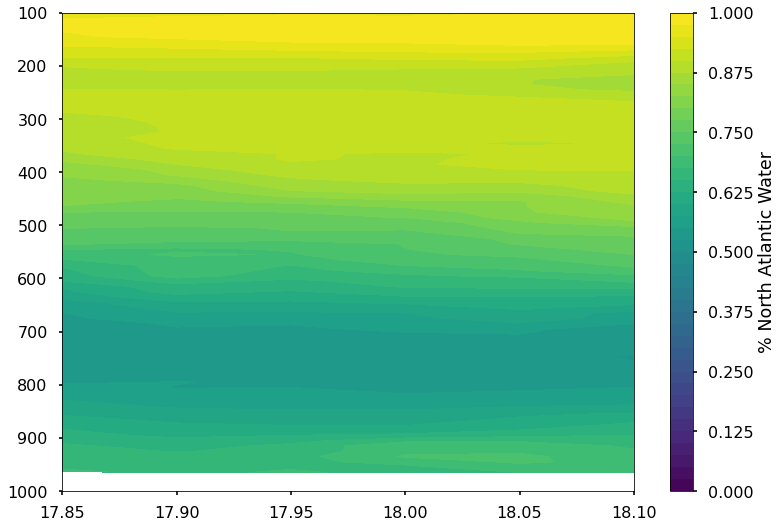

In [64]:
plt.contourf(df_2020_final.lat,df_2020_final.depth,np.nanmean(df_2020_final.naw_frac,axis=2),levels=np.arange(0,1.01,0.025))
plt.ylim(1000,100)
plt.colorbar(label='% North Atlantic Water')

/tmp/ipykernel_193673/3786683008.py:1: RuntimeWarning: Mean of empty slice
  plt.contourf(df_2020_final.lat,df_2020_final.depth,np.nanmean(df_2020_final.saw_frac,axis=2),levels=np.arange(0,1.01,0.025))


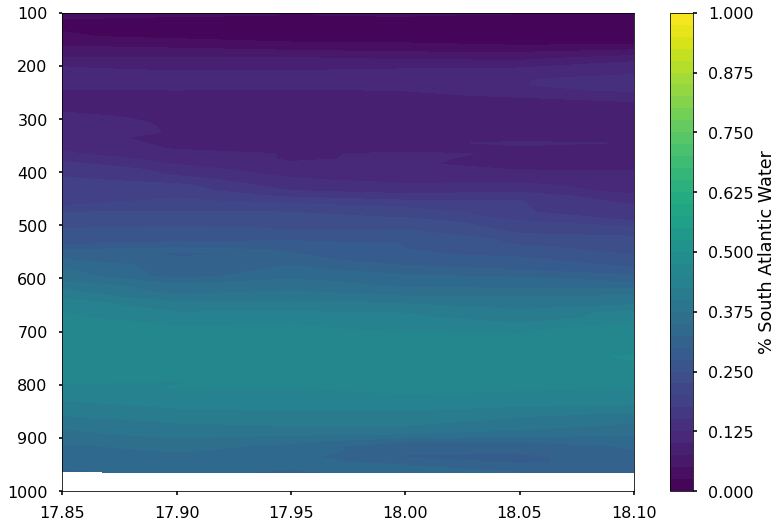

In [65]:
plt.contourf(df_2020_final.lat,df_2020_final.depth,np.nanmean(df_2020_final.saw_frac,axis=2),levels=np.arange(0,1.01,0.025))
plt.ylim(1000,100)
plt.colorbar(label='% South Atlantic Water')


## 2022

In [66]:
np.nansum(np.nanmean(df_2022_final.naw_transport,axis=2))

/tmp/ipykernel_193673/1887041703.py:1: RuntimeWarning: Mean of empty slice
  np.nansum(np.nanmean(df_2022_final.naw_transport,axis=2))


-2.0338533750888392

In [67]:
np.nansum(np.nanmean(df_2022_final.saw_transport,axis=2))

/tmp/ipykernel_193673/234371692.py:1: RuntimeWarning: Mean of empty slice
  np.nansum(np.nanmean(df_2022_final.saw_transport,axis=2))


-0.36218419429072213

In [68]:
np.nansum(np.nanmean(df_2022_final.transport,axis=2))

/tmp/ipykernel_193673/3663723316.py:1: RuntimeWarning: Mean of empty slice
  np.nansum(np.nanmean(df_2022_final.transport,axis=2))


-2.396037569379561

In [69]:
np.nansum(np.nanmean(df_2022_final.naw_transport,axis=2))/np.nansum(np.nanmean(df_2022_final.transport,axis=2))

/tmp/ipykernel_193673/3135396668.py:1: RuntimeWarning: Mean of empty slice
  np.nansum(np.nanmean(df_2022_final.naw_transport,axis=2))/np.nansum(np.nanmean(df_2022_final.transport,axis=2))


0.8488403525390017

In [70]:
np.nansum(np.nanmean(df_2022_final.saw_transport,axis=2))/np.nansum(np.nanmean(df_2022_final.transport,axis=2))

/tmp/ipykernel_193673/1106390318.py:1: RuntimeWarning: Mean of empty slice
  np.nansum(np.nanmean(df_2022_final.saw_transport,axis=2))/np.nansum(np.nanmean(df_2022_final.transport,axis=2))


0.15115964746099847

### just surface layer

In [71]:
np.nansum(np.nanmean(subset_ds_2022_surf_final.transport,axis=2))

/tmp/ipykernel_193673/602237023.py:1: RuntimeWarning: Mean of empty slice
  np.nansum(np.nanmean(subset_ds_2022_surf_final.transport,axis=2))


-0.4823495759567976

In [72]:
0.4999255952042789/2.47

0.20239902639849347

## total SAW

In [73]:
np.nansum(np.nanmean(df_2022_final.saw_transport,axis=2))+np.nansum(np.nanmean(subset_ds_2022_surf_final.transport,axis=2))

/tmp/ipykernel_193673/29435408.py:1: RuntimeWarning: Mean of empty slice
  np.nansum(np.nanmean(df_2022_final.saw_transport,axis=2))+np.nansum(np.nanmean(subset_ds_2022_surf_final.transport,axis=2))


-0.8445337702475197

/tmp/ipykernel_193673/3390171382.py:1: RuntimeWarning: Mean of empty slice
  plt.contourf(df_2022_final.lat,df_2022_final.depth,np.nanmean(df_2022_final.naw_frac,axis=2),levels=np.arange(0,1.01,0.025))


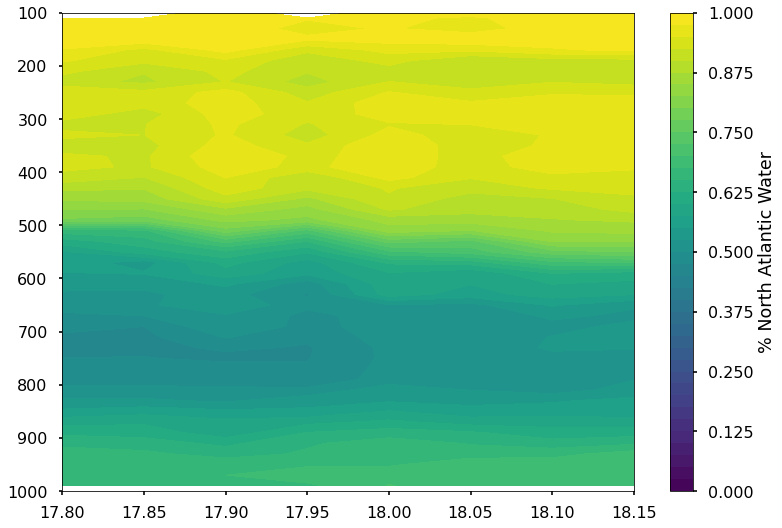

In [74]:
plt.contourf(df_2022_final.lat,df_2022_final.depth,np.nanmean(df_2022_final.naw_frac,axis=2),levels=np.arange(0,1.01,0.025))
plt.ylim(1000,100)
plt.colorbar(label='% North Atlantic Water')

/tmp/ipykernel_193673/3022784031.py:1: RuntimeWarning: Mean of empty slice
  plt.contourf(df_2022_final.lat,df_2022_final.depth,np.nanmean(df_2022_final.saw_frac,axis=2),levels=np.arange(0,1.01,0.025))


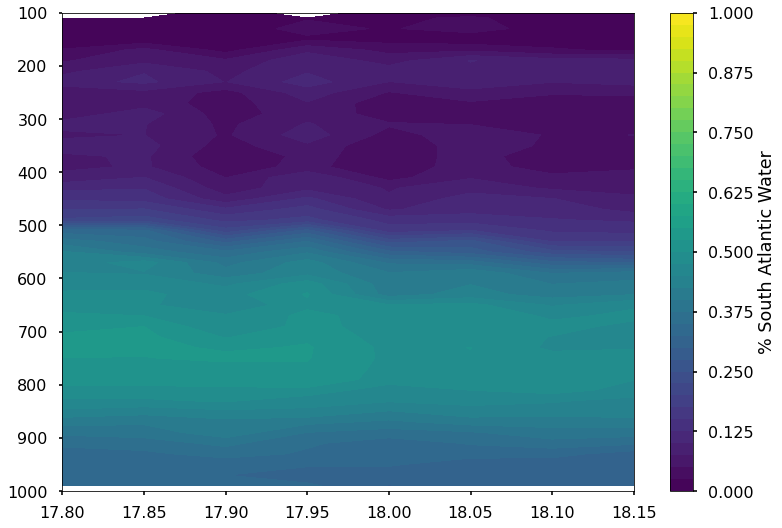

In [75]:
plt.contourf(df_2022_final.lat,df_2022_final.depth,np.nanmean(df_2022_final.saw_frac,axis=2),levels=np.arange(0,1.01,0.025))
plt.ylim(1000,100)
plt.colorbar(label='% South Atlantic Water')


## WOOHOO WE DID IT

/tmp/ipykernel_193673/372311979.py:14: RuntimeWarning: Mean of empty slice
  first = ax1.contourf(df_2020_final.lat,df_2020_final.depth,np.nanmean(df_2020_final.saw_frac,axis=2),levels=levels)
/tmp/ipykernel_193673/372311979.py:25: RuntimeWarning: Mean of empty slice
  second = ax2.contourf(df_2022_final.lat,df_2022_final.depth,np.nanmean(df_2022_final.saw_frac,axis=2),levels=levels)


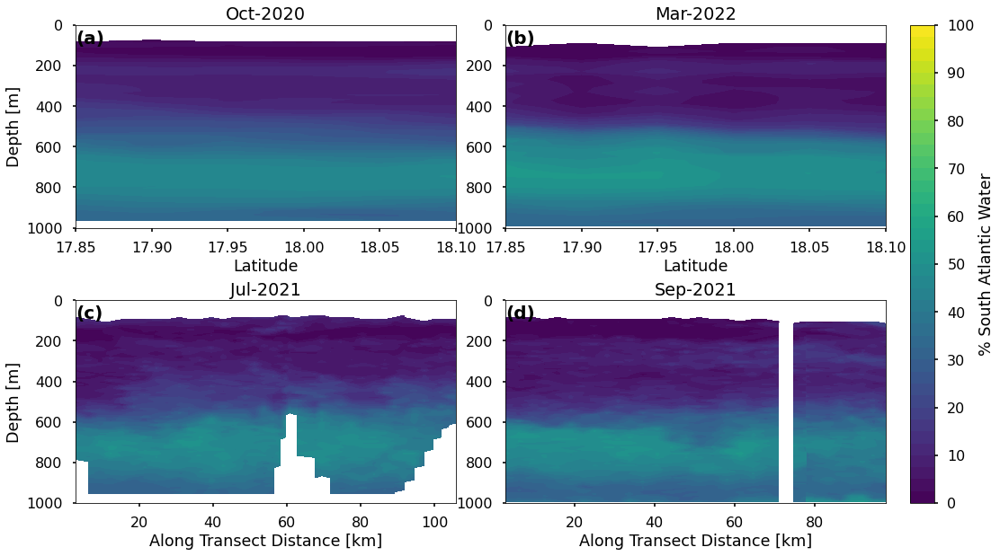

In [76]:
font_size = 20

fig, ((ax1,ax2),(ax3,ax4)) = plt.subplots(nrows=2,ncols=2, figsize=(16,8))


plt.tight_layout(pad=0.4, w_pad=1.5, h_pad=4.5)


axlist = [ax1,ax2,ax3,ax4]

levels=np.arange(0,1.01,0.025)


first = ax1.contourf(df_2020_final.lat,df_2020_final.depth,np.nanmean(df_2020_final.saw_frac,axis=2),levels=levels)
ax1.patch.set_facecolor('white')
ax1.set_title('Oct-2020')
ax1.set_xlabel('Latitude')
ax1.set_ylabel('Depth [m]')
#ax1.set_ylim(960,120)
ax1.set_ylim(1000,0)
ax1.set_xlim(17.85,18.10)
ax1.text(0,0.91,'(a)', transform=ax1.transAxes, size=font_size, weight='bold')


second = ax2.contourf(df_2022_final.lat,df_2022_final.depth,np.nanmean(df_2022_final.saw_frac,axis=2),levels=levels)
ax2.patch.set_facecolor('white')
ax2.set_title('Mar-2022')
ax2.set_xlabel('Latitude')
ax2.set_ylim(1000,0)
ax2.set_xlim(17.85,18.10)
ax2.text(0,0.91,'(b)', transform=ax2.transAxes, size=font_size, weight='bold')

third = ax3.contourf(np.cumsum(df_2021a_final.dist)/1000,df_2021a_final.depth,df_2021a_final.saw_frac,levels=levels)
ax3.patch.set_facecolor('white')
ax3.set_title('Jul-2021')
ax3.set_xlabel('Along Transect Distance [km]')
ax3.set_ylabel('Depth [m]')
ax3.set_ylim(1000,0)
ax3.text(0,0.91,'(c)', transform=ax3.transAxes, size=font_size, weight='bold')

fourth = ax4.contourf(np.cumsum(df_2021b_final.dist)/1000,df_2021b_final.depth,df_2021b_final.saw_frac,levels=levels)
ax4.patch.set_facecolor('white')
ax4.set_title('Sep-2021')
ax4.set_xlabel('Along Transect Distance [km]')
ax4.set_ylim(1000,0)
ax4.text(0,0.91,'(d)', transform=ax4.transAxes, size=font_size, weight='bold')

cbar = fig.colorbar(first, ax=axlist,label='% South Atlantic Water',pad=0.025)
cbar.get_ticks()
cbar.set_ticks([0,.10,.20,.30,.40,.50,.60,.70,.80,.90,1])
cbar.set_ticklabels([0,10,20,30,40,50,60,70,80,90,100])

#plt.savefig('/home/jg1200/Figures/Percent_SAW_All.png',dpi=300,facecolor='white',bbox_inches='tight')


/tmp/ipykernel_193673/2530505517.py:14: RuntimeWarning: Mean of empty slice
  first = ax1.contourf(df_2020_final.lat,df_2020_final.depth,np.nanmean(df_2020_final.naw_frac,axis=2),levels=levels)
/tmp/ipykernel_193673/2530505517.py:24: RuntimeWarning: Mean of empty slice
  second = ax2.contourf(df_2022_final.lat,df_2022_final.depth,np.nanmean(df_2022_final.naw_frac,axis=2),levels=levels)


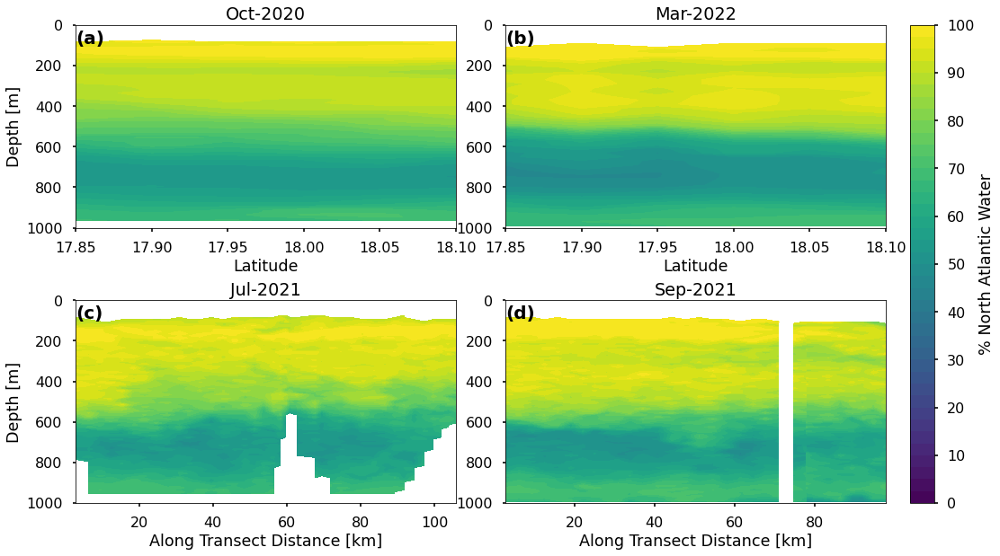

In [77]:
font_size = 20

fig, ((ax1,ax2),(ax3,ax4)) = plt.subplots(nrows=2,ncols=2, figsize=(16,8))


plt.tight_layout(pad=0.4, w_pad=1.5, h_pad=4.5)


axlist = [ax1,ax2,ax3,ax4]

levels=np.arange(0,1.01,0.025)


first = ax1.contourf(df_2020_final.lat,df_2020_final.depth,np.nanmean(df_2020_final.naw_frac,axis=2),levels=levels)
ax1.patch.set_facecolor('white')
ax1.set_title('Oct-2020')
ax1.set_xlabel('Latitude')
ax1.set_ylabel('Depth [m]')
ax1.set_ylim(1000,0)
ax1.set_xlim(17.85,18.10)
ax1.text(0,0.91,'(a)', transform=ax1.transAxes, size=font_size, weight='bold')


second = ax2.contourf(df_2022_final.lat,df_2022_final.depth,np.nanmean(df_2022_final.naw_frac,axis=2),levels=levels)
ax2.patch.set_facecolor('white')
ax2.set_title('Mar-2022')
ax2.set_xlabel('Latitude')
ax2.set_ylim(1000,0)
ax2.set_xlim(17.85,18.10)
ax2.text(0,0.91,'(b)', transform=ax2.transAxes, size=font_size, weight='bold')

third = ax3.contourf(np.cumsum(df_2021a_final.dist)/1000,df_2021a_final.depth,df_2021a_final.naw_frac,levels=levels)
ax3.patch.set_facecolor('white')
ax3.set_title('Jul-2021')
ax3.set_xlabel('Along Transect Distance [km]')
ax3.set_ylabel('Depth [m]')
ax3.set_ylim(1000,0)
ax3.text(0,0.91,'(c)', transform=ax3.transAxes, size=font_size, weight='bold')

fourth = ax4.contourf(np.cumsum(df_2021b_final.dist)/1000,df_2021b_final.depth,df_2021b_final.naw_frac,levels=levels)
ax4.patch.set_facecolor('white')
ax4.set_title('Sep-2021')
ax4.set_xlabel('Along Transect Distance [km]')
ax4.set_ylim(1000,0)
ax4.text(0,0.91,'(d)', transform=ax4.transAxes, size=font_size, weight='bold')

cbar = fig.colorbar(first, ax=axlist,label='% North Atlantic Water',pad=0.025)
cbar.get_ticks()
cbar.set_ticks([0,.10,.20,.30,.40,.50,.60,.70,.80,.90,1])
cbar.set_ticklabels([0,10,20,30,40,50,60,70,80,90,100])

#plt.savefig('/home/jg1200/Figures/Percent_NAW_All.png',dpi=300,facecolor='white',bbox_inches='tight')


## more plots

In [114]:
def calc_transport_by_water_mass_multiple(dft,surf_dft):
    
    smw_naw = np.nansum(np.nanmean(dft.naw_transport.values,axis=2)[np.where((np.nanmean(dft.density,axis=2)>=1024.5) & (np.nanmean(dft.density,axis=2)<1026.3))])
    smw_saw = np.nansum(np.nanmean(dft.saw_transport.values,axis=2)[np.where((np.nanmean(dft.density,axis=2)>=1024.5) & (np.nanmean(dft.density,axis=2)<1026.3))])

    ucw_naw = np.nansum(np.nanmean(dft.naw_transport.values,axis=2)[np.where((np.nanmean(dft.density,axis=2)>=1026.3) & (np.nanmean(dft.density,axis=2)<1026.8))])
    ucw_saw = np.nansum(np.nanmean(dft.saw_transport.values,axis=2)[np.where((np.nanmean(dft.density,axis=2)>=1026.3) & (np.nanmean(dft.density,axis=2)<1026.8))])

    lcw_naw = np.nansum(np.nanmean(dft.naw_transport.values,axis=2)[np.where((np.nanmean(dft.density,axis=2)>=1026.8) & (np.nanmean(dft.density,axis=2)<1027.1))])
    lcw_saw = np.nansum(np.nanmean(dft.saw_transport.values,axis=2)[np.where((np.nanmean(dft.density,axis=2)>=1026.8) & (np.nanmean(dft.density,axis=2)<1027.1))])

    iw_naw = np.nansum(np.nanmean(dft.naw_transport.values,axis=2)[np.where(np.nanmean(dft.density,axis=2)>=1027.1)])
    iw_saw = np.nansum(np.nanmean(dft.saw_transport.values,axis=2)[np.where(np.nanmean(dft.density,axis=2)>=1027.1)])

    d = {'SA': [iw_saw, lcw_saw, ucw_saw, smw_saw,np.nansum(np.nanmean(surf_dft.transport,axis=2))],'NA': [iw_naw, lcw_naw, ucw_naw, smw_naw,np.nan] }
    df2 = pd.DataFrame(data=d, index=['IW', 'lCW', 'uCW', 'SMW','SW'])

    return(df2)

def calc_transport_by_water_mass_single(dft,surf_dft):
    smw_naw = np.nansum(dft.naw_transport.values[np.where((dft.density>=1024.5) & (dft.density<1026.3))])
    smw_saw = np.nansum(dft.saw_transport.values[np.where((dft.density>=1024.5) & (dft.density<1026.3))])

    ucw_naw = np.nansum(dft.naw_transport.values[np.where((dft.density>=1026.3) & (dft.density<1026.8))])
    ucw_saw = np.nansum(dft.saw_transport.values[np.where((dft.density>=1026.3) & (dft.density<1026.8))])

    lcw_naw = np.nansum(dft.naw_transport.values[np.where((dft.density>=1026.8) & (dft.density<1027.1))])
    lcw_saw = np.nansum(dft.saw_transport.values[np.where((dft.density>=1026.8) & (dft.density<1027.1))])

    iw_naw = np.nansum(dft.naw_transport.values[np.where(dft.density>=1027.1)])
    iw_saw = np.nansum(dft.saw_transport.values[np.where(dft.density>=1027.1)])

    d = {'SA': [iw_saw, lcw_saw, ucw_saw, smw_saw,np.nansum(surf_dft.transport)],'NA': [iw_naw, lcw_naw, ucw_naw, smw_naw,np.nan] }
    df2 = pd.DataFrame(data=d, index=['IW', 'lCW', 'uCW', 'SMW','SW'])

    return(df2)

df_2020_water_mass_transport = calc_transport_by_water_mass_multiple(df_2020_final,subset_ds_2020_surf_final)
df_2021a_water_mass_transport = calc_transport_by_water_mass_single(df_2021a_final,subset_ds_2021a_surf_final)
df_2021b_water_mass_transport = calc_transport_by_water_mass_single(df_2021b_final,subset_ds_2021b_surf_final)
df_2022_water_mass_transport = calc_transport_by_water_mass_multiple(df_2022_final,subset_ds_2022_surf_final)

/tmp/ipykernel_193673/2131768640.py:3: RuntimeWarning: Mean of empty slice
  smw_naw = np.nansum(np.nanmean(dft.naw_transport.values,axis=2)[np.where((np.nanmean(dft.density,axis=2)>=1024.5) & (np.nanmean(dft.density,axis=2)<1026.3))])
/tmp/ipykernel_193673/2131768640.py:4: RuntimeWarning: Mean of empty slice
  smw_saw = np.nansum(np.nanmean(dft.saw_transport.values,axis=2)[np.where((np.nanmean(dft.density,axis=2)>=1024.5) & (np.nanmean(dft.density,axis=2)<1026.3))])
/tmp/ipykernel_193673/2131768640.py:6: RuntimeWarning: Mean of empty slice
  ucw_naw = np.nansum(np.nanmean(dft.naw_transport.values,axis=2)[np.where((np.nanmean(dft.density,axis=2)>=1026.3) & (np.nanmean(dft.density,axis=2)<1026.8))])
/tmp/ipykernel_193673/2131768640.py:7: RuntimeWarning: Mean of empty slice
  ucw_saw = np.nansum(np.nanmean(dft.saw_transport.values,axis=2)[np.where((np.nanmean(dft.density,axis=2)>=1026.3) & (np.nanmean(dft.density,axis=2)<1026.8))])
/tmp/ipykernel_193673/2131768640.py:9: RuntimeWarning: M

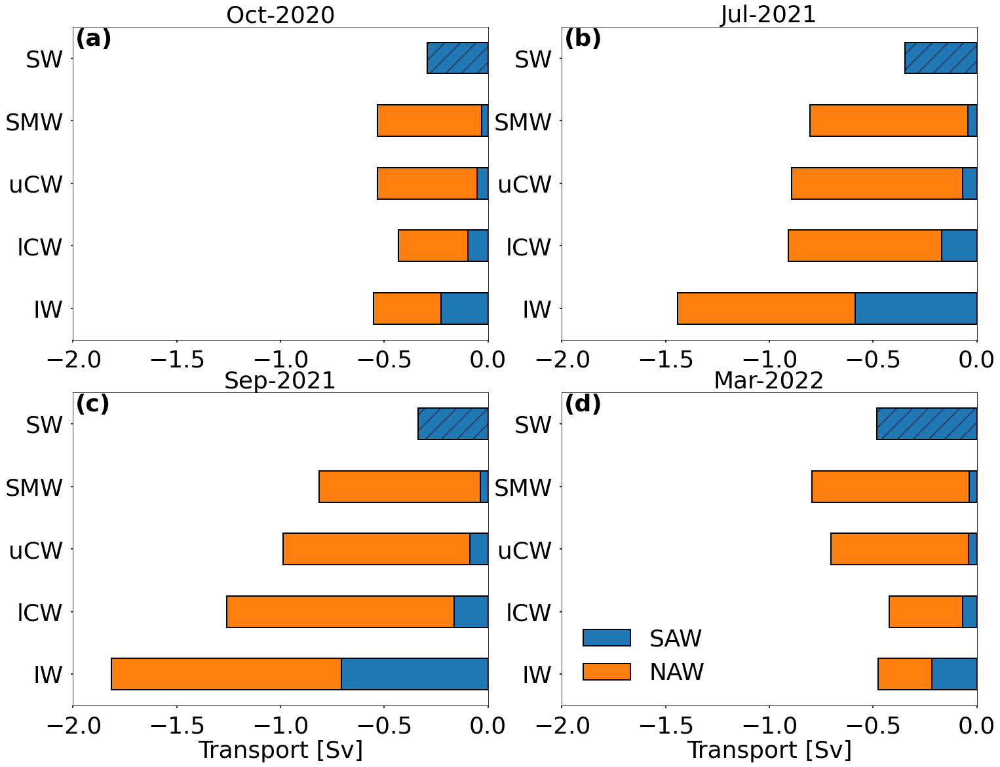

In [113]:
fig, axs = plt.subplots(2, 2, figsize=(20, 15))

plt.tight_layout(pad=0.4, w_pad=6, h_pad=4.5)

font_size = 36

df_2020_water_mass_transport.plot.barh(stacked=True,ax=axs[0,0],color=['tab:blue','tab:orange'], edgecolor='black', linewidth=2)
axs[0,0].set_title('Oct-2020',fontsize=font_size)
axs[0,0].set_xlim(-2,0)
axs[0,0].set_xticks([-2,-1.5,-1,-0.5,0])
axs[0,0].tick_params(axis='both', which='major', labelsize=font_size)
axs[0,0].text(0.005,0.94,'(a)', transform=axs[0,0].transAxes, size=font_size, weight='bold')
axs[0,0].get_legend().remove()

df_2021a_water_mass_transport.plot.barh(stacked=True,ax=axs[0,1],color=['tab:blue','tab:orange'], edgecolor='black', linewidth=2)
axs[0,1].set_title('Jul-2021',fontsize=font_size)
axs[0,1].set_xlim(-2,0)
axs[0,1].set_xticks([-2,-1.5,-1,-0.5,0])
axs[0,1].tick_params(axis='both', which='major', labelsize=font_size)
axs[0,1].text(0.005,0.94,'(b)', transform=axs[0,1].transAxes, size=font_size, weight='bold')
axs[0,1].get_legend().remove()

df_2021b_water_mass_transport.plot.barh(stacked=True,ax=axs[1,0],color=['tab:blue','tab:orange'], edgecolor='black', linewidth=2)
axs[1,0].set_title('Sep-2021',fontsize=font_size)
axs[1,0].set_xlim(-2,0)
axs[1,0].set_xticks([-2,-1.5,-1,-0.5,0])
axs[1,0].tick_params(axis='both', which='major', labelsize=font_size)
axs[1,0].text(0.005,0.94,'(c)', transform=axs[1,0].transAxes, size=font_size, weight='bold')
axs[1,0].get_legend().remove()
axs[1,0].set_xlabel('Transport [Sv]',fontsize=font_size)

df_2022_water_mass_transport.plot.barh(stacked=True,ax=axs[1,1],color=['tab:blue','tab:orange'], edgecolor='black', linewidth=2)
axs[1,1].set_title('Mar-2022',fontsize=font_size)
axs[1,1].set_xlim(-2,0)
axs[1,1].set_xticks([-2,-1.5,-1,-0.5,0])
axs[1,1].tick_params(axis='both', which='major', labelsize=font_size)
axs[1,1].text(0.005,0.94,'(d)', transform=axs[1,1].transAxes, size=font_size, weight='bold')
axs[1,1].legend(fontsize=font_size,markerscale=6,frameon=False,loc='lower left')
axs[1,1].set_xlabel('Transport [Sv]',fontsize=font_size)


hatches = ['','','','','/','','','','','']

for x in np.arange(0,len(axs)):    
    for y in np.arange(0,len(axs)):
        bars = axs[x,y].patches
        for bar, hatch in zip(bars, hatches):
            bar.set_hatch(hatch)

#plt.savefig('/home/jg1200/Figures/Anegada_SAW_NAW_Transport_Water_Masses_Bar_Plot.png', bbox_inches='tight',dpi=300,facecolor='white')



In [81]:
df_2020_water_mass_transport

,SA,NA
IW,-0.224874,-0.328021
lCW,-0.095948,-0.335527
uCW,-0.053557,-0.479025
SMW,-0.029948,-0.504240
SW,-0.291012,NaN


In [82]:
df_2021a_water_mass_transport

,SA,NA
IW,-0.585690,-0.855120
lCW,-0.169650,-0.739602
uCW,-0.066984,-0.827102
SMW,-0.042328,-0.763328
SW,-0.345491,NaN


In [83]:
df_2021b_water_mass_transport

,SA,NA
IW,-0.705403,-1.108732
lCW,-0.162977,-1.095370
uCW,-0.088257,-0.898679
SMW,-0.038227,-0.775775
SW,-0.335587,NaN


In [84]:
df_2022_water_mass_transport

,SA,NA
IW,-0.216577,-0.260170
lCW,-0.066797,-0.355977
uCW,-0.040544,-0.662538
SMW,-0.038266,-0.755169
SW,-0.482350,NaN


## Percentage of SAW vs NAW in each water mass

In [85]:

tempdf = df_2020_water_mass_transport

tot_transport = -2.27
tot_SAW = np.nansum(tempdf[:].SA)
tot_NAW = np.nansum(tempdf[:].NA)

for ind in np.arange(0,len(tempdf)):

    tot = tempdf.iloc[ind].SA+tempdf.iloc[ind].NA
    per_SA = (tempdf.iloc[ind].SA/tot)*100
    per_NA = (tempdf.iloc[ind].NA/tot)*100
    water_mass_name = tempdf.iloc[ind].name

    print(water_mass_name,'Percent SAW in layer:',per_SA,'%  (',tempdf.iloc[ind].SA,'Sv)')
    print(water_mass_name,'Percent of ALL SAW:', (tempdf.iloc[ind].SA/tot_SAW)*100,'%')
    print(water_mass_name,'Percent SAW of total transport:', (tempdf.iloc[ind].SA/tot_transport)*100,'%')
    print(water_mass_name,'Percent NAW in layer:',per_NA,'%  (',tempdf.iloc[ind].NA,'Sv)')
    print(water_mass_name,'Percent of ALL NAW:', (tempdf.iloc[ind].NA/tot_NAW)*100,'%')
    print(water_mass_name,'Percent of NAW of total transport:', (tempdf.iloc[ind].NA/tot_transport)*100,'%')

    print('')
 
print('All SAW w/ surface layer:',np.nansum(tempdf[:].SA))
print('All SAW % of total transport:',np.nansum(tempdf[:].SA)/tot_transport)

IW Percent SAW in layer: 40.67214715525239 %  ( -0.2248744491566605 Sv)
IW Percent of ALL SAW: 32.34023853954856 %
IW Percent SAW of total transport: 9.906363398971827 %
IW Percent NAW in layer: 59.32785284474761 %  ( -0.32802099621600966 Sv)
IW Percent of ALL NAW: 19.918518855625173 %
IW Percent of NAW of total transport: 14.450264150485006 %

lCW Percent SAW in layer: 22.237136015169636 %  ( -0.09594773473173415 Sv)
lCW Percent of ALL SAW: 13.79868918052091 %
lCW Percent SAW of total transport: 4.2267724551424735 %
lCW Percent NAW in layer: 77.76286398483036 %  ( -0.3355274996072604 Sv)
lCW Percent of ALL NAW: 20.37433854724022 %
lCW Percent of NAW of total transport: 14.780947119262573 %

uCW Percent SAW in layer: 10.056016859007775 %  ( -0.053556529949990016 Sv)
uCW Percent of ALL SAW: 7.702213214657043 %
uCW Percent SAW of total transport: 2.35931849999956 %
uCW Percent NAW in layer: 89.94398314099223 %  ( -0.4790254127902535 Sv)
uCW Percent of ALL NAW: 29.08800603331808 %
uCW Per

In [86]:

tempdf = df_2021a_water_mass_transport

tot_transport = -4.43
tot_SAW = np.nansum(tempdf[:].SA)
tot_NAW = np.nansum(tempdf[:].NA)

for ind in np.arange(0,len(tempdf)):

    tot = tempdf.iloc[ind].SA+tempdf.iloc[ind].NA
    per_SA = (tempdf.iloc[ind].SA/tot)*100
    per_NA = (tempdf.iloc[ind].NA/tot)*100
    water_mass_name = tempdf.iloc[ind].name

    print(water_mass_name,'Percent SAW in layer:',per_SA,'%  (',tempdf.iloc[ind].SA,'Sv)')
    print(water_mass_name,'Percent of ALL SAW:', (tempdf.iloc[ind].SA/tot_SAW)*100,'%')
    print(water_mass_name,'Percent SAW of total transport:', (tempdf.iloc[ind].SA/tot_transport)*100,'%')
    print(water_mass_name,'Percent NAW in layer:',per_NA,'%  (',tempdf.iloc[ind].NA,'Sv)')
    print(water_mass_name,'Percent of ALL NAW:', (tempdf.iloc[ind].NA/tot_NAW)*100,'%')
    print(water_mass_name,'Percent of NAW of total transport:', (tempdf.iloc[ind].NA/tot_transport)*100,'%')

    print('')
 
print('All SAW w/ surface layer:',np.nansum(tempdf[:].SA))
print('All SAW % of total transport:',np.nansum(tempdf[:].SA)/tot_transport)

IW Percent SAW in layer: 40.65004502118986 %  ( -0.5856897367319535 Sv)
IW Percent of ALL SAW: 48.398428005614505 %
IW Percent SAW of total transport: 13.220987285145677 %
IW Percent NAW in layer: 59.34995497881014 %  ( -0.8551198279970594 Sv)
IW Percent of ALL NAW: 26.84707143159371 %
IW Percent of NAW of total transport: 19.302930654561163 %

lCW Percent SAW in layer: 18.65817654802349 %  ( -0.16964969903194352 Sv)
lCW Percent of ALL SAW: 14.018990311468322 %
lCW Percent SAW of total transport: 3.8295643122334884 %
lCW Percent NAW in layer: 81.34182345197651 %  ( -0.7396015270741518 Sv)
lCW Percent of ALL NAW: 23.220295423139017 %
lCW Percent of NAW of total transport: 16.695294064879274 %

uCW Percent SAW in layer: 7.49185734796859 %  ( -0.06698362240931281 Sv)
uCW Percent of ALL SAW: 5.535186675494162 %
uCW Percent SAW of total transport: 1.512045652580425 %
uCW Percent NAW in layer: 92.50814265203141 %  ( -0.8271020401730822 Sv)
uCW Percent of ALL NAW: 25.967433834103527 %
uCW Per

In [87]:

tempdf = df_2021b_water_mass_transport

tot_transport = -5.24
tot_SAW = np.nansum(tempdf[:].SA)
tot_NAW = np.nansum(tempdf[:].NA)

for ind in np.arange(0,len(tempdf)):

    tot = tempdf.iloc[ind].SA+tempdf.iloc[ind].NA
    per_SA = (tempdf.iloc[ind].SA/tot)*100
    per_NA = (tempdf.iloc[ind].NA/tot)*100
    water_mass_name = tempdf.iloc[ind].name

    print(water_mass_name,'Percent SAW in layer:',per_SA,'%  (',tempdf.iloc[ind].SA,'Sv)')
    print(water_mass_name,'Percent of ALL SAW:', (tempdf.iloc[ind].SA/tot_SAW)*100,'%')
    print(water_mass_name,'Percent SAW of total transport:', (tempdf.iloc[ind].SA/tot_transport)*100,'%')
    print(water_mass_name,'Percent NAW in layer:',per_NA,'%  (',tempdf.iloc[ind].NA,'Sv)')
    print(water_mass_name,'Percent of ALL NAW:', (tempdf.iloc[ind].NA/tot_NAW)*100,'%')
    print(water_mass_name,'Percent of NAW of total transport:', (tempdf.iloc[ind].NA/tot_transport)*100,'%')

    print('')
 
print('All SAW w/ surface layer:',np.nansum(tempdf[:].SA))
print('All SAW % of total transport:',np.nansum(tempdf[:].SA)/tot_transport)

IW Percent SAW in layer: 38.88372622081875 %  ( -0.7054033131533781 Sv)
IW Percent of ALL SAW: 53.019855251790084 %
IW Percent SAW of total transport: 13.461895289186604 %
IW Percent NAW in layer: 61.11627377918125 %  ( -1.108731754940219 Sv)
IW Percent of ALL NAW: 28.586200185751686 %
IW Percent of NAW of total transport: 21.159002956874406 %

lCW Percent SAW in layer: 12.951686569029489 %  ( -0.16297720615993322 Sv)
lCW Percent of ALL SAW: 12.249769343033922 %
lCW Percent SAW of total transport: 3.110252025952924 %
lCW Percent NAW in layer: 87.04831343097051 %  ( -1.0953701549447574 Sv)
lCW Percent of ALL NAW: 28.24170083271133 %
lCW Percent of NAW of total transport: 20.904010590548804 %

uCW Percent SAW in layer: 8.94251391449455 %  ( -0.08825684576848743 Sv)
uCW Percent of ALL SAW: 6.633602508480585 %
uCW Percent SAW of total transport: 1.6842909497802945 %
uCW Percent NAW in layer: 91.05748608550545 %  ( -0.8986786693715624 Sv)
uCW Percent of ALL NAW: 23.170445178334038 %
uCW Per

In [88]:

tempdf = df_2022_water_mass_transport

tot_transport = -2.47
tot_SAW = np.nansum(tempdf[:].SA)
tot_NAW = np.nansum(tempdf[:].NA)

for ind in np.arange(0,len(tempdf)):

    tot = tempdf.iloc[ind].SA+tempdf.iloc[ind].NA
    per_SA = (tempdf.iloc[ind].SA/tot)*100
    per_NA = (tempdf.iloc[ind].NA/tot)*100
    water_mass_name = tempdf.iloc[ind].name

    print(water_mass_name,'Percent SAW in layer:',per_SA,'%  (',tempdf.iloc[ind].SA,'Sv)')
    print(water_mass_name,'Percent of ALL SAW:', (tempdf.iloc[ind].SA/tot_SAW)*100,'%')
    print(water_mass_name,'Percent SAW of total transport:', (tempdf.iloc[ind].SA/tot_transport)*100,'%')
    print(water_mass_name,'Percent NAW in layer:',per_NA,'%  (',tempdf.iloc[ind].NA,'Sv)')
    print(water_mass_name,'Percent of ALL NAW:', (tempdf.iloc[ind].NA/tot_NAW)*100,'%')
    print(water_mass_name,'Percent of NAW of total transport:', (tempdf.iloc[ind].NA/tot_transport)*100,'%')

    print('')
 
print('All SAW w/ surface layer:',np.nansum(tempdf[:].SA))
print('All SAW % of total transport:',np.nansum(tempdf[:].SA)/tot_transport)

IW Percent SAW in layer: 45.428076498852214 %  ( -0.21657714651412888 Sv)
IW Percent of ALL SAW: 25.644580968106634 %
IW Percent SAW of total transport: 8.768305526887808 %
IW Percent NAW in layer: 54.57192350114779 %  ( -0.26017019391002694 Sv)
IW Percent of ALL NAW: 12.791983782934338 %
IW Percent of NAW of total transport: 10.533206231175178 %

lCW Percent SAW in layer: 15.799727548782386 %  ( -0.0667970900450644 Sv)
lCW Percent of ALL SAW: 7.909345060942585 %
lCW Percent SAW of total transport: 2.704335629354834 %
lCW Percent NAW in layer: 84.20027245121761 %  ( -0.3559765928480444 Sv)
lCW Percent of ALL NAW: 17.502569123622067 %
lCW Percent of NAW of total transport: 14.412007807613131 %

uCW Percent SAW in layer: 5.766558905758265 %  ( -0.04054358500431674 Sv)
uCW Percent of ALL SAW: 4.800706192297562 %
uCW Percent SAW of total transport: 1.6414406884338761 %
uCW Percent NAW in layer: 94.23344109424173 %  ( -0.6625375014271678 Sv)
uCW Percent of ALL NAW: 32.575480098127926 %
uCW 

In [89]:
## 2020  = 2.27
## 2021a = 4.43
## 2021b = 5.24
## 2022  = 2.47

In [108]:
np.std([0.7,1.21,1.33,0.84])

0.2583602136552763

In [111]:
np.std([0.3063169551720354,0.2731697666629165,0.253902905340959,0.3419165061730849])

0.03350094851935653

In [95]:
def calc_water_mass_NAW_stats(wm):

    tot2020  = -2.27
    tot2021a = -4.43
    tot2021b = -5.24
    tot2022  = -2.47

    wm2020 = df_2020_water_mass_transport.NA[wm]
    wm2020all = np.nansum([df_2020_water_mass_transport.NA[wm],df_2020_water_mass_transport.SA[wm]])
    wm2021a = df_2021a_water_mass_transport.NA[wm]
    wm2021aall = np.nansum([df_2021a_water_mass_transport.NA[wm],df_2021a_water_mass_transport.SA[wm]])
    wm2021b = df_2021b_water_mass_transport.NA[wm]
    wm2021ball = np.nansum([df_2021b_water_mass_transport.NA[wm],df_2021b_water_mass_transport.SA[wm]])
    wm2022 = df_2022_water_mass_transport.NA[wm]
    wm2022all = np.nansum([df_2022_water_mass_transport.NA[wm],df_2022_water_mass_transport.SA[wm]])
    all_naw = [wm2020,wm2021a,wm2021b,wm2022]
    
    per_in_layer_2020 = (wm2020/wm2020all)*100
    per_in_layer_2021a = (wm2021a/wm2021aall)*100
    per_in_layer_2021b = (wm2021b/wm2021ball)*100
    per_in_layer_2022 = (wm2022/wm2022all)*100
    
    tot_NAW_2020 = np.nansum(df_2020_water_mass_transport.NA)
    tot_NAW_2021a = np.nansum(df_2021a_water_mass_transport.NA)
    tot_NAW_2021b = np.nansum(df_2021b_water_mass_transport.NA)
    tot_NAW_2022 = np.nansum(df_2022_water_mass_transport.NA)

    per_NAW_2020 = (wm2020/tot_NAW_2020)*100
    per_NAW_2021a = (wm2021a/tot_NAW_2021a)*100
    per_NAW_2021b = (wm2021b/tot_NAW_2021b)*100
    per_NAW_2022 = (wm2022/tot_NAW_2022)*100

    per_tot_2020 = (wm2020/tot2020)*100
    per_tot_2021a = (wm2021a/tot2021b)*100
    per_tot_2021b = (wm2021b/tot2021a)*100
    per_tot_2022 = (wm2022/tot2022)*100

    all_per_in_layer = [per_in_layer_2020,per_in_layer_2021a,per_in_layer_2021b,per_in_layer_2022]
    all_naw_per = [per_NAW_2020,per_NAW_2021a,per_NAW_2021b,per_NAW_2022]
    all_tot_per = [per_tot_2020,per_tot_2021a,per_tot_2021b,per_tot_2022]

    print(wm,'2020: ',wm2020,'Sv')
    print(wm,'2021a:',wm2021a,'Sv')
    print(wm,'2021b:',wm2021b,'Sv')
    print(wm,'2022: ',wm2022,'Sv')
    print('')
    print(wm, 'mean = ',np.nanmean(all_naw))
    print(wm, 'std  = ',np.nanstd(all_naw))
    print(wm, 'min  = ',np.nanmin(all_naw))
    print(wm, 'max  = ',np.nanmax(all_naw))
    print('')
    print(wm,'2020 percent NAW in',wm ,'layer: ',per_in_layer_2020,'%')
    print(wm,'2021a percent NAW in',wm ,'layer: ',per_in_layer_2021a,'%')
    print(wm,'2021b percent NAW in',wm ,'layer: ',per_in_layer_2021b,'%')
    print(wm,'2022 percent NAW in',wm ,'layer: ',per_in_layer_2022,'%')
    print('')
    print(wm,'mean percent NAW in',wm ,'layer: ',np.nanmean(all_per_in_layer),'%')
    print(wm,'std percent NAW in',wm ,'layer: ',np.nanstd(all_per_in_layer),'%')
    print(wm,'min percent NAW in',wm ,'layer: ',np.nanmin(all_per_in_layer),'%')
    print(wm,'max percent NAW in',wm ,'layer: ',np.nanmax(all_per_in_layer),'%')
    print('')
    print(wm,'2020 percent NAW in all NAW: ',per_NAW_2020,'%')
    print(wm,'2021a percent NAW in all NAW: ',per_NAW_2021a,'%')
    print(wm,'2021b percent NAW in all NAW: ',per_NAW_2021b,'%')
    print(wm,'2022 percent NAW in all NAW: ',per_NAW_2022,'%')
    print('')
    print(wm, 'mean percent NAW in all NAW = ',np.nanmean(all_naw_per),'%')
    print(wm, 'std percent NAW in all NAW =  ',np.nanstd(all_naw_per),'%')
    print(wm, 'min percent NAW in all NAW =  ',np.nanmin(all_naw_per),'%')
    print(wm, 'max percent NAW in all NAW =  ',np.nanmax(all_naw_per),'%')
    print('')
    print(wm,'2020 percent NAW in total transport:  ',per_tot_2020,'%')
    print(wm,'2021a percent NAW in total transport: ',per_tot_2021a,'%')
    print(wm,'2021b percent NAW in total transport: ',per_tot_2021b,'%')
    print(wm,'2022 percent NAW in total transport:  ',per_tot_2022,'%')
    print('')
    print(wm, 'mean percent NAW in total transport = ',np.nanmean(all_tot_per),'%')
    print(wm, 'std percent NAW in total transport =  ',np.nanstd(all_tot_per),'%')
    print(wm, 'min percent NAW in total transport =  ',np.nanmin(all_tot_per),'%')
    print(wm, 'max percent NAW in total transport =  ',np.nanmax(all_tot_per),'%')


In [96]:
def calc_water_mass_SAW_stats(wm):

    tot2020  = -2.27
    tot2021a = -4.43
    tot2021b = -5.24
    tot2022  = -2.47

    
    wm2020 = df_2020_water_mass_transport.SA[wm]
    wm2020all = np.nansum([df_2020_water_mass_transport.NA[wm],df_2020_water_mass_transport.SA[wm]])
    wm2021a = df_2021a_water_mass_transport.SA[wm]
    wm2021aall = np.nansum([df_2021a_water_mass_transport.NA[wm],df_2021a_water_mass_transport.SA[wm]])
    wm2021b = df_2021b_water_mass_transport.SA[wm]
    wm2021ball = np.nansum([df_2021b_water_mass_transport.NA[wm],df_2021b_water_mass_transport.SA[wm]])
    wm2022 = df_2022_water_mass_transport.SA[wm]
    wm2022all = np.nansum([df_2022_water_mass_transport.NA[wm],df_2022_water_mass_transport.SA[wm]])
    all_saw = [wm2020,wm2021a,wm2021b,wm2022]

    tot_SAW_2020 = np.nansum(df_2020_water_mass_transport.SA)
    tot_SAW_2021a = np.nansum(df_2021a_water_mass_transport.SA)
    tot_SAW_2021b = np.nansum(df_2021b_water_mass_transport.SA)
    tot_SAW_2022 = np.nansum(df_2022_water_mass_transport.SA)

    per_in_layer_2020 = (wm2020/wm2020all)*100
    per_in_layer_2021a = (wm2021a/wm2021aall)*100
    per_in_layer_2021b = (wm2021b/wm2021ball)*100
    per_in_layer_2022 = (wm2022/wm2022all)*100
    
    per_SAW_2020 = (wm2020/tot_SAW_2020)*100
    per_SAW_2021a = (wm2021a/tot_SAW_2021a)*100
    per_SAW_2021b = (wm2021b/tot_SAW_2021b)*100
    per_SAW_2022 = (wm2022/tot_SAW_2022)*100

    per_tot_2020 = (wm2020/tot2020)*100
    per_tot_2021a = (wm2021a/tot2021b)*100
    per_tot_2021b = (wm2021b/tot2021a)*100
    per_tot_2022 = (wm2022/tot2022)*100

    all_per_in_layer = [per_in_layer_2020,per_in_layer_2021a,per_in_layer_2021b,per_in_layer_2022]
    all_saw_per = [per_SAW_2020,per_SAW_2021a,per_SAW_2021b,per_SAW_2022]
    all_tot_per = [per_tot_2020,per_tot_2021a,per_tot_2021b,per_tot_2022]

    print(wm,'2020: ',wm2020,'Sv')
    print(wm,'2021a:',wm2021a,'Sv')
    print(wm,'2021b:',wm2021b,'Sv')
    print(wm,'2022: ',wm2022,'Sv')
    print('')
    print(wm, 'mean = ',np.mean(all_saw))
    print(wm, 'std  = ',np.std(all_saw))
    print(wm, 'min  = ',np.min(all_saw))
    print(wm, 'max  = ',np.max(all_saw))
    print('')
    print(wm,'2020 percent SAW in',wm ,'layer: ',per_in_layer_2020,'%')
    print(wm,'2021a percent SAW in',wm ,'layer: ',per_in_layer_2021a,'%')
    print(wm,'2021b percent SAW in',wm ,'layer: ',per_in_layer_2021b,'%')
    print(wm,'2022 percent SAW in',wm ,'layer: ',per_in_layer_2022,'%')
    print('')
    print(wm,'mean percent SAW in',wm ,'layer: ',np.nanmean(all_per_in_layer),'%')
    print(wm,'std percent SAW in',wm ,'layer: ',np.nanstd(all_per_in_layer),'%')
    print(wm,'min percent SAW in',wm ,'layer: ',np.nanmin(all_per_in_layer),'%')
    print(wm,'max percent SAW in',wm ,'layer: ',np.nanmax(all_per_in_layer),'%')
    print('')
    print(wm,'2020 percent SAW in all SAW: ',per_SAW_2020,'%')
    print(wm,'2021a percent SAW in all SAW: ',per_SAW_2021a,'%')
    print(wm,'2021b percent SAW in all SAW: ',per_SAW_2021b,'%')
    print(wm,'2022 percent SAW in all SAW: ',per_SAW_2022,'%')
    print('')
    print(wm, 'mean percent SAW in all SAW = ',np.mean(all_saw_per),'%')
    print(wm, 'std percent SAW in all SAW =  ',np.std(all_saw_per),'%')
    print(wm, 'min percent SAW in all SAW =  ',np.min(all_saw_per),'%')
    print(wm, 'max percent SAW in all SAW =  ',np.max(all_saw_per),'%')
    print('')
    print(wm,'2020 percent SAW in total transport:  ',per_tot_2020,'%')
    print(wm,'2021a percent SAW in total transport: ',per_tot_2021a,'%')
    print(wm,'2021b percent SAW in total transport: ',per_tot_2021b,'%')
    print(wm,'2022 percent SAW in total transport:  ',per_tot_2022,'%')
    print('')
    print(wm, 'mean percent SAW in total transport = ',np.mean(all_tot_per),'%')
    print(wm, 'std percent SAW in total transport =  ',np.std(all_tot_per),'%')
    print(wm, 'min percent SAW in total transport =  ',np.min(all_tot_per),'%')
    print(wm, 'max percent SAW in total transport =  ',np.max(all_tot_per),'%')


In [97]:
calc_water_mass_SAW_stats('SW')

SW 2020:  -0.29101236484839427 Sv
SW 2021a: -0.34549084290885446 Sv
SW 2021b: -0.33558663958262 Sv
SW 2022:  -0.4823495759567976 Sv

SW mean =  -0.3636098558241666
SW std  =  0.07155961869430728
SW min  =  -0.4823495759567976
SW max  =  -0.29101236484839427

SW 2020 percent SAW in SW layer:  100.0 %
SW 2021a percent SAW in SW layer:  100.0 %
SW 2021b percent SAW in SW layer:  100.0 %
SW 2022 percent SAW in SW layer:  100.0 %

SW mean percent SAW in SW layer:  100.0 %
SW std percent SAW in SW layer:  0.0 %
SW min percent SAW in SW layer:  100.0 %
SW max percent SAW in SW layer:  100.0 %

SW 2020 percent SAW in all SAW:  41.851839248302845 %
SW 2021a percent SAW in all SAW:  28.54961020902418 %
SW 2021b percent SAW in all SAW:  25.223520677222034 %
SW 2022 percent SAW in all SAW:  57.11430293846372 %

SW mean percent SAW in all SAW =  38.184818268253196 %
SW std percent SAW in all SAW =   12.575819082029623 %
SW min percent SAW in all SAW =   25.223520677222034 %
SW max percent SAW in al

In [98]:
calc_water_mass_SAW_stats('SMW')

SMW 2020:  -0.029948409553741433 Sv
SMW 2021a: -0.04232816523465574 Sv
SMW 2021b: -0.03822721932220641 Sv
SMW 2022:  -0.03826637272721214 Sv

SMW mean =  -0.03719254170945393
SMW std  =  0.004502103688806624
SMW min  =  -0.04232816523465574
SMW max  =  -0.029948409553741433

SMW 2020 percent SAW in SMW layer:  5.606335309220153 %
SMW 2021a percent SAW in SMW layer:  5.253875702428317 %
SMW 2021b percent SAW in SMW layer:  4.696203914380504 %
SMW 2022 percent SAW in SMW layer:  4.822871509299271 %

SMW mean percent SAW in SMW layer:  5.094821608832062 %
SMW std percent SAW in SMW layer:  0.36048487948186336 %
SMW min percent SAW in SMW layer:  4.696203914380504 %
SMW max percent SAW in SMW layer:  5.606335309220153 %

SMW 2020 percent SAW in all SAW:  4.307019816970638 %
SMW 2021a percent SAW in all SAW:  3.497784798398832 %
SMW 2021b percent SAW in all SAW:  2.873252219473376 %
SMW 2022 percent SAW in all SAW:  4.5310648401895 %

SMW mean percent SAW in all SAW =  3.8022804187580865 %


In [99]:
calc_water_mass_NAW_stats('SMW')

SMW 2020:  -0.5042402877310681 Sv
SMW 2021a: -0.7633278424834533 Sv
SMW 2021b: -0.7757753244163382 Sv
SMW 2022:  -0.7551690869035996 Sv

SMW mean =  -0.6996281353836149
SMW std  =  0.11304562727968587
SMW min  =  -0.7757753244163382
SMW max  =  -0.5042402877310681

SMW 2020 percent NAW in SMW layer:  94.39366469077984 %
SMW 2021a percent NAW in SMW layer:  94.74612429757168 %
SMW 2021b percent NAW in SMW layer:  95.3037960856195 %
SMW 2022 percent NAW in SMW layer:  95.17712849070074 %

SMW mean percent NAW in SMW layer:  94.90517839116794 %
SMW std percent NAW in SMW layer:  0.36048487948186647 %
SMW min percent NAW in SMW layer:  94.39366469077984 %
SMW max percent NAW in SMW layer:  95.3037960856195 %

SMW 2020 percent NAW in all NAW:  30.619136563816525 %
SMW 2021a percent NAW in all NAW:  23.965199311163737 %
SMW 2021b percent NAW in all NAW:  20.00165380320294 %
SMW 2022 percent NAW in all NAW:  37.12996699531567 %

SMW mean percent NAW in all NAW =  27.92898916837472 %
SMW std p

## Accounting for saline WSA SMW endmember

In [117]:
(-0.5042402877310681*0.25) + -0.7

-0.826060071932767

In [118]:
(-0.7633278424834533*0.25) + -1.21

-1.4008319606208632

In [119]:
(-0.7757753244163382*0.25) + -1.33

-1.5239438311040847

In [120]:
(-0.7551690869035996*0.25) + -0.84

-1.0287922717259

In [122]:
np.std([0.826060071932767,1.4008319606208632,1.5239438311040847,1.0287922717259])


0.2803178931694916

In [123]:
1.2/6

0.19999999999999998

In [124]:
-0.83*2

-1.66

In [125]:
1.03*2

2.06

In [127]:
np.std([1.66,1.40,1.52,2.06])

0.24859605789312111

In [128]:
1.66/6

0.27666666666666667

In [129]:
1.66/4.8

0.3458333333333333

In [100]:
calc_water_mass_SAW_stats('uCW')

uCW 2020:  -0.053556529949990016 Sv
uCW 2021a: -0.06698362240931281 Sv
uCW 2021b: -0.08825684576848743 Sv
uCW 2022:  -0.04054358500431674 Sv

uCW mean =  -0.06233514578302674
uCW std  =  0.01764567285623883
uCW min  =  -0.08825684576848743
uCW max  =  -0.04054358500431674

uCW 2020 percent SAW in uCW layer:  10.056016859007775 %
uCW 2021a percent SAW in uCW layer:  7.49185734796859 %
uCW 2021b percent SAW in uCW layer:  8.94251391449455 %
uCW 2022 percent SAW in uCW layer:  5.766558905758265 %

uCW mean percent SAW in uCW layer:  8.064236756807295 %
uCW std percent SAW in uCW layer:  1.6082211007896885 %
uCW min percent SAW in uCW layer:  5.766558905758265 %
uCW max percent SAW in uCW layer:  10.056016859007775 %

uCW 2020 percent SAW in all SAW:  7.702213214657043 %
uCW 2021a percent SAW in all SAW:  5.535186675494162 %
uCW 2021b percent SAW in all SAW:  6.633602508480585 %
uCW 2022 percent SAW in all SAW:  4.800706192297562 %

uCW mean percent SAW in all SAW =  6.167927147732338 %
uC

In [101]:
calc_water_mass_NAW_stats('uCW')

uCW 2020:  -0.4790254127902535 Sv
uCW 2021a: -0.8271020401730822 Sv
uCW 2021b: -0.8986786693715624 Sv
uCW 2022:  -0.6625375014271678 Sv

uCW mean =  -0.7168359059405165
uCW std  =  0.1618081876450478
uCW min  =  -0.8986786693715624
uCW max  =  -0.4790254127902535

uCW 2020 percent NAW in uCW layer:  89.94398314099223 %
uCW 2021a percent NAW in uCW layer:  92.50814265203141 %
uCW 2021b percent NAW in uCW layer:  91.05748608550545 %
uCW 2022 percent NAW in uCW layer:  94.23344109424173 %

uCW mean percent NAW in uCW layer:  91.9357632431927 %
uCW std percent NAW in uCW layer:  1.6082211007896845 %
uCW min percent NAW in uCW layer:  89.94398314099223 %
uCW max percent NAW in uCW layer:  94.23344109424173 %

uCW 2020 percent NAW in all NAW:  29.08800603331808 %
uCW 2021a percent NAW in all NAW:  25.967433834103527 %
uCW 2021b percent NAW in all NAW:  23.170445178334038 %
uCW 2022 percent NAW in all NAW:  32.575480098127926 %

uCW mean percent NAW in all NAW =  27.700341285970893 %
uCW std 

In [102]:
calc_water_mass_SAW_stats('lCW')

lCW 2020:  -0.09594773473173415 Sv
lCW 2021a: -0.16964969903194352 Sv
lCW 2021b: -0.16297720615993322 Sv
lCW 2022:  -0.0667970900450644 Sv

lCW mean =  -0.12384293249216882
lCW std  =  0.04376677231338438
lCW min  =  -0.16964969903194352
lCW max  =  -0.0667970900450644

lCW 2020 percent SAW in lCW layer:  22.237136015169636 %
lCW 2021a percent SAW in lCW layer:  18.65817654802349 %
lCW 2021b percent SAW in lCW layer:  12.951686569029489 %
lCW 2022 percent SAW in lCW layer:  15.799727548782386 %

lCW mean percent SAW in lCW layer:  17.41168167025125 %
lCW std percent SAW in lCW layer:  3.4397932898593897 %
lCW min percent SAW in lCW layer:  12.951686569029489 %
lCW max percent SAW in lCW layer:  22.237136015169636 %

lCW 2020 percent SAW in all SAW:  13.79868918052091 %
lCW 2021a percent SAW in all SAW:  14.018990311468322 %
lCW 2021b percent SAW in all SAW:  12.249769343033922 %
lCW 2022 percent SAW in all SAW:  7.909345060942585 %

lCW mean percent SAW in all SAW =  11.994198473991435

In [103]:
calc_water_mass_NAW_stats('lCW')

lCW 2020:  -0.3355274996072604 Sv
lCW 2021a: -0.7396015270741518 Sv
lCW 2021b: -1.0953701549447574 Sv
lCW 2022:  -0.3559765928480444 Sv

lCW mean =  -0.6316189436185535
lCW std  =  0.31239969313815424
lCW min  =  -1.0953701549447574
lCW max  =  -0.3355274996072604

lCW 2020 percent NAW in lCW layer:  77.76286398483036 %
lCW 2021a percent NAW in lCW layer:  81.34182345197651 %
lCW 2021b percent NAW in lCW layer:  87.04831343097051 %
lCW 2022 percent NAW in lCW layer:  84.20027245121761 %

lCW mean percent NAW in lCW layer:  82.58831832974874 %
lCW std percent NAW in lCW layer:  3.43979328985939 %
lCW min percent NAW in lCW layer:  77.76286398483036 %
lCW max percent NAW in lCW layer:  87.04831343097051 %

lCW 2020 percent NAW in all NAW:  20.37433854724022 %
lCW 2021a percent NAW in all NAW:  23.220295423139017 %
lCW 2021b percent NAW in all NAW:  28.24170083271133 %
lCW 2022 percent NAW in all NAW:  17.502569123622067 %

lCW mean percent NAW in all NAW =  22.334725981678158 %
lCW std p

In [104]:
calc_water_mass_SAW_stats('IW')

IW 2020:  -0.2248744491566605 Sv
IW 2021a: -0.5856897367319535 Sv
IW 2021b: -0.7054033131533781 Sv
IW 2022:  -0.21657714651412888 Sv

IW mean =  -0.4331361613890302
IW std  =  0.2166060611948137
IW min  =  -0.7054033131533781
IW max  =  -0.21657714651412888

IW 2020 percent SAW in IW layer:  40.67214715525239 %
IW 2021a percent SAW in IW layer:  40.65004502118986 %
IW 2021b percent SAW in IW layer:  38.88372622081875 %
IW 2022 percent SAW in IW layer:  45.428076498852214 %

IW mean percent SAW in IW layer:  41.408498724028306 %
IW std percent SAW in IW layer:  2.4315091678322673 %
IW min percent SAW in IW layer:  38.88372622081875 %
IW max percent SAW in IW layer:  45.428076498852214 %

IW 2020 percent SAW in all SAW:  32.34023853954856 %
IW 2021a percent SAW in all SAW:  48.398428005614505 %
IW 2021b percent SAW in all SAW:  53.019855251790084 %
IW 2022 percent SAW in all SAW:  25.644580968106634 %

IW mean percent SAW in all SAW =  39.85077569126494 %
IW std percent SAW in all SAW = 

In [105]:
calc_water_mass_NAW_stats('IW')

IW 2020:  -0.32802099621600966 Sv
IW 2021a: -0.8551198279970594 Sv
IW 2021b: -1.108731754940219 Sv
IW 2022:  -0.26017019391002694 Sv

IW mean =  -0.6380106932658287
IW std  =  0.3562203494742015
IW min  =  -1.108731754940219
IW max  =  -0.26017019391002694

IW 2020 percent NAW in IW layer:  59.32785284474761 %
IW 2021a percent NAW in IW layer:  59.34995497881014 %
IW 2021b percent NAW in IW layer:  61.11627377918125 %
IW 2022 percent NAW in IW layer:  54.57192350114779 %

IW mean percent NAW in IW layer:  58.591501275971694 %
IW std percent NAW in IW layer:  2.4315091678322642 %
IW min percent NAW in IW layer:  54.57192350114779 %
IW max percent NAW in IW layer:  61.11627377918125 %

IW 2020 percent NAW in all NAW:  19.918518855625173 %
IW 2021a percent NAW in all NAW:  26.84707143159371 %
IW 2021b percent NAW in all NAW:  28.586200185751686 %
IW 2022 percent NAW in all NAW:  12.791983782934338 %

IW mean percent NAW in all NAW =  22.03594356397623 %
IW std percent NAW in all NAW =   6

## Calculate IWE Stats

In [139]:
tempdf = df_2020_water_mass_transport
IWE_2020 = tempdf['NA']['lCW'] + tempdf['NA']['uCW'] + tempdf['NA']['SMW']
IWE_2020

-1.318793200128582

In [140]:
tempdf = df_2021a_water_mass_transport
IWE_2021a = tempdf['NA']['lCW'] + tempdf['NA']['uCW'] + tempdf['NA']['SMW']
IWE_2021a

-2.3300314097306876

In [141]:
tempdf = df_2021b_water_mass_transport
IWE_2021b = tempdf['NA']['lCW'] + tempdf['NA']['uCW'] + tempdf['NA']['SMW']
IWE_2021b

-2.769824148732658

In [142]:
tempdf = df_2022_water_mass_transport
IWE_2022 = tempdf['NA']['lCW'] + tempdf['NA']['uCW'] + tempdf['NA']['SMW']
IWE_2022

-1.7736831811788119

In [143]:
np.mean([IWE_2020,IWE_2021a,IWE_2021b,IWE_2022])

-2.048082984942685

In [144]:
np.std([IWE_2020,IWE_2021a,IWE_2021b,IWE_2022])

0.549446099333045

In [145]:
2.05/14.8

0.1385135135135135

In [146]:
np.mean([IWE_2020*2,IWE_2021a,IWE_2021b,IWE_2022*2])

-2.8212020802695332

In [147]:
np.std([IWE_2020*2,IWE_2021a,IWE_2021b,IWE_2022*2])

0.44858600122315

In [148]:
IWE_2020*2

-2.637586400257164

In [149]:
IWE_2022*2

-3.5473663623576237

In [150]:
2.82/14.8

0.1905405405405405

In [ ]:
2.82+